# CSCI 3202, Fall 2022
# Homework 3 - extra credit
# Due: Sunday September 18, 2022 at 6:00 PM

This assignment is worth 10 points applied to your homework 2 grade. If you receive a 90+ on homework 2, you can still get the 10 extra points. In this assignment, I'm providing the solution to homework 2 and asking you to reflect on the Q-learning portion of the solution. The code is setup to run 3 trials, 10 steps each, and is hard-coded to start at the same location on each trial. It won't find the landing pad in only 3 trials, you will need to change that number if you want to see the code produce a valid solution. I added a few print statements in the Q-learning algorithm to help illustrate the code. Feel free to add as many additional print statements that you need to help you understand how its working.  

<br>
The questions are listed in Part E of this notebook.
<br> 

### Your name:

<br> 

In [1]:
import pandas as pd
import numpy as np
import scipy.stats as stats
import matplotlib.pyplot as plt
from collections import defaultdict

# added packages
import heapq
from matplotlib import colors



---
## [100 pts] Problem 1:  Reinforcement learning

Consider a **cube** state space defined by $0 \le x, y, z \le L$. Suppose you are piloting/programming a drone to learn how to land on a platform at the center of the $z=0$ surface (the bottom). Some assumptions:
* In this discrete world, if I say the drone is at $(x,y,z)$ I mean that it is in the box centered at $(x,y,z)$. And there are boxes (states) centered at $(x,y,z)$ for all $0 \le x,y,z \le L$. Each state is a 1 unit cube. So when $L=2$ (for example), there are cubes centered at each $x=0,1,2$, $y=0,1,2$ and so on, for a total state space size of $3^3 = 27$ states.
* All of the states with $z=0$ are terminal states.
* The state at the center of the bottom of the cubic state space is the landing pad. So, for example, when $L=4$, the landing pad is at $(x,y,z) = (2,2,0)$.
* All terminal states ***except*** the landing pad have a reward of -1. The landing pad has a reward of +1.
* All non-terminal states have a reward of -0.01.
* The drone takes up exactly 1 cubic unit, and begins in a random non-terminal state.
* The available actions in non-terminal states include moving exactly 1 unit Up (+z), Down (-z), North (+y), South (-y), East (+x) or West (-x). In a terminal state, the training episode should end.

#### Part A
Write a class `MDPLanding` to represent the Markov decision process for this drone. Include methods for:
1. `actions(state)`, which should return a list of all actions available from the given state
2. `reward(state)`, which should return the reward for the given state
3. `result(state, action)`, which should return the resulting state of doing the given action in the given state

and attributes for:
1. `states`, which is just a list of all the states in the state space, where each state is represented as an $(x,y,z)$ tuple
2. `terminal_states`, a dictionary where keys are the terminal state tuples and the values are the rewards associated with those terminal states
3. `default_reward`, which is a scalar for the reward associated with non-terminal states
4. `all_actions`, a list of all possible actions (Up, Down, North, South, East, West)
5. `discount`, the discount factor (use $\gamma = 0.999$ for this entire problem)

How you feed arguments/information into the class constructor is up to you.

Note that actions are *deterministic* here.  The drone does not need to learn transition probabilities for outcomes of particular actions. What the drone does need to learn, however, is where the heck that landing pad is, and how to get there from any initial state.

In [2]:
# Solution:

class MDPLanding:
    def __init__(self, size, default_reward, actions, discount):
        self.size = size
        self.lz = (int(size/2), int(size/2), 0)
        self.states = [(x,y,z) for x in range(size) for y in range(size) for z in range(size)]
        self.terminal_states = {(x,y,0) : -1 for x in range(size) for y in range(size)}
        self.terminal_states[self.lz] = +1
        self.default_reward = default_reward
        self.all_actions = actions
        self.discount = discount

    def actions(self, state):
        '''all are available, unless you are in a terminal state
        (the drone might bump into wall in some cases though)'''
        if state in self.terminal_states:
            return [None]
        else:
            return self.all_actions
        
    def reward(self, state):
        return self.terminal_states[state] if state in self.terminal_states.keys() else self.default_reward
                
    def result(self, state, action):
        '''result of doing `action` in `state`, deterministic.
        `action` is one of N, S, E, W, U, D (as string)'''
        
        assert action in self.actions(state), 'Error: action needs to be available in that state'
        assert state in self.states, 'Error: invalid state'
        
        if action=='N':
            new_state = (state[0], state[1]+1, state[2])
        elif action=='S':
            new_state = (state[0], state[1]-1, state[2])
        elif action=='E':
            new_state = (state[0]+1, state[1], state[2])
        elif action=='W':
            new_state = (state[0]-1, state[1], state[2])
        elif action=='U':
            new_state = (state[0], state[1], state[2]+1)
        elif action=='D':
            new_state = (state[0], state[1], state[2]-1)
        elif action is None:
            return state
        return new_state if new_state in self.states else state

#### Part B
Write a function to implement **policy iteration** for this drone landing MDP. Create an MDP environment to represent the $L=4$ case (so 125 total states).

Use your function to find an optimal policy for your new MDP environment. Check (by printing to screen) that the policy for the following states are what you expect, and comment on the results:
1. $(2,2,1)$
1. $(0,2,1)$
1. $(2,0,1)$

In [3]:
def policy_iteration(mdp):
    # initilize utility for all states
    utility = {s : 0 for s in mdp.states}
    # initialize a policy for each state, being a random action
    policy = {s: np.random.choice(mdp.actions(s)) for s in mdp.states}
    while True:
        # policy evaluation step
        utility = policy_evaluation(policy, utility, mdp)
        # policy improvement step
        unchanged = True
        for s in mdp.states:
            best = (-999, None)
            for a in mdp.actions(s):
                new_util = utility[mdp.result(s,a)]
                if new_util > best[0]:
                    best = (new_util, a)
            if best[1] != policy[s]:
                policy[s] = best[1]
                unchanged = False
        if unchanged:
            return policy

def policy_evaluation(policy, utility, mdp, n_iter=50):
    '''Do a handful (n_iter) of value iterations to update the
    utility of each state, under the given policy'''
    for i in range(n_iter):
        for s in mdp.states:
            if s in mdp.terminal_states:
                utility[s] = mdp.reward(s)
            else:
                utility[s] = mdp.reward(s) + mdp.discount * utility[mdp.result(s, policy[s])]
    return utility

size = 5
default_reward = -0.01
discount = 0.999
actions = ['N','S','E','W','U','D']
mdp = MDPLanding(size, default_reward, actions, discount)

policy = policy_iteration(mdp)
print('Policy(2,2,1) = '+policy[(2,2,1)])
print('Policy(0,2,1) = '+policy[(0,2,1)])
print('Policy(2,0,1) = '+policy[(2,0,1)])

Policy(2,2,1) = D
Policy(0,2,1) = E
Policy(2,0,1) = N


**Solution:**

Makes sense, because (2,2,1) is right above the landing pad in the 5x5x5 environment, so the drone should just go straight down. Similarly, (0,2,1) is West of the landing pad (lower x-value), so the drone needs to head toward +x, or East, and (2,0,1) is South of the landing pad (lower y-value), so the drone needs to head toward +y, or North.

#### Part C

Code up a **Q-learning** agent/algorithm to learn how to land the drone. You can do this however you like, as long as you use the MDP class structure defined above.  

Your code should include some kind of a wrapper to run many trials to train the agent and learn the Q values (see Section 22.3 in the textbook - page 803 might be of particular interest).  You also do not need to have a separate function for the actual "agent"; your code can just be a "for" loop within which you are refining your estimate of the Q values.

From each training trial, save the cumulative discounted reward (utility) over the course of that episode. That is, add up all of $\gamma^t R(s_t)$ where the drone is in state $s_t$ during time step $t$, for the entire sequence. I refer to this as "cumulative reward" because we usually refer to "utility" as the utility *under an optimal policy*.

Some guidelines:
* The drone should initialize in a random non-terminal state for each new training episode.
* The training episodes should be limited to 50 time steps, even if the drone has not yet landed. If the drone lands (in a terminal state), the training episode is over.
* You may use whatever learning rate $\alpha$ you decide is appropriate, and gives good results.
* There are many forms of Q-learning. You can use whatever you would like, subject to the reliability targets in Part D below.
* Your code should return:
  * The learned Q values associated with each state-action pair.
  * The cumulative reward for each training trial. 
  * Anything else that might be useful in the ensuing analysis.

In [12]:
# Solution:

def run_many_trials(mdp, n_trials, n_steps=None):

    Q = defaultdict(float)   # state-action matrix
    Nsa = defaultdict(float) # state-action visit counter (exploration)
    rewards = []
    epsilon = 0.1 # for epsilon-greedy action
    alpha = lambda n: 1./(1+n) # learning rate related to number of visits to this state
    policy = {state : np.random.choice(mdp.all_actions) for state in mdp.states} # random initial policy
        
    for k in range(n_trials):
        
        #s = mdp.states[np.random.randint(len(mdp.states))] # random initial location
        s = mdp.states[148] #seems like a nice starting place in the middle of the state space
#         print('mdp.states[148]:')
#         print(s)
#         print('trial: ', k)
        while s in mdp.terminal_states:
            s = mdp.states[np.random.randint(len(mdp.states))] # re-sample if terminal
        r = mdp.reward(s)
        cumulative_reward = 0
                
        for t in range(n_steps):

            if s in mdp.terminal_states:
                Q[s, None] = r
                # update the policy
                policy[s] = None
#                 print('Terminal found:')
#                 print(s)
                cumulative_reward += (mdp.discount**t)*r
                break
            else:
                # pick a new action and state
#                 print('policy: ' + policy[s])
                a = return_epsilon_greedy_action(policy, s, mdp, epsilon)
#                 print("action: " + a)
#                 print(a)
                s1 = mdp.result(s, a)
#                 print("s1:")
#                 print(s1)
                r1 = mdp.reward(s1)
#                 print("r1:")
#                 print(r1)
                # update the state-action "matrix"
                Nsa[s, a] += 1
#                 print("Q[s, a] before for s and a:", Q[s,a], s, a)
                Q[s, a] += alpha(Nsa[s, a]) * (r + mdp.discount * max(Q[s1, a1] for a1 in mdp.actions(s1)) - Q[s, a])
#                 print("Q[s, a] for s and a:", Q[s,a], s, a)
#                 for a1 in mdp.actions(s1):
#                     print("Q for a1, s1", Q[s1, a1], s1, a1)
                #                Q[s, a] += 0.001 * (r + mdp.discount * max(Q[s1, a1] for a1 in mdp.actions(s1)) - Q[s, a])
                # update the policy
                best = (-999, None)
                for a1 in mdp.actions(s):
                    new = Q[s, a1]
                    if new > best[0]:
                        best = (new, a1)
                policy[s] = best[1]
                cumulative_reward += (mdp.discount**t)*r
                s = s1
                r = r1

        rewards.append(cumulative_reward)

    print(Q)
    return Q, Nsa, rewards

def return_epsilon_greedy_action(policy, state, mdp, epsilon=0.1):
    '''Return a random action or the one with highest utility (so far)'''
    if np.random.uniform(0, 1) <= epsilon:
        action = np.random.choice(mdp.actions(state))
    else:
        action = policy[state]
    return action


#### Part D

Initialize the $L=10$ environment (so that the landing pad is at $(5,5,0)$). Run some number of training trials to train the drone.

**How do I know if my drone is learned enough?**  If you take the mean cumulative reward across the last 5000 training trials, it should be around 0.80. This means at least about 10,000 (but probably more) training episodes will be necessary. It will take a few seconds on your computer, so start small to test your codes.

**Then:** Compute block means of cumulative reward from all of your training trials. Use blocks of 500 training trials. This means you need to create some kind of array-like structure such that its first element is the mean of the first 500 trials' cumulative rewards; its second element is the mean of the 501-1000th trials' cumulative rewards; and so on. Make a plot of the block mean rewards as the training progresses. It should increase from about -0.5 initially to somewhere around +0.8.

**And:** Print to the screen the mean of the last 5000 trials' cumulative rewards, to verify that it is indeed about 0.80.

Q for a1, s1 0.0 (1, 2, 4) N
Q for a1, s1 0.0 (1, 2, 4) S
Q for a1, s1 0.0 (1, 2, 4) E
Q for a1, s1 0.0 (1, 2, 4) W
Q for a1, s1 0.0 (1, 2, 4) U
Q for a1, s1 0.0 (1, 2, 4) D
Q for a1, s1 0.0 (1, 2, 3) N
Q for a1, s1 0.0 (1, 2, 3) S
Q for a1, s1 0.0 (1, 2, 3) E
Q for a1, s1 0.0 (1, 2, 3) W
Q for a1, s1 0.0 (1, 2, 3) U
Q for a1, s1 0.0 (1, 2, 3) D
Q for a1, s1 0.0 (1, 2, 4) N
Q for a1, s1 0.0 (1, 2, 4) S
Q for a1, s1 0.0 (1, 2, 4) E
Q for a1, s1 0.0 (1, 2, 4) W
Q for a1, s1 0.0 (1, 2, 4) U
Q for a1, s1 -0.005 (1, 2, 4) D
Q for a1, s1 0.0 (1, 2, 5) N
Q for a1, s1 0.0 (1, 2, 5) S
Q for a1, s1 0.0 (1, 2, 5) E
Q for a1, s1 0.0 (1, 2, 5) W
Q for a1, s1 0.0 (1, 2, 5) U
Q for a1, s1 -0.005 (1, 2, 5) D
Q for a1, s1 0.0 (1, 3, 5) N
Q for a1, s1 0.0 (1, 3, 5) S
Q for a1, s1 0.0 (1, 3, 5) E
Q for a1, s1 0.0 (1, 3, 5) W
Q for a1, s1 0.0 (1, 3, 5) U
Q for a1, s1 0.0 (1, 3, 5) D
Q for a1, s1 0.0 (1, 4, 5) N
Q for a1, s1 0.0 (1, 4, 5) S
Q for a1, s1 0.0 (1, 4, 5) E
Q for a1, s1 0.0 (1, 4, 5) W
Q for a1

Q for a1, s1 0.0 (1, 5, 5) D
Q for a1, s1 -0.005 (1, 4, 5) N
Q for a1, s1 -0.005 (1, 4, 5) S
Q for a1, s1 0.0 (1, 4, 5) E
Q for a1, s1 0.0 (1, 4, 5) W
Q for a1, s1 0.0 (1, 4, 5) U
Q for a1, s1 0.0 (1, 4, 5) D
Q for a1, s1 0.0 (2, 4, 5) N
Q for a1, s1 0.0 (2, 4, 5) S
Q for a1, s1 0.0 (2, 4, 5) E
Q for a1, s1 0.0 (2, 4, 5) W
Q for a1, s1 0.0 (2, 4, 5) U
Q for a1, s1 0.0 (2, 4, 5) D
Q for a1, s1 -0.005 (1, 4, 5) N
Q for a1, s1 -0.005 (1, 4, 5) S
Q for a1, s1 -0.005 (1, 4, 5) E
Q for a1, s1 0.0 (1, 4, 5) W
Q for a1, s1 0.0 (1, 4, 5) U
Q for a1, s1 0.0 (1, 4, 5) D
Q for a1, s1 0.0 (0, 4, 5) N
Q for a1, s1 0.0 (0, 4, 5) S
Q for a1, s1 -0.005 (0, 4, 5) E
Q for a1, s1 0.0 (0, 4, 5) W
Q for a1, s1 0.0 (0, 4, 5) U
Q for a1, s1 0.0 (0, 4, 5) D
Q for a1, s1 0.0 (0, 5, 5) N
Q for a1, s1 0.0 (0, 5, 5) S
Q for a1, s1 0.0 (0, 5, 5) E
Q for a1, s1 0.0 (0, 5, 5) W
Q for a1, s1 0.0 (0, 5, 5) U
Q for a1, s1 0.0 (0, 5, 5) D
Q for a1, s1 0.0 (0, 5, 6) N
Q for a1, s1 0.0 (0, 5, 6) S
Q for a1, s1 0.0 (0, 5, 6

Q for a1, s1 0.0 (4, 8, 8) E
Q for a1, s1 0.0 (4, 8, 8) W
Q for a1, s1 0.0 (4, 8, 8) U
Q for a1, s1 0.0 (4, 8, 8) D
Q for a1, s1 0.0 (4, 8, 9) N
Q for a1, s1 0.0 (4, 8, 9) S
Q for a1, s1 0.0 (4, 8, 9) E
Q for a1, s1 0.0 (4, 8, 9) W
Q for a1, s1 0.0 (4, 8, 9) U
Q for a1, s1 0.0 (4, 8, 9) D
Q for a1, s1 0.0 (5, 8, 9) N
Q for a1, s1 0.0 (5, 8, 9) S
Q for a1, s1 0.0 (5, 8, 9) E
Q for a1, s1 0.0 (5, 8, 9) W
Q for a1, s1 0.0 (5, 8, 9) U
Q for a1, s1 0.0 (5, 8, 9) D
Q for a1, s1 0.0 (5, 7, 9) N
Q for a1, s1 -0.005 (5, 7, 9) S
Q for a1, s1 0.0 (5, 7, 9) E
Q for a1, s1 0.0 (5, 7, 9) W
Q for a1, s1 0.0 (5, 7, 9) U
Q for a1, s1 0.0 (5, 7, 9) D
Q for a1, s1 0.0 (5, 8, 9) N
Q for a1, s1 -0.005 (5, 8, 9) S
Q for a1, s1 0.0 (5, 8, 9) E
Q for a1, s1 0.0 (5, 8, 9) W
Q for a1, s1 0.0 (5, 8, 9) U
Q for a1, s1 0.0 (5, 8, 9) D
Q for a1, s1 0.0 (5, 9, 9) N
Q for a1, s1 0.0 (5, 9, 9) S
Q for a1, s1 0.0 (5, 9, 9) E
Q for a1, s1 0.0 (5, 9, 9) W
Q for a1, s1 0.0 (5, 9, 9) U
Q for a1, s1 0.0 (5, 9, 9) D
Q for a1

Q for a1, s1 0.0 (3, 3, 5) D
Q for a1, s1 0.0 (4, 3, 5) N
Q for a1, s1 0.0 (4, 3, 5) S
Q for a1, s1 0.0 (4, 3, 5) E
Q for a1, s1 0.0 (4, 3, 5) W
Q for a1, s1 0.0 (4, 3, 5) U
Q for a1, s1 0.0 (4, 3, 5) D
Q for a1, s1 0.0 (4, 3, 6) N
Q for a1, s1 0.0 (4, 3, 6) S
Q for a1, s1 0.0 (4, 3, 6) E
Q for a1, s1 0.0 (4, 3, 6) W
Q for a1, s1 0.0 (4, 3, 6) U
Q for a1, s1 0.0 (4, 3, 6) D
Q for a1, s1 0.0 (4, 2, 6) N
Q for a1, s1 0.0 (4, 2, 6) S
Q for a1, s1 0.0 (4, 2, 6) E
Q for a1, s1 0.0 (4, 2, 6) W
Q for a1, s1 -0.005 (4, 2, 6) U
Q for a1, s1 0.0 (4, 2, 6) D
Q for a1, s1 0.0 (4, 3, 6) N
Q for a1, s1 -0.005 (4, 3, 6) S
Q for a1, s1 0.0 (4, 3, 6) E
Q for a1, s1 0.0 (4, 3, 6) W
Q for a1, s1 0.0 (4, 3, 6) U
Q for a1, s1 0.0 (4, 3, 6) D
Q for a1, s1 0.0 (4, 4, 6) N
Q for a1, s1 0.0 (4, 4, 6) S
Q for a1, s1 0.0 (4, 4, 6) E
Q for a1, s1 0.0 (4, 4, 6) W
Q for a1, s1 0.0 (4, 4, 6) U
Q for a1, s1 0.0 (4, 4, 6) D
Q for a1, s1 -0.005 (1, 3, 5) N
Q for a1, s1 -0.005 (1, 3, 5) S
Q for a1, s1 -0.005 (1, 3, 5) E

Q for a1, s1 0.0 (2, 3, 5) E
Q for a1, s1 -0.005 (2, 3, 5) W
Q for a1, s1 0.0 (2, 3, 5) U
Q for a1, s1 0.0 (2, 3, 5) D
Q for a1, s1 -0.006666666666666666 (2, 4, 5) N
Q for a1, s1 0.0 (2, 4, 5) S
Q for a1, s1 0.0 (2, 4, 5) E
Q for a1, s1 -0.005 (2, 4, 5) W
Q for a1, s1 0.0 (2, 4, 5) U
Q for a1, s1 0.0 (2, 4, 5) D
Q for a1, s1 -0.005 (2, 3, 5) N
Q for a1, s1 0.0 (2, 3, 5) S
Q for a1, s1 0.0 (2, 3, 5) E
Q for a1, s1 -0.005 (2, 3, 5) W
Q for a1, s1 0.0 (2, 3, 5) U
Q for a1, s1 0.0 (2, 3, 5) D
Q for a1, s1 -0.005 (2, 2, 5) N
Q for a1, s1 0.0 (2, 2, 5) S
Q for a1, s1 0.0 (2, 2, 5) E
Q for a1, s1 0.0 (2, 2, 5) W
Q for a1, s1 -0.005 (2, 2, 5) U
Q for a1, s1 -0.005 (2, 2, 5) D
Q for a1, s1 -0.005 (2, 1, 5) N
Q for a1, s1 0.0 (2, 1, 5) S
Q for a1, s1 -0.005 (2, 1, 5) E
Q for a1, s1 0.0 (2, 1, 5) W
Q for a1, s1 0.0 (2, 1, 5) U
Q for a1, s1 0.0 (2, 1, 5) D
Q for a1, s1 -0.005 (2, 0, 5) N
Q for a1, s1 0.0 (2, 0, 5) S
Q for a1, s1 0.0 (2, 0, 5) E
Q for a1, s1 0.0 (2, 0, 5) W
Q for a1, s1 0.0 (2, 0, 

Q for a1, s1 0.0 (0, 2, 5) D
Q for a1, s1 -0.005 (0, 2, 4) N
Q for a1, s1 0.0 (0, 2, 4) S
Q for a1, s1 0.0 (0, 2, 4) E
Q for a1, s1 0.0 (0, 2, 4) W
Q for a1, s1 0.0 (0, 2, 4) U
Q for a1, s1 0.0 (0, 2, 4) D
Q for a1, s1 0.0 (0, 1, 4) N
Q for a1, s1 0.0 (0, 1, 4) S
Q for a1, s1 0.0 (0, 1, 4) E
Q for a1, s1 0.0 (0, 1, 4) W
Q for a1, s1 0.0 (0, 1, 4) U
Q for a1, s1 0.0 (0, 1, 4) D
Q for a1, s1 0.0 (0, 1, 3) N
Q for a1, s1 0.0 (0, 1, 3) S
Q for a1, s1 0.0 (0, 1, 3) E
Q for a1, s1 0.0 (0, 1, 3) W
Q for a1, s1 0.0 (0, 1, 3) U
Q for a1, s1 0.0 (0, 1, 3) D
Q for a1, s1 0.0 (0, 1, 4) N
Q for a1, s1 0.0 (0, 1, 4) S
Q for a1, s1 0.0 (0, 1, 4) E
Q for a1, s1 0.0 (0, 1, 4) W
Q for a1, s1 0.0 (0, 1, 4) U
Q for a1, s1 -0.005 (0, 1, 4) D
Q for a1, s1 -0.005 (0, 2, 4) N
Q for a1, s1 -0.005 (0, 2, 4) S
Q for a1, s1 0.0 (0, 2, 4) E
Q for a1, s1 0.0 (0, 2, 4) W
Q for a1, s1 0.0 (0, 2, 4) U
Q for a1, s1 0.0 (0, 2, 4) D
Q for a1, s1 -0.005 (1, 2, 4) N
Q for a1, s1 -0.005 (1, 2, 4) S
Q for a1, s1 0.0 (1, 2, 4

Q for a1, s1 -0.005 (7, 9, 4) S
Q for a1, s1 -0.005 (7, 9, 4) E
Q for a1, s1 0.0 (7, 9, 4) W
Q for a1, s1 0.0 (7, 9, 4) U
Q for a1, s1 0.0 (7, 9, 4) D
Q for a1, s1 0.0 (7, 10, 4) N
Q for a1, s1 0.0 (7, 10, 4) S
Q for a1, s1 0.0 (7, 10, 4) E
Q for a1, s1 0.0 (7, 10, 4) W
Q for a1, s1 0.0 (7, 10, 4) U
Q for a1, s1 0.0 (7, 10, 4) D
Q for a1, s1 0.0 (7, 10, 5) N
Q for a1, s1 0.0 (7, 10, 5) S
Q for a1, s1 0.0 (7, 10, 5) E
Q for a1, s1 0.0 (7, 10, 5) W
Q for a1, s1 0.0 (7, 10, 5) U
Q for a1, s1 0.0 (7, 10, 5) D
Q for a1, s1 0.0 (8, 10, 5) N
Q for a1, s1 0.0 (8, 10, 5) S
Q for a1, s1 0.0 (8, 10, 5) E
Q for a1, s1 0.0 (8, 10, 5) W
Q for a1, s1 0.0 (8, 10, 5) U
Q for a1, s1 0.0 (8, 10, 5) D
Q for a1, s1 0.0 (8, 10, 4) N
Q for a1, s1 0.0 (8, 10, 4) S
Q for a1, s1 0.0 (8, 10, 4) E
Q for a1, s1 0.0 (8, 10, 4) W
Q for a1, s1 0.0 (8, 10, 4) U
Q for a1, s1 0.0 (8, 10, 4) D
Q for a1, s1 -0.005 (8, 10, 4) N
Q for a1, s1 0.0 (8, 10, 4) S
Q for a1, s1 0.0 (8, 10, 4) E
Q for a1, s1 0.0 (8, 10, 4) W
Q for 

Q for a1, s1 0.0 (3, 5, 10) U
Q for a1, s1 0.0 (3, 5, 10) D
Q for a1, s1 0.0 (3, 5, 9) N
Q for a1, s1 0.0 (3, 5, 9) S
Q for a1, s1 0.0 (3, 5, 9) E
Q for a1, s1 0.0 (3, 5, 9) W
Q for a1, s1 0.0 (3, 5, 9) U
Q for a1, s1 0.0 (3, 5, 9) D
Q for a1, s1 0.0 (3, 4, 9) N
Q for a1, s1 0.0 (3, 4, 9) S
Q for a1, s1 0.0 (3, 4, 9) E
Q for a1, s1 0.0 (3, 4, 9) W
Q for a1, s1 0.0 (3, 4, 9) U
Q for a1, s1 0.0 (3, 4, 9) D
Q for a1, s1 0.0 (3, 3, 9) N
Q for a1, s1 0.0 (3, 3, 9) S
Q for a1, s1 0.0 (3, 3, 9) E
Q for a1, s1 0.0 (3, 3, 9) W
Q for a1, s1 0.0 (3, 3, 9) U
Q for a1, s1 0.0 (3, 3, 9) D
Q for a1, s1 0.0 (3, 4, 9) N
Q for a1, s1 -0.005 (3, 4, 9) S
Q for a1, s1 0.0 (3, 4, 9) E
Q for a1, s1 0.0 (3, 4, 9) W
Q for a1, s1 0.0 (3, 4, 9) U
Q for a1, s1 0.0 (3, 4, 9) D
Q for a1, s1 0.0 (3, 5, 9) N
Q for a1, s1 -0.005 (3, 5, 9) S
Q for a1, s1 0.0 (3, 5, 9) E
Q for a1, s1 0.0 (3, 5, 9) W
Q for a1, s1 0.0 (3, 5, 9) U
Q for a1, s1 0.0 (3, 5, 9) D
Q for a1, s1 -0.005 (2, 2, 5) N
Q for a1, s1 -0.005 (2, 2, 5) S


Q for a1, s1 0.0 (3, 2, 7) N
Q for a1, s1 0.0 (3, 2, 7) S
Q for a1, s1 0.0 (3, 2, 7) E
Q for a1, s1 0.0 (3, 2, 7) W
Q for a1, s1 0.0 (3, 2, 7) U
Q for a1, s1 0.0 (3, 2, 7) D
Q for a1, s1 -0.005 (3, 1, 7) N
Q for a1, s1 0.0 (3, 1, 7) S
Q for a1, s1 0.0 (3, 1, 7) E
Q for a1, s1 -0.005 (3, 1, 7) W
Q for a1, s1 0.0 (3, 1, 7) U
Q for a1, s1 0.0 (3, 1, 7) D
Q for a1, s1 -0.005 (3, 0, 7) N
Q for a1, s1 0.0 (3, 0, 7) S
Q for a1, s1 0.0 (3, 0, 7) E
Q for a1, s1 0.0 (3, 0, 7) W
Q for a1, s1 0.0 (3, 0, 7) U
Q for a1, s1 0.0 (3, 0, 7) D
Q for a1, s1 -0.005 (3, 0, 7) N
Q for a1, s1 -0.005 (3, 0, 7) S
Q for a1, s1 0.0 (3, 0, 7) E
Q for a1, s1 0.0 (3, 0, 7) W
Q for a1, s1 0.0 (3, 0, 7) U
Q for a1, s1 0.0 (3, 0, 7) D
Q for a1, s1 0.0 (4, 0, 7) N
Q for a1, s1 0.0 (4, 0, 7) S
Q for a1, s1 0.0 (4, 0, 7) E
Q for a1, s1 0.0 (4, 0, 7) W
Q for a1, s1 0.0 (4, 0, 7) U
Q for a1, s1 0.0 (4, 0, 7) D
Q for a1, s1 0.0 (5, 0, 7) N
Q for a1, s1 0.0 (5, 0, 7) S
Q for a1, s1 0.0 (5, 0, 7) E
Q for a1, s1 0.0 (5, 0, 7) W

Q for a1, s1 0.0 (3, 6, 7) W
Q for a1, s1 0.0 (3, 6, 7) U
Q for a1, s1 0.0 (3, 6, 7) D
Q for a1, s1 0.0 (3, 5, 7) N
Q for a1, s1 0.0 (3, 5, 7) S
Q for a1, s1 0.0 (3, 5, 7) E
Q for a1, s1 0.0 (3, 5, 7) W
Q for a1, s1 0.0 (3, 5, 7) U
Q for a1, s1 0.0 (3, 5, 7) D
Q for a1, s1 0.0 (3, 4, 7) N
Q for a1, s1 0.0 (3, 4, 7) S
Q for a1, s1 0.0 (3, 4, 7) E
Q for a1, s1 0.0 (3, 4, 7) W
Q for a1, s1 -0.005 (3, 4, 7) U
Q for a1, s1 0.0 (3, 4, 7) D
Q for a1, s1 0.0 (3, 5, 7) N
Q for a1, s1 -0.005 (3, 5, 7) S
Q for a1, s1 0.0 (3, 5, 7) E
Q for a1, s1 0.0 (3, 5, 7) W
Q for a1, s1 0.0 (3, 5, 7) U
Q for a1, s1 0.0 (3, 5, 7) D
Q for a1, s1 -0.005 (3, 6, 7) N
Q for a1, s1 -0.005 (3, 6, 7) S
Q for a1, s1 0.0 (3, 6, 7) E
Q for a1, s1 0.0 (3, 6, 7) W
Q for a1, s1 0.0 (3, 6, 7) U
Q for a1, s1 0.0 (3, 6, 7) D
Q for a1, s1 -0.005 (4, 6, 7) N
Q for a1, s1 -0.005 (4, 6, 7) S
Q for a1, s1 -0.005 (4, 6, 7) E
Q for a1, s1 -0.005 (4, 6, 7) W
Q for a1, s1 0.0 (4, 6, 7) U
Q for a1, s1 0.0 (4, 6, 7) D
Q for a1, s1 0.0 (4

Q for a1, s1 -0.005 (3, 10, 9) N
Q for a1, s1 -0.005 (3, 10, 9) S
Q for a1, s1 0.0 (3, 10, 9) E
Q for a1, s1 0.0 (3, 10, 9) W
Q for a1, s1 0.0 (3, 10, 9) U
Q for a1, s1 0.0 (3, 10, 9) D
Q for a1, s1 0.0 (4, 10, 9) N
Q for a1, s1 -0.005 (4, 10, 9) S
Q for a1, s1 0.0 (4, 10, 9) E
Q for a1, s1 0.0 (4, 10, 9) W
Q for a1, s1 0.0 (4, 10, 9) U
Q for a1, s1 0.0 (4, 10, 9) D
Q for a1, s1 -0.005 (4, 10, 9) N
Q for a1, s1 -0.005 (4, 10, 9) S
Q for a1, s1 0.0 (4, 10, 9) E
Q for a1, s1 0.0 (4, 10, 9) W
Q for a1, s1 0.0 (4, 10, 9) U
Q for a1, s1 0.0 (4, 10, 9) D
Q for a1, s1 0.0 (5, 10, 9) N
Q for a1, s1 0.0 (5, 10, 9) S
Q for a1, s1 0.0 (5, 10, 9) E
Q for a1, s1 0.0 (5, 10, 9) W
Q for a1, s1 0.0 (5, 10, 9) U
Q for a1, s1 0.0 (5, 10, 9) D
Q for a1, s1 0.0 (5, 10, 10) N
Q for a1, s1 0.0 (5, 10, 10) S
Q for a1, s1 0.0 (5, 10, 10) E
Q for a1, s1 0.0 (5, 10, 10) W
Q for a1, s1 0.0 (5, 10, 10) U
Q for a1, s1 0.0 (5, 10, 10) D
Q for a1, s1 0.0 (4, 10, 10) N
Q for a1, s1 0.0 (4, 10, 10) S
Q for a1, s1 0.0 

Q for a1, s1 -0.005 (1, 2, 6) W
Q for a1, s1 -0.005 (1, 2, 6) U
Q for a1, s1 -0.007497500000000001 (1, 2, 6) D
Q for a1, s1 -0.005 (1, 1, 6) N
Q for a1, s1 -0.005 (1, 1, 6) S
Q for a1, s1 -0.005 (1, 1, 6) E
Q for a1, s1 0.0 (1, 1, 6) W
Q for a1, s1 -0.006666666666666666 (1, 1, 6) U
Q for a1, s1 0.0 (1, 1, 6) D
Q for a1, s1 0.0 (0, 1, 6) N
Q for a1, s1 0.0 (0, 1, 6) S
Q for a1, s1 0.0 (0, 1, 6) E
Q for a1, s1 0.0 (0, 1, 6) W
Q for a1, s1 -0.005 (0, 1, 6) U
Q for a1, s1 0.0 (0, 1, 6) D
Q for a1, s1 -0.005 (0, 2, 6) N
Q for a1, s1 0.0 (0, 2, 6) S
Q for a1, s1 0.0 (0, 2, 6) E
Q for a1, s1 0.0 (0, 2, 6) W
Q for a1, s1 0.0 (0, 2, 6) U
Q for a1, s1 -0.005 (0, 2, 6) D
Q for a1, s1 -0.005 (0, 1, 6) N
Q for a1, s1 0.0 (0, 1, 6) S
Q for a1, s1 0.0 (0, 1, 6) E
Q for a1, s1 0.0 (0, 1, 6) W
Q for a1, s1 -0.005 (0, 1, 6) U
Q for a1, s1 0.0 (0, 1, 6) D
Q for a1, s1 -0.005 (0, 2, 6) N
Q for a1, s1 -0.005 (0, 2, 6) S
Q for a1, s1 0.0 (0, 2, 6) E
Q for a1, s1 0.0 (0, 2, 6) W
Q for a1, s1 0.0 (0, 2, 6) U


Q for a1, s1 -0.005 (4, 2, 4) N
Q for a1, s1 -0.005 (4, 2, 4) S
Q for a1, s1 0.0 (4, 2, 4) E
Q for a1, s1 0.0 (4, 2, 4) W
Q for a1, s1 0.0 (4, 2, 4) U
Q for a1, s1 0.0 (4, 2, 4) D
Q for a1, s1 -0.005 (5, 2, 4) N
Q for a1, s1 0.0 (5, 2, 4) S
Q for a1, s1 0.0 (5, 2, 4) E
Q for a1, s1 0.0 (5, 2, 4) W
Q for a1, s1 0.0 (5, 2, 4) U
Q for a1, s1 0.0 (5, 2, 4) D
Q for a1, s1 -0.005 (5, 1, 4) N
Q for a1, s1 -0.005 (5, 1, 4) S
Q for a1, s1 0.0 (5, 1, 4) E
Q for a1, s1 0.0 (5, 1, 4) W
Q for a1, s1 0.0 (5, 1, 4) U
Q for a1, s1 0.0 (5, 1, 4) D
Q for a1, s1 0.0 (6, 1, 4) N
Q for a1, s1 0.0 (6, 1, 4) S
Q for a1, s1 0.0 (6, 1, 4) E
Q for a1, s1 0.0 (6, 1, 4) W
Q for a1, s1 0.0 (6, 1, 4) U
Q for a1, s1 0.0 (6, 1, 4) D
Q for a1, s1 0.0 (6, 1, 3) N
Q for a1, s1 0.0 (6, 1, 3) S
Q for a1, s1 0.0 (6, 1, 3) E
Q for a1, s1 0.0 (6, 1, 3) W
Q for a1, s1 0.0 (6, 1, 3) U
Q for a1, s1 -0.005 (6, 1, 3) D
Q for a1, s1 0.0 (6, 2, 3) N
Q for a1, s1 0.0 (6, 2, 3) S
Q for a1, s1 0.0 (6, 2, 3) E
Q for a1, s1 0.0 (6, 2, 3

Q for a1, s1 0.0 (3, 4, 8) W
Q for a1, s1 0.0 (3, 4, 8) U
Q for a1, s1 0.0 (3, 4, 8) D
Q for a1, s1 0.0 (3, 5, 8) N
Q for a1, s1 0.0 (3, 5, 8) S
Q for a1, s1 0.0 (3, 5, 8) E
Q for a1, s1 0.0 (3, 5, 8) W
Q for a1, s1 0.0 (3, 5, 8) U
Q for a1, s1 0.0 (3, 5, 8) D
Q for a1, s1 0.0 (3, 6, 8) N
Q for a1, s1 0.0 (3, 6, 8) S
Q for a1, s1 0.0 (3, 6, 8) E
Q for a1, s1 0.0 (3, 6, 8) W
Q for a1, s1 0.0 (3, 6, 8) U
Q for a1, s1 0.0 (3, 6, 8) D
Q for a1, s1 -0.005 (3, 6, 7) N
Q for a1, s1 -0.005 (3, 6, 7) S
Q for a1, s1 -0.005 (3, 6, 7) E
Q for a1, s1 0.0 (3, 6, 7) W
Q for a1, s1 0.0 (3, 6, 7) U
Q for a1, s1 0.0 (3, 6, 7) D
Q for a1, s1 0.0 (2, 6, 7) N
Q for a1, s1 0.0 (2, 6, 7) S
Q for a1, s1 0.0 (2, 6, 7) E
Q for a1, s1 -0.005 (2, 6, 7) W
Q for a1, s1 0.0 (2, 6, 7) U
Q for a1, s1 0.0 (2, 6, 7) D
Q for a1, s1 -0.005 (2, 7, 7) N
Q for a1, s1 0.0 (2, 7, 7) S
Q for a1, s1 0.0 (2, 7, 7) E
Q for a1, s1 0.0 (2, 7, 7) W
Q for a1, s1 0.0 (2, 7, 7) U
Q for a1, s1 0.0 (2, 7, 7) D
Q for a1, s1 -0.005 (2, 6, 7

Q for a1, s1 0.0 (1, 0, 4) W
Q for a1, s1 0.0 (1, 0, 4) U
Q for a1, s1 0.0 (1, 0, 4) D
Q for a1, s1 -0.005 (1, 0, 4) N
Q for a1, s1 -0.005 (1, 0, 4) S
Q for a1, s1 0.0 (1, 0, 4) E
Q for a1, s1 0.0 (1, 0, 4) W
Q for a1, s1 0.0 (1, 0, 4) U
Q for a1, s1 0.0 (1, 0, 4) D
Q for a1, s1 -0.005 (2, 0, 4) N
Q for a1, s1 0.0 (2, 0, 4) S
Q for a1, s1 0.0 (2, 0, 4) E
Q for a1, s1 0.0 (2, 0, 4) W
Q for a1, s1 0.0 (2, 0, 4) U
Q for a1, s1 -0.005 (2, 0, 4) D
Q for a1, s1 -0.005 (2, 0, 4) N
Q for a1, s1 -0.005 (2, 0, 4) S
Q for a1, s1 0.0 (2, 0, 4) E
Q for a1, s1 0.0 (2, 0, 4) W
Q for a1, s1 0.0 (2, 0, 4) U
Q for a1, s1 -0.005 (2, 0, 4) D
Q for a1, s1 0.0 (3, 0, 4) N
Q for a1, s1 0.0 (3, 0, 4) S
Q for a1, s1 0.0 (3, 0, 4) E
Q for a1, s1 0.0 (3, 0, 4) W
Q for a1, s1 0.0 (3, 0, 4) U
Q for a1, s1 0.0 (3, 0, 4) D
Q for a1, s1 0.0 (3, 1, 4) N
Q for a1, s1 0.0 (3, 1, 4) S
Q for a1, s1 -0.005 (3, 1, 4) E
Q for a1, s1 0.0 (3, 1, 4) W
Q for a1, s1 0.0 (3, 1, 4) U
Q for a1, s1 0.0 (3, 1, 4) D
Q for a1, s1 0.0 (3

Q for a1, s1 0.0 (1, 3, 3) N
Q for a1, s1 0.0 (1, 3, 3) S
Q for a1, s1 0.0 (1, 3, 3) E
Q for a1, s1 0.0 (1, 3, 3) W
Q for a1, s1 -0.007497500000000001 (1, 3, 3) U
Q for a1, s1 0.0 (1, 3, 3) D
Q for a1, s1 0.0 (1, 4, 3) N
Q for a1, s1 0.0 (1, 4, 3) S
Q for a1, s1 0.0 (1, 4, 3) E
Q for a1, s1 0.0 (1, 4, 3) W
Q for a1, s1 0.0 (1, 4, 3) U
Q for a1, s1 -0.005 (1, 4, 3) D
Q for a1, s1 0.0 (1, 5, 3) N
Q for a1, s1 0.0 (1, 5, 3) S
Q for a1, s1 0.0 (1, 5, 3) E
Q for a1, s1 0.0 (1, 5, 3) W
Q for a1, s1 0.0 (1, 5, 3) U
Q for a1, s1 0.0 (1, 5, 3) D
Q for a1, s1 0.0 (1, 6, 3) N
Q for a1, s1 0.0 (1, 6, 3) S
Q for a1, s1 0.0 (1, 6, 3) E
Q for a1, s1 0.0 (1, 6, 3) W
Q for a1, s1 0.0 (1, 6, 3) U
Q for a1, s1 0.0 (1, 6, 3) D
Q for a1, s1 0.0 (1, 6, 4) N
Q for a1, s1 0.0 (1, 6, 4) S
Q for a1, s1 0.0 (1, 6, 4) E
Q for a1, s1 0.0 (1, 6, 4) W
Q for a1, s1 0.0 (1, 6, 4) U
Q for a1, s1 0.0 (1, 6, 4) D
Q for a1, s1 0.0 (0, 6, 4) N
Q for a1, s1 0.0 (0, 6, 4) S
Q for a1, s1 0.0 (0, 6, 4) E
Q for a1, s1 0.0 (0, 6

Q for a1, s1 0.0 (2, 4, 8) W
Q for a1, s1 0.0 (2, 4, 8) U
Q for a1, s1 0.0 (2, 4, 8) D
Q for a1, s1 -0.005 (3, 4, 8) N
Q for a1, s1 0.0 (3, 4, 8) S
Q for a1, s1 -0.005 (3, 4, 8) E
Q for a1, s1 0.0 (3, 4, 8) W
Q for a1, s1 0.0 (3, 4, 8) U
Q for a1, s1 0.0 (3, 4, 8) D
Q for a1, s1 -0.005 (3, 3, 8) N
Q for a1, s1 0.0 (3, 3, 8) S
Q for a1, s1 0.0 (3, 3, 8) E
Q for a1, s1 0.0 (3, 3, 8) W
Q for a1, s1 0.0 (3, 3, 8) U
Q for a1, s1 -0.005 (3, 3, 8) D
Q for a1, s1 -0.005 (3, 2, 8) N
Q for a1, s1 0.0 (3, 2, 8) S
Q for a1, s1 0.0 (3, 2, 8) E
Q for a1, s1 0.0 (3, 2, 8) W
Q for a1, s1 0.0 (3, 2, 8) U
Q for a1, s1 0.0 (3, 2, 8) D
Q for a1, s1 0.0 (3, 1, 8) N
Q for a1, s1 0.0 (3, 1, 8) S
Q for a1, s1 0.0 (3, 1, 8) E
Q for a1, s1 0.0 (3, 1, 8) W
Q for a1, s1 0.0 (3, 1, 8) U
Q for a1, s1 0.0 (3, 1, 8) D
Q for a1, s1 -0.005 (2, 1, 8) N
Q for a1, s1 0.0 (2, 1, 8) S
Q for a1, s1 0.0 (2, 1, 8) E
Q for a1, s1 0.0 (2, 1, 8) W
Q for a1, s1 0.0 (2, 1, 8) U
Q for a1, s1 -0.005 (2, 1, 8) D
Q for a1, s1 0.0 (2, 0

Q for a1, s1 0.0 (6, 0, 8) D
Q for a1, s1 0.0 (6, 1, 8) N
Q for a1, s1 0.0 (6, 1, 8) S
Q for a1, s1 -0.005 (6, 1, 8) E
Q for a1, s1 0.0 (6, 1, 8) W
Q for a1, s1 0.0 (6, 1, 8) U
Q for a1, s1 0.0 (6, 1, 8) D
Q for a1, s1 -0.005 (6, 2, 8) N
Q for a1, s1 -0.005 (6, 2, 8) S
Q for a1, s1 0.0 (6, 2, 8) E
Q for a1, s1 0.0 (6, 2, 8) W
Q for a1, s1 0.0 (6, 2, 8) U
Q for a1, s1 0.0 (6, 2, 8) D
Q for a1, s1 0.0 (7, 2, 8) N
Q for a1, s1 0.0 (7, 2, 8) S
Q for a1, s1 0.0 (7, 2, 8) E
Q for a1, s1 0.0 (7, 2, 8) W
Q for a1, s1 0.0 (7, 2, 8) U
Q for a1, s1 0.0 (7, 2, 8) D
Q for a1, s1 0.0 (7, 2, 9) N
Q for a1, s1 0.0 (7, 2, 9) S
Q for a1, s1 0.0 (7, 2, 9) E
Q for a1, s1 0.0 (7, 2, 9) W
Q for a1, s1 0.0 (7, 2, 9) U
Q for a1, s1 0.0 (7, 2, 9) D
Q for a1, s1 0.0 (7, 3, 9) N
Q for a1, s1 0.0 (7, 3, 9) S
Q for a1, s1 0.0 (7, 3, 9) E
Q for a1, s1 0.0 (7, 3, 9) W
Q for a1, s1 0.0 (7, 3, 9) U
Q for a1, s1 0.0 (7, 3, 9) D
Q for a1, s1 0.0 (6, 3, 9) N
Q for a1, s1 0.0 (6, 3, 9) S
Q for a1, s1 0.0 (6, 3, 9) E
Q for

Q for a1, s1 0.0 (0, 5, 3) D
Q for a1, s1 0.0 (0, 6, 3) N
Q for a1, s1 0.0 (0, 6, 3) S
Q for a1, s1 0.0 (0, 6, 3) E
Q for a1, s1 0.0 (0, 6, 3) W
Q for a1, s1 0.0 (0, 6, 3) U
Q for a1, s1 0.0 (0, 6, 3) D
Q for a1, s1 0.0 (0, 6, 3) N
Q for a1, s1 0.0 (0, 6, 3) S
Q for a1, s1 0.0 (0, 6, 3) E
Q for a1, s1 -0.005 (0, 6, 3) W
Q for a1, s1 0.0 (0, 6, 3) U
Q for a1, s1 0.0 (0, 6, 3) D
Q for a1, s1 0.0 (0, 6, 3) N
Q for a1, s1 0.0 (0, 6, 3) S
Q for a1, s1 0.0 (0, 6, 3) E
Q for a1, s1 -0.006666666666666666 (0, 6, 3) W
Q for a1, s1 0.0 (0, 6, 3) U
Q for a1, s1 0.0 (0, 6, 3) D
Q for a1, s1 0.0 (0, 7, 3) N
Q for a1, s1 0.0 (0, 7, 3) S
Q for a1, s1 0.0 (0, 7, 3) E
Q for a1, s1 0.0 (0, 7, 3) W
Q for a1, s1 0.0 (0, 7, 3) U
Q for a1, s1 0.0 (0, 7, 3) D
Q for a1, s1 -0.005 (0, 6, 3) N
Q for a1, s1 0.0 (0, 6, 3) S
Q for a1, s1 0.0 (0, 6, 3) E
Q for a1, s1 -0.006666666666666666 (0, 6, 3) W
Q for a1, s1 0.0 (0, 6, 3) U
Q for a1, s1 0.0 (0, 6, 3) D
Q for a1, s1 -0.005 (0, 5, 3) N
Q for a1, s1 0.0 (0, 5, 3) 

Q for a1, s1 -0.005 (1, 0, 4) E
Q for a1, s1 -0.005 (1, 0, 4) W
Q for a1, s1 -0.005 (1, 0, 4) U
Q for a1, s1 0.0 (1, 0, 4) D
Q for a1, s1 0.0 (1, 0, 3) N
Q for a1, s1 0.0 (1, 0, 3) S
Q for a1, s1 0.0 (1, 0, 3) E
Q for a1, s1 0.0 (1, 0, 3) W
Q for a1, s1 -0.005 (1, 0, 3) U
Q for a1, s1 0.0 (1, 0, 3) D
Q for a1, s1 -0.005 (1, 1, 3) N
Q for a1, s1 -0.005 (1, 1, 3) S
Q for a1, s1 0.0 (1, 1, 3) E
Q for a1, s1 0.0 (1, 1, 3) W
Q for a1, s1 0.0 (1, 1, 3) U
Q for a1, s1 0.0 (1, 1, 3) D
Q for a1, s1 -0.005 (2, 1, 3) N
Q for a1, s1 0.0 (2, 1, 3) S
Q for a1, s1 0.0 (2, 1, 3) E
Q for a1, s1 0.0 (2, 1, 3) W
Q for a1, s1 0.0 (2, 1, 3) U
Q for a1, s1 -0.005 (2, 1, 3) D
Q for a1, s1 0.0 (2, 0, 3) N
Q for a1, s1 0.0 (2, 0, 3) S
Q for a1, s1 0.0 (2, 0, 3) E
Q for a1, s1 0.0 (2, 0, 3) W
Q for a1, s1 -0.005 (2, 0, 3) U
Q for a1, s1 0.0 (2, 0, 3) D
Q for a1, s1 -0.005 (2, 1, 3) N
Q for a1, s1 -0.005 (2, 1, 3) S
Q for a1, s1 0.0 (2, 1, 3) E
Q for a1, s1 0.0 (2, 1, 3) W
Q for a1, s1 0.0 (2, 1, 3) U
Q for a1, 

Q for a1, s1 0.0 (5, 5, 9) E
Q for a1, s1 0.0 (5, 5, 9) W
Q for a1, s1 -0.005 (5, 5, 9) U
Q for a1, s1 0.0 (5, 5, 9) D
Q for a1, s1 0.0 (5, 5, 8) N
Q for a1, s1 0.0 (5, 5, 8) S
Q for a1, s1 0.0 (5, 5, 8) E
Q for a1, s1 -0.005 (5, 5, 8) W
Q for a1, s1 0.0 (5, 5, 8) U
Q for a1, s1 0.0 (5, 5, 8) D
Q for a1, s1 -0.005 (5, 6, 8) N
Q for a1, s1 0.0 (5, 6, 8) S
Q for a1, s1 0.0 (5, 6, 8) E
Q for a1, s1 0.0 (5, 6, 8) W
Q for a1, s1 -0.005 (5, 6, 8) U
Q for a1, s1 -0.005 (5, 6, 8) D
Q for a1, s1 -0.005 (5, 5, 8) N
Q for a1, s1 0.0 (5, 5, 8) S
Q for a1, s1 0.0 (5, 5, 8) E
Q for a1, s1 -0.005 (5, 5, 8) W
Q for a1, s1 0.0 (5, 5, 8) U
Q for a1, s1 0.0 (5, 5, 8) D
Q for a1, s1 0.0 (5, 4, 8) N
Q for a1, s1 0.0 (5, 4, 8) S
Q for a1, s1 0.0 (5, 4, 8) E
Q for a1, s1 0.0 (5, 4, 8) W
Q for a1, s1 -0.005 (5, 4, 8) U
Q for a1, s1 0.0 (5, 4, 8) D
Q for a1, s1 -0.005 (5, 5, 8) N
Q for a1, s1 -0.005 (5, 5, 8) S
Q for a1, s1 0.0 (5, 5, 8) E
Q for a1, s1 -0.005 (5, 5, 8) W
Q for a1, s1 0.0 (5, 5, 8) U
Q for a1, 

Q for a1, s1 -0.005 (2, 2, 6) W
Q for a1, s1 -0.005 (2, 2, 6) U
Q for a1, s1 -0.007497500000000001 (2, 2, 6) D
Q for a1, s1 -0.005 (3, 2, 6) N
Q for a1, s1 -0.005 (3, 2, 6) S
Q for a1, s1 -0.005 (3, 2, 6) E
Q for a1, s1 -0.005 (3, 2, 6) W
Q for a1, s1 0.0 (3, 2, 6) U
Q for a1, s1 0.0 (3, 2, 6) D
Q for a1, s1 -0.005 (3, 2, 7) N
Q for a1, s1 -0.005 (3, 2, 7) S
Q for a1, s1 -0.005 (3, 2, 7) E
Q for a1, s1 0.0 (3, 2, 7) W
Q for a1, s1 0.0 (3, 2, 7) U
Q for a1, s1 0.0 (3, 2, 7) D
Q for a1, s1 -0.005 (3, 2, 8) N
Q for a1, s1 -0.005 (3, 2, 8) S
Q for a1, s1 0.0 (3, 2, 8) E
Q for a1, s1 -0.005 (3, 2, 8) W
Q for a1, s1 0.0 (3, 2, 8) U
Q for a1, s1 0.0 (3, 2, 8) D
Q for a1, s1 -0.005 (4, 2, 8) N
Q for a1, s1 0.0 (4, 2, 8) S
Q for a1, s1 -0.005 (4, 2, 8) E
Q for a1, s1 0.0 (4, 2, 8) W
Q for a1, s1 0.0 (4, 2, 8) U
Q for a1, s1 0.0 (4, 2, 8) D
Q for a1, s1 -0.005 (4, 2, 7) N
Q for a1, s1 0.0 (4, 2, 7) S
Q for a1, s1 0.0 (4, 2, 7) E
Q for a1, s1 0.0 (4, 2, 7) W
Q for a1, s1 -0.005 (4, 2, 7) U
Q for 

Q for a1, s1 0.0 (1, 5, 4) S
Q for a1, s1 0.0 (1, 5, 4) E
Q for a1, s1 -0.005 (1, 5, 4) W
Q for a1, s1 0.0 (1, 5, 4) U
Q for a1, s1 0.0 (1, 5, 4) D
Q for a1, s1 -0.005 (0, 5, 4) N
Q for a1, s1 0.0 (0, 5, 4) S
Q for a1, s1 -0.005 (0, 5, 4) E
Q for a1, s1 0.0 (0, 5, 4) W
Q for a1, s1 0.0 (0, 5, 4) U
Q for a1, s1 0.0 (0, 5, 4) D
Q for a1, s1 -0.005 (0, 4, 4) N
Q for a1, s1 -0.005 (0, 4, 4) S
Q for a1, s1 0.0 (0, 4, 4) E
Q for a1, s1 0.0 (0, 4, 4) W
Q for a1, s1 0.0 (0, 4, 4) U
Q for a1, s1 0.0 (0, 4, 4) D
Q for a1, s1 -0.005 (1, 4, 4) N
Q for a1, s1 -0.005 (1, 4, 4) S
Q for a1, s1 0.0 (1, 4, 4) E
Q for a1, s1 0.0 (1, 4, 4) W
Q for a1, s1 0.0 (1, 4, 4) U
Q for a1, s1 -0.005 (1, 4, 4) D
Q for a1, s1 -0.005 (2, 4, 4) N
Q for a1, s1 0.0 (2, 4, 4) S
Q for a1, s1 0.0 (2, 4, 4) E
Q for a1, s1 0.0 (2, 4, 4) W
Q for a1, s1 -0.005 (2, 4, 4) U
Q for a1, s1 0.0 (2, 4, 4) D
Q for a1, s1 -0.005 (2, 3, 4) N
Q for a1, s1 -0.005 (2, 3, 4) S
Q for a1, s1 -0.005 (2, 3, 4) E
Q for a1, s1 -0.005 (2, 3, 4) W
Q

Q for a1, s1 -0.006666666666666666 (2, 2, 3) N
Q for a1, s1 -0.005 (2, 2, 3) S
Q for a1, s1 0.0 (2, 2, 3) E
Q for a1, s1 0.0 (2, 2, 3) W
Q for a1, s1 0.0 (2, 2, 3) U
Q for a1, s1 0.0 (2, 2, 3) D
Q for a1, s1 -0.005 (3, 2, 3) N
Q for a1, s1 0.0 (3, 2, 3) S
Q for a1, s1 0.0 (3, 2, 3) E
Q for a1, s1 -0.005 (3, 2, 3) W
Q for a1, s1 0.0 (3, 2, 3) U
Q for a1, s1 0.0 (3, 2, 3) D
Q for a1, s1 -0.005 (3, 1, 3) N
Q for a1, s1 0.0 (3, 1, 3) S
Q for a1, s1 0.0 (3, 1, 3) E
Q for a1, s1 0.0 (3, 1, 3) W
Q for a1, s1 -0.005 (3, 1, 3) U
Q for a1, s1 0.0 (3, 1, 3) D
Q for a1, s1 0.0 (3, 0, 3) N
Q for a1, s1 0.0 (3, 0, 3) S
Q for a1, s1 0.0 (3, 0, 3) E
Q for a1, s1 0.0 (3, 0, 3) W
Q for a1, s1 -0.005 (3, 0, 3) U
Q for a1, s1 0.0 (3, 0, 3) D
Q for a1, s1 -0.005 (3, 1, 3) N
Q for a1, s1 -0.005 (3, 1, 3) S
Q for a1, s1 0.0 (3, 1, 3) E
Q for a1, s1 0.0 (3, 1, 3) W
Q for a1, s1 -0.005 (3, 1, 3) U
Q for a1, s1 0.0 (3, 1, 3) D
Q for a1, s1 0.0 (4, 1, 3) N
Q for a1, s1 0.0 (4, 1, 3) S
Q for a1, s1 0.0 (4, 1, 3) 

Q for a1, s1 -0.005 (1, 3, 6) S
Q for a1, s1 -0.005 (1, 3, 6) E
Q for a1, s1 -0.005 (1, 3, 6) W
Q for a1, s1 -0.005 (1, 3, 6) U
Q for a1, s1 -0.005 (1, 3, 6) D
Q for a1, s1 -0.005 (1, 4, 6) N
Q for a1, s1 0.0 (1, 4, 6) S
Q for a1, s1 -0.005 (1, 4, 6) E
Q for a1, s1 0.0 (1, 4, 6) W
Q for a1, s1 0.0 (1, 4, 6) U
Q for a1, s1 0.0 (1, 4, 6) D
Q for a1, s1 -0.006666666666666666 (1, 3, 6) N
Q for a1, s1 -0.005 (1, 3, 6) S
Q for a1, s1 -0.005 (1, 3, 6) E
Q for a1, s1 -0.005 (1, 3, 6) W
Q for a1, s1 -0.005 (1, 3, 6) U
Q for a1, s1 -0.005 (1, 3, 6) D
Q for a1, s1 -0.00874875 (1, 2, 6) N
Q for a1, s1 -0.006666666666666666 (1, 2, 6) S
Q for a1, s1 -0.006666666666666666 (1, 2, 6) E
Q for a1, s1 -0.008331666666666668 (1, 2, 6) W
Q for a1, s1 -0.006666666666666666 (1, 2, 6) U
Q for a1, s1 -0.007497500000000001 (1, 2, 6) D
Q for a1, s1 -0.008331666666666668 (1, 1, 6) N
Q for a1, s1 -0.008331666666666668 (1, 1, 6) S
Q for a1, s1 -0.005 (1, 1, 6) E
Q for a1, s1 -0.006666666666666666 (1, 1, 6) W
Q for a1

Q for a1, s1 -0.005 (1, 1, 4) U
Q for a1, s1 -0.005 (1, 1, 4) D
Q for a1, s1 -0.007497500000000001 (1, 1, 5) N
Q for a1, s1 -0.00874875 (1, 1, 5) S
Q for a1, s1 -0.00874875 (1, 1, 5) E
Q for a1, s1 -0.006666666666666666 (1, 1, 5) W
Q for a1, s1 -0.006666666666666666 (1, 1, 5) U
Q for a1, s1 -0.009997500000000001 (1, 1, 5) D
Q for a1, s1 -0.008886666666666668 (0, 1, 5) N
Q for a1, s1 -0.0075 (0, 1, 5) S
Q for a1, s1 -0.007497500000000001 (0, 1, 5) E
Q for a1, s1 -0.008331666666666668 (0, 1, 5) W
Q for a1, s1 -0.008331666666666668 (0, 1, 5) U
Q for a1, s1 -0.005 (0, 1, 5) D
Q for a1, s1 -0.008331666666666668 (0, 1, 4) N
Q for a1, s1 -0.006666666666666666 (0, 1, 4) S
Q for a1, s1 -0.008331666666666668 (0, 1, 4) E
Q for a1, s1 -0.005 (0, 1, 4) W
Q for a1, s1 -0.007497500000000001 (0, 1, 4) U
Q for a1, s1 -0.005 (0, 1, 4) D
Q for a1, s1 -0.008331666666666668 (0, 1, 4) N
Q for a1, s1 -0.006666666666666666 (0, 1, 4) S
Q for a1, s1 -0.008331666666666668 (0, 1, 4) E
Q for a1, s1 -0.008331666666

Q for a1, s1 -0.011571388888888888 (1, 2, 5) E
Q for a1, s1 -0.011663571428571428 (1, 2, 5) W
Q for a1, s1 -0.011455625 (1, 2, 5) U
Q for a1, s1 -0.011455625 (1, 2, 5) D
Q for a1, s1 -0.0075 (1, 3, 5) N
Q for a1, s1 -0.009164166666666668 (1, 3, 5) S
Q for a1, s1 -0.006666666666666666 (1, 3, 5) E
Q for a1, s1 -0.006666666666666666 (1, 3, 5) W
Q for a1, s1 -0.006666666666666666 (1, 3, 5) U
Q for a1, s1 -0.008331666666666668 (1, 3, 5) D
Q for a1, s1 -0.006666666666666666 (2, 3, 5) N
Q for a1, s1 -0.008886666666666668 (2, 3, 5) S
Q for a1, s1 -0.006666666666666666 (2, 3, 5) E
Q for a1, s1 -0.005 (2, 3, 5) W
Q for a1, s1 -0.005 (2, 3, 5) U
Q for a1, s1 -0.005 (2, 3, 5) D
Q for a1, s1 -0.005 (2, 3, 6) N
Q for a1, s1 -0.005 (2, 3, 6) S
Q for a1, s1 -0.005 (2, 3, 6) E
Q for a1, s1 -0.005 (2, 3, 6) W
Q for a1, s1 -0.005 (2, 3, 6) U
Q for a1, s1 -0.005 (2, 3, 6) D
Q for a1, s1 -0.005 (2, 4, 6) N
Q for a1, s1 -0.005 (2, 4, 6) S
Q for a1, s1 -0.005 (2, 4, 6) E
Q for a1, s1 0.0 (2, 4, 6) W
Q for a1

Q for a1, s1 0.0 (8, 1, 3) U
Q for a1, s1 0.0 (8, 1, 3) D
Q for a1, s1 -0.005 (7, 1, 3) N
Q for a1, s1 -0.005 (7, 1, 3) S
Q for a1, s1 -0.005 (7, 1, 3) E
Q for a1, s1 -0.005 (7, 1, 3) W
Q for a1, s1 0.0 (7, 1, 3) U
Q for a1, s1 0.0 (7, 1, 3) D
Q for a1, s1 0.0 (7, 1, 4) N
Q for a1, s1 0.0 (7, 1, 4) S
Q for a1, s1 0.0 (7, 1, 4) E
Q for a1, s1 0.0 (7, 1, 4) W
Q for a1, s1 0.0 (7, 1, 4) U
Q for a1, s1 0.0 (7, 1, 4) D
Q for a1, s1 0.0 (8, 1, 4) N
Q for a1, s1 0.0 (8, 1, 4) S
Q for a1, s1 0.0 (8, 1, 4) E
Q for a1, s1 0.0 (8, 1, 4) W
Q for a1, s1 0.0 (8, 1, 4) U
Q for a1, s1 0.0 (8, 1, 4) D
Q for a1, s1 0.0 (8, 2, 4) N
Q for a1, s1 0.0 (8, 2, 4) S
Q for a1, s1 0.0 (8, 2, 4) E
Q for a1, s1 0.0 (8, 2, 4) W
Q for a1, s1 0.0 (8, 2, 4) U
Q for a1, s1 -0.005 (8, 2, 4) D
Q for a1, s1 0.0 (8, 2, 5) N
Q for a1, s1 0.0 (8, 2, 5) S
Q for a1, s1 0.0 (8, 2, 5) E
Q for a1, s1 0.0 (8, 2, 5) W
Q for a1, s1 0.0 (8, 2, 5) U
Q for a1, s1 0.0 (8, 2, 5) D
Q for a1, s1 0.0 (8, 2, 6) N
Q for a1, s1 0.0 (8, 2, 6) S

Q for a1, s1 -0.006666666666666666 (3, 4, 5) S
Q for a1, s1 -0.005 (3, 4, 5) E
Q for a1, s1 0.0 (3, 4, 5) W
Q for a1, s1 0.0 (3, 4, 5) U
Q for a1, s1 0.0 (3, 4, 5) D
Q for a1, s1 -0.006666666666666666 (2, 4, 5) N
Q for a1, s1 -0.005 (2, 4, 5) S
Q for a1, s1 -0.005 (2, 4, 5) E
Q for a1, s1 -0.005 (2, 4, 5) W
Q for a1, s1 0.0 (2, 4, 5) U
Q for a1, s1 0.0 (2, 4, 5) D
Q for a1, s1 -0.005 (2, 4, 6) N
Q for a1, s1 -0.005 (2, 4, 6) S
Q for a1, s1 -0.006666666666666666 (2, 4, 6) E
Q for a1, s1 0.0 (2, 4, 6) W
Q for a1, s1 0.0 (2, 4, 6) U
Q for a1, s1 -0.005 (2, 4, 6) D
Q for a1, s1 -0.005 (1, 4, 6) N
Q for a1, s1 -0.007497500000000001 (1, 4, 6) S
Q for a1, s1 -0.005 (1, 4, 6) E
Q for a1, s1 0.0 (1, 4, 6) W
Q for a1, s1 0.0 (1, 4, 6) U
Q for a1, s1 0.0 (1, 4, 6) D
Q for a1, s1 -0.005 (0, 4, 6) N
Q for a1, s1 -0.005 (0, 4, 6) S
Q for a1, s1 0.0 (0, 4, 6) E
Q for a1, s1 0.0 (0, 4, 6) W
Q for a1, s1 0.0 (0, 4, 6) U
Q for a1, s1 0.0 (0, 4, 6) D
Q for a1, s1 -0.005 (1, 4, 6) N
Q for a1, s1 -0.007497

Q for a1, s1 0.0 (2, 2, 7) W
Q for a1, s1 0.0 (2, 2, 7) U
Q for a1, s1 -0.005 (2, 2, 7) D
Q for a1, s1 -0.005 (1, 2, 7) N
Q for a1, s1 -0.005 (1, 2, 7) S
Q for a1, s1 -0.005 (1, 2, 7) E
Q for a1, s1 -0.008331666666666668 (1, 2, 7) W
Q for a1, s1 -0.005 (1, 2, 7) U
Q for a1, s1 -0.00874500125 (1, 2, 7) D
Q for a1, s1 -0.005 (1, 3, 7) N
Q for a1, s1 -0.005 (1, 3, 7) S
Q for a1, s1 -0.005 (1, 3, 7) E
Q for a1, s1 -0.005 (1, 3, 7) W
Q for a1, s1 -0.005 (1, 3, 7) U
Q for a1, s1 -0.007497500000000001 (1, 3, 7) D
Q for a1, s1 -0.005 (1, 4, 7) N
Q for a1, s1 -0.005 (1, 4, 7) S
Q for a1, s1 -0.005 (1, 4, 7) E
Q for a1, s1 0.0 (1, 4, 7) W
Q for a1, s1 0.0 (1, 4, 7) U
Q for a1, s1 0.0 (1, 4, 7) D
Q for a1, s1 -0.005 (0, 4, 7) N
Q for a1, s1 -0.005 (0, 4, 7) S
Q for a1, s1 0.0 (0, 4, 7) E
Q for a1, s1 -0.005 (0, 4, 7) W
Q for a1, s1 0.0 (0, 4, 7) U
Q for a1, s1 0.0 (0, 4, 7) D
Q for a1, s1 -0.005 (1, 4, 7) N
Q for a1, s1 -0.005 (1, 4, 7) S
Q for a1, s1 -0.005 (1, 4, 7) E
Q for a1, s1 -0.005 (1, 4,

Q for a1, s1 0.0 (3, 3, 10) N
Q for a1, s1 -0.005 (3, 3, 10) S
Q for a1, s1 0.0 (3, 3, 10) E
Q for a1, s1 0.0 (3, 3, 10) W
Q for a1, s1 0.0 (3, 3, 10) U
Q for a1, s1 0.0 (3, 3, 10) D
Q for a1, s1 0.0 (3, 4, 10) N
Q for a1, s1 0.0 (3, 4, 10) S
Q for a1, s1 -0.005 (3, 4, 10) E
Q for a1, s1 0.0 (3, 4, 10) W
Q for a1, s1 0.0 (3, 4, 10) U
Q for a1, s1 0.0 (3, 4, 10) D
Q for a1, s1 -0.005 (3, 5, 10) N
Q for a1, s1 0.0 (3, 5, 10) S
Q for a1, s1 0.0 (3, 5, 10) E
Q for a1, s1 0.0 (3, 5, 10) W
Q for a1, s1 0.0 (3, 5, 10) U
Q for a1, s1 -0.005 (3, 5, 10) D
Q for a1, s1 -0.005 (3, 4, 10) N
Q for a1, s1 0.0 (3, 4, 10) S
Q for a1, s1 -0.005 (3, 4, 10) E
Q for a1, s1 0.0 (3, 4, 10) W
Q for a1, s1 0.0 (3, 4, 10) U
Q for a1, s1 0.0 (3, 4, 10) D
Q for a1, s1 -0.005 (3, 3, 10) N
Q for a1, s1 -0.005 (3, 3, 10) S
Q for a1, s1 0.0 (3, 3, 10) E
Q for a1, s1 0.0 (3, 3, 10) W
Q for a1, s1 0.0 (3, 3, 10) U
Q for a1, s1 0.0 (3, 3, 10) D
Q for a1, s1 -0.005 (4, 3, 10) N
Q for a1, s1 -0.005 (4, 3, 10) S
Q for a1, 

Q for a1, s1 -0.005 (2, 10, 3) W
Q for a1, s1 0.0 (2, 10, 3) U
Q for a1, s1 0.0 (2, 10, 3) D
Q for a1, s1 0.0 (2, 9, 3) N
Q for a1, s1 -0.005 (2, 9, 3) S
Q for a1, s1 0.0 (2, 9, 3) E
Q for a1, s1 0.0 (2, 9, 3) W
Q for a1, s1 0.0 (2, 9, 3) U
Q for a1, s1 0.0 (2, 9, 3) D
Q for a1, s1 -0.005 (2, 10, 3) N
Q for a1, s1 -0.005 (2, 10, 3) S
Q for a1, s1 0.0 (2, 10, 3) E
Q for a1, s1 -0.005 (2, 10, 3) W
Q for a1, s1 0.0 (2, 10, 3) U
Q for a1, s1 0.0 (2, 10, 3) D
Q for a1, s1 0.0 (1, 10, 3) N
Q for a1, s1 -0.005 (1, 10, 3) S
Q for a1, s1 0.0 (1, 10, 3) E
Q for a1, s1 0.0 (1, 10, 3) W
Q for a1, s1 0.0 (1, 10, 3) U
Q for a1, s1 0.0 (1, 10, 3) D
Q for a1, s1 -0.005 (1, 10, 3) N
Q for a1, s1 -0.005 (1, 10, 3) S
Q for a1, s1 0.0 (1, 10, 3) E
Q for a1, s1 0.0 (1, 10, 3) W
Q for a1, s1 0.0 (1, 10, 3) U
Q for a1, s1 0.0 (1, 10, 3) D
Q for a1, s1 -0.005 (2, 10, 3) N
Q for a1, s1 -0.005 (2, 10, 3) S
Q for a1, s1 0.0 (2, 10, 3) E
Q for a1, s1 -0.006666666666666666 (2, 10, 3) W
Q for a1, s1 0.0 (2, 10, 3) 

Q for a1, s1 -0.008331666666666668 (2, 1, 5) N
Q for a1, s1 -0.00874875 (2, 1, 5) S
Q for a1, s1 -0.006666666666666666 (2, 1, 5) E
Q for a1, s1 -0.007497500000000001 (2, 1, 5) W
Q for a1, s1 -0.008331666666666668 (2, 1, 5) U
Q for a1, s1 -0.010413750000000001 (2, 1, 5) D
Q for a1, s1 -0.006666666666666666 (3, 1, 5) N
Q for a1, s1 -0.006666666666666666 (3, 1, 5) S
Q for a1, s1 -0.006666666666666666 (3, 1, 5) E
Q for a1, s1 -0.007497500000000001 (3, 1, 5) W
Q for a1, s1 -0.005 (3, 1, 5) U
Q for a1, s1 -0.005 (3, 1, 5) D
Q for a1, s1 -0.005 (3, 1, 6) N
Q for a1, s1 -0.005 (3, 1, 6) S
Q for a1, s1 -0.005 (3, 1, 6) E
Q for a1, s1 -0.005 (3, 1, 6) W
Q for a1, s1 -0.005 (3, 1, 6) U
Q for a1, s1 -0.007497500000000001 (3, 1, 6) D
Q for a1, s1 -0.006666666666666666 (3, 2, 6) N
Q for a1, s1 -0.005 (3, 2, 6) S
Q for a1, s1 -0.005 (3, 2, 6) E
Q for a1, s1 -0.005 (3, 2, 6) W
Q for a1, s1 -0.005 (3, 2, 6) U
Q for a1, s1 -0.005 (3, 2, 6) D
Q for a1, s1 -0.008331666666666668 (3, 1, 6) N
Q for a1, s1 -0

Q for a1, s1 -0.005 (0, 2, 3) W
Q for a1, s1 -0.007497500000000001 (0, 2, 3) U
Q for a1, s1 -0.005 (0, 2, 3) D
Q for a1, s1 -0.005 (0, 2, 3) N
Q for a1, s1 -0.005 (0, 2, 3) S
Q for a1, s1 -0.005 (0, 2, 3) E
Q for a1, s1 -0.008331666666666668 (0, 2, 3) W
Q for a1, s1 -0.007497500000000001 (0, 2, 3) U
Q for a1, s1 -0.005 (0, 2, 3) D
Q for a1, s1 -0.005 (0, 3, 3) N
Q for a1, s1 -0.005 (0, 3, 3) S
Q for a1, s1 -0.005 (0, 3, 3) E
Q for a1, s1 0.0 (0, 3, 3) W
Q for a1, s1 0.0 (0, 3, 3) U
Q for a1, s1 -0.005 (0, 3, 3) D
Q for a1, s1 -0.005 (0, 3, 3) N
Q for a1, s1 -0.005 (0, 3, 3) S
Q for a1, s1 -0.005 (0, 3, 3) E
Q for a1, s1 -0.005 (0, 3, 3) W
Q for a1, s1 0.0 (0, 3, 3) U
Q for a1, s1 -0.005 (0, 3, 3) D
Q for a1, s1 -0.006666666666666666 (0, 3, 4) N
Q for a1, s1 -0.008886666666666668 (0, 3, 4) S
Q for a1, s1 -0.008331666666666668 (0, 3, 4) E
Q for a1, s1 -0.005 (0, 3, 4) W
Q for a1, s1 -0.007497500000000001 (0, 3, 4) U
Q for a1, s1 -0.005 (0, 3, 4) D
Q for a1, s1 -0.006666666666666666 (0, 3

Q for a1, s1 -0.005 (2, 3, 2) N
Q for a1, s1 0.0 (2, 3, 2) S
Q for a1, s1 0.0 (2, 3, 2) E
Q for a1, s1 0.0 (2, 3, 2) W
Q for a1, s1 -0.005 (2, 3, 2) U
Q for a1, s1 0.0 (2, 3, 2) D
Q for a1, s1 -0.005 (2, 2, 2) N
Q for a1, s1 -0.005 (2, 2, 2) S
Q for a1, s1 0.0 (2, 2, 2) E
Q for a1, s1 0.0 (2, 2, 2) W
Q for a1, s1 0.0 (2, 2, 2) U
Q for a1, s1 0.0 (2, 2, 2) D
Q for a1, s1 -0.005 (3, 2, 2) N
Q for a1, s1 -0.005 (3, 2, 2) S
Q for a1, s1 0.0 (3, 2, 2) E
Q for a1, s1 0.0 (3, 2, 2) W
Q for a1, s1 0.0 (3, 2, 2) U
Q for a1, s1 0.0 (3, 2, 2) D
Q for a1, s1 0.0 (4, 2, 2) N
Q for a1, s1 0.0 (4, 2, 2) S
Q for a1, s1 -0.005 (4, 2, 2) E
Q for a1, s1 0.0 (4, 2, 2) W
Q for a1, s1 0.0 (4, 2, 2) U
Q for a1, s1 0.0 (4, 2, 2) D
Q for a1, s1 0.0 (4, 3, 2) N
Q for a1, s1 0.0 (4, 3, 2) S
Q for a1, s1 -0.005 (4, 3, 2) E
Q for a1, s1 0.0 (4, 3, 2) W
Q for a1, s1 0.0 (4, 3, 2) U
Q for a1, s1 0.0 (4, 3, 2) D
Q for a1, s1 0.0 (4, 4, 2) N
Q for a1, s1 0.0 (4, 4, 2) S
Q for a1, s1 0.0 (4, 4, 2) E
Q for a1, s1 0.0 (4

Q for a1, s1 0.0 (4, 4, 7) E
Q for a1, s1 0.0 (4, 4, 7) W
Q for a1, s1 0.0 (4, 4, 7) U
Q for a1, s1 -0.005 (4, 4, 7) D
Q for a1, s1 -0.005 (5, 4, 7) N
Q for a1, s1 -0.005 (5, 4, 7) S
Q for a1, s1 0.0 (5, 4, 7) E
Q for a1, s1 0.0 (5, 4, 7) W
Q for a1, s1 0.0 (5, 4, 7) U
Q for a1, s1 0.0 (5, 4, 7) D
Q for a1, s1 0.0 (6, 4, 7) N
Q for a1, s1 0.0 (6, 4, 7) S
Q for a1, s1 0.0 (6, 4, 7) E
Q for a1, s1 0.0 (6, 4, 7) W
Q for a1, s1 0.0 (6, 4, 7) U
Q for a1, s1 0.0 (6, 4, 7) D
Q for a1, s1 -0.005 (6, 4, 6) N
Q for a1, s1 0.0 (6, 4, 6) S
Q for a1, s1 0.0 (6, 4, 6) E
Q for a1, s1 0.0 (6, 4, 6) W
Q for a1, s1 0.0 (6, 4, 6) U
Q for a1, s1 -0.005 (6, 4, 6) D
Q for a1, s1 -0.005 (6, 3, 6) N
Q for a1, s1 0.0 (6, 3, 6) S
Q for a1, s1 0.0 (6, 3, 6) E
Q for a1, s1 -0.005 (6, 3, 6) W
Q for a1, s1 0.0 (6, 3, 6) U
Q for a1, s1 0.0 (6, 3, 6) D
Q for a1, s1 0.0 (6, 2, 6) N
Q for a1, s1 0.0 (6, 2, 6) S
Q for a1, s1 0.0 (6, 2, 6) E
Q for a1, s1 0.0 (6, 2, 6) W
Q for a1, s1 -0.005 (6, 2, 6) U
Q for a1, s1 0.0 (6

Q for a1, s1 0.0 (0, 3, 10) D
Q for a1, s1 -0.005 (0, 2, 10) N
Q for a1, s1 -0.005 (0, 2, 10) S
Q for a1, s1 0.0 (0, 2, 10) E
Q for a1, s1 0.0 (0, 2, 10) W
Q for a1, s1 0.0 (0, 2, 10) U
Q for a1, s1 0.0 (0, 2, 10) D
Q for a1, s1 -0.005 (1, 2, 10) N
Q for a1, s1 0.0 (1, 2, 10) S
Q for a1, s1 -0.005 (1, 2, 10) E
Q for a1, s1 0.0 (1, 2, 10) W
Q for a1, s1 0.0 (1, 2, 10) U
Q for a1, s1 0.0 (1, 2, 10) D
Q for a1, s1 -0.005 (1, 1, 10) N
Q for a1, s1 0.0 (1, 1, 10) S
Q for a1, s1 -0.005 (1, 1, 10) E
Q for a1, s1 0.0 (1, 1, 10) W
Q for a1, s1 -0.005 (1, 1, 10) U
Q for a1, s1 0.0 (1, 1, 10) D
Q for a1, s1 0.0 (1, 0, 10) N
Q for a1, s1 0.0 (1, 0, 10) S
Q for a1, s1 0.0 (1, 0, 10) E
Q for a1, s1 -0.005 (1, 0, 10) W
Q for a1, s1 0.0 (1, 0, 10) U
Q for a1, s1 0.0 (1, 0, 10) D
Q for a1, s1 -0.005 (1, 1, 10) N
Q for a1, s1 -0.005 (1, 1, 10) S
Q for a1, s1 -0.005 (1, 1, 10) E
Q for a1, s1 0.0 (1, 1, 10) W
Q for a1, s1 -0.005 (1, 1, 10) U
Q for a1, s1 0.0 (1, 1, 10) D
Q for a1, s1 -0.005 (0, 1, 10) N
Q

Q for a1, s1 0.0 (8, 0, 4) S
Q for a1, s1 0.0 (8, 0, 4) E
Q for a1, s1 0.0 (8, 0, 4) W
Q for a1, s1 0.0 (8, 0, 4) U
Q for a1, s1 -0.005 (8, 0, 4) D
Q for a1, s1 -0.005 (8, 0, 4) N
Q for a1, s1 -0.005 (8, 0, 4) S
Q for a1, s1 0.0 (8, 0, 4) E
Q for a1, s1 0.0 (8, 0, 4) W
Q for a1, s1 0.0 (8, 0, 4) U
Q for a1, s1 -0.005 (8, 0, 4) D
Q for a1, s1 0.0 (9, 0, 4) N
Q for a1, s1 0.0 (9, 0, 4) S
Q for a1, s1 0.0 (9, 0, 4) E
Q for a1, s1 0.0 (9, 0, 4) W
Q for a1, s1 -0.005 (9, 0, 4) U
Q for a1, s1 0.0 (9, 0, 4) D
Q for a1, s1 -0.00874875 (1, 2, 4) N
Q for a1, s1 -0.00874875 (1, 2, 4) S
Q for a1, s1 -0.00874875 (1, 2, 4) E
Q for a1, s1 -0.010413750000000001 (1, 2, 4) W
Q for a1, s1 -0.009996111666666665 (1, 2, 4) U
Q for a1, s1 -0.00874875 (1, 2, 4) D
Q for a1, s1 -0.0075 (1, 3, 4) N
Q for a1, s1 -0.008331666666666668 (1, 3, 4) S
Q for a1, s1 -0.006666666666666666 (1, 3, 4) E
Q for a1, s1 -0.008331666666666668 (1, 3, 4) W
Q for a1, s1 -0.007497500000000001 (1, 3, 4) U
Q for a1, s1 -0.0066666666666

Q for a1, s1 -0.00833 (1, 1, 3) U
Q for a1, s1 -0.005 (1, 1, 3) D
Q for a1, s1 -0.005 (2, 1, 3) N
Q for a1, s1 -0.005 (2, 1, 3) S
Q for a1, s1 -0.005 (2, 1, 3) E
Q for a1, s1 -0.005 (2, 1, 3) W
Q for a1, s1 -0.005 (2, 1, 3) U
Q for a1, s1 -0.005 (2, 1, 3) D
Q for a1, s1 -0.006666666666666666 (2, 1, 4) N
Q for a1, s1 -0.008331666666666668 (2, 1, 4) S
Q for a1, s1 -0.006666666666666666 (2, 1, 4) E
Q for a1, s1 -0.008331666666666668 (2, 1, 4) W
Q for a1, s1 -0.010551666666666668 (2, 1, 4) U
Q for a1, s1 -0.006666666666666666 (2, 1, 4) D
Q for a1, s1 -0.008331666666666668 (2, 2, 4) N
Q for a1, s1 -0.00874875 (2, 2, 4) S
Q for a1, s1 -0.0075 (2, 2, 4) E
Q for a1, s1 -0.007497500000000001 (2, 2, 4) W
Q for a1, s1 -0.00833 (2, 2, 4) U
Q for a1, s1 -0.0075 (2, 2, 4) D
Q for a1, s1 -0.006666666666666666 (2, 2, 3) N
Q for a1, s1 -0.005 (2, 2, 3) S
Q for a1, s1 -0.005 (2, 2, 3) E
Q for a1, s1 -0.005 (2, 2, 3) W
Q for a1, s1 -0.007497500000000001 (2, 2, 3) U
Q for a1, s1 -0.005 (2, 2, 3) D
Q for a

Q for a1, s1 -0.005 (2, 4, 7) N
Q for a1, s1 -0.005 (2, 4, 7) S
Q for a1, s1 -0.005 (2, 4, 7) E
Q for a1, s1 -0.005 (2, 4, 7) W
Q for a1, s1 0.0 (2, 4, 7) U
Q for a1, s1 0.0 (2, 4, 7) D
Q for a1, s1 -0.005 (2, 4, 8) N
Q for a1, s1 -0.005 (2, 4, 8) S
Q for a1, s1 -0.005 (2, 4, 8) E
Q for a1, s1 0.0 (2, 4, 8) W
Q for a1, s1 0.0 (2, 4, 8) U
Q for a1, s1 0.0 (2, 4, 8) D
Q for a1, s1 -0.005 (1, 4, 8) N
Q for a1, s1 -0.005 (1, 4, 8) S
Q for a1, s1 -0.005 (1, 4, 8) E
Q for a1, s1 -0.005 (1, 4, 8) W
Q for a1, s1 0.0 (1, 4, 8) U
Q for a1, s1 0.0 (1, 4, 8) D
Q for a1, s1 -0.005 (0, 4, 8) N
Q for a1, s1 -0.005 (0, 4, 8) S
Q for a1, s1 0.0 (0, 4, 8) E
Q for a1, s1 0.0 (0, 4, 8) W
Q for a1, s1 -0.005 (0, 4, 8) U
Q for a1, s1 0.0 (0, 4, 8) D
Q for a1, s1 -0.005 (0, 3, 8) N
Q for a1, s1 -0.005 (0, 3, 8) S
Q for a1, s1 -0.005 (0, 3, 8) E
Q for a1, s1 0.0 (0, 3, 8) W
Q for a1, s1 -0.005 (0, 3, 8) U
Q for a1, s1 0.0 (0, 3, 8) D
Q for a1, s1 -0.005 (0, 3, 8) N
Q for a1, s1 -0.005 (0, 3, 8) S
Q for a1, s1

Q for a1, s1 -0.005 (0, 1, 2) E
Q for a1, s1 -0.005 (0, 1, 2) W
Q for a1, s1 -0.007497500000000001 (0, 1, 2) U
Q for a1, s1 0.0 (0, 1, 2) D
Q for a1, s1 0.0 (0, 1, 1) N
Q for a1, s1 0.0 (0, 1, 1) S
Q for a1, s1 -0.005 (0, 1, 1) E
Q for a1, s1 0.0 (0, 1, 1) W
Q for a1, s1 0.0 (0, 1, 1) U
Q for a1, s1 0.0 (0, 1, 1) D
Q for a1, s1 0.0 (0, 2, 1) N
Q for a1, s1 0.0 (0, 2, 1) S
Q for a1, s1 0.0 (0, 2, 1) E
Q for a1, s1 0.0 (0, 2, 1) W
Q for a1, s1 0.0 (0, 2, 1) U
Q for a1, s1 0.0 (0, 2, 1) D
Q for a1, s1 0.0 (0, 3, 1) N
Q for a1, s1 0.0 (0, 3, 1) S
Q for a1, s1 0.0 (0, 3, 1) E
Q for a1, s1 0.0 (0, 3, 1) W
Q for a1, s1 0.0 (0, 3, 1) U
Q for a1, s1 -0.005 (0, 3, 1) D
Q for a1, s1 0.0 (0, 4, 1) N
Q for a1, s1 0.0 (0, 4, 1) S
Q for a1, s1 0.0 (0, 4, 1) E
Q for a1, s1 0.0 (0, 4, 1) W
Q for a1, s1 0.0 (0, 4, 1) U
Q for a1, s1 0.0 (0, 4, 1) D
Q for a1, s1 -0.005 (0, 3, 1) N
Q for a1, s1 0.0 (0, 3, 1) S
Q for a1, s1 0.0 (0, 3, 1) E
Q for a1, s1 0.0 (0, 3, 1) W
Q for a1, s1 0.0 (0, 3, 1) U
Q for a1, 

Q for a1, s1 0.0 (5, 8, 2) S
Q for a1, s1 0.0 (5, 8, 2) E
Q for a1, s1 0.0 (5, 8, 2) W
Q for a1, s1 0.0 (5, 8, 2) U
Q for a1, s1 0.0 (5, 8, 2) D
Q for a1, s1 0.0 (6, 8, 2) N
Q for a1, s1 0.0 (6, 8, 2) S
Q for a1, s1 0.0 (6, 8, 2) E
Q for a1, s1 0.0 (6, 8, 2) W
Q for a1, s1 0.0 (6, 8, 2) U
Q for a1, s1 0.0 (6, 8, 2) D
Q for a1, s1 -0.005 (6, 8, 3) N
Q for a1, s1 0.0 (6, 8, 3) S
Q for a1, s1 0.0 (6, 8, 3) E
Q for a1, s1 0.0 (6, 8, 3) W
Q for a1, s1 -0.005 (6, 8, 3) U
Q for a1, s1 0.0 (6, 8, 3) D
Q for a1, s1 0.0 (6, 7, 3) N
Q for a1, s1 0.0 (6, 7, 3) S
Q for a1, s1 0.0 (6, 7, 3) E
Q for a1, s1 0.0 (6, 7, 3) W
Q for a1, s1 0.0 (6, 7, 3) U
Q for a1, s1 0.0 (6, 7, 3) D
Q for a1, s1 -0.005 (6, 7, 4) N
Q for a1, s1 -0.005 (6, 7, 4) S
Q for a1, s1 -0.005 (6, 7, 4) E
Q for a1, s1 -0.005 (6, 7, 4) W
Q for a1, s1 0.0 (6, 7, 4) U
Q for a1, s1 0.0 (6, 7, 4) D
Q for a1, s1 -0.005 (6, 7, 5) N
Q for a1, s1 0.0 (6, 7, 5) S
Q for a1, s1 0.0 (6, 7, 5) E
Q for a1, s1 0.0 (6, 7, 5) W
Q for a1, s1 0.0 (6, 7

Q for a1, s1 -0.00874875 (0, 3, 5) N
Q for a1, s1 -0.008886666666666668 (0, 3, 5) S
Q for a1, s1 -0.01099625025 (0, 3, 5) E
Q for a1, s1 -0.010829583750000002 (0, 3, 5) W
Q for a1, s1 -0.008331666666666668 (0, 3, 5) U
Q for a1, s1 -0.008331666666666668 (0, 3, 5) D
Q for a1, s1 -0.006666666666666666 (0, 3, 6) N
Q for a1, s1 -0.008886666666666668 (0, 3, 6) S
Q for a1, s1 -0.008331666666666668 (0, 3, 6) E
Q for a1, s1 -0.008331666666666668 (0, 3, 6) W
Q for a1, s1 -0.006666666666666666 (0, 3, 6) U
Q for a1, s1 -0.011661667500000002 (0, 3, 6) D
Q for a1, s1 -0.006666666666666666 (0, 4, 6) N
Q for a1, s1 -0.008886666666666668 (0, 4, 6) S
Q for a1, s1 -0.005 (0, 4, 6) E
Q for a1, s1 -0.005 (0, 4, 6) W
Q for a1, s1 -0.005 (0, 4, 6) U
Q for a1, s1 -0.005 (0, 4, 6) D
Q for a1, s1 -0.006666666666666666 (1, 4, 6) N
Q for a1, s1 -0.007497500000000001 (1, 4, 6) S
Q for a1, s1 -0.006666666666666666 (1, 4, 6) E
Q for a1, s1 -0.008331666666666668 (1, 4, 6) W
Q for a1, s1 -0.005 (1, 4, 6) U
Q for a1, s

Q for a1, s1 -0.006666666666666666 (0, 3, 7) E
Q for a1, s1 -0.008331666666666668 (0, 3, 7) W
Q for a1, s1 -0.008331666666666668 (0, 3, 7) U
Q for a1, s1 -0.007497500000000001 (0, 3, 7) D
Q for a1, s1 -0.006666666666666666 (0, 4, 7) N
Q for a1, s1 -0.008886666666666668 (0, 4, 7) S
Q for a1, s1 -0.005 (0, 4, 7) E
Q for a1, s1 -0.005 (0, 4, 7) W
Q for a1, s1 -0.005 (0, 4, 7) U
Q for a1, s1 -0.007497500000000001 (0, 4, 7) D
Q for a1, s1 -0.006666666666666666 (1, 4, 7) N
Q for a1, s1 -0.005 (1, 4, 7) S
Q for a1, s1 -0.005 (1, 4, 7) E
Q for a1, s1 -0.005 (1, 4, 7) W
Q for a1, s1 -0.005 (1, 4, 7) U
Q for a1, s1 -0.007497500000000001 (1, 4, 7) D
Q for a1, s1 -0.006666666666666666 (1, 3, 7) N
Q for a1, s1 -0.008331666666666668 (1, 3, 7) S
Q for a1, s1 -0.008331666666666668 (1, 3, 7) E
Q for a1, s1 -0.008331666666666668 (1, 3, 7) W
Q for a1, s1 -0.005 (1, 3, 7) U
Q for a1, s1 -0.007497500000000001 (1, 3, 7) D
Q for a1, s1 -0.005 (1, 3, 8) N
Q for a1, s1 -0.005 (1, 3, 8) S
Q for a1, s1 -0.005 (1

Q for a1, s1 0.0 (8, 3, 5) S
Q for a1, s1 0.0 (8, 3, 5) E
Q for a1, s1 0.0 (8, 3, 5) W
Q for a1, s1 0.0 (8, 3, 5) U
Q for a1, s1 0.0 (8, 3, 5) D
Q for a1, s1 0.0 (8, 3, 6) N
Q for a1, s1 0.0 (8, 3, 6) S
Q for a1, s1 0.0 (8, 3, 6) E
Q for a1, s1 0.0 (8, 3, 6) W
Q for a1, s1 -0.005 (8, 3, 6) U
Q for a1, s1 0.0 (8, 3, 6) D
Q for a1, s1 0.0 (8, 4, 6) N
Q for a1, s1 0.0 (8, 4, 6) S
Q for a1, s1 -0.005 (8, 4, 6) E
Q for a1, s1 0.0 (8, 4, 6) W
Q for a1, s1 0.0 (8, 4, 6) U
Q for a1, s1 0.0 (8, 4, 6) D
Q for a1, s1 0.0 (8, 5, 6) N
Q for a1, s1 0.0 (8, 5, 6) S
Q for a1, s1 0.0 (8, 5, 6) E
Q for a1, s1 0.0 (8, 5, 6) W
Q for a1, s1 0.0 (8, 5, 6) U
Q for a1, s1 0.0 (8, 5, 6) D
Q for a1, s1 0.0 (8, 5, 5) N
Q for a1, s1 0.0 (8, 5, 5) S
Q for a1, s1 0.0 (8, 5, 5) E
Q for a1, s1 0.0 (8, 5, 5) W
Q for a1, s1 0.0 (8, 5, 5) U
Q for a1, s1 0.0 (8, 5, 5) D
Q for a1, s1 -0.005 (7, 5, 5) N
Q for a1, s1 0.0 (7, 5, 5) S
Q for a1, s1 0.0 (7, 5, 5) E
Q for a1, s1 0.0 (7, 5, 5) W
Q for a1, s1 0.0 (7, 5, 5) U
Q for

Q for a1, s1 0.0 (5, 1, 7) S
Q for a1, s1 -0.005 (5, 1, 7) E
Q for a1, s1 0.0 (5, 1, 7) W
Q for a1, s1 0.0 (5, 1, 7) U
Q for a1, s1 0.0 (5, 1, 7) D
Q for a1, s1 0.0 (5, 0, 7) N
Q for a1, s1 0.0 (5, 0, 7) S
Q for a1, s1 -0.005 (5, 0, 7) E
Q for a1, s1 0.0 (5, 0, 7) W
Q for a1, s1 0.0 (5, 0, 7) U
Q for a1, s1 0.0 (5, 0, 7) D
Q for a1, s1 -0.005 (5, 1, 7) N
Q for a1, s1 -0.005 (5, 1, 7) S
Q for a1, s1 -0.005 (5, 1, 7) E
Q for a1, s1 0.0 (5, 1, 7) W
Q for a1, s1 0.0 (5, 1, 7) U
Q for a1, s1 0.0 (5, 1, 7) D
Q for a1, s1 -0.005 (4, 1, 7) N
Q for a1, s1 -0.005 (4, 1, 7) S
Q for a1, s1 -0.005 (4, 1, 7) E
Q for a1, s1 0.0 (4, 1, 7) W
Q for a1, s1 0.0 (4, 1, 7) U
Q for a1, s1 -0.005 (4, 1, 7) D
Q for a1, s1 -0.005 (3, 1, 7) N
Q for a1, s1 -0.006666666666666666 (3, 1, 7) S
Q for a1, s1 -0.005 (3, 1, 7) E
Q for a1, s1 -0.005 (3, 1, 7) W
Q for a1, s1 -0.005 (3, 1, 7) U
Q for a1, s1 -0.007497500000000001 (3, 1, 7) D
Q for a1, s1 -0.005 (3, 2, 7) N
Q for a1, s1 -0.006666666666666666 (3, 2, 7) S
Q for

Q for a1, s1 -0.008331666666666668 (1, 0, 5) D
Q for a1, s1 -0.008886666666666668 (1, 0, 4) N
Q for a1, s1 -0.008331666666666668 (1, 0, 4) S
Q for a1, s1 -0.008331666666666668 (1, 0, 4) E
Q for a1, s1 -0.008331666666666668 (1, 0, 4) W
Q for a1, s1 -0.008886666666666668 (1, 0, 4) U
Q for a1, s1 -0.006666666666666666 (1, 0, 4) D
Q for a1, s1 -0.008331666666666668 (1, 0, 3) N
Q for a1, s1 -0.008331666666666668 (1, 0, 3) S
Q for a1, s1 -0.006666666666666666 (1, 0, 3) E
Q for a1, s1 -0.008331666666666668 (1, 0, 3) W
Q for a1, s1 -0.008331666666666668 (1, 0, 3) U
Q for a1, s1 -0.005 (1, 0, 3) D
Q for a1, s1 -0.005 (1, 0, 2) N
Q for a1, s1 -0.005 (1, 0, 2) S
Q for a1, s1 -0.005 (1, 0, 2) E
Q for a1, s1 -0.005 (1, 0, 2) W
Q for a1, s1 -0.007497500000000001 (1, 0, 2) U
Q for a1, s1 -0.005 (1, 0, 2) D
Q for a1, s1 -0.006666666666666666 (1, 1, 2) N
Q for a1, s1 -0.005 (1, 1, 2) S
Q for a1, s1 -0.005 (1, 1, 2) E
Q for a1, s1 -0.005 (1, 1, 2) W
Q for a1, s1 -0.007497500000000001 (1, 1, 2) U
Q for a

Q for a1, s1 0.0 (8, 2, 6) E
Q for a1, s1 0.0 (8, 2, 6) W
Q for a1, s1 0.0 (8, 2, 6) U
Q for a1, s1 0.0 (8, 2, 6) D
Q for a1, s1 0.0 (8, 1, 6) N
Q for a1, s1 0.0 (8, 1, 6) S
Q for a1, s1 0.0 (8, 1, 6) E
Q for a1, s1 0.0 (8, 1, 6) W
Q for a1, s1 0.0 (8, 1, 6) U
Q for a1, s1 -0.005 (8, 1, 6) D
Q for a1, s1 0.0 (8, 1, 7) N
Q for a1, s1 0.0 (8, 1, 7) S
Q for a1, s1 0.0 (8, 1, 7) E
Q for a1, s1 0.0 (8, 1, 7) W
Q for a1, s1 0.0 (8, 1, 7) U
Q for a1, s1 0.0 (8, 1, 7) D
Q for a1, s1 0.0 (8, 1, 8) N
Q for a1, s1 0.0 (8, 1, 8) S
Q for a1, s1 0.0 (8, 1, 8) E
Q for a1, s1 0.0 (8, 1, 8) W
Q for a1, s1 -0.005 (8, 1, 8) U
Q for a1, s1 0.0 (8, 1, 8) D
Q for a1, s1 0.0 (8, 2, 8) N
Q for a1, s1 0.0 (8, 2, 8) S
Q for a1, s1 0.0 (8, 2, 8) E
Q for a1, s1 0.0 (8, 2, 8) W
Q for a1, s1 0.0 (8, 2, 8) U
Q for a1, s1 0.0 (8, 2, 8) D
Q for a1, s1 -0.009998 (1, 2, 6) N
Q for a1, s1 -0.010663667 (1, 2, 6) S
Q for a1, s1 -0.010331 (1, 2, 6) E
Q for a1, s1 -0.010413750000000001 (1, 2, 6) W
Q for a1, s1 -0.01055305583

Q for a1, s1 -0.005 (7, 6, 9) N
Q for a1, s1 -0.005 (7, 6, 9) S
Q for a1, s1 0.0 (7, 6, 9) E
Q for a1, s1 0.0 (7, 6, 9) W
Q for a1, s1 0.0 (7, 6, 9) U
Q for a1, s1 -0.005 (7, 6, 9) D
Q for a1, s1 0.0 (8, 6, 9) N
Q for a1, s1 0.0 (8, 6, 9) S
Q for a1, s1 0.0 (8, 6, 9) E
Q for a1, s1 0.0 (8, 6, 9) W
Q for a1, s1 0.0 (8, 6, 9) U
Q for a1, s1 0.0 (8, 6, 9) D
Q for a1, s1 0.0 (8, 6, 10) N
Q for a1, s1 0.0 (8, 6, 10) S
Q for a1, s1 0.0 (8, 6, 10) E
Q for a1, s1 0.0 (8, 6, 10) W
Q for a1, s1 0.0 (8, 6, 10) U
Q for a1, s1 0.0 (8, 6, 10) D
Q for a1, s1 -0.010331 (2, 2, 5) N
Q for a1, s1 -0.010331 (2, 2, 5) S
Q for a1, s1 -0.008999 (2, 2, 5) E
Q for a1, s1 -0.013426264015075757 (2, 2, 5) W
Q for a1, s1 -0.009997500000000001 (2, 2, 5) U
Q for a1, s1 -0.011524167083333333 (2, 2, 5) D
Q for a1, s1 -0.008331666666666668 (3, 2, 5) N
Q for a1, s1 -0.008331666666666668 (3, 2, 5) S
Q for a1, s1 -0.006666666666666666 (3, 2, 5) E
Q for a1, s1 -0.010551666666666668 (3, 2, 5) W
Q for a1, s1 -0.005 (3, 2, 5)

Q for a1, s1 0.0 (1, 3, 1) S
Q for a1, s1 0.0 (1, 3, 1) E
Q for a1, s1 0.0 (1, 3, 1) W
Q for a1, s1 0.0 (1, 3, 1) U
Q for a1, s1 -0.005 (1, 3, 1) D
Q for a1, s1 0.0 (1, 4, 1) N
Q for a1, s1 0.0 (1, 4, 1) S
Q for a1, s1 0.0 (1, 4, 1) E
Q for a1, s1 0.0 (1, 4, 1) W
Q for a1, s1 0.0 (1, 4, 1) U
Q for a1, s1 0.0 (1, 4, 1) D
Q for a1, s1 -0.009998333333333333 (1, 3, 5) N
Q for a1, s1 -0.0127900412259375 (1, 3, 5) S
Q for a1, s1 -0.011108333333333333 (1, 3, 5) E
Q for a1, s1 -0.010331 (1, 3, 5) W
Q for a1, s1 -0.0104975 (1, 3, 5) U
Q for a1, s1 -0.010413750000000001 (1, 3, 5) D
Q for a1, s1 -0.006666666666666666 (1, 4, 5) N
Q for a1, s1 -0.009441111666666668 (1, 4, 5) S
Q for a1, s1 -0.008331666666666668 (1, 4, 5) E
Q for a1, s1 -0.008331666666666668 (1, 4, 5) W
Q for a1, s1 -0.008331666666666668 (1, 4, 5) U
Q for a1, s1 -0.005 (1, 4, 5) D
Q for a1, s1 -0.006666666666666666 (1, 4, 4) N
Q for a1, s1 -0.009163334166666665 (1, 4, 4) S
Q for a1, s1 -0.005 (1, 4, 4) E
Q for a1, s1 -0.007497500000

Q for a1, s1 -0.008331666666666668 (0, 3, 4) D
Q for a1, s1 -0.006666666666666666 (0, 4, 4) N
Q for a1, s1 -0.005 (0, 4, 4) S
Q for a1, s1 -0.008331666666666668 (0, 4, 4) E
Q for a1, s1 -0.005 (0, 4, 4) W
Q for a1, s1 -0.005 (0, 4, 4) U
Q for a1, s1 -0.005 (0, 4, 4) D
Q for a1, s1 -0.00874875 (0, 3, 4) N
Q for a1, s1 -0.008886666666666668 (0, 3, 4) S
Q for a1, s1 -0.008331666666666668 (0, 3, 4) E
Q for a1, s1 -0.008331666666666668 (0, 3, 4) W
Q for a1, s1 -0.007497500000000001 (0, 3, 4) U
Q for a1, s1 -0.008331666666666668 (0, 3, 4) D
Q for a1, s1 -0.00874875 (0, 3, 5) N
Q for a1, s1 -0.008886666666666668 (0, 3, 5) S
Q for a1, s1 -0.01099625025 (0, 3, 5) E
Q for a1, s1 -0.010829583750000002 (0, 3, 5) W
Q for a1, s1 -0.010413750000000001 (0, 3, 5) U
Q for a1, s1 -0.010413750000000001 (0, 3, 5) D
Q for a1, s1 -0.006666666666666666 (0, 4, 5) N
Q for a1, s1 -0.007497500000000001 (0, 4, 5) S
Q for a1, s1 -0.008331666666666668 (0, 4, 5) E
Q for a1, s1 -0.008331666666666668 (0, 4, 5) W
Q for 

Q for a1, s1 -0.005 (3, 4, 7) N
Q for a1, s1 -0.005 (3, 4, 7) S
Q for a1, s1 -0.005 (3, 4, 7) E
Q for a1, s1 0.0 (3, 4, 7) W
Q for a1, s1 -0.005 (3, 4, 7) U
Q for a1, s1 0.0 (3, 4, 7) D
Q for a1, s1 -0.005 (2, 4, 7) N
Q for a1, s1 -0.005 (2, 4, 7) S
Q for a1, s1 -0.005 (2, 4, 7) E
Q for a1, s1 -0.005 (2, 4, 7) W
Q for a1, s1 -0.005 (2, 4, 7) U
Q for a1, s1 0.0 (2, 4, 7) D
Q for a1, s1 -0.005 (2, 4, 6) N
Q for a1, s1 -0.005 (2, 4, 6) S
Q for a1, s1 -0.006666666666666666 (2, 4, 6) E
Q for a1, s1 -0.005 (2, 4, 6) W
Q for a1, s1 -0.005 (2, 4, 6) U
Q for a1, s1 -0.005 (2, 4, 6) D
Q for a1, s1 -0.005 (2, 5, 6) N
Q for a1, s1 -0.005 (2, 5, 6) S
Q for a1, s1 -0.005 (2, 5, 6) E
Q for a1, s1 -0.005 (2, 5, 6) W
Q for a1, s1 0.0 (2, 5, 6) U
Q for a1, s1 0.0 (2, 5, 6) D
Q for a1, s1 -0.005 (2, 5, 7) N
Q for a1, s1 -0.005 (2, 5, 7) S
Q for a1, s1 -0.005 (2, 5, 7) E
Q for a1, s1 0.0 (2, 5, 7) W
Q for a1, s1 -0.005 (2, 5, 7) U
Q for a1, s1 0.0 (2, 5, 7) D
Q for a1, s1 -0.006666666666666666 (1, 5, 7) N

Q for a1, s1 0.0 (3, 5, 7) D
Q for a1, s1 -0.005 (2, 5, 7) N
Q for a1, s1 -0.005 (2, 5, 7) S
Q for a1, s1 -0.005 (2, 5, 7) E
Q for a1, s1 -0.007497500000000001 (2, 5, 7) W
Q for a1, s1 -0.005 (2, 5, 7) U
Q for a1, s1 -0.005 (2, 5, 7) D
Q for a1, s1 -0.005 (2, 6, 7) N
Q for a1, s1 -0.005 (2, 6, 7) S
Q for a1, s1 -0.005 (2, 6, 7) E
Q for a1, s1 -0.005 (2, 6, 7) W
Q for a1, s1 -0.005 (2, 6, 7) U
Q for a1, s1 0.0 (2, 6, 7) D
Q for a1, s1 -0.005 (2, 6, 6) N
Q for a1, s1 0.0 (2, 6, 6) S
Q for a1, s1 0.0 (2, 6, 6) E
Q for a1, s1 0.0 (2, 6, 6) W
Q for a1, s1 -0.005 (2, 6, 6) U
Q for a1, s1 0.0 (2, 6, 6) D
Q for a1, s1 -0.005 (2, 5, 6) N
Q for a1, s1 -0.005 (2, 5, 6) S
Q for a1, s1 -0.005 (2, 5, 6) E
Q for a1, s1 -0.005 (2, 5, 6) W
Q for a1, s1 -0.005 (2, 5, 6) U
Q for a1, s1 -0.007497500000000001 (2, 5, 6) D
Q for a1, s1 -0.005 (2, 6, 6) N
Q for a1, s1 -0.007497500000000001 (2, 6, 6) S
Q for a1, s1 0.0 (2, 6, 6) E
Q for a1, s1 0.0 (2, 6, 6) W
Q for a1, s1 -0.005 (2, 6, 6) U
Q for a1, s1 0.0 (2

Q for a1, s1 -0.005 (0, 6, 6) D
Q for a1, s1 -0.005 (0, 6, 7) N
Q for a1, s1 -0.005 (0, 6, 7) S
Q for a1, s1 0.0 (0, 6, 7) E
Q for a1, s1 0.0 (0, 6, 7) W
Q for a1, s1 0.0 (0, 6, 7) U
Q for a1, s1 -0.005 (0, 6, 7) D
Q for a1, s1 -0.006666666666666666 (0, 6, 6) N
Q for a1, s1 -0.005 (0, 6, 6) S
Q for a1, s1 -0.005 (0, 6, 6) E
Q for a1, s1 -0.005 (0, 6, 6) W
Q for a1, s1 -0.005 (0, 6, 6) U
Q for a1, s1 -0.005 (0, 6, 6) D
Q for a1, s1 -0.006666666666666666 (0, 5, 6) N
Q for a1, s1 -0.005 (0, 5, 6) S
Q for a1, s1 -0.005 (0, 5, 6) E
Q for a1, s1 -0.005 (0, 5, 6) W
Q for a1, s1 -0.005 (0, 5, 6) U
Q for a1, s1 -0.007497500000000001 (0, 5, 6) D
Q for a1, s1 -0.006666666666666666 (0, 4, 6) N
Q for a1, s1 -0.008886666666666668 (0, 4, 6) S
Q for a1, s1 -0.008331666666666668 (0, 4, 6) E
Q for a1, s1 -0.008331666666666668 (0, 4, 6) W
Q for a1, s1 -0.008331666666666668 (0, 4, 6) U
Q for a1, s1 -0.005 (0, 4, 6) D
Q for a1, s1 -0.006666666666666666 (0, 4, 7) N
Q for a1, s1 -0.008886666666666668 (0, 4, 

Q for a1, s1 0.0 (8, 1, 5) U
Q for a1, s1 -0.005 (8, 1, 5) D
Q for a1, s1 0.0 (8, 0, 5) N
Q for a1, s1 0.0 (8, 0, 5) S
Q for a1, s1 0.0 (8, 0, 5) E
Q for a1, s1 0.0 (8, 0, 5) W
Q for a1, s1 0.0 (8, 0, 5) U
Q for a1, s1 -0.005 (8, 0, 5) D
Q for a1, s1 -0.005 (8, 1, 5) N
Q for a1, s1 -0.005 (8, 1, 5) S
Q for a1, s1 0.0 (8, 1, 5) E
Q for a1, s1 0.0 (8, 1, 5) W
Q for a1, s1 0.0 (8, 1, 5) U
Q for a1, s1 -0.005 (8, 1, 5) D
Q for a1, s1 0.0 (9, 1, 5) N
Q for a1, s1 0.0 (9, 1, 5) S
Q for a1, s1 0.0 (9, 1, 5) E
Q for a1, s1 -0.005 (9, 1, 5) W
Q for a1, s1 0.0 (9, 1, 5) U
Q for a1, s1 0.0 (9, 1, 5) D
Q for a1, s1 0.0 (9, 2, 5) N
Q for a1, s1 0.0 (9, 2, 5) S
Q for a1, s1 0.0 (9, 2, 5) E
Q for a1, s1 0.0 (9, 2, 5) W
Q for a1, s1 -0.005 (9, 2, 5) U
Q for a1, s1 0.0 (9, 2, 5) D
Q for a1, s1 0.0 (9, 3, 5) N
Q for a1, s1 -0.005 (9, 3, 5) S
Q for a1, s1 0.0 (9, 3, 5) E
Q for a1, s1 0.0 (9, 3, 5) W
Q for a1, s1 0.0 (9, 3, 5) U
Q for a1, s1 0.0 (9, 3, 5) D
Q for a1, s1 0.0 (9, 4, 5) N
Q for a1, s1 0.0 (9

Q for a1, s1 -0.008331666666666668 (2, 4, 4) S
Q for a1, s1 -0.005 (2, 4, 4) E
Q for a1, s1 -0.008886666666666668 (2, 4, 4) W
Q for a1, s1 -0.005 (2, 4, 4) U
Q for a1, s1 -0.005 (2, 4, 4) D
Q for a1, s1 -0.006666666666666666 (3, 4, 4) N
Q for a1, s1 -0.006666666666666666 (3, 4, 4) S
Q for a1, s1 -0.005 (3, 4, 4) E
Q for a1, s1 -0.005 (3, 4, 4) W
Q for a1, s1 -0.005 (3, 4, 4) U
Q for a1, s1 -0.005 (3, 4, 4) D
Q for a1, s1 -0.005 (4, 4, 4) N
Q for a1, s1 -0.005 (4, 4, 4) S
Q for a1, s1 -0.005 (4, 4, 4) E
Q for a1, s1 -0.005 (4, 4, 4) W
Q for a1, s1 0.0 (4, 4, 4) U
Q for a1, s1 0.0 (4, 4, 4) D
Q for a1, s1 -0.005 (4, 4, 5) N
Q for a1, s1 -0.005 (4, 4, 5) S
Q for a1, s1 0.0 (4, 4, 5) E
Q for a1, s1 0.0 (4, 4, 5) W
Q for a1, s1 -0.005 (4, 4, 5) U
Q for a1, s1 0.0 (4, 4, 5) D
Q for a1, s1 0.0 (5, 4, 5) N
Q for a1, s1 0.0 (5, 4, 5) S
Q for a1, s1 0.0 (5, 4, 5) E
Q for a1, s1 0.0 (5, 4, 5) W
Q for a1, s1 -0.005 (5, 4, 5) U
Q for a1, s1 0.0 (5, 4, 5) D
Q for a1, s1 -0.005 (5, 5, 5) N
Q for a1, 

Q for a1, s1 -0.008331666666666668 (1, 2, 3) W
Q for a1, s1 -0.009995371851666664 (1, 2, 3) U
Q for a1, s1 -0.006666666666666666 (1, 2, 3) D
Q for a1, s1 -0.006666666666666666 (1, 3, 3) N
Q for a1, s1 -0.008886666666666668 (1, 3, 3) S
Q for a1, s1 -0.005 (1, 3, 3) E
Q for a1, s1 -0.005 (1, 3, 3) W
Q for a1, s1 -0.009996666666666668 (1, 3, 3) U
Q for a1, s1 -0.005 (1, 3, 3) D
Q for a1, s1 -0.006666666666666666 (2, 3, 3) N
Q for a1, s1 -0.005 (2, 3, 3) S
Q for a1, s1 -0.005 (2, 3, 3) E
Q for a1, s1 -0.005 (2, 3, 3) W
Q for a1, s1 -0.005 (2, 3, 3) U
Q for a1, s1 -0.006666666666666666 (2, 3, 3) D
Q for a1, s1 -0.006666666666666666 (2, 2, 3) N
Q for a1, s1 -0.008331666666666668 (2, 2, 3) S
Q for a1, s1 -0.006666666666666666 (2, 2, 3) E
Q for a1, s1 -0.008331666666666668 (2, 2, 3) W
Q for a1, s1 -0.007497500000000001 (2, 2, 3) U
Q for a1, s1 -0.006666666666666666 (2, 2, 3) D
Q for a1, s1 -0.006666666666666666 (2, 3, 3) N
Q for a1, s1 -0.008886666666666668 (2, 3, 3) S
Q for a1, s1 -0.005 (2, 

Q for a1, s1 -0.005 (0, 3, 2) E
Q for a1, s1 -0.005 (0, 3, 2) W
Q for a1, s1 -0.00833 (0, 3, 2) U
Q for a1, s1 -0.005 (0, 3, 2) D
Q for a1, s1 -0.006666666666666666 (0, 2, 2) N
Q for a1, s1 -0.005 (0, 2, 2) S
Q for a1, s1 -0.005 (0, 2, 2) E
Q for a1, s1 -0.005 (0, 2, 2) W
Q for a1, s1 -0.007497500000000001 (0, 2, 2) U
Q for a1, s1 -0.005 (0, 2, 2) D
Q for a1, s1 -0.006666666666666666 (0, 1, 2) N
Q for a1, s1 -0.008331666666666668 (0, 1, 2) S
Q for a1, s1 -0.008331666666666668 (0, 1, 2) E
Q for a1, s1 -0.008331666666666668 (0, 1, 2) W
Q for a1, s1 -0.007497500000000001 (0, 1, 2) U
Q for a1, s1 -0.006666666666666666 (0, 1, 2) D
Q for a1, s1 -0.006666666666666666 (0, 2, 2) N
Q for a1, s1 -0.008886666666666668 (0, 2, 2) S
Q for a1, s1 -0.005 (0, 2, 2) E
Q for a1, s1 -0.005 (0, 2, 2) W
Q for a1, s1 -0.007497500000000001 (0, 2, 2) U
Q for a1, s1 -0.005 (0, 2, 2) D
Q for a1, s1 -0.005 (1, 2, 2) N
Q for a1, s1 -0.006666666666666666 (1, 2, 2) S
Q for a1, s1 -0.005 (1, 2, 2) E
Q for a1, s1 -0.00

Q for a1, s1 -0.005 (0, 4, 9) N
Q for a1, s1 -0.005 (0, 4, 9) S
Q for a1, s1 -0.005 (0, 4, 9) E
Q for a1, s1 -0.005 (0, 4, 9) W
Q for a1, s1 -0.005 (0, 4, 9) U
Q for a1, s1 0.0 (0, 4, 9) D
Q for a1, s1 -0.006666666666666666 (0, 4, 8) N
Q for a1, s1 -0.006666666666666666 (0, 4, 8) S
Q for a1, s1 -0.005 (0, 4, 8) E
Q for a1, s1 -0.005 (0, 4, 8) W
Q for a1, s1 -0.005 (0, 4, 8) U
Q for a1, s1 -0.005 (0, 4, 8) D
Q for a1, s1 -0.006666666666666666 (1, 4, 8) N
Q for a1, s1 -0.005 (1, 4, 8) S
Q for a1, s1 -0.005 (1, 4, 8) E
Q for a1, s1 -0.006666666666666666 (1, 4, 8) W
Q for a1, s1 -0.005 (1, 4, 8) U
Q for a1, s1 -0.007497500000000001 (1, 4, 8) D
Q for a1, s1 -0.006666666666666666 (1, 3, 8) N
Q for a1, s1 -0.005 (1, 3, 8) S
Q for a1, s1 -0.005 (1, 3, 8) E
Q for a1, s1 -0.005 (1, 3, 8) W
Q for a1, s1 -0.005 (1, 3, 8) U
Q for a1, s1 -0.007497500000000001 (1, 3, 8) D
Q for a1, s1 -0.006666666666666666 (1, 2, 8) N
Q for a1, s1 -0.008331666666666668 (1, 2, 8) S
Q for a1, s1 -0.006666666666666666 (

Q for a1, s1 -0.005 (0, 3, 9) W
Q for a1, s1 0.0 (0, 3, 9) U
Q for a1, s1 0.0 (0, 3, 9) D
Q for a1, s1 0.0 (0, 3, 10) N
Q for a1, s1 -0.005 (0, 3, 10) S
Q for a1, s1 -0.005 (0, 3, 10) E
Q for a1, s1 0.0 (0, 3, 10) W
Q for a1, s1 0.0 (0, 3, 10) U
Q for a1, s1 0.0 (0, 3, 10) D
Q for a1, s1 -0.005 (0, 4, 10) N
Q for a1, s1 -0.005 (0, 4, 10) S
Q for a1, s1 0.0 (0, 4, 10) E
Q for a1, s1 0.0 (0, 4, 10) W
Q for a1, s1 -0.005 (0, 4, 10) U
Q for a1, s1 0.0 (0, 4, 10) D
Q for a1, s1 -0.005 (1, 4, 10) N
Q for a1, s1 -0.005 (1, 4, 10) S
Q for a1, s1 0.0 (1, 4, 10) E
Q for a1, s1 0.0 (1, 4, 10) W
Q for a1, s1 0.0 (1, 4, 10) U
Q for a1, s1 -0.005 (1, 4, 10) D
Q for a1, s1 -0.005 (1, 4, 9) N
Q for a1, s1 -0.005 (1, 4, 9) S
Q for a1, s1 -0.005 (1, 4, 9) E
Q for a1, s1 -0.005 (1, 4, 9) W
Q for a1, s1 -0.005 (1, 4, 9) U
Q for a1, s1 -0.005 (1, 4, 9) D
Q for a1, s1 -0.005 (1, 5, 9) N
Q for a1, s1 -0.005 (1, 5, 9) S
Q for a1, s1 0.0 (1, 5, 9) E
Q for a1, s1 -0.005 (1, 5, 9) W
Q for a1, s1 0.0 (1, 5, 9) U


Q for a1, s1 -0.010413750000000001 (1, 0, 8) N
Q for a1, s1 -0.008331666666666668 (1, 0, 8) S
Q for a1, s1 -0.005 (1, 0, 8) E
Q for a1, s1 -0.005 (1, 0, 8) W
Q for a1, s1 -0.005 (1, 0, 8) U
Q for a1, s1 -0.007497500000000001 (1, 0, 8) D
Q for a1, s1 -0.005 (2, 0, 8) N
Q for a1, s1 -0.005 (2, 0, 8) S
Q for a1, s1 -0.005 (2, 0, 8) E
Q for a1, s1 -0.005 (2, 0, 8) W
Q for a1, s1 0.0 (2, 0, 8) U
Q for a1, s1 -0.005 (2, 0, 8) D
Q for a1, s1 -0.005 (2, 0, 9) N
Q for a1, s1 -0.005 (2, 0, 9) S
Q for a1, s1 -0.005 (2, 0, 9) E
Q for a1, s1 -0.005 (2, 0, 9) W
Q for a1, s1 0.0 (2, 0, 9) U
Q for a1, s1 0.0 (2, 0, 9) D
Q for a1, s1 -0.005 (2, 0, 10) N
Q for a1, s1 -0.005 (2, 0, 10) S
Q for a1, s1 -0.005 (2, 0, 10) E
Q for a1, s1 -0.005 (2, 0, 10) W
Q for a1, s1 -0.005 (2, 0, 10) U
Q for a1, s1 0.0 (2, 0, 10) D
Q for a1, s1 -0.005 (2, 0, 9) N
Q for a1, s1 -0.005 (2, 0, 9) S
Q for a1, s1 -0.005 (2, 0, 9) E
Q for a1, s1 -0.005 (2, 0, 9) W
Q for a1, s1 -0.005 (2, 0, 9) U
Q for a1, s1 0.0 (2, 0, 9) D
Q fo

Q for a1, s1 -0.010551666666666668 (0, 1, 6) E
Q for a1, s1 -0.010829583750000002 (0, 1, 6) W
Q for a1, s1 -0.00874875 (0, 1, 6) U
Q for a1, s1 -0.011106111666666668 (0, 1, 6) D
Q for a1, s1 -0.010413750000000001 (0, 0, 6) N
Q for a1, s1 -0.010829583750000002 (0, 0, 6) S
Q for a1, s1 -0.010621250625000002 (0, 0, 6) E
Q for a1, s1 -0.008331666666666668 (0, 0, 6) W
Q for a1, s1 -0.008331666666666668 (0, 0, 6) U
Q for a1, s1 -0.009996666666666668 (0, 0, 6) D
Q for a1, s1 -0.010413750000000001 (0, 0, 6) N
Q for a1, s1 -0.010829583750000002 (0, 0, 6) S
Q for a1, s1 -0.010621250625000002 (0, 0, 6) E
Q for a1, s1 -0.010829583750000002 (0, 0, 6) W
Q for a1, s1 -0.008331666666666668 (0, 0, 6) U
Q for a1, s1 -0.009996666666666668 (0, 0, 6) D
Q for a1, s1 -0.010829583750000002 (0, 0, 5) N
Q for a1, s1 -0.010829583750000002 (0, 0, 5) S
Q for a1, s1 -0.010829583750000002 (0, 0, 5) E
Q for a1, s1 -0.010829583750000002 (0, 0, 5) W
Q for a1, s1 -0.010829583750000002 (0, 0, 5) U
Q for a1, s1 -0.0088866

Q for a1, s1 0.0 (4, 7, 4) U
Q for a1, s1 0.0 (4, 7, 4) D
Q for a1, s1 -0.011663055833333333 (2, 2, 5) N
Q for a1, s1 -0.011663055833333333 (2, 2, 5) S
Q for a1, s1 -0.010712142857142858 (2, 2, 5) E
Q for a1, s1 -0.013426264015075757 (2, 2, 5) W
Q for a1, s1 -0.011330000000000002 (2, 2, 5) U
Q for a1, s1 -0.011524167083333333 (2, 2, 5) D
Q for a1, s1 -0.008331666666666668 (3, 2, 5) N
Q for a1, s1 -0.008331666666666668 (3, 2, 5) S
Q for a1, s1 -0.00874875 (3, 2, 5) E
Q for a1, s1 -0.010551666666666668 (3, 2, 5) W
Q for a1, s1 -0.008331666666666668 (3, 2, 5) U
Q for a1, s1 -0.008886666666666668 (3, 2, 5) D
Q for a1, s1 -0.006666666666666666 (3, 3, 5) N
Q for a1, s1 -0.008331666666666668 (3, 3, 5) S
Q for a1, s1 -0.006666666666666666 (3, 3, 5) E
Q for a1, s1 -0.007497500000000001 (3, 3, 5) W
Q for a1, s1 -0.008331666666666668 (3, 3, 5) U
Q for a1, s1 -0.005 (3, 3, 5) D
Q for a1, s1 -0.00874875 (3, 3, 4) N
Q for a1, s1 -0.008886666666666668 (3, 3, 4) S
Q for a1, s1 -0.005 (3, 3, 4) E
Q for

Q for a1, s1 -0.010413750000000001 (0, 2, 7) S
Q for a1, s1 -0.008886666666666668 (0, 2, 7) E
Q for a1, s1 -0.010829583750000002 (0, 2, 7) W
Q for a1, s1 -0.009997500000000001 (0, 2, 7) U
Q for a1, s1 -0.010828334166666667 (0, 2, 7) D
Q for a1, s1 -0.009997500000000001 (1, 2, 7) N
Q for a1, s1 -0.010829583750000002 (1, 2, 7) S
Q for a1, s1 -0.00874875 (1, 2, 7) E
Q for a1, s1 -0.010829583750000002 (1, 2, 7) W
Q for a1, s1 -0.008331666666666668 (1, 2, 7) U
Q for a1, s1 -0.00874500125 (1, 2, 7) D
Q for a1, s1 -0.006666666666666666 (1, 2, 8) N
Q for a1, s1 -0.008331666666666668 (1, 2, 8) S
Q for a1, s1 -0.006666666666666666 (1, 2, 8) E
Q for a1, s1 -0.009441111666666668 (1, 2, 8) W
Q for a1, s1 -0.005 (1, 2, 8) U
Q for a1, s1 -0.007497500000000001 (1, 2, 8) D
Q for a1, s1 -0.006666666666666666 (1, 2, 9) N
Q for a1, s1 -0.005 (1, 2, 9) S
Q for a1, s1 -0.005 (1, 2, 9) E
Q for a1, s1 -0.005 (1, 2, 9) W
Q for a1, s1 -0.005 (1, 2, 9) U
Q for a1, s1 -0.005 (1, 2, 9) D
Q for a1, s1 -0.0066666666

Q for a1, s1 0.0 (6, 0, 8) U
Q for a1, s1 0.0 (6, 0, 8) D
Q for a1, s1 0.0 (7, 0, 8) N
Q for a1, s1 0.0 (7, 0, 8) S
Q for a1, s1 0.0 (7, 0, 8) E
Q for a1, s1 0.0 (7, 0, 8) W
Q for a1, s1 0.0 (7, 0, 8) U
Q for a1, s1 0.0 (7, 0, 8) D
Q for a1, s1 -0.005 (6, 0, 8) N
Q for a1, s1 -0.005 (6, 0, 8) S
Q for a1, s1 -0.005 (6, 0, 8) E
Q for a1, s1 0.0 (6, 0, 8) W
Q for a1, s1 0.0 (6, 0, 8) U
Q for a1, s1 0.0 (6, 0, 8) D
Q for a1, s1 0.0 (5, 0, 8) N
Q for a1, s1 0.0 (5, 0, 8) S
Q for a1, s1 0.0 (5, 0, 8) E
Q for a1, s1 0.0 (5, 0, 8) W
Q for a1, s1 -0.005 (5, 0, 8) U
Q for a1, s1 0.0 (5, 0, 8) D
Q for a1, s1 0.0 (5, 1, 8) N
Q for a1, s1 0.0 (5, 1, 8) S
Q for a1, s1 0.0 (5, 1, 8) E
Q for a1, s1 0.0 (5, 1, 8) W
Q for a1, s1 0.0 (5, 1, 8) U
Q for a1, s1 -0.005 (5, 1, 8) D
Q for a1, s1 -0.005 (5, 2, 8) N
Q for a1, s1 0.0 (5, 2, 8) S
Q for a1, s1 0.0 (5, 2, 8) E
Q for a1, s1 -0.005 (5, 2, 8) W
Q for a1, s1 0.0 (5, 2, 8) U
Q for a1, s1 0.0 (5, 2, 8) D
Q for a1, s1 -0.005 (5, 1, 8) N
Q for a1, s1 0.0 (5

Q for a1, s1 -0.005 (5, 0, 6) S
Q for a1, s1 -0.005 (5, 0, 6) E
Q for a1, s1 0.0 (5, 0, 6) W
Q for a1, s1 0.0 (5, 0, 6) U
Q for a1, s1 -0.005 (5, 0, 6) D
Q for a1, s1 -0.008331666666666668 (4, 0, 6) N
Q for a1, s1 -0.006666666666666666 (4, 0, 6) S
Q for a1, s1 -0.006666666666666666 (4, 0, 6) E
Q for a1, s1 -0.005 (4, 0, 6) W
Q for a1, s1 -0.005 (4, 0, 6) U
Q for a1, s1 -0.007497500000000001 (4, 0, 6) D
Q for a1, s1 -0.008331666666666668 (3, 0, 6) N
Q for a1, s1 -0.010413750000000001 (3, 0, 6) S
Q for a1, s1 -0.0075 (3, 0, 6) E
Q for a1, s1 -0.008886666666666668 (3, 0, 6) W
Q for a1, s1 -0.008331666666666668 (3, 0, 6) U
Q for a1, s1 -0.007497500000000001 (3, 0, 6) D
Q for a1, s1 -0.008331666666666668 (3, 0, 5) N
Q for a1, s1 -0.008331666666666668 (3, 0, 5) S
Q for a1, s1 -0.006666666666666666 (3, 0, 5) E
Q for a1, s1 -0.009996666666666668 (3, 0, 5) W
Q for a1, s1 -0.008886666666666668 (3, 0, 5) U
Q for a1, s1 -0.005 (3, 0, 5) D
Q for a1, s1 -0.008331666666666668 (3, 0, 4) N
Q for a1, s1

Q for a1, s1 -0.005 (0, 4, 2) U
Q for a1, s1 0.0 (0, 4, 2) D
Q for a1, s1 -0.011663541875 (1, 3, 5) N
Q for a1, s1 -0.0127900412259375 (1, 3, 5) S
Q for a1, s1 -0.011108333333333333 (1, 3, 5) E
Q for a1, s1 -0.011755463333333334 (1, 3, 5) W
Q for a1, s1 -0.011801805833333333 (1, 3, 5) U
Q for a1, s1 -0.013119722708333335 (1, 3, 5) D
Q for a1, s1 -0.009998 (2, 3, 5) N
Q for a1, s1 -0.008886666666666668 (2, 3, 5) S
Q for a1, s1 -0.00874875 (2, 3, 5) E
Q for a1, s1 -0.009580000416666665 (2, 3, 5) W
Q for a1, s1 -0.010413750000000001 (2, 3, 5) U
Q for a1, s1 -0.010413750000000001 (2, 3, 5) D
Q for a1, s1 -0.006666666666666666 (3, 3, 5) N
Q for a1, s1 -0.008331666666666668 (3, 3, 5) S
Q for a1, s1 -0.006666666666666666 (3, 3, 5) E
Q for a1, s1 -0.007497500000000001 (3, 3, 5) W
Q for a1, s1 -0.008331666666666668 (3, 3, 5) U
Q for a1, s1 -0.008331666666666668 (3, 3, 5) D
Q for a1, s1 -0.006666666666666666 (3, 4, 5) N
Q for a1, s1 -0.006666666666666666 (3, 4, 5) S
Q for a1, s1 -0.005 (3, 4, 5)

Q for a1, s1 -0.008331666666666668 (2, 1, 3) N
Q for a1, s1 -0.008331666666666668 (2, 1, 3) S
Q for a1, s1 -0.006666666666666666 (2, 1, 3) E
Q for a1, s1 -0.008886666666666668 (2, 1, 3) W
Q for a1, s1 -0.008886666666666668 (2, 1, 3) U
Q for a1, s1 -0.008331666666666668 (2, 1, 3) D
Q for a1, s1 -0.008331666666666668 (3, 1, 3) N
Q for a1, s1 -0.006666666666666666 (3, 1, 3) S
Q for a1, s1 -0.006666666666666666 (3, 1, 3) E
Q for a1, s1 -0.007497500000000001 (3, 1, 3) W
Q for a1, s1 -0.008886666666666668 (3, 1, 3) U
Q for a1, s1 -0.005 (3, 1, 3) D
Q for a1, s1 -0.005 (3, 1, 2) N
Q for a1, s1 -0.005 (3, 1, 2) S
Q for a1, s1 -0.005 (3, 1, 2) E
Q for a1, s1 -0.005 (3, 1, 2) W
Q for a1, s1 -0.007497500000000001 (3, 1, 2) U
Q for a1, s1 -0.005 (3, 1, 2) D
Q for a1, s1 -0.005 (3, 2, 2) N
Q for a1, s1 -0.005 (3, 2, 2) S
Q for a1, s1 -0.005 (3, 2, 2) E
Q for a1, s1 -0.007497500000000001 (3, 2, 2) W
Q for a1, s1 -0.007497500000000001 (3, 2, 2) U
Q for a1, s1 -0.005 (3, 2, 2) D
Q for a1, s1 -0.005 (3

Q for a1, s1 0.0 (7, 2, 6) E
Q for a1, s1 0.0 (7, 2, 6) W
Q for a1, s1 0.0 (7, 2, 6) U
Q for a1, s1 0.0 (7, 2, 6) D
Q for a1, s1 -0.005 (8, 2, 6) N
Q for a1, s1 -0.005 (8, 2, 6) S
Q for a1, s1 0.0 (8, 2, 6) E
Q for a1, s1 0.0 (8, 2, 6) W
Q for a1, s1 0.0 (8, 2, 6) U
Q for a1, s1 0.0 (8, 2, 6) D
Q for a1, s1 -0.005 (9, 2, 6) N
Q for a1, s1 0.0 (9, 2, 6) S
Q for a1, s1 0.0 (9, 2, 6) E
Q for a1, s1 0.0 (9, 2, 6) W
Q for a1, s1 0.0 (9, 2, 6) U
Q for a1, s1 0.0 (9, 2, 6) D
Q for a1, s1 -0.012400738285714285 (1, 2, 6) N
Q for a1, s1 -0.012113577187395834 (1, 2, 6) S
Q for a1, s1 -0.011385833333333333 (1, 2, 6) E
Q for a1, s1 -0.012106556000000001 (1, 2, 6) W
Q for a1, s1 -0.011663095714285714 (1, 2, 6) U
Q for a1, s1 -0.012146389791666667 (1, 2, 6) D
Q for a1, s1 -0.009998 (2, 2, 6) N
Q for a1, s1 -0.010331 (2, 2, 6) S
Q for a1, s1 -0.009998 (2, 2, 6) E
Q for a1, s1 -0.008886666666666668 (2, 2, 6) W
Q for a1, s1 -0.010331 (2, 2, 6) U
Q for a1, s1 -0.011106111666666668 (2, 2, 6) D
Q for a1, s

Q for a1, s1 -0.005 (0, 5, 6) U
Q for a1, s1 -0.007497500000000001 (0, 5, 6) D
Q for a1, s1 -0.006666666666666666 (0, 5, 6) N
Q for a1, s1 -0.008331666666666668 (0, 5, 6) S
Q for a1, s1 -0.008331666666666668 (0, 5, 6) E
Q for a1, s1 -0.008331666666666668 (0, 5, 6) W
Q for a1, s1 -0.005 (0, 5, 6) U
Q for a1, s1 -0.007497500000000001 (0, 5, 6) D
Q for a1, s1 -0.006666666666666666 (0, 5, 5) N
Q for a1, s1 -0.007497500000000001 (0, 5, 5) S
Q for a1, s1 -0.006666666666666666 (0, 5, 5) E
Q for a1, s1 -0.008331666666666668 (0, 5, 5) W
Q for a1, s1 -0.008331666666666668 (0, 5, 5) U
Q for a1, s1 -0.007497500000000001 (0, 5, 5) D
Q for a1, s1 -0.006666666666666666 (0, 6, 5) N
Q for a1, s1 -0.005 (0, 6, 5) S
Q for a1, s1 -0.005 (0, 6, 5) E
Q for a1, s1 -0.005 (0, 6, 5) W
Q for a1, s1 -0.005 (0, 6, 5) U
Q for a1, s1 -0.005 (0, 6, 5) D
Q for a1, s1 -0.00874875 (0, 5, 5) N
Q for a1, s1 -0.007497500000000001 (0, 5, 5) S
Q for a1, s1 -0.006666666666666666 (0, 5, 5) E
Q for a1, s1 -0.008331666666666668

Q for a1, s1 -0.00874875 (2, 3, 4) N
Q for a1, s1 -0.008886666666666668 (2, 3, 4) S
Q for a1, s1 -0.00874875 (2, 3, 4) E
Q for a1, s1 -0.008886666666666668 (2, 3, 4) W
Q for a1, s1 -0.011245000416666666 (2, 3, 4) U
Q for a1, s1 -0.009997500000000001 (2, 3, 4) D
Q for a1, s1 -0.006666666666666666 (2, 4, 4) N
Q for a1, s1 -0.008331666666666668 (2, 4, 4) S
Q for a1, s1 -0.008331666666666668 (2, 4, 4) E
Q for a1, s1 -0.008886666666666668 (2, 4, 4) W
Q for a1, s1 -0.008886666666666668 (2, 4, 4) U
Q for a1, s1 -0.005 (2, 4, 4) D
Q for a1, s1 -0.006666666666666666 (2, 4, 3) N
Q for a1, s1 -0.005 (2, 4, 3) S
Q for a1, s1 -0.006666666666666666 (2, 4, 3) E
Q for a1, s1 -0.005 (2, 4, 3) W
Q for a1, s1 -0.007497500000000001 (2, 4, 3) U
Q for a1, s1 -0.005 (2, 4, 3) D
Q for a1, s1 -0.005 (2, 5, 3) N
Q for a1, s1 -0.005 (2, 5, 3) S
Q for a1, s1 -0.005 (2, 5, 3) E
Q for a1, s1 -0.007497500000000001 (2, 5, 3) W
Q for a1, s1 0.0 (2, 5, 3) U
Q for a1, s1 -0.005 (2, 5, 3) D
Q for a1, s1 -0.0075 (2, 4, 3)

Q for a1, s1 -0.005 (3, 3, 2) D
Q for a1, s1 -0.008331666666666668 (3, 2, 2) N
Q for a1, s1 -0.005 (3, 2, 2) S
Q for a1, s1 -0.005 (3, 2, 2) E
Q for a1, s1 -0.007497500000000001 (3, 2, 2) W
Q for a1, s1 -0.007497500000000001 (3, 2, 2) U
Q for a1, s1 -0.005 (3, 2, 2) D
Q for a1, s1 -0.008331666666666668 (3, 1, 2) N
Q for a1, s1 -0.005 (3, 1, 2) S
Q for a1, s1 -0.005 (3, 1, 2) E
Q for a1, s1 -0.005 (3, 1, 2) W
Q for a1, s1 -0.007497500000000001 (3, 1, 2) U
Q for a1, s1 -0.005 (3, 1, 2) D
Q for a1, s1 -0.005 (3, 0, 2) N
Q for a1, s1 -0.005 (3, 0, 2) S
Q for a1, s1 -0.005 (3, 0, 2) E
Q for a1, s1 -0.005 (3, 0, 2) W
Q for a1, s1 0.0 (3, 0, 2) U
Q for a1, s1 -0.005 (3, 0, 2) D
Q for a1, s1 -0.008331666666666668 (3, 0, 3) N
Q for a1, s1 -0.006666666666666666 (3, 0, 3) S
Q for a1, s1 -0.008331666666666668 (3, 0, 3) E
Q for a1, s1 -0.007497500000000001 (3, 0, 3) W
Q for a1, s1 -0.005 (3, 0, 3) U
Q for a1, s1 -0.005 (3, 0, 3) D
Q for a1, s1 -0.008331666666666668 (3, 0, 4) N
Q for a1, s1 -0.00666

Q for a1, s1 -0.005 (3, 3, 8) E
Q for a1, s1 -0.007497500000000001 (3, 3, 8) W
Q for a1, s1 0.0 (3, 3, 8) U
Q for a1, s1 -0.005 (3, 3, 8) D
Q for a1, s1 -0.006666666666666666 (3, 3, 9) N
Q for a1, s1 -0.005 (3, 3, 9) S
Q for a1, s1 -0.007497500000000001 (3, 3, 9) E
Q for a1, s1 0.0 (3, 3, 9) W
Q for a1, s1 0.0 (3, 3, 9) U
Q for a1, s1 0.0 (3, 3, 9) D
Q for a1, s1 -0.005 (2, 3, 9) N
Q for a1, s1 -0.005 (2, 3, 9) S
Q for a1, s1 -0.005 (2, 3, 9) E
Q for a1, s1 0.0 (2, 3, 9) W
Q for a1, s1 0.0 (2, 3, 9) U
Q for a1, s1 -0.005 (2, 3, 9) D
Q for a1, s1 -0.005 (1, 3, 9) N
Q for a1, s1 -0.005 (1, 3, 9) S
Q for a1, s1 -0.005 (1, 3, 9) E
Q for a1, s1 -0.005 (1, 3, 9) W
Q for a1, s1 -0.005 (1, 3, 9) U
Q for a1, s1 -0.007497500000000001 (1, 3, 9) D
Q for a1, s1 -0.006666666666666666 (1, 4, 9) N
Q for a1, s1 -0.005 (1, 4, 9) S
Q for a1, s1 -0.005 (1, 4, 9) E
Q for a1, s1 -0.005 (1, 4, 9) W
Q for a1, s1 -0.005 (1, 4, 9) U
Q for a1, s1 -0.005 (1, 4, 9) D
Q for a1, s1 -0.008331666666666668 (1, 3, 9) N


Q for a1, s1 -0.005 (0, 1, 9) D
Q for a1, s1 -0.008331666666666668 (0, 1, 9) N
Q for a1, s1 -0.008331666666666668 (0, 1, 9) S
Q for a1, s1 -0.008331666666666668 (0, 1, 9) E
Q for a1, s1 -0.008331666666666668 (0, 1, 9) W
Q for a1, s1 -0.005 (0, 1, 9) U
Q for a1, s1 -0.005 (0, 1, 9) D
Q for a1, s1 -0.005 (0, 1, 10) N
Q for a1, s1 -0.008331666666666668 (0, 1, 10) S
Q for a1, s1 -0.005 (0, 1, 10) E
Q for a1, s1 -0.005 (0, 1, 10) W
Q for a1, s1 -0.005 (0, 1, 10) U
Q for a1, s1 -0.005 (0, 1, 10) D
Q for a1, s1 -0.005 (0, 2, 10) N
Q for a1, s1 -0.005 (0, 2, 10) S
Q for a1, s1 -0.005 (0, 2, 10) E
Q for a1, s1 -0.005 (0, 2, 10) W
Q for a1, s1 -0.005 (0, 2, 10) U
Q for a1, s1 -0.005 (0, 2, 10) D
Q for a1, s1 -0.005 (0, 3, 10) N
Q for a1, s1 -0.005 (0, 3, 10) S
Q for a1, s1 -0.005 (0, 3, 10) E
Q for a1, s1 -0.005 (0, 3, 10) W
Q for a1, s1 -0.005 (0, 3, 10) U
Q for a1, s1 -0.005 (0, 3, 10) D
Q for a1, s1 -0.005 (0, 4, 10) N
Q for a1, s1 -0.005 (0, 4, 10) S
Q for a1, s1 -0.005 (0, 4, 10) E
Q for a1

Q for a1, s1 -0.00874875 (3, 2, 5) E
Q for a1, s1 -0.010551666666666668 (3, 2, 5) W
Q for a1, s1 -0.010413750000000001 (3, 2, 5) U
Q for a1, s1 -0.008886666666666668 (3, 2, 5) D
Q for a1, s1 -0.008331666666666668 (4, 2, 5) N
Q for a1, s1 -0.008331666666666668 (4, 2, 5) S
Q for a1, s1 -0.006666666666666666 (4, 2, 5) E
Q for a1, s1 -0.007497500000000001 (4, 2, 5) W
Q for a1, s1 -0.008331666666666668 (4, 2, 5) U
Q for a1, s1 -0.005 (4, 2, 5) D
Q for a1, s1 -0.006666666666666666 (4, 2, 4) N
Q for a1, s1 -0.008331666666666668 (4, 2, 4) S
Q for a1, s1 -0.006666666666666666 (4, 2, 4) E
Q for a1, s1 -0.007497500000000001 (4, 2, 4) W
Q for a1, s1 -0.005 (4, 2, 4) U
Q for a1, s1 -0.005 (4, 2, 4) D
Q for a1, s1 -0.008331666666666668 (4, 2, 5) N
Q for a1, s1 -0.008331666666666668 (4, 2, 5) S
Q for a1, s1 -0.006666666666666666 (4, 2, 5) E
Q for a1, s1 -0.007497500000000001 (4, 2, 5) W
Q for a1, s1 -0.008331666666666668 (4, 2, 5) U
Q for a1, s1 -0.008331666666666668 (4, 2, 5) D
Q for a1, s1 -0.00666

Q for a1, s1 -0.010829583750000002 (3, 1, 5) D
Q for a1, s1 -0.008331666666666668 (3, 0, 5) N
Q for a1, s1 -0.008331666666666668 (3, 0, 5) S
Q for a1, s1 -0.00874875 (3, 0, 5) E
Q for a1, s1 -0.009996666666666668 (3, 0, 5) W
Q for a1, s1 -0.008886666666666668 (3, 0, 5) U
Q for a1, s1 -0.008331666666666668 (3, 0, 5) D
Q for a1, s1 -0.00958083375 (3, 1, 5) N
Q for a1, s1 -0.010663667 (3, 1, 5) S
Q for a1, s1 -0.00874875 (3, 1, 5) E
Q for a1, s1 -0.011771889666666667 (3, 1, 5) W
Q for a1, s1 -0.010829583750000002 (3, 1, 5) U
Q for a1, s1 -0.010829583750000002 (3, 1, 5) D
Q for a1, s1 -0.008331666666666668 (4, 1, 5) N
Q for a1, s1 -0.006666666666666666 (4, 1, 5) S
Q for a1, s1 -0.006666666666666666 (4, 1, 5) E
Q for a1, s1 -0.009163334166666665 (4, 1, 5) W
Q for a1, s1 -0.005 (4, 1, 5) U
Q for a1, s1 -0.008331666666666668 (4, 1, 5) D
Q for a1, s1 -0.008331666666666668 (4, 1, 6) N
Q for a1, s1 -0.008331666666666668 (4, 1, 6) S
Q for a1, s1 -0.006666666666666666 (4, 1, 6) E
Q for a1, s1 -0.0

Q for a1, s1 -0.005 (1, 8, 1) E
Q for a1, s1 0.0 (1, 8, 1) W
Q for a1, s1 0.0 (1, 8, 1) U
Q for a1, s1 0.0 (1, 8, 1) D
Q for a1, s1 -0.005 (2, 8, 1) N
Q for a1, s1 0.0 (2, 8, 1) S
Q for a1, s1 0.0 (2, 8, 1) E
Q for a1, s1 -0.005 (2, 8, 1) W
Q for a1, s1 0.0 (2, 8, 1) U
Q for a1, s1 0.0 (2, 8, 1) D
Q for a1, s1 -0.005 (2, 7, 1) N
Q for a1, s1 -0.005 (2, 7, 1) S
Q for a1, s1 0.0 (2, 7, 1) E
Q for a1, s1 0.0 (2, 7, 1) W
Q for a1, s1 0.0 (2, 7, 1) U
Q for a1, s1 0.0 (2, 7, 1) D
Q for a1, s1 0.0 (3, 7, 1) N
Q for a1, s1 0.0 (3, 7, 1) S
Q for a1, s1 0.0 (3, 7, 1) E
Q for a1, s1 0.0 (3, 7, 1) W
Q for a1, s1 0.0 (3, 7, 1) U
Q for a1, s1 0.0 (3, 7, 1) D
Q for a1, s1 0.0 (4, 7, 1) N
Q for a1, s1 0.0 (4, 7, 1) S
Q for a1, s1 0.0 (4, 7, 1) E
Q for a1, s1 0.0 (4, 7, 1) W
Q for a1, s1 0.0 (4, 7, 1) U
Q for a1, s1 0.0 (4, 7, 1) D
Q for a1, s1 0.0 (4, 7, 2) N
Q for a1, s1 0.0 (4, 7, 2) S
Q for a1, s1 -0.005 (4, 7, 2) E
Q for a1, s1 0.0 (4, 7, 2) W
Q for a1, s1 0.0 (4, 7, 2) U
Q for a1, s1 0.0 (4, 7, 2

Q for a1, s1 -0.005 (2, 6, 6) N
Q for a1, s1 -0.007497500000000001 (2, 6, 6) S
Q for a1, s1 -0.005 (2, 6, 6) E
Q for a1, s1 -0.005 (2, 6, 6) W
Q for a1, s1 -0.005 (2, 6, 6) U
Q for a1, s1 0.0 (2, 6, 6) D
Q for a1, s1 -0.005 (2, 6, 5) N
Q for a1, s1 -0.005 (2, 6, 5) S
Q for a1, s1 -0.005 (2, 6, 5) E
Q for a1, s1 -0.006666666666666666 (2, 6, 5) W
Q for a1, s1 -0.005 (2, 6, 5) U
Q for a1, s1 -0.005 (2, 6, 5) D
Q for a1, s1 -0.005 (2, 7, 5) N
Q for a1, s1 -0.005 (2, 7, 5) S
Q for a1, s1 -0.005 (2, 7, 5) E
Q for a1, s1 -0.005 (2, 7, 5) W
Q for a1, s1 0.0 (2, 7, 5) U
Q for a1, s1 0.0 (2, 7, 5) D
Q for a1, s1 0.0 (2, 7, 6) N
Q for a1, s1 0.0 (2, 7, 6) S
Q for a1, s1 0.0 (2, 7, 6) E
Q for a1, s1 0.0 (2, 7, 6) W
Q for a1, s1 0.0 (2, 7, 6) U
Q for a1, s1 -0.005 (2, 7, 6) D
Q for a1, s1 0.0 (2, 8, 6) N
Q for a1, s1 0.0 (2, 8, 6) S
Q for a1, s1 0.0 (2, 8, 6) E
Q for a1, s1 0.0 (2, 8, 6) W
Q for a1, s1 0.0 (2, 8, 6) U
Q for a1, s1 0.0 (2, 8, 6) D
Q for a1, s1 -0.005 (2, 9, 6) N
Q for a1, s1 0.0 (2,

Q for a1, s1 -0.007497500000000001 (2, 3, 9) W
Q for a1, s1 -0.005 (2, 3, 9) U
Q for a1, s1 -0.005 (2, 3, 9) D
Q for a1, s1 -0.006666666666666666 (3, 3, 9) N
Q for a1, s1 -0.005 (3, 3, 9) S
Q for a1, s1 -0.007497500000000001 (3, 3, 9) E
Q for a1, s1 -0.008331666666666668 (3, 3, 9) W
Q for a1, s1 0.0 (3, 3, 9) U
Q for a1, s1 0.0 (3, 3, 9) D
Q for a1, s1 -0.005 (3, 3, 10) N
Q for a1, s1 -0.005 (3, 3, 10) S
Q for a1, s1 -0.005 (3, 3, 10) E
Q for a1, s1 -0.005 (3, 3, 10) W
Q for a1, s1 0.0 (3, 3, 10) U
Q for a1, s1 0.0 (3, 3, 10) D
Q for a1, s1 -0.005 (3, 3, 10) N
Q for a1, s1 -0.005 (3, 3, 10) S
Q for a1, s1 -0.005 (3, 3, 10) E
Q for a1, s1 -0.005 (3, 3, 10) W
Q for a1, s1 -0.005 (3, 3, 10) U
Q for a1, s1 0.0 (3, 3, 10) D
Q for a1, s1 -0.006666666666666666 (3, 3, 9) N
Q for a1, s1 -0.005 (3, 3, 9) S
Q for a1, s1 -0.007497500000000001 (3, 3, 9) E
Q for a1, s1 -0.008331666666666668 (3, 3, 9) W
Q for a1, s1 -0.005 (3, 3, 9) U
Q for a1, s1 0.0 (3, 3, 9) D
Q for a1, s1 -0.008331666666666668 (3

Q for a1, s1 0.0 (10, 0, 7) E
Q for a1, s1 0.0 (10, 0, 7) W
Q for a1, s1 0.0 (10, 0, 7) U
Q for a1, s1 0.0 (10, 0, 7) D
Q for a1, s1 0.0 (10, 1, 7) N
Q for a1, s1 0.0 (10, 1, 7) S
Q for a1, s1 0.0 (10, 1, 7) E
Q for a1, s1 0.0 (10, 1, 7) W
Q for a1, s1 0.0 (10, 1, 7) U
Q for a1, s1 0.0 (10, 1, 7) D
Q for a1, s1 0.0 (10, 1, 8) N
Q for a1, s1 0.0 (10, 1, 8) S
Q for a1, s1 0.0 (10, 1, 8) E
Q for a1, s1 -0.005 (10, 1, 8) W
Q for a1, s1 0.0 (10, 1, 8) U
Q for a1, s1 0.0 (10, 1, 8) D
Q for a1, s1 0.0 (10, 2, 8) N
Q for a1, s1 0.0 (10, 2, 8) S
Q for a1, s1 0.0 (10, 2, 8) E
Q for a1, s1 -0.005 (10, 2, 8) W
Q for a1, s1 0.0 (10, 2, 8) U
Q for a1, s1 0.0 (10, 2, 8) D
Q for a1, s1 0.0 (10, 3, 8) N
Q for a1, s1 0.0 (10, 3, 8) S
Q for a1, s1 0.0 (10, 3, 8) E
Q for a1, s1 -0.005 (10, 3, 8) W
Q for a1, s1 0.0 (10, 3, 8) U
Q for a1, s1 0.0 (10, 3, 8) D
Q for a1, s1 -0.005 (10, 4, 8) N
Q for a1, s1 -0.005 (10, 4, 8) S
Q for a1, s1 -0.005 (10, 4, 8) E
Q for a1, s1 -0.005 (10, 4, 8) W
Q for a1, s1 0.0 (1

Q for a1, s1 -0.005 (3, 6, 7) S
Q for a1, s1 -0.005 (3, 6, 7) E
Q for a1, s1 -0.005 (3, 6, 7) W
Q for a1, s1 -0.005 (3, 6, 7) U
Q for a1, s1 -0.005 (3, 6, 7) D
Q for a1, s1 -0.006666666666666666 (3, 5, 7) N
Q for a1, s1 -0.005 (3, 5, 7) S
Q for a1, s1 -0.005 (3, 5, 7) E
Q for a1, s1 -0.007497500000000001 (3, 5, 7) W
Q for a1, s1 -0.005 (3, 5, 7) U
Q for a1, s1 -0.007497500000000001 (3, 5, 7) D
Q for a1, s1 -0.006666666666666666 (3, 4, 7) N
Q for a1, s1 -0.008331666666666668 (3, 4, 7) S
Q for a1, s1 -0.005 (3, 4, 7) E
Q for a1, s1 -0.005 (3, 4, 7) W
Q for a1, s1 -0.005 (3, 4, 7) U
Q for a1, s1 -0.007497500000000001 (3, 4, 7) D
Q for a1, s1 -0.005 (4, 4, 7) N
Q for a1, s1 -0.005 (4, 4, 7) S
Q for a1, s1 -0.005 (4, 4, 7) E
Q for a1, s1 0.0 (4, 4, 7) W
Q for a1, s1 0.0 (4, 4, 7) U
Q for a1, s1 -0.005 (4, 4, 7) D
Q for a1, s1 -0.006666666666666666 (3, 4, 7) N
Q for a1, s1 -0.008331666666666668 (3, 4, 7) S
Q for a1, s1 -0.006666666666666666 (3, 4, 7) E
Q for a1, s1 -0.005 (3, 4, 7) W
Q for a

Q for a1, s1 -0.007497500000000001 (1, 5, 2) U
Q for a1, s1 -0.005 (1, 5, 2) D
Q for a1, s1 -0.005 (0, 5, 2) N
Q for a1, s1 0.0 (0, 5, 2) S
Q for a1, s1 -0.007497500000000001 (0, 5, 2) E
Q for a1, s1 0.0 (0, 5, 2) W
Q for a1, s1 -0.008331666666666668 (0, 5, 2) U
Q for a1, s1 0.0 (0, 5, 2) D
Q for a1, s1 -0.006666666666666666 (0, 4, 2) N
Q for a1, s1 -0.007497500000000001 (0, 4, 2) S
Q for a1, s1 -0.005 (0, 4, 2) E
Q for a1, s1 -0.005 (0, 4, 2) W
Q for a1, s1 -0.005 (0, 4, 2) U
Q for a1, s1 -0.005 (0, 4, 2) D
Q for a1, s1 -0.006666666666666666 (1, 4, 2) N
Q for a1, s1 -0.008331666666666668 (1, 4, 2) S
Q for a1, s1 -0.008331666666666668 (1, 4, 2) E
Q for a1, s1 -0.008331666666666668 (1, 4, 2) W
Q for a1, s1 -0.007497500000000001 (1, 4, 2) U
Q for a1, s1 -0.005 (1, 4, 2) D
Q for a1, s1 -0.005 (1, 4, 1) N
Q for a1, s1 -0.005 (1, 4, 1) S
Q for a1, s1 0.0 (1, 4, 1) E
Q for a1, s1 0.0 (1, 4, 1) W
Q for a1, s1 0.0 (1, 4, 1) U
Q for a1, s1 0.0 (1, 4, 1) D
Q for a1, s1 -0.005 (2, 4, 1) N
Q for a

Q for a1, s1 -0.007497500000000001 (2, 0, 7) D
Q for a1, s1 -0.0109337503125 (2, 0, 6) N
Q for a1, s1 -0.010829583750000002 (2, 0, 6) S
Q for a1, s1 -0.00874875 (2, 0, 6) E
Q for a1, s1 -0.0109337503125 (2, 0, 6) W
Q for a1, s1 -0.010621250625000002 (2, 0, 6) U
Q for a1, s1 -0.008886666666666668 (2, 0, 6) D
Q for a1, s1 -0.008331666666666668 (3, 0, 6) N
Q for a1, s1 -0.010413750000000001 (3, 0, 6) S
Q for a1, s1 -0.0075 (3, 0, 6) E
Q for a1, s1 -0.008886666666666668 (3, 0, 6) W
Q for a1, s1 -0.008331666666666668 (3, 0, 6) U
Q for a1, s1 -0.009996666666666668 (3, 0, 6) D
Q for a1, s1 -0.008331666666666668 (4, 0, 6) N
Q for a1, s1 -0.006666666666666666 (4, 0, 6) S
Q for a1, s1 -0.006666666666666666 (4, 0, 6) E
Q for a1, s1 -0.009163334166666665 (4, 0, 6) W
Q for a1, s1 -0.008331666666666668 (4, 0, 6) U
Q for a1, s1 -0.007497500000000001 (4, 0, 6) D
Q for a1, s1 -0.008331666666666668 (4, 0, 6) N
Q for a1, s1 -0.009165 (4, 0, 6) S
Q for a1, s1 -0.006666666666666666 (4, 0, 6) E
Q for a1, s1

Q for a1, s1 -0.008331666666666668 (0, 0, 3) E
Q for a1, s1 -0.008331666666666668 (0, 0, 3) W
Q for a1, s1 -0.007497500000000001 (0, 0, 3) U
Q for a1, s1 -0.00874875 (0, 0, 3) D
Q for a1, s1 -0.008886666666666668 (0, 0, 4) N
Q for a1, s1 -0.008331666666666668 (0, 0, 4) S
Q for a1, s1 -0.008331666666666668 (0, 0, 4) E
Q for a1, s1 -0.008331666666666668 (0, 0, 4) W
Q for a1, s1 -0.011937918055416667 (0, 0, 4) U
Q for a1, s1 -0.009165 (0, 0, 4) D
Q for a1, s1 -0.008886666666666668 (0, 0, 4) N
Q for a1, s1 -0.010829583750000002 (0, 0, 4) S
Q for a1, s1 -0.008331666666666668 (0, 0, 4) E
Q for a1, s1 -0.008331666666666668 (0, 0, 4) W
Q for a1, s1 -0.011937918055416667 (0, 0, 4) U
Q for a1, s1 -0.009165 (0, 0, 4) D
Q for a1, s1 -0.008886666666666668 (1, 0, 4) N
Q for a1, s1 -0.012328334000000002 (1, 0, 4) S
Q for a1, s1 -0.010621250625000002 (1, 0, 4) E
Q for a1, s1 -0.010621250625000002 (1, 0, 4) W
Q for a1, s1 -0.008886666666666668 (1, 0, 4) U
Q for a1, s1 -0.010663667 (1, 0, 4) D
Q for a1,

Q for a1, s1 -0.005 (4, 4, 4) S
Q for a1, s1 -0.005 (4, 4, 4) E
Q for a1, s1 -0.005 (4, 4, 4) W
Q for a1, s1 -0.005 (4, 4, 4) U
Q for a1, s1 -0.005 (4, 4, 4) D
Q for a1, s1 -0.005 (4, 4, 3) N
Q for a1, s1 -0.005 (4, 4, 3) S
Q for a1, s1 -0.005 (4, 4, 3) E
Q for a1, s1 -0.005 (4, 4, 3) W
Q for a1, s1 -0.007497500000000001 (4, 4, 3) U
Q for a1, s1 -0.005 (4, 4, 3) D
Q for a1, s1 -0.005 (4, 5, 3) N
Q for a1, s1 0.0 (4, 5, 3) S
Q for a1, s1 0.0 (4, 5, 3) E
Q for a1, s1 -0.005 (4, 5, 3) W
Q for a1, s1 0.0 (4, 5, 3) U
Q for a1, s1 0.0 (4, 5, 3) D
Q for a1, s1 -0.006666666666666666 (4, 4, 3) N
Q for a1, s1 -0.005 (4, 4, 3) S
Q for a1, s1 -0.005 (4, 4, 3) E
Q for a1, s1 -0.005 (4, 4, 3) W
Q for a1, s1 -0.007497500000000001 (4, 4, 3) U
Q for a1, s1 -0.005 (4, 4, 3) D
Q for a1, s1 -0.005 (5, 4, 3) N
Q for a1, s1 -0.005 (5, 4, 3) S
Q for a1, s1 -0.005 (5, 4, 3) E
Q for a1, s1 0.0 (5, 4, 3) W
Q for a1, s1 0.0 (5, 4, 3) U
Q for a1, s1 0.0 (5, 4, 3) D
Q for a1, s1 -0.006666666666666666 (4, 4, 3) N
Q

Q for a1, s1 -0.006666666666666666 (3, 1, 8) N
Q for a1, s1 -0.006666666666666666 (3, 1, 8) S
Q for a1, s1 -0.006666666666666666 (3, 1, 8) E
Q for a1, s1 -0.008331666666666668 (3, 1, 8) W
Q for a1, s1 -0.008331666666666668 (3, 1, 8) U
Q for a1, s1 -0.007497500000000001 (3, 1, 8) D
Q for a1, s1 -0.006666666666666666 (3, 2, 8) N
Q for a1, s1 -0.008331666666666668 (3, 2, 8) S
Q for a1, s1 -0.008331666666666668 (3, 2, 8) E
Q for a1, s1 -0.005 (3, 2, 8) W
Q for a1, s1 -0.005 (3, 2, 8) U
Q for a1, s1 -0.007497500000000001 (3, 2, 8) D
Q for a1, s1 -0.00874875 (2, 2, 8) N
Q for a1, s1 -0.006666666666666666 (2, 2, 8) S
Q for a1, s1 -0.006666666666666666 (2, 2, 8) E
Q for a1, s1 -0.008886666666666668 (2, 2, 8) W
Q for a1, s1 -0.008331666666666668 (2, 2, 8) U
Q for a1, s1 -0.007497500000000001 (2, 2, 8) D
Q for a1, s1 -0.008331666666666668 (2, 1, 8) N
Q for a1, s1 -0.008331666666666668 (2, 1, 8) S
Q for a1, s1 -0.006666666666666666 (2, 1, 8) E
Q for a1, s1 -0.009163334166666665 (2, 1, 8) W
Q for 

Q for a1, s1 -0.005 (1, 5, 9) E
Q for a1, s1 -0.005 (1, 5, 9) W
Q for a1, s1 0.0 (1, 5, 9) U
Q for a1, s1 0.0 (1, 5, 9) D
Q for a1, s1 -0.005 (1, 5, 10) N
Q for a1, s1 -0.005 (1, 5, 10) S
Q for a1, s1 0.0 (1, 5, 10) E
Q for a1, s1 -0.005 (1, 5, 10) W
Q for a1, s1 0.0 (1, 5, 10) U
Q for a1, s1 0.0 (1, 5, 10) D
Q for a1, s1 -0.005 (2, 5, 10) N
Q for a1, s1 -0.005 (2, 5, 10) S
Q for a1, s1 -0.005 (2, 5, 10) E
Q for a1, s1 0.0 (2, 5, 10) W
Q for a1, s1 0.0 (2, 5, 10) U
Q for a1, s1 -0.005 (2, 5, 10) D
Q for a1, s1 -0.005 (1, 5, 10) N
Q for a1, s1 -0.005 (1, 5, 10) S
Q for a1, s1 -0.005 (1, 5, 10) E
Q for a1, s1 -0.005 (1, 5, 10) W
Q for a1, s1 0.0 (1, 5, 10) U
Q for a1, s1 0.0 (1, 5, 10) D
Q for a1, s1 -0.005 (1, 5, 10) N
Q for a1, s1 -0.005 (1, 5, 10) S
Q for a1, s1 -0.005 (1, 5, 10) E
Q for a1, s1 -0.005 (1, 5, 10) W
Q for a1, s1 -0.005 (1, 5, 10) U
Q for a1, s1 0.0 (1, 5, 10) D
Q for a1, s1 -0.005 (1, 5, 9) N
Q for a1, s1 -0.005 (1, 5, 9) S
Q for a1, s1 -0.005 (1, 5, 9) E
Q for a1, s1 -

Q for a1, s1 -0.005 (6, 9, 4) N
Q for a1, s1 -0.005 (6, 9, 4) S
Q for a1, s1 -0.005 (6, 9, 4) E
Q for a1, s1 0.0 (6, 9, 4) W
Q for a1, s1 0.0 (6, 9, 4) U
Q for a1, s1 0.0 (6, 9, 4) D
Q for a1, s1 0.0 (5, 9, 4) N
Q for a1, s1 0.0 (5, 9, 4) S
Q for a1, s1 -0.005 (5, 9, 4) E
Q for a1, s1 0.0 (5, 9, 4) W
Q for a1, s1 0.0 (5, 9, 4) U
Q for a1, s1 0.0 (5, 9, 4) D
Q for a1, s1 -0.005 (5, 10, 4) N
Q for a1, s1 -0.005 (5, 10, 4) S
Q for a1, s1 0.0 (5, 10, 4) E
Q for a1, s1 0.0 (5, 10, 4) W
Q for a1, s1 0.0 (5, 10, 4) U
Q for a1, s1 -0.005 (5, 10, 4) D
Q for a1, s1 -0.005 (6, 10, 4) N
Q for a1, s1 -0.005 (6, 10, 4) S
Q for a1, s1 0.0 (6, 10, 4) E
Q for a1, s1 -0.005 (6, 10, 4) W
Q for a1, s1 0.0 (6, 10, 4) U
Q for a1, s1 0.0 (6, 10, 4) D
Q for a1, s1 -0.005 (7, 10, 4) N
Q for a1, s1 -0.005 (7, 10, 4) S
Q for a1, s1 0.0 (7, 10, 4) E
Q for a1, s1 0.0 (7, 10, 4) W
Q for a1, s1 -0.005 (7, 10, 4) U
Q for a1, s1 0.0 (7, 10, 4) D
Q for a1, s1 -0.005 (8, 10, 4) N
Q for a1, s1 -0.005 (8, 10, 4) S
Q for a

Q for a1, s1 -0.005 (6, 0, 6) N
Q for a1, s1 -0.005 (6, 0, 6) S
Q for a1, s1 -0.005 (6, 0, 6) E
Q for a1, s1 0.0 (6, 0, 6) W
Q for a1, s1 0.0 (6, 0, 6) U
Q for a1, s1 0.0 (6, 0, 6) D
Q for a1, s1 -0.008331666666666668 (5, 0, 6) N
Q for a1, s1 -0.008331666666666668 (5, 0, 6) S
Q for a1, s1 -0.006666666666666666 (5, 0, 6) E
Q for a1, s1 -0.007497500000000001 (5, 0, 6) W
Q for a1, s1 -0.005 (5, 0, 6) U
Q for a1, s1 -0.008331666666666668 (5, 0, 6) D
Q for a1, s1 -0.008331666666666668 (5, 0, 7) N
Q for a1, s1 -0.005 (5, 0, 7) S
Q for a1, s1 -0.005 (5, 0, 7) E
Q for a1, s1 -0.005 (5, 0, 7) W
Q for a1, s1 -0.005 (5, 0, 7) U
Q for a1, s1 -0.007497500000000001 (5, 0, 7) D
Q for a1, s1 -0.008331666666666668 (5, 0, 7) N
Q for a1, s1 -0.008331666666666668 (5, 0, 7) S
Q for a1, s1 -0.005 (5, 0, 7) E
Q for a1, s1 -0.005 (5, 0, 7) W
Q for a1, s1 -0.005 (5, 0, 7) U
Q for a1, s1 -0.007497500000000001 (5, 0, 7) D
Q for a1, s1 -0.005 (6, 0, 7) N
Q for a1, s1 -0.005 (6, 0, 7) S
Q for a1, s1 -0.005 (6, 0, 

Q for a1, s1 0.0 (5, 10, 10) D
Q for a1, s1 -0.005 (5, 10, 10) N
Q for a1, s1 0.0 (5, 10, 10) S
Q for a1, s1 0.0 (5, 10, 10) E
Q for a1, s1 -0.005 (5, 10, 10) W
Q for a1, s1 0.0 (5, 10, 10) U
Q for a1, s1 0.0 (5, 10, 10) D
Q for a1, s1 0.0 (5, 9, 10) N
Q for a1, s1 0.0 (5, 9, 10) S
Q for a1, s1 0.0 (5, 9, 10) E
Q for a1, s1 -0.005 (5, 9, 10) W
Q for a1, s1 0.0 (5, 9, 10) U
Q for a1, s1 0.0 (5, 9, 10) D
Q for a1, s1 -0.005 (5, 10, 10) N
Q for a1, s1 -0.005 (5, 10, 10) S
Q for a1, s1 0.0 (5, 10, 10) E
Q for a1, s1 -0.005 (5, 10, 10) W
Q for a1, s1 0.0 (5, 10, 10) U
Q for a1, s1 0.0 (5, 10, 10) D
Q for a1, s1 -0.015586098621317566 (1, 1, 5) N
Q for a1, s1 -0.013380000781250002 (1, 1, 5) S
Q for a1, s1 -0.0135360425 (1, 1, 5) E
Q for a1, s1 -0.013109445535714285 (1, 1, 5) W
Q for a1, s1 -0.013913269101523438 (1, 1, 5) U
Q for a1, s1 -0.013839001011857142 (1, 1, 5) D
Q for a1, s1 -0.013683539447514286 (0, 1, 5) N
Q for a1, s1 -0.012495060595178572 (0, 1, 5) S
Q for a1, s1 -0.014071269600468

Q for a1, s1 -0.008331666666666668 (0, 5, 6) E
Q for a1, s1 -0.008331666666666668 (0, 5, 6) W
Q for a1, s1 -0.008331666666666668 (0, 5, 6) U
Q for a1, s1 -0.010551666666666668 (0, 5, 6) D
Q for a1, s1 -0.006666666666666666 (0, 6, 6) N
Q for a1, s1 -0.008331666666666668 (0, 6, 6) S
Q for a1, s1 -0.005 (0, 6, 6) E
Q for a1, s1 -0.005 (0, 6, 6) W
Q for a1, s1 -0.005 (0, 6, 6) U
Q for a1, s1 -0.005 (0, 6, 6) D
Q for a1, s1 -0.006666666666666666 (1, 6, 6) N
Q for a1, s1 -0.007497500000000001 (1, 6, 6) S
Q for a1, s1 -0.005 (1, 6, 6) E
Q for a1, s1 -0.005 (1, 6, 6) W
Q for a1, s1 -0.005 (1, 6, 6) U
Q for a1, s1 -0.005 (1, 6, 6) D
Q for a1, s1 -0.005 (2, 6, 6) N
Q for a1, s1 -0.007497500000000001 (2, 6, 6) S
Q for a1, s1 -0.005 (2, 6, 6) E
Q for a1, s1 -0.005 (2, 6, 6) W
Q for a1, s1 -0.005 (2, 6, 6) U
Q for a1, s1 -0.007497500000000001 (2, 6, 6) D
Q for a1, s1 -0.005 (2, 7, 6) N
Q for a1, s1 -0.007497500000000001 (2, 7, 6) S
Q for a1, s1 0.0 (2, 7, 6) E
Q for a1, s1 0.0 (2, 7, 6) W
Q for a1,

Q for a1, s1 -0.010331 (1, 2, 3) D
Q for a1, s1 -0.01350512553125 (1, 2, 4) N
Q for a1, s1 -0.01369218828125 (1, 2, 4) S
Q for a1, s1 -0.012685881428571428 (1, 2, 4) E
Q for a1, s1 -0.013535625902708334 (1, 2, 4) W
Q for a1, s1 -0.013386624904453123 (1, 2, 4) U
Q for a1, s1 -0.013189815138888887 (1, 2, 4) D
Q for a1, s1 -0.017354772302860717 (1, 2, 5) N
Q for a1, s1 -0.017462039834732886 (1, 2, 5) S
Q for a1, s1 -0.017375054357311126 (1, 2, 5) E
Q for a1, s1 -0.017548703570883072 (1, 2, 5) W
Q for a1, s1 -0.017433535184966823 (1, 2, 5) U
Q for a1, s1 -0.017517905919915002 (1, 2, 5) D
Q for a1, s1 -0.013106334055500001 (1, 3, 5) N
Q for a1, s1 -0.015562660286060919 (1, 3, 5) S
Q for a1, s1 -0.013172250406249999 (1, 3, 5) E
Q for a1, s1 -0.013917431562499999 (1, 3, 5) W
Q for a1, s1 -0.014071057618973214 (1, 3, 5) U
Q for a1, s1 -0.013119722708333335 (1, 3, 5) D
Q for a1, s1 -0.010692083333333333 (1, 3, 4) N
Q for a1, s1 -0.01132891725 (1, 3, 4) S
Q for a1, s1 -0.011755463333333334 (1, 3

Q for a1, s1 -0.005 (6, 0, 2) E
Q for a1, s1 0.0 (6, 0, 2) W
Q for a1, s1 0.0 (6, 0, 2) U
Q for a1, s1 0.0 (6, 0, 2) D
Q for a1, s1 -0.005 (5, 0, 2) N
Q for a1, s1 -0.005 (5, 0, 2) S
Q for a1, s1 -0.005 (5, 0, 2) E
Q for a1, s1 0.0 (5, 0, 2) W
Q for a1, s1 -0.005 (5, 0, 2) U
Q for a1, s1 0.0 (5, 0, 2) D
Q for a1, s1 -0.005 (4, 0, 2) N
Q for a1, s1 -0.005 (4, 0, 2) S
Q for a1, s1 -0.005 (4, 0, 2) E
Q for a1, s1 -0.007497500000000001 (4, 0, 2) W
Q for a1, s1 -0.00833 (4, 0, 2) U
Q for a1, s1 0.0 (4, 0, 2) D
Q for a1, s1 -0.005 (4, 0, 2) N
Q for a1, s1 -0.006666666666666666 (4, 0, 2) S
Q for a1, s1 -0.005 (4, 0, 2) E
Q for a1, s1 -0.007497500000000001 (4, 0, 2) W
Q for a1, s1 -0.00833 (4, 0, 2) U
Q for a1, s1 0.0 (4, 0, 2) D
Q for a1, s1 0.0 (4, 0, 1) N
Q for a1, s1 0.0 (4, 0, 1) S
Q for a1, s1 0.0 (4, 0, 1) E
Q for a1, s1 0.0 (4, 0, 1) W
Q for a1, s1 0.0 (4, 0, 1) U
Q for a1, s1 0.0 (4, 0, 1) D
Q for a1, s1 -0.005 (4, 0, 2) N
Q for a1, s1 -0.006666666666666666 (4, 0, 2) S
Q for a1, s1 -0

Q for a1, s1 -0.008331666666666668 (1, 2, 8) U
Q for a1, s1 -0.011827167833166667 (1, 2, 8) D
Q for a1, s1 -0.010413750000000001 (1, 1, 8) N
Q for a1, s1 -0.00874875 (1, 1, 8) S
Q for a1, s1 -0.010829583750000002 (1, 1, 8) E
Q for a1, s1 -0.008331666666666668 (1, 1, 8) W
Q for a1, s1 -0.008331666666666668 (1, 1, 8) U
Q for a1, s1 -0.013014584062500001 (1, 1, 8) D
Q for a1, s1 -0.009997500000000001 (0, 1, 8) N
Q for a1, s1 -0.010829583750000002 (0, 1, 8) S
Q for a1, s1 -0.010829583750000002 (0, 1, 8) E
Q for a1, s1 -0.008331666666666668 (0, 1, 8) W
Q for a1, s1 -0.008331666666666668 (0, 1, 8) U
Q for a1, s1 -0.011800000416666666 (0, 1, 8) D
Q for a1, s1 -0.009997500000000001 (0, 1, 8) N
Q for a1, s1 -0.010829583750000002 (0, 1, 8) S
Q for a1, s1 -0.010829583750000002 (0, 1, 8) E
Q for a1, s1 -0.010829583750000002 (0, 1, 8) W
Q for a1, s1 -0.008331666666666668 (0, 1, 8) U
Q for a1, s1 -0.011800000416666666 (0, 1, 8) D
Q for a1, s1 -0.015586098621317566 (1, 1, 5) N
Q for a1, s1 -0.0141603

Q for a1, s1 -0.010829583750000002 (3, 1, 5) D
Q for a1, s1 -0.0128776009166 (3, 0, 5) N
Q for a1, s1 -0.012827417833250001 (3, 0, 5) S
Q for a1, s1 -0.012032685833333334 (3, 0, 5) E
Q for a1, s1 -0.012702188541562501 (3, 0, 5) W
Q for a1, s1 -0.011245833750000002 (3, 0, 5) U
Q for a1, s1 -0.010829583750000002 (3, 0, 5) D
Q for a1, s1 -0.008331666666666668 (3, 0, 4) N
Q for a1, s1 -0.009165 (3, 0, 4) S
Q for a1, s1 -0.00874875 (3, 0, 4) E
Q for a1, s1 -0.0113500003125 (3, 0, 4) W
Q for a1, s1 -0.013014584062500001 (3, 0, 4) U
Q for a1, s1 -0.008331666666666668 (3, 0, 4) D
Q for a1, s1 -0.010621875000000001 (3, 1, 4) N
Q for a1, s1 -0.010621250625000002 (3, 1, 4) S
Q for a1, s1 -0.00874875 (3, 1, 4) E
Q for a1, s1 -0.010551666666666668 (3, 1, 4) W
Q for a1, s1 -0.011141563229062502 (3, 1, 4) U
Q for a1, s1 -0.008331666666666668 (3, 1, 4) D
Q for a1, s1 -0.008331666666666668 (3, 1, 3) N
Q for a1, s1 -0.00958083375 (3, 1, 3) S
Q for a1, s1 -0.00874875 (3, 1, 3) E
Q for a1, s1 -0.007497500

Q for a1, s1 -0.005 (5, 1, 8) E
Q for a1, s1 -0.007497500000000001 (5, 1, 8) W
Q for a1, s1 -0.005 (5, 1, 8) U
Q for a1, s1 -0.005 (5, 1, 8) D
Q for a1, s1 -0.005 (6, 1, 8) N
Q for a1, s1 -0.005 (6, 1, 8) S
Q for a1, s1 -0.005 (6, 1, 8) E
Q for a1, s1 -0.005 (6, 1, 8) W
Q for a1, s1 -0.005 (6, 1, 8) U
Q for a1, s1 0.0 (6, 1, 8) D
Q for a1, s1 -0.005 (6, 1, 7) N
Q for a1, s1 -0.005 (6, 1, 7) S
Q for a1, s1 -0.005 (6, 1, 7) E
Q for a1, s1 -0.007497500000000001 (6, 1, 7) W
Q for a1, s1 -0.005 (6, 1, 7) U
Q for a1, s1 0.0 (6, 1, 7) D
Q for a1, s1 -0.005 (6, 1, 6) N
Q for a1, s1 -0.005 (6, 1, 6) S
Q for a1, s1 -0.005 (6, 1, 6) E
Q for a1, s1 -0.007497500000000001 (6, 1, 6) W
Q for a1, s1 -0.005 (6, 1, 6) U
Q for a1, s1 -0.005 (6, 1, 6) D
Q for a1, s1 -0.005 (6, 2, 6) N
Q for a1, s1 -0.005 (6, 2, 6) S
Q for a1, s1 -0.005 (6, 2, 6) E
Q for a1, s1 0.0 (6, 2, 6) W
Q for a1, s1 -0.005 (6, 2, 6) U
Q for a1, s1 0.0 (6, 2, 6) D
Q for a1, s1 -0.008331666666666668 (5, 2, 6) N
Q for a1, s1 -0.00833166

Q for a1, s1 0.0 (2, 6, 10) D
Q for a1, s1 -0.005 (1, 6, 10) N
Q for a1, s1 -0.005 (1, 6, 10) S
Q for a1, s1 -0.005 (1, 6, 10) E
Q for a1, s1 -0.005 (1, 6, 10) W
Q for a1, s1 0.0 (1, 6, 10) U
Q for a1, s1 0.0 (1, 6, 10) D
Q for a1, s1 -0.005 (1, 6, 10) N
Q for a1, s1 -0.005 (1, 6, 10) S
Q for a1, s1 -0.005 (1, 6, 10) E
Q for a1, s1 -0.005 (1, 6, 10) W
Q for a1, s1 -0.005 (1, 6, 10) U
Q for a1, s1 0.0 (1, 6, 10) D
Q for a1, s1 -0.005 (1, 6, 9) N
Q for a1, s1 -0.007497500000000001 (1, 6, 9) S
Q for a1, s1 -0.005 (1, 6, 9) E
Q for a1, s1 -0.005 (1, 6, 9) W
Q for a1, s1 -0.005 (1, 6, 9) U
Q for a1, s1 0.0 (1, 6, 9) D
Q for a1, s1 -0.005 (1, 6, 8) N
Q for a1, s1 -0.005 (1, 6, 8) S
Q for a1, s1 -0.005 (1, 6, 8) E
Q for a1, s1 -0.005 (1, 6, 8) W
Q for a1, s1 -0.005 (1, 6, 8) U
Q for a1, s1 -0.005 (1, 6, 8) D
Q for a1, s1 -0.005 (1, 7, 8) N
Q for a1, s1 0.0 (1, 7, 8) S
Q for a1, s1 -0.005 (1, 7, 8) E
Q for a1, s1 0.0 (1, 7, 8) W
Q for a1, s1 0.0 (1, 7, 8) U
Q for a1, s1 0.0 (1, 7, 8) D
Q for a

Q for a1, s1 -0.008331666666666668 (0, 2, 2) E
Q for a1, s1 -0.008331666666666668 (0, 2, 2) W
Q for a1, s1 -0.011799445416666667 (0, 2, 2) U
Q for a1, s1 -0.00874875 (0, 2, 2) D
Q for a1, s1 -0.00874875 (0, 2, 2) N
Q for a1, s1 -0.008886666666666668 (0, 2, 2) S
Q for a1, s1 -0.008331666666666668 (0, 2, 2) E
Q for a1, s1 -0.010829583750000002 (0, 2, 2) W
Q for a1, s1 -0.011799445416666667 (0, 2, 2) U
Q for a1, s1 -0.00874875 (0, 2, 2) D
Q for a1, s1 -0.009165 (1, 2, 2) N
Q for a1, s1 -0.009165 (1, 2, 2) S
Q for a1, s1 -0.008331666666666668 (1, 2, 2) E
Q for a1, s1 -0.008886666666666668 (1, 2, 2) W
Q for a1, s1 -0.011521945694166667 (1, 2, 2) U
Q for a1, s1 -0.008999 (1, 2, 2) D
Q for a1, s1 -0.00874875 (2, 2, 2) N
Q for a1, s1 -0.006666666666666666 (2, 2, 2) S
Q for a1, s1 -0.006666666666666666 (2, 2, 2) E
Q for a1, s1 -0.011037500625000002 (2, 2, 2) W
Q for a1, s1 -0.007497500000000001 (2, 2, 2) U
Q for a1, s1 -0.005 (2, 2, 2) D
Q for a1, s1 -0.005 (2, 2, 1) N
Q for a1, s1 -0.006666666

Q for a1, s1 -0.005 (4, 5, 6) U
Q for a1, s1 -0.007497500000000001 (4, 5, 6) D
Q for a1, s1 -0.005 (4, 6, 6) N
Q for a1, s1 -0.005 (4, 6, 6) S
Q for a1, s1 -0.005 (4, 6, 6) E
Q for a1, s1 -0.005 (4, 6, 6) W
Q for a1, s1 0.0 (4, 6, 6) U
Q for a1, s1 0.0 (4, 6, 6) D
Q for a1, s1 -0.01373189482318182 (1, 3, 5) N
Q for a1, s1 -0.015562660286060919 (1, 3, 5) S
Q for a1, s1 -0.013172250406249999 (1, 3, 5) E
Q for a1, s1 -0.013917431562499999 (1, 3, 5) W
Q for a1, s1 -0.014071057618973214 (1, 3, 5) U
Q for a1, s1 -0.014199961071428572 (1, 3, 5) D
Q for a1, s1 -0.011385555833333333 (2, 3, 5) N
Q for a1, s1 -0.012077848194375001 (2, 3, 5) S
Q for a1, s1 -0.011524167083333333 (2, 3, 5) E
Q for a1, s1 -0.012597969895781248 (2, 3, 5) W
Q for a1, s1 -0.012411667250000001 (2, 3, 5) U
Q for a1, s1 -0.012079000250000001 (2, 3, 5) D
Q for a1, s1 -0.009998 (2, 4, 5) N
Q for a1, s1 -0.010968195000000002 (2, 4, 5) S
Q for a1, s1 -0.010331 (2, 4, 5) E
Q for a1, s1 -0.009441111666666668 (2, 4, 5) W
Q for a1

Q for a1, s1 -0.011591945624999999 (0, 3, 7) S
Q for a1, s1 -0.00958083375 (0, 3, 7) E
Q for a1, s1 -0.010829583750000002 (0, 3, 7) W
Q for a1, s1 -0.011663000000000001 (0, 3, 7) U
Q for a1, s1 -0.011106111666666668 (0, 3, 7) D
Q for a1, s1 -0.00874875 (1, 3, 7) N
Q for a1, s1 -0.0109337503125 (1, 3, 7) S
Q for a1, s1 -0.010413750000000001 (1, 3, 7) E
Q for a1, s1 -0.011141563229062502 (1, 3, 7) W
Q for a1, s1 -0.008331666666666668 (1, 3, 7) U
Q for a1, s1 -0.011290926666666668 (1, 3, 7) D
Q for a1, s1 -0.00874875 (1, 3, 8) N
Q for a1, s1 -0.008331666666666668 (1, 3, 8) S
Q for a1, s1 -0.008331666666666668 (1, 3, 8) E
Q for a1, s1 -0.008331666666666668 (1, 3, 8) W
Q for a1, s1 -0.008331666666666668 (1, 3, 8) U
Q for a1, s1 -0.007497500000000001 (1, 3, 8) D
Q for a1, s1 -0.00874875 (0, 3, 8) N
Q for a1, s1 -0.008331666666666668 (0, 3, 8) S
Q for a1, s1 -0.008331666666666668 (0, 3, 8) E
Q for a1, s1 -0.008331666666666668 (0, 3, 8) W
Q for a1, s1 -0.00874875 (0, 3, 8) U
Q for a1, s1 -0.00

Q for a1, s1 0.0 (3, 7, 6) U
Q for a1, s1 -0.005 (3, 7, 6) D
Q for a1, s1 0.0 (4, 7, 6) N
Q for a1, s1 -0.005 (4, 7, 6) S
Q for a1, s1 0.0 (4, 7, 6) E
Q for a1, s1 0.0 (4, 7, 6) W
Q for a1, s1 0.0 (4, 7, 6) U
Q for a1, s1 0.0 (4, 7, 6) D
Q for a1, s1 0.0 (4, 8, 6) N
Q for a1, s1 0.0 (4, 8, 6) S
Q for a1, s1 0.0 (4, 8, 6) E
Q for a1, s1 0.0 (4, 8, 6) W
Q for a1, s1 0.0 (4, 8, 6) U
Q for a1, s1 -0.005 (4, 8, 6) D
Q for a1, s1 0.0 (4, 9, 6) N
Q for a1, s1 0.0 (4, 9, 6) S
Q for a1, s1 0.0 (4, 9, 6) E
Q for a1, s1 0.0 (4, 9, 6) W
Q for a1, s1 0.0 (4, 9, 6) U
Q for a1, s1 -0.005 (4, 9, 6) D
Q for a1, s1 0.0 (4, 10, 6) N
Q for a1, s1 0.0 (4, 10, 6) S
Q for a1, s1 0.0 (4, 10, 6) E
Q for a1, s1 0.0 (4, 10, 6) W
Q for a1, s1 0.0 (4, 10, 6) U
Q for a1, s1 0.0 (4, 10, 6) D
Q for a1, s1 -0.005 (4, 9, 6) N
Q for a1, s1 0.0 (4, 9, 6) S
Q for a1, s1 0.0 (4, 9, 6) E
Q for a1, s1 0.0 (4, 9, 6) W
Q for a1, s1 0.0 (4, 9, 6) U
Q for a1, s1 -0.005 (4, 9, 6) D
Q for a1, s1 -0.005 (4, 8, 6) N
Q for a1, s1 0.0

Q for a1, s1 -0.005 (3, 0, 1) N
Q for a1, s1 -0.006666666666666666 (3, 0, 1) S
Q for a1, s1 -0.005 (3, 0, 1) E
Q for a1, s1 -0.005 (3, 0, 1) W
Q for a1, s1 -0.005 (3, 0, 1) U
Q for a1, s1 0.0 (3, 0, 1) D
Q for a1, s1 0.0 (3, 0, 0) None
Q for a1, s1 -0.018008572917834614 (1, 1, 5) N
Q for a1, s1 -0.014160371388888891 (1, 1, 5) S
Q for a1, s1 -0.014326815925888888 (1, 1, 5) E
Q for a1, s1 -0.0142394530728125 (1, 1, 5) W
Q for a1, s1 -0.013913269101523438 (1, 1, 5) U
Q for a1, s1 -0.013839001011857142 (1, 1, 5) D
Q for a1, s1 -0.011245000416666666 (1, 1, 4) N
Q for a1, s1 -0.011940278333333334 (1, 1, 4) S
Q for a1, s1 -0.011995667000000002 (1, 1, 4) E
Q for a1, s1 -0.012411667250000001 (1, 1, 4) W
Q for a1, s1 -0.01333732415609375 (1, 1, 4) U
Q for a1, s1 -0.011940278333333334 (1, 1, 4) D
Q for a1, s1 -0.014329313423576389 (1, 2, 4) N
Q for a1, s1 -0.01369218828125 (1, 2, 4) S
Q for a1, s1 -0.01443790846288889 (1, 2, 4) E
Q for a1, s1 -0.014724555148660714 (1, 2, 4) W
Q for a1, s1 -0.0161

Q for a1, s1 -0.005 (2, 4, 2) E
Q for a1, s1 -0.005 (2, 4, 2) W
Q for a1, s1 -0.007497500000000001 (2, 4, 2) U
Q for a1, s1 -0.005 (2, 4, 2) D
Q for a1, s1 -0.006666666666666666 (2, 3, 2) N
Q for a1, s1 -0.008331666666666668 (2, 3, 2) S
Q for a1, s1 -0.008331666666666668 (2, 3, 2) E
Q for a1, s1 -0.008331666666666668 (2, 3, 2) W
Q for a1, s1 -0.009441111666666668 (2, 3, 2) U
Q for a1, s1 -0.005 (2, 3, 2) D
Q for a1, s1 -0.005 (2, 3, 1) N
Q for a1, s1 -0.006666666666666666 (2, 3, 1) S
Q for a1, s1 -0.005 (2, 3, 1) E
Q for a1, s1 -0.005 (2, 3, 1) W
Q for a1, s1 0.0 (2, 3, 1) U
Q for a1, s1 0.0 (2, 3, 1) D
Q for a1, s1 -0.006666666666666666 (2, 3, 2) N
Q for a1, s1 -0.008331666666666668 (2, 3, 2) S
Q for a1, s1 -0.008331666666666668 (2, 3, 2) E
Q for a1, s1 -0.008331666666666668 (2, 3, 2) W
Q for a1, s1 -0.009441111666666668 (2, 3, 2) U
Q for a1, s1 -0.006666666666666666 (2, 3, 2) D
Q for a1, s1 -0.006666666666666666 (2, 4, 2) N
Q for a1, s1 -0.009997500000000001 (2, 4, 2) S
Q for a1, s1 

Q for a1, s1 -0.005 (0, 0, 1) W
Q for a1, s1 -0.007497500000000001 (0, 0, 1) U
Q for a1, s1 -0.005 (0, 0, 1) D
Q for a1, s1 -0.006666666666666666 (0, 1, 1) N
Q for a1, s1 -0.006666666666666666 (0, 1, 1) S
Q for a1, s1 -0.005 (0, 1, 1) E
Q for a1, s1 -0.005 (0, 1, 1) W
Q for a1, s1 -0.007497500000000001 (0, 1, 1) U
Q for a1, s1 -0.005 (0, 1, 1) D
Q for a1, s1 -0.005 (1, 1, 1) N
Q for a1, s1 -0.005 (1, 1, 1) S
Q for a1, s1 -0.005 (1, 1, 1) E
Q for a1, s1 -0.005 (1, 1, 1) W
Q for a1, s1 -0.008886666666666668 (1, 1, 1) U
Q for a1, s1 -0.005 (1, 1, 1) D
Q for a1, s1 -0.006666666666666666 (0, 1, 1) N
Q for a1, s1 -0.006666666666666666 (0, 1, 1) S
Q for a1, s1 -0.008331666666666668 (0, 1, 1) E
Q for a1, s1 -0.005 (0, 1, 1) W
Q for a1, s1 -0.007497500000000001 (0, 1, 1) U
Q for a1, s1 -0.005 (0, 1, 1) D
Q for a1, s1 -0.006666666666666666 (0, 1, 1) N
Q for a1, s1 -0.006666666666666666 (0, 1, 1) S
Q for a1, s1 -0.008331666666666668 (0, 1, 1) E
Q for a1, s1 -0.008331666666666668 (0, 1, 1) W
Q for

Q for a1, s1 -0.012245000750000002 (1, 1, 6) S
Q for a1, s1 -0.013050139583333335 (1, 1, 6) E
Q for a1, s1 -0.012495000833333334 (1, 1, 6) W
Q for a1, s1 -0.012217639583333334 (1, 1, 6) U
Q for a1, s1 -0.013201417875 (1, 1, 6) D
Q for a1, s1 -0.010829583750000002 (1, 1, 7) N
Q for a1, s1 -0.011662667000000002 (1, 1, 7) S
Q for a1, s1 -0.011746000250000001 (1, 1, 7) E
Q for a1, s1 -0.010829583750000002 (1, 1, 7) W
Q for a1, s1 -0.011940278333333334 (1, 1, 7) U
Q for a1, s1 -0.011106111666666668 (1, 1, 7) D
Q for a1, s1 -0.011662667000000002 (1, 2, 7) N
Q for a1, s1 -0.012661167500000002 (1, 2, 7) S
Q for a1, s1 -0.011870833958333332 (1, 2, 7) E
Q for a1, s1 -0.012727800800000001 (1, 2, 7) W
Q for a1, s1 -0.0114960005 (1, 2, 7) U
Q for a1, s1 -0.013194817314666665 (1, 2, 7) D
Q for a1, s1 -0.00874875 (1, 2, 8) N
Q for a1, s1 -0.010829583750000002 (1, 2, 8) S
Q for a1, s1 -0.00874875 (1, 2, 8) E
Q for a1, s1 -0.009441111666666668 (1, 2, 8) W
Q for a1, s1 -0.008331666666666668 (1, 2, 8) U


Q for a1, s1 -0.013442479968687499 (0, 3, 5) N
Q for a1, s1 -0.013985437226107143 (0, 3, 5) S
Q for a1, s1 -0.012894400700000001 (0, 3, 5) E
Q for a1, s1 -0.01449194659694446 (0, 3, 5) W
Q for a1, s1 -0.013558589027708335 (0, 3, 5) U
Q for a1, s1 -0.013847501215208334 (0, 3, 5) D
Q for a1, s1 -0.014305122702447918 (1, 3, 5) N
Q for a1, s1 -0.015562660286060919 (1, 3, 5) S
Q for a1, s1 -0.014083574836388888 (1, 3, 5) E
Q for a1, s1 -0.014864472208263889 (1, 3, 5) W
Q for a1, s1 -0.014071057618973214 (1, 3, 5) U
Q for a1, s1 -0.015096459791562501 (1, 3, 5) D
Q for a1, s1 -0.018361217274318227 (1, 2, 5) N
Q for a1, s1 -0.01836289794090006 (1, 2, 5) S
Q for a1, s1 -0.018321836183242263 (1, 2, 5) E
Q for a1, s1 -0.01840378967038362 (1, 2, 5) W
Q for a1, s1 -0.018340913257036053 (1, 2, 5) U
Q for a1, s1 -0.018331174944297913 (1, 2, 5) D
Q for a1, s1 -0.01374401145828125 (2, 2, 5) N
Q for a1, s1 -0.014668843935138889 (2, 2, 5) S
Q for a1, s1 -0.013757222954545454 (2, 2, 5) E
Q for a1, s1 -0.0

Q for a1, s1 0.0 (4, 6, 2) E
Q for a1, s1 0.0 (4, 6, 2) W
Q for a1, s1 0.0 (4, 6, 2) U
Q for a1, s1 0.0 (4, 6, 2) D
Q for a1, s1 0.0 (4, 6, 1) N
Q for a1, s1 0.0 (4, 6, 1) S
Q for a1, s1 0.0 (4, 6, 1) E
Q for a1, s1 0.0 (4, 6, 1) W
Q for a1, s1 0.0 (4, 6, 1) U
Q for a1, s1 0.0 (4, 6, 1) D
Q for a1, s1 0.0 (4, 6, 2) N
Q for a1, s1 0.0 (4, 6, 2) S
Q for a1, s1 0.0 (4, 6, 2) E
Q for a1, s1 0.0 (4, 6, 2) W
Q for a1, s1 0.0 (4, 6, 2) U
Q for a1, s1 -0.005 (4, 6, 2) D
Q for a1, s1 -0.005 (4, 7, 2) N
Q for a1, s1 0.0 (4, 7, 2) S
Q for a1, s1 -0.005 (4, 7, 2) E
Q for a1, s1 0.0 (4, 7, 2) W
Q for a1, s1 0.0 (4, 7, 2) U
Q for a1, s1 0.0 (4, 7, 2) D
Q for a1, s1 -0.005 (3, 7, 2) N
Q for a1, s1 0.0 (3, 7, 2) S
Q for a1, s1 0.0 (3, 7, 2) E
Q for a1, s1 0.0 (3, 7, 2) W
Q for a1, s1 0.0 (3, 7, 2) U
Q for a1, s1 0.0 (3, 7, 2) D
Q for a1, s1 -0.005 (3, 6, 2) N
Q for a1, s1 0.0 (3, 6, 2) S
Q for a1, s1 0.0 (3, 6, 2) E
Q for a1, s1 0.0 (3, 6, 2) W
Q for a1, s1 0.0 (3, 6, 2) U
Q for a1, s1 0.0 (3, 6, 2) D

Q for a1, s1 -0.005 (0, 6, 7) E
Q for a1, s1 -0.005 (0, 6, 7) W
Q for a1, s1 -0.005 (0, 6, 7) U
Q for a1, s1 -0.008331666666666668 (0, 6, 7) D
Q for a1, s1 -0.00874875 (0, 5, 7) N
Q for a1, s1 -0.007497500000000001 (0, 5, 7) S
Q for a1, s1 -0.008331666666666668 (0, 5, 7) E
Q for a1, s1 -0.008331666666666668 (0, 5, 7) W
Q for a1, s1 -0.008331666666666668 (0, 5, 7) U
Q for a1, s1 -0.010551666666666668 (0, 5, 7) D
Q for a1, s1 -0.010331 (0, 4, 7) N
Q for a1, s1 -0.008886666666666668 (0, 4, 7) S
Q for a1, s1 -0.010621875000000001 (0, 4, 7) E
Q for a1, s1 -0.010829583750000002 (0, 4, 7) W
Q for a1, s1 -0.010413750000000001 (0, 4, 7) U
Q for a1, s1 -0.010551666666666668 (0, 4, 7) D
Q for a1, s1 -0.010663667 (0, 3, 7) N
Q for a1, s1 -0.011591945624999999 (0, 3, 7) S
Q for a1, s1 -0.011329334 (0, 3, 7) E
Q for a1, s1 -0.010829583750000002 (0, 3, 7) W
Q for a1, s1 -0.011663000000000001 (0, 3, 7) U
Q for a1, s1 -0.011106111666666668 (0, 3, 7) D
Q for a1, s1 -0.010331 (0, 4, 7) N
Q for a1, s1 -0.

Q for a1, s1 -0.008331666666666668 (2, 1, 9) S
Q for a1, s1 -0.008331666666666668 (2, 1, 9) E
Q for a1, s1 -0.008331666666666668 (2, 1, 9) W
Q for a1, s1 -0.009441111666666668 (2, 1, 9) U
Q for a1, s1 -0.011106111666666668 (2, 1, 9) D
Q for a1, s1 -0.008331666666666668 (2, 0, 9) N
Q for a1, s1 -0.008331666666666668 (2, 0, 9) S
Q for a1, s1 -0.008331666666666668 (2, 0, 9) E
Q for a1, s1 -0.008331666666666668 (2, 0, 9) W
Q for a1, s1 -0.009441111666666668 (2, 0, 9) U
Q for a1, s1 -0.009996666666666668 (2, 0, 9) D
Q for a1, s1 -0.009165 (2, 1, 9) N
Q for a1, s1 -0.010829583750000002 (2, 1, 9) S
Q for a1, s1 -0.008331666666666668 (2, 1, 9) E
Q for a1, s1 -0.008331666666666668 (2, 1, 9) W
Q for a1, s1 -0.009441111666666668 (2, 1, 9) U
Q for a1, s1 -0.011106111666666668 (2, 1, 9) D
Q for a1, s1 -0.010413750000000001 (2, 1, 8) N
Q for a1, s1 -0.009997500000000001 (2, 1, 8) S
Q for a1, s1 -0.009165 (2, 1, 8) E
Q for a1, s1 -0.009163334166666665 (2, 1, 8) W
Q for a1, s1 -0.010829583750000002 (2

Q for a1, s1 0.0 (7, 7, 7) S
Q for a1, s1 0.0 (7, 7, 7) E
Q for a1, s1 0.0 (7, 7, 7) W
Q for a1, s1 -0.005 (7, 7, 7) U
Q for a1, s1 0.0 (7, 7, 7) D
Q for a1, s1 -0.005 (7, 6, 7) N
Q for a1, s1 0.0 (7, 6, 7) S
Q for a1, s1 0.0 (7, 6, 7) E
Q for a1, s1 0.0 (7, 6, 7) W
Q for a1, s1 0.0 (7, 6, 7) U
Q for a1, s1 0.0 (7, 6, 7) D
Q for a1, s1 0.0 (7, 5, 7) N
Q for a1, s1 -0.005 (7, 5, 7) S
Q for a1, s1 0.0 (7, 5, 7) E
Q for a1, s1 0.0 (7, 5, 7) W
Q for a1, s1 0.0 (7, 5, 7) U
Q for a1, s1 0.0 (7, 5, 7) D
Q for a1, s1 -0.005 (7, 6, 7) N
Q for a1, s1 -0.005 (7, 6, 7) S
Q for a1, s1 0.0 (7, 6, 7) E
Q for a1, s1 0.0 (7, 6, 7) W
Q for a1, s1 0.0 (7, 6, 7) U
Q for a1, s1 0.0 (7, 6, 7) D
Q for a1, s1 -0.005 (8, 6, 7) N
Q for a1, s1 0.0 (8, 6, 7) S
Q for a1, s1 0.0 (8, 6, 7) E
Q for a1, s1 0.0 (8, 6, 7) W
Q for a1, s1 0.0 (8, 6, 7) U
Q for a1, s1 0.0 (8, 6, 7) D
Q for a1, s1 -0.005 (8, 5, 7) N
Q for a1, s1 0.0 (8, 5, 7) S
Q for a1, s1 -0.005 (8, 5, 7) E
Q for a1, s1 0.0 (8, 5, 7) W
Q for a1, s1 0.0 (8

Q for a1, s1 -0.007497500000000001 (1, 7, 9) U
Q for a1, s1 -0.005 (1, 7, 9) D
Q for a1, s1 -0.005 (1, 8, 9) N
Q for a1, s1 -0.005 (1, 8, 9) S
Q for a1, s1 0.0 (1, 8, 9) E
Q for a1, s1 0.0 (1, 8, 9) W
Q for a1, s1 -0.005 (1, 8, 9) U
Q for a1, s1 -0.005 (1, 8, 9) D
Q for a1, s1 -0.005 (2, 8, 9) N
Q for a1, s1 -0.005 (2, 8, 9) S
Q for a1, s1 0.0 (2, 8, 9) E
Q for a1, s1 0.0 (2, 8, 9) W
Q for a1, s1 -0.005 (2, 8, 9) U
Q for a1, s1 0.0 (2, 8, 9) D
Q for a1, s1 0.0 (3, 8, 9) N
Q for a1, s1 0.0 (3, 8, 9) S
Q for a1, s1 -0.005 (3, 8, 9) E
Q for a1, s1 0.0 (3, 8, 9) W
Q for a1, s1 0.0 (3, 8, 9) U
Q for a1, s1 0.0 (3, 8, 9) D
Q for a1, s1 -0.005 (3, 9, 9) N
Q for a1, s1 0.0 (3, 9, 9) S
Q for a1, s1 0.0 (3, 9, 9) E
Q for a1, s1 -0.005 (3, 9, 9) W
Q for a1, s1 0.0 (3, 9, 9) U
Q for a1, s1 -0.005 (3, 9, 9) D
Q for a1, s1 -0.005 (3, 8, 9) N
Q for a1, s1 0.0 (3, 8, 9) S
Q for a1, s1 -0.005 (3, 8, 9) E
Q for a1, s1 0.0 (3, 8, 9) W
Q for a1, s1 0.0 (3, 8, 9) U
Q for a1, s1 0.0 (3, 8, 9) D
Q for a1, s1

Q for a1, s1 -0.0139937995971875 (0, 2, 6) N
Q for a1, s1 -0.013003311527708334 (0, 2, 6) S
Q for a1, s1 -0.01571257994380357 (0, 2, 6) E
Q for a1, s1 -0.012827417833250001 (0, 2, 6) W
Q for a1, s1 -0.012217639583333334 (0, 2, 6) U
Q for a1, s1 -0.014440487756944476 (0, 2, 6) D
Q for a1, s1 -0.011732500208333333 (0, 2, 7) N
Q for a1, s1 -0.010413750000000001 (0, 2, 7) S
Q for a1, s1 -0.011245833750000002 (0, 2, 7) E
Q for a1, s1 -0.010829583750000002 (0, 2, 7) W
Q for a1, s1 -0.011662667000000002 (0, 2, 7) U
Q for a1, s1 -0.010828334166666667 (0, 2, 7) D
Q for a1, s1 -0.0109337503125 (0, 1, 7) N
Q for a1, s1 -0.012356181527708333 (0, 1, 7) S
Q for a1, s1 -0.010829583750000002 (0, 1, 7) E
Q for a1, s1 -0.010829583750000002 (0, 1, 7) W
Q for a1, s1 -0.011940278333333334 (0, 1, 7) U
Q for a1, s1 -0.011827167833166667 (0, 1, 7) D
Q for a1, s1 -0.012960567899900001 (1, 1, 7) N
Q for a1, s1 -0.011662667000000002 (1, 1, 7) S
Q for a1, s1 -0.011746000250000001 (1, 1, 7) E
Q for a1, s1 -0.01082

Q for a1, s1 -0.012217334111 (2, 1, 5) U
Q for a1, s1 -0.012079000250000001 (2, 1, 5) D
Q for a1, s1 -0.01174475158325 (2, 1, 4) N
Q for a1, s1 -0.010621250625000002 (2, 1, 4) S
Q for a1, s1 -0.010663667 (2, 1, 4) E
Q for a1, s1 -0.01141200083325 (2, 1, 4) W
Q for a1, s1 -0.013367585166333375 (2, 1, 4) U
Q for a1, s1 -0.010663667 (2, 1, 4) D
Q for a1, s1 -0.010829583750000002 (2, 0, 4) N
Q for a1, s1 -0.011995500500000002 (2, 0, 4) S
Q for a1, s1 -0.011385555833333333 (2, 0, 4) E
Q for a1, s1 -0.011106111666666668 (2, 0, 4) W
Q for a1, s1 -0.011106111666666668 (2, 0, 4) U
Q for a1, s1 -0.010663667 (2, 0, 4) D
Q for a1, s1 -0.010829583750000002 (2, 0, 3) N
Q for a1, s1 -0.010829583750000002 (2, 0, 3) S
Q for a1, s1 -0.009372500625 (2, 0, 3) E
Q for a1, s1 -0.008886666666666668 (2, 0, 3) W
Q for a1, s1 -0.009163334166666665 (2, 0, 3) U
Q for a1, s1 -0.009998 (2, 0, 3) D
Q for a1, s1 -0.009997500000000001 (1, 0, 3) N
Q for a1, s1 -0.010829583750000002 (1, 0, 3) S
Q for a1, s1 -0.010663667

Q for a1, s1 -0.005 (4, 0, 1) N
Q for a1, s1 -0.005 (4, 0, 1) S
Q for a1, s1 -0.005 (4, 0, 1) E
Q for a1, s1 -0.005 (4, 0, 1) W
Q for a1, s1 -0.007497500000000001 (4, 0, 1) U
Q for a1, s1 0.0 (4, 0, 1) D
Q for a1, s1 0.0 (4, 0, 0) None
Q for a1, s1 -0.015161787686025 (0, 2, 5) N
Q for a1, s1 -0.01537591876362964 (0, 2, 5) S
Q for a1, s1 -0.017747149137113786 (0, 2, 5) E
Q for a1, s1 -0.015502930160813522 (0, 2, 5) W
Q for a1, s1 -0.015361479577566676 (0, 2, 5) U
Q for a1, s1 -0.01561074748693393 (0, 2, 5) D
Q for a1, s1 -0.013442479968687499 (0, 3, 5) N
Q for a1, s1 -0.013985437226107143 (0, 3, 5) S
Q for a1, s1 -0.014754831676892375 (0, 3, 5) E
Q for a1, s1 -0.01449194659694446 (0, 3, 5) W
Q for a1, s1 -0.013558589027708335 (0, 3, 5) U
Q for a1, s1 -0.013847501215208334 (0, 3, 5) D
Q for a1, s1 -0.011662500833333332 (0, 4, 5) N
Q for a1, s1 -0.011661000666666666 (0, 4, 5) S
Q for a1, s1 -0.012785917625 (0, 4, 5) E
Q for a1, s1 -0.010829583750000002 (0, 4, 5) W
Q for a1, s1 -0.01133000

Q for a1, s1 -0.005 (3, 5, 8) U
Q for a1, s1 -0.005 (3, 5, 8) D
Q for a1, s1 -0.005 (4, 5, 8) N
Q for a1, s1 -0.005 (4, 5, 8) S
Q for a1, s1 -0.005 (4, 5, 8) E
Q for a1, s1 -0.005 (4, 5, 8) W
Q for a1, s1 -0.005 (4, 5, 8) U
Q for a1, s1 0.0 (4, 5, 8) D
Q for a1, s1 -0.005 (4, 5, 7) N
Q for a1, s1 -0.005 (4, 5, 7) S
Q for a1, s1 -0.005 (4, 5, 7) E
Q for a1, s1 -0.007497500000000001 (4, 5, 7) W
Q for a1, s1 -0.005 (4, 5, 7) U
Q for a1, s1 -0.007497500000000001 (4, 5, 7) D
Q for a1, s1 -0.005 (4, 6, 7) N
Q for a1, s1 -0.005 (4, 6, 7) S
Q for a1, s1 -0.005 (4, 6, 7) E
Q for a1, s1 -0.005 (4, 6, 7) W
Q for a1, s1 -0.005 (4, 6, 7) U
Q for a1, s1 0.0 (4, 6, 7) D
Q for a1, s1 -0.005 (4, 6, 6) N
Q for a1, s1 -0.005 (4, 6, 6) S
Q for a1, s1 -0.005 (4, 6, 6) E
Q for a1, s1 -0.005 (4, 6, 6) W
Q for a1, s1 0.0 (4, 6, 6) U
Q for a1, s1 0.0 (4, 6, 6) D
Q for a1, s1 -0.005 (4, 6, 7) N
Q for a1, s1 -0.005 (4, 6, 7) S
Q for a1, s1 -0.005 (4, 6, 7) E
Q for a1, s1 -0.005 (4, 6, 7) W
Q for a1, s1 -0.005 (4

Q for a1, s1 -0.008331666666666668 (0, 1, 2) S
Q for a1, s1 -0.008331666666666668 (0, 1, 2) E
Q for a1, s1 -0.008331666666666668 (0, 1, 2) W
Q for a1, s1 -0.011106111666666668 (0, 1, 2) U
Q for a1, s1 -0.00874875 (0, 1, 2) D
Q for a1, s1 -0.008331666666666668 (0, 0, 2) N
Q for a1, s1 -0.008331666666666668 (0, 0, 2) S
Q for a1, s1 -0.008331666666666668 (0, 0, 2) E
Q for a1, s1 -0.008331666666666668 (0, 0, 2) W
Q for a1, s1 -0.009163334166666665 (0, 0, 2) U
Q for a1, s1 -0.00874875 (0, 0, 2) D
Q for a1, s1 -0.00874875 (0, 1, 2) N
Q for a1, s1 -0.010829583750000002 (0, 1, 2) S
Q for a1, s1 -0.008331666666666668 (0, 1, 2) E
Q for a1, s1 -0.008331666666666668 (0, 1, 2) W
Q for a1, s1 -0.011106111666666668 (0, 1, 2) U
Q for a1, s1 -0.00874875 (0, 1, 2) D
Q for a1, s1 -0.00874875 (1, 1, 2) N
Q for a1, s1 -0.008331666666666668 (1, 1, 2) S
Q for a1, s1 -0.00874875 (1, 1, 2) E
Q for a1, s1 -0.008331666666666668 (1, 1, 2) W
Q for a1, s1 -0.011937918055416667 (1, 1, 2) U
Q for a1, s1 -0.0083316666

Q for a1, s1 -0.008331666666666668 (1, 4, 10) D
Q for a1, s1 -0.006666666666666666 (2, 4, 10) N
Q for a1, s1 -0.005 (2, 4, 10) S
Q for a1, s1 -0.005 (2, 4, 10) E
Q for a1, s1 -0.005 (2, 4, 10) W
Q for a1, s1 -0.005 (2, 4, 10) U
Q for a1, s1 -0.005 (2, 4, 10) D
Q for a1, s1 -0.006666666666666666 (2, 4, 10) N
Q for a1, s1 -0.005 (2, 4, 10) S
Q for a1, s1 -0.005 (2, 4, 10) E
Q for a1, s1 -0.005 (2, 4, 10) W
Q for a1, s1 -0.008331666666666668 (2, 4, 10) U
Q for a1, s1 -0.005 (2, 4, 10) D
Q for a1, s1 -0.006666666666666666 (2, 3, 10) N
Q for a1, s1 -0.008331666666666668 (2, 3, 10) S
Q for a1, s1 -0.008331666666666668 (2, 3, 10) E
Q for a1, s1 -0.005 (2, 3, 10) W
Q for a1, s1 -0.005 (2, 3, 10) U
Q for a1, s1 -0.007497500000000001 (2, 3, 10) D
Q for a1, s1 -0.006666666666666666 (2, 3, 10) N
Q for a1, s1 -0.008331666666666668 (2, 3, 10) S
Q for a1, s1 -0.008331666666666668 (2, 3, 10) E
Q for a1, s1 -0.005 (2, 3, 10) W
Q for a1, s1 -0.008331666666666668 (2, 3, 10) U
Q for a1, s1 -0.007497500000

Q for a1, s1 -0.005 (7, 2, 5) W
Q for a1, s1 0.0 (7, 2, 5) U
Q for a1, s1 0.0 (7, 2, 5) D
Q for a1, s1 -0.005 (7, 2, 6) N
Q for a1, s1 -0.005 (7, 2, 6) S
Q for a1, s1 -0.005 (7, 2, 6) E
Q for a1, s1 0.0 (7, 2, 6) W
Q for a1, s1 0.0 (7, 2, 6) U
Q for a1, s1 -0.005 (7, 2, 6) D
Q for a1, s1 -0.005 (6, 2, 6) N
Q for a1, s1 -0.005 (6, 2, 6) S
Q for a1, s1 -0.005 (6, 2, 6) E
Q for a1, s1 -0.007497500000000001 (6, 2, 6) W
Q for a1, s1 -0.005 (6, 2, 6) U
Q for a1, s1 0.0 (6, 2, 6) D
Q for a1, s1 -0.006666666666666666 (6, 2, 5) N
Q for a1, s1 -0.008331666666666668 (6, 2, 5) S
Q for a1, s1 -0.005 (6, 2, 5) E
Q for a1, s1 -0.005 (6, 2, 5) W
Q for a1, s1 -0.005 (6, 2, 5) U
Q for a1, s1 -0.007497500000000001 (6, 2, 5) D
Q for a1, s1 -0.006666666666666666 (5, 2, 5) N
Q for a1, s1 -0.006666666666666666 (5, 2, 5) S
Q for a1, s1 -0.006666666666666666 (5, 2, 5) E
Q for a1, s1 -0.007497500000000001 (5, 2, 5) W
Q for a1, s1 -0.006666666666666666 (5, 2, 5) U
Q for a1, s1 -0.006666666666666666 (5, 2, 5) D
Q

Q for a1, s1 -0.005 (2, 7, 3) N
Q for a1, s1 -0.007497500000000001 (2, 7, 3) S
Q for a1, s1 0.0 (2, 7, 3) E
Q for a1, s1 0.0 (2, 7, 3) W
Q for a1, s1 0.0 (2, 7, 3) U
Q for a1, s1 -0.005 (2, 7, 3) D
Q for a1, s1 -0.005 (2, 7, 2) N
Q for a1, s1 0.0 (2, 7, 2) S
Q for a1, s1 0.0 (2, 7, 2) E
Q for a1, s1 0.0 (2, 7, 2) W
Q for a1, s1 0.0 (2, 7, 2) U
Q for a1, s1 -0.005 (2, 7, 2) D
Q for a1, s1 -0.005 (2, 6, 2) N
Q for a1, s1 -0.005 (2, 6, 2) S
Q for a1, s1 -0.005 (2, 6, 2) E
Q for a1, s1 -0.005 (2, 6, 2) W
Q for a1, s1 -0.007497500000000001 (2, 6, 2) U
Q for a1, s1 0.0 (2, 6, 2) D
Q for a1, s1 -0.005 (2, 6, 1) N
Q for a1, s1 -0.005 (2, 6, 1) S
Q for a1, s1 0.0 (2, 6, 1) E
Q for a1, s1 0.0 (2, 6, 1) W
Q for a1, s1 0.0 (2, 6, 1) U
Q for a1, s1 0.0 (2, 6, 1) D
Q for a1, s1 0.0 (3, 6, 1) N
Q for a1, s1 0.0 (3, 6, 1) S
Q for a1, s1 0.0 (3, 6, 1) E
Q for a1, s1 0.0 (3, 6, 1) W
Q for a1, s1 0.0 (3, 6, 1) U
Q for a1, s1 -0.005 (3, 6, 1) D
Q for a1, s1 -0.005 (3, 6, 2) N
Q for a1, s1 -0.005 (3, 6, 2)

Q for a1, s1 -0.005 (2, 7, 7) N
Q for a1, s1 -0.005 (2, 7, 7) S
Q for a1, s1 -0.005 (2, 7, 7) E
Q for a1, s1 -0.008331666666666668 (2, 7, 7) W
Q for a1, s1 0.0 (2, 7, 7) U
Q for a1, s1 0.0 (2, 7, 7) D
Q for a1, s1 -0.005 (2, 7, 8) N
Q for a1, s1 -0.005 (2, 7, 8) S
Q for a1, s1 -0.005 (2, 7, 8) E
Q for a1, s1 -0.005 (2, 7, 8) W
Q for a1, s1 0.0 (2, 7, 8) U
Q for a1, s1 0.0 (2, 7, 8) D
Q for a1, s1 -0.005 (2, 7, 9) N
Q for a1, s1 -0.005 (2, 7, 9) S
Q for a1, s1 0.0 (2, 7, 9) E
Q for a1, s1 0.0 (2, 7, 9) W
Q for a1, s1 0.0 (2, 7, 9) U
Q for a1, s1 -0.005 (2, 7, 9) D
Q for a1, s1 -0.005 (3, 7, 9) N
Q for a1, s1 0.0 (3, 7, 9) S
Q for a1, s1 0.0 (3, 7, 9) E
Q for a1, s1 0.0 (3, 7, 9) W
Q for a1, s1 0.0 (3, 7, 9) U
Q for a1, s1 0.0 (3, 7, 9) D
Q for a1, s1 -0.005 (3, 6, 9) N
Q for a1, s1 0.0 (3, 6, 9) S
Q for a1, s1 0.0 (3, 6, 9) E
Q for a1, s1 0.0 (3, 6, 9) W
Q for a1, s1 -0.005 (3, 6, 9) U
Q for a1, s1 0.0 (3, 6, 9) D
Q for a1, s1 -0.005 (3, 5, 9) N
Q for a1, s1 -0.005 (3, 5, 9) S
Q for a1,

Q for a1, s1 0.0 (7, 4, 1) U
Q for a1, s1 0.0 (7, 4, 1) D
Q for a1, s1 0.0 (7, 5, 1) N
Q for a1, s1 0.0 (7, 5, 1) S
Q for a1, s1 0.0 (7, 5, 1) E
Q for a1, s1 0.0 (7, 5, 1) W
Q for a1, s1 0.0 (7, 5, 1) U
Q for a1, s1 0.0 (7, 5, 1) D
Q for a1, s1 -0.005 (7, 5, 2) N
Q for a1, s1 -0.005 (7, 5, 2) S
Q for a1, s1 0.0 (7, 5, 2) E
Q for a1, s1 0.0 (7, 5, 2) W
Q for a1, s1 0.0 (7, 5, 2) U
Q for a1, s1 0.0 (7, 5, 2) D
Q for a1, s1 0.0 (8, 5, 2) N
Q for a1, s1 0.0 (8, 5, 2) S
Q for a1, s1 0.0 (8, 5, 2) E
Q for a1, s1 0.0 (8, 5, 2) W
Q for a1, s1 0.0 (8, 5, 2) U
Q for a1, s1 0.0 (8, 5, 2) D
Q for a1, s1 0.0 (8, 4, 2) N
Q for a1, s1 0.0 (8, 4, 2) S
Q for a1, s1 0.0 (8, 4, 2) E
Q for a1, s1 0.0 (8, 4, 2) W
Q for a1, s1 0.0 (8, 4, 2) U
Q for a1, s1 -0.005 (8, 4, 2) D
Q for a1, s1 0.0 (8, 5, 2) N
Q for a1, s1 -0.005 (8, 5, 2) S
Q for a1, s1 0.0 (8, 5, 2) E
Q for a1, s1 0.0 (8, 5, 2) W
Q for a1, s1 0.0 (8, 5, 2) U
Q for a1, s1 0.0 (8, 5, 2) D
Q for a1, s1 0.0 (8, 6, 2) N
Q for a1, s1 0.0 (8, 6, 2) S
Q 

Q for a1, s1 -0.008331666666666668 (5, 1, 4) S
Q for a1, s1 -0.008331666666666668 (5, 1, 4) E
Q for a1, s1 -0.008331666666666668 (5, 1, 4) W
Q for a1, s1 -0.005 (5, 1, 4) U
Q for a1, s1 -0.005 (5, 1, 4) D
Q for a1, s1 -0.006666666666666666 (5, 1, 5) N
Q for a1, s1 -0.008331666666666668 (5, 1, 5) S
Q for a1, s1 -0.006666666666666666 (5, 1, 5) E
Q for a1, s1 -0.010551666666666668 (5, 1, 5) W
Q for a1, s1 -0.009163334166666665 (5, 1, 5) U
Q for a1, s1 -0.008331666666666668 (5, 1, 5) D
Q for a1, s1 -0.010829583750000002 (4, 1, 5) N
Q for a1, s1 -0.010663667 (4, 1, 5) S
Q for a1, s1 -0.009998 (4, 1, 5) E
Q for a1, s1 -0.009163334166666665 (4, 1, 5) W
Q for a1, s1 -0.009997500000000001 (4, 1, 5) U
Q for a1, s1 -0.010829583750000002 (4, 1, 5) D
Q for a1, s1 -0.0116621675 (3, 1, 5) N
Q for a1, s1 -0.012356181527708333 (3, 1, 5) S
Q for a1, s1 -0.011385555833333333 (3, 1, 5) E
Q for a1, s1 -0.011771889666666667 (3, 1, 5) W
Q for a1, s1 -0.010829583750000002 (3, 1, 5) U
Q for a1, s1 -0.010829583

Q for a1, s1 -0.008886666666666668 (3, 4, 6) W
Q for a1, s1 -0.010413750000000001 (3, 4, 6) U
Q for a1, s1 -0.008886666666666668 (3, 4, 6) D
Q for a1, s1 -0.006666666666666666 (3, 5, 6) N
Q for a1, s1 -0.0109337503125 (3, 5, 6) S
Q for a1, s1 -0.006666666666666666 (3, 5, 6) E
Q for a1, s1 -0.008331666666666668 (3, 5, 6) W
Q for a1, s1 -0.005 (3, 5, 6) U
Q for a1, s1 -0.005 (3, 5, 6) D
Q for a1, s1 -0.006666666666666666 (3, 5, 7) N
Q for a1, s1 -0.008331666666666668 (3, 5, 7) S
Q for a1, s1 -0.006666666666666666 (3, 5, 7) E
Q for a1, s1 -0.007497500000000001 (3, 5, 7) W
Q for a1, s1 -0.008331666666666668 (3, 5, 7) U
Q for a1, s1 -0.007497500000000001 (3, 5, 7) D
Q for a1, s1 -0.006666666666666666 (3, 6, 7) N
Q for a1, s1 -0.008331666666666668 (3, 6, 7) S
Q for a1, s1 -0.005 (3, 6, 7) E
Q for a1, s1 -0.005 (3, 6, 7) W
Q for a1, s1 -0.005 (3, 6, 7) U
Q for a1, s1 -0.005 (3, 6, 7) D
Q for a1, s1 -0.006666666666666666 (4, 6, 7) N
Q for a1, s1 -0.005 (4, 6, 7) S
Q for a1, s1 -0.005 (4, 6, 7)

Q for a1, s1 -0.006666666666666666 (4, 5, 7) N
Q for a1, s1 -0.008331666666666668 (4, 5, 7) S
Q for a1, s1 -0.005 (4, 5, 7) E
Q for a1, s1 -0.007497500000000001 (4, 5, 7) W
Q for a1, s1 -0.005 (4, 5, 7) U
Q for a1, s1 -0.007497500000000001 (4, 5, 7) D
Q for a1, s1 -0.005 (5, 5, 7) N
Q for a1, s1 -0.005 (5, 5, 7) S
Q for a1, s1 -0.005 (5, 5, 7) E
Q for a1, s1 0.0 (5, 5, 7) W
Q for a1, s1 -0.008331666666666668 (5, 5, 7) U
Q for a1, s1 0.0 (5, 5, 7) D
Q for a1, s1 -0.006666666666666666 (4, 5, 7) N
Q for a1, s1 -0.008331666666666668 (4, 5, 7) S
Q for a1, s1 -0.006666666666666666 (4, 5, 7) E
Q for a1, s1 -0.007497500000000001 (4, 5, 7) W
Q for a1, s1 -0.005 (4, 5, 7) U
Q for a1, s1 -0.007497500000000001 (4, 5, 7) D
Q for a1, s1 -0.006666666666666666 (4, 5, 8) N
Q for a1, s1 -0.008331666666666668 (4, 5, 8) S
Q for a1, s1 -0.008331666666666668 (4, 5, 8) E
Q for a1, s1 -0.005 (4, 5, 8) W
Q for a1, s1 -0.005 (4, 5, 8) U
Q for a1, s1 -0.007497500000000001 (4, 5, 8) D
Q for a1, s1 -0.006666666666

Q for a1, s1 -0.005 (5, 4, 2) W
Q for a1, s1 -0.009996666666666668 (5, 4, 2) U
Q for a1, s1 0.0 (5, 4, 2) D
Q for a1, s1 0.0 (5, 4, 1) N
Q for a1, s1 0.0 (5, 4, 1) S
Q for a1, s1 0.0 (5, 4, 1) E
Q for a1, s1 -0.005 (5, 4, 1) W
Q for a1, s1 0.0 (5, 4, 1) U
Q for a1, s1 0.0 (5, 4, 1) D
Q for a1, s1 0.0 (5, 5, 1) N
Q for a1, s1 0.0 (5, 5, 1) S
Q for a1, s1 0.0 (5, 5, 1) E
Q for a1, s1 0.0 (5, 5, 1) W
Q for a1, s1 0.0 (5, 5, 1) U
Q for a1, s1 0.0 (5, 5, 1) D
Q for a1, s1 0.0 (4, 5, 1) N
Q for a1, s1 -0.005 (4, 5, 1) S
Q for a1, s1 0.0 (4, 5, 1) E
Q for a1, s1 0.0 (4, 5, 1) W
Q for a1, s1 0.0 (4, 5, 1) U
Q for a1, s1 0.0 (4, 5, 1) D
Q for a1, s1 0.0 (4, 6, 1) N
Q for a1, s1 0.0 (4, 6, 1) S
Q for a1, s1 0.0 (4, 6, 1) E
Q for a1, s1 0.0 (4, 6, 1) W
Q for a1, s1 -0.005 (4, 6, 1) U
Q for a1, s1 0.0 (4, 6, 1) D
Q for a1, s1 0.0 (4, 7, 1) N
Q for a1, s1 0.0 (4, 7, 1) S
Q for a1, s1 0.0 (4, 7, 1) E
Q for a1, s1 0.0 (4, 7, 1) W
Q for a1, s1 -0.005 (4, 7, 1) U
Q for a1, s1 0.0 (4, 7, 1) D
Q for a1, 

Q for a1, s1 -0.011781905357142857 (0, 1, 3) D
Q for a1, s1 -0.012217639583333334 (0, 2, 3) N
Q for a1, s1 -0.013466181527708334 (0, 2, 3) S
Q for a1, s1 -0.0133768013498 (0, 2, 3) E
Q for a1, s1 -0.012827417833250001 (0, 2, 3) W
Q for a1, s1 -0.0134296894790625 (0, 2, 3) U
Q for a1, s1 -0.012494667500000002 (0, 2, 3) D
Q for a1, s1 -0.011330000000000002 (0, 3, 3) N
Q for a1, s1 -0.010829583750000002 (0, 3, 3) S
Q for a1, s1 -0.010413750000000001 (0, 3, 3) E
Q for a1, s1 -0.010829583750000002 (0, 3, 3) W
Q for a1, s1 -0.011106111666666668 (0, 3, 3) U
Q for a1, s1 -0.011108333333333333 (0, 3, 3) D
Q for a1, s1 -0.011330000000000002 (0, 3, 3) N
Q for a1, s1 -0.010829583750000002 (0, 3, 3) S
Q for a1, s1 -0.010413750000000001 (0, 3, 3) E
Q for a1, s1 -0.012744334250000001 (0, 3, 3) W
Q for a1, s1 -0.011106111666666668 (0, 3, 3) U
Q for a1, s1 -0.011108333333333333 (0, 3, 3) D
Q for a1, s1 -0.010331 (1, 3, 3) N
Q for a1, s1 -0.0113500003125 (1, 3, 3) S
Q for a1, s1 -0.011773556000000001 (1

Q for a1, s1 -0.008331666666666668 (1, 3, 10) E
Q for a1, s1 -0.008886666666666668 (1, 3, 10) W
Q for a1, s1 -0.008331666666666668 (1, 3, 10) U
Q for a1, s1 -0.008331666666666668 (1, 3, 10) D
Q for a1, s1 -0.00874875 (1, 2, 10) N
Q for a1, s1 -0.008331666666666668 (1, 2, 10) S
Q for a1, s1 -0.008331666666666668 (1, 2, 10) E
Q for a1, s1 -0.010829583750000002 (1, 2, 10) W
Q for a1, s1 -0.008331666666666668 (1, 2, 10) U
Q for a1, s1 -0.007497500000000001 (1, 2, 10) D
Q for a1, s1 -0.00874875 (1, 2, 9) N
Q for a1, s1 -0.010413750000000001 (1, 2, 9) S
Q for a1, s1 -0.010829583750000002 (1, 2, 9) E
Q for a1, s1 -0.008331666666666668 (1, 2, 9) W
Q for a1, s1 -0.008331666666666668 (1, 2, 9) U
Q for a1, s1 -0.009441111666666668 (1, 2, 9) D
Q for a1, s1 -0.009165 (0, 2, 9) N
Q for a1, s1 -0.010829583750000002 (0, 2, 9) S
Q for a1, s1 -0.010829583750000002 (0, 2, 9) E
Q for a1, s1 -0.008331666666666668 (0, 2, 9) W
Q for a1, s1 -0.008331666666666668 (0, 2, 9) U
Q for a1, s1 -0.009441111666666668 

Q for a1, s1 0.0 (0, 9, 9) D
Q for a1, s1 0.0 (0, 9, 10) N
Q for a1, s1 -0.005 (0, 9, 10) S
Q for a1, s1 0.0 (0, 9, 10) E
Q for a1, s1 0.0 (0, 9, 10) W
Q for a1, s1 0.0 (0, 9, 10) U
Q for a1, s1 0.0 (0, 9, 10) D
Q for a1, s1 0.0 (0, 10, 10) N
Q for a1, s1 0.0 (0, 10, 10) S
Q for a1, s1 0.0 (0, 10, 10) E
Q for a1, s1 0.0 (0, 10, 10) W
Q for a1, s1 0.0 (0, 10, 10) U
Q for a1, s1 -0.005 (0, 10, 10) D
Q for a1, s1 -0.005 (0, 10, 10) N
Q for a1, s1 0.0 (0, 10, 10) S
Q for a1, s1 0.0 (0, 10, 10) E
Q for a1, s1 0.0 (0, 10, 10) W
Q for a1, s1 0.0 (0, 10, 10) U
Q for a1, s1 -0.005 (0, 10, 10) D
Q for a1, s1 -0.005 (0, 9, 10) N
Q for a1, s1 -0.005 (0, 9, 10) S
Q for a1, s1 0.0 (0, 9, 10) E
Q for a1, s1 0.0 (0, 9, 10) W
Q for a1, s1 0.0 (0, 9, 10) U
Q for a1, s1 0.0 (0, 9, 10) D
Q for a1, s1 0.0 (1, 9, 10) N
Q for a1, s1 -0.005 (1, 9, 10) S
Q for a1, s1 0.0 (1, 9, 10) E
Q for a1, s1 0.0 (1, 9, 10) W
Q for a1, s1 0.0 (1, 9, 10) U
Q for a1, s1 0.0 (1, 9, 10) D
Q for a1, s1 0.0 (1, 10, 10) N
Q for a

Q for a1, s1 -0.005 (8, 4, 3) E
Q for a1, s1 0.0 (8, 4, 3) W
Q for a1, s1 0.0 (8, 4, 3) U
Q for a1, s1 0.0 (8, 4, 3) D
Q for a1, s1 -0.005 (7, 4, 3) N
Q for a1, s1 -0.005 (7, 4, 3) S
Q for a1, s1 -0.005 (7, 4, 3) E
Q for a1, s1 -0.005 (7, 4, 3) W
Q for a1, s1 0.0 (7, 4, 3) U
Q for a1, s1 0.0 (7, 4, 3) D
Q for a1, s1 -0.005 (8, 4, 3) N
Q for a1, s1 -0.005 (8, 4, 3) S
Q for a1, s1 -0.005 (8, 4, 3) E
Q for a1, s1 -0.005 (8, 4, 3) W
Q for a1, s1 0.0 (8, 4, 3) U
Q for a1, s1 0.0 (8, 4, 3) D
Q for a1, s1 -0.005 (8, 4, 4) N
Q for a1, s1 -0.005 (8, 4, 4) S
Q for a1, s1 -0.005 (8, 4, 4) E
Q for a1, s1 0.0 (8, 4, 4) W
Q for a1, s1 0.0 (8, 4, 4) U
Q for a1, s1 0.0 (8, 4, 4) D
Q for a1, s1 -0.005 (7, 4, 4) N
Q for a1, s1 -0.005 (7, 4, 4) S
Q for a1, s1 -0.005 (7, 4, 4) E
Q for a1, s1 -0.005 (7, 4, 4) W
Q for a1, s1 0.0 (7, 4, 4) U
Q for a1, s1 0.0 (7, 4, 4) D
Q for a1, s1 -0.005 (7, 4, 5) N
Q for a1, s1 -0.005 (7, 4, 5) S
Q for a1, s1 0.0 (7, 4, 5) E
Q for a1, s1 -0.005 (7, 4, 5) W
Q for a1, s1 0.

Q for a1, s1 -0.014319873983150001 (0, 0, 6) D
Q for a1, s1 -0.014097110266020833 (0, 0, 6) N
Q for a1, s1 -0.01449194659694446 (0, 0, 6) S
Q for a1, s1 -0.01432543270806946 (0, 0, 6) E
Q for a1, s1 -0.012827417833250001 (0, 0, 6) W
Q for a1, s1 -0.013881876666458334 (0, 0, 6) U
Q for a1, s1 -0.014319873983150001 (0, 0, 6) D
Q for a1, s1 -0.014097110266020833 (0, 0, 6) N
Q for a1, s1 -0.01449194659694446 (0, 0, 6) S
Q for a1, s1 -0.01432543270806946 (0, 0, 6) E
Q for a1, s1 -0.01449194659694446 (0, 0, 6) W
Q for a1, s1 -0.013881876666458334 (0, 0, 6) U
Q for a1, s1 -0.014319873983150001 (0, 0, 6) D
Q for a1, s1 -0.0127942676666 (0, 0, 7) N
Q for a1, s1 -0.010829583750000002 (0, 0, 7) S
Q for a1, s1 -0.010829583750000002 (0, 0, 7) E
Q for a1, s1 -0.010829583750000002 (0, 0, 7) W
Q for a1, s1 -0.011940278333333334 (0, 0, 7) U
Q for a1, s1 -0.01327390796859375 (0, 0, 7) D
Q for a1, s1 -0.0127942676666 (0, 0, 7) N
Q for a1, s1 -0.012827417833250001 (0, 0, 7) S
Q for a1, s1 -0.0108295837500

Q for a1, s1 -0.005 (5, 5, 6) E
Q for a1, s1 -0.007497500000000001 (5, 5, 6) W
Q for a1, s1 -0.005 (5, 5, 6) U
Q for a1, s1 -0.005 (5, 5, 6) D
Q for a1, s1 -0.005 (5, 6, 6) N
Q for a1, s1 -0.005 (5, 6, 6) S
Q for a1, s1 -0.005 (5, 6, 6) E
Q for a1, s1 0.0 (5, 6, 6) W
Q for a1, s1 0.0 (5, 6, 6) U
Q for a1, s1 0.0 (5, 6, 6) D
Q for a1, s1 -0.005 (4, 6, 6) N
Q for a1, s1 -0.005 (4, 6, 6) S
Q for a1, s1 -0.005 (4, 6, 6) E
Q for a1, s1 -0.005 (4, 6, 6) W
Q for a1, s1 -0.007497500000000001 (4, 6, 6) U
Q for a1, s1 0.0 (4, 6, 6) D
Q for a1, s1 -0.005 (4, 6, 5) N
Q for a1, s1 -0.005 (4, 6, 5) S
Q for a1, s1 -0.005 (4, 6, 5) E
Q for a1, s1 -0.005 (4, 6, 5) W
Q for a1, s1 -0.005 (4, 6, 5) U
Q for a1, s1 0.0 (4, 6, 5) D
Q for a1, s1 -0.005 (4, 6, 4) N
Q for a1, s1 -0.007497500000000001 (4, 6, 4) S
Q for a1, s1 -0.005 (4, 6, 4) E
Q for a1, s1 0.0 (4, 6, 4) W
Q for a1, s1 0.0 (4, 6, 4) U
Q for a1, s1 0.0 (4, 6, 4) D
Q for a1, s1 -0.006666666666666666 (3, 6, 4) N
Q for a1, s1 -0.008331666666666668 (

Q for a1, s1 -0.008331666666666668 (4, 1, 3) D
Q for a1, s1 -0.008331666666666668 (4, 1, 2) N
Q for a1, s1 -0.008331666666666668 (4, 1, 2) S
Q for a1, s1 -0.005 (4, 1, 2) E
Q for a1, s1 -0.005 (4, 1, 2) W
Q for a1, s1 -0.009996666666666668 (4, 1, 2) U
Q for a1, s1 -0.005 (4, 1, 2) D
Q for a1, s1 -0.005 (5, 1, 2) N
Q for a1, s1 -0.005 (5, 1, 2) S
Q for a1, s1 -0.005 (5, 1, 2) E
Q for a1, s1 0.0 (5, 1, 2) W
Q for a1, s1 0.0 (5, 1, 2) U
Q for a1, s1 -0.005 (5, 1, 2) D
Q for a1, s1 -0.008331666666666668 (4, 1, 2) N
Q for a1, s1 -0.008331666666666668 (4, 1, 2) S
Q for a1, s1 -0.006666666666666666 (4, 1, 2) E
Q for a1, s1 -0.005 (4, 1, 2) W
Q for a1, s1 -0.009996666666666668 (4, 1, 2) U
Q for a1, s1 -0.005 (4, 1, 2) D
Q for a1, s1 -0.008331666666666668 (3, 1, 2) N
Q for a1, s1 -0.009165 (3, 1, 2) S
Q for a1, s1 -0.006666666666666666 (3, 1, 2) E
Q for a1, s1 -0.008886666666666668 (3, 1, 2) W
Q for a1, s1 -0.007497500000000001 (3, 1, 2) U
Q for a1, s1 -0.006666666666666666 (3, 1, 2) D
Q for a1

Q for a1, s1 -0.013466181527708334 (0, 2, 3) S
Q for a1, s1 -0.0133768013498 (0, 2, 3) E
Q for a1, s1 -0.012827417833250001 (0, 2, 3) W
Q for a1, s1 -0.0134296894790625 (0, 2, 3) U
Q for a1, s1 -0.012494667500000002 (0, 2, 3) D
Q for a1, s1 -0.010331 (0, 2, 2) N
Q for a1, s1 -0.008886666666666668 (0, 2, 2) S
Q for a1, s1 -0.010829583750000002 (0, 2, 2) E
Q for a1, s1 -0.010829583750000002 (0, 2, 2) W
Q for a1, s1 -0.011799445416666667 (0, 2, 2) U
Q for a1, s1 -0.009998 (0, 2, 2) D
Q for a1, s1 -0.01074700025 (0, 1, 2) N
Q for a1, s1 -0.010829583750000002 (0, 1, 2) S
Q for a1, s1 -0.010829583750000002 (0, 1, 2) E
Q for a1, s1 -0.010829583750000002 (0, 1, 2) W
Q for a1, s1 -0.011106111666666668 (0, 1, 2) U
Q for a1, s1 -0.010331 (0, 1, 2) D
Q for a1, s1 -0.006666666666666666 (0, 1, 1) N
Q for a1, s1 -0.00874875 (0, 1, 1) S
Q for a1, s1 -0.008331666666666668 (0, 1, 1) E
Q for a1, s1 -0.008331666666666668 (0, 1, 1) W
Q for a1, s1 -0.007497500000000001 (0, 1, 1) U
Q for a1, s1 -0.3396666666

Q for a1, s1 -0.00874875 (5, 2, 5) N
Q for a1, s1 -0.006666666666666666 (5, 2, 5) S
Q for a1, s1 -0.006666666666666666 (5, 2, 5) E
Q for a1, s1 -0.007497500000000001 (5, 2, 5) W
Q for a1, s1 -0.006666666666666666 (5, 2, 5) U
Q for a1, s1 -0.006666666666666666 (5, 2, 5) D
Q for a1, s1 -0.006666666666666666 (5, 1, 5) N
Q for a1, s1 -0.008331666666666668 (5, 1, 5) S
Q for a1, s1 -0.006666666666666666 (5, 1, 5) E
Q for a1, s1 -0.012702292708125 (5, 1, 5) W
Q for a1, s1 -0.009163334166666665 (5, 1, 5) U
Q for a1, s1 -0.008331666666666668 (5, 1, 5) D
Q for a1, s1 -0.00874875 (5, 2, 5) N
Q for a1, s1 -0.009165 (5, 2, 5) S
Q for a1, s1 -0.006666666666666666 (5, 2, 5) E
Q for a1, s1 -0.007497500000000001 (5, 2, 5) W
Q for a1, s1 -0.006666666666666666 (5, 2, 5) U
Q for a1, s1 -0.006666666666666666 (5, 2, 5) D
Q for a1, s1 -0.006666666666666666 (6, 2, 5) N
Q for a1, s1 -0.008331666666666668 (6, 2, 5) S
Q for a1, s1 -0.005 (6, 2, 5) E
Q for a1, s1 -0.008886666666666668 (6, 2, 5) W
Q for a1, s1 -0.

Q for a1, s1 -0.0135360425 (2, 3, 5) E
Q for a1, s1 -0.012597969895781248 (2, 3, 5) W
Q for a1, s1 -0.013830192135364584 (2, 3, 5) U
Q for a1, s1 -0.013397167208333335 (2, 3, 5) D
Q for a1, s1 -0.015794626852608334 (1, 3, 5) N
Q for a1, s1 -0.017686135962893937 (1, 3, 5) S
Q for a1, s1 -0.0155651999505846 (1, 3, 5) E
Q for a1, s1 -0.01573252803130556 (1, 3, 5) W
Q for a1, s1 -0.015730495126272323 (1, 3, 5) U
Q for a1, s1 -0.01594264071051389 (1, 3, 5) D
Q for a1, s1 -0.013508209319374999 (2, 3, 5) N
Q for a1, s1 -0.014535462904798626 (2, 3, 5) S
Q for a1, s1 -0.0135360425 (2, 3, 5) E
Q for a1, s1 -0.015188302866751801 (2, 3, 5) W
Q for a1, s1 -0.013830192135364584 (2, 3, 5) U
Q for a1, s1 -0.013397167208333335 (2, 3, 5) D
Q for a1, s1 -0.011663055833333333 (3, 3, 5) N
Q for a1, s1 -0.0112457505 (3, 3, 5) S
Q for a1, s1 -0.011663055833333333 (3, 3, 5) E
Q for a1, s1 -0.011521806805416666 (3, 3, 5) W
Q for a1, s1 -0.012217334111 (3, 3, 5) U
Q for a1, s1 -0.010829583750000002 (3, 3, 5) D


Q for a1, s1 -0.008886666666666668 (5, 1, 4) U
Q for a1, s1 -0.005 (5, 1, 4) D
Q for a1, s1 -0.006666666666666666 (5, 1, 3) N
Q for a1, s1 -0.008331666666666668 (5, 1, 3) S
Q for a1, s1 -0.008331666666666668 (5, 1, 3) E
Q for a1, s1 -0.009441111666666668 (5, 1, 3) W
Q for a1, s1 -0.008331666666666668 (5, 1, 3) U
Q for a1, s1 -0.005 (5, 1, 3) D
Q for a1, s1 -0.005 (5, 1, 2) N
Q for a1, s1 -0.005 (5, 1, 2) S
Q for a1, s1 -0.005 (5, 1, 2) E
Q for a1, s1 -0.007497500000000001 (5, 1, 2) W
Q for a1, s1 -0.007497500000000001 (5, 1, 2) U
Q for a1, s1 -0.005 (5, 1, 2) D
Q for a1, s1 -0.006666666666666666 (5, 2, 2) N
Q for a1, s1 -0.005 (5, 2, 2) S
Q for a1, s1 -0.005 (5, 2, 2) E
Q for a1, s1 -0.005 (5, 2, 2) W
Q for a1, s1 -0.007497500000000001 (5, 2, 2) U
Q for a1, s1 -0.005 (5, 2, 2) D
Q for a1, s1 -0.008331666666666668 (5, 1, 2) N
Q for a1, s1 -0.005 (5, 1, 2) S
Q for a1, s1 -0.005 (5, 1, 2) E
Q for a1, s1 -0.007497500000000001 (5, 1, 2) W
Q for a1, s1 -0.007497500000000001 (5, 1, 2) U
Q for

Q for a1, s1 -0.005 (6, 1, 7) U
Q for a1, s1 -0.007497500000000001 (6, 1, 7) D
Q for a1, s1 -0.005 (6, 2, 7) N
Q for a1, s1 -0.005 (6, 2, 7) S
Q for a1, s1 -0.005 (6, 2, 7) E
Q for a1, s1 -0.007497500000000001 (6, 2, 7) W
Q for a1, s1 -0.005 (6, 2, 7) U
Q for a1, s1 0.0 (6, 2, 7) D
Q for a1, s1 -0.008331666666666668 (6, 2, 6) N
Q for a1, s1 -0.005 (6, 2, 6) S
Q for a1, s1 -0.005 (6, 2, 6) E
Q for a1, s1 -0.007497500000000001 (6, 2, 6) W
Q for a1, s1 -0.005 (6, 2, 6) U
Q for a1, s1 -0.007497500000000001 (6, 2, 6) D
Q for a1, s1 -0.006666666666666666 (6, 1, 6) N
Q for a1, s1 -0.008331666666666668 (6, 1, 6) S
Q for a1, s1 -0.006666666666666666 (6, 1, 6) E
Q for a1, s1 -0.007497500000000001 (6, 1, 6) W
Q for a1, s1 -0.005 (6, 1, 6) U
Q for a1, s1 -0.005 (6, 1, 6) D
Q for a1, s1 -0.006666666666666666 (6, 1, 7) N
Q for a1, s1 -0.005 (6, 1, 7) S
Q for a1, s1 -0.005 (6, 1, 7) E
Q for a1, s1 -0.007497500000000001 (6, 1, 7) W
Q for a1, s1 -0.005 (6, 1, 7) U
Q for a1, s1 -0.007497500000000001 (6,

Q for a1, s1 -0.011290926666666668 (1, 5, 4) U
Q for a1, s1 -0.009165 (1, 5, 4) D
Q for a1, s1 -0.00874875 (0, 5, 4) N
Q for a1, s1 -0.008331666666666668 (0, 5, 4) S
Q for a1, s1 -0.009165 (0, 5, 4) E
Q for a1, s1 -0.008331666666666668 (0, 5, 4) W
Q for a1, s1 -0.009441111666666668 (0, 5, 4) U
Q for a1, s1 -0.008331666666666668 (0, 5, 4) D
Q for a1, s1 -0.009998 (0, 4, 4) N
Q for a1, s1 -0.011591945624999999 (0, 4, 4) S
Q for a1, s1 -0.010621250625000002 (0, 4, 4) E
Q for a1, s1 -0.010829583750000002 (0, 4, 4) W
Q for a1, s1 -0.0119946675 (0, 4, 4) U
Q for a1, s1 -0.010413750000000001 (0, 4, 4) D
Q for a1, s1 -0.00874875 (0, 5, 4) N
Q for a1, s1 -0.0112457505 (0, 5, 4) S
Q for a1, s1 -0.009165 (0, 5, 4) E
Q for a1, s1 -0.008331666666666668 (0, 5, 4) W
Q for a1, s1 -0.009441111666666668 (0, 5, 4) U
Q for a1, s1 -0.008331666666666668 (0, 5, 4) D
Q for a1, s1 -0.01655495610777617 (2, 2, 5) N
Q for a1, s1 -0.0154294253679375 (2, 2, 5) S
Q for a1, s1 -0.015806759110983334 (2, 2, 5) E
Q for 

Q for a1, s1 -0.005 (3, 8, 5) E
Q for a1, s1 0.0 (3, 8, 5) W
Q for a1, s1 -0.005 (3, 8, 5) U
Q for a1, s1 0.0 (3, 8, 5) D
Q for a1, s1 -0.01625570940452604 (1, 2, 4) N
Q for a1, s1 -0.016070318406357968 (1, 2, 4) S
Q for a1, s1 -0.016343995777950406 (1, 2, 4) E
Q for a1, s1 -0.016583274760302535 (1, 2, 4) W
Q for a1, s1 -0.01617678342967407 (1, 2, 4) U
Q for a1, s1 -0.016042345822330356 (1, 2, 4) D
Q for a1, s1 -0.013505775059464285 (1, 2, 3) N
Q for a1, s1 -0.014175255706285713 (1, 2, 3) S
Q for a1, s1 -0.013189167083333335 (1, 2, 3) E
Q for a1, s1 -0.014251506666458334 (1, 2, 3) W
Q for a1, s1 -0.015685878117774606 (1, 2, 3) U
Q for a1, s1 -0.0135709728471875 (1, 2, 3) D
Q for a1, s1 -0.011847778425833334 (2, 2, 3) N
Q for a1, s1 -0.012744334250000001 (2, 2, 3) S
Q for a1, s1 -0.011801805833333333 (2, 2, 3) E
Q for a1, s1 -0.01132891725 (2, 2, 3) W
Q for a1, s1 -0.011476296666666667 (2, 2, 3) U
Q for a1, s1 -0.011524167083333333 (2, 2, 3) D
Q for a1, s1 -0.013505775059464285 (1, 2, 3

Q for a1, s1 -0.00874875 (0, 5, 4) N
Q for a1, s1 -0.0112457505 (0, 5, 4) S
Q for a1, s1 -0.009165 (0, 5, 4) E
Q for a1, s1 -0.010829583750000002 (0, 5, 4) W
Q for a1, s1 -0.009441111666666668 (0, 5, 4) U
Q for a1, s1 -0.008331666666666668 (0, 5, 4) D
Q for a1, s1 -0.00874875 (0, 5, 3) N
Q for a1, s1 -0.008331666666666668 (0, 5, 3) S
Q for a1, s1 -0.010413750000000001 (0, 5, 3) E
Q for a1, s1 -0.008331666666666668 (0, 5, 3) W
Q for a1, s1 -0.008886666666666668 (0, 5, 3) U
Q for a1, s1 -0.005 (0, 5, 3) D
Q for a1, s1 -0.005 (0, 5, 2) N
Q for a1, s1 -0.007497500000000001 (0, 5, 2) S
Q for a1, s1 -0.007497500000000001 (0, 5, 2) E
Q for a1, s1 -0.005 (0, 5, 2) W
Q for a1, s1 -0.008331666666666668 (0, 5, 2) U
Q for a1, s1 -0.005 (0, 5, 2) D
Q for a1, s1 -0.005 (0, 6, 2) N
Q for a1, s1 -0.005 (0, 6, 2) S
Q for a1, s1 0.0 (0, 6, 2) E
Q for a1, s1 0.0 (0, 6, 2) W
Q for a1, s1 -0.005 (0, 6, 2) U
Q for a1, s1 0.0 (0, 6, 2) D
Q for a1, s1 -0.006666666666666666 (0, 6, 3) N
Q for a1, s1 -0.00833166

Q for a1, s1 0.0 (6, 4, 8) U
Q for a1, s1 0.0 (6, 4, 8) D
Q for a1, s1 -0.008331666666666668 (5, 4, 8) N
Q for a1, s1 -0.005 (5, 4, 8) S
Q for a1, s1 -0.005 (5, 4, 8) E
Q for a1, s1 -0.007497500000000001 (5, 4, 8) W
Q for a1, s1 -0.005 (5, 4, 8) U
Q for a1, s1 -0.005 (5, 4, 8) D
Q for a1, s1 -0.005 (5, 3, 8) N
Q for a1, s1 -0.005 (5, 3, 8) S
Q for a1, s1 -0.006666666666666666 (5, 3, 8) E
Q for a1, s1 -0.005 (5, 3, 8) W
Q for a1, s1 -0.008331666666666668 (5, 3, 8) U
Q for a1, s1 -0.005 (5, 3, 8) D
Q for a1, s1 -0.008331666666666668 (5, 4, 8) N
Q for a1, s1 -0.008331666666666668 (5, 4, 8) S
Q for a1, s1 -0.005 (5, 4, 8) E
Q for a1, s1 -0.007497500000000001 (5, 4, 8) W
Q for a1, s1 -0.005 (5, 4, 8) U
Q for a1, s1 -0.005 (5, 4, 8) D
Q for a1, s1 -0.005 (6, 4, 8) N
Q for a1, s1 -0.005 (6, 4, 8) S
Q for a1, s1 -0.005 (6, 4, 8) E
Q for a1, s1 -0.007497500000000001 (6, 4, 8) W
Q for a1, s1 0.0 (6, 4, 8) U
Q for a1, s1 0.0 (6, 4, 8) D
Q for a1, s1 -0.005 (6, 4, 9) N
Q for a1, s1 -0.005 (6, 4, 9

Q for a1, s1 -0.011871042152708334 (2, 1, 7) E
Q for a1, s1 -0.01182825083325 (2, 1, 7) W
Q for a1, s1 -0.010413750000000001 (2, 1, 7) U
Q for a1, s1 -0.014283127541375002 (2, 1, 7) D
Q for a1, s1 -0.012960567899900001 (1, 1, 7) N
Q for a1, s1 -0.013188681527708334 (1, 1, 7) S
Q for a1, s1 -0.013175111708333334 (1, 1, 7) E
Q for a1, s1 -0.012827417833250001 (1, 1, 7) W
Q for a1, s1 -0.011940278333333334 (1, 1, 7) U
Q for a1, s1 -0.014244655173263909 (1, 1, 7) D
Q for a1, s1 -0.012079000250000001 (1, 1, 8) N
Q for a1, s1 -0.01074700025 (1, 1, 8) S
Q for a1, s1 -0.010829583750000002 (1, 1, 8) E
Q for a1, s1 -0.010829583750000002 (1, 1, 8) W
Q for a1, s1 -0.012161667500000002 (1, 1, 8) U
Q for a1, s1 -0.013014584062500001 (1, 1, 8) D
Q for a1, s1 -0.012411667250000001 (1, 0, 8) N
Q for a1, s1 -0.012827417833250001 (1, 0, 8) S
Q for a1, s1 -0.011940278333333334 (1, 0, 8) E
Q for a1, s1 -0.0113500003125 (1, 0, 8) W
Q for a1, s1 -0.012328334000000002 (1, 0, 8) U
Q for a1, s1 -0.0112909266666

Q for a1, s1 -0.00874875 (3, 4, 7) E
Q for a1, s1 -0.008331666666666668 (3, 4, 7) W
Q for a1, s1 -0.008331666666666668 (3, 4, 7) U
Q for a1, s1 -0.007497500000000001 (3, 4, 7) D
Q for a1, s1 -0.009998 (3, 4, 6) N
Q for a1, s1 -0.0109337503125 (3, 4, 6) S
Q for a1, s1 -0.010663667 (3, 4, 6) E
Q for a1, s1 -0.008886666666666668 (3, 4, 6) W
Q for a1, s1 -0.010413750000000001 (3, 4, 6) U
Q for a1, s1 -0.008886666666666668 (3, 4, 6) D
Q for a1, s1 -0.010497000499999999 (2, 4, 6) N
Q for a1, s1 -0.011106667638750001 (2, 4, 6) S
Q for a1, s1 -0.010331 (2, 4, 6) E
Q for a1, s1 -0.011765834062500001 (2, 4, 6) W
Q for a1, s1 -0.010413750000000001 (2, 4, 6) U
Q for a1, s1 -0.012181667812500001 (2, 4, 6) D
Q for a1, s1 -0.009998 (3, 4, 6) N
Q for a1, s1 -0.0109337503125 (3, 4, 6) S
Q for a1, s1 -0.010663667 (3, 4, 6) E
Q for a1, s1 -0.01174516725 (3, 4, 6) W
Q for a1, s1 -0.010413750000000001 (3, 4, 6) U
Q for a1, s1 -0.008886666666666668 (3, 4, 6) D
Q for a1, s1 -0.009998 (3, 4, 5) N
Q for a1, s1

Q for a1, s1 -0.013570685055350001 (0, 1, 3) N
Q for a1, s1 -0.012203750375 (0, 1, 3) S
Q for a1, s1 -0.012960567899900001 (0, 1, 3) E
Q for a1, s1 -0.012827417833250001 (0, 1, 3) W
Q for a1, s1 -0.013853124738477801 (0, 1, 3) U
Q for a1, s1 -0.011781905357142857 (0, 1, 3) D
Q for a1, s1 -0.01074700025 (0, 1, 2) N
Q for a1, s1 -0.010829583750000002 (0, 1, 2) S
Q for a1, s1 -0.010829583750000002 (0, 1, 2) E
Q for a1, s1 -0.010829583750000002 (0, 1, 2) W
Q for a1, s1 -0.011106111666666668 (0, 1, 2) U
Q for a1, s1 -0.011385833333333333 (0, 1, 2) D
Q for a1, s1 -0.010331 (0, 2, 2) N
Q for a1, s1 -0.01174516725 (0, 2, 2) S
Q for a1, s1 -0.010829583750000002 (0, 2, 2) E
Q for a1, s1 -0.010829583750000002 (0, 2, 2) W
Q for a1, s1 -0.011799445416666667 (0, 2, 2) U
Q for a1, s1 -0.009998 (0, 2, 2) D
Q for a1, s1 -0.00874875 (0, 2, 1) N
Q for a1, s1 -0.008331666666666668 (0, 2, 1) S
Q for a1, s1 -0.008331666666666668 (0, 2, 1) E
Q for a1, s1 -0.008331666666666668 (0, 2, 1) W
Q for a1, s1 -0.0099

Q for a1, s1 -0.007497500000000001 (4, 0, 8) D
Q for a1, s1 -0.006666666666666666 (4, 0, 9) N
Q for a1, s1 -0.008331666666666668 (4, 0, 9) S
Q for a1, s1 -0.006666666666666666 (4, 0, 9) E
Q for a1, s1 -0.005 (4, 0, 9) W
Q for a1, s1 -0.005 (4, 0, 9) U
Q for a1, s1 -0.005 (4, 0, 9) D
Q for a1, s1 -0.006666666666666666 (3, 0, 9) N
Q for a1, s1 -0.008331666666666668 (3, 0, 9) S
Q for a1, s1 -0.008331666666666668 (3, 0, 9) E
Q for a1, s1 -0.009441111666666668 (3, 0, 9) W
Q for a1, s1 -0.008331666666666668 (3, 0, 9) U
Q for a1, s1 -0.005 (3, 0, 9) D
Q for a1, s1 -0.015794626852608334 (1, 3, 5) N
Q for a1, s1 -0.017686135962893937 (1, 3, 5) S
Q for a1, s1 -0.016216747458129635 (1, 3, 5) E
Q for a1, s1 -0.016527521360309376 (1, 3, 5) W
Q for a1, s1 -0.01643879044928166 (1, 3, 5) U
Q for a1, s1 -0.01594264071051389 (1, 3, 5) D
Q for a1, s1 -0.012376667142857144 (1, 4, 5) N
Q for a1, s1 -0.012775146546177892 (1, 4, 5) S
Q for a1, s1 -0.013175111708333334 (1, 4, 5) E
Q for a1, s1 -0.013742946194

Q for a1, s1 -0.012217334111 (2, 4, 5) U
Q for a1, s1 -0.012395133800000001 (2, 4, 5) D
Q for a1, s1 -0.009998 (3, 4, 5) N
Q for a1, s1 -0.011994901199899998 (3, 4, 5) S
Q for a1, s1 -0.010331 (3, 4, 5) E
Q for a1, s1 -0.011765834062500001 (3, 4, 5) W
Q for a1, s1 -0.010413750000000001 (3, 4, 5) U
Q for a1, s1 -0.009996666666666668 (3, 4, 5) D
Q for a1, s1 -0.009998 (3, 4, 4) N
Q for a1, s1 -0.0101008340625 (3, 4, 4) S
Q for a1, s1 -0.00874875 (3, 4, 4) E
Q for a1, s1 -0.009441111666666668 (3, 4, 4) W
Q for a1, s1 -0.009163334166666665 (3, 4, 4) U
Q for a1, s1 -0.010413750000000001 (3, 4, 4) D
Q for a1, s1 -0.00874875 (4, 4, 4) N
Q for a1, s1 -0.008331666666666668 (4, 4, 4) S
Q for a1, s1 -0.006666666666666666 (4, 4, 4) E
Q for a1, s1 -0.009441111666666668 (4, 4, 4) W
Q for a1, s1 -0.008886666666666668 (4, 4, 4) U
Q for a1, s1 -0.008331666666666668 (4, 4, 4) D
Q for a1, s1 -0.006666666666666666 (5, 4, 4) N
Q for a1, s1 -0.008331666666666668 (5, 4, 4) S
Q for a1, s1 -0.00666666666666666

Q for a1, s1 -0.005 (1, 7, 4) W
Q for a1, s1 -0.005 (1, 7, 4) U
Q for a1, s1 -0.005 (1, 7, 4) D
Q for a1, s1 -0.005 (1, 8, 4) N
Q for a1, s1 -0.005 (1, 8, 4) S
Q for a1, s1 -0.005 (1, 8, 4) E
Q for a1, s1 -0.005 (1, 8, 4) W
Q for a1, s1 0.0 (1, 8, 4) U
Q for a1, s1 0.0 (1, 8, 4) D
Q for a1, s1 -0.005 (1, 8, 5) N
Q for a1, s1 -0.005 (1, 8, 5) S
Q for a1, s1 -0.005 (1, 8, 5) E
Q for a1, s1 -0.005 (1, 8, 5) W
Q for a1, s1 -0.007497500000000001 (1, 8, 5) U
Q for a1, s1 -0.005 (1, 8, 5) D
Q for a1, s1 -0.005 (1, 9, 5) N
Q for a1, s1 -0.005 (1, 9, 5) S
Q for a1, s1 -0.005 (1, 9, 5) E
Q for a1, s1 -0.005 (1, 9, 5) W
Q for a1, s1 -0.005 (1, 9, 5) U
Q for a1, s1 -0.005 (1, 9, 5) D
Q for a1, s1 -0.005 (1, 10, 5) N
Q for a1, s1 -0.005 (1, 10, 5) S
Q for a1, s1 -0.005 (1, 10, 5) E
Q for a1, s1 -0.005 (1, 10, 5) W
Q for a1, s1 -0.005 (1, 10, 5) U
Q for a1, s1 0.0 (1, 10, 5) D
Q for a1, s1 -0.005 (1, 10, 4) N
Q for a1, s1 -0.005 (1, 10, 4) S
Q for a1, s1 -0.005 (1, 10, 4) E
Q for a1, s1 -0.005 (1, 1

Q for a1, s1 -0.0111626675 (1, 1, 9) E
Q for a1, s1 -0.010829583750000002 (1, 1, 9) W
Q for a1, s1 -0.010413750000000001 (1, 1, 9) U
Q for a1, s1 -0.0136178136249375 (1, 1, 9) D
Q for a1, s1 -0.009997500000000001 (1, 1, 10) N
Q for a1, s1 -0.010829583750000002 (1, 1, 10) S
Q for a1, s1 -0.00874875 (1, 1, 10) E
Q for a1, s1 -0.010829583750000002 (1, 1, 10) W
Q for a1, s1 -0.008331666666666668 (1, 1, 10) U
Q for a1, s1 -0.008886666666666668 (1, 1, 10) D
Q for a1, s1 -0.009997500000000001 (1, 1, 10) N
Q for a1, s1 -0.010829583750000002 (1, 1, 10) S
Q for a1, s1 -0.00874875 (1, 1, 10) E
Q for a1, s1 -0.010829583750000002 (1, 1, 10) W
Q for a1, s1 -0.010829583750000002 (1, 1, 10) U
Q for a1, s1 -0.008886666666666668 (1, 1, 10) D
Q for a1, s1 -0.00874875 (2, 1, 10) N
Q for a1, s1 -0.009997500000000001 (2, 1, 10) S
Q for a1, s1 -0.009997500000000001 (2, 1, 10) E
Q for a1, s1 -0.009441111666666668 (2, 1, 10) W
Q for a1, s1 -0.010829583750000002 (2, 1, 10) U
Q for a1, s1 -0.010413750000000001 (

Q for a1, s1 -0.00874875 (1, 5, 8) N
Q for a1, s1 -0.008886666666666668 (1, 5, 8) S
Q for a1, s1 -0.008331666666666668 (1, 5, 8) E
Q for a1, s1 -0.008331666666666668 (1, 5, 8) W
Q for a1, s1 -0.008331666666666668 (1, 5, 8) U
Q for a1, s1 -0.011106111666666668 (1, 5, 8) D
Q for a1, s1 -0.006666666666666666 (2, 5, 8) N
Q for a1, s1 -0.008331666666666668 (2, 5, 8) S
Q for a1, s1 -0.008331666666666668 (2, 5, 8) E
Q for a1, s1 -0.008331666666666668 (2, 5, 8) W
Q for a1, s1 -0.008331666666666668 (2, 5, 8) U
Q for a1, s1 -0.005 (2, 5, 8) D
Q for a1, s1 -0.00874875 (2, 5, 7) N
Q for a1, s1 -0.008886666666666668 (2, 5, 7) S
Q for a1, s1 -0.008331666666666668 (2, 5, 7) E
Q for a1, s1 -0.011106111666666668 (2, 5, 7) W
Q for a1, s1 -0.008331666666666668 (2, 5, 7) U
Q for a1, s1 -0.009441111666666668 (2, 5, 7) D
Q for a1, s1 -0.00874875 (3, 5, 7) N
Q for a1, s1 -0.008331666666666668 (3, 5, 7) S
Q for a1, s1 -0.006666666666666666 (3, 5, 7) E
Q for a1, s1 -0.007497500000000001 (3, 5, 7) W
Q for a1, s

Q for a1, s1 -0.005 (6, 2, 2) N
Q for a1, s1 -0.005 (6, 2, 2) S
Q for a1, s1 -0.005 (6, 2, 2) E
Q for a1, s1 -0.005 (6, 2, 2) W
Q for a1, s1 -0.005 (6, 2, 2) U
Q for a1, s1 -0.005 (6, 2, 2) D
Q for a1, s1 -0.005 (6, 3, 2) N
Q for a1, s1 -0.005 (6, 3, 2) S
Q for a1, s1 -0.005 (6, 3, 2) E
Q for a1, s1 -0.005 (6, 3, 2) W
Q for a1, s1 -0.007497500000000001 (6, 3, 2) U
Q for a1, s1 -0.005 (6, 3, 2) D
Q for a1, s1 -0.005 (6, 4, 2) N
Q for a1, s1 -0.005 (6, 4, 2) S
Q for a1, s1 0.0 (6, 4, 2) E
Q for a1, s1 -0.005 (6, 4, 2) W
Q for a1, s1 0.0 (6, 4, 2) U
Q for a1, s1 0.0 (6, 4, 2) D
Q for a1, s1 -0.005 (7, 4, 2) N
Q for a1, s1 0.0 (7, 4, 2) S
Q for a1, s1 0.0 (7, 4, 2) E
Q for a1, s1 0.0 (7, 4, 2) W
Q for a1, s1 -0.005 (7, 4, 2) U
Q for a1, s1 0.0 (7, 4, 2) D
Q for a1, s1 -0.005 (7, 3, 2) N
Q for a1, s1 -0.005 (7, 3, 2) S
Q for a1, s1 -0.005 (7, 3, 2) E
Q for a1, s1 0.0 (7, 3, 2) W
Q for a1, s1 0.0 (7, 3, 2) U
Q for a1, s1 0.0 (7, 3, 2) D
Q for a1, s1 -0.006666666666666666 (6, 3, 2) N
Q for a1

Q for a1, s1 0.0 (8, 3, 6) W
Q for a1, s1 -0.005 (8, 3, 6) U
Q for a1, s1 0.0 (8, 3, 6) D
Q for a1, s1 -0.005 (7, 3, 6) N
Q for a1, s1 -0.005 (7, 3, 6) S
Q for a1, s1 -0.006666666666666666 (7, 3, 6) E
Q for a1, s1 -0.007497500000000001 (7, 3, 6) W
Q for a1, s1 -0.007497500000000001 (7, 3, 6) U
Q for a1, s1 -0.005 (7, 3, 6) D
Q for a1, s1 -0.005 (7, 4, 6) N
Q for a1, s1 -0.005 (7, 4, 6) S
Q for a1, s1 -0.005 (7, 4, 6) E
Q for a1, s1 -0.007497500000000001 (7, 4, 6) W
Q for a1, s1 0.0 (7, 4, 6) U
Q for a1, s1 0.0 (7, 4, 6) D
Q for a1, s1 -0.005 (7, 4, 7) N
Q for a1, s1 -0.008331666666666668 (7, 4, 7) S
Q for a1, s1 -0.005 (7, 4, 7) E
Q for a1, s1 0.0 (7, 4, 7) W
Q for a1, s1 0.0 (7, 4, 7) U
Q for a1, s1 0.0 (7, 4, 7) D
Q for a1, s1 -0.005 (6, 4, 7) N
Q for a1, s1 -0.005 (6, 4, 7) S
Q for a1, s1 -0.005 (6, 4, 7) E
Q for a1, s1 -0.007497500000000001 (6, 4, 7) W
Q for a1, s1 0.0 (6, 4, 7) U
Q for a1, s1 -0.005 (6, 4, 7) D
Q for a1, s1 -0.005 (6, 4, 8) N
Q for a1, s1 -0.005 (6, 4, 8) S
Q for 

Q for a1, s1 -0.005 (5, 2, 10) E
Q for a1, s1 -0.007497500000000001 (5, 2, 10) W
Q for a1, s1 0.0 (5, 2, 10) U
Q for a1, s1 0.0 (5, 2, 10) D
Q for a1, s1 -0.005 (5, 2, 10) N
Q for a1, s1 -0.005 (5, 2, 10) S
Q for a1, s1 -0.005 (5, 2, 10) E
Q for a1, s1 -0.007497500000000001 (5, 2, 10) W
Q for a1, s1 -0.005 (5, 2, 10) U
Q for a1, s1 0.0 (5, 2, 10) D
Q for a1, s1 -0.006666666666666666 (5, 2, 9) N
Q for a1, s1 -0.008331666666666668 (5, 2, 9) S
Q for a1, s1 -0.006666666666666666 (5, 2, 9) E
Q for a1, s1 -0.007497500000000001 (5, 2, 9) W
Q for a1, s1 -0.005 (5, 2, 9) U
Q for a1, s1 -0.007497500000000001 (5, 2, 9) D
Q for a1, s1 -0.005 (5, 2, 10) N
Q for a1, s1 -0.005 (5, 2, 10) S
Q for a1, s1 -0.005 (5, 2, 10) E
Q for a1, s1 -0.007497500000000001 (5, 2, 10) W
Q for a1, s1 -0.005 (5, 2, 10) U
Q for a1, s1 -0.007497500000000001 (5, 2, 10) D
Q for a1, s1 -0.006666666666666666 (5, 3, 10) N
Q for a1, s1 -0.005 (5, 3, 10) S
Q for a1, s1 -0.005 (5, 3, 10) E
Q for a1, s1 -0.005 (5, 3, 10) W
Q for a

Q for a1, s1 -0.010497000499999999 (1, 4, 3) N
Q for a1, s1 -0.011583412578046876 (1, 4, 3) S
Q for a1, s1 -0.010663667 (1, 4, 3) E
Q for a1, s1 -0.010829583750000002 (1, 4, 3) W
Q for a1, s1 -0.011439222666666667 (1, 4, 3) U
Q for a1, s1 -0.00874875 (1, 4, 3) D
Q for a1, s1 -0.01154428607142857 (1, 4, 4) N
Q for a1, s1 -0.012308427592499999 (1, 4, 4) S
Q for a1, s1 -0.011900952857142858 (1, 4, 4) E
Q for a1, s1 -0.013534272291562502 (1, 4, 4) W
Q for a1, s1 -0.011245000416666666 (1, 4, 4) U
Q for a1, s1 -0.011995667000000002 (1, 4, 4) D
Q for a1, s1 -0.014206528935138891 (1, 4, 5) N
Q for a1, s1 -0.012775146546177892 (1, 4, 5) S
Q for a1, s1 -0.013175111708333334 (1, 4, 5) E
Q for a1, s1 -0.013742946194333337 (1, 4, 5) W
Q for a1, s1 -0.012578167250000001 (1, 4, 5) U
Q for a1, s1 -0.013743149768333334 (1, 4, 5) D
Q for a1, s1 -0.011663095714285714 (1, 4, 6) N
Q for a1, s1 -0.0140541061873125 (1, 4, 6) S
Q for a1, s1 -0.012286945208333334 (1, 4, 6) E
Q for a1, s1 -0.01402763703100349 (

Q for a1, s1 -0.008331666666666668 (0, 6, 9) W
Q for a1, s1 -0.005 (0, 6, 9) U
Q for a1, s1 -0.005 (0, 6, 9) D
Q for a1, s1 -0.006666666666666666 (0, 6, 10) N
Q for a1, s1 -0.007497500000000001 (0, 6, 10) S
Q for a1, s1 -0.005 (0, 6, 10) E
Q for a1, s1 -0.008331666666666668 (0, 6, 10) W
Q for a1, s1 -0.005 (0, 6, 10) U
Q for a1, s1 -0.005 (0, 6, 10) D
Q for a1, s1 -0.006666666666666666 (1, 6, 10) N
Q for a1, s1 -0.005 (1, 6, 10) S
Q for a1, s1 -0.005 (1, 6, 10) E
Q for a1, s1 -0.005 (1, 6, 10) W
Q for a1, s1 -0.005 (1, 6, 10) U
Q for a1, s1 -0.005 (1, 6, 10) D
Q for a1, s1 -0.008331666666666668 (1, 5, 10) N
Q for a1, s1 -0.008331666666666668 (1, 5, 10) S
Q for a1, s1 -0.008331666666666668 (1, 5, 10) E
Q for a1, s1 -0.008331666666666668 (1, 5, 10) W
Q for a1, s1 -0.008331666666666668 (1, 5, 10) U
Q for a1, s1 -0.008886666666666668 (1, 5, 10) D
Q for a1, s1 -0.006666666666666666 (0, 5, 10) N
Q for a1, s1 -0.009163334166666665 (0, 5, 10) S
Q for a1, s1 -0.008331666666666668 (0, 5, 10) E
Q

Q for a1, s1 -0.011330000000000002 (0, 3, 3) N
Q for a1, s1 -0.013160101566500002 (0, 3, 3) S
Q for a1, s1 -0.012395133800000001 (0, 3, 3) E
Q for a1, s1 -0.012744334250000001 (0, 3, 3) W
Q for a1, s1 -0.013940438174464286 (0, 3, 3) U
Q for a1, s1 -0.011108333333333333 (0, 3, 3) D
Q for a1, s1 -0.010968889583333334 (0, 3, 2) N
Q for a1, s1 -0.01132891725 (0, 3, 2) S
Q for a1, s1 -0.009997500000000001 (0, 3, 2) E
Q for a1, s1 -0.010829583750000002 (0, 3, 2) W
Q for a1, s1 -0.011661111666666668 (0, 3, 2) U
Q for a1, s1 -0.010663667 (0, 3, 2) D
Q for a1, s1 -0.009998 (0, 3, 1) N
Q for a1, s1 -0.0112454175 (0, 3, 1) S
Q for a1, s1 -0.009163334166666665 (0, 3, 1) E
Q for a1, s1 -0.008331666666666668 (0, 3, 1) W
Q for a1, s1 -0.011661111666666668 (0, 3, 1) U
Q for a1, s1 -0.3396666666666667 (0, 3, 1) D
Q for a1, s1 -0.009998 (0, 3, 1) N
Q for a1, s1 -0.0112454175 (0, 3, 1) S
Q for a1, s1 -0.009163334166666665 (0, 3, 1) E
Q for a1, s1 -0.010829583750000002 (0, 3, 1) W
Q for a1, s1 -0.01166111

Q for a1, s1 -0.010829583750000002 (0, 3, 9) S
Q for a1, s1 -0.010829583750000002 (0, 3, 9) E
Q for a1, s1 -0.010829583750000002 (0, 3, 9) W
Q for a1, s1 -0.010829583750000002 (0, 3, 9) U
Q for a1, s1 -0.011245000416666666 (0, 3, 9) D
Q for a1, s1 -0.00874875 (0, 4, 9) N
Q for a1, s1 -0.0109337503125 (0, 4, 9) S
Q for a1, s1 -0.009997500000000001 (0, 4, 9) E
Q for a1, s1 -0.010829583750000002 (0, 4, 9) W
Q for a1, s1 -0.008331666666666668 (0, 4, 9) U
Q for a1, s1 -0.011245000416666666 (0, 4, 9) D
Q for a1, s1 -0.00874875 (0, 4, 10) N
Q for a1, s1 -0.008331666666666668 (0, 4, 10) S
Q for a1, s1 -0.008331666666666668 (0, 4, 10) E
Q for a1, s1 -0.008331666666666668 (0, 4, 10) W
Q for a1, s1 -0.008331666666666668 (0, 4, 10) U
Q for a1, s1 -0.010828334166666667 (0, 4, 10) D
Q for a1, s1 -0.00874875 (0, 3, 10) N
Q for a1, s1 -0.010829583750000002 (0, 3, 10) S
Q for a1, s1 -0.008331666666666668 (0, 3, 10) E
Q for a1, s1 -0.008331666666666668 (0, 3, 10) W
Q for a1, s1 -0.008331666666666668 (0,

Q for a1, s1 -0.008331666666666668 (0, 5, 2) U
Q for a1, s1 -0.008331666666666668 (0, 5, 2) D
Q for a1, s1 -0.00874875 (0, 5, 3) N
Q for a1, s1 -0.0109337503125 (0, 5, 3) S
Q for a1, s1 -0.010413750000000001 (0, 5, 3) E
Q for a1, s1 -0.010829583750000002 (0, 5, 3) W
Q for a1, s1 -0.008886666666666668 (0, 5, 3) U
Q for a1, s1 -0.010829583750000002 (0, 5, 3) D
Q for a1, s1 -0.006666666666666666 (0, 6, 3) N
Q for a1, s1 -0.008331666666666668 (0, 6, 3) S
Q for a1, s1 -0.008331666666666668 (0, 6, 3) E
Q for a1, s1 -0.006666666666666666 (0, 6, 3) W
Q for a1, s1 -0.008886666666666668 (0, 6, 3) U
Q for a1, s1 -0.006666666666666666 (0, 6, 3) D
Q for a1, s1 -0.005 (0, 7, 3) N
Q for a1, s1 -0.005 (0, 7, 3) S
Q for a1, s1 -0.005 (0, 7, 3) E
Q for a1, s1 -0.005 (0, 7, 3) W
Q for a1, s1 -0.007497500000000001 (0, 7, 3) U
Q for a1, s1 0.0 (0, 7, 3) D
Q for a1, s1 -0.005 (1, 7, 3) N
Q for a1, s1 -0.005 (1, 7, 3) S
Q for a1, s1 -0.005 (1, 7, 3) E
Q for a1, s1 -0.005 (1, 7, 3) W
Q for a1, s1 0.0 (1, 7, 3

Q for a1, s1 -0.006666666666666666 (4, 4, 9) N
Q for a1, s1 -0.006666666666666666 (4, 4, 9) S
Q for a1, s1 -0.006666666666666666 (4, 4, 9) E
Q for a1, s1 -0.007497500000000001 (4, 4, 9) W
Q for a1, s1 -0.005 (4, 4, 9) U
Q for a1, s1 -0.007497500000000001 (4, 4, 9) D
Q for a1, s1 -0.005 (4, 4, 10) N
Q for a1, s1 -0.008331666666666668 (4, 4, 10) S
Q for a1, s1 -0.005 (4, 4, 10) E
Q for a1, s1 -0.005 (4, 4, 10) W
Q for a1, s1 -0.005 (4, 4, 10) U
Q for a1, s1 -0.005 (4, 4, 10) D
Q for a1, s1 -0.005 (4, 5, 10) N
Q for a1, s1 -0.005 (4, 5, 10) S
Q for a1, s1 -0.005 (4, 5, 10) E
Q for a1, s1 -0.005 (4, 5, 10) W
Q for a1, s1 -0.005 (4, 5, 10) U
Q for a1, s1 -0.005 (4, 5, 10) D
Q for a1, s1 -0.016768234639535026 (1, 2, 4) N
Q for a1, s1 -0.01675191695696531 (1, 2, 4) S
Q for a1, s1 -0.016930607175867394 (1, 2, 4) E
Q for a1, s1 -0.016583274760302535 (1, 2, 4) W
Q for a1, s1 -0.018501798923468902 (1, 2, 4) U
Q for a1, s1 -0.016957888831450958 (1, 2, 4) D
Q for a1, s1 -0.015275844465879639 (0, 2,

Q for a1, s1 -0.008331666666666668 (5, 1, 4) E
Q for a1, s1 -0.008331666666666668 (5, 1, 4) W
Q for a1, s1 -0.008886666666666668 (5, 1, 4) U
Q for a1, s1 -0.008331666666666668 (5, 1, 4) D
Q for a1, s1 -0.008331666666666668 (5, 0, 4) N
Q for a1, s1 -0.008331666666666668 (5, 0, 4) S
Q for a1, s1 -0.006666666666666666 (5, 0, 4) E
Q for a1, s1 -0.009441111666666668 (5, 0, 4) W
Q for a1, s1 -0.005 (5, 0, 4) U
Q for a1, s1 -0.005 (5, 0, 4) D
Q for a1, s1 -0.00958083375 (5, 0, 5) N
Q for a1, s1 -0.008331666666666668 (5, 0, 5) S
Q for a1, s1 -0.006666666666666666 (5, 0, 5) E
Q for a1, s1 -0.009441111666666668 (5, 0, 5) W
Q for a1, s1 -0.008331666666666668 (5, 0, 5) U
Q for a1, s1 -0.008331666666666668 (5, 0, 5) D
Q for a1, s1 -0.009165 (5, 1, 5) N
Q for a1, s1 -0.008331666666666668 (5, 1, 5) S
Q for a1, s1 -0.00874875 (5, 1, 5) E
Q for a1, s1 -0.012702292708125 (5, 1, 5) W
Q for a1, s1 -0.009163334166666665 (5, 1, 5) U
Q for a1, s1 -0.010829583750000002 (5, 1, 5) D
Q for a1, s1 -0.00874875 (5,

Q for a1, s1 -0.008331666666666668 (3, 4, 10) D
Q for a1, s1 -0.008331666666666668 (4, 4, 10) N
Q for a1, s1 -0.008331666666666668 (4, 4, 10) S
Q for a1, s1 -0.005 (4, 4, 10) E
Q for a1, s1 -0.005 (4, 4, 10) W
Q for a1, s1 -0.005 (4, 4, 10) U
Q for a1, s1 -0.005 (4, 4, 10) D
Q for a1, s1 -0.005 (5, 4, 10) N
Q for a1, s1 -0.005 (5, 4, 10) S
Q for a1, s1 -0.005 (5, 4, 10) E
Q for a1, s1 -0.005 (5, 4, 10) W
Q for a1, s1 0.0 (5, 4, 10) U
Q for a1, s1 -0.005 (5, 4, 10) D
Q for a1, s1 -0.005 (5, 4, 10) N
Q for a1, s1 -0.005 (5, 4, 10) S
Q for a1, s1 -0.005 (5, 4, 10) E
Q for a1, s1 -0.005 (5, 4, 10) W
Q for a1, s1 -0.005 (5, 4, 10) U
Q for a1, s1 -0.005 (5, 4, 10) D
Q for a1, s1 -0.005 (5, 5, 10) N
Q for a1, s1 -0.005 (5, 5, 10) S
Q for a1, s1 -0.005 (5, 5, 10) E
Q for a1, s1 -0.005 (5, 5, 10) W
Q for a1, s1 0.0 (5, 5, 10) U
Q for a1, s1 0.0 (5, 5, 10) D
Q for a1, s1 -0.008331666666666668 (5, 5, 9) N
Q for a1, s1 -0.005 (5, 5, 9) S
Q for a1, s1 -0.005 (5, 5, 9) E
Q for a1, s1 -0.007497500000

Q for a1, s1 -0.005 (6, 4, 10) E
Q for a1, s1 -0.007497500000000001 (6, 4, 10) W
Q for a1, s1 0.0 (6, 4, 10) U
Q for a1, s1 0.0 (6, 4, 10) D
Q for a1, s1 -0.005 (6, 4, 10) N
Q for a1, s1 -0.005 (6, 4, 10) S
Q for a1, s1 -0.005 (6, 4, 10) E
Q for a1, s1 -0.007497500000000001 (6, 4, 10) W
Q for a1, s1 -0.005 (6, 4, 10) U
Q for a1, s1 0.0 (6, 4, 10) D
Q for a1, s1 -0.005 (6, 4, 9) N
Q for a1, s1 -0.005 (6, 4, 9) S
Q for a1, s1 -0.005 (6, 4, 9) E
Q for a1, s1 -0.005 (6, 4, 9) W
Q for a1, s1 -0.005 (6, 4, 9) U
Q for a1, s1 0.0 (6, 4, 9) D
Q for a1, s1 -0.01655495610777617 (2, 2, 5) N
Q for a1, s1 -0.016850416275486436 (2, 2, 5) S
Q for a1, s1 -0.01668917874162092 (2, 2, 5) E
Q for a1, s1 -0.019258193025699588 (2, 2, 5) W
Q for a1, s1 -0.0162842610089385 (2, 2, 5) U
Q for a1, s1 -0.016698487778480767 (2, 2, 5) D
Q for a1, s1 -0.014035188770749999 (2, 2, 6) N
Q for a1, s1 -0.014552159365256695 (2, 2, 6) S
Q for a1, s1 -0.014468350277638889 (2, 2, 6) E
Q for a1, s1 -0.01472012464826155 (2, 2, 

Q for a1, s1 0.0 (1, 7, 2) D
Q for a1, s1 -0.005 (1, 7, 3) N
Q for a1, s1 -0.005 (1, 7, 3) S
Q for a1, s1 -0.005 (1, 7, 3) E
Q for a1, s1 -0.005 (1, 7, 3) W
Q for a1, s1 -0.007497500000000001 (1, 7, 3) U
Q for a1, s1 -0.005 (1, 7, 3) D
Q for a1, s1 -0.005 (1, 8, 3) N
Q for a1, s1 -0.005 (1, 8, 3) S
Q for a1, s1 0.0 (1, 8, 3) E
Q for a1, s1 0.0 (1, 8, 3) W
Q for a1, s1 0.0 (1, 8, 3) U
Q for a1, s1 -0.005 (1, 8, 3) D
Q for a1, s1 -0.005 (2, 8, 3) N
Q for a1, s1 0.0 (2, 8, 3) S
Q for a1, s1 0.0 (2, 8, 3) E
Q for a1, s1 -0.005 (2, 8, 3) W
Q for a1, s1 0.0 (2, 8, 3) U
Q for a1, s1 0.0 (2, 8, 3) D
Q for a1, s1 -0.005 (2, 7, 3) N
Q for a1, s1 -0.007497500000000001 (2, 7, 3) S
Q for a1, s1 -0.005 (2, 7, 3) E
Q for a1, s1 0.0 (2, 7, 3) W
Q for a1, s1 0.0 (2, 7, 3) U
Q for a1, s1 -0.006666666666666666 (2, 7, 3) D
Q for a1, s1 -0.006666666666666666 (1, 7, 3) N
Q for a1, s1 -0.005 (1, 7, 3) S
Q for a1, s1 -0.005 (1, 7, 3) E
Q for a1, s1 -0.005 (1, 7, 3) W
Q for a1, s1 -0.007497500000000001 (1, 7, 

Q for a1, s1 -0.010829583750000002 (3, 2, 8) E
Q for a1, s1 -0.011384445000000002 (3, 2, 8) W
Q for a1, s1 -0.008331666666666668 (3, 2, 8) U
Q for a1, s1 -0.011383611666666666 (3, 2, 8) D
Q for a1, s1 -0.009165 (3, 2, 9) N
Q for a1, s1 -0.010413750000000001 (3, 2, 9) S
Q for a1, s1 -0.00874875 (3, 2, 9) E
Q for a1, s1 -0.008331666666666668 (3, 2, 9) W
Q for a1, s1 -0.008331666666666668 (3, 2, 9) U
Q for a1, s1 -0.011106111666666668 (3, 2, 9) D
Q for a1, s1 -0.009165 (2, 2, 9) N
Q for a1, s1 -0.010829583750000002 (2, 2, 9) S
Q for a1, s1 -0.010413750000000001 (2, 2, 9) E
Q for a1, s1 -0.0109337503125 (2, 2, 9) W
Q for a1, s1 -0.010829583750000002 (2, 2, 9) U
Q for a1, s1 -0.011245000416666666 (2, 2, 9) D
Q for a1, s1 -0.010497000499999999 (2, 3, 9) N
Q for a1, s1 -0.010829583750000002 (2, 3, 9) S
Q for a1, s1 -0.0111626675 (2, 3, 9) E
Q for a1, s1 -0.011106111666666668 (2, 3, 9) W
Q for a1, s1 -0.010829583750000002 (2, 3, 9) U
Q for a1, s1 -0.011384445000000002 (2, 3, 9) D
Q for a1, s1 

Q for a1, s1 -0.010413750000000001 (2, 1, 10) D
Q for a1, s1 -0.010829583750000002 (2, 0, 10) N
Q for a1, s1 -0.010829583750000002 (2, 0, 10) S
Q for a1, s1 -0.009997500000000001 (2, 0, 10) E
Q for a1, s1 -0.010829583750000002 (2, 0, 10) W
Q for a1, s1 -0.008331666666666668 (2, 0, 10) U
Q for a1, s1 -0.008331666666666668 (2, 0, 10) D
Q for a1, s1 -0.010829583750000002 (2, 0, 10) N
Q for a1, s1 -0.010829583750000002 (2, 0, 10) S
Q for a1, s1 -0.009997500000000001 (2, 0, 10) E
Q for a1, s1 -0.010829583750000002 (2, 0, 10) W
Q for a1, s1 -0.010829583750000002 (2, 0, 10) U
Q for a1, s1 -0.008331666666666668 (2, 0, 10) D
Q for a1, s1 -0.010829583750000002 (2, 0, 9) N
Q for a1, s1 -0.010829583750000002 (2, 0, 9) S
Q for a1, s1 -0.009997500000000001 (2, 0, 9) E
Q for a1, s1 -0.011245625625000002 (2, 0, 9) W
Q for a1, s1 -0.011661667500000002 (2, 0, 9) U
Q for a1, s1 -0.009996666666666668 (2, 0, 9) D
Q for a1, s1 -0.012827417833250001 (2, 0, 8) N
Q for a1, s1 -0.010829583750000002 (2, 0, 8) S


Q for a1, s1 0.0 (9, 10, 4) E
Q for a1, s1 0.0 (9, 10, 4) W
Q for a1, s1 -0.005 (9, 10, 4) U
Q for a1, s1 0.0 (9, 10, 4) D
Q for a1, s1 -0.005 (9, 10, 4) N
Q for a1, s1 0.0 (9, 10, 4) S
Q for a1, s1 0.0 (9, 10, 4) E
Q for a1, s1 0.0 (9, 10, 4) W
Q for a1, s1 -0.005 (9, 10, 4) U
Q for a1, s1 0.0 (9, 10, 4) D
Q for a1, s1 -0.005 (9, 9, 4) N
Q for a1, s1 0.0 (9, 9, 4) S
Q for a1, s1 -0.005 (9, 9, 4) E
Q for a1, s1 0.0 (9, 9, 4) W
Q for a1, s1 0.0 (9, 9, 4) U
Q for a1, s1 0.0 (9, 9, 4) D
Q for a1, s1 -0.016768234639535026 (1, 2, 4) N
Q for a1, s1 -0.01675191695696531 (1, 2, 4) S
Q for a1, s1 -0.016930607175867394 (1, 2, 4) E
Q for a1, s1 -0.01737269274930703 (1, 2, 4) W
Q for a1, s1 -0.018501798923468902 (1, 2, 4) U
Q for a1, s1 -0.016957888831450958 (1, 2, 4) D
Q for a1, s1 -0.014353374335742188 (1, 1, 4) N
Q for a1, s1 -0.015115384031377327 (1, 1, 4) S
Q for a1, s1 -0.014453207619 (1, 1, 4) E
Q for a1, s1 -0.015150517658571429 (1, 1, 4) W
Q for a1, s1 -0.01538046479792846 (1, 1, 4) U
Q f

Q for a1, s1 -0.0109337503125 (2, 4, 3) W
Q for a1, s1 -0.011245000416666666 (2, 4, 3) U
Q for a1, s1 -0.010413750000000001 (2, 4, 3) D
Q for a1, s1 -0.010497000499999999 (1, 4, 3) N
Q for a1, s1 -0.011583412578046876 (1, 4, 3) S
Q for a1, s1 -0.010663667 (1, 4, 3) E
Q for a1, s1 -0.010829583750000002 (1, 4, 3) W
Q for a1, s1 -0.0138878558540625 (1, 4, 3) U
Q for a1, s1 -0.010663667 (1, 4, 3) D
Q for a1, s1 -0.009998 (1, 5, 3) N
Q for a1, s1 -0.008886666666666668 (1, 5, 3) S
Q for a1, s1 -0.009372500625 (1, 5, 3) E
Q for a1, s1 -0.009996666666666668 (1, 5, 3) W
Q for a1, s1 -0.009996666666666668 (1, 5, 3) U
Q for a1, s1 -0.00874875 (1, 5, 3) D
Q for a1, s1 -0.00874875 (1, 5, 2) N
Q for a1, s1 -0.008331666666666668 (1, 5, 2) S
Q for a1, s1 -0.008331666666666668 (1, 5, 2) E
Q for a1, s1 -0.006666666666666666 (1, 5, 2) W
Q for a1, s1 -0.007497500000000001 (1, 5, 2) U
Q for a1, s1 -0.008331666666666668 (1, 5, 2) D
Q for a1, s1 -0.00874875 (0, 5, 2) N
Q for a1, s1 -0.010551666666666668 (0, 

Q for a1, s1 -0.01639924270075866 (0, 2, 6) D
Q for a1, s1 -0.016569991489351767 (0, 2, 6) N
Q for a1, s1 -0.016572047409605224 (0, 2, 6) S
Q for a1, s1 -0.017560109843571994 (0, 2, 6) E
Q for a1, s1 -0.01709537413479781 (0, 2, 6) W
Q for a1, s1 -0.015953402341450013 (0, 2, 6) U
Q for a1, s1 -0.01639924270075866 (0, 2, 6) D
Q for a1, s1 -0.017722451019229313 (0, 2, 5) N
Q for a1, s1 -0.017661039601352638 (0, 2, 5) S
Q for a1, s1 -0.017747149137113786 (0, 2, 5) E
Q for a1, s1 -0.017610657492256574 (0, 2, 5) W
Q for a1, s1 -0.017998202192280294 (0, 2, 5) U
Q for a1, s1 -0.01748913686833363 (0, 2, 5) D
Q for a1, s1 -0.015275844465879639 (0, 2, 4) N
Q for a1, s1 -0.01622743125256391 (0, 2, 4) S
Q for a1, s1 -0.0161283440622459 (0, 2, 4) E
Q for a1, s1 -0.01591844774743061 (0, 2, 4) W
Q for a1, s1 -0.016605247881968987 (0, 2, 4) U
Q for a1, s1 -0.015765086531835244 (0, 2, 4) D
Q for a1, s1 -0.01442049080076389 (0, 3, 4) N
Q for a1, s1 -0.01406508124688197 (0, 3, 4) S
Q for a1, s1 -0.0140209

Q for a1, s1 -0.015115384031377327 (1, 1, 4) S
Q for a1, s1 -0.014453207619 (1, 1, 4) E
Q for a1, s1 -0.015150517658571429 (1, 1, 4) W
Q for a1, s1 -0.01538046479792846 (1, 1, 4) U
Q for a1, s1 -0.015755088308175 (1, 1, 4) D
Q for a1, s1 -0.014760813608355669 (2, 1, 4) N
Q for a1, s1 -0.015279061975369056 (2, 1, 4) S
Q for a1, s1 -0.013495725624910714 (2, 1, 4) E
Q for a1, s1 -0.013926356920956501 (2, 1, 4) W
Q for a1, s1 -0.015681296529426726 (2, 1, 4) U
Q for a1, s1 -0.01420848406240625 (2, 1, 4) D
Q for a1, s1 -0.0127723895 (3, 1, 4) N
Q for a1, s1 -0.012660751333250002 (3, 1, 4) S
Q for a1, s1 -0.012079028333333333 (3, 1, 4) E
Q for a1, s1 -0.0149211203516 (3, 1, 4) W
Q for a1, s1 -0.011141563229062502 (3, 1, 4) U
Q for a1, s1 -0.012411251083250002 (3, 1, 4) D
Q for a1, s1 -0.013426033253869048 (3, 1, 5) N
Q for a1, s1 -0.013779013547464285 (3, 1, 5) S
Q for a1, s1 -0.012614405357142857 (3, 1, 5) E
Q for a1, s1 -0.01470077662473961 (3, 1, 5) W
Q for a1, s1 -0.012661167500000002 (3,

Q for a1, s1 0.0 (8, 7, 3) W
Q for a1, s1 0.0 (8, 7, 3) U
Q for a1, s1 -0.005 (8, 7, 3) D
Q for a1, s1 -0.005 (8, 6, 3) N
Q for a1, s1 -0.005 (8, 6, 3) S
Q for a1, s1 0.0 (8, 6, 3) E
Q for a1, s1 0.0 (8, 6, 3) W
Q for a1, s1 0.0 (8, 6, 3) U
Q for a1, s1 -0.005 (8, 6, 3) D
Q for a1, s1 -0.005 (8, 6, 4) N
Q for a1, s1 -0.005 (8, 6, 4) S
Q for a1, s1 0.0 (8, 6, 4) E
Q for a1, s1 -0.005 (8, 6, 4) W
Q for a1, s1 0.0 (8, 6, 4) U
Q for a1, s1 -0.005 (8, 6, 4) D
Q for a1, s1 -0.016976593831453016 (1, 3, 5) N
Q for a1, s1 -0.017686135962893937 (1, 3, 5) S
Q for a1, s1 -0.01680133318775268 (1, 3, 5) E
Q for a1, s1 -0.017229163752247395 (1, 3, 5) W
Q for a1, s1 -0.017089482842642483 (1, 3, 5) U
Q for a1, s1 -0.017267819171231068 (1, 3, 5) D
Q for a1, s1 -0.015199155904001399 (2, 3, 5) N
Q for a1, s1 -0.014535462904798626 (2, 3, 5) S
Q for a1, s1 -0.015075848694375001 (2, 3, 5) E
Q for a1, s1 -0.015188302866751801 (2, 3, 5) W
Q for a1, s1 -0.015000257994241071 (2, 3, 5) U
Q for a1, s1 -0.014536739

Q for a1, s1 -0.005 (2, 8, 5) D
Q for a1, s1 -0.005 (2, 9, 5) N
Q for a1, s1 -0.005 (2, 9, 5) S
Q for a1, s1 -0.005 (2, 9, 5) E
Q for a1, s1 -0.005 (2, 9, 5) W
Q for a1, s1 -0.005 (2, 9, 5) U
Q for a1, s1 0.0 (2, 9, 5) D
Q for a1, s1 -0.005 (2, 9, 4) N
Q for a1, s1 -0.005 (2, 9, 4) S
Q for a1, s1 0.0 (2, 9, 4) E
Q for a1, s1 0.0 (2, 9, 4) W
Q for a1, s1 -0.005 (2, 9, 4) U
Q for a1, s1 0.0 (2, 9, 4) D
Q for a1, s1 -0.005 (3, 9, 4) N
Q for a1, s1 0.0 (3, 9, 4) S
Q for a1, s1 0.0 (3, 9, 4) E
Q for a1, s1 0.0 (3, 9, 4) W
Q for a1, s1 -0.005 (3, 9, 4) U
Q for a1, s1 0.0 (3, 9, 4) D
Q for a1, s1 -0.005 (3, 8, 4) N
Q for a1, s1 -0.005 (3, 8, 4) S
Q for a1, s1 -0.005 (3, 8, 4) E
Q for a1, s1 -0.005 (3, 8, 4) W
Q for a1, s1 0.0 (3, 8, 4) U
Q for a1, s1 0.0 (3, 8, 4) D
Q for a1, s1 -0.005 (3, 8, 5) N
Q for a1, s1 -0.005 (3, 8, 5) S
Q for a1, s1 -0.005 (3, 8, 5) E
Q for a1, s1 -0.007497500000000001 (3, 8, 5) W
Q for a1, s1 -0.005 (3, 8, 5) U
Q for a1, s1 0.0 (3, 8, 5) D
Q for a1, s1 -0.005 (3, 8,

Q for a1, s1 -0.005 (6, 5, 3) S
Q for a1, s1 -0.005 (6, 5, 3) E
Q for a1, s1 -0.005 (6, 5, 3) W
Q for a1, s1 -0.005 (6, 5, 3) U
Q for a1, s1 -0.005 (6, 5, 3) D
Q for a1, s1 -0.005 (6, 6, 3) N
Q for a1, s1 -0.005 (6, 6, 3) S
Q for a1, s1 -0.005 (6, 6, 3) E
Q for a1, s1 0.0 (6, 6, 3) W
Q for a1, s1 0.0 (6, 6, 3) U
Q for a1, s1 0.0 (6, 6, 3) D
Q for a1, s1 -0.005 (5, 6, 3) N
Q for a1, s1 -0.005 (5, 6, 3) S
Q for a1, s1 -0.005 (5, 6, 3) E
Q for a1, s1 -0.005 (5, 6, 3) W
Q for a1, s1 -0.007497500000000001 (5, 6, 3) U
Q for a1, s1 -0.005 (5, 6, 3) D
Q for a1, s1 -0.005 (5, 7, 3) N
Q for a1, s1 -0.005 (5, 7, 3) S
Q for a1, s1 0.0 (5, 7, 3) E
Q for a1, s1 -0.005 (5, 7, 3) W
Q for a1, s1 0.0 (5, 7, 3) U
Q for a1, s1 0.0 (5, 7, 3) D
Q for a1, s1 -0.005 (6, 7, 3) N
Q for a1, s1 -0.005 (6, 7, 3) S
Q for a1, s1 0.0 (6, 7, 3) E
Q for a1, s1 0.0 (6, 7, 3) W
Q for a1, s1 -0.005 (6, 7, 3) U
Q for a1, s1 0.0 (6, 7, 3) D
Q for a1, s1 0.0 (7, 7, 3) N
Q for a1, s1 0.0 (7, 7, 3) S
Q for a1, s1 -0.005 (7, 7,

Q for a1, s1 -0.007497500000000001 (3, 6, 5) U
Q for a1, s1 -0.005 (3, 6, 5) D
Q for a1, s1 -0.006666666666666666 (3, 6, 4) N
Q for a1, s1 -0.008331666666666668 (3, 6, 4) S
Q for a1, s1 -0.006666666666666666 (3, 6, 4) E
Q for a1, s1 -0.007497500000000001 (3, 6, 4) W
Q for a1, s1 -0.008331666666666668 (3, 6, 4) U
Q for a1, s1 -0.005 (3, 6, 4) D
Q for a1, s1 -0.006666666666666666 (3, 6, 3) N
Q for a1, s1 -0.005 (3, 6, 3) S
Q for a1, s1 -0.006666666666666666 (3, 6, 3) E
Q for a1, s1 -0.005 (3, 6, 3) W
Q for a1, s1 -0.007497500000000001 (3, 6, 3) U
Q for a1, s1 -0.005 (3, 6, 3) D
Q for a1, s1 -0.006666666666666666 (3, 5, 3) N
Q for a1, s1 -0.008331666666666668 (3, 5, 3) S
Q for a1, s1 -0.006666666666666666 (3, 5, 3) E
Q for a1, s1 -0.008331666666666668 (3, 5, 3) W
Q for a1, s1 -0.008331666666666668 (3, 5, 3) U
Q for a1, s1 -0.005 (3, 5, 3) D
Q for a1, s1 -0.006666666666666666 (3, 5, 2) N
Q for a1, s1 -0.008331666666666668 (3, 5, 2) S
Q for a1, s1 -0.005 (3, 5, 2) E
Q for a1, s1 -0.005 (3, 

Q for a1, s1 0.0 (4, 7, 3) D
Q for a1, s1 -0.005 (4, 8, 3) N
Q for a1, s1 -0.005 (4, 8, 3) S
Q for a1, s1 -0.005 (4, 8, 3) E
Q for a1, s1 0.0 (4, 8, 3) W
Q for a1, s1 0.0 (4, 8, 3) U
Q for a1, s1 0.0 (4, 8, 3) D
Q for a1, s1 -0.005 (3, 8, 3) N
Q for a1, s1 -0.005 (3, 8, 3) S
Q for a1, s1 -0.005 (3, 8, 3) E
Q for a1, s1 -0.007497500000000001 (3, 8, 3) W
Q for a1, s1 0.0 (3, 8, 3) U
Q for a1, s1 0.0 (3, 8, 3) D
Q for a1, s1 -0.005 (3, 8, 4) N
Q for a1, s1 -0.005 (3, 8, 4) S
Q for a1, s1 -0.005 (3, 8, 4) E
Q for a1, s1 -0.005 (3, 8, 4) W
Q for a1, s1 -0.005 (3, 8, 4) U
Q for a1, s1 -0.005 (3, 8, 4) D
Q for a1, s1 -0.005 (3, 9, 4) N
Q for a1, s1 -0.005 (3, 9, 4) S
Q for a1, s1 0.0 (3, 9, 4) E
Q for a1, s1 0.0 (3, 9, 4) W
Q for a1, s1 -0.005 (3, 9, 4) U
Q for a1, s1 0.0 (3, 9, 4) D
Q for a1, s1 -0.005 (4, 9, 4) N
Q for a1, s1 -0.005 (4, 9, 4) S
Q for a1, s1 0.0 (4, 9, 4) E
Q for a1, s1 0.0 (4, 9, 4) W
Q for a1, s1 -0.005 (4, 9, 4) U
Q for a1, s1 0.0 (4, 9, 4) D
Q for a1, s1 -0.005 (5, 9, 4)

Q for a1, s1 -0.012328500500000002 (0, 1, 10) S
Q for a1, s1 -0.010829583750000002 (0, 1, 10) E
Q for a1, s1 -0.010829583750000002 (0, 1, 10) W
Q for a1, s1 -0.010829583750000002 (0, 1, 10) U
Q for a1, s1 -0.012181667812500001 (0, 1, 10) D
Q for a1, s1 -0.009997500000000001 (0, 2, 10) N
Q for a1, s1 -0.010829583750000002 (0, 2, 10) S
Q for a1, s1 -0.010829583750000002 (0, 2, 10) E
Q for a1, s1 -0.008331666666666668 (0, 2, 10) W
Q for a1, s1 -0.008331666666666668 (0, 2, 10) U
Q for a1, s1 -0.011869688541562501 (0, 2, 10) D
Q for a1, s1 -0.009997500000000001 (0, 2, 10) N
Q for a1, s1 -0.010829583750000002 (0, 2, 10) S
Q for a1, s1 -0.010829583750000002 (0, 2, 10) E
Q for a1, s1 -0.010829583750000002 (0, 2, 10) W
Q for a1, s1 -0.008331666666666668 (0, 2, 10) U
Q for a1, s1 -0.011869688541562501 (0, 2, 10) D
Q for a1, s1 -0.009997500000000001 (0, 2, 10) N
Q for a1, s1 -0.010829583750000002 (0, 2, 10) S
Q for a1, s1 -0.010829583750000002 (0, 2, 10) E
Q for a1, s1 -0.010829583750000002 (0, 2

Q for a1, s1 -0.507 (2, 2, 1) D
Q for a1, s1 -0.009165 (2, 1, 1) N
Q for a1, s1 -0.008331666666666668 (2, 1, 1) S
Q for a1, s1 -0.008331666666666668 (2, 1, 1) E
Q for a1, s1 -0.008331666666666668 (2, 1, 1) W
Q for a1, s1 -0.007497500000000001 (2, 1, 1) U
Q for a1, s1 -0.3396666666666667 (2, 1, 1) D
Q for a1, s1 -0.010663667 (2, 1, 2) N
Q for a1, s1 -0.010829583750000002 (2, 1, 2) S
Q for a1, s1 -0.011732500208333333 (2, 1, 2) E
Q for a1, s1 -0.011245000416666666 (2, 1, 2) W
Q for a1, s1 -0.008886666666666668 (2, 1, 2) U
Q for a1, s1 -0.009997500000000001 (2, 1, 2) D
Q for a1, s1 -0.01296619558325 (2, 1, 3) N
Q for a1, s1 -0.012203625624875002 (2, 1, 3) S
Q for a1, s1 -0.012009722708333333 (2, 1, 3) E
Q for a1, s1 -0.01387581848315 (2, 1, 3) W
Q for a1, s1 -0.012015147208104189 (2, 1, 3) U
Q for a1, s1 -0.012079000250000001 (2, 1, 3) D
Q for a1, s1 -0.011829167000000002 (3, 1, 3) N
Q for a1, s1 -0.011495834 (3, 1, 3) S
Q for a1, s1 -0.01074700025 (3, 1, 3) E
Q for a1, s1 -0.011245000416

Q for a1, s1 -0.005 (2, 7, 7) E
Q for a1, s1 -0.008331666666666668 (2, 7, 7) W
Q for a1, s1 -0.005 (2, 7, 7) U
Q for a1, s1 -0.007497500000000001 (2, 7, 7) D
Q for a1, s1 -0.00874875 (2, 6, 7) N
Q for a1, s1 -0.008331666666666668 (2, 6, 7) S
Q for a1, s1 -0.008331666666666668 (2, 6, 7) E
Q for a1, s1 -0.008331666666666668 (2, 6, 7) W
Q for a1, s1 -0.008331666666666668 (2, 6, 7) U
Q for a1, s1 -0.008886666666666668 (2, 6, 7) D
Q for a1, s1 -0.009998 (2, 5, 7) N
Q for a1, s1 -0.008886666666666668 (2, 5, 7) S
Q for a1, s1 -0.010413750000000001 (2, 5, 7) E
Q for a1, s1 -0.011106111666666668 (2, 5, 7) W
Q for a1, s1 -0.010829583750000002 (2, 5, 7) U
Q for a1, s1 -0.009441111666666668 (2, 5, 7) D
Q for a1, s1 -0.011663055833333333 (2, 4, 7) N
Q for a1, s1 -0.011765834062500001 (2, 4, 7) S
Q for a1, s1 -0.010663667 (2, 4, 7) E
Q for a1, s1 -0.010829583750000002 (2, 4, 7) W
Q for a1, s1 -0.010413750000000001 (2, 4, 7) U
Q for a1, s1 -0.011245000416666666 (2, 4, 7) D
Q for a1, s1 -0.01187083395

Q for a1, s1 -0.005 (10, 5, 7) N
Q for a1, s1 0.0 (10, 5, 7) S
Q for a1, s1 0.0 (10, 5, 7) E
Q for a1, s1 0.0 (10, 5, 7) W
Q for a1, s1 -0.005 (10, 5, 7) U
Q for a1, s1 0.0 (10, 5, 7) D
Q for a1, s1 -0.005 (10, 4, 7) N
Q for a1, s1 0.0 (10, 4, 7) S
Q for a1, s1 0.0 (10, 4, 7) E
Q for a1, s1 0.0 (10, 4, 7) W
Q for a1, s1 -0.005 (10, 4, 7) U
Q for a1, s1 0.0 (10, 4, 7) D
Q for a1, s1 -0.005 (10, 3, 7) N
Q for a1, s1 0.0 (10, 3, 7) S
Q for a1, s1 0.0 (10, 3, 7) E
Q for a1, s1 -0.005 (10, 3, 7) W
Q for a1, s1 0.0 (10, 3, 7) U
Q for a1, s1 0.0 (10, 3, 7) D
Q for a1, s1 -0.005 (10, 2, 7) N
Q for a1, s1 0.0 (10, 2, 7) S
Q for a1, s1 0.0 (10, 2, 7) E
Q for a1, s1 0.0 (10, 2, 7) W
Q for a1, s1 -0.005 (10, 2, 7) U
Q for a1, s1 0.0 (10, 2, 7) D
Q for a1, s1 -0.005 (10, 1, 7) N
Q for a1, s1 0.0 (10, 1, 7) S
Q for a1, s1 0.0 (10, 1, 7) E
Q for a1, s1 0.0 (10, 1, 7) W
Q for a1, s1 -0.005 (10, 1, 7) U
Q for a1, s1 0.0 (10, 1, 7) D
Q for a1, s1 -0.005 (10, 0, 7) N
Q for a1, s1 -0.005 (10, 0, 7) S
Q fo

Q for a1, s1 0.0 (6, 5, 10) D
Q for a1, s1 -0.005 (5, 5, 10) N
Q for a1, s1 -0.005 (5, 5, 10) S
Q for a1, s1 -0.005 (5, 5, 10) E
Q for a1, s1 -0.005 (5, 5, 10) W
Q for a1, s1 0.0 (5, 5, 10) U
Q for a1, s1 -0.007497500000000001 (5, 5, 10) D
Q for a1, s1 -0.005 (5, 5, 10) N
Q for a1, s1 -0.005 (5, 5, 10) S
Q for a1, s1 -0.005 (5, 5, 10) E
Q for a1, s1 -0.005 (5, 5, 10) W
Q for a1, s1 -0.005 (5, 5, 10) U
Q for a1, s1 -0.007497500000000001 (5, 5, 10) D
Q for a1, s1 -0.005 (5, 6, 10) N
Q for a1, s1 -0.005 (5, 6, 10) S
Q for a1, s1 0.0 (5, 6, 10) E
Q for a1, s1 0.0 (5, 6, 10) W
Q for a1, s1 0.0 (5, 6, 10) U
Q for a1, s1 -0.005 (5, 6, 10) D
Q for a1, s1 -0.005 (6, 6, 10) N
Q for a1, s1 -0.005 (6, 6, 10) S
Q for a1, s1 0.0 (6, 6, 10) E
Q for a1, s1 0.0 (6, 6, 10) W
Q for a1, s1 0.0 (6, 6, 10) U
Q for a1, s1 -0.005 (6, 6, 10) D
Q for a1, s1 0.0 (7, 6, 10) N
Q for a1, s1 0.0 (7, 6, 10) S
Q for a1, s1 0.0 (7, 6, 10) E
Q for a1, s1 -0.005 (7, 6, 10) W
Q for a1, s1 0.0 (7, 6, 10) U
Q for a1, s1 0.0

Q for a1, s1 -0.005 (0, 9, 8) S
Q for a1, s1 -0.005 (0, 9, 8) E
Q for a1, s1 -0.005 (0, 9, 8) W
Q for a1, s1 -0.005 (0, 9, 8) U
Q for a1, s1 0.0 (0, 9, 8) D
Q for a1, s1 -0.005 (0, 9, 7) N
Q for a1, s1 -0.005 (0, 9, 7) S
Q for a1, s1 0.0 (0, 9, 7) E
Q for a1, s1 0.0 (0, 9, 7) W
Q for a1, s1 -0.005 (0, 9, 7) U
Q for a1, s1 0.0 (0, 9, 7) D
Q for a1, s1 -0.005 (0, 8, 7) N
Q for a1, s1 -0.005 (0, 8, 7) S
Q for a1, s1 -0.005 (0, 8, 7) E
Q for a1, s1 -0.005 (0, 8, 7) W
Q for a1, s1 -0.005 (0, 8, 7) U
Q for a1, s1 0.0 (0, 8, 7) D
Q for a1, s1 -0.005 (0, 8, 6) N
Q for a1, s1 -0.007497500000000001 (0, 8, 6) S
Q for a1, s1 -0.005 (0, 8, 6) E
Q for a1, s1 0.0 (0, 8, 6) W
Q for a1, s1 0.0 (0, 8, 6) U
Q for a1, s1 -0.005 (0, 8, 6) D
Q for a1, s1 -0.005 (0, 8, 6) N
Q for a1, s1 -0.007497500000000001 (0, 8, 6) S
Q for a1, s1 -0.005 (0, 8, 6) E
Q for a1, s1 -0.005 (0, 8, 6) W
Q for a1, s1 0.0 (0, 8, 6) U
Q for a1, s1 -0.005 (0, 8, 6) D
Q for a1, s1 -0.005 (0, 8, 7) N
Q for a1, s1 -0.005 (0, 8, 7) S
Q 

Q for a1, s1 -0.010871625624875 (3, 0, 7) N
Q for a1, s1 -0.012439223000000003 (3, 0, 7) S
Q for a1, s1 -0.011801389583333334 (3, 0, 7) E
Q for a1, s1 -0.011765834062500001 (3, 0, 7) W
Q for a1, s1 -0.012661167500000002 (3, 0, 7) U
Q for a1, s1 -0.011290926666666668 (3, 0, 7) D
Q for a1, s1 -0.011495501000000002 (3, 1, 7) N
Q for a1, s1 -0.012848459624875021 (3, 1, 7) S
Q for a1, s1 -0.01141266725 (3, 1, 7) E
Q for a1, s1 -0.01132891725 (3, 1, 7) W
Q for a1, s1 -0.011746000250000001 (3, 1, 7) U
Q for a1, s1 -0.0125987503125 (3, 1, 7) D
Q for a1, s1 -0.012993501666500002 (2, 1, 7) N
Q for a1, s1 -0.012827417833250001 (2, 1, 7) S
Q for a1, s1 -0.013208715380785715 (2, 1, 7) E
Q for a1, s1 -0.0138482682776 (2, 1, 7) W
Q for a1, s1 -0.012217334111 (2, 1, 7) U
Q for a1, s1 -0.014283127541375002 (2, 1, 7) D
Q for a1, s1 -0.012079000250000001 (2, 1, 8) N
Q for a1, s1 -0.011884334111 (2, 1, 8) S
Q for a1, s1 -0.012078889583333334 (2, 1, 8) E
Q for a1, s1 -0.011453334374999999 (2, 1, 8) W
Q for

Q for a1, s1 -0.008331666666666668 (6, 3, 4) S
Q for a1, s1 -0.006666666666666666 (6, 3, 4) E
Q for a1, s1 -0.005 (6, 3, 4) W
Q for a1, s1 -0.005 (6, 3, 4) U
Q for a1, s1 -0.005 (6, 3, 4) D
Q for a1, s1 -0.00874875 (5, 3, 4) N
Q for a1, s1 -0.010829583750000002 (5, 3, 4) S
Q for a1, s1 -0.009997500000000001 (5, 3, 4) E
Q for a1, s1 -0.009441111666666668 (5, 3, 4) W
Q for a1, s1 -0.009441111666666668 (5, 3, 4) U
Q for a1, s1 -0.008331666666666668 (5, 3, 4) D
Q for a1, s1 -0.00874875 (5, 3, 3) N
Q for a1, s1 -0.008331666666666668 (5, 3, 3) S
Q for a1, s1 -0.006666666666666666 (5, 3, 3) E
Q for a1, s1 -0.009441111666666668 (5, 3, 3) W
Q for a1, s1 -0.008886666666666668 (5, 3, 3) U
Q for a1, s1 -0.005 (5, 3, 3) D
Q for a1, s1 -0.006666666666666666 (5, 3, 2) N
Q for a1, s1 -0.008331666666666668 (5, 3, 2) S
Q for a1, s1 -0.005 (5, 3, 2) E
Q for a1, s1 -0.007497500000000001 (5, 3, 2) W
Q for a1, s1 -0.007497500000000001 (5, 3, 2) U
Q for a1, s1 -0.005 (5, 3, 2) D
Q for a1, s1 -0.0066666666666

Q for a1, s1 -0.008331666666666668 (3, 0, 10) D
Q for a1, s1 -0.009372500625 (3, 0, 9) N
Q for a1, s1 -0.010829583750000002 (3, 0, 9) S
Q for a1, s1 -0.009997500000000001 (3, 0, 9) E
Q for a1, s1 -0.009441111666666668 (3, 0, 9) W
Q for a1, s1 -0.010413750000000001 (3, 0, 9) U
Q for a1, s1 -0.009810556851666666 (3, 0, 9) D
Q for a1, s1 -0.00874875 (3, 1, 9) N
Q for a1, s1 -0.010829583750000002 (3, 1, 9) S
Q for a1, s1 -0.00874875 (3, 1, 9) E
Q for a1, s1 -0.011475556851666667 (3, 1, 9) W
Q for a1, s1 -0.010829583750000002 (3, 1, 9) U
Q for a1, s1 -0.011106111666666668 (3, 1, 9) D
Q for a1, s1 -0.009165 (3, 2, 9) N
Q for a1, s1 -0.010413750000000001 (3, 2, 9) S
Q for a1, s1 -0.00874875 (3, 2, 9) E
Q for a1, s1 -0.01103770875 (3, 2, 9) W
Q for a1, s1 -0.010829583750000002 (3, 2, 9) U
Q for a1, s1 -0.011106111666666668 (3, 2, 9) D
Q for a1, s1 -0.00874875 (3, 3, 9) N
Q for a1, s1 -0.010829583750000002 (3, 3, 9) S
Q for a1, s1 -0.009996666666666668 (3, 3, 9) E
Q for a1, s1 -0.01096819500000

Q for a1, s1 -0.006666666666666666 (4, 3, 9) N
Q for a1, s1 -0.008331666666666668 (4, 3, 9) S
Q for a1, s1 -0.008331666666666668 (4, 3, 9) E
Q for a1, s1 -0.009163334166666665 (4, 3, 9) W
Q for a1, s1 -0.008331666666666668 (4, 3, 9) U
Q for a1, s1 -0.005 (4, 3, 9) D
Q for a1, s1 -0.00874875 (4, 3, 8) N
Q for a1, s1 -0.009997500000000001 (4, 3, 8) S
Q for a1, s1 -0.009997500000000001 (4, 3, 8) E
Q for a1, s1 -0.011245000416666666 (4, 3, 8) W
Q for a1, s1 -0.008331666666666668 (4, 3, 8) U
Q for a1, s1 -0.008886666666666668 (4, 3, 8) D
Q for a1, s1 -0.006666666666666666 (4, 3, 9) N
Q for a1, s1 -0.008331666666666668 (4, 3, 9) S
Q for a1, s1 -0.008331666666666668 (4, 3, 9) E
Q for a1, s1 -0.009163334166666665 (4, 3, 9) W
Q for a1, s1 -0.008331666666666668 (4, 3, 9) U
Q for a1, s1 -0.009441111666666668 (4, 3, 9) D
Q for a1, s1 -0.00874875 (4, 4, 9) N
Q for a1, s1 -0.00874875 (4, 4, 9) S
Q for a1, s1 -0.006666666666666666 (4, 4, 9) E
Q for a1, s1 -0.007497500000000001 (4, 4, 9) W
Q for a1, s

Q for a1, s1 -0.005 (2, 8, 9) E
Q for a1, s1 -0.007497500000000001 (2, 8, 9) W
Q for a1, s1 -0.005 (2, 8, 9) U
Q for a1, s1 0.0 (2, 8, 9) D
Q for a1, s1 -0.005 (2, 8, 8) N
Q for a1, s1 -0.007497500000000001 (2, 8, 8) S
Q for a1, s1 -0.005 (2, 8, 8) E
Q for a1, s1 -0.005 (2, 8, 8) W
Q for a1, s1 -0.005 (2, 8, 8) U
Q for a1, s1 0.0 (2, 8, 8) D
Q for a1, s1 -0.005 (2, 8, 7) N
Q for a1, s1 -0.005 (2, 8, 7) S
Q for a1, s1 -0.005 (2, 8, 7) E
Q for a1, s1 -0.005 (2, 8, 7) W
Q for a1, s1 -0.005 (2, 8, 7) U
Q for a1, s1 -0.007497500000000001 (2, 8, 7) D
Q for a1, s1 -0.005 (2, 9, 7) N
Q for a1, s1 -0.005 (2, 9, 7) S
Q for a1, s1 0.0 (2, 9, 7) E
Q for a1, s1 0.0 (2, 9, 7) W
Q for a1, s1 0.0 (2, 9, 7) U
Q for a1, s1 -0.005 (2, 9, 7) D
Q for a1, s1 -0.005 (3, 9, 7) N
Q for a1, s1 0.0 (3, 9, 7) S
Q for a1, s1 0.0 (3, 9, 7) E
Q for a1, s1 -0.005 (3, 9, 7) W
Q for a1, s1 0.0 (3, 9, 7) U
Q for a1, s1 0.0 (3, 9, 7) D
Q for a1, s1 -0.005 (3, 8, 7) N
Q for a1, s1 -0.005 (3, 8, 7) S
Q for a1, s1 0.0 (3, 8

Q for a1, s1 -0.007497500000000001 (3, 5, 1) W
Q for a1, s1 -0.005 (3, 5, 1) U
Q for a1, s1 0.0 (3, 5, 1) D
Q for a1, s1 0.0 (3, 5, 0) None
Q for a1, s1 -0.018008572917834614 (1, 1, 5) N
Q for a1, s1 -0.017845723731119527 (1, 1, 5) S
Q for a1, s1 -0.01805037855194526 (1, 1, 5) E
Q for a1, s1 -0.018335447002604338 (1, 1, 5) W
Q for a1, s1 -0.01826202046210886 (1, 1, 5) U
Q for a1, s1 -0.01832053965389683 (1, 1, 5) D
Q for a1, s1 -0.016700427978480967 (1, 0, 5) N
Q for a1, s1 -0.01485601786683335 (1, 0, 5) S
Q for a1, s1 -0.015613266447457873 (1, 0, 5) E
Q for a1, s1 -0.015899933619002812 (1, 0, 5) W
Q for a1, s1 -0.015888727271912234 (1, 0, 5) U
Q for a1, s1 -0.014958086359860134 (1, 0, 5) D
Q for a1, s1 -0.016700427978480967 (1, 0, 5) N
Q for a1, s1 -0.016104160864599995 (1, 0, 5) S
Q for a1, s1 -0.015613266447457873 (1, 0, 5) E
Q for a1, s1 -0.015899933619002812 (1, 0, 5) W
Q for a1, s1 -0.015888727271912234 (1, 0, 5) U
Q for a1, s1 -0.014958086359860134 (1, 0, 5) D
Q for a1, s1 -0.01

Q for a1, s1 -0.010413750000000001 (4, 1, 7) U
Q for a1, s1 -0.011786625874875 (4, 1, 7) D
Q for a1, s1 -0.009372500625 (4, 2, 7) N
Q for a1, s1 -0.009997500000000001 (4, 2, 7) S
Q for a1, s1 -0.010497000499999999 (4, 2, 7) E
Q for a1, s1 -0.009441111666666668 (4, 2, 7) W
Q for a1, s1 -0.010829583750000002 (4, 2, 7) U
Q for a1, s1 -0.009441111666666668 (4, 2, 7) D
Q for a1, s1 -0.010497000499999999 (4, 3, 7) N
Q for a1, s1 -0.00874875 (4, 3, 7) S
Q for a1, s1 -0.009997500000000001 (4, 3, 7) E
Q for a1, s1 -0.011106111666666668 (4, 3, 7) W
Q for a1, s1 -0.009997500000000001 (4, 3, 7) U
Q for a1, s1 -0.010828334166666667 (4, 3, 7) D
Q for a1, s1 -0.01124600075 (4, 2, 7) N
Q for a1, s1 -0.009997500000000001 (4, 2, 7) S
Q for a1, s1 -0.010497000499999999 (4, 2, 7) E
Q for a1, s1 -0.009441111666666668 (4, 2, 7) W
Q for a1, s1 -0.010829583750000002 (4, 2, 7) U
Q for a1, s1 -0.009441111666666668 (4, 2, 7) D
Q for a1, s1 -0.011870625624875002 (4, 1, 7) N
Q for a1, s1 -0.010829583750000002 (4, 

Q for a1, s1 -0.013773501687250032 (2, 4, 3) U
Q for a1, s1 -0.010413750000000001 (2, 4, 3) D
Q for a1, s1 -0.009165 (2, 4, 2) N
Q for a1, s1 -0.009997500000000001 (2, 4, 2) S
Q for a1, s1 -0.008331666666666668 (2, 4, 2) E
Q for a1, s1 -0.008886666666666668 (2, 4, 2) W
Q for a1, s1 -0.011290926666666668 (2, 4, 2) U
Q for a1, s1 -0.008331666666666668 (2, 4, 2) D
Q for a1, s1 -0.00874875 (1, 4, 2) N
Q for a1, s1 -0.0109337503125 (1, 4, 2) S
Q for a1, s1 -0.010621250625000002 (1, 4, 2) E
Q for a1, s1 -0.008331666666666668 (1, 4, 2) W
Q for a1, s1 -0.011245000416666666 (1, 4, 2) U
Q for a1, s1 -0.00874875 (1, 4, 2) D
Q for a1, s1 -0.01287182625 (1, 4, 3) N
Q for a1, s1 -0.011583412578046876 (1, 4, 3) S
Q for a1, s1 -0.012051389333333332 (1, 4, 3) E
Q for a1, s1 -0.010829583750000002 (1, 4, 3) W
Q for a1, s1 -0.0138878558540625 (1, 4, 3) U
Q for a1, s1 -0.010663667 (1, 4, 3) D
Q for a1, s1 -0.00874875 (1, 4, 2) N
Q for a1, s1 -0.0109337503125 (1, 4, 2) S
Q for a1, s1 -0.010621250625000002 (

Q for a1, s1 -0.006666666666666666 (6, 4, 7) N
Q for a1, s1 -0.008331666666666668 (6, 4, 7) S
Q for a1, s1 -0.005 (6, 4, 7) E
Q for a1, s1 -0.007497500000000001 (6, 4, 7) W
Q for a1, s1 -0.005 (6, 4, 7) U
Q for a1, s1 -0.005 (6, 4, 7) D
Q for a1, s1 -0.005 (7, 4, 7) N
Q for a1, s1 -0.008331666666666668 (7, 4, 7) S
Q for a1, s1 -0.005 (7, 4, 7) E
Q for a1, s1 -0.005 (7, 4, 7) W
Q for a1, s1 0.0 (7, 4, 7) U
Q for a1, s1 0.0 (7, 4, 7) D
Q for a1, s1 -0.005 (7, 4, 8) N
Q for a1, s1 -0.005 (7, 4, 8) S
Q for a1, s1 -0.005 (7, 4, 8) E
Q for a1, s1 -0.007497500000000001 (7, 4, 8) W
Q for a1, s1 -0.005 (7, 4, 8) U
Q for a1, s1 0.0 (7, 4, 8) D
Q for a1, s1 -0.005 (7, 4, 7) N
Q for a1, s1 -0.008331666666666668 (7, 4, 7) S
Q for a1, s1 -0.005 (7, 4, 7) E
Q for a1, s1 -0.005 (7, 4, 7) W
Q for a1, s1 -0.005 (7, 4, 7) U
Q for a1, s1 0.0 (7, 4, 7) D
Q for a1, s1 -0.005 (7, 4, 6) N
Q for a1, s1 -0.005 (7, 4, 6) S
Q for a1, s1 -0.005 (7, 4, 6) E
Q for a1, s1 -0.007497500000000001 (7, 4, 6) W
Q for a1, s

Q for a1, s1 -0.009163334166666665 (3, 6, 6) W
Q for a1, s1 -0.007497500000000001 (3, 6, 6) U
Q for a1, s1 -0.005 (3, 6, 6) D
Q for a1, s1 -0.00874875 (3, 6, 5) N
Q for a1, s1 -0.008331666666666668 (3, 6, 5) S
Q for a1, s1 -0.008331666666666668 (3, 6, 5) E
Q for a1, s1 -0.008331666666666668 (3, 6, 5) W
Q for a1, s1 -0.007497500000000001 (3, 6, 5) U
Q for a1, s1 -0.008331666666666668 (3, 6, 5) D
Q for a1, s1 -0.017687732701644525 (1, 3, 5) N
Q for a1, s1 -0.019650563666543726 (1, 3, 5) S
Q for a1, s1 -0.017861567774595032 (1, 3, 5) E
Q for a1, s1 -0.017892361159245085 (1, 3, 5) W
Q for a1, s1 -0.01768901778209256 (1, 3, 5) U
Q for a1, s1 -0.017861724242487907 (1, 3, 5) D
Q for a1, s1 -0.014878157697843753 (1, 4, 5) N
Q for a1, s1 -0.015460223379076616 (1, 4, 5) S
Q for a1, s1 -0.014445203809392859 (1, 4, 5) E
Q for a1, s1 -0.015038895368773824 (1, 4, 5) W
Q for a1, s1 -0.015180071438303572 (1, 4, 5) U
Q for a1, s1 -0.014855948627908164 (1, 4, 5) D
Q for a1, s1 -0.012376667142857144 (2, 

Q for a1, s1 -0.011583828828046875 (3, 4, 6) D
Q for a1, s1 -0.010497000499999999 (3, 4, 7) N
Q for a1, s1 -0.013035376458125001 (3, 4, 7) S
Q for a1, s1 -0.01074700025 (3, 4, 7) E
Q for a1, s1 -0.01132891725 (3, 4, 7) W
Q for a1, s1 -0.010829583750000002 (3, 4, 7) U
Q for a1, s1 -0.011290926666666668 (3, 4, 7) D
Q for a1, s1 -0.00874875 (3, 5, 7) N
Q for a1, s1 -0.0109337503125 (3, 5, 7) S
Q for a1, s1 -0.009165 (3, 5, 7) E
Q for a1, s1 -0.011475556851666667 (3, 5, 7) W
Q for a1, s1 -0.008331666666666668 (3, 5, 7) U
Q for a1, s1 -0.011106111666666668 (3, 5, 7) D
Q for a1, s1 -0.006666666666666666 (3, 5, 8) N
Q for a1, s1 -0.008331666666666668 (3, 5, 8) S
Q for a1, s1 -0.00874875 (3, 5, 8) E
Q for a1, s1 -0.008331666666666668 (3, 5, 8) W
Q for a1, s1 -0.008331666666666668 (3, 5, 8) U
Q for a1, s1 -0.005 (3, 5, 8) D
Q for a1, s1 -0.00874875 (3, 5, 7) N
Q for a1, s1 -0.0109337503125 (3, 5, 7) S
Q for a1, s1 -0.009165 (3, 5, 7) E
Q for a1, s1 -0.011475556851666667 (3, 5, 7) W
Q for a1, s1

Q for a1, s1 -0.008331666666666668 (3, 2, 1) E
Q for a1, s1 -0.005 (3, 2, 1) W
Q for a1, s1 -0.007497500000000001 (3, 2, 1) U
Q for a1, s1 -0.3396666666666667 (3, 2, 1) D
Q for a1, s1 -0.00874875 (2, 2, 1) N
Q for a1, s1 -0.009372500625 (2, 2, 1) S
Q for a1, s1 -0.008331666666666668 (2, 2, 1) E
Q for a1, s1 -0.009440556666666666 (2, 2, 1) W
Q for a1, s1 -0.011882667777666667 (2, 2, 1) U
Q for a1, s1 -0.507 (2, 2, 1) D
Q for a1, s1 -0.006666666666666666 (3, 2, 1) N
Q for a1, s1 -0.006666666666666666 (3, 2, 1) S
Q for a1, s1 -0.008331666666666668 (3, 2, 1) E
Q for a1, s1 -0.009441111666666668 (3, 2, 1) W
Q for a1, s1 -0.007497500000000001 (3, 2, 1) U
Q for a1, s1 -0.3396666666666667 (3, 2, 1) D
Q for a1, s1 -0.008331666666666668 (3, 3, 1) N
Q for a1, s1 -0.008331666666666668 (3, 3, 1) S
Q for a1, s1 -0.005 (3, 3, 1) E
Q for a1, s1 -0.009996666666666668 (3, 3, 1) W
Q for a1, s1 -0.011800000416666666 (3, 3, 1) U
Q for a1, s1 -0.507 (3, 3, 1) D
Q for a1, s1 -0.006666666666666666 (4, 3, 1) N

Q for a1, s1 0.0 (5, 5, 2) U
Q for a1, s1 0.0 (5, 5, 2) D
Q for a1, s1 -0.006666666666666666 (5, 5, 3) N
Q for a1, s1 -0.008886666666666668 (5, 5, 3) S
Q for a1, s1 -0.005 (5, 5, 3) E
Q for a1, s1 -0.005 (5, 5, 3) W
Q for a1, s1 -0.007497500000000001 (5, 5, 3) U
Q for a1, s1 -0.005 (5, 5, 3) D
Q for a1, s1 -0.006666666666666666 (6, 5, 3) N
Q for a1, s1 -0.005 (6, 5, 3) S
Q for a1, s1 -0.005 (6, 5, 3) E
Q for a1, s1 -0.005 (6, 5, 3) W
Q for a1, s1 -0.005 (6, 5, 3) U
Q for a1, s1 -0.005 (6, 5, 3) D
Q for a1, s1 -0.008331666666666668 (6, 4, 3) N
Q for a1, s1 -0.009997500000000001 (6, 4, 3) S
Q for a1, s1 -0.005 (6, 4, 3) E
Q for a1, s1 -0.007497500000000001 (6, 4, 3) W
Q for a1, s1 -0.005 (6, 4, 3) U
Q for a1, s1 -0.005 (6, 4, 3) D
Q for a1, s1 -0.005 (7, 4, 3) N
Q for a1, s1 -0.005 (7, 4, 3) S
Q for a1, s1 -0.006666666666666666 (7, 4, 3) E
Q for a1, s1 -0.005 (7, 4, 3) W
Q for a1, s1 -0.007497500000000001 (7, 4, 3) U
Q for a1, s1 -0.005 (7, 4, 3) D
Q for a1, s1 -0.006666666666666666 (7, 

Q for a1, s1 -0.005 (8, 0, 7) S
Q for a1, s1 -0.005 (8, 0, 7) E
Q for a1, s1 -0.005 (8, 0, 7) W
Q for a1, s1 0.0 (8, 0, 7) U
Q for a1, s1 0.0 (8, 0, 7) D
Q for a1, s1 -0.005 (8, 0, 8) N
Q for a1, s1 0.0 (8, 0, 8) S
Q for a1, s1 0.0 (8, 0, 8) E
Q for a1, s1 0.0 (8, 0, 8) W
Q for a1, s1 0.0 (8, 0, 8) U
Q for a1, s1 -0.005 (8, 0, 8) D
Q for a1, s1 -0.005 (8, 0, 8) N
Q for a1, s1 -0.005 (8, 0, 8) S
Q for a1, s1 0.0 (8, 0, 8) E
Q for a1, s1 0.0 (8, 0, 8) W
Q for a1, s1 0.0 (8, 0, 8) U
Q for a1, s1 -0.005 (8, 0, 8) D
Q for a1, s1 -0.005 (9, 0, 8) N
Q for a1, s1 -0.005 (9, 0, 8) S
Q for a1, s1 -0.005 (9, 0, 8) E
Q for a1, s1 0.0 (9, 0, 8) W
Q for a1, s1 0.0 (9, 0, 8) U
Q for a1, s1 0.0 (9, 0, 8) D
Q for a1, s1 -0.005 (8, 0, 8) N
Q for a1, s1 -0.005 (8, 0, 8) S
Q for a1, s1 -0.005 (8, 0, 8) E
Q for a1, s1 0.0 (8, 0, 8) W
Q for a1, s1 0.0 (8, 0, 8) U
Q for a1, s1 -0.005 (8, 0, 8) D
Q for a1, s1 -0.005 (7, 0, 8) N
Q for a1, s1 -0.005 (7, 0, 8) S
Q for a1, s1 -0.005 (7, 0, 8) E
Q for a1, s1 -0.00

Q for a1, s1 -0.005 (6, 4, 9) U
Q for a1, s1 -0.00833 (6, 4, 9) D
Q for a1, s1 -0.006666666666666666 (6, 5, 9) N
Q for a1, s1 -0.005 (6, 5, 9) S
Q for a1, s1 -0.005 (6, 5, 9) E
Q for a1, s1 -0.005 (6, 5, 9) W
Q for a1, s1 -0.005 (6, 5, 9) U
Q for a1, s1 -0.007497500000000001 (6, 5, 9) D
Q for a1, s1 -0.008331666666666668 (6, 4, 9) N
Q for a1, s1 -0.005 (6, 4, 9) S
Q for a1, s1 -0.005 (6, 4, 9) E
Q for a1, s1 -0.005 (6, 4, 9) W
Q for a1, s1 -0.005 (6, 4, 9) U
Q for a1, s1 -0.00833 (6, 4, 9) D
Q for a1, s1 -0.017966795579580457 (1, 2, 6) N
Q for a1, s1 -0.018126683272793834 (1, 2, 6) S
Q for a1, s1 -0.018171632364469406 (1, 2, 6) E
Q for a1, s1 -0.018187749921687913 (1, 2, 6) W
Q for a1, s1 -0.017725360913593936 (1, 2, 6) U
Q for a1, s1 -0.022041143894698464 (1, 2, 6) D
Q for a1, s1 -0.015268361811218753 (1, 2, 7) N
Q for a1, s1 -0.015457432620910715 (1, 2, 7) S
Q for a1, s1 -0.015072362956638889 (1, 2, 7) E
Q for a1, s1 -0.015752095392291728 (1, 2, 7) W
Q for a1, s1 -0.01543159900451389

Q for a1, s1 -0.01449194659694446 (0, 0, 6) S
Q for a1, s1 -0.01432543270806946 (0, 0, 6) E
Q for a1, s1 -0.01449194659694446 (0, 0, 6) W
Q for a1, s1 -0.014872859166428573 (0, 0, 6) U
Q for a1, s1 -0.016012804094349586 (0, 0, 6) D
Q for a1, s1 -0.016419061339788456 (1, 0, 6) N
Q for a1, s1 -0.01449194659694446 (1, 0, 6) S
Q for a1, s1 -0.015340201519714514 (1, 0, 6) E
Q for a1, s1 -0.01449194659694446 (1, 0, 6) W
Q for a1, s1 -0.014567319279453126 (1, 0, 6) U
Q for a1, s1 -0.016484502658728063 (1, 0, 6) D
Q for a1, s1 -0.016419061339788456 (1, 0, 6) N
Q for a1, s1 -0.01591844774743061 (1, 0, 6) S
Q for a1, s1 -0.015340201519714514 (1, 0, 6) E
Q for a1, s1 -0.01449194659694446 (1, 0, 6) W
Q for a1, s1 -0.014567319279453126 (1, 0, 6) U
Q for a1, s1 -0.016484502658728063 (1, 0, 6) D
Q for a1, s1 -0.015502705214948172 (0, 0, 6) N
Q for a1, s1 -0.01449194659694446 (0, 0, 6) S
Q for a1, s1 -0.015775721556966323 (0, 0, 6) E
Q for a1, s1 -0.01449194659694446 (0, 0, 6) W
Q for a1, s1 -0.014872

Q for a1, s1 -0.011661000666666666 (4, 0, 3) U
Q for a1, s1 -0.009165 (4, 0, 3) D
Q for a1, s1 -0.00958083375 (5, 0, 3) N
Q for a1, s1 -0.008331666666666668 (5, 0, 3) S
Q for a1, s1 -0.00874875 (5, 0, 3) E
Q for a1, s1 -0.009163334166666665 (5, 0, 3) W
Q for a1, s1 -0.009441111666666668 (5, 0, 3) U
Q for a1, s1 -0.008331666666666668 (5, 0, 3) D
Q for a1, s1 -0.00958083375 (5, 0, 3) N
Q for a1, s1 -0.010829583750000002 (5, 0, 3) S
Q for a1, s1 -0.00874875 (5, 0, 3) E
Q for a1, s1 -0.009163334166666665 (5, 0, 3) W
Q for a1, s1 -0.009441111666666668 (5, 0, 3) U
Q for a1, s1 -0.008331666666666668 (5, 0, 3) D
Q for a1, s1 -0.008331666666666668 (5, 0, 2) N
Q for a1, s1 -0.008331666666666668 (5, 0, 2) S
Q for a1, s1 -0.006666666666666666 (5, 0, 2) E
Q for a1, s1 -0.008886666666666668 (5, 0, 2) W
Q for a1, s1 -0.008886666666666668 (5, 0, 2) U
Q for a1, s1 -0.005 (5, 0, 2) D
Q for a1, s1 -0.005 (5, 0, 1) N
Q for a1, s1 -0.005 (5, 0, 1) S
Q for a1, s1 -0.005 (5, 0, 1) E
Q for a1, s1 -0.005 (5, 0

Q for a1, s1 0.0 (0, 8, 4) D
Q for a1, s1 -0.005 (0, 8, 3) N
Q for a1, s1 -0.005 (0, 8, 3) S
Q for a1, s1 -0.005 (0, 8, 3) E
Q for a1, s1 -0.005 (0, 8, 3) W
Q for a1, s1 0.0 (0, 8, 3) U
Q for a1, s1 -0.008331666666666668 (0, 8, 3) D
Q for a1, s1 -0.005 (0, 8, 4) N
Q for a1, s1 -0.005 (0, 8, 4) S
Q for a1, s1 -0.005 (0, 8, 4) E
Q for a1, s1 -0.005 (0, 8, 4) W
Q for a1, s1 -0.008331666666666668 (0, 8, 4) U
Q for a1, s1 -0.005 (0, 8, 4) D
Q for a1, s1 -0.005 (0, 9, 4) N
Q for a1, s1 -0.005 (0, 9, 4) S
Q for a1, s1 -0.005 (0, 9, 4) E
Q for a1, s1 0.0 (0, 9, 4) W
Q for a1, s1 0.0 (0, 9, 4) U
Q for a1, s1 0.0 (0, 9, 4) D
Q for a1, s1 -0.005 (0, 9, 4) N
Q for a1, s1 -0.005 (0, 9, 4) S
Q for a1, s1 -0.005 (0, 9, 4) E
Q for a1, s1 -0.005 (0, 9, 4) W
Q for a1, s1 0.0 (0, 9, 4) U
Q for a1, s1 0.0 (0, 9, 4) D
Q for a1, s1 -0.005 (0, 9, 5) N
Q for a1, s1 -0.007497500000000001 (0, 9, 5) S
Q for a1, s1 -0.006666666666666666 (0, 9, 5) E
Q for a1, s1 0.0 (0, 9, 5) W
Q for a1, s1 0.0 (0, 9, 5) U
Q for a

Q for a1, s1 -0.3396666666666667 (0, 5, 1) D
Q for a1, s1 -0.00874875 (0, 4, 1) N
Q for a1, s1 -0.01166125125 (0, 4, 1) S
Q for a1, s1 -0.008331666666666668 (0, 4, 1) E
Q for a1, s1 -0.008331666666666668 (0, 4, 1) W
Q for a1, s1 -0.011475556851666667 (0, 4, 1) U
Q for a1, s1 -0.3396666666666667 (0, 4, 1) D
Q for a1, s1 -0.00874875 (1, 4, 1) N
Q for a1, s1 -0.008331666666666668 (1, 4, 1) S
Q for a1, s1 -0.006666666666666666 (1, 4, 1) E
Q for a1, s1 -0.009163334166666665 (1, 4, 1) W
Q for a1, s1 -0.00833 (1, 4, 1) U
Q for a1, s1 -0.3396666666666667 (1, 4, 1) D
Q for a1, s1 -0.00874875 (2, 4, 1) N
Q for a1, s1 -0.008886666666666668 (2, 4, 1) S
Q for a1, s1 -0.006666666666666666 (2, 4, 1) E
Q for a1, s1 -0.005 (2, 4, 1) W
Q for a1, s1 -0.007497500000000001 (2, 4, 1) U
Q for a1, s1 -0.005 (2, 4, 1) D
Q for a1, s1 -0.00874875 (1, 4, 1) N
Q for a1, s1 -0.008331666666666668 (1, 4, 1) S
Q for a1, s1 -0.00874875 (1, 4, 1) E
Q for a1, s1 -0.009163334166666665 (1, 4, 1) W
Q for a1, s1 -0.00833 (1,

Q for a1, s1 -0.005 (2, 7, 5) U
Q for a1, s1 -0.005 (2, 7, 5) D
Q for a1, s1 -0.006666666666666666 (2, 7, 6) N
Q for a1, s1 -0.007497500000000001 (2, 7, 6) S
Q for a1, s1 -0.008331666666666668 (2, 7, 6) E
Q for a1, s1 -0.008331666666666668 (2, 7, 6) W
Q for a1, s1 -0.008331666666666668 (2, 7, 6) U
Q for a1, s1 -0.008331666666666668 (2, 7, 6) D
Q for a1, s1 -0.006666666666666666 (2, 8, 6) N
Q for a1, s1 -0.008331666666666668 (2, 8, 6) S
Q for a1, s1 -0.005 (2, 8, 6) E
Q for a1, s1 -0.005 (2, 8, 6) W
Q for a1, s1 -0.006666666666666666 (2, 8, 6) U
Q for a1, s1 -0.005 (2, 8, 6) D
Q for a1, s1 -0.006666666666666666 (2, 8, 7) N
Q for a1, s1 -0.008331666666666668 (2, 8, 7) S
Q for a1, s1 -0.005 (2, 8, 7) E
Q for a1, s1 -0.005 (2, 8, 7) W
Q for a1, s1 -0.005 (2, 8, 7) U
Q for a1, s1 -0.007497500000000001 (2, 8, 7) D
Q for a1, s1 -0.005 (3, 8, 7) N
Q for a1, s1 -0.005 (3, 8, 7) S
Q for a1, s1 -0.005 (3, 8, 7) E
Q for a1, s1 -0.007497500000000001 (3, 8, 7) W
Q for a1, s1 0.0 (3, 8, 7) U
Q for a1

Q for a1, s1 -0.005 (5, 7, 6) S
Q for a1, s1 -0.005 (5, 7, 6) E
Q for a1, s1 -0.007497500000000001 (5, 7, 6) W
Q for a1, s1 -0.005 (5, 7, 6) U
Q for a1, s1 0.0 (5, 7, 6) D
Q for a1, s1 -0.005 (5, 7, 5) N
Q for a1, s1 -0.005 (5, 7, 5) S
Q for a1, s1 -0.005 (5, 7, 5) E
Q for a1, s1 -0.007497500000000001 (5, 7, 5) W
Q for a1, s1 -0.005 (5, 7, 5) U
Q for a1, s1 0.0 (5, 7, 5) D
Q for a1, s1 -0.005 (5, 7, 4) N
Q for a1, s1 -0.005 (5, 7, 4) S
Q for a1, s1 -0.005 (5, 7, 4) E
Q for a1, s1 -0.005 (5, 7, 4) W
Q for a1, s1 -0.005 (5, 7, 4) U
Q for a1, s1 0.0 (5, 7, 4) D
Q for a1, s1 -0.005 (5, 7, 3) N
Q for a1, s1 -0.005 (5, 7, 3) S
Q for a1, s1 -0.005 (5, 7, 3) E
Q for a1, s1 -0.005 (5, 7, 3) W
Q for a1, s1 -0.005 (5, 7, 3) U
Q for a1, s1 0.0 (5, 7, 3) D
Q for a1, s1 -0.005 (5, 7, 2) N
Q for a1, s1 0.0 (5, 7, 2) S
Q for a1, s1 0.0 (5, 7, 2) E
Q for a1, s1 -0.005 (5, 7, 2) W
Q for a1, s1 0.0 (5, 7, 2) U
Q for a1, s1 0.0 (5, 7, 2) D
Q for a1, s1 -0.005 (5, 8, 2) N
Q for a1, s1 0.0 (5, 8, 2) S
Q for

Q for a1, s1 -0.01583736113547126 (0, 1, 3) W
Q for a1, s1 -0.015824762823724713 (0, 1, 3) U
Q for a1, s1 -0.015333432095647727 (0, 1, 3) D
Q for a1, s1 -0.01462795576994384 (1, 1, 3) N
Q for a1, s1 -0.0153389809235 (1, 1, 3) S
Q for a1, s1 -0.014467749758699442 (1, 1, 3) E
Q for a1, s1 -0.015689009463036724 (1, 1, 3) W
Q for a1, s1 -0.014537264002678595 (1, 1, 3) U
Q for a1, s1 -0.014441105343687501 (1, 1, 3) D
Q for a1, s1 -0.012661362138833334 (1, 1, 2) N
Q for a1, s1 -0.012494750833250001 (1, 1, 2) S
Q for a1, s1 -0.012102130208333334 (1, 1, 2) E
Q for a1, s1 -0.012411667250000001 (1, 1, 2) W
Q for a1, s1 -0.015029576235593766 (1, 1, 2) U
Q for a1, s1 -0.013050139583333335 (1, 1, 2) D
Q for a1, s1 -0.012425514958208334 (2, 1, 2) N
Q for a1, s1 -0.012727800800000001 (2, 1, 2) S
Q for a1, s1 -0.011732500208333333 (2, 1, 2) E
Q for a1, s1 -0.013915245346840313 (2, 1, 2) W
Q for a1, s1 -0.012164428246406251 (2, 1, 2) U
Q for a1, s1 -0.011662667000000002 (2, 1, 2) D
Q for a1, s1 -0.0110

Q for a1, s1 -0.008331666666666668 (1, 5, 10) U
Q for a1, s1 -0.008886666666666668 (1, 5, 10) D
Q for a1, s1 -0.009997500000000001 (1, 5, 10) N
Q for a1, s1 -0.010829583750000002 (1, 5, 10) S
Q for a1, s1 -0.010413750000000001 (1, 5, 10) E
Q for a1, s1 -0.009997500000000001 (1, 5, 10) W
Q for a1, s1 -0.010829583750000002 (1, 5, 10) U
Q for a1, s1 -0.008886666666666668 (1, 5, 10) D
Q for a1, s1 -0.00874875 (1, 5, 9) N
Q for a1, s1 -0.008886666666666668 (1, 5, 9) S
Q for a1, s1 -0.010413750000000001 (1, 5, 9) E
Q for a1, s1 -0.010413750000000001 (1, 5, 9) W
Q for a1, s1 -0.010829583750000002 (1, 5, 9) U
Q for a1, s1 -0.010828334166666667 (1, 5, 9) D
Q for a1, s1 -0.006666666666666666 (1, 6, 9) N
Q for a1, s1 -0.007497500000000001 (1, 6, 9) S
Q for a1, s1 -0.008331666666666668 (1, 6, 9) E
Q for a1, s1 -0.008331666666666668 (1, 6, 9) W
Q for a1, s1 -0.008331666666666668 (1, 6, 9) U
Q for a1, s1 -0.007497500000000001 (1, 6, 9) D
Q for a1, s1 -0.006666666666666666 (1, 7, 9) N
Q for a1, s1 -0

Q for a1, s1 -0.007497500000000001 (3, 6, 1) S
Q for a1, s1 0.0 (3, 6, 1) E
Q for a1, s1 0.0 (3, 6, 1) W
Q for a1, s1 -0.005 (3, 6, 1) U
Q for a1, s1 -0.005 (3, 6, 1) D
Q for a1, s1 -0.005 (4, 6, 1) N
Q for a1, s1 -0.005 (4, 6, 1) S
Q for a1, s1 -0.005 (4, 6, 1) E
Q for a1, s1 -0.005 (4, 6, 1) W
Q for a1, s1 -0.005 (4, 6, 1) U
Q for a1, s1 0.0 (4, 6, 1) D
Q for a1, s1 0.0 (4, 6, 0) None
Q for a1, s1 -0.018176582904432224 (2, 2, 5) N
Q for a1, s1 -0.01807793464981968 (2, 2, 5) S
Q for a1, s1 -0.018347728119393215 (2, 2, 5) E
Q for a1, s1 -0.019258193025699588 (2, 2, 5) W
Q for a1, s1 -0.018166056686850427 (2, 2, 5) U
Q for a1, s1 -0.018262475752891187 (2, 2, 5) D
Q for a1, s1 -0.017370691379488844 (2, 1, 5) N
Q for a1, s1 -0.01694437589876458 (2, 1, 5) S
Q for a1, s1 -0.016204712253893028 (2, 1, 5) E
Q for a1, s1 -0.017358721691236628 (2, 1, 5) W
Q for a1, s1 -0.017126910067741533 (2, 1, 5) U
Q for a1, s1 -0.016745865771262924 (2, 1, 5) D
Q for a1, s1 -0.013426033253869048 (3, 1, 5) N
Q

Q for a1, s1 -0.009996666666666668 (1, 5, 3) W
Q for a1, s1 -0.009996666666666668 (1, 5, 3) U
Q for a1, s1 -0.010331 (1, 5, 3) D
Q for a1, s1 -0.010331 (2, 5, 3) N
Q for a1, s1 -0.0109337503125 (2, 5, 3) S
Q for a1, s1 -0.010413750000000001 (2, 5, 3) E
Q for a1, s1 -0.010551666666666668 (2, 5, 3) W
Q for a1, s1 -0.011106111666666668 (2, 5, 3) U
Q for a1, s1 -0.00874875 (2, 5, 3) D
Q for a1, s1 -0.00874875 (2, 5, 2) N
Q for a1, s1 -0.008331666666666668 (2, 5, 2) S
Q for a1, s1 -0.008331666666666668 (2, 5, 2) E
Q for a1, s1 -0.007497500000000001 (2, 5, 2) W
Q for a1, s1 -0.011383334166666667 (2, 5, 2) U
Q for a1, s1 -0.00874875 (2, 5, 2) D
Q for a1, s1 -0.00874875 (1, 5, 2) N
Q for a1, s1 -0.008331666666666668 (1, 5, 2) S
Q for a1, s1 -0.008331666666666668 (1, 5, 2) E
Q for a1, s1 -0.00958083375 (1, 5, 2) W
Q for a1, s1 -0.011452709374791667 (1, 5, 2) U
Q for a1, s1 -0.009997500000000001 (1, 5, 2) D
Q for a1, s1 -0.010497000499999999 (1, 4, 2) N
Q for a1, s1 -0.012869250875 (1, 4, 2) S
Q

Q for a1, s1 -0.005 (0, 9, 3) D
Q for a1, s1 -0.005 (0, 9, 4) N
Q for a1, s1 -0.008331666666666668 (0, 9, 4) S
Q for a1, s1 -0.005 (0, 9, 4) E
Q for a1, s1 -0.005 (0, 9, 4) W
Q for a1, s1 -0.005 (0, 9, 4) U
Q for a1, s1 0.0 (0, 9, 4) D
Q for a1, s1 -0.005 (0, 9, 3) N
Q for a1, s1 -0.005 (0, 9, 3) S
Q for a1, s1 -0.005 (0, 9, 3) E
Q for a1, s1 0.0 (0, 9, 3) W
Q for a1, s1 -0.005 (0, 9, 3) U
Q for a1, s1 -0.005 (0, 9, 3) D
Q for a1, s1 -0.005 (0, 9, 3) N
Q for a1, s1 -0.005 (0, 9, 3) S
Q for a1, s1 -0.005 (0, 9, 3) E
Q for a1, s1 -0.005 (0, 9, 3) W
Q for a1, s1 -0.005 (0, 9, 3) U
Q for a1, s1 -0.005 (0, 9, 3) D
Q for a1, s1 -0.005 (0, 10, 3) N
Q for a1, s1 -0.005 (0, 10, 3) S
Q for a1, s1 -0.005 (0, 10, 3) E
Q for a1, s1 0.0 (0, 10, 3) W
Q for a1, s1 -0.005 (0, 10, 3) U
Q for a1, s1 0.0 (0, 10, 3) D
Q for a1, s1 -0.005 (0, 10, 3) N
Q for a1, s1 -0.005 (0, 10, 3) S
Q for a1, s1 -0.005 (0, 10, 3) E
Q for a1, s1 -0.005 (0, 10, 3) W
Q for a1, s1 -0.005 (0, 10, 3) U
Q for a1, s1 0.0 (0, 10, 3

Q for a1, s1 -0.005 (7, 2, 8) S
Q for a1, s1 -0.005 (7, 2, 8) E
Q for a1, s1 -0.007497500000000001 (7, 2, 8) W
Q for a1, s1 -0.005 (7, 2, 8) U
Q for a1, s1 -0.007497500000000001 (7, 2, 8) D
Q for a1, s1 -0.005 (7, 1, 8) N
Q for a1, s1 -0.005 (7, 1, 8) S
Q for a1, s1 -0.005 (7, 1, 8) E
Q for a1, s1 -0.007497500000000001 (7, 1, 8) W
Q for a1, s1 -0.005 (7, 1, 8) U
Q for a1, s1 -0.007497500000000001 (7, 1, 8) D
Q for a1, s1 -0.008331666666666668 (7, 2, 8) N
Q for a1, s1 -0.008331666666666668 (7, 2, 8) S
Q for a1, s1 -0.005 (7, 2, 8) E
Q for a1, s1 -0.007497500000000001 (7, 2, 8) W
Q for a1, s1 -0.005 (7, 2, 8) U
Q for a1, s1 -0.007497500000000001 (7, 2, 8) D
Q for a1, s1 -0.018176582904432224 (2, 2, 5) N
Q for a1, s1 -0.018618639509274313 (2, 2, 5) S
Q for a1, s1 -0.018347728119393215 (2, 2, 5) E
Q for a1, s1 -0.019258193025699588 (2, 2, 5) W
Q for a1, s1 -0.018166056686850427 (2, 2, 5) U
Q for a1, s1 -0.018262475752891187 (2, 2, 5) D
Q for a1, s1 -0.01576781300079733 (2, 2, 6) N
Q for a1

Q for a1, s1 -0.017438503541968565 (1, 0, 4) N
Q for a1, s1 -0.015419518380627002 (1, 0, 4) S
Q for a1, s1 -0.015078716507785715 (1, 0, 4) E
Q for a1, s1 -0.015928471727025845 (1, 0, 4) W
Q for a1, s1 -0.01701599144699932 (1, 0, 4) U
Q for a1, s1 -0.015185002279768545 (1, 0, 4) D
Q for a1, s1 -0.014734259902138966 (2, 0, 4) N
Q for a1, s1 -0.015086787892595252 (2, 0, 4) S
Q for a1, s1 -0.014770288814638887 (2, 0, 4) E
Q for a1, s1 -0.01399160639547919 (2, 0, 4) W
Q for a1, s1 -0.013846314062437502 (2, 0, 4) U
Q for a1, s1 -0.015149140454127328 (2, 0, 4) D
Q for a1, s1 -0.016905921469264402 (2, 0, 5) N
Q for a1, s1 -0.01591844774743061 (2, 0, 5) S
Q for a1, s1 -0.015381836400252327 (2, 0, 5) E
Q for a1, s1 -0.015530768577954457 (2, 0, 5) W
Q for a1, s1 -0.015536385489783752 (2, 0, 5) U
Q for a1, s1 -0.016086278736254483 (2, 0, 5) D
Q for a1, s1 -0.0128776009166 (3, 0, 5) N
Q for a1, s1 -0.012827417833250001 (3, 0, 5) S
Q for a1, s1 -0.013169088214285715 (3, 0, 5) E
Q for a1, s1 -0.01505

Q for a1, s1 -0.019349937586865176 (0, 2, 5) W
Q for a1, s1 -0.019067732971998885 (0, 2, 5) U
Q for a1, s1 -0.019054023034558606 (0, 2, 5) D
Q for a1, s1 -0.01640188283380479 (0, 3, 5) N
Q for a1, s1 -0.017743251097732237 (0, 3, 5) S
Q for a1, s1 -0.016388287951368236 (0, 3, 5) E
Q for a1, s1 -0.017166457941462182 (0, 3, 5) W
Q for a1, s1 -0.01684157856901664 (0, 3, 5) U
Q for a1, s1 -0.01692448323754866 (0, 3, 5) D
Q for a1, s1 -0.013743709624999998 (0, 4, 5) N
Q for a1, s1 -0.014738613447220258 (0, 4, 5) S
Q for a1, s1 -0.014515254120270833 (0, 4, 5) E
Q for a1, s1 -0.01449194659694446 (0, 4, 5) W
Q for a1, s1 -0.014484704067202394 (0, 4, 5) U
Q for a1, s1 -0.014983632457423469 (0, 4, 5) D
Q for a1, s1 -0.012455873571428572 (0, 5, 5) N
Q for a1, s1 -0.011660834166666668 (0, 5, 5) S
Q for a1, s1 -0.012535238385364585 (0, 5, 5) E
Q for a1, s1 -0.012827417833250001 (0, 5, 5) W
Q for a1, s1 -0.012827417833250001 (0, 5, 5) U
Q for a1, s1 -0.012078333750000001 (0, 5, 5) D
Q for a1, s1 -0.0

Q for a1, s1 -0.01449194659694446 (1, 0, 7) S
Q for a1, s1 -0.01420487956466668 (1, 0, 7) E
Q for a1, s1 -0.014486427094197235 (1, 0, 7) W
Q for a1, s1 -0.013941108940864583 (1, 0, 7) U
Q for a1, s1 -0.0155761031362408 (1, 0, 7) D
Q for a1, s1 -0.014091378884805834 (1, 0, 8) N
Q for a1, s1 -0.01449194659694446 (1, 0, 8) S
Q for a1, s1 -0.014589470968413218 (1, 0, 8) E
Q for a1, s1 -0.015060696791305585 (1, 0, 8) W
Q for a1, s1 -0.013789445925833334 (1, 0, 8) U
Q for a1, s1 -0.013880946083250002 (1, 0, 8) D
Q for a1, s1 -0.012079000250000001 (1, 0, 9) N
Q for a1, s1 -0.012827417833250001 (1, 0, 9) S
Q for a1, s1 -0.011884334111 (1, 0, 9) E
Q for a1, s1 -0.01299358499975 (1, 0, 9) W
Q for a1, s1 -0.012827417833250001 (1, 0, 9) U
Q for a1, s1 -0.013929397645687501 (1, 0, 9) D
Q for a1, s1 -0.013373404120208335 (0, 0, 9) N
Q for a1, s1 -0.012827417833250001 (0, 0, 9) S
Q for a1, s1 -0.012661167500000002 (0, 0, 9) E
Q for a1, s1 -0.012827417833250001 (0, 0, 9) W
Q for a1, s1 -0.012411667250

Q for a1, s1 -0.010663667 (3, 2, 9) E
Q for a1, s1 -0.01103770875 (3, 2, 9) W
Q for a1, s1 -0.010829583750000002 (3, 2, 9) U
Q for a1, s1 -0.011106111666666668 (3, 2, 9) D
Q for a1, s1 -0.012356389583333334 (3, 1, 9) N
Q for a1, s1 -0.010829583750000002 (3, 1, 9) S
Q for a1, s1 -0.011662500833333332 (3, 1, 9) E
Q for a1, s1 -0.011475556851666667 (3, 1, 9) W
Q for a1, s1 -0.010829583750000002 (3, 1, 9) U
Q for a1, s1 -0.011106111666666668 (3, 1, 9) D
Q for a1, s1 -0.01124600075 (3, 0, 9) N
Q for a1, s1 -0.010829583750000002 (3, 0, 9) S
Q for a1, s1 -0.009997500000000001 (3, 0, 9) E
Q for a1, s1 -0.009441111666666668 (3, 0, 9) W
Q for a1, s1 -0.010413750000000001 (3, 0, 9) U
Q for a1, s1 -0.009810556851666666 (3, 0, 9) D
Q for a1, s1 -0.012827417833250001 (2, 0, 9) N
Q for a1, s1 -0.012827417833250001 (2, 0, 9) S
Q for a1, s1 -0.011330000000000002 (2, 0, 9) E
Q for a1, s1 -0.013409884749950002 (2, 0, 9) W
Q for a1, s1 -0.011661667500000002 (2, 0, 9) U
Q for a1, s1 -0.012702188541562501 (

Q for a1, s1 0.0 (6, 7, 2) D
Q for a1, s1 0.0 (6, 8, 2) N
Q for a1, s1 0.0 (6, 8, 2) S
Q for a1, s1 0.0 (6, 8, 2) E
Q for a1, s1 0.0 (6, 8, 2) W
Q for a1, s1 -0.005 (6, 8, 2) U
Q for a1, s1 0.0 (6, 8, 2) D
Q for a1, s1 0.0 (6, 9, 2) N
Q for a1, s1 0.0 (6, 9, 2) S
Q for a1, s1 0.0 (6, 9, 2) E
Q for a1, s1 0.0 (6, 9, 2) W
Q for a1, s1 0.0 (6, 9, 2) U
Q for a1, s1 0.0 (6, 9, 2) D
Q for a1, s1 -0.005 (7, 9, 2) N
Q for a1, s1 0.0 (7, 9, 2) S
Q for a1, s1 0.0 (7, 9, 2) E
Q for a1, s1 0.0 (7, 9, 2) W
Q for a1, s1 0.0 (7, 9, 2) U
Q for a1, s1 -0.005 (7, 9, 2) D
Q for a1, s1 0.0 (7, 8, 2) N
Q for a1, s1 0.0 (7, 8, 2) S
Q for a1, s1 0.0 (7, 8, 2) E
Q for a1, s1 0.0 (7, 8, 2) W
Q for a1, s1 0.0 (7, 8, 2) U
Q for a1, s1 0.0 (7, 8, 2) D
Q for a1, s1 0.0 (7, 8, 1) N
Q for a1, s1 0.0 (7, 8, 1) S
Q for a1, s1 0.0 (7, 8, 1) E
Q for a1, s1 0.0 (7, 8, 1) W
Q for a1, s1 0.0 (7, 8, 1) U
Q for a1, s1 0.0 (7, 8, 1) D
Q for a1, s1 0.0 (7, 8, 0) None
Q for a1, s1 -0.01843768310073082 (1, 2, 6) N
Q for a1, s1 -

Q for a1, s1 -0.005 (5, 7, 10) N
Q for a1, s1 -0.005 (5, 7, 10) S
Q for a1, s1 -0.005 (5, 7, 10) E
Q for a1, s1 -0.005 (5, 7, 10) W
Q for a1, s1 -0.005 (5, 7, 10) U
Q for a1, s1 -0.005 (5, 7, 10) D
Q for a1, s1 -0.005 (4, 7, 10) N
Q for a1, s1 -0.005 (4, 7, 10) S
Q for a1, s1 -0.005 (4, 7, 10) E
Q for a1, s1 0.0 (4, 7, 10) W
Q for a1, s1 0.0 (4, 7, 10) U
Q for a1, s1 0.0 (4, 7, 10) D
Q for a1, s1 -0.005 (3, 7, 10) N
Q for a1, s1 -0.007497500000000001 (3, 7, 10) S
Q for a1, s1 0.0 (3, 7, 10) E
Q for a1, s1 -0.005 (3, 7, 10) W
Q for a1, s1 -0.005 (3, 7, 10) U
Q for a1, s1 0.0 (3, 7, 10) D
Q for a1, s1 -0.005 (4, 7, 10) N
Q for a1, s1 -0.005 (4, 7, 10) S
Q for a1, s1 -0.005 (4, 7, 10) E
Q for a1, s1 -0.005 (4, 7, 10) W
Q for a1, s1 0.0 (4, 7, 10) U
Q for a1, s1 0.0 (4, 7, 10) D
Q for a1, s1 -0.018223287752240525 (1, 2, 4) N
Q for a1, s1 -0.018429868818632435 (1, 2, 4) S
Q for a1, s1 -0.018493082653935945 (1, 2, 4) E
Q for a1, s1 -0.018851508285570043 (1, 2, 4) W
Q for a1, s1 -0.0185017989

Q for a1, s1 -0.017126910067741533 (2, 1, 5) U
Q for a1, s1 -0.016745865771262924 (2, 1, 5) D
Q for a1, s1 -0.015010946300756809 (3, 1, 5) N
Q for a1, s1 -0.013779013547464285 (3, 1, 5) S
Q for a1, s1 -0.01363994895828125 (3, 1, 5) E
Q for a1, s1 -0.01689501713932303 (3, 1, 5) W
Q for a1, s1 -0.014237051594322236 (3, 1, 5) U
Q for a1, s1 -0.014020880925833335 (3, 1, 5) D
Q for a1, s1 -0.0129385565 (4, 1, 5) N
Q for a1, s1 -0.012286945208333334 (4, 1, 5) S
Q for a1, s1 -0.011108333333333333 (4, 1, 5) E
Q for a1, s1 -0.012077189166562498 (4, 1, 5) W
Q for a1, s1 -0.011828834166500001 (4, 1, 5) U
Q for a1, s1 -0.010829583750000002 (4, 1, 5) D
Q for a1, s1 -0.011163167 (4, 1, 4) N
Q for a1, s1 -0.01157866775 (4, 1, 4) S
Q for a1, s1 -0.011940278333333334 (4, 1, 4) E
Q for a1, s1 -0.012035751458249998 (4, 1, 4) W
Q for a1, s1 -0.0109337503125 (4, 1, 4) U
Q for a1, s1 -0.012411667250000001 (4, 1, 4) D
Q for a1, s1 -0.0129385565 (4, 1, 5) N
Q for a1, s1 -0.012286945208333334 (4, 1, 5) S
Q for

Q for a1, s1 -0.005 (7, 0, 2) U
Q for a1, s1 -0.005 (7, 0, 2) D
Q for a1, s1 -0.005 (7, 1, 2) N
Q for a1, s1 -0.005 (7, 1, 2) S
Q for a1, s1 -0.005 (7, 1, 2) E
Q for a1, s1 -0.007497500000000001 (7, 1, 2) W
Q for a1, s1 -0.005 (7, 1, 2) U
Q for a1, s1 0.0 (7, 1, 2) D
Q for a1, s1 -0.005 (7, 1, 1) N
Q for a1, s1 0.0 (7, 1, 1) S
Q for a1, s1 -0.006666666666666666 (7, 1, 1) E
Q for a1, s1 0.0 (7, 1, 1) W
Q for a1, s1 0.0 (7, 1, 1) U
Q for a1, s1 0.0 (7, 1, 1) D
Q for a1, s1 -0.005 (7, 0, 1) N
Q for a1, s1 -0.005 (7, 0, 1) S
Q for a1, s1 -0.005 (7, 0, 1) E
Q for a1, s1 0.0 (7, 0, 1) W
Q for a1, s1 0.0 (7, 0, 1) U
Q for a1, s1 0.0 (7, 0, 1) D
Q for a1, s1 -0.01843768310073082 (1, 2, 6) N
Q for a1, s1 -0.018689324319714148 (1, 2, 6) S
Q for a1, s1 -0.018607778731698454 (1, 2, 6) E
Q for a1, s1 -0.018187749921687913 (1, 2, 6) W
Q for a1, s1 -0.018507448398641407 (1, 2, 6) U
Q for a1, s1 -0.022041143894698464 (1, 2, 6) D
Q for a1, s1 -0.01724699115494464 (0, 2, 6) N
Q for a1, s1 -0.01754093104

Q for a1, s1 -0.008331666666666668 (5, 5, 7) N
Q for a1, s1 -0.008886666666666668 (5, 5, 7) S
Q for a1, s1 -0.0075 (5, 5, 7) E
Q for a1, s1 -0.010828334166666667 (5, 5, 7) W
Q for a1, s1 -0.008331666666666668 (5, 5, 7) U
Q for a1, s1 -0.007497500000000001 (5, 5, 7) D
Q for a1, s1 -0.00874875 (5, 5, 6) N
Q for a1, s1 -0.008331666666666668 (5, 5, 6) S
Q for a1, s1 -0.006666666666666666 (5, 5, 6) E
Q for a1, s1 -0.011245000416666666 (5, 5, 6) W
Q for a1, s1 -0.009163334166666665 (5, 5, 6) U
Q for a1, s1 -0.008331666666666668 (5, 5, 6) D
Q for a1, s1 -0.006666666666666666 (6, 5, 6) N
Q for a1, s1 -0.005 (6, 5, 6) S
Q for a1, s1 -0.005 (6, 5, 6) E
Q for a1, s1 -0.007497500000000001 (6, 5, 6) W
Q for a1, s1 -0.005 (6, 5, 6) U
Q for a1, s1 -0.005 (6, 5, 6) D
Q for a1, s1 -0.006666666666666666 (6, 4, 6) N
Q for a1, s1 -0.008331666666666668 (6, 4, 6) S
Q for a1, s1 -0.008331666666666668 (6, 4, 6) E
Q for a1, s1 -0.005 (6, 4, 6) W
Q for a1, s1 -0.005 (6, 4, 6) U
Q for a1, s1 -0.00999750000000000

Q for a1, s1 0.0 (2, 7, 0) None
Q for a1, s1 -0.018665157549495034 (1, 2, 4) N
Q for a1, s1 -0.018429868818632435 (1, 2, 4) S
Q for a1, s1 -0.018493082653935945 (1, 2, 4) E
Q for a1, s1 -0.018851508285570043 (1, 2, 4) W
Q for a1, s1 -0.018501798923468902 (1, 2, 4) U
Q for a1, s1 -0.0184323345053633 (1, 2, 4) D
Q for a1, s1 -0.01683299274957285 (1, 1, 4) N
Q for a1, s1 -0.016773322443577335 (1, 1, 4) S
Q for a1, s1 -0.01653877320118107 (1, 1, 4) E
Q for a1, s1 -0.017479521989217987 (1, 1, 4) W
Q for a1, s1 -0.017133182453862604 (1, 1, 4) U
Q for a1, s1 -0.017189060066976215 (1, 1, 4) D
Q for a1, s1 -0.016066680110900008 (2, 1, 4) N
Q for a1, s1 -0.015279061975369056 (2, 1, 4) S
Q for a1, s1 -0.015333260096930578 (2, 1, 4) E
Q for a1, s1 -0.01583281148965217 (2, 1, 4) W
Q for a1, s1 -0.015681296529426726 (2, 1, 4) U
Q for a1, s1 -0.015792621574825014 (2, 1, 4) D
Q for a1, s1 -0.014734259902138966 (2, 0, 4) N
Q for a1, s1 -0.015086787892595252 (2, 0, 4) S
Q for a1, s1 -0.01477028881463888

Q for a1, s1 -0.011245000416666666 (4, 0, 8) D
Q for a1, s1 -0.012162167000000002 (3, 0, 8) N
Q for a1, s1 -0.012827417833250001 (3, 0, 8) S
Q for a1, s1 -0.012957500925833336 (3, 0, 8) E
Q for a1, s1 -0.012285522291562502 (3, 0, 8) W
Q for a1, s1 -0.011662667000000002 (3, 0, 8) U
Q for a1, s1 -0.013776980798437501 (3, 0, 8) D
Q for a1, s1 -0.01124600075 (3, 0, 9) N
Q for a1, s1 -0.010829583750000002 (3, 0, 9) S
Q for a1, s1 -0.009997500000000001 (3, 0, 9) E
Q for a1, s1 -0.01241050125 (3, 0, 9) W
Q for a1, s1 -0.010413750000000001 (3, 0, 9) U
Q for a1, s1 -0.012770668722 (3, 0, 9) D
Q for a1, s1 -0.009165 (4, 0, 9) N
Q for a1, s1 -0.008331666666666668 (4, 0, 9) S
Q for a1, s1 -0.006666666666666666 (4, 0, 9) E
Q for a1, s1 -0.008331666666666668 (4, 0, 9) W
Q for a1, s1 -0.008331666666666668 (4, 0, 9) U
Q for a1, s1 -0.009580000416666665 (4, 0, 9) D
Q for a1, s1 -0.008331666666666668 (5, 0, 9) N
Q for a1, s1 -0.006666666666666666 (5, 0, 9) S
Q for a1, s1 -0.006666666666666666 (5, 0, 9) 

Q for a1, s1 -0.011773556000000001 (1, 6, 5) E
Q for a1, s1 -0.010551666666666668 (1, 6, 5) W
Q for a1, s1 -0.010413750000000001 (1, 6, 5) U
Q for a1, s1 -0.010413750000000001 (1, 6, 5) D
Q for a1, s1 -0.00874875 (1, 7, 5) N
Q for a1, s1 -0.009441111666666668 (1, 7, 5) S
Q for a1, s1 -0.008331666666666668 (1, 7, 5) E
Q for a1, s1 -0.008886666666666668 (1, 7, 5) W
Q for a1, s1 -0.00874875 (1, 7, 5) U
Q for a1, s1 -0.008331666666666668 (1, 7, 5) D
Q for a1, s1 -0.006666666666666666 (2, 7, 5) N
Q for a1, s1 -0.008886666666666668 (2, 7, 5) S
Q for a1, s1 -0.008331666666666668 (2, 7, 5) E
Q for a1, s1 -0.008331666666666668 (2, 7, 5) W
Q for a1, s1 -0.008886666666666668 (2, 7, 5) U
Q for a1, s1 -0.005 (2, 7, 5) D
Q for a1, s1 -0.006666666666666666 (2, 7, 4) N
Q for a1, s1 -0.008331666666666668 (2, 7, 4) S
Q for a1, s1 -0.008331666666666668 (2, 7, 4) E
Q for a1, s1 -0.005 (2, 7, 4) W
Q for a1, s1 -0.007497500000000001 (2, 7, 4) U
Q for a1, s1 -0.005 (2, 7, 4) D
Q for a1, s1 -0.00874875 (1, 7,

Q for a1, s1 -0.009441111666666668 (6, 3, 4) W
Q for a1, s1 -0.005 (6, 3, 4) U
Q for a1, s1 -0.005 (6, 3, 4) D
Q for a1, s1 -0.006666666666666666 (6, 3, 5) N
Q for a1, s1 -0.008331666666666668 (6, 3, 5) S
Q for a1, s1 -0.006666666666666666 (6, 3, 5) E
Q for a1, s1 -0.009441111666666668 (6, 3, 5) W
Q for a1, s1 -0.008886666666666668 (6, 3, 5) U
Q for a1, s1 -0.005 (6, 3, 5) D
Q for a1, s1 -0.006666666666666666 (6, 3, 4) N
Q for a1, s1 -0.008331666666666668 (6, 3, 4) S
Q for a1, s1 -0.006666666666666666 (6, 3, 4) E
Q for a1, s1 -0.009441111666666668 (6, 3, 4) W
Q for a1, s1 -0.008331666666666668 (6, 3, 4) U
Q for a1, s1 -0.005 (6, 3, 4) D
Q for a1, s1 -0.006666666666666666 (6, 3, 3) N
Q for a1, s1 -0.008331666666666668 (6, 3, 3) S
Q for a1, s1 -0.006666666666666666 (6, 3, 3) E
Q for a1, s1 -0.007497500000000001 (6, 3, 3) W
Q for a1, s1 -0.007497500000000001 (6, 3, 3) U
Q for a1, s1 -0.006666666666666666 (6, 3, 3) D
Q for a1, s1 -0.008331666666666668 (6, 4, 3) N
Q for a1, s1 -0.0099975000

Q for a1, s1 -0.012448935833333332 (1, 2, 2) N
Q for a1, s1 -0.012772389888833334 (1, 2, 2) S
Q for a1, s1 -0.012668854687395835 (1, 2, 2) E
Q for a1, s1 -0.013552858345142858 (1, 2, 2) W
Q for a1, s1 -0.0143659402078125 (1, 2, 2) U
Q for a1, s1 -0.011663095714285714 (1, 2, 2) D
Q for a1, s1 -0.011662667000000002 (1, 2, 1) N
Q for a1, s1 -0.012439223000000003 (1, 2, 1) S
Q for a1, s1 -0.012203625624875002 (1, 2, 1) E
Q for a1, s1 -0.012827417833250001 (1, 2, 1) W
Q for a1, s1 -0.011883333666666666 (1, 2, 1) U
Q for a1, s1 -0.3396666666666667 (1, 2, 1) D
Q for a1, s1 -0.011544167261785714 (1, 3, 1) N
Q for a1, s1 -0.011245625625000002 (1, 3, 1) S
Q for a1, s1 -0.010413750000000001 (1, 3, 1) E
Q for a1, s1 -0.012702188541562501 (1, 3, 1) W
Q for a1, s1 -0.011106111666666668 (1, 3, 1) U
Q for a1, s1 -0.3396666666666667 (1, 3, 1) D
Q for a1, s1 -0.00874875 (2, 3, 1) N
Q for a1, s1 -0.010331 (2, 3, 1) S
Q for a1, s1 -0.00874875 (2, 3, 1) E
Q for a1, s1 -0.011620000874999998 (2, 3, 1) W
Q fo

Q for a1, s1 -0.016887606272750523 (0, 0, 4) E
Q for a1, s1 -0.01591844774743061 (0, 0, 4) W
Q for a1, s1 -0.017458777103168024 (0, 0, 4) U
Q for a1, s1 -0.016595181032104913 (0, 0, 4) D
Q for a1, s1 -0.017215257470665195 (0, 0, 4) N
Q for a1, s1 -0.017166457941462182 (0, 0, 4) S
Q for a1, s1 -0.016887606272750523 (0, 0, 4) E
Q for a1, s1 -0.01591844774743061 (0, 0, 4) W
Q for a1, s1 -0.017458777103168024 (0, 0, 4) U
Q for a1, s1 -0.016595181032104913 (0, 0, 4) D
Q for a1, s1 -0.014826124354539292 (0, 0, 3) N
Q for a1, s1 -0.01562753735382244 (0, 0, 3) S
Q for a1, s1 -0.015723837642268593 (0, 0, 3) E
Q for a1, s1 -0.01449194659694446 (0, 0, 3) W
Q for a1, s1 -0.01636736151675008 (0, 0, 3) U
Q for a1, s1 -0.01510313164787039 (0, 0, 3) D
Q for a1, s1 -0.014826124354539292 (0, 0, 3) N
Q for a1, s1 -0.01562753735382244 (0, 0, 3) S
Q for a1, s1 -0.015723837642268593 (0, 0, 3) E
Q for a1, s1 -0.01591844774743061 (0, 0, 3) W
Q for a1, s1 -0.01636736151675008 (0, 0, 3) U
Q for a1, s1 -0.015103

Q for a1, s1 -0.012910542999875003 (1, 0, 10) W
Q for a1, s1 -0.010829583750000002 (1, 0, 10) U
Q for a1, s1 -0.012077189166562498 (1, 0, 10) D
Q for a1, s1 -0.011773556000000001 (1, 0, 10) N
Q for a1, s1 -0.012827417833250001 (1, 0, 10) S
Q for a1, s1 -0.012661167500000002 (1, 0, 10) E
Q for a1, s1 -0.012910542999875003 (1, 0, 10) W
Q for a1, s1 -0.012827417833250001 (1, 0, 10) U
Q for a1, s1 -0.012077189166562498 (1, 0, 10) D
Q for a1, s1 -0.012120125874875001 (1, 1, 10) N
Q for a1, s1 -0.012827417833250001 (1, 1, 10) S
Q for a1, s1 -0.012287083958333334 (1, 1, 10) E
Q for a1, s1 -0.010829583750000002 (1, 1, 10) W
Q for a1, s1 -0.010829583750000002 (1, 1, 10) U
Q for a1, s1 -0.01182825083325 (1, 1, 10) D
Q for a1, s1 -0.012328334000000002 (0, 1, 10) N
Q for a1, s1 -0.012328500500000002 (0, 1, 10) S
Q for a1, s1 -0.012810917649950002 (0, 1, 10) E
Q for a1, s1 -0.010829583750000002 (0, 1, 10) W
Q for a1, s1 -0.010829583750000002 (0, 1, 10) U
Q for a1, s1 -0.012181667812500001 (0, 1, 10

Q for a1, s1 -0.005 (10, 3, 4) N
Q for a1, s1 -0.005 (10, 3, 4) S
Q for a1, s1 -0.005 (10, 3, 4) E
Q for a1, s1 -0.005 (10, 3, 4) W
Q for a1, s1 -0.005 (10, 3, 4) U
Q for a1, s1 -0.005 (10, 3, 4) D
Q for a1, s1 -0.005 (10, 4, 4) N
Q for a1, s1 -0.005 (10, 4, 4) S
Q for a1, s1 0.0 (10, 4, 4) E
Q for a1, s1 0.0 (10, 4, 4) W
Q for a1, s1 0.0 (10, 4, 4) U
Q for a1, s1 0.0 (10, 4, 4) D
Q for a1, s1 -0.005 (10, 4, 4) N
Q for a1, s1 -0.005 (10, 4, 4) S
Q for a1, s1 -0.005 (10, 4, 4) E
Q for a1, s1 0.0 (10, 4, 4) W
Q for a1, s1 0.0 (10, 4, 4) U
Q for a1, s1 0.0 (10, 4, 4) D
Q for a1, s1 -0.005 (9, 4, 4) N
Q for a1, s1 -0.005 (9, 4, 4) S
Q for a1, s1 -0.005 (9, 4, 4) E
Q for a1, s1 0.0 (9, 4, 4) W
Q for a1, s1 0.0 (9, 4, 4) U
Q for a1, s1 0.0 (9, 4, 4) D
Q for a1, s1 -0.005 (8, 4, 4) N
Q for a1, s1 -0.005 (8, 4, 4) S
Q for a1, s1 -0.005 (8, 4, 4) E
Q for a1, s1 -0.005 (8, 4, 4) W
Q for a1, s1 -0.005 (8, 4, 4) U
Q for a1, s1 0.0 (8, 4, 4) D
Q for a1, s1 -0.005 (8, 5, 4) N
Q for a1, s1 -0.005 (8,

Q for a1, s1 -0.01905867689919427 (1, 3, 5) W
Q for a1, s1 -0.018746166751431013 (1, 3, 5) U
Q for a1, s1 -0.018893061252853862 (1, 3, 5) D
Q for a1, s1 -0.016496109006830677 (1, 3, 6) N
Q for a1, s1 -0.016258647626308305 (1, 3, 6) S
Q for a1, s1 -0.01672860777538318 (1, 3, 6) E
Q for a1, s1 -0.01721417509574824 (1, 3, 6) W
Q for a1, s1 -0.016372021271237703 (1, 3, 6) U
Q for a1, s1 -0.016992448365840088 (1, 3, 6) D
Q for a1, s1 -0.018887140129603103 (1, 2, 6) N
Q for a1, s1 -0.018689324319714148 (1, 2, 6) S
Q for a1, s1 -0.018607778731698454 (1, 2, 6) E
Q for a1, s1 -0.01892862732493584 (1, 2, 6) W
Q for a1, s1 -0.018854174738123827 (1, 2, 6) U
Q for a1, s1 -0.022041143894698464 (1, 2, 6) D
Q for a1, s1 -0.01576781300079733 (2, 2, 6) N
Q for a1, s1 -0.01650164227115619 (2, 2, 6) S
Q for a1, s1 -0.01590652469127707 (2, 2, 6) E
Q for a1, s1 -0.01683266508020561 (2, 2, 6) W
Q for a1, s1 -0.01630578213051461 (2, 2, 6) U
Q for a1, s1 -0.016703203218326537 (2, 2, 6) D
Q for a1, s1 -0.015367

Q for a1, s1 -0.01567611701306773 (0, 4, 5) U
Q for a1, s1 -0.014983632457423469 (0, 4, 5) D
Q for a1, s1 -0.017519745339628967 (0, 3, 5) N
Q for a1, s1 -0.017743251097732237 (0, 3, 5) S
Q for a1, s1 -0.017866854050599814 (0, 3, 5) E
Q for a1, s1 -0.017166457941462182 (0, 3, 5) W
Q for a1, s1 -0.01772670828458963 (0, 3, 5) U
Q for a1, s1 -0.01777539775760473 (0, 3, 5) D
Q for a1, s1 -0.017519745339628967 (0, 3, 5) N
Q for a1, s1 -0.017743251097732237 (0, 3, 5) S
Q for a1, s1 -0.017866854050599814 (0, 3, 5) E
Q for a1, s1 -0.018275661668357576 (0, 3, 5) W
Q for a1, s1 -0.01772670828458963 (0, 3, 5) U
Q for a1, s1 -0.01777539775760473 (0, 3, 5) D
Q for a1, s1 -0.015366510574874998 (0, 4, 5) N
Q for a1, s1 -0.01722074905448035 (0, 4, 5) S
Q for a1, s1 -0.016036630869784324 (0, 4, 5) E
Q for a1, s1 -0.01591844774743061 (0, 4, 5) W
Q for a1, s1 -0.01567611701306773 (0, 4, 5) U
Q for a1, s1 -0.014983632457423469 (0, 4, 5) D
Q for a1, s1 -0.01402185263888889 (0, 4, 4) N
Q for a1, s1 -0.013965

Q for a1, s1 -0.008331666666666668 (7, 0, 8) N
Q for a1, s1 -0.008331666666666668 (7, 0, 8) S
Q for a1, s1 -0.006666666666666666 (7, 0, 8) E
Q for a1, s1 -0.008331666666666668 (7, 0, 8) W
Q for a1, s1 -0.005 (7, 0, 8) U
Q for a1, s1 -0.005 (7, 0, 8) D
Q for a1, s1 -0.005 (7, 0, 9) N
Q for a1, s1 -0.005 (7, 0, 9) S
Q for a1, s1 -0.005 (7, 0, 9) E
Q for a1, s1 -0.005 (7, 0, 9) W
Q for a1, s1 -0.005 (7, 0, 9) U
Q for a1, s1 -0.009996666666666668 (7, 0, 9) D
Q for a1, s1 -0.008331666666666668 (7, 1, 9) N
Q for a1, s1 -0.008331666666666668 (7, 1, 9) S
Q for a1, s1 -0.005 (7, 1, 9) E
Q for a1, s1 -0.005 (7, 1, 9) W
Q for a1, s1 -0.005 (7, 1, 9) U
Q for a1, s1 -0.005 (7, 1, 9) D
Q for a1, s1 -0.006666666666666666 (8, 1, 9) N
Q for a1, s1 -0.005 (8, 1, 9) S
Q for a1, s1 -0.005 (8, 1, 9) E
Q for a1, s1 -0.005 (8, 1, 9) W
Q for a1, s1 0.0 (8, 1, 9) U
Q for a1, s1 0.0 (8, 1, 9) D
Q for a1, s1 -0.005 (8, 1, 10) N
Q for a1, s1 -0.005 (8, 1, 10) S
Q for a1, s1 0.0 (8, 1, 10) E
Q for a1, s1 -0.005 (8

Q for a1, s1 -0.016292484184568967 (1, 2, 3) E
Q for a1, s1 -0.016791300881725434 (1, 2, 3) W
Q for a1, s1 -0.015685878117774606 (1, 2, 3) U
Q for a1, s1 -0.015643671652142855 (1, 2, 3) D
Q for a1, s1 -0.013625000892857142 (1, 2, 2) N
Q for a1, s1 -0.012772389888833334 (1, 2, 2) S
Q for a1, s1 -0.012668854687395835 (1, 2, 2) E
Q for a1, s1 -0.013552858345142858 (1, 2, 2) W
Q for a1, s1 -0.0143659402078125 (1, 2, 2) U
Q for a1, s1 -0.012911584291625 (1, 2, 2) D
Q for a1, s1 -0.012051389333333332 (2, 2, 2) N
Q for a1, s1 -0.013199712118020835 (2, 2, 2) S
Q for a1, s1 -0.012702917708333334 (2, 2, 2) E
Q for a1, s1 -0.0126611675 (2, 2, 2) W
Q for a1, s1 -0.011937918055416667 (2, 2, 2) U
Q for a1, s1 -0.0114960005 (2, 2, 2) D
Q for a1, s1 -0.010663334 (2, 2, 1) N
Q for a1, s1 -0.01171178454995 (2, 2, 1) S
Q for a1, s1 -0.010413750000000001 (2, 2, 1) E
Q for a1, s1 -0.0122851060415625 (2, 2, 1) W
Q for a1, s1 -0.011882667777666667 (2, 2, 1) U
Q for a1, s1 -0.507 (2, 2, 1) D
Q for a1, s1 -0.0

Q for a1, s1 -0.008331666666666668 (0, 7, 8) D
Q for a1, s1 -0.006666666666666666 (0, 7, 9) N
Q for a1, s1 -0.008331666666666668 (0, 7, 9) S
Q for a1, s1 -0.006666666666666666 (0, 7, 9) E
Q for a1, s1 -0.008331666666666668 (0, 7, 9) W
Q for a1, s1 -0.006666666666666666 (0, 7, 9) U
Q for a1, s1 -0.008886666666666668 (0, 7, 9) D
Q for a1, s1 -0.005 (0, 8, 9) N
Q for a1, s1 -0.008331666666666668 (0, 8, 9) S
Q for a1, s1 -0.005 (0, 8, 9) E
Q for a1, s1 -0.005 (0, 8, 9) W
Q for a1, s1 -0.008331666666666668 (0, 8, 9) U
Q for a1, s1 0.0 (0, 8, 9) D
Q for a1, s1 -0.005 (0, 8, 8) N
Q for a1, s1 -0.007497500000000001 (0, 8, 8) S
Q for a1, s1 -0.008331666666666668 (0, 8, 8) E
Q for a1, s1 -0.005 (0, 8, 8) W
Q for a1, s1 -0.005 (0, 8, 8) U
Q for a1, s1 -0.005 (0, 8, 8) D
Q for a1, s1 -0.005 (0, 9, 8) N
Q for a1, s1 -0.005 (0, 9, 8) S
Q for a1, s1 -0.005 (0, 9, 8) E
Q for a1, s1 -0.005 (0, 9, 8) W
Q for a1, s1 -0.005 (0, 9, 8) U
Q for a1, s1 -0.005 (0, 9, 8) D
Q for a1, s1 -0.005 (0, 10, 8) N
Q for

Q for a1, s1 -0.005 (7, 3, 5) E
Q for a1, s1 -0.005 (7, 3, 5) W
Q for a1, s1 -0.005 (7, 3, 5) U
Q for a1, s1 -0.008331666666666668 (7, 3, 5) D
Q for a1, s1 -0.005 (8, 3, 5) N
Q for a1, s1 -0.005 (8, 3, 5) S
Q for a1, s1 -0.005 (8, 3, 5) E
Q for a1, s1 -0.007497500000000001 (8, 3, 5) W
Q for a1, s1 -0.005 (8, 3, 5) U
Q for a1, s1 0.0 (8, 3, 5) D
Q for a1, s1 -0.005 (8, 3, 4) N
Q for a1, s1 -0.005 (8, 3, 4) S
Q for a1, s1 -0.005 (8, 3, 4) E
Q for a1, s1 -0.005 (8, 3, 4) W
Q for a1, s1 -0.005 (8, 3, 4) U
Q for a1, s1 -0.005 (8, 3, 4) D
Q for a1, s1 -0.005 (9, 3, 4) N
Q for a1, s1 -0.005 (9, 3, 4) S
Q for a1, s1 -0.005 (9, 3, 4) E
Q for a1, s1 -0.005 (9, 3, 4) W
Q for a1, s1 -0.005 (9, 3, 4) U
Q for a1, s1 0.0 (9, 3, 4) D
Q for a1, s1 -0.005 (8, 3, 4) N
Q for a1, s1 -0.005 (8, 3, 4) S
Q for a1, s1 -0.006666666666666666 (8, 3, 4) E
Q for a1, s1 -0.005 (8, 3, 4) W
Q for a1, s1 -0.005 (8, 3, 4) U
Q for a1, s1 -0.005 (8, 3, 4) D
Q for a1, s1 -0.006666666666666666 (8, 4, 4) N
Q for a1, s1 -0.00

Q for a1, s1 -0.013299764805458334 (3, 1, 7) U
Q for a1, s1 -0.014727807305361124 (3, 1, 7) D
Q for a1, s1 -0.014073046803196449 (3, 0, 7) N
Q for a1, s1 -0.014103816462833336 (3, 0, 7) S
Q for a1, s1 -0.012970834285714286 (3, 0, 7) E
Q for a1, s1 -0.01572018922198788 (3, 0, 7) W
Q for a1, s1 -0.012661167500000002 (3, 0, 7) U
Q for a1, s1 -0.013911935968593752 (3, 0, 7) D
Q for a1, s1 -0.012162167000000002 (3, 0, 8) N
Q for a1, s1 -0.012827417833250001 (3, 0, 8) S
Q for a1, s1 -0.012957500925833336 (3, 0, 8) E
Q for a1, s1 -0.012285522291562502 (3, 0, 8) W
Q for a1, s1 -0.013050139583333335 (3, 0, 8) U
Q for a1, s1 -0.013776980798437501 (3, 0, 8) D
Q for a1, s1 -0.012425625902708333 (3, 1, 8) N
Q for a1, s1 -0.012702848402708333 (3, 1, 8) S
Q for a1, s1 -0.011107556000000001 (3, 1, 8) E
Q for a1, s1 -0.013160334599900002 (3, 1, 8) W
Q for a1, s1 -0.012411667250000001 (3, 1, 8) U
Q for a1, s1 -0.011452709374791667 (3, 1, 8) D
Q for a1, s1 -0.011495501000000002 (4, 1, 8) N
Q for a1, s1 -

Q for a1, s1 -0.013431077985798647 (0, 1, 9) N
Q for a1, s1 -0.013038156955377802 (0, 1, 9) S
Q for a1, s1 -0.013785204847074083 (0, 1, 9) E
Q for a1, s1 -0.01449194659694446 (0, 1, 9) W
Q for a1, s1 -0.014339612819333335 (0, 1, 9) U
Q for a1, s1 -0.015966223335196775 (0, 1, 9) D
Q for a1, s1 -0.014710287805285716 (0, 0, 9) N
Q for a1, s1 -0.01449194659694446 (0, 0, 9) S
Q for a1, s1 -0.014196381212814836 (0, 0, 9) E
Q for a1, s1 -0.01449194659694446 (0, 0, 9) W
Q for a1, s1 -0.013812848402708335 (0, 0, 9) U
Q for a1, s1 -0.014407683457986124 (0, 0, 9) D
Q for a1, s1 -0.012161750833250001 (0, 0, 10) N
Q for a1, s1 -0.012827417833250001 (0, 0, 10) S
Q for a1, s1 -0.012633542777708335 (0, 0, 10) E
Q for a1, s1 -0.012827417833250001 (0, 0, 10) W
Q for a1, s1 -0.012827417833250001 (0, 0, 10) U
Q for a1, s1 -0.013526201766500002 (0, 0, 10) D
Q for a1, s1 -0.013743404027708335 (0, 1, 10) N
Q for a1, s1 -0.012328500500000002 (0, 1, 10) S
Q for a1, s1 -0.012810917649950002 (0, 1, 10) E
Q for a

Q for a1, s1 -0.005 (1, 8, 9) W
Q for a1, s1 -0.005 (1, 8, 9) U
Q for a1, s1 -0.005 (1, 8, 9) D
Q for a1, s1 -0.006666666666666666 (1, 7, 9) N
Q for a1, s1 -0.009163334166666665 (1, 7, 9) S
Q for a1, s1 -0.005 (1, 7, 9) E
Q for a1, s1 -0.005 (1, 7, 9) W
Q for a1, s1 -0.007497500000000001 (1, 7, 9) U
Q for a1, s1 -0.008331666666666668 (1, 7, 9) D
Q for a1, s1 -0.006666666666666666 (2, 7, 9) N
Q for a1, s1 -0.009163334166666665 (2, 7, 9) S
Q for a1, s1 -0.006666666666666666 (2, 7, 9) E
Q for a1, s1 -0.007497500000000001 (2, 7, 9) W
Q for a1, s1 -0.005 (2, 7, 9) U
Q for a1, s1 -0.005 (2, 7, 9) D
Q for a1, s1 -0.006666666666666666 (2, 7, 10) N
Q for a1, s1 -0.007497500000000001 (2, 7, 10) S
Q for a1, s1 -0.005 (2, 7, 10) E
Q for a1, s1 -0.005 (2, 7, 10) W
Q for a1, s1 -0.005 (2, 7, 10) U
Q for a1, s1 -0.007497500000000001 (2, 7, 10) D
Q for a1, s1 -0.005 (3, 7, 10) N
Q for a1, s1 -0.007497500000000001 (3, 7, 10) S
Q for a1, s1 -0.005 (3, 7, 10) E
Q for a1, s1 -0.005 (3, 7, 10) W
Q for a1, 

Q for a1, s1 -0.00874875 (2, 5, 2) D
Q for a1, s1 -0.009165 (2, 4, 2) N
Q for a1, s1 -0.009997500000000001 (2, 4, 2) S
Q for a1, s1 -0.010413750000000001 (2, 4, 2) E
Q for a1, s1 -0.011245833750000002 (2, 4, 2) W
Q for a1, s1 -0.011290926666666668 (2, 4, 2) U
Q for a1, s1 -0.008331666666666668 (2, 4, 2) D
Q for a1, s1 -0.00874875 (2, 4, 1) N
Q for a1, s1 -0.008886666666666668 (2, 4, 1) S
Q for a1, s1 -0.00874875 (2, 4, 1) E
Q for a1, s1 -0.009440556666666666 (2, 4, 1) W
Q for a1, s1 -0.007497500000000001 (2, 4, 1) U
Q for a1, s1 -0.3396666666666667 (2, 4, 1) D
Q for a1, s1 -0.009165 (2, 4, 2) N
Q for a1, s1 -0.009997500000000001 (2, 4, 2) S
Q for a1, s1 -0.010413750000000001 (2, 4, 2) E
Q for a1, s1 -0.011245833750000002 (2, 4, 2) W
Q for a1, s1 -0.011290926666666668 (2, 4, 2) U
Q for a1, s1 -0.010621250625000002 (2, 4, 2) D
Q for a1, s1 -0.00874875 (2, 5, 2) N
Q for a1, s1 -0.010829583750000002 (2, 5, 2) S
Q for a1, s1 -0.008331666666666668 (2, 5, 2) E
Q for a1, s1 -0.0111061116666666

Q for a1, s1 -0.005 (2, 9, 9) E
Q for a1, s1 -0.005 (2, 9, 9) W
Q for a1, s1 -0.005 (2, 9, 9) U
Q for a1, s1 -0.005 (2, 9, 9) D
Q for a1, s1 -0.008331666666666668 (2, 10, 9) N
Q for a1, s1 -0.008331666666666668 (2, 10, 9) S
Q for a1, s1 -0.005 (2, 10, 9) E
Q for a1, s1 -0.005 (2, 10, 9) W
Q for a1, s1 -0.005 (2, 10, 9) U
Q for a1, s1 -0.005 (2, 10, 9) D
Q for a1, s1 -0.005 (2, 10, 8) N
Q for a1, s1 -0.005 (2, 10, 8) S
Q for a1, s1 -0.005 (2, 10, 8) E
Q for a1, s1 -0.005 (2, 10, 8) W
Q for a1, s1 -0.005 (2, 10, 8) U
Q for a1, s1 0.0 (2, 10, 8) D
Q for a1, s1 -0.005 (2, 10, 7) N
Q for a1, s1 -0.005 (2, 10, 7) S
Q for a1, s1 -0.005 (2, 10, 7) E
Q for a1, s1 0.0 (2, 10, 7) W
Q for a1, s1 -0.005 (2, 10, 7) U
Q for a1, s1 0.0 (2, 10, 7) D
Q for a1, s1 -0.005 (1, 10, 7) N
Q for a1, s1 -0.005 (1, 10, 7) S
Q for a1, s1 -0.005 (1, 10, 7) E
Q for a1, s1 -0.005 (1, 10, 7) W
Q for a1, s1 0.0 (1, 10, 7) U
Q for a1, s1 -0.005 (1, 10, 7) D
Q for a1, s1 -0.005 (1, 10, 8) N
Q for a1, s1 -0.0074975000000

Q for a1, s1 -0.007497500000000001 (5, 5, 2) W
Q for a1, s1 -0.007497500000000001 (5, 5, 2) U
Q for a1, s1 -0.005 (5, 5, 2) D
Q for a1, s1 -0.006666666666666666 (5, 4, 2) N
Q for a1, s1 -0.008331666666666668 (5, 4, 2) S
Q for a1, s1 -0.006666666666666666 (5, 4, 2) E
Q for a1, s1 -0.009441111666666668 (5, 4, 2) W
Q for a1, s1 -0.009996666666666668 (5, 4, 2) U
Q for a1, s1 -0.006666666666666666 (5, 4, 2) D
Q for a1, s1 -0.006666666666666666 (5, 5, 2) N
Q for a1, s1 -0.008886666666666668 (5, 5, 2) S
Q for a1, s1 -0.005 (5, 5, 2) E
Q for a1, s1 -0.007497500000000001 (5, 5, 2) W
Q for a1, s1 -0.007497500000000001 (5, 5, 2) U
Q for a1, s1 -0.005 (5, 5, 2) D
Q for a1, s1 -0.005 (6, 5, 2) N
Q for a1, s1 -0.005 (6, 5, 2) S
Q for a1, s1 -0.005 (6, 5, 2) E
Q for a1, s1 -0.005 (6, 5, 2) W
Q for a1, s1 -0.005 (6, 5, 2) U
Q for a1, s1 0.0 (6, 5, 2) D
Q for a1, s1 -0.005 (6, 5, 1) N
Q for a1, s1 0.0 (6, 5, 1) S
Q for a1, s1 0.0 (6, 5, 1) E
Q for a1, s1 0.0 (6, 5, 1) W
Q for a1, s1 -0.005 (6, 5, 1) U


Q for a1, s1 -0.012035751458249998 (4, 1, 4) W
Q for a1, s1 -0.01296644525 (4, 1, 4) U
Q for a1, s1 -0.012411667250000001 (4, 1, 4) D
Q for a1, s1 -0.012287083958333334 (4, 2, 4) N
Q for a1, s1 -0.0124616006666 (4, 2, 4) S
Q for a1, s1 -0.012148333958333332 (4, 2, 4) E
Q for a1, s1 -0.011771889666666667 (4, 2, 4) W
Q for a1, s1 -0.011817657343593751 (4, 2, 4) U
Q for a1, s1 -0.012620111708333333 (4, 2, 4) D
Q for a1, s1 -0.014406236481388888 (3, 2, 4) N
Q for a1, s1 -0.01438807132619446 (3, 2, 4) S
Q for a1, s1 -0.014290047222138889 (3, 2, 4) E
Q for a1, s1 -0.01684425069411813 (3, 2, 4) W
Q for a1, s1 -0.01586577402870438 (3, 2, 4) U
Q for a1, s1 -0.01486119784701389 (3, 2, 4) D
Q for a1, s1 -0.012287083958333334 (4, 2, 4) N
Q for a1, s1 -0.0124616006666 (4, 2, 4) S
Q for a1, s1 -0.012148333958333332 (4, 2, 4) E
Q for a1, s1 -0.014897856543729188 (4, 2, 4) W
Q for a1, s1 -0.011817657343593751 (4, 2, 4) U
Q for a1, s1 -0.012620111708333333 (4, 2, 4) D
Q for a1, s1 -0.013258125902708334

Q for a1, s1 -0.009165 (6, 2, 4) E
Q for a1, s1 -0.008886666666666668 (6, 2, 4) W
Q for a1, s1 -0.008886666666666668 (6, 2, 4) U
Q for a1, s1 -0.008331666666666668 (6, 2, 4) D
Q for a1, s1 -0.006666666666666666 (6, 2, 3) N
Q for a1, s1 -0.008331666666666668 (6, 2, 3) S
Q for a1, s1 -0.006666666666666666 (6, 2, 3) E
Q for a1, s1 -0.009441111666666668 (6, 2, 3) W
Q for a1, s1 -0.008886666666666668 (6, 2, 3) U
Q for a1, s1 -0.008331666666666668 (6, 2, 3) D
Q for a1, s1 -0.00874875 (6, 3, 3) N
Q for a1, s1 -0.008331666666666668 (6, 3, 3) S
Q for a1, s1 -0.006666666666666666 (6, 3, 3) E
Q for a1, s1 -0.007497500000000001 (6, 3, 3) W
Q for a1, s1 -0.007497500000000001 (6, 3, 3) U
Q for a1, s1 -0.006666666666666666 (6, 3, 3) D
Q for a1, s1 -0.006666666666666666 (7, 3, 3) N
Q for a1, s1 -0.008331666666666668 (7, 3, 3) S
Q for a1, s1 -0.006666666666666666 (7, 3, 3) E
Q for a1, s1 -0.007497500000000001 (7, 3, 3) W
Q for a1, s1 -0.007497500000000001 (7, 3, 3) U
Q for a1, s1 -0.005 (7, 3, 3) D
Q f

Q for a1, s1 -0.005 (0, 10, 8) E
Q for a1, s1 -0.005 (0, 10, 8) W
Q for a1, s1 -0.007497500000000001 (0, 10, 8) U
Q for a1, s1 -0.005 (0, 10, 8) D
Q for a1, s1 -0.006666666666666666 (0, 9, 8) N
Q for a1, s1 -0.008331666666666668 (0, 9, 8) S
Q for a1, s1 -0.005 (0, 9, 8) E
Q for a1, s1 -0.005 (0, 9, 8) W
Q for a1, s1 -0.005 (0, 9, 8) U
Q for a1, s1 -0.005 (0, 9, 8) D
Q for a1, s1 -0.006666666666666666 (1, 9, 8) N
Q for a1, s1 -0.007497500000000001 (1, 9, 8) S
Q for a1, s1 -0.005 (1, 9, 8) E
Q for a1, s1 -0.005 (1, 9, 8) W
Q for a1, s1 -0.005 (1, 9, 8) U
Q for a1, s1 -0.005 (1, 9, 8) D
Q for a1, s1 -0.005 (2, 9, 8) N
Q for a1, s1 -0.007497500000000001 (2, 9, 8) S
Q for a1, s1 -0.005 (2, 9, 8) E
Q for a1, s1 -0.005 (2, 9, 8) W
Q for a1, s1 0.0 (2, 9, 8) U
Q for a1, s1 -0.005 (2, 9, 8) D
Q for a1, s1 -0.008331666666666668 (2, 9, 9) N
Q for a1, s1 -0.005 (2, 9, 9) S
Q for a1, s1 -0.005 (2, 9, 9) E
Q for a1, s1 -0.005 (2, 9, 9) W
Q for a1, s1 -0.005 (2, 9, 9) U
Q for a1, s1 -0.005 (2, 9, 9) 

Q for a1, s1 -0.01321330834644002 (0, 3, 8) S
Q for a1, s1 -0.012627601166600002 (0, 3, 8) E
Q for a1, s1 -0.012827417833250001 (0, 3, 8) W
Q for a1, s1 -0.01362440636892857 (0, 3, 8) U
Q for a1, s1 -0.014504997299516676 (0, 3, 8) D
Q for a1, s1 -0.013327560595178572 (1, 3, 8) N
Q for a1, s1 -0.013160126583125 (1, 3, 8) S
Q for a1, s1 -0.014141963489427084 (1, 3, 8) E
Q for a1, s1 -0.012827417833250001 (1, 3, 8) W
Q for a1, s1 -0.013604515277708337 (1, 3, 8) U
Q for a1, s1 -0.014470242211344894 (1, 3, 8) D
Q for a1, s1 -0.013416638124910715 (0, 3, 8) N
Q for a1, s1 -0.01321330834644002 (0, 3, 8) S
Q for a1, s1 -0.01432543270806946 (0, 3, 8) E
Q for a1, s1 -0.012827417833250001 (0, 3, 8) W
Q for a1, s1 -0.01362440636892857 (0, 3, 8) U
Q for a1, s1 -0.014504997299516676 (0, 3, 8) D
Q for a1, s1 -0.013327560595178572 (1, 3, 8) N
Q for a1, s1 -0.013160126583125 (1, 3, 8) S
Q for a1, s1 -0.014141963489427084 (1, 3, 8) E
Q for a1, s1 -0.01449194659694446 (1, 3, 8) W
Q for a1, s1 -0.013604515

Q for a1, s1 -0.010829583750000002 (0, 5, 8) U
Q for a1, s1 -0.011245000416666666 (0, 5, 8) D
Q for a1, s1 -0.011940278333333334 (0, 5, 9) N
Q for a1, s1 -0.011869688541562501 (0, 5, 9) S
Q for a1, s1 -0.011662667000000002 (0, 5, 9) E
Q for a1, s1 -0.010829583750000002 (0, 5, 9) W
Q for a1, s1 -0.009997500000000001 (0, 5, 9) U
Q for a1, s1 -0.009441111666666668 (0, 5, 9) D
Q for a1, s1 -0.012300889583333334 (0, 5, 8) N
Q for a1, s1 -0.011106667638750001 (0, 5, 8) S
Q for a1, s1 -0.012411667250000001 (0, 5, 8) E
Q for a1, s1 -0.012827417833250001 (0, 5, 8) W
Q for a1, s1 -0.012550001111000002 (0, 5, 8) U
Q for a1, s1 -0.011245000416666666 (0, 5, 8) D
Q for a1, s1 -0.012947334047571427 (0, 4, 8) N
Q for a1, s1 -0.011795267666599999 (0, 4, 8) S
Q for a1, s1 -0.012627601166600002 (0, 4, 8) E
Q for a1, s1 -0.012827417833250001 (0, 4, 8) W
Q for a1, s1 -0.013257848402708335 (0, 4, 8) U
Q for a1, s1 -0.012493681944375001 (0, 4, 8) D
Q for a1, s1 -0.013416638124910715 (0, 3, 8) N
Q for a1, s1 

Q for a1, s1 -0.010829583750000002 (4, 2, 9) N
Q for a1, s1 -0.011995667000000002 (4, 2, 9) S
Q for a1, s1 -0.010664 (4, 2, 9) E
Q for a1, s1 -0.01182825083325 (4, 2, 9) W
Q for a1, s1 -0.010829583750000002 (4, 2, 9) U
Q for a1, s1 -0.011106111666666668 (4, 2, 9) D
Q for a1, s1 -0.00874875 (5, 2, 9) N
Q for a1, s1 -0.008331666666666668 (5, 2, 9) S
Q for a1, s1 -0.00874875 (5, 2, 9) E
Q for a1, s1 -0.011799445416666667 (5, 2, 9) W
Q for a1, s1 -0.008331666666666668 (5, 2, 9) U
Q for a1, s1 -0.011106111666666668 (5, 2, 9) D
Q for a1, s1 -0.009165 (5, 2, 10) N
Q for a1, s1 -0.008331666666666668 (5, 2, 10) S
Q for a1, s1 -0.006666666666666666 (5, 2, 10) E
Q for a1, s1 -0.009996666666666668 (5, 2, 10) W
Q for a1, s1 -0.008331666666666668 (5, 2, 10) U
Q for a1, s1 -0.007497500000000001 (5, 2, 10) D
Q for a1, s1 -0.007497500000000001 (6, 2, 10) N
Q for a1, s1 -0.008331666666666668 (6, 2, 10) S
Q for a1, s1 -0.006666666666666666 (6, 2, 10) E
Q for a1, s1 -0.007497500000000001 (6, 2, 10) W
Q fo

Q for a1, s1 -0.011290926666666668 (4, 0, 2) W
Q for a1, s1 -0.011938611666666666 (4, 0, 2) U
Q for a1, s1 -0.010497000499999999 (4, 0, 2) D
Q for a1, s1 -0.010413750000000001 (4, 1, 2) N
Q for a1, s1 -0.010413750000000001 (4, 1, 2) S
Q for a1, s1 -0.008999 (4, 1, 2) E
Q for a1, s1 -0.012008542569375 (4, 1, 2) W
Q for a1, s1 -0.009996666666666668 (4, 1, 2) U
Q for a1, s1 -0.010331 (4, 1, 2) D
Q for a1, s1 -0.008331666666666668 (5, 1, 2) N
Q for a1, s1 -0.008331666666666668 (5, 1, 2) S
Q for a1, s1 -0.0075 (5, 1, 2) E
Q for a1, s1 -0.011106111666666668 (5, 1, 2) W
Q for a1, s1 -0.007497500000000001 (5, 1, 2) U
Q for a1, s1 -0.00874875 (5, 1, 2) D
Q for a1, s1 -0.009165 (5, 1, 3) N
Q for a1, s1 -0.009997500000000001 (5, 1, 3) S
Q for a1, s1 -0.009997500000000001 (5, 1, 3) E
Q for a1, s1 -0.009441111666666668 (5, 1, 3) W
Q for a1, s1 -0.010968195000000002 (5, 1, 3) U
Q for a1, s1 -0.008331666666666668 (5, 1, 3) D
Q for a1, s1 -0.008331666666666668 (5, 1, 2) N
Q for a1, s1 -0.0083316666666

Q for a1, s1 -0.014524255547571429 (0, 4, 6) U
Q for a1, s1 -0.016003133233224588 (0, 4, 6) D
Q for a1, s1 -0.014815280708263889 (0, 4, 6) N
Q for a1, s1 -0.0159854655148787 (0, 4, 6) S
Q for a1, s1 -0.015011089538746046 (0, 4, 6) E
Q for a1, s1 -0.01591844774743061 (0, 4, 6) W
Q for a1, s1 -0.014524255547571429 (0, 4, 6) U
Q for a1, s1 -0.016003133233224588 (0, 4, 6) D
Q for a1, s1 -0.01358829228125 (0, 4, 7) N
Q for a1, s1 -0.014035268735766687 (0, 4, 7) S
Q for a1, s1 -0.013681355062395834 (0, 4, 7) E
Q for a1, s1 -0.014436428018333334 (0, 4, 7) W
Q for a1, s1 -0.014682884608918662 (0, 4, 7) U
Q for a1, s1 -0.013482059192317736 (0, 4, 7) D
Q for a1, s1 -0.014815280708263889 (0, 4, 6) N
Q for a1, s1 -0.0159854655148787 (0, 4, 6) S
Q for a1, s1 -0.015011089538746046 (0, 4, 6) E
Q for a1, s1 -0.01591844774743061 (0, 4, 6) W
Q for a1, s1 -0.01564229574576568 (0, 4, 6) U
Q for a1, s1 -0.016003133233224588 (0, 4, 6) D
Q for a1, s1 -0.01321383378125 (0, 5, 6) N
Q for a1, s1 -0.013428103712

Q for a1, s1 -0.011385555833333333 (1, 5, 3) N
Q for a1, s1 -0.0138704682554 (1, 5, 3) S
Q for a1, s1 -0.01124600075 (1, 5, 3) E
Q for a1, s1 -0.012598334062500001 (1, 5, 3) W
Q for a1, s1 -0.01277180625 (1, 5, 3) U
Q for a1, s1 -0.011732500208333333 (1, 5, 3) D
Q for a1, s1 -0.011524167083333333 (2, 5, 3) N
Q for a1, s1 -0.0109337503125 (2, 5, 3) S
Q for a1, s1 -0.011995667000000002 (2, 5, 3) E
Q for a1, s1 -0.013222438687312502 (2, 5, 3) W
Q for a1, s1 -0.011106111666666668 (2, 5, 3) U
Q for a1, s1 -0.011870833958333332 (2, 5, 3) D
Q for a1, s1 -0.01282493140625 (2, 4, 3) N
Q for a1, s1 -0.013880856226078571 (2, 4, 3) S
Q for a1, s1 -0.012009722708333333 (2, 4, 3) E
Q for a1, s1 -0.0128443009499 (2, 4, 3) W
Q for a1, s1 -0.013773501687250032 (2, 4, 3) U
Q for a1, s1 -0.011995667000000002 (2, 4, 3) D
Q for a1, s1 -0.010996667 (2, 4, 2) N
Q for a1, s1 -0.012120125874875001 (2, 4, 2) S
Q for a1, s1 -0.012079000250000001 (2, 4, 2) E
Q for a1, s1 -0.011245833750000002 (2, 4, 2) W
Q for a1

Q for a1, s1 -0.008331666666666668 (2, 7, 7) E
Q for a1, s1 -0.008331666666666668 (2, 7, 7) W
Q for a1, s1 -0.008331666666666668 (2, 7, 7) U
Q for a1, s1 -0.007497500000000001 (2, 7, 7) D
Q for a1, s1 -0.006666666666666666 (2, 8, 7) N
Q for a1, s1 -0.008331666666666668 (2, 8, 7) S
Q for a1, s1 -0.006666666666666666 (2, 8, 7) E
Q for a1, s1 -0.008331666666666668 (2, 8, 7) W
Q for a1, s1 -0.005 (2, 8, 7) U
Q for a1, s1 -0.007497500000000001 (2, 8, 7) D
Q for a1, s1 -0.00874875 (2, 7, 7) N
Q for a1, s1 -0.009441111666666668 (2, 7, 7) S
Q for a1, s1 -0.008331666666666668 (2, 7, 7) E
Q for a1, s1 -0.008331666666666668 (2, 7, 7) W
Q for a1, s1 -0.008331666666666668 (2, 7, 7) U
Q for a1, s1 -0.007497500000000001 (2, 7, 7) D
Q for a1, s1 -0.00874875 (2, 7, 6) N
Q for a1, s1 -0.011106111666666668 (2, 7, 6) S
Q for a1, s1 -0.008331666666666668 (2, 7, 6) E
Q for a1, s1 -0.008331666666666668 (2, 7, 6) W
Q for a1, s1 -0.008331666666666668 (2, 7, 6) U
Q for a1, s1 -0.008331666666666668 (2, 7, 6) D
Q

Q for a1, s1 -0.005 (1, 9, 2) S
Q for a1, s1 -0.005 (1, 9, 2) E
Q for a1, s1 -0.007497500000000001 (1, 9, 2) W
Q for a1, s1 -0.007497500000000001 (1, 9, 2) U
Q for a1, s1 -0.005 (1, 9, 2) D
Q for a1, s1 -0.005 (1, 10, 2) N
Q for a1, s1 -0.005 (1, 10, 2) S
Q for a1, s1 0.0 (1, 10, 2) E
Q for a1, s1 0.0 (1, 10, 2) W
Q for a1, s1 0.0 (1, 10, 2) U
Q for a1, s1 -0.006666666666666666 (1, 10, 2) D
Q for a1, s1 -0.005 (2, 10, 2) N
Q for a1, s1 -0.005 (2, 10, 2) S
Q for a1, s1 0.0 (2, 10, 2) E
Q for a1, s1 0.0 (2, 10, 2) W
Q for a1, s1 -0.005 (2, 10, 2) U
Q for a1, s1 0.0 (2, 10, 2) D
Q for a1, s1 -0.005 (2, 10, 3) N
Q for a1, s1 -0.005 (2, 10, 3) S
Q for a1, s1 -0.005 (2, 10, 3) E
Q for a1, s1 -0.006666666666666666 (2, 10, 3) W
Q for a1, s1 -0.005 (2, 10, 3) U
Q for a1, s1 -0.005 (2, 10, 3) D
Q for a1, s1 -0.008331666666666668 (2, 10, 3) N
Q for a1, s1 -0.005 (2, 10, 3) S
Q for a1, s1 -0.005 (2, 10, 3) E
Q for a1, s1 -0.006666666666666666 (2, 10, 3) W
Q for a1, s1 -0.005 (2, 10, 3) U
Q for a1,

Q for a1, s1 -0.012308519166666667 (2, 3, 1) U
Q for a1, s1 -0.3396666666666667 (2, 3, 1) D
Q for a1, s1 -0.010413750000000001 (3, 3, 1) N
Q for a1, s1 -0.0109337503125 (3, 3, 1) S
Q for a1, s1 -0.009997500000000001 (3, 3, 1) E
Q for a1, s1 -0.01257766725 (3, 3, 1) W
Q for a1, s1 -0.011800000416666666 (3, 3, 1) U
Q for a1, s1 -0.507 (3, 3, 1) D
Q for a1, s1 -0.006666666666666666 (4, 3, 1) N
Q for a1, s1 -0.008331666666666668 (4, 3, 1) S
Q for a1, s1 -0.006666666666666666 (4, 3, 1) E
Q for a1, s1 -0.008331666666666668 (4, 3, 1) W
Q for a1, s1 -0.009441111666666668 (4, 3, 1) U
Q for a1, s1 -0.3396666666666667 (4, 3, 1) D
Q for a1, s1 -0.008331666666666668 (4, 4, 1) N
Q for a1, s1 -0.006666666666666666 (4, 4, 1) S
Q for a1, s1 -0.006666666666666666 (4, 4, 1) E
Q for a1, s1 -0.007497500000000001 (4, 4, 1) W
Q for a1, s1 -0.007497500000000001 (4, 4, 1) U
Q for a1, s1 -0.3396666666666667 (4, 4, 1) D
Q for a1, s1 -0.009165 (4, 3, 1) N
Q for a1, s1 -0.008331666666666668 (4, 3, 1) S
Q for a1, s

Q for a1, s1 -0.006666666666666666 (5, 5, 4) E
Q for a1, s1 -0.008886666666666668 (5, 5, 4) W
Q for a1, s1 -0.008331666666666668 (5, 5, 4) U
Q for a1, s1 -0.005 (5, 5, 4) D
Q for a1, s1 -0.006666666666666666 (5, 5, 3) N
Q for a1, s1 -0.008886666666666668 (5, 5, 3) S
Q for a1, s1 -0.008331666666666668 (5, 5, 3) E
Q for a1, s1 -0.008886666666666668 (5, 5, 3) W
Q for a1, s1 -0.007497500000000001 (5, 5, 3) U
Q for a1, s1 -0.005 (5, 5, 3) D
Q for a1, s1 -0.006666666666666666 (5, 5, 2) N
Q for a1, s1 -0.008886666666666668 (5, 5, 2) S
Q for a1, s1 -0.006666666666666666 (5, 5, 2) E
Q for a1, s1 -0.007497500000000001 (5, 5, 2) W
Q for a1, s1 -0.007497500000000001 (5, 5, 2) U
Q for a1, s1 -0.005 (5, 5, 2) D
Q for a1, s1 0.0 (5, 5, 1) N
Q for a1, s1 -0.007497500000000001 (5, 5, 1) S
Q for a1, s1 -0.005 (5, 5, 1) E
Q for a1, s1 -0.005 (5, 5, 1) W
Q for a1, s1 0.0 (5, 5, 1) U
Q for a1, s1 0.0 (5, 5, 1) D
Q for a1, s1 0.0 (5, 6, 1) N
Q for a1, s1 0.0 (5, 6, 1) S
Q for a1, s1 0.0 (5, 6, 1) E
Q for a1

Q for a1, s1 -0.017636485097942255 (0, 2, 4) D
Q for a1, s1 -0.016238281943784696 (0, 2, 3) N
Q for a1, s1 -0.016032990757599383 (0, 2, 3) S
Q for a1, s1 -0.0163822891991409 (0, 2, 3) E
Q for a1, s1 -0.01591844774743061 (0, 2, 3) W
Q for a1, s1 -0.015750513108244102 (0, 2, 3) U
Q for a1, s1 -0.016251953802746032 (0, 2, 3) D
Q for a1, s1 -0.01819103818601276 (0, 2, 4) N
Q for a1, s1 -0.01817290130363485 (0, 2, 4) S
Q for a1, s1 -0.019156287978742675 (0, 2, 4) E
Q for a1, s1 -0.018275661668357576 (0, 2, 4) W
Q for a1, s1 -0.018623509415991803 (0, 2, 4) U
Q for a1, s1 -0.01817637026442183 (0, 2, 4) D
Q for a1, s1 -0.01885935950191469 (0, 1, 4) N
Q for a1, s1 -0.01823076908624233 (0, 1, 4) S
Q for a1, s1 -0.018040965606283585 (0, 1, 4) E
Q for a1, s1 -0.018176160200872142 (0, 1, 4) W
Q for a1, s1 -0.018001396085374426 (0, 1, 4) U
Q for a1, s1 -0.01806033016335122 (0, 1, 4) D
Q for a1, s1 -0.018649366650908987 (0, 1, 5) N
Q for a1, s1 -0.018988125356821903 (0, 1, 5) S
Q for a1, s1 -0.019822

Q for a1, s1 -0.012411667250000001 (3, 2, 8) U
Q for a1, s1 -0.014400887586545156 (3, 2, 8) D
Q for a1, s1 -0.012106556000000001 (4, 2, 8) N
Q for a1, s1 -0.010829583750000002 (4, 2, 8) S
Q for a1, s1 -0.011663000000000001 (4, 2, 8) E
Q for a1, s1 -0.010828334166666667 (4, 2, 8) W
Q for a1, s1 -0.011773556000000001 (4, 2, 8) U
Q for a1, s1 -0.0109337503125 (4, 2, 8) D
Q for a1, s1 -0.012513278981333333 (3, 2, 8) N
Q for a1, s1 -0.012411667250000001 (3, 2, 8) S
Q for a1, s1 -0.013743195972083334 (3, 2, 8) E
Q for a1, s1 -0.013238156666600002 (3, 2, 8) W
Q for a1, s1 -0.012411667250000001 (3, 2, 8) U
Q for a1, s1 -0.014400887586545156 (3, 2, 8) D
Q for a1, s1 -0.013632600599019856 (3, 1, 8) N
Q for a1, s1 -0.012702848402708333 (3, 1, 8) S
Q for a1, s1 -0.012656852708333334 (3, 1, 8) E
Q for a1, s1 -0.013160334599900002 (3, 1, 8) W
Q for a1, s1 -0.013812848402708335 (3, 1, 8) U
Q for a1, s1 -0.014397103495954876 (3, 1, 8) D
Q for a1, s1 -0.011495501000000002 (4, 1, 8) N
Q for a1, s1 -0.01

Q for a1, s1 -0.013160084833250001 (0, 3, 1) S
Q for a1, s1 -0.013215778999999999 (0, 3, 1) E
Q for a1, s1 -0.014228543541458335 (0, 3, 1) W
Q for a1, s1 -0.014277412440267858 (0, 3, 1) U
Q for a1, s1 -0.3396666666666667 (0, 3, 1) D
Q for a1, s1 -0.014237562803515624 (0, 2, 1) N
Q for a1, s1 -0.014527622687222241 (0, 2, 1) S
Q for a1, s1 -0.014318848874875022 (0, 2, 1) E
Q for a1, s1 -0.01449194659694446 (0, 2, 1) W
Q for a1, s1 -0.014605148399840001 (0, 2, 1) U
Q for a1, s1 -0.3396666666666667 (0, 2, 1) D
Q for a1, s1 -0.01337974078109375 (0, 3, 1) N
Q for a1, s1 -0.015003958234493686 (0, 3, 1) S
Q for a1, s1 -0.013215778999999999 (0, 3, 1) E
Q for a1, s1 -0.014228543541458335 (0, 3, 1) W
Q for a1, s1 -0.014277412440267858 (0, 3, 1) U
Q for a1, s1 -0.3396666666666667 (0, 3, 1) D
Q for a1, s1 -0.0127844570253125 (1, 3, 1) N
Q for a1, s1 -0.013559418583083353 (1, 3, 1) S
Q for a1, s1 -0.013119445208333334 (1, 3, 1) E
Q for a1, s1 -0.014598977916500002 (1, 3, 1) W
Q for a1, s1 -0.0138878

Q for a1, s1 -0.012079000250000001 (2, 4, 2) E
Q for a1, s1 -0.014719629794172235 (2, 4, 2) W
Q for a1, s1 -0.011290926666666668 (2, 4, 2) U
Q for a1, s1 -0.012245000750000002 (2, 4, 2) D
Q for a1, s1 -0.01282493140625 (2, 4, 3) N
Q for a1, s1 -0.013880856226078571 (2, 4, 3) S
Q for a1, s1 -0.013149405535714287 (2, 4, 3) E
Q for a1, s1 -0.0128443009499 (2, 4, 3) W
Q for a1, s1 -0.013773501687250032 (2, 4, 3) U
Q for a1, s1 -0.013431494062395835 (2, 4, 3) D
Q for a1, s1 -0.011524167083333333 (2, 5, 3) N
Q for a1, s1 -0.013143734516600001 (2, 5, 3) S
Q for a1, s1 -0.011995667000000002 (2, 5, 3) E
Q for a1, s1 -0.013222438687312502 (2, 5, 3) W
Q for a1, s1 -0.011106111666666668 (2, 5, 3) U
Q for a1, s1 -0.011870833958333332 (2, 5, 3) D
Q for a1, s1 -0.011524167083333333 (2, 5, 4) N
Q for a1, s1 -0.012347980645687501 (2, 5, 4) S
Q for a1, s1 -0.011662667000000002 (2, 5, 4) E
Q for a1, s1 -0.013030816148 (2, 5, 4) W
Q for a1, s1 -0.0109337503125 (2, 5, 4) U
Q for a1, s1 -0.01272780080000000

Q for a1, s1 -0.013202833958333333 (3, 1, 3) D
Q for a1, s1 -0.012744334250000001 (3, 1, 2) N
Q for a1, s1 -0.013146792958208333 (3, 1, 2) S
Q for a1, s1 -0.011871250208333333 (3, 1, 2) E
Q for a1, s1 -0.014219624531330194 (3, 1, 2) W
Q for a1, s1 -0.014314324843593752 (3, 1, 2) U
Q for a1, s1 -0.012852048476142857 (3, 1, 2) D
Q for a1, s1 -0.010413750000000001 (4, 1, 2) N
Q for a1, s1 -0.010413750000000001 (4, 1, 2) S
Q for a1, s1 -0.010414167083333334 (4, 1, 2) E
Q for a1, s1 -0.012008542569375 (4, 1, 2) W
Q for a1, s1 -0.009996666666666668 (4, 1, 2) U
Q for a1, s1 -0.010331 (4, 1, 2) D
Q for a1, s1 -0.012478250649950002 (4, 1, 3) N
Q for a1, s1 -0.010663667 (4, 1, 3) S
Q for a1, s1 -0.011662667000000002 (4, 1, 3) E
Q for a1, s1 -0.011384445000000002 (4, 1, 3) W
Q for a1, s1 -0.01320175095825 (4, 1, 3) U
Q for a1, s1 -0.011773556000000001 (4, 1, 3) D
Q for a1, s1 -0.012273167333333333 (4, 2, 3) N
Q for a1, s1 -0.012494501000000002 (4, 2, 3) S
Q for a1, s1 -0.011732500208333333 (4, 2,

Q for a1, s1 -0.009997500000000001 (6, 2, 8) N
Q for a1, s1 -0.008331666666666668 (6, 2, 8) S
Q for a1, s1 -0.006666666666666666 (6, 2, 8) E
Q for a1, s1 -0.009163334166666665 (6, 2, 8) W
Q for a1, s1 -0.008331666666666668 (6, 2, 8) U
Q for a1, s1 -0.007497500000000001 (6, 2, 8) D
Q for a1, s1 -0.008331666666666668 (7, 2, 8) N
Q for a1, s1 -0.008331666666666668 (7, 2, 8) S
Q for a1, s1 -0.006666666666666666 (7, 2, 8) E
Q for a1, s1 -0.007497500000000001 (7, 2, 8) W
Q for a1, s1 -0.005 (7, 2, 8) U
Q for a1, s1 -0.007497500000000001 (7, 2, 8) D
Q for a1, s1 -0.006666666666666666 (7, 2, 9) N
Q for a1, s1 -0.008331666666666668 (7, 2, 9) S
Q for a1, s1 -0.005 (7, 2, 9) E
Q for a1, s1 -0.005 (7, 2, 9) W
Q for a1, s1 -0.005 (7, 2, 9) U
Q for a1, s1 -0.005 (7, 2, 9) D
Q for a1, s1 -0.006666666666666666 (7, 3, 9) N
Q for a1, s1 -0.005 (7, 3, 9) S
Q for a1, s1 -0.005 (7, 3, 9) E
Q for a1, s1 -0.005 (7, 3, 9) W
Q for a1, s1 -0.007497500000000001 (7, 3, 9) U
Q for a1, s1 -0.007497500000000001 (7, 

Q for a1, s1 -0.019172215031648288 (0, 3, 5) E
Q for a1, s1 -0.019273834102190742 (0, 3, 5) W
Q for a1, s1 -0.01850133514871434 (0, 3, 5) U
Q for a1, s1 -0.0185811604800251 (0, 3, 5) D
Q for a1, s1 -0.0170380490363415 (0, 3, 6) N
Q for a1, s1 -0.017778873278045552 (0, 3, 6) S
Q for a1, s1 -0.01734561526672481 (0, 3, 6) E
Q for a1, s1 -0.01695662073601696 (0, 3, 6) W
Q for a1, s1 -0.01701055738423074 (0, 3, 6) U
Q for a1, s1 -0.01857919513800502 (0, 3, 6) D
Q for a1, s1 -0.0170380490363415 (0, 3, 6) N
Q for a1, s1 -0.017778873278045552 (0, 3, 6) S
Q for a1, s1 -0.01734561526672481 (0, 3, 6) E
Q for a1, s1 -0.018065847778157403 (0, 3, 6) W
Q for a1, s1 -0.01701055738423074 (0, 3, 6) U
Q for a1, s1 -0.01857919513800502 (0, 3, 6) D
Q for a1, s1 -0.016014172609767854 (0, 3, 7) N
Q for a1, s1 -0.016860744828180976 (0, 3, 7) S
Q for a1, s1 -0.015371861417488438 (0, 3, 7) E
Q for a1, s1 -0.01591844774743061 (0, 3, 7) W
Q for a1, s1 -0.01569772345163149 (0, 3, 7) U
Q for a1, s1 -0.0161544815109

Q for a1, s1 -0.008886666666666668 (5, 4, 4) D
Q for a1, s1 -0.0104975 (5, 3, 4) N
Q for a1, s1 -0.010829583750000002 (5, 3, 4) S
Q for a1, s1 -0.009997500000000001 (5, 3, 4) E
Q for a1, s1 -0.009441111666666668 (5, 3, 4) W
Q for a1, s1 -0.009441111666666668 (5, 3, 4) U
Q for a1, s1 -0.009997500000000001 (5, 3, 4) D
Q for a1, s1 -0.011732500208333333 (4, 3, 4) N
Q for a1, s1 -0.010621250625000002 (4, 3, 4) S
Q for a1, s1 -0.012842222708333335 (4, 3, 4) E
Q for a1, s1 -0.01235514 (4, 3, 4) W
Q for a1, s1 -0.011869168125 (4, 3, 4) U
Q for a1, s1 -0.012328500500000002 (4, 3, 4) D
Q for a1, s1 -0.012287083958333334 (4, 2, 4) N
Q for a1, s1 -0.0124616006666 (4, 2, 4) S
Q for a1, s1 -0.013268286535714284 (4, 2, 4) E
Q for a1, s1 -0.014897856543729188 (4, 2, 4) W
Q for a1, s1 -0.01401042055466168 (4, 2, 4) U
Q for a1, s1 -0.012620111708333333 (4, 2, 4) D
Q for a1, s1 -0.011732500208333333 (4, 3, 4) N
Q for a1, s1 -0.012951959874875001 (4, 3, 4) S
Q for a1, s1 -0.012842222708333335 (4, 3, 4) E

Q for a1, s1 -0.006666666666666666 (6, 4, 5) E
Q for a1, s1 -0.009441111666666668 (6, 4, 5) W
Q for a1, s1 -0.008331666666666668 (6, 4, 5) U
Q for a1, s1 -0.008886666666666668 (6, 4, 5) D
Q for a1, s1 -0.008331666666666668 (7, 4, 5) N
Q for a1, s1 -0.008331666666666668 (7, 4, 5) S
Q for a1, s1 -0.005 (7, 4, 5) E
Q for a1, s1 -0.005 (7, 4, 5) W
Q for a1, s1 -0.005 (7, 4, 5) U
Q for a1, s1 -0.005 (7, 4, 5) D
Q for a1, s1 -0.005 (8, 4, 5) N
Q for a1, s1 -0.005 (8, 4, 5) S
Q for a1, s1 -0.005 (8, 4, 5) E
Q for a1, s1 -0.005 (8, 4, 5) W
Q for a1, s1 -0.005 (8, 4, 5) U
Q for a1, s1 -0.007497500000000001 (8, 4, 5) D
Q for a1, s1 -0.005 (8, 5, 5) N
Q for a1, s1 -0.005 (8, 5, 5) S
Q for a1, s1 -0.005 (8, 5, 5) E
Q for a1, s1 -0.005 (8, 5, 5) W
Q for a1, s1 -0.005 (8, 5, 5) U
Q for a1, s1 0.0 (8, 5, 5) D
Q for a1, s1 -0.005 (8, 5, 4) N
Q for a1, s1 -0.005 (8, 5, 4) S
Q for a1, s1 -0.005 (8, 5, 4) E
Q for a1, s1 -0.005 (8, 5, 4) W
Q for a1, s1 -0.005 (8, 5, 4) U
Q for a1, s1 0.0 (8, 5, 4) D
Q for

Q for a1, s1 -0.005 (8, 3, 9) D
Q for a1, s1 -0.006666666666666666 (7, 3, 9) N
Q for a1, s1 -0.008331666666666668 (7, 3, 9) S
Q for a1, s1 -0.005 (7, 3, 9) E
Q for a1, s1 -0.005 (7, 3, 9) W
Q for a1, s1 -0.007497500000000001 (7, 3, 9) U
Q for a1, s1 -0.007497500000000001 (7, 3, 9) D
Q for a1, s1 -0.005 (8, 3, 9) N
Q for a1, s1 -0.005 (8, 3, 9) S
Q for a1, s1 -0.005 (8, 3, 9) E
Q for a1, s1 -0.007497500000000001 (8, 3, 9) W
Q for a1, s1 0.0 (8, 3, 9) U
Q for a1, s1 -0.005 (8, 3, 9) D
Q for a1, s1 -0.005 (8, 3, 10) N
Q for a1, s1 0.0 (8, 3, 10) S
Q for a1, s1 0.0 (8, 3, 10) E
Q for a1, s1 -0.005 (8, 3, 10) W
Q for a1, s1 0.0 (8, 3, 10) U
Q for a1, s1 0.0 (8, 3, 10) D
Q for a1, s1 -0.005 (8, 2, 10) N
Q for a1, s1 -0.005 (8, 2, 10) S
Q for a1, s1 -0.005 (8, 2, 10) E
Q for a1, s1 -0.007497500000000001 (8, 2, 10) W
Q for a1, s1 -0.005 (8, 2, 10) U
Q for a1, s1 -0.005 (8, 2, 10) D
Q for a1, s1 -0.005 (8, 3, 10) N
Q for a1, s1 -0.007497500000000001 (8, 3, 10) S
Q for a1, s1 0.0 (8, 3, 10) E
Q 

Q for a1, s1 -0.017902195654216416 (0, 0, 5) E
Q for a1, s1 -0.017166457941462182 (0, 0, 5) W
Q for a1, s1 -0.01792757291254904 (0, 0, 5) U
Q for a1, s1 -0.017909769888100464 (0, 0, 5) D
Q for a1, s1 -0.018474728804131237 (0, 0, 5) N
Q for a1, s1 -0.018275661668357576 (0, 0, 5) S
Q for a1, s1 -0.017902195654216416 (0, 0, 5) E
Q for a1, s1 -0.017166457941462182 (0, 0, 5) W
Q for a1, s1 -0.01792757291254904 (0, 0, 5) U
Q for a1, s1 -0.017909769888100464 (0, 0, 5) D
Q for a1, s1 -0.018474728804131237 (0, 0, 5) N
Q for a1, s1 -0.018275661668357576 (0, 0, 5) S
Q for a1, s1 -0.017902195654216416 (0, 0, 5) E
Q for a1, s1 -0.018275661668357576 (0, 0, 5) W
Q for a1, s1 -0.01792757291254904 (0, 0, 5) U
Q for a1, s1 -0.017909769888100464 (0, 0, 5) D
Q for a1, s1 -0.018421094719391063 (1, 0, 5) N
Q for a1, s1 -0.01821176127624148 (1, 0, 5) S
Q for a1, s1 -0.017830728353517063 (1, 0, 5) E
Q for a1, s1 -0.018204236302676494 (1, 0, 5) W
Q for a1, s1 -0.01859375885415525 (1, 0, 5) U
Q for a1, s1 -0.01

Q for a1, s1 -0.507 (3, 3, 1) D
Q for a1, s1 -0.011732500208333333 (3, 3, 2) N
Q for a1, s1 -0.010829583750000002 (3, 3, 2) S
Q for a1, s1 -0.011732500208333333 (3, 3, 2) E
Q for a1, s1 -0.011106111666666668 (3, 3, 2) W
Q for a1, s1 -0.011771889666666667 (3, 3, 2) U
Q for a1, s1 -0.012439500833333334 (3, 3, 2) D
Q for a1, s1 -0.012079000250000001 (3, 2, 2) N
Q for a1, s1 -0.012947241279840021 (3, 2, 2) S
Q for a1, s1 -0.013119445208333335 (3, 2, 2) E
Q for a1, s1 -0.013395245034340314 (3, 2, 2) W
Q for a1, s1 -0.014140800694201407 (3, 2, 2) U
Q for a1, s1 -0.012804572142857143 (3, 2, 2) D
Q for a1, s1 -0.011732500208333333 (3, 3, 2) N
Q for a1, s1 -0.013077051249950001 (3, 3, 2) S
Q for a1, s1 -0.011732500208333333 (3, 3, 2) E
Q for a1, s1 -0.011106111666666668 (3, 3, 2) W
Q for a1, s1 -0.011771889666666667 (3, 3, 2) U
Q for a1, s1 -0.012439500833333334 (3, 3, 2) D
Q for a1, s1 -0.013571615284285715 (2, 3, 2) N
Q for a1, s1 -0.013285043208125001 (2, 3, 2) S
Q for a1, s1 -0.012561134300

Q for a1, s1 -0.005 (3, 9, 5) S
Q for a1, s1 -0.005 (3, 9, 5) E
Q for a1, s1 -0.005 (3, 9, 5) W
Q for a1, s1 -0.005 (3, 9, 5) U
Q for a1, s1 0.0 (3, 9, 5) D
Q for a1, s1 -0.005 (3, 9, 4) N
Q for a1, s1 -0.005 (3, 9, 4) S
Q for a1, s1 -0.005 (3, 9, 4) E
Q for a1, s1 -0.007497500000000001 (3, 9, 4) W
Q for a1, s1 -0.005 (3, 9, 4) U
Q for a1, s1 -0.005 (3, 9, 4) D
Q for a1, s1 -0.005 (3, 10, 4) N
Q for a1, s1 -0.005 (3, 10, 4) S
Q for a1, s1 -0.005 (3, 10, 4) E
Q for a1, s1 -0.005 (3, 10, 4) W
Q for a1, s1 -0.005 (3, 10, 4) U
Q for a1, s1 0.0 (3, 10, 4) D
Q for a1, s1 -0.009997500000000001 (2, 10, 4) N
Q for a1, s1 -0.008331666666666668 (2, 10, 4) S
Q for a1, s1 -0.006666666666666666 (2, 10, 4) E
Q for a1, s1 -0.008331666666666668 (2, 10, 4) W
Q for a1, s1 -0.005 (2, 10, 4) U
Q for a1, s1 -0.005 (2, 10, 4) D
Q for a1, s1 -0.019687596013188834 (1, 3, 5) N
Q for a1, s1 -0.021367529582894174 (1, 3, 5) S
Q for a1, s1 -0.019927401194611605 (1, 3, 5) E
Q for a1, s1 -0.020538639348192087 (1, 3, 

Q for a1, s1 -0.010968195000000002 (2, 5, 8) W
Q for a1, s1 -0.0109337503125 (2, 5, 8) U
Q for a1, s1 -0.012181667812500001 (2, 5, 8) D
Q for a1, s1 -0.011385555833333333 (1, 5, 8) N
Q for a1, s1 -0.011765834062500001 (1, 5, 8) S
Q for a1, s1 -0.011662667000000002 (1, 5, 8) E
Q for a1, s1 -0.014228474097083334 (1, 5, 8) W
Q for a1, s1 -0.010829583750000002 (1, 5, 8) U
Q for a1, s1 -0.011106111666666668 (1, 5, 8) D
Q for a1, s1 -0.010331 (1, 5, 9) N
Q for a1, s1 -0.011384445000000002 (1, 5, 9) S
Q for a1, s1 -0.010413750000000001 (1, 5, 9) E
Q for a1, s1 -0.010413750000000001 (1, 5, 9) W
Q for a1, s1 -0.010829583750000002 (1, 5, 9) U
Q for a1, s1 -0.010828334166666667 (1, 5, 9) D
Q for a1, s1 -0.00874875 (1, 6, 9) N
Q for a1, s1 -0.011290926666666668 (1, 6, 9) S
Q for a1, s1 -0.009997500000000001 (1, 6, 9) E
Q for a1, s1 -0.010829583750000002 (1, 6, 9) W
Q for a1, s1 -0.010413750000000001 (1, 6, 9) U
Q for a1, s1 -0.010551666666666668 (1, 6, 9) D
Q for a1, s1 -0.00874875 (1, 7, 9) N
Q f

Q for a1, s1 -0.0135973416179375 (3, 4, 6) D
Q for a1, s1 -0.014576199033888888 (2, 4, 6) N
Q for a1, s1 -0.015270191294990488 (2, 4, 6) S
Q for a1, s1 -0.014749558925802092 (2, 4, 6) E
Q for a1, s1 -0.013942285366383351 (2, 4, 6) W
Q for a1, s1 -0.014493048690428573 (2, 4, 6) U
Q for a1, s1 -0.014221881983240002 (2, 4, 6) D
Q for a1, s1 -0.015165840871676136 (1, 4, 6) N
Q for a1, s1 -0.01666973824739965 (1, 4, 6) S
Q for a1, s1 -0.015800795554134266 (1, 4, 6) E
Q for a1, s1 -0.015494254695267306 (1, 4, 6) W
Q for a1, s1 -0.016045875399817437 (1, 4, 6) U
Q for a1, s1 -0.016188797187955524 (1, 4, 6) D
Q for a1, s1 -0.013795756562421876 (1, 5, 6) N
Q for a1, s1 -0.014402318597888571 (1, 5, 6) S
Q for a1, s1 -0.013618764874958335 (1, 5, 6) E
Q for a1, s1 -0.01291075108325 (1, 5, 6) W
Q for a1, s1 -0.013535625902708334 (1, 5, 6) U
Q for a1, s1 -0.012910751083250002 (1, 5, 6) D
Q for a1, s1 -0.01321383378125 (0, 5, 6) N
Q for a1, s1 -0.013428103712750002 (0, 5, 6) S
Q for a1, s1 -0.01426811

Q for a1, s1 -0.014268116954226192 (0, 5, 6) E
Q for a1, s1 -0.012827417833250001 (0, 5, 6) W
Q for a1, s1 -0.014256432208208335 (0, 5, 6) U
Q for a1, s1 -0.014755798697075 (0, 5, 6) D
Q for a1, s1 -0.01321383378125 (0, 5, 6) N
Q for a1, s1 -0.01545253165796114 (0, 5, 6) S
Q for a1, s1 -0.014268116954226192 (0, 5, 6) E
Q for a1, s1 -0.01449194659694446 (0, 5, 6) W
Q for a1, s1 -0.014256432208208335 (0, 5, 6) U
Q for a1, s1 -0.014755798697075 (0, 5, 6) D
Q for a1, s1 -0.011663055833333333 (0, 6, 6) N
Q for a1, s1 -0.013670141083083351 (0, 6, 6) S
Q for a1, s1 -0.012827417833250001 (0, 6, 6) E
Q for a1, s1 -0.012827417833250001 (0, 6, 6) W
Q for a1, s1 -0.012287167208333333 (0, 6, 6) U
Q for a1, s1 -0.0130218343055 (0, 6, 6) D
Q for a1, s1 -0.009165 (0, 7, 6) N
Q for a1, s1 -0.012264897062437502 (0, 7, 6) S
Q for a1, s1 -0.009997500000000001 (0, 7, 6) E
Q for a1, s1 -0.010829583750000002 (0, 7, 6) W
Q for a1, s1 -0.010413750000000001 (0, 7, 6) U
Q for a1, s1 -0.010551666666666668 (0, 7, 

Q for a1, s1 -0.009165 (6, 0, 2) S
Q for a1, s1 -0.0075 (6, 0, 2) E
Q for a1, s1 -0.009441111666666668 (6, 0, 2) W
Q for a1, s1 -0.007497500000000001 (6, 0, 2) U
Q for a1, s1 -0.0075 (6, 0, 2) D
Q for a1, s1 -0.010413750000000001 (6, 0, 3) N
Q for a1, s1 -0.008331666666666668 (6, 0, 3) S
Q for a1, s1 -0.00874875 (6, 0, 3) E
Q for a1, s1 -0.008331666666666668 (6, 0, 3) W
Q for a1, s1 -0.009163334166666665 (6, 0, 3) U
Q for a1, s1 -0.008886666666666668 (6, 0, 3) D
Q for a1, s1 -0.010413750000000001 (6, 0, 3) N
Q for a1, s1 -0.010829583750000002 (6, 0, 3) S
Q for a1, s1 -0.00874875 (6, 0, 3) E
Q for a1, s1 -0.008331666666666668 (6, 0, 3) W
Q for a1, s1 -0.009163334166666665 (6, 0, 3) U
Q for a1, s1 -0.008886666666666668 (6, 0, 3) D
Q for a1, s1 -0.011495834 (5, 0, 3) N
Q for a1, s1 -0.010829583750000002 (5, 0, 3) S
Q for a1, s1 -0.009998 (5, 0, 3) E
Q for a1, s1 -0.012077189166562498 (5, 0, 3) W
Q for a1, s1 -0.009441111666666668 (5, 0, 3) U
Q for a1, s1 -0.009997500000000001 (5, 0, 3) D


Q for a1, s1 -0.020287402493201552 (1, 1, 5) S
Q for a1, s1 -0.020274487484021754 (1, 1, 5) E
Q for a1, s1 -0.02065107079356781 (1, 1, 5) W
Q for a1, s1 -0.020578758422346435 (1, 1, 5) U
Q for a1, s1 -0.02035703680433805 (1, 1, 5) D
Q for a1, s1 -0.019473350820729027 (1, 1, 6) N
Q for a1, s1 -0.018411449991077 (1, 1, 6) S
Q for a1, s1 -0.018902021513429356 (1, 1, 6) E
Q for a1, s1 -0.018714848411845005 (1, 1, 6) W
Q for a1, s1 -0.01868081517912312 (1, 1, 6) U
Q for a1, s1 -0.01917943702267411 (1, 1, 6) D
Q for a1, s1 -0.017855630089437753 (1, 0, 6) N
Q for a1, s1 -0.017166457941462182 (1, 0, 6) S
Q for a1, s1 -0.017711538053079963 (1, 0, 6) E
Q for a1, s1 -0.017166457941462182 (1, 0, 6) W
Q for a1, s1 -0.017246542572204968 (1, 0, 6) U
Q for a1, s1 -0.018269797072586625 (1, 0, 6) D
Q for a1, s1 -0.017855630089437753 (1, 0, 6) N
Q for a1, s1 -0.018275661668357576 (1, 0, 6) S
Q for a1, s1 -0.017711538053079963 (1, 0, 6) E
Q for a1, s1 -0.017166457941462182 (1, 0, 6) W
Q for a1, s1 -0.0172

Q for a1, s1 -0.00874875 (3, 7, 7) N
Q for a1, s1 -0.008886666666666668 (3, 7, 7) S
Q for a1, s1 -0.008331666666666668 (3, 7, 7) E
Q for a1, s1 -0.008886666666666668 (3, 7, 7) W
Q for a1, s1 -0.008331666666666668 (3, 7, 7) U
Q for a1, s1 -0.010551666666666668 (3, 7, 7) D
Q for a1, s1 -0.006666666666666666 (4, 7, 7) N
Q for a1, s1 -0.008331666666666668 (4, 7, 7) S
Q for a1, s1 -0.008331666666666668 (4, 7, 7) E
Q for a1, s1 -0.005 (4, 7, 7) W
Q for a1, s1 -0.005 (4, 7, 7) U
Q for a1, s1 -0.005 (4, 7, 7) D
Q for a1, s1 -0.00874875 (3, 7, 7) N
Q for a1, s1 -0.008886666666666668 (3, 7, 7) S
Q for a1, s1 -0.009997500000000001 (3, 7, 7) E
Q for a1, s1 -0.008886666666666668 (3, 7, 7) W
Q for a1, s1 -0.008331666666666668 (3, 7, 7) U
Q for a1, s1 -0.010551666666666668 (3, 7, 7) D
Q for a1, s1 -0.008331666666666668 (3, 7, 8) N
Q for a1, s1 -0.009163334166666665 (3, 7, 8) S
Q for a1, s1 -0.008331666666666668 (3, 7, 8) E
Q for a1, s1 -0.008331666666666668 (3, 7, 8) W
Q for a1, s1 -0.006666666666666

Q for a1, s1 -0.005 (0, 10, 7) E
Q for a1, s1 -0.005 (0, 10, 7) W
Q for a1, s1 -0.007497500000000001 (0, 10, 7) U
Q for a1, s1 -0.007497500000000001 (0, 10, 7) D
Q for a1, s1 -0.008331666666666668 (0, 10, 7) N
Q for a1, s1 -0.005 (0, 10, 7) S
Q for a1, s1 -0.005 (0, 10, 7) E
Q for a1, s1 -0.005 (0, 10, 7) W
Q for a1, s1 -0.007497500000000001 (0, 10, 7) U
Q for a1, s1 -0.007497500000000001 (0, 10, 7) D
Q for a1, s1 -0.00874875 (0, 9, 7) N
Q for a1, s1 -0.00874875 (0, 9, 7) S
Q for a1, s1 -0.008331666666666668 (0, 9, 7) E
Q for a1, s1 -0.008331666666666668 (0, 9, 7) W
Q for a1, s1 -0.008331666666666668 (0, 9, 7) U
Q for a1, s1 -0.007497500000000001 (0, 9, 7) D
Q for a1, s1 -0.006666666666666666 (0, 9, 6) N
Q for a1, s1 -0.007497500000000001 (0, 9, 6) S
Q for a1, s1 -0.008331666666666668 (0, 9, 6) E
Q for a1, s1 -0.008331666666666668 (0, 9, 6) W
Q for a1, s1 -0.008331666666666668 (0, 9, 6) U
Q for a1, s1 -0.005 (0, 9, 6) D
Q for a1, s1 -0.006666666666666666 (0, 9, 5) N
Q for a1, s1 -0.012

Q for a1, s1 -0.008331666666666668 (1, 8, 9) S
Q for a1, s1 -0.008331666666666668 (1, 8, 9) E
Q for a1, s1 -0.008331666666666668 (1, 8, 9) W
Q for a1, s1 -0.008886666666666668 (1, 8, 9) U
Q for a1, s1 -0.005 (1, 8, 9) D
Q for a1, s1 -0.006666666666666666 (1, 8, 8) N
Q for a1, s1 -0.008886666666666668 (1, 8, 8) S
Q for a1, s1 -0.008331666666666668 (1, 8, 8) E
Q for a1, s1 -0.008331666666666668 (1, 8, 8) W
Q for a1, s1 -0.008331666666666668 (1, 8, 8) U
Q for a1, s1 -0.011106111666666668 (1, 8, 8) D
Q for a1, s1 -0.006666666666666666 (1, 9, 8) N
Q for a1, s1 -0.007497500000000001 (1, 9, 8) S
Q for a1, s1 -0.006666666666666666 (1, 9, 8) E
Q for a1, s1 -0.005 (1, 9, 8) W
Q for a1, s1 -0.005 (1, 9, 8) U
Q for a1, s1 -0.005 (1, 9, 8) D
Q for a1, s1 -0.006666666666666666 (0, 9, 8) N
Q for a1, s1 -0.008331666666666668 (0, 9, 8) S
Q for a1, s1 -0.008331666666666668 (0, 9, 8) E
Q for a1, s1 -0.008331666666666668 (0, 9, 8) W
Q for a1, s1 -0.008331666666666668 (0, 9, 8) U
Q for a1, s1 -0.0088866666

Q for a1, s1 -0.005 (7, 7, 4) N
Q for a1, s1 -0.005 (7, 7, 4) S
Q for a1, s1 -0.005 (7, 7, 4) E
Q for a1, s1 -0.005 (7, 7, 4) W
Q for a1, s1 0.0 (7, 7, 4) U
Q for a1, s1 0.0 (7, 7, 4) D
Q for a1, s1 -0.005 (7, 7, 5) N
Q for a1, s1 -0.005 (7, 7, 5) S
Q for a1, s1 0.0 (7, 7, 5) E
Q for a1, s1 0.0 (7, 7, 5) W
Q for a1, s1 0.0 (7, 7, 5) U
Q for a1, s1 0.0 (7, 7, 5) D
Q for a1, s1 -0.005 (7, 7, 6) N
Q for a1, s1 -0.005 (7, 7, 6) S
Q for a1, s1 0.0 (7, 7, 6) E
Q for a1, s1 0.0 (7, 7, 6) W
Q for a1, s1 -0.005 (7, 7, 6) U
Q for a1, s1 0.0 (7, 7, 6) D
Q for a1, s1 -0.005 (8, 7, 6) N
Q for a1, s1 -0.005 (8, 7, 6) S
Q for a1, s1 0.0 (8, 7, 6) E
Q for a1, s1 0.0 (8, 7, 6) W
Q for a1, s1 0.0 (8, 7, 6) U
Q for a1, s1 0.0 (8, 7, 6) D
Q for a1, s1 -0.020204168800930254 (1, 2, 4) N
Q for a1, s1 -0.01987995504798246 (1, 2, 4) S
Q for a1, s1 -0.020083669008809014 (1, 2, 4) E
Q for a1, s1 -0.020136036009413025 (1, 2, 4) W
Q for a1, s1 -0.02049819742082805 (1, 2, 4) U
Q for a1, s1 -0.019897759424232248 (1,

Q for a1, s1 -0.01684425069411813 (3, 2, 4) W
Q for a1, s1 -0.01586577402870438 (3, 2, 4) U
Q for a1, s1 -0.015710070406254172 (3, 2, 4) D
Q for a1, s1 -0.014017822864826389 (3, 3, 4) N
Q for a1, s1 -0.01590418481252285 (3, 3, 4) S
Q for a1, s1 -0.014279954171796876 (3, 3, 4) E
Q for a1, s1 -0.0138462725623125 (3, 3, 4) W
Q for a1, s1 -0.015869402607140752 (3, 3, 4) U
Q for a1, s1 -0.014516691690428574 (3, 3, 4) D
Q for a1, s1 -0.016283075764908013 (2, 3, 4) N
Q for a1, s1 -0.01614665703512129 (2, 3, 4) S
Q for a1, s1 -0.016078274547109944 (2, 3, 4) E
Q for a1, s1 -0.017587648566874524 (2, 3, 4) W
Q for a1, s1 -0.016286116321332582 (2, 3, 4) U
Q for a1, s1 -0.016025267247954535 (2, 3, 4) D
Q for a1, s1 -0.014787994120049603 (2, 3, 3) N
Q for a1, s1 -0.015832863872349334 (2, 3, 3) S
Q for a1, s1 -0.015157966499892858 (2, 3, 3) E
Q for a1, s1 -0.014362497987304176 (2, 3, 3) W
Q for a1, s1 -0.014914752037151993 (2, 3, 3) U
Q for a1, s1 -0.014566094945710317 (2, 3, 3) D
Q for a1, s1 -0.015

Q for a1, s1 -0.01590418481252285 (3, 3, 4) S
Q for a1, s1 -0.014279954171796876 (3, 3, 4) E
Q for a1, s1 -0.016278866445991316 (3, 3, 4) W
Q for a1, s1 -0.015869402607140752 (3, 3, 4) U
Q for a1, s1 -0.014516691690428574 (3, 3, 4) D
Q for a1, s1 -0.012594524543571428 (3, 4, 4) N
Q for a1, s1 -0.01274352963875 (3, 4, 4) S
Q for a1, s1 -0.012979064142857143 (3, 4, 4) E
Q for a1, s1 -0.014424846722000001 (3, 4, 4) W
Q for a1, s1 -0.01404198541655 (3, 4, 4) U
Q for a1, s1 -0.012106556000000001 (3, 4, 4) D
Q for a1, s1 -0.01482548552274375 (3, 3, 4) N
Q for a1, s1 -0.01590418481252285 (3, 3, 4) S
Q for a1, s1 -0.014279954171796876 (3, 3, 4) E
Q for a1, s1 -0.016278866445991316 (3, 3, 4) W
Q for a1, s1 -0.015869402607140752 (3, 3, 4) U
Q for a1, s1 -0.014516691690428574 (3, 3, 4) D
Q for a1, s1 -0.012959381464285713 (4, 3, 4) N
Q for a1, s1 -0.012951959874875001 (4, 3, 4) S
Q for a1, s1 -0.012842222708333335 (4, 3, 4) E
Q for a1, s1 -0.01235514 (4, 3, 4) W
Q for a1, s1 -0.011869168125 (4, 3

Q for a1, s1 -0.008331666666666668 (3, 6, 9) S
Q for a1, s1 -0.008331666666666668 (3, 6, 9) E
Q for a1, s1 -0.008886666666666668 (3, 6, 9) W
Q for a1, s1 -0.008331666666666668 (3, 6, 9) U
Q for a1, s1 -0.009441111666666668 (3, 6, 9) D
Q for a1, s1 -0.008331666666666668 (3, 7, 9) N
Q for a1, s1 -0.005 (3, 7, 9) S
Q for a1, s1 -0.005 (3, 7, 9) E
Q for a1, s1 -0.007497500000000001 (3, 7, 9) W
Q for a1, s1 -0.005 (3, 7, 9) U
Q for a1, s1 -0.007497500000000001 (3, 7, 9) D
Q for a1, s1 -0.00874875 (3, 6, 9) N
Q for a1, s1 -0.008331666666666668 (3, 6, 9) S
Q for a1, s1 -0.008331666666666668 (3, 6, 9) E
Q for a1, s1 -0.008886666666666668 (3, 6, 9) W
Q for a1, s1 -0.008331666666666668 (3, 6, 9) U
Q for a1, s1 -0.009441111666666668 (3, 6, 9) D
Q for a1, s1 -0.010331 (3, 5, 9) N
Q for a1, s1 -0.011141563229062502 (3, 5, 9) S
Q for a1, s1 -0.009997500000000001 (3, 5, 9) E
Q for a1, s1 -0.009441111666666668 (3, 5, 9) W
Q for a1, s1 -0.008886666666666668 (3, 5, 9) U
Q for a1, s1 -0.01110611166666666

Q for a1, s1 -0.00874875 (4, 6, 2) N
Q for a1, s1 -0.008886666666666668 (4, 6, 2) S
Q for a1, s1 -0.006666666666666666 (4, 6, 2) E
Q for a1, s1 -0.007497500000000001 (4, 6, 2) W
Q for a1, s1 -0.007497500000000001 (4, 6, 2) U
Q for a1, s1 -0.006666666666666666 (4, 6, 2) D
Q for a1, s1 -0.00874875 (4, 5, 2) N
Q for a1, s1 -0.008331666666666668 (4, 5, 2) S
Q for a1, s1 -0.00874875 (4, 5, 2) E
Q for a1, s1 -0.010828334166666667 (4, 5, 2) W
Q for a1, s1 -0.011106111666666668 (4, 5, 2) U
Q for a1, s1 -0.008331666666666668 (4, 5, 2) D
Q for a1, s1 -0.00874875 (4, 4, 2) N
Q for a1, s1 -0.010829583750000002 (4, 4, 2) S
Q for a1, s1 -0.009997500000000001 (4, 4, 2) E
Q for a1, s1 -0.008886666666666668 (4, 4, 2) W
Q for a1, s1 -0.008886666666666668 (4, 4, 2) U
Q for a1, s1 -0.008331666666666668 (4, 4, 2) D
Q for a1, s1 -0.008331666666666668 (4, 4, 1) N
Q for a1, s1 -0.009165 (4, 4, 1) S
Q for a1, s1 -0.006666666666666666 (4, 4, 1) E
Q for a1, s1 -0.007497500000000001 (4, 4, 1) W
Q for a1, s1 -0.00

Q for a1, s1 -0.008331666666666668 (3, 7, 8) N
Q for a1, s1 -0.009163334166666665 (3, 7, 8) S
Q for a1, s1 -0.008331666666666668 (3, 7, 8) E
Q for a1, s1 -0.008331666666666668 (3, 7, 8) W
Q for a1, s1 -0.00874875 (3, 7, 8) U
Q for a1, s1 -0.009441111666666668 (3, 7, 8) D
Q for a1, s1 -0.006666666666666666 (3, 8, 8) N
Q for a1, s1 -0.008331666666666668 (3, 8, 8) S
Q for a1, s1 -0.005 (3, 8, 8) E
Q for a1, s1 -0.005 (3, 8, 8) W
Q for a1, s1 -0.005 (3, 8, 8) U
Q for a1, s1 -0.005 (3, 8, 8) D
Q for a1, s1 -0.006666666666666666 (4, 8, 8) N
Q for a1, s1 -0.008331666666666668 (4, 8, 8) S
Q for a1, s1 -0.005 (4, 8, 8) E
Q for a1, s1 -0.005 (4, 8, 8) W
Q for a1, s1 -0.005 (4, 8, 8) U
Q for a1, s1 -0.005 (4, 8, 8) D
Q for a1, s1 -0.005 (4, 8, 7) N
Q for a1, s1 -0.005 (4, 8, 7) S
Q for a1, s1 -0.006666666666666666 (4, 8, 7) E
Q for a1, s1 -0.005 (4, 8, 7) W
Q for a1, s1 -0.009996666666666668 (4, 8, 7) U
Q for a1, s1 -0.007497500000000001 (4, 8, 7) D
Q for a1, s1 -0.005 (4, 9, 7) N
Q for a1, s1 -0

Q for a1, s1 -0.005 (7, 5, 10) S
Q for a1, s1 -0.005 (7, 5, 10) E
Q for a1, s1 -0.007497500000000001 (7, 5, 10) W
Q for a1, s1 0.0 (7, 5, 10) U
Q for a1, s1 0.0 (7, 5, 10) D
Q for a1, s1 -0.005 (7, 5, 10) N
Q for a1, s1 -0.005 (7, 5, 10) S
Q for a1, s1 -0.005 (7, 5, 10) E
Q for a1, s1 -0.007497500000000001 (7, 5, 10) W
Q for a1, s1 -0.005 (7, 5, 10) U
Q for a1, s1 0.0 (7, 5, 10) D
Q for a1, s1 -0.005 (7, 5, 9) N
Q for a1, s1 -0.005 (7, 5, 9) S
Q for a1, s1 -0.005 (7, 5, 9) E
Q for a1, s1 -0.007497500000000001 (7, 5, 9) W
Q for a1, s1 -0.005 (7, 5, 9) U
Q for a1, s1 -0.007497500000000001 (7, 5, 9) D
Q for a1, s1 -0.006666666666666666 (7, 6, 9) N
Q for a1, s1 -0.005 (7, 6, 9) S
Q for a1, s1 -0.005 (7, 6, 9) E
Q for a1, s1 -0.007497500000000001 (7, 6, 9) W
Q for a1, s1 -0.005 (7, 6, 9) U
Q for a1, s1 -0.005 (7, 6, 9) D
Q for a1, s1 -0.008331666666666668 (7, 5, 9) N
Q for a1, s1 -0.005 (7, 5, 9) S
Q for a1, s1 -0.005 (7, 5, 9) E
Q for a1, s1 -0.007497500000000001 (7, 5, 9) W
Q for a1, s1 -

Q for a1, s1 -0.008331666666666668 (7, 1, 8) S
Q for a1, s1 -0.006666666666666666 (7, 1, 8) E
Q for a1, s1 -0.007497500000000001 (7, 1, 8) W
Q for a1, s1 -0.008331666666666668 (7, 1, 8) U
Q for a1, s1 -0.007497500000000001 (7, 1, 8) D
Q for a1, s1 -0.008331666666666668 (8, 1, 8) N
Q for a1, s1 -0.008331666666666668 (8, 1, 8) S
Q for a1, s1 -0.005 (8, 1, 8) E
Q for a1, s1 -0.007497500000000001 (8, 1, 8) W
Q for a1, s1 -0.005 (8, 1, 8) U
Q for a1, s1 -0.007497500000000001 (8, 1, 8) D
Q for a1, s1 -0.020157603723898593 (1, 3, 5) N
Q for a1, s1 -0.021367529582894174 (1, 3, 5) S
Q for a1, s1 -0.02028485263846255 (1, 3, 5) E
Q for a1, s1 -0.020538639348192087 (1, 3, 5) W
Q for a1, s1 -0.02005486113448701 (1, 3, 5) U
Q for a1, s1 -0.020289777520337095 (1, 3, 5) D
Q for a1, s1 -0.017912022982261876 (1, 3, 6) N
Q for a1, s1 -0.019479266901832604 (1, 3, 6) S
Q for a1, s1 -0.01755659895553187 (1, 3, 6) E
Q for a1, s1 -0.01818672399770151 (1, 3, 6) W
Q for a1, s1 -0.017841221295724317 (1, 3, 6) U


Q for a1, s1 -0.013168810872857144 (2, 4, 8) N
Q for a1, s1 -0.013132667861000001 (2, 4, 8) S
Q for a1, s1 -0.013161056388833334 (2, 4, 8) E
Q for a1, s1 -0.013110268066533351 (2, 4, 8) W
Q for a1, s1 -0.012494501000000002 (2, 4, 8) U
Q for a1, s1 -0.014078363187250033 (2, 4, 8) D
Q for a1, s1 -0.011663055833333333 (2, 4, 9) N
Q for a1, s1 -0.0109337503125 (2, 4, 9) S
Q for a1, s1 -0.011828834166500001 (2, 4, 9) E
Q for a1, s1 -0.010829583750000002 (2, 4, 9) W
Q for a1, s1 -0.010413750000000001 (2, 4, 9) U
Q for a1, s1 -0.013664454453046876 (2, 4, 9) D
Q for a1, s1 -0.011663055833333333 (2, 4, 10) N
Q for a1, s1 -0.011245625625000002 (2, 4, 10) S
Q for a1, s1 -0.010663667 (2, 4, 10) E
Q for a1, s1 -0.009441111666666668 (2, 4, 10) W
Q for a1, s1 -0.010829583750000002 (2, 4, 10) U
Q for a1, s1 -0.008886666666666668 (2, 4, 10) D
Q for a1, s1 -0.011663055833333333 (2, 4, 9) N
Q for a1, s1 -0.0109337503125 (2, 4, 9) S
Q for a1, s1 -0.011828834166500001 (2, 4, 9) E
Q for a1, s1 -0.0108295837

Q for a1, s1 -0.012565000208333335 (3, 3, 1) E
Q for a1, s1 -0.01257766725 (3, 3, 1) W
Q for a1, s1 -0.0140546888540625 (3, 3, 1) U
Q for a1, s1 -0.507 (3, 3, 1) D
Q for a1, s1 -0.010664 (4, 3, 1) N
Q for a1, s1 -0.010829583750000002 (4, 3, 1) S
Q for a1, s1 -0.010331 (4, 3, 1) E
Q for a1, s1 -0.011349584062500001 (4, 3, 1) W
Q for a1, s1 -0.009441111666666668 (4, 3, 1) U
Q for a1, s1 -0.3396666666666667 (4, 3, 1) D
Q for a1, s1 -0.010663667 (4, 3, 2) N
Q for a1, s1 -0.0124616006666 (4, 3, 2) S
Q for a1, s1 -0.011995667000000002 (4, 3, 2) E
Q for a1, s1 -0.012035751458249998 (4, 3, 2) W
Q for a1, s1 -0.011106667638750001 (4, 3, 2) U
Q for a1, s1 -0.010663667 (4, 3, 2) D
Q for a1, s1 -0.00874875 (4, 4, 2) N
Q for a1, s1 -0.012744334250000001 (4, 4, 2) S
Q for a1, s1 -0.009997500000000001 (4, 4, 2) E
Q for a1, s1 -0.008886666666666668 (4, 4, 2) W
Q for a1, s1 -0.008886666666666668 (4, 4, 2) U
Q for a1, s1 -0.010413750000000001 (4, 4, 2) D
Q for a1, s1 -0.00874875 (4, 5, 2) N
Q for a1, s1

Q for a1, s1 -0.009997500000000001 (5, 0, 8) S
Q for a1, s1 -0.009997500000000001 (5, 0, 8) E
Q for a1, s1 -0.012077189166562498 (5, 0, 8) W
Q for a1, s1 -0.010663667 (5, 0, 8) U
Q for a1, s1 -0.011106111666666668 (5, 0, 8) D
Q for a1, s1 -0.011746000250000001 (5, 0, 8) N
Q for a1, s1 -0.011995500500000002 (5, 0, 8) S
Q for a1, s1 -0.009997500000000001 (5, 0, 8) E
Q for a1, s1 -0.012077189166562498 (5, 0, 8) W
Q for a1, s1 -0.010663667 (5, 0, 8) U
Q for a1, s1 -0.011106111666666668 (5, 0, 8) D
Q for a1, s1 -0.00874875 (6, 0, 8) N
Q for a1, s1 -0.008331666666666668 (6, 0, 8) S
Q for a1, s1 -0.006666666666666666 (6, 0, 8) E
Q for a1, s1 -0.008331666666666668 (6, 0, 8) W
Q for a1, s1 -0.008331666666666668 (6, 0, 8) U
Q for a1, s1 -0.008331666666666668 (6, 0, 8) D
Q for a1, s1 -0.008331666666666668 (7, 0, 8) N
Q for a1, s1 -0.008331666666666668 (7, 0, 8) S
Q for a1, s1 -0.006666666666666666 (7, 0, 8) E
Q for a1, s1 -0.008331666666666668 (7, 0, 8) W
Q for a1, s1 -0.008331666666666668 (7, 0,

Q for a1, s1 -0.006666666666666666 (6, 2, 9) E
Q for a1, s1 -0.009163334166666665 (6, 2, 9) W
Q for a1, s1 -0.008331666666666668 (6, 2, 9) U
Q for a1, s1 -0.007497500000000001 (6, 2, 9) D
Q for a1, s1 -0.00874875 (7, 2, 9) N
Q for a1, s1 -0.008331666666666668 (7, 2, 9) S
Q for a1, s1 -0.008331666666666668 (7, 2, 9) E
Q for a1, s1 -0.005 (7, 2, 9) W
Q for a1, s1 -0.005 (7, 2, 9) U
Q for a1, s1 -0.005 (7, 2, 9) D
Q for a1, s1 -0.00874875 (6, 2, 9) N
Q for a1, s1 -0.00958083375 (6, 2, 9) S
Q for a1, s1 -0.00874875 (6, 2, 9) E
Q for a1, s1 -0.009163334166666665 (6, 2, 9) W
Q for a1, s1 -0.008331666666666668 (6, 2, 9) U
Q for a1, s1 -0.007497500000000001 (6, 2, 9) D
Q for a1, s1 -0.009997500000000001 (6, 2, 8) N
Q for a1, s1 -0.008331666666666668 (6, 2, 8) S
Q for a1, s1 -0.00874875 (6, 2, 8) E
Q for a1, s1 -0.009163334166666665 (6, 2, 8) W
Q for a1, s1 -0.008331666666666668 (6, 2, 8) U
Q for a1, s1 -0.007497500000000001 (6, 2, 8) D
Q for a1, s1 -0.008331666666666668 (6, 2, 7) N
Q for a1, s

Q for a1, s1 -0.00874875 (2, 8, 6) U
Q for a1, s1 -0.005 (2, 8, 6) D
Q for a1, s1 -0.006666666666666666 (3, 8, 6) N
Q for a1, s1 -0.008886666666666668 (3, 8, 6) S
Q for a1, s1 -0.005 (3, 8, 6) E
Q for a1, s1 -0.005 (3, 8, 6) W
Q for a1, s1 -0.007497500000000001 (3, 8, 6) U
Q for a1, s1 -0.005 (3, 8, 6) D
Q for a1, s1 -0.006666666666666666 (4, 8, 6) N
Q for a1, s1 -0.005 (4, 8, 6) S
Q for a1, s1 -0.005 (4, 8, 6) E
Q for a1, s1 -0.005 (4, 8, 6) W
Q for a1, s1 -0.005 (4, 8, 6) U
Q for a1, s1 -0.005 (4, 8, 6) D
Q for a1, s1 -0.006666666666666666 (4, 7, 6) N
Q for a1, s1 -0.008331666666666668 (4, 7, 6) S
Q for a1, s1 -0.008331666666666668 (4, 7, 6) E
Q for a1, s1 -0.009163334166666665 (4, 7, 6) W
Q for a1, s1 -0.007497500000000001 (4, 7, 6) U
Q for a1, s1 -0.008331666666666668 (4, 7, 6) D
Q for a1, s1 -0.006666666666666666 (4, 8, 6) N
Q for a1, s1 -0.008886666666666668 (4, 8, 6) S
Q for a1, s1 -0.005 (4, 8, 6) E
Q for a1, s1 -0.005 (4, 8, 6) W
Q for a1, s1 -0.005 (4, 8, 6) U
Q for a1, s1 -0

Q for a1, s1 -0.012827973138833333 (3, 0, 1) S
Q for a1, s1 -0.012587963333333336 (3, 0, 1) E
Q for a1, s1 -0.013942192232930032 (3, 0, 1) W
Q for a1, s1 -0.014186024666433351 (3, 0, 1) U
Q for a1, s1 -0.3396666666666667 (3, 0, 1) D
Q for a1, s1 -0.009165 (4, 0, 1) N
Q for a1, s1 -0.010829583750000002 (4, 0, 1) S
Q for a1, s1 -0.009998 (4, 0, 1) E
Q for a1, s1 -0.012294133775564306 (4, 0, 1) W
Q for a1, s1 -0.011383611666666666 (4, 0, 1) U
Q for a1, s1 -0.3396666666666667 (4, 0, 1) D
Q for a1, s1 -0.009165 (4, 0, 1) N
Q for a1, s1 -0.012494834000000002 (4, 0, 1) S
Q for a1, s1 -0.009998 (4, 0, 1) E
Q for a1, s1 -0.012294133775564306 (4, 0, 1) W
Q for a1, s1 -0.011383611666666666 (4, 0, 1) U
Q for a1, s1 -0.3396666666666667 (4, 0, 1) D
Q for a1, s1 -0.01074700025 (4, 1, 1) N
Q for a1, s1 -0.010413750000000001 (4, 1, 1) S
Q for a1, s1 -0.010331 (4, 1, 1) E
Q for a1, s1 -0.013846459687500002 (4, 1, 1) W
Q for a1, s1 -0.011973959062500001 (4, 1, 1) U
Q for a1, s1 -0.3396666666666667 (4, 1,

Q for a1, s1 -0.007497500000000001 (6, 3, 7) W
Q for a1, s1 -0.008331666666666668 (6, 3, 7) U
Q for a1, s1 -0.008331666666666668 (6, 3, 7) D
Q for a1, s1 -0.00874875 (5, 3, 7) N
Q for a1, s1 -0.008886666666666668 (5, 3, 7) S
Q for a1, s1 -0.00874875 (5, 3, 7) E
Q for a1, s1 -0.009996666666666668 (5, 3, 7) W
Q for a1, s1 -0.010829583750000002 (5, 3, 7) U
Q for a1, s1 -0.013222709062499999 (5, 3, 7) D
Q for a1, s1 -0.010497000499999999 (5, 4, 7) N
Q for a1, s1 -0.008886666666666668 (5, 4, 7) S
Q for a1, s1 -0.009997500000000001 (5, 4, 7) E
Q for a1, s1 -0.008886666666666668 (5, 4, 7) W
Q for a1, s1 -0.012494583750000001 (5, 4, 7) U
Q for a1, s1 -0.011106111666666668 (5, 4, 7) D
Q for a1, s1 -0.010774556000000001 (5, 3, 7) N
Q for a1, s1 -0.008886666666666668 (5, 3, 7) S
Q for a1, s1 -0.00874875 (5, 3, 7) E
Q for a1, s1 -0.009996666666666668 (5, 3, 7) W
Q for a1, s1 -0.010829583750000002 (5, 3, 7) U
Q for a1, s1 -0.013222709062499999 (5, 3, 7) D
Q for a1, s1 -0.00874875 (6, 3, 7) N
Q for 

Q for a1, s1 -0.005 (9, 3, 9) N
Q for a1, s1 -0.005 (9, 3, 9) S
Q for a1, s1 0.0 (9, 3, 9) E
Q for a1, s1 0.0 (9, 3, 9) W
Q for a1, s1 -0.005 (9, 3, 9) U
Q for a1, s1 0.0 (9, 3, 9) D
Q for a1, s1 -0.005 (10, 3, 9) N
Q for a1, s1 -0.005 (10, 3, 9) S
Q for a1, s1 -0.005 (10, 3, 9) E
Q for a1, s1 0.0 (10, 3, 9) W
Q for a1, s1 0.0 (10, 3, 9) U
Q for a1, s1 0.0 (10, 3, 9) D
Q for a1, s1 -0.005 (9, 3, 9) N
Q for a1, s1 -0.005 (9, 3, 9) S
Q for a1, s1 -0.005 (9, 3, 9) E
Q for a1, s1 0.0 (9, 3, 9) W
Q for a1, s1 -0.005 (9, 3, 9) U
Q for a1, s1 0.0 (9, 3, 9) D
Q for a1, s1 -0.005 (8, 3, 9) N
Q for a1, s1 -0.005 (8, 3, 9) S
Q for a1, s1 -0.005 (8, 3, 9) E
Q for a1, s1 -0.007497500000000001 (8, 3, 9) W
Q for a1, s1 -0.005 (8, 3, 9) U
Q for a1, s1 -0.005 (8, 3, 9) D
Q for a1, s1 -0.005 (8, 4, 9) N
Q for a1, s1 -0.005 (8, 4, 9) S
Q for a1, s1 -0.005 (8, 4, 9) E
Q for a1, s1 -0.00833 (8, 4, 9) W
Q for a1, s1 0.0 (8, 4, 9) U
Q for a1, s1 -0.005 (8, 4, 9) D
Q for a1, s1 -0.005 (8, 4, 10) N
Q for a1, s

Q for a1, s1 -0.006666666666666666 (5, 6, 7) E
Q for a1, s1 -0.011661667500000002 (5, 6, 7) W
Q for a1, s1 -0.010413750000000001 (5, 6, 7) U
Q for a1, s1 -0.005 (5, 6, 7) D
Q for a1, s1 -0.006666666666666666 (5, 6, 6) N
Q for a1, s1 -0.008331666666666668 (5, 6, 6) S
Q for a1, s1 -0.008331666666666668 (5, 6, 6) E
Q for a1, s1 -0.009441111666666668 (5, 6, 6) W
Q for a1, s1 -0.008331666666666668 (5, 6, 6) U
Q for a1, s1 -0.007497500000000001 (5, 6, 6) D
Q for a1, s1 -0.006666666666666666 (5, 7, 6) N
Q for a1, s1 -0.005 (5, 7, 6) S
Q for a1, s1 -0.005 (5, 7, 6) E
Q for a1, s1 -0.007497500000000001 (5, 7, 6) W
Q for a1, s1 -0.005 (5, 7, 6) U
Q for a1, s1 -0.005 (5, 7, 6) D
Q for a1, s1 -0.00874875 (5, 6, 6) N
Q for a1, s1 -0.008331666666666668 (5, 6, 6) S
Q for a1, s1 -0.008331666666666668 (5, 6, 6) E
Q for a1, s1 -0.009441111666666668 (5, 6, 6) W
Q for a1, s1 -0.008331666666666668 (5, 6, 6) U
Q for a1, s1 -0.007497500000000001 (5, 6, 6) D
Q for a1, s1 -0.006666666666666666 (5, 6, 5) N
Q fo

Q for a1, s1 -0.020765597058181998 (0, 2, 5) D
Q for a1, s1 -0.018800780184296612 (0, 2, 4) N
Q for a1, s1 -0.019064764338694324 (0, 2, 4) S
Q for a1, s1 -0.019156287978742675 (0, 2, 4) E
Q for a1, s1 -0.019273834102190742 (0, 2, 4) W
Q for a1, s1 -0.02031093870778161 (0, 2, 4) U
Q for a1, s1 -0.01910412511340303 (0, 2, 4) D
Q for a1, s1 -0.017256408922645444 (0, 3, 4) N
Q for a1, s1 -0.01760637462791132 (0, 3, 4) S
Q for a1, s1 -0.01790483713010381 (0, 3, 4) E
Q for a1, s1 -0.017166457941462182 (0, 3, 4) W
Q for a1, s1 -0.01838676862154577 (0, 3, 4) U
Q for a1, s1 -0.017663845443985117 (0, 3, 4) D
Q for a1, s1 -0.015757218036388892 (0, 3, 3) N
Q for a1, s1 -0.015097895779275838 (0, 3, 3) S
Q for a1, s1 -0.015516334634426022 (0, 3, 3) E
Q for a1, s1 -0.01577725630960676 (0, 3, 3) W
Q for a1, s1 -0.016332856399508065 (0, 3, 3) U
Q for a1, s1 -0.015828840804542447 (0, 3, 3) D
Q for a1, s1 -0.01697447306262675 (0, 2, 3) N
Q for a1, s1 -0.0171454476011816 (0, 2, 3) S
Q for a1, s1 -0.016382

Q for a1, s1 -0.006666666666666666 (8, 1, 6) N
Q for a1, s1 -0.008331666666666668 (8, 1, 6) S
Q for a1, s1 -0.006666666666666666 (8, 1, 6) E
Q for a1, s1 -0.007497500000000001 (8, 1, 6) W
Q for a1, s1 -0.008331666666666668 (8, 1, 6) U
Q for a1, s1 -0.005 (8, 1, 6) D
Q for a1, s1 -0.006666666666666666 (8, 1, 5) N
Q for a1, s1 -0.008331666666666668 (8, 1, 5) S
Q for a1, s1 -0.006666666666666666 (8, 1, 5) E
Q for a1, s1 -0.005 (8, 1, 5) W
Q for a1, s1 -0.005 (8, 1, 5) U
Q for a1, s1 -0.005 (8, 1, 5) D
Q for a1, s1 -0.006666666666666666 (7, 1, 5) N
Q for a1, s1 -0.008331666666666668 (7, 1, 5) S
Q for a1, s1 -0.008331666666666668 (7, 1, 5) E
Q for a1, s1 -0.009163334166666665 (7, 1, 5) W
Q for a1, s1 -0.008886666666666668 (7, 1, 5) U
Q for a1, s1 -0.008886666666666668 (7, 1, 5) D
Q for a1, s1 -0.008331666666666668 (7, 2, 5) N
Q for a1, s1 -0.008331666666666668 (7, 2, 5) S
Q for a1, s1 -0.008331666666666668 (7, 2, 5) E
Q for a1, s1 -0.008331666666666668 (7, 2, 5) W
Q for a1, s1 -0.005 (7, 2,

Q for a1, s1 -0.01434384488393521 (0, 1, 1) W
Q for a1, s1 -0.014861122061992098 (0, 1, 1) U
Q for a1, s1 -0.507 (0, 1, 1) D
Q for a1, s1 -0.015588802351973987 (0, 1, 1) N
Q for a1, s1 -0.015226996233758752 (0, 1, 1) S
Q for a1, s1 -0.014780941604561915 (0, 1, 1) E
Q for a1, s1 -0.015770367191808934 (0, 1, 1) W
Q for a1, s1 -0.014861122061992098 (0, 1, 1) U
Q for a1, s1 -0.507 (0, 1, 1) D
Q for a1, s1 -0.015528492478017858 (1, 1, 1) N
Q for a1, s1 -0.015720360188049648 (1, 1, 1) S
Q for a1, s1 -0.015354357761437542 (1, 1, 1) E
Q for a1, s1 -0.016146398529316423 (1, 1, 1) W
Q for a1, s1 -0.01569144055273846 (1, 1, 1) U
Q for a1, s1 -0.3396666666666667 (1, 1, 1) D
Q for a1, s1 -0.015036853418633462 (2, 1, 1) N
Q for a1, s1 -0.014335696805208364 (2, 1, 1) S
Q for a1, s1 -0.014397422222142858 (2, 1, 1) E
Q for a1, s1 -0.015389036578877335 (2, 1, 1) W
Q for a1, s1 -0.01606731058550977 (2, 1, 1) U
Q for a1, s1 -0.3396666666666667 (2, 1, 1) D
Q for a1, s1 -0.014639624245416694 (2, 0, 1) N
Q f

Q for a1, s1 -0.018805592211423784 (1, 0, 4) N
Q for a1, s1 -0.018775072412381813 (1, 0, 4) S
Q for a1, s1 -0.018017907165708693 (1, 0, 4) E
Q for a1, s1 -0.018371516230189823 (1, 0, 4) W
Q for a1, s1 -0.01841224652442113 (1, 0, 4) U
Q for a1, s1 -0.018158602839734528 (1, 0, 4) D
Q for a1, s1 -0.0174860191654867 (2, 0, 4) N
Q for a1, s1 -0.016334902044108677 (2, 0, 4) S
Q for a1, s1 -0.016481972067900672 (2, 0, 4) E
Q for a1, s1 -0.018149219351116616 (2, 0, 4) W
Q for a1, s1 -0.017976439199391084 (2, 0, 4) U
Q for a1, s1 -0.016836385054839708 (2, 0, 4) D
Q for a1, s1 -0.0174860191654867 (2, 0, 4) N
Q for a1, s1 -0.017444198166103778 (2, 0, 4) S
Q for a1, s1 -0.016481972067900672 (2, 0, 4) E
Q for a1, s1 -0.018149219351116616 (2, 0, 4) W
Q for a1, s1 -0.017976439199391084 (2, 0, 4) U
Q for a1, s1 -0.016836385054839708 (2, 0, 4) D
Q for a1, s1 -0.01579376689835518 (3, 0, 4) N
Q for a1, s1 -0.015502930160813522 (3, 0, 4) S
Q for a1, s1 -0.015669199233225 (3, 0, 4) E
Q for a1, s1 -0.015519

Q for a1, s1 -0.017942266214981063 (1, 3, 4) E
Q for a1, s1 -0.018837860732476494 (1, 3, 4) W
Q for a1, s1 -0.019137853170074916 (1, 3, 4) U
Q for a1, s1 -0.018240271241846552 (1, 3, 4) D
Q for a1, s1 -0.016283075764908013 (2, 3, 4) N
Q for a1, s1 -0.017777611924918797 (2, 3, 4) S
Q for a1, s1 -0.01679877731936918 (2, 3, 4) E
Q for a1, s1 -0.017587648566874524 (2, 3, 4) W
Q for a1, s1 -0.016286116321332582 (2, 3, 4) U
Q for a1, s1 -0.016857554072090768 (2, 3, 4) D
Q for a1, s1 -0.015196219358220003 (2, 4, 4) N
Q for a1, s1 -0.01571621943542332 (2, 4, 4) S
Q for a1, s1 -0.014386238892857143 (2, 4, 4) E
Q for a1, s1 -0.014873795719770835 (2, 4, 4) W
Q for a1, s1 -0.014437015317351191 (2, 4, 4) U
Q for a1, s1 -0.015410349810243765 (2, 4, 4) D
Q for a1, s1 -0.012594524543571428 (3, 4, 4) N
Q for a1, s1 -0.014663887068562514 (3, 4, 4) S
Q for a1, s1 -0.012979064142857143 (3, 4, 4) E
Q for a1, s1 -0.014424846722000001 (3, 4, 4) W
Q for a1, s1 -0.01404198541655 (3, 4, 4) U
Q for a1, s1 -0.012

Q for a1, s1 -0.012785792874875001 (0, 3, 10) E
Q for a1, s1 -0.012827417833250001 (0, 3, 10) W
Q for a1, s1 -0.012827417833250001 (0, 3, 10) U
Q for a1, s1 -0.012035751458249998 (0, 3, 10) D
Q for a1, s1 -0.011801389583333334 (0, 4, 10) N
Q for a1, s1 -0.012494501166500001 (0, 4, 10) S
Q for a1, s1 -0.010829583750000002 (0, 4, 10) E
Q for a1, s1 -0.010829583750000002 (0, 4, 10) W
Q for a1, s1 -0.010829583750000002 (0, 4, 10) U
Q for a1, s1 -0.01332625125 (0, 4, 10) D
Q for a1, s1 -0.011995500500000002 (1, 4, 10) N
Q for a1, s1 -0.010829583750000002 (1, 4, 10) S
Q for a1, s1 -0.011663000000000001 (1, 4, 10) E
Q for a1, s1 -0.012078333750000001 (1, 4, 10) W
Q for a1, s1 -0.010829583750000002 (1, 4, 10) U
Q for a1, s1 -0.0109337503125 (1, 4, 10) D
Q for a1, s1 -0.012217639583333334 (1, 3, 10) N
Q for a1, s1 -0.012627601166600002 (1, 3, 10) S
Q for a1, s1 -0.012161667500000002 (1, 3, 10) E
Q for a1, s1 -0.013160417833250001 (1, 3, 10) W
Q for a1, s1 -0.012827417833250001 (1, 3, 10) U
Q fo

Q for a1, s1 -0.005 (3, 7, 1) E
Q for a1, s1 -0.005 (3, 7, 1) W
Q for a1, s1 -0.007497500000000001 (3, 7, 1) U
Q for a1, s1 0.0 (3, 7, 1) D
Q for a1, s1 0.0 (3, 7, 0) None
Q for a1, s1 -0.020389778890535698 (1, 3, 5) N
Q for a1, s1 -0.021367529582894174 (1, 3, 5) S
Q for a1, s1 -0.02061091800085872 (1, 3, 5) E
Q for a1, s1 -0.020538639348192087 (1, 3, 5) W
Q for a1, s1 -0.020448765409333814 (1, 3, 5) U
Q for a1, s1 -0.020712370661339373 (1, 3, 5) D
Q for a1, s1 -0.01760092273775124 (1, 4, 5) N
Q for a1, s1 -0.017671422913343775 (1, 4, 5) S
Q for a1, s1 -0.01714070626104753 (1, 4, 5) E
Q for a1, s1 -0.017267795903090993 (1, 4, 5) W
Q for a1, s1 -0.01725831165953532 (1, 4, 5) U
Q for a1, s1 -0.01761604200589877 (1, 4, 5) D
Q for a1, s1 -0.0148055719708125 (2, 4, 5) N
Q for a1, s1 -0.015486175231286998 (2, 4, 5) S
Q for a1, s1 -0.015458293247946429 (2, 4, 5) E
Q for a1, s1 -0.01643946210358544 (2, 4, 5) W
Q for a1, s1 -0.01626289120126361 (2, 4, 5) U
Q for a1, s1 -0.015439015429199619 (2,

Q for a1, s1 -0.0137210645206875 (4, 2, 8) W
Q for a1, s1 -0.011773556000000001 (4, 2, 8) U
Q for a1, s1 -0.0109337503125 (4, 2, 8) D
Q for a1, s1 -0.011495501000000002 (4, 1, 8) N
Q for a1, s1 -0.012328500500000002 (4, 1, 8) S
Q for a1, s1 -0.012287222708333333 (4, 1, 8) E
Q for a1, s1 -0.011849063312437501 (4, 1, 8) W
Q for a1, s1 -0.012079000250000001 (4, 1, 8) U
Q for a1, s1 -0.011290926666666668 (4, 1, 8) D
Q for a1, s1 -0.013523786053020835 (4, 1, 7) N
Q for a1, s1 -0.012827417833250001 (4, 1, 7) S
Q for a1, s1 -0.012535238650714285 (4, 1, 7) E
Q for a1, s1 -0.0133473135624375 (4, 1, 7) W
Q for a1, s1 -0.011995667000000002 (4, 1, 7) U
Q for a1, s1 -0.01399221878298335 (4, 1, 7) D
Q for a1, s1 -0.01459703007121827 (3, 1, 7) N
Q for a1, s1 -0.014248466297392876 (3, 1, 7) S
Q for a1, s1 -0.014920849124875016 (3, 1, 7) E
Q for a1, s1 -0.015372257047223836 (3, 1, 7) W
Q for a1, s1 -0.014599692059357143 (3, 1, 7) U
Q for a1, s1 -0.014727807305361124 (3, 1, 7) D
Q for a1, s1 -0.01407304

Q for a1, s1 -0.00874875 (1, 6, 1) N
Q for a1, s1 -0.009441111666666668 (1, 6, 1) S
Q for a1, s1 -0.008331666666666668 (1, 6, 1) E
Q for a1, s1 -0.008886666666666668 (1, 6, 1) W
Q for a1, s1 -0.009441111666666668 (1, 6, 1) U
Q for a1, s1 -0.3396666666666667 (1, 6, 1) D
Q for a1, s1 -0.008331666666666668 (2, 6, 1) N
Q for a1, s1 -0.008886666666666668 (2, 6, 1) S
Q for a1, s1 -0.008331666666666668 (2, 6, 1) E
Q for a1, s1 -0.008331666666666668 (2, 6, 1) W
Q for a1, s1 -0.013049028750000002 (2, 6, 1) U
Q for a1, s1 -0.3396666666666667 (2, 6, 1) D
Q for a1, s1 -0.006666666666666666 (2, 7, 1) N
Q for a1, s1 -0.008331666666666668 (2, 7, 1) S
Q for a1, s1 -0.006666666666666666 (2, 7, 1) E
Q for a1, s1 -0.005 (2, 7, 1) W
Q for a1, s1 -0.007497500000000001 (2, 7, 1) U
Q for a1, s1 -0.005 (2, 7, 1) D
Q for a1, s1 -0.006666666666666666 (1, 7, 1) N
Q for a1, s1 -0.008331666666666668 (1, 7, 1) S
Q for a1, s1 -0.008331666666666668 (1, 7, 1) E
Q for a1, s1 -0.007497500000000001 (1, 7, 1) W
Q for a1, 

Q for a1, s1 -0.015192464561082461 (3, 3, 6) E
Q for a1, s1 -0.014863365713488584 (3, 3, 6) W
Q for a1, s1 -0.015610764664578126 (3, 3, 6) U
Q for a1, s1 -0.015182016270527805 (3, 3, 6) D
Q for a1, s1 -0.01631702148851461 (3, 2, 6) N
Q for a1, s1 -0.015745816142003995 (3, 2, 6) S
Q for a1, s1 -0.016096760189060616 (3, 2, 6) E
Q for a1, s1 -0.016520944053390798 (3, 2, 6) W
Q for a1, s1 -0.01582139397833047 (3, 2, 6) U
Q for a1, s1 -0.01597772832296829 (3, 2, 6) D
Q for a1, s1 -0.015414566083454515 (3, 1, 6) N
Q for a1, s1 -0.014888823432042265 (3, 1, 6) S
Q for a1, s1 -0.01527223411687964 (3, 1, 6) E
Q for a1, s1 -0.015767713204350924 (3, 1, 6) W
Q for a1, s1 -0.015409645124652803 (3, 1, 6) U
Q for a1, s1 -0.017140186560075956 (3, 1, 6) D
Q for a1, s1 -0.015868236009897306 (3, 0, 6) N
Q for a1, s1 -0.015502825838986127 (3, 0, 6) S
Q for a1, s1 -0.01547623876496818 (3, 0, 6) E
Q for a1, s1 -0.016071956611943102 (3, 0, 6) W
Q for a1, s1 -0.014939407607919643 (3, 0, 6) U
Q for a1, s1 -0.01

Q for a1, s1 -0.013707709860902813 (4, 3, 6) D
Q for a1, s1 -0.011732500208333333 (4, 4, 6) N
Q for a1, s1 -0.013859201766500002 (4, 4, 6) S
Q for a1, s1 -0.0114960005 (4, 4, 6) E
Q for a1, s1 -0.013504870142785714 (4, 4, 6) W
Q for a1, s1 -0.012106556000000001 (4, 4, 6) U
Q for a1, s1 -0.010551666666666668 (4, 4, 6) D
Q for a1, s1 -0.012009722708333333 (4, 4, 5) N
Q for a1, s1 -0.01209519192703125 (4, 4, 5) S
Q for a1, s1 -0.012009722708333333 (4, 4, 5) E
Q for a1, s1 -0.011245000416666666 (4, 4, 5) W
Q for a1, s1 -0.012245000750000002 (4, 4, 5) U
Q for a1, s1 -0.010829583750000002 (4, 4, 5) D
Q for a1, s1 -0.012772857936428572 (4, 4, 4) N
Q for a1, s1 -0.011037292708125 (4, 4, 4) S
Q for a1, s1 -0.011663055833333333 (4, 4, 4) E
Q for a1, s1 -0.012181667812500001 (4, 4, 4) W
Q for a1, s1 -0.011384445000000002 (4, 4, 4) U
Q for a1, s1 -0.010829583750000002 (4, 4, 4) D
Q for a1, s1 -0.010663667 (4, 4, 3) N
Q for a1, s1 -0.0109337503125 (4, 4, 3) S
Q for a1, s1 -0.010830000499999999 (4, 

Q for a1, s1 -0.017775585493742464 (1, 2, 3) N
Q for a1, s1 -0.018064592978766742 (1, 2, 3) S
Q for a1, s1 -0.017854241730327562 (1, 2, 3) E
Q for a1, s1 -0.017840678766971863 (1, 2, 3) W
Q for a1, s1 -0.01791307161815015 (1, 2, 3) U
Q for a1, s1 -0.01732711526413641 (1, 2, 3) D
Q for a1, s1 -0.01573616929215937 (1, 2, 2) N
Q for a1, s1 -0.015585746929513523 (1, 2, 2) S
Q for a1, s1 -0.01604216038933746 (1, 2, 2) E
Q for a1, s1 -0.015233476908935032 (1, 2, 2) W
Q for a1, s1 -0.01690282660880714 (1, 2, 2) U
Q for a1, s1 -0.014965236917778265 (1, 2, 2) D
Q for a1, s1 -0.015619002095940152 (1, 2, 1) N
Q for a1, s1 -0.015694645961906353 (1, 2, 1) S
Q for a1, s1 -0.01521662355568677 (1, 2, 1) E
Q for a1, s1 -0.01449194659694446 (1, 2, 1) W
Q for a1, s1 -0.014637168426833342 (1, 2, 1) U
Q for a1, s1 -0.507 (1, 2, 1) D
Q for a1, s1 -0.015233673961013888 (0, 2, 1) N
Q for a1, s1 -0.015927891023197818 (0, 2, 1) S
Q for a1, s1 -0.015769314371227937 (0, 2, 1) E
Q for a1, s1 -0.01591844774743061 (

Q for a1, s1 -0.01711613032014871 (0, 0, 2) W
Q for a1, s1 -0.016309752498766657 (0, 0, 2) U
Q for a1, s1 -0.016011974017599576 (0, 0, 2) D
Q for a1, s1 -0.016731245558291342 (0, 0, 1) N
Q for a1, s1 -0.016196379003141595 (0, 0, 1) S
Q for a1, s1 -0.016236763403151167 (0, 0, 1) E
Q for a1, s1 -0.017166457941462182 (0, 0, 1) W
Q for a1, s1 -0.017736604656410086 (0, 0, 1) U
Q for a1, s1 -0.3396666666666667 (0, 0, 1) D
Q for a1, s1 -0.016731245558291342 (0, 0, 1) N
Q for a1, s1 -0.017194759365241282 (0, 0, 1) S
Q for a1, s1 -0.016236763403151167 (0, 0, 1) E
Q for a1, s1 -0.017166457941462182 (0, 0, 1) W
Q for a1, s1 -0.017736604656410086 (0, 0, 1) U
Q for a1, s1 -0.3396666666666667 (0, 0, 1) D
Q for a1, s1 -0.016417421316492018 (1, 0, 1) N
Q for a1, s1 -0.01591844774743061 (1, 0, 1) S
Q for a1, s1 -0.016258628969671125 (1, 0, 1) E
Q for a1, s1 -0.017149905352801045 (1, 0, 1) W
Q for a1, s1 -0.015861892684629644 (1, 0, 1) U
Q for a1, s1 -0.3396666666666667 (1, 0, 1) D
Q for a1, s1 -0.01571

Q for a1, s1 -0.006666666666666666 (8, 3, 7) W
Q for a1, s1 -0.005 (8, 3, 7) U
Q for a1, s1 -0.005 (8, 3, 7) D
Q for a1, s1 -0.006666666666666666 (7, 3, 7) N
Q for a1, s1 -0.008331666666666668 (7, 3, 7) S
Q for a1, s1 -0.006666666666666666 (7, 3, 7) E
Q for a1, s1 -0.008331666666666668 (7, 3, 7) W
Q for a1, s1 -0.008331666666666668 (7, 3, 7) U
Q for a1, s1 -0.008886666666666668 (7, 3, 7) D
Q for a1, s1 -0.006666666666666666 (7, 4, 7) N
Q for a1, s1 -0.008331666666666668 (7, 4, 7) S
Q for a1, s1 -0.006666666666666666 (7, 4, 7) E
Q for a1, s1 -0.008886666666666668 (7, 4, 7) W
Q for a1, s1 -0.005 (7, 4, 7) U
Q for a1, s1 -0.005 (7, 4, 7) D
Q for a1, s1 -0.006666666666666666 (7, 4, 8) N
Q for a1, s1 -0.008331666666666668 (7, 4, 8) S
Q for a1, s1 -0.006666666666666666 (7, 4, 8) E
Q for a1, s1 -0.007497500000000001 (7, 4, 8) W
Q for a1, s1 -0.008331666666666668 (7, 4, 8) U
Q for a1, s1 -0.005 (7, 4, 8) D
Q for a1, s1 -0.006666666666666666 (7, 4, 7) N
Q for a1, s1 -0.008331666666666668 (7, 4,

Q for a1, s1 -0.01496309368001022 (1, 0, 9) N
Q for a1, s1 -0.01449194659694446 (1, 0, 9) S
Q for a1, s1 -0.014555775793392858 (1, 0, 9) E
Q for a1, s1 -0.01450550616269099 (1, 0, 9) W
Q for a1, s1 -0.01436703352394099 (1, 0, 9) U
Q for a1, s1 -0.013929397645687501 (1, 0, 9) D
Q for a1, s1 -0.015373954453411373 (1, 0, 8) N
Q for a1, s1 -0.01591844774743061 (1, 0, 8) S
Q for a1, s1 -0.015503373129191388 (1, 0, 8) E
Q for a1, s1 -0.015060696791305585 (1, 0, 8) W
Q for a1, s1 -0.016065574197491352 (1, 0, 8) U
Q for a1, s1 -0.017650628047171782 (1, 0, 8) D
Q for a1, s1 -0.016594440096165272 (0, 0, 8) N
Q for a1, s1 -0.01591844774743061 (0, 0, 8) S
Q for a1, s1 -0.016326856689928164 (0, 0, 8) E
Q for a1, s1 -0.01591844774743061 (0, 0, 8) W
Q for a1, s1 -0.015959283770552096 (0, 0, 8) U
Q for a1, s1 -0.015446394478725032 (0, 0, 8) D
Q for a1, s1 -0.017476585567944014 (0, 0, 7) N
Q for a1, s1 -0.017166457941462182 (0, 0, 7) S
Q for a1, s1 -0.017093480891967775 (0, 0, 7) E
Q for a1, s1 -0.0170

Q for a1, s1 -0.006666666666666666 (5, 7, 3) N
Q for a1, s1 -0.005 (5, 7, 3) S
Q for a1, s1 -0.005 (5, 7, 3) E
Q for a1, s1 -0.005 (5, 7, 3) W
Q for a1, s1 -0.005 (5, 7, 3) U
Q for a1, s1 -0.005 (5, 7, 3) D
Q for a1, s1 -0.00874875 (5, 6, 3) N
Q for a1, s1 -0.008331666666666668 (5, 6, 3) S
Q for a1, s1 -0.006666666666666666 (5, 6, 3) E
Q for a1, s1 -0.009163334166666665 (5, 6, 3) W
Q for a1, s1 -0.007497500000000001 (5, 6, 3) U
Q for a1, s1 -0.008331666666666668 (5, 6, 3) D
Q for a1, s1 -0.006666666666666666 (6, 6, 3) N
Q for a1, s1 -0.005 (6, 6, 3) S
Q for a1, s1 -0.005 (6, 6, 3) E
Q for a1, s1 -0.007497500000000001 (6, 6, 3) W
Q for a1, s1 -0.007497500000000001 (6, 6, 3) U
Q for a1, s1 -0.005 (6, 6, 3) D
Q for a1, s1 -0.006666666666666666 (6, 5, 3) N
Q for a1, s1 -0.008331666666666668 (6, 5, 3) S
Q for a1, s1 -0.008331666666666668 (6, 5, 3) E
Q for a1, s1 -0.005 (6, 5, 3) W
Q for a1, s1 -0.005 (6, 5, 3) U
Q for a1, s1 -0.005 (6, 5, 3) D
Q for a1, s1 -0.00874875 (5, 5, 3) N
Q for a1, 

Q for a1, s1 -0.005 (6, 7, 6) D
Q for a1, s1 -0.006666666666666666 (6, 6, 6) N
Q for a1, s1 -0.008886666666666668 (6, 6, 6) S
Q for a1, s1 -0.006666666666666666 (6, 6, 6) E
Q for a1, s1 -0.007497500000000001 (6, 6, 6) W
Q for a1, s1 -0.007497500000000001 (6, 6, 6) U
Q for a1, s1 -0.008331666666666668 (6, 6, 6) D
Q for a1, s1 -0.006666666666666666 (6, 7, 6) N
Q for a1, s1 -0.008886666666666668 (6, 7, 6) S
Q for a1, s1 -0.005 (6, 7, 6) E
Q for a1, s1 -0.007497500000000001 (6, 7, 6) W
Q for a1, s1 -0.005 (6, 7, 6) U
Q for a1, s1 -0.005 (6, 7, 6) D
Q for a1, s1 -0.005 (7, 7, 6) N
Q for a1, s1 -0.005 (7, 7, 6) S
Q for a1, s1 -0.005 (7, 7, 6) E
Q for a1, s1 -0.005 (7, 7, 6) W
Q for a1, s1 -0.005 (7, 7, 6) U
Q for a1, s1 0.0 (7, 7, 6) D
Q for a1, s1 -0.005 (7, 7, 5) N
Q for a1, s1 -0.008331666666666668 (7, 7, 5) S
Q for a1, s1 0.0 (7, 7, 5) E
Q for a1, s1 0.0 (7, 7, 5) W
Q for a1, s1 -0.005 (7, 7, 5) U
Q for a1, s1 0.0 (7, 7, 5) D
Q for a1, s1 -0.005 (8, 7, 5) N
Q for a1, s1 -0.005 (8, 7, 5) 

Q for a1, s1 -0.005 (4, 9, 4) U
Q for a1, s1 -0.005 (4, 9, 4) D
Q for a1, s1 -0.005 (5, 9, 4) N
Q for a1, s1 -0.005 (5, 9, 4) S
Q for a1, s1 -0.005 (5, 9, 4) E
Q for a1, s1 0.0 (5, 9, 4) W
Q for a1, s1 0.0 (5, 9, 4) U
Q for a1, s1 0.0 (5, 9, 4) D
Q for a1, s1 -0.006666666666666666 (4, 9, 4) N
Q for a1, s1 -0.008331666666666668 (4, 9, 4) S
Q for a1, s1 -0.006666666666666666 (4, 9, 4) E
Q for a1, s1 -0.005 (4, 9, 4) W
Q for a1, s1 -0.005 (4, 9, 4) U
Q for a1, s1 -0.005 (4, 9, 4) D
Q for a1, s1 -0.006666666666666666 (3, 9, 4) N
Q for a1, s1 -0.008331666666666668 (3, 9, 4) S
Q for a1, s1 -0.008331666666666668 (3, 9, 4) E
Q for a1, s1 -0.007497500000000001 (3, 9, 4) W
Q for a1, s1 -0.008331666666666668 (3, 9, 4) U
Q for a1, s1 -0.005 (3, 9, 4) D
Q for a1, s1 -0.02077204719963436 (1, 2, 6) N
Q for a1, s1 -0.020748941309124306 (1, 2, 6) S
Q for a1, s1 -0.020791976613215586 (1, 2, 6) E
Q for a1, s1 -0.021264302927949424 (1, 2, 6) W
Q for a1, s1 -0.020884502786361288 (1, 2, 6) U
Q for a1, s1 -0

Q for a1, s1 -0.005 (6, 7, 5) N
Q for a1, s1 -0.005 (6, 7, 5) S
Q for a1, s1 -0.005 (6, 7, 5) E
Q for a1, s1 -0.005 (6, 7, 5) W
Q for a1, s1 -0.007497500000000001 (6, 7, 5) U
Q for a1, s1 -0.005 (6, 7, 5) D
Q for a1, s1 -0.005 (6, 8, 5) N
Q for a1, s1 -0.005 (6, 8, 5) S
Q for a1, s1 0.0 (6, 8, 5) E
Q for a1, s1 0.0 (6, 8, 5) W
Q for a1, s1 0.0 (6, 8, 5) U
Q for a1, s1 -0.005 (6, 8, 5) D
Q for a1, s1 0.0 (7, 8, 5) N
Q for a1, s1 0.0 (7, 8, 5) S
Q for a1, s1 0.0 (7, 8, 5) E
Q for a1, s1 0.0 (7, 8, 5) W
Q for a1, s1 -0.005 (7, 8, 5) U
Q for a1, s1 0.0 (7, 8, 5) D
Q for a1, s1 -0.005 (7, 9, 5) N
Q for a1, s1 -0.005 (7, 9, 5) S
Q for a1, s1 -0.005 (7, 9, 5) E
Q for a1, s1 0.0 (7, 9, 5) W
Q for a1, s1 0.0 (7, 9, 5) U
Q for a1, s1 0.0 (7, 9, 5) D
Q for a1, s1 -0.005 (6, 9, 5) N
Q for a1, s1 -0.005 (6, 9, 5) S
Q for a1, s1 -0.005 (6, 9, 5) E
Q for a1, s1 0.0 (6, 9, 5) W
Q for a1, s1 0.0 (6, 9, 5) U
Q for a1, s1 0.0 (6, 9, 5) D
Q for a1, s1 -0.005 (5, 9, 5) N
Q for a1, s1 -0.005 (5, 9, 5) S
Q f

Q for a1, s1 -0.005 (0, 10, 7) E
Q for a1, s1 -0.005 (0, 10, 7) W
Q for a1, s1 -0.007497500000000001 (0, 10, 7) U
Q for a1, s1 -0.007497500000000001 (0, 10, 7) D
Q for a1, s1 -0.008331666666666668 (1, 10, 7) N
Q for a1, s1 -0.008331666666666668 (1, 10, 7) S
Q for a1, s1 -0.005 (1, 10, 7) E
Q for a1, s1 -0.005 (1, 10, 7) W
Q for a1, s1 -0.007497500000000001 (1, 10, 7) U
Q for a1, s1 -0.005 (1, 10, 7) D
Q for a1, s1 -0.008331666666666668 (2, 10, 7) N
Q for a1, s1 -0.008331666666666668 (2, 10, 7) S
Q for a1, s1 -0.008331666666666668 (2, 10, 7) E
Q for a1, s1 -0.005 (2, 10, 7) W
Q for a1, s1 -0.005 (2, 10, 7) U
Q for a1, s1 -0.005 (2, 10, 7) D
Q for a1, s1 -0.008331666666666668 (1, 10, 7) N
Q for a1, s1 -0.008331666666666668 (1, 10, 7) S
Q for a1, s1 -0.008331666666666668 (1, 10, 7) E
Q for a1, s1 -0.005 (1, 10, 7) W
Q for a1, s1 -0.007497500000000001 (1, 10, 7) U
Q for a1, s1 -0.005 (1, 10, 7) D
Q for a1, s1 -0.008331666666666668 (0, 10, 7) N
Q for a1, s1 -0.009163334166666665 (0, 10, 7) 

Q for a1, s1 -0.006666666666666666 (7, 5, 8) N
Q for a1, s1 -0.008886666666666668 (7, 5, 8) S
Q for a1, s1 -0.005 (7, 5, 8) E
Q for a1, s1 -0.007497500000000001 (7, 5, 8) W
Q for a1, s1 -0.005 (7, 5, 8) U
Q for a1, s1 -0.005 (7, 5, 8) D
Q for a1, s1 -0.005 (8, 5, 8) N
Q for a1, s1 -0.005 (8, 5, 8) S
Q for a1, s1 -0.005 (8, 5, 8) E
Q for a1, s1 0.0 (8, 5, 8) W
Q for a1, s1 0.0 (8, 5, 8) U
Q for a1, s1 0.0 (8, 5, 8) D
Q for a1, s1 -0.006666666666666666 (7, 5, 8) N
Q for a1, s1 -0.008886666666666668 (7, 5, 8) S
Q for a1, s1 -0.006666666666666666 (7, 5, 8) E
Q for a1, s1 -0.007497500000000001 (7, 5, 8) W
Q for a1, s1 -0.005 (7, 5, 8) U
Q for a1, s1 -0.005 (7, 5, 8) D
Q for a1, s1 -0.008331666666666668 (7, 5, 9) N
Q for a1, s1 -0.008331666666666668 (7, 5, 9) S
Q for a1, s1 -0.006666666666666666 (7, 5, 9) E
Q for a1, s1 -0.007497500000000001 (7, 5, 9) W
Q for a1, s1 -0.005 (7, 5, 9) U
Q for a1, s1 -0.007497500000000001 (7, 5, 9) D
Q for a1, s1 -0.00874875 (6, 5, 9) N
Q for a1, s1 -0.00833166

Q for a1, s1 -0.020703006672046925 (1, 2, 4) W
Q for a1, s1 -0.022240468463855648 (1, 2, 4) U
Q for a1, s1 -0.020663071528891623 (1, 2, 4) D
Q for a1, s1 -0.018428908233787854 (1, 3, 4) N
Q for a1, s1 -0.018153932550532673 (1, 3, 4) S
Q for a1, s1 -0.01853687524884978 (1, 3, 4) E
Q for a1, s1 -0.018837860732476494 (1, 3, 4) W
Q for a1, s1 -0.019137853170074916 (1, 3, 4) U
Q for a1, s1 -0.018240271241846552 (1, 3, 4) D
Q for a1, s1 -0.020884680321142764 (1, 2, 4) N
Q for a1, s1 -0.02072526082791406 (1, 2, 4) S
Q for a1, s1 -0.020767296721390455 (1, 2, 4) E
Q for a1, s1 -0.020703006672046925 (1, 2, 4) W
Q for a1, s1 -0.022240468463855648 (1, 2, 4) U
Q for a1, s1 -0.020663071528891623 (1, 2, 4) D
Q for a1, s1 -0.017775585493742464 (1, 2, 3) N
Q for a1, s1 -0.018064592978766742 (1, 2, 3) S
Q for a1, s1 -0.017854241730327562 (1, 2, 3) E
Q for a1, s1 -0.017840678766971863 (1, 2, 3) W
Q for a1, s1 -0.01791307161815015 (1, 2, 3) U
Q for a1, s1 -0.017835325691918015 (1, 2, 3) D
Q for a1, s1 -0.

Q for a1, s1 -0.010829583750000002 (4, 0, 9) S
Q for a1, s1 -0.011107556000000001 (4, 0, 9) E
Q for a1, s1 -0.011349584062500001 (4, 0, 9) W
Q for a1, s1 -0.010968195000000002 (4, 0, 9) U
Q for a1, s1 -0.009580000416666665 (4, 0, 9) D
Q for a1, s1 -0.011829167000000002 (4, 0, 8) N
Q for a1, s1 -0.012827417833250001 (4, 0, 8) S
Q for a1, s1 -0.012733096190357143 (4, 0, 8) E
Q for a1, s1 -0.012493584833250002 (4, 0, 8) W
Q for a1, s1 -0.012980625902708334 (4, 0, 8) U
Q for a1, s1 -0.013898205025755235 (4, 0, 8) D
Q for a1, s1 -0.013066720260364584 (4, 1, 8) N
Q for a1, s1 -0.012328500500000002 (4, 1, 8) S
Q for a1, s1 -0.012287222708333333 (4, 1, 8) E
Q for a1, s1 -0.014203044249634169 (4, 1, 8) W
Q for a1, s1 -0.013500938437395835 (4, 1, 8) U
Q for a1, s1 -0.013964112833250001 (4, 1, 8) D
Q for a1, s1 -0.010663667 (5, 1, 8) N
Q for a1, s1 -0.012716001611000002 (5, 1, 8) S
Q for a1, s1 -0.011663055833333333 (5, 1, 8) E
Q for a1, s1 -0.011452709374791667 (5, 1, 8) W
Q for a1, s1 -0.012284

Q for a1, s1 -0.011901190714285715 (0, 5, 1) N
Q for a1, s1 -0.011106111666666668 (0, 5, 1) S
Q for a1, s1 -0.011828834166500001 (0, 5, 1) E
Q for a1, s1 -0.014205349120208334 (0, 5, 1) W
Q for a1, s1 -0.011245000416666666 (0, 5, 1) U
Q for a1, s1 -0.3396666666666667 (0, 5, 1) D
Q for a1, s1 -0.01395182427078125 (0, 4, 1) N
Q for a1, s1 -0.015667707457722273 (0, 4, 1) S
Q for a1, s1 -0.013729522270562521 (0, 4, 1) E
Q for a1, s1 -0.01449194659694446 (0, 4, 1) W
Q for a1, s1 -0.014164627763416688 (0, 4, 1) U
Q for a1, s1 -0.3396666666666667 (0, 4, 1) D
Q for a1, s1 -0.013536209 (1, 4, 1) N
Q for a1, s1 -0.013302858618904786 (1, 4, 1) S
Q for a1, s1 -0.012741207000000001 (1, 4, 1) E
Q for a1, s1 -0.01415821928298335 (1, 4, 1) W
Q for a1, s1 -0.014193230798437501 (1, 4, 1) U
Q for a1, s1 -0.3396666666666667 (1, 4, 1) D
Q for a1, s1 -0.012555000535714286 (2, 4, 1) N
Q for a1, s1 -0.01209519192703125 (2, 4, 1) S
Q for a1, s1 -0.012653810436428572 (2, 4, 1) E
Q for a1, s1 -0.0121605847499999

Q for a1, s1 -0.01715208135177445 (0, 0, 2) S
Q for a1, s1 -0.016833122342260674 (0, 0, 2) E
Q for a1, s1 -0.01711613032014871 (0, 0, 2) W
Q for a1, s1 -0.016309752498766657 (0, 0, 2) U
Q for a1, s1 -0.01693635661819402 (0, 0, 2) D
Q for a1, s1 -0.017295688389088754 (0, 0, 3) N
Q for a1, s1 -0.01798481995788525 (0, 0, 3) S
Q for a1, s1 -0.018834832951174194 (0, 0, 3) E
Q for a1, s1 -0.017166457941462182 (0, 0, 3) W
Q for a1, s1 -0.018164349844545187 (0, 0, 3) U
Q for a1, s1 -0.0175738269922921 (0, 0, 3) D
Q for a1, s1 -0.017939956574934822 (1, 0, 3) N
Q for a1, s1 -0.017166457941462182 (1, 0, 3) S
Q for a1, s1 -0.017191029931744855 (1, 0, 3) E
Q for a1, s1 -0.01748602349225681 (1, 0, 3) W
Q for a1, s1 -0.01743986000459493 (1, 0, 3) U
Q for a1, s1 -0.0177588127058961 (1, 0, 3) D
Q for a1, s1 -0.017939956574934822 (1, 0, 3) N
Q for a1, s1 -0.018275661668357576 (1, 0, 3) S
Q for a1, s1 -0.017191029931744855 (1, 0, 3) E
Q for a1, s1 -0.01748602349225681 (1, 0, 3) W
Q for a1, s1 -0.01743986

Q for a1, s1 -0.008331666666666668 (5, 1, 1) S
Q for a1, s1 -0.009998 (5, 1, 1) E
Q for a1, s1 -0.0132220846875 (5, 1, 1) W
Q for a1, s1 -0.011883333666666666 (5, 1, 1) U
Q for a1, s1 -0.3396666666666667 (5, 1, 1) D
Q for a1, s1 -0.010413750000000001 (5, 0, 1) N
Q for a1, s1 -0.010829583750000002 (5, 0, 1) S
Q for a1, s1 -0.009997500000000001 (5, 0, 1) E
Q for a1, s1 -0.009625926666666666 (5, 0, 1) W
Q for a1, s1 -0.0125987503125 (5, 0, 1) U
Q for a1, s1 -0.3396666666666667 (5, 0, 1) D
Q for a1, s1 -0.0113961338 (4, 0, 1) N
Q for a1, s1 -0.012494834000000002 (4, 0, 1) S
Q for a1, s1 -0.011385555833333333 (4, 0, 1) E
Q for a1, s1 -0.012294133775564306 (4, 0, 1) W
Q for a1, s1 -0.014019377013749999 (4, 0, 1) U
Q for a1, s1 -0.3396666666666667 (4, 0, 1) D
Q for a1, s1 -0.010413750000000001 (5, 0, 1) N
Q for a1, s1 -0.010829583750000002 (5, 0, 1) S
Q for a1, s1 -0.009997500000000001 (5, 0, 1) E
Q for a1, s1 -0.012562987569375 (5, 0, 1) W
Q for a1, s1 -0.0125987503125 (5, 0, 1) U
Q for a1, 

Q for a1, s1 -0.014533710291458335 (1, 5, 6) W
Q for a1, s1 -0.014837480221264287 (1, 5, 6) U
Q for a1, s1 -0.014667779768333335 (1, 5, 6) D
Q for a1, s1 -0.0149636943068625 (0, 5, 6) N
Q for a1, s1 -0.01545253165796114 (0, 5, 6) S
Q for a1, s1 -0.01571380257209255 (0, 5, 6) E
Q for a1, s1 -0.01449194659694446 (0, 5, 6) W
Q for a1, s1 -0.015570129207316834 (0, 5, 6) U
Q for a1, s1 -0.014755798697075 (0, 5, 6) D
Q for a1, s1 -0.0149636943068625 (0, 5, 6) N
Q for a1, s1 -0.01545253165796114 (0, 5, 6) S
Q for a1, s1 -0.01571380257209255 (0, 5, 6) E
Q for a1, s1 -0.01591844774743061 (0, 5, 6) W
Q for a1, s1 -0.015570129207316834 (0, 5, 6) U
Q for a1, s1 -0.014755798697075 (0, 5, 6) D
Q for a1, s1 -0.014985569001927095 (0, 5, 5) N
Q for a1, s1 -0.014863180465783799 (0, 5, 5) S
Q for a1, s1 -0.015370404052842726 (0, 5, 5) E
Q for a1, s1 -0.01449194659694446 (0, 5, 5) W
Q for a1, s1 -0.015853869937958495 (0, 5, 5) U
Q for a1, s1 -0.015352324160933335 (0, 5, 5) D
Q for a1, s1 -0.01267381017857

Q for a1, s1 0.0 (10, 0, 4) D
Q for a1, s1 -0.005 (10, 0, 4) N
Q for a1, s1 -0.006666666666666666 (10, 0, 4) S
Q for a1, s1 -0.005 (10, 0, 4) E
Q for a1, s1 0.0 (10, 0, 4) W
Q for a1, s1 0.0 (10, 0, 4) U
Q for a1, s1 0.0 (10, 0, 4) D
Q for a1, s1 -0.005 (10, 1, 4) N
Q for a1, s1 -0.005 (10, 1, 4) S
Q for a1, s1 -0.005 (10, 1, 4) E
Q for a1, s1 -0.005 (10, 1, 4) W
Q for a1, s1 -0.005 (10, 1, 4) U
Q for a1, s1 0.0 (10, 1, 4) D
Q for a1, s1 -0.005 (10, 1, 3) N
Q for a1, s1 0.0 (10, 1, 3) S
Q for a1, s1 0.0 (10, 1, 3) E
Q for a1, s1 -0.005 (10, 1, 3) W
Q for a1, s1 0.0 (10, 1, 3) U
Q for a1, s1 0.0 (10, 1, 3) D
Q for a1, s1 0.0 (10, 0, 3) N
Q for a1, s1 0.0 (10, 0, 3) S
Q for a1, s1 0.0 (10, 0, 3) E
Q for a1, s1 0.0 (10, 0, 3) W
Q for a1, s1 0.0 (10, 0, 3) U
Q for a1, s1 0.0 (10, 0, 3) D
Q for a1, s1 0.0 (10, 0, 3) N
Q for a1, s1 -0.005 (10, 0, 3) S
Q for a1, s1 0.0 (10, 0, 3) E
Q for a1, s1 0.0 (10, 0, 3) W
Q for a1, s1 0.0 (10, 0, 3) U
Q for a1, s1 0.0 (10, 0, 3) D
Q for a1, s1 -0.005 (1

Q for a1, s1 -0.010413750000000001 (2, 5, 9) E
Q for a1, s1 -0.0119733346875 (2, 5, 9) W
Q for a1, s1 -0.010663667 (2, 5, 9) U
Q for a1, s1 -0.011106111666666668 (2, 5, 9) D
Q for a1, s1 -0.011663055833333333 (3, 5, 9) N
Q for a1, s1 -0.011141563229062502 (3, 5, 9) S
Q for a1, s1 -0.011662667000000002 (3, 5, 9) E
Q for a1, s1 -0.011765834062500001 (3, 5, 9) W
Q for a1, s1 -0.011245833750000002 (3, 5, 9) U
Q for a1, s1 -0.011106111666666668 (3, 5, 9) D
Q for a1, s1 -0.01074700025 (3, 5, 8) N
Q for a1, s1 -0.0109337503125 (3, 5, 8) S
Q for a1, s1 -0.01074700025 (3, 5, 8) E
Q for a1, s1 -0.0109337503125 (3, 5, 8) W
Q for a1, s1 -0.012661167500000002 (3, 5, 8) U
Q for a1, s1 -0.01245875170125 (3, 5, 8) D
Q for a1, s1 -0.009998 (3, 6, 8) N
Q for a1, s1 -0.0115576051040625 (3, 6, 8) S
Q for a1, s1 -0.011828834166500001 (3, 6, 8) E
Q for a1, s1 -0.010828334166666667 (3, 6, 8) W
Q for a1, s1 -0.009996666666666668 (3, 6, 8) U
Q for a1, s1 -0.0109337503125 (3, 6, 8) D
Q for a1, s1 -0.00874875 (3

Q for a1, s1 -0.005 (8, 0, 4) D
Q for a1, s1 -0.009997500000000001 (8, 0, 5) N
Q for a1, s1 -0.008331666666666668 (8, 0, 5) S
Q for a1, s1 -0.008331666666666668 (8, 0, 5) E
Q for a1, s1 -0.007497500000000001 (8, 0, 5) W
Q for a1, s1 -0.008331666666666668 (8, 0, 5) U
Q for a1, s1 -0.008331666666666668 (8, 0, 5) D
Q for a1, s1 -0.009997500000000001 (8, 0, 5) N
Q for a1, s1 -0.010621250625000002 (8, 0, 5) S
Q for a1, s1 -0.008331666666666668 (8, 0, 5) E
Q for a1, s1 -0.007497500000000001 (8, 0, 5) W
Q for a1, s1 -0.008331666666666668 (8, 0, 5) U
Q for a1, s1 -0.008331666666666668 (8, 0, 5) D
Q for a1, s1 -0.010829583750000002 (7, 0, 5) N
Q for a1, s1 -0.010829583750000002 (7, 0, 5) S
Q for a1, s1 -0.010830833333333333 (7, 0, 5) E
Q for a1, s1 -0.011106111666666668 (7, 0, 5) W
Q for a1, s1 -0.010621250625000002 (7, 0, 5) U
Q for a1, s1 -0.010551666666666668 (7, 0, 5) D
Q for a1, s1 -0.008331666666666668 (7, 0, 4) N
Q for a1, s1 -0.008331666666666668 (7, 0, 4) S
Q for a1, s1 -0.00874875 (7,

Q for a1, s1 -0.012079028333333333 (3, 2, 9) E
Q for a1, s1 -0.013426410080269475 (3, 2, 9) W
Q for a1, s1 -0.012827168166500001 (3, 2, 9) U
Q for a1, s1 -0.011106111666666668 (3, 2, 9) D
Q for a1, s1 -0.013907573519500017 (3, 2, 8) N
Q for a1, s1 -0.014117088684270834 (3, 2, 8) S
Q for a1, s1 -0.014872930404642857 (3, 2, 8) E
Q for a1, s1 -0.015152436060316585 (3, 2, 8) W
Q for a1, s1 -0.014882858978035714 (3, 2, 8) U
Q for a1, s1 -0.014400887586545156 (3, 2, 8) D
Q for a1, s1 -0.013838870333130965 (3, 3, 8) N
Q for a1, s1 -0.014560334612697234 (3, 3, 8) S
Q for a1, s1 -0.01332762 (3, 3, 8) E
Q for a1, s1 -0.013918897874687532 (3, 3, 8) W
Q for a1, s1 -0.014367224097083334 (3, 3, 8) U
Q for a1, s1 -0.014541209740107159 (3, 3, 8) D
Q for a1, s1 -0.012321494062395834 (4, 3, 8) N
Q for a1, s1 -0.012078667250000001 (4, 3, 8) S
Q for a1, s1 -0.011746000250000001 (4, 3, 8) E
Q for a1, s1 -0.014137397916354188 (4, 3, 8) W
Q for a1, s1 -0.012162167000000002 (4, 3, 8) U
Q for a1, s1 -0.0116618

Q for a1, s1 -0.008331666666666668 (6, 2, 8) U
Q for a1, s1 -0.010828334166666667 (6, 2, 8) D
Q for a1, s1 -0.00874875 (6, 2, 9) N
Q for a1, s1 -0.00958083375 (6, 2, 9) S
Q for a1, s1 -0.00874875 (6, 2, 9) E
Q for a1, s1 -0.009163334166666665 (6, 2, 9) W
Q for a1, s1 -0.010829583750000002 (6, 2, 9) U
Q for a1, s1 -0.010828334166666667 (6, 2, 9) D
Q for a1, s1 -0.009998 (6, 3, 9) N
Q for a1, s1 -0.008331666666666668 (6, 3, 9) S
Q for a1, s1 -0.008331666666666668 (6, 3, 9) E
Q for a1, s1 -0.008886666666666668 (6, 3, 9) W
Q for a1, s1 -0.008331666666666668 (6, 3, 9) U
Q for a1, s1 -0.010551666666666668 (6, 3, 9) D
Q for a1, s1 -0.008331666666666668 (6, 4, 9) N
Q for a1, s1 -0.008331666666666668 (6, 4, 9) S
Q for a1, s1 -0.00874875 (6, 4, 9) E
Q for a1, s1 -0.009163334166666665 (6, 4, 9) W
Q for a1, s1 -0.008886666666666668 (6, 4, 9) U
Q for a1, s1 -0.011383334166666667 (6, 4, 9) D
Q for a1, s1 -0.00874875 (6, 5, 9) N
Q for a1, s1 -0.008331666666666668 (6, 5, 9) S
Q for a1, s1 -0.00874875 

Q for a1, s1 -0.005 (10, 4, 5) S
Q for a1, s1 0.0 (10, 4, 5) E
Q for a1, s1 0.0 (10, 4, 5) W
Q for a1, s1 0.0 (10, 4, 5) U
Q for a1, s1 0.0 (10, 4, 5) D
Q for a1, s1 -0.005 (10, 4, 5) N
Q for a1, s1 -0.005 (10, 4, 5) S
Q for a1, s1 -0.005 (10, 4, 5) E
Q for a1, s1 0.0 (10, 4, 5) W
Q for a1, s1 0.0 (10, 4, 5) U
Q for a1, s1 0.0 (10, 4, 5) D
Q for a1, s1 -0.005 (9, 4, 5) N
Q for a1, s1 -0.005 (9, 4, 5) S
Q for a1, s1 -0.005 (9, 4, 5) E
Q for a1, s1 0.0 (9, 4, 5) W
Q for a1, s1 -0.005 (9, 4, 5) U
Q for a1, s1 0.0 (9, 4, 5) D
Q for a1, s1 -0.006666666666666666 (8, 4, 5) N
Q for a1, s1 -0.005 (8, 4, 5) S
Q for a1, s1 -0.005 (8, 4, 5) E
Q for a1, s1 -0.005 (8, 4, 5) W
Q for a1, s1 -0.005 (8, 4, 5) U
Q for a1, s1 -0.007497500000000001 (8, 4, 5) D
Q for a1, s1 -0.006666666666666666 (8, 3, 5) N
Q for a1, s1 -0.008331666666666668 (8, 3, 5) S
Q for a1, s1 -0.005 (8, 3, 5) E
Q for a1, s1 -0.007497500000000001 (8, 3, 5) W
Q for a1, s1 -0.005 (8, 3, 5) U
Q for a1, s1 -0.007497500000000001 (8, 3, 5) 

Q for a1, s1 -0.010829583750000002 (5, 0, 10) U
Q for a1, s1 -0.0108291675 (5, 0, 10) D
Q for a1, s1 -0.008331666666666668 (6, 0, 10) N
Q for a1, s1 -0.008331666666666668 (6, 0, 10) S
Q for a1, s1 -0.009332 (6, 0, 10) E
Q for a1, s1 -0.011106111666666668 (6, 0, 10) W
Q for a1, s1 -0.008331666666666668 (6, 0, 10) U
Q for a1, s1 -0.00958083375 (6, 0, 10) D
Q for a1, s1 -0.009372500625 (6, 1, 10) N
Q for a1, s1 -0.009372500625 (6, 1, 10) S
Q for a1, s1 -0.00874875 (6, 1, 10) E
Q for a1, s1 -0.011106111666666668 (6, 1, 10) W
Q for a1, s1 -0.008331666666666668 (6, 1, 10) U
Q for a1, s1 -0.008886666666666668 (6, 1, 10) D
Q for a1, s1 -0.009372500625 (6, 1, 10) N
Q for a1, s1 -0.009372500625 (6, 1, 10) S
Q for a1, s1 -0.00874875 (6, 1, 10) E
Q for a1, s1 -0.011106111666666668 (6, 1, 10) W
Q for a1, s1 -0.010829583750000002 (6, 1, 10) U
Q for a1, s1 -0.008886666666666668 (6, 1, 10) D
Q for a1, s1 -0.008331666666666668 (7, 1, 10) N
Q for a1, s1 -0.008331666666666668 (7, 1, 10) S
Q for a1, s1 -0

Q for a1, s1 -0.005 (9, 0, 6) N
Q for a1, s1 -0.005 (9, 0, 6) S
Q for a1, s1 -0.005 (9, 0, 6) E
Q for a1, s1 -0.005 (9, 0, 6) W
Q for a1, s1 -0.005 (9, 0, 6) U
Q for a1, s1 -0.005 (9, 0, 6) D
Q for a1, s1 -0.006666666666666666 (9, 1, 6) N
Q for a1, s1 -0.005 (9, 1, 6) S
Q for a1, s1 -0.005 (9, 1, 6) E
Q for a1, s1 -0.005 (9, 1, 6) W
Q for a1, s1 -0.005 (9, 1, 6) U
Q for a1, s1 -0.005 (9, 1, 6) D
Q for a1, s1 -0.008331666666666668 (9, 0, 6) N
Q for a1, s1 -0.005 (9, 0, 6) S
Q for a1, s1 -0.005 (9, 0, 6) E
Q for a1, s1 -0.005 (9, 0, 6) W
Q for a1, s1 -0.005 (9, 0, 6) U
Q for a1, s1 -0.005 (9, 0, 6) D
Q for a1, s1 -0.008331666666666668 (9, 0, 6) N
Q for a1, s1 -0.008331666666666668 (9, 0, 6) S
Q for a1, s1 -0.005 (9, 0, 6) E
Q for a1, s1 -0.005 (9, 0, 6) W
Q for a1, s1 -0.005 (9, 0, 6) U
Q for a1, s1 -0.005 (9, 0, 6) D
Q for a1, s1 -0.005 (10, 0, 6) N
Q for a1, s1 -0.005 (10, 0, 6) S
Q for a1, s1 -0.005 (10, 0, 6) E
Q for a1, s1 -0.005 (10, 0, 6) W
Q for a1, s1 -0.005 (10, 0, 6) U
Q for a

Q for a1, s1 -0.010829583750000002 (5, 5, 8) W
Q for a1, s1 -0.010829583750000002 (5, 5, 8) U
Q for a1, s1 -0.009164166666666668 (5, 5, 8) D
Q for a1, s1 -0.009997500000000001 (5, 6, 8) N
Q for a1, s1 -0.0109337503125 (5, 6, 8) S
Q for a1, s1 -0.008331666666666668 (5, 6, 8) E
Q for a1, s1 -0.009441111666666668 (5, 6, 8) W
Q for a1, s1 -0.008331666666666668 (5, 6, 8) U
Q for a1, s1 -0.00874875 (5, 6, 8) D
Q for a1, s1 -0.006666666666666666 (6, 6, 8) N
Q for a1, s1 -0.008331666666666668 (6, 6, 8) S
Q for a1, s1 -0.006666666666666666 (6, 6, 8) E
Q for a1, s1 -0.009441111666666668 (6, 6, 8) W
Q for a1, s1 -0.005 (6, 6, 8) U
Q for a1, s1 -0.007497500000000001 (6, 6, 8) D
Q for a1, s1 -0.006666666666666666 (6, 6, 9) N
Q for a1, s1 -0.008331666666666668 (6, 6, 9) S
Q for a1, s1 -0.006666666666666666 (6, 6, 9) E
Q for a1, s1 -0.005 (6, 6, 9) W
Q for a1, s1 -0.005 (6, 6, 9) U
Q for a1, s1 -0.005 (6, 6, 9) D
Q for a1, s1 -0.00874875 (5, 6, 9) N
Q for a1, s1 -0.006666666666666666 (5, 6, 9) S
Q fo

Q for a1, s1 -0.005 (7, 7, 4) D
Q for a1, s1 -0.005 (7, 8, 4) N
Q for a1, s1 -0.005 (7, 8, 4) S
Q for a1, s1 -0.005 (7, 8, 4) E
Q for a1, s1 0.0 (7, 8, 4) W
Q for a1, s1 0.0 (7, 8, 4) U
Q for a1, s1 -0.005 (7, 8, 4) D
Q for a1, s1 -0.005 (6, 8, 4) N
Q for a1, s1 -0.005 (6, 8, 4) S
Q for a1, s1 -0.005 (6, 8, 4) E
Q for a1, s1 -0.005 (6, 8, 4) W
Q for a1, s1 0.0 (6, 8, 4) U
Q for a1, s1 -0.005 (6, 8, 4) D
Q for a1, s1 -0.005 (6, 8, 5) N
Q for a1, s1 -0.005 (6, 8, 5) S
Q for a1, s1 -0.005 (6, 8, 5) E
Q for a1, s1 0.0 (6, 8, 5) W
Q for a1, s1 0.0 (6, 8, 5) U
Q for a1, s1 -0.005 (6, 8, 5) D
Q for a1, s1 -0.005 (5, 8, 5) N
Q for a1, s1 -0.005 (5, 8, 5) S
Q for a1, s1 -0.005 (5, 8, 5) E
Q for a1, s1 -0.007497500000000001 (5, 8, 5) W
Q for a1, s1 -0.007497500000000001 (5, 8, 5) U
Q for a1, s1 0.0 (5, 8, 5) D
Q for a1, s1 -0.005 (5, 8, 4) N
Q for a1, s1 -0.005 (5, 8, 4) S
Q for a1, s1 -0.005 (5, 8, 4) E
Q for a1, s1 -0.008331666666666668 (5, 8, 4) W
Q for a1, s1 -0.005 (5, 8, 4) U
Q for a1, s1 

Q for a1, s1 -0.012217639583333334 (5, 0, 4) E
Q for a1, s1 -0.012618251833083377 (5, 0, 4) W
Q for a1, s1 -0.013872214657250002 (5, 0, 4) U
Q for a1, s1 -0.012079000250000001 (5, 0, 4) D
Q for a1, s1 -0.011495834 (5, 0, 3) N
Q for a1, s1 -0.010829583750000002 (5, 0, 3) S
Q for a1, s1 -0.011477963333333334 (5, 0, 3) E
Q for a1, s1 -0.012077189166562498 (5, 0, 3) W
Q for a1, s1 -0.012285522291562502 (5, 0, 3) U
Q for a1, s1 -0.011995500500000002 (5, 0, 3) D
Q for a1, s1 -0.011495834 (5, 0, 3) N
Q for a1, s1 -0.012827417833250001 (5, 0, 3) S
Q for a1, s1 -0.011477963333333334 (5, 0, 3) E
Q for a1, s1 -0.012077189166562498 (5, 0, 3) W
Q for a1, s1 -0.012285522291562502 (5, 0, 3) U
Q for a1, s1 -0.011995500500000002 (5, 0, 3) D
Q for a1, s1 -0.010413750000000001 (6, 0, 3) N
Q for a1, s1 -0.010829583750000002 (6, 0, 3) S
Q for a1, s1 -0.010663667 (6, 0, 3) E
Q for a1, s1 -0.011106667638750001 (6, 0, 3) W
Q for a1, s1 -0.009163334166666665 (6, 0, 3) U
Q for a1, s1 -0.011038125000000001 (6, 0

Q for a1, s1 -0.008886666666666668 (6, 4, 6) U
Q for a1, s1 -0.009997500000000001 (6, 4, 6) D
Q for a1, s1 -0.00874875 (6, 3, 6) N
Q for a1, s1 -0.010968195000000002 (6, 3, 6) S
Q for a1, s1 -0.00874875 (6, 3, 6) E
Q for a1, s1 -0.008886666666666668 (6, 3, 6) W
Q for a1, s1 -0.008886666666666668 (6, 3, 6) U
Q for a1, s1 -0.010551666666666668 (6, 3, 6) D
Q for a1, s1 -0.009165 (6, 4, 6) N
Q for a1, s1 -0.0109337503125 (6, 4, 6) S
Q for a1, s1 -0.008331666666666668 (6, 4, 6) E
Q for a1, s1 -0.012285834374999999 (6, 4, 6) W
Q for a1, s1 -0.008886666666666668 (6, 4, 6) U
Q for a1, s1 -0.009997500000000001 (6, 4, 6) D
Q for a1, s1 -0.00874875 (7, 4, 6) N
Q for a1, s1 -0.008331666666666668 (7, 4, 6) S
Q for a1, s1 -0.008331666666666668 (7, 4, 6) E
Q for a1, s1 -0.007497500000000001 (7, 4, 6) W
Q for a1, s1 -0.008886666666666668 (7, 4, 6) U
Q for a1, s1 -0.007497500000000001 (7, 4, 6) D
Q for a1, s1 -0.009165 (6, 4, 6) N
Q for a1, s1 -0.0109337503125 (6, 4, 6) S
Q for a1, s1 -0.01062125062500

Q for a1, s1 -0.00874875 (6, 4, 2) N
Q for a1, s1 -0.008331666666666668 (6, 4, 2) S
Q for a1, s1 -0.00874875 (6, 4, 2) E
Q for a1, s1 -0.008886666666666668 (6, 4, 2) W
Q for a1, s1 -0.007497500000000001 (6, 4, 2) U
Q for a1, s1 -0.008331666666666668 (6, 4, 2) D
Q for a1, s1 -0.010829583750000002 (6, 4, 3) N
Q for a1, s1 -0.009997500000000001 (6, 4, 3) S
Q for a1, s1 -0.009997500000000001 (6, 4, 3) E
Q for a1, s1 -0.011106111666666668 (6, 4, 3) W
Q for a1, s1 -0.010829583750000002 (6, 4, 3) U
Q for a1, s1 -0.010413750000000001 (6, 4, 3) D
Q for a1, s1 -0.00874875 (6, 3, 3) N
Q for a1, s1 -0.008331666666666668 (6, 3, 3) S
Q for a1, s1 -0.00874875 (6, 3, 3) E
Q for a1, s1 -0.007497500000000001 (6, 3, 3) W
Q for a1, s1 -0.007497500000000001 (6, 3, 3) U
Q for a1, s1 -0.009165 (6, 3, 3) D
Q for a1, s1 -0.012203917291583334 (5, 3, 3) N
Q for a1, s1 -0.010621250625000002 (5, 3, 3) S
Q for a1, s1 -0.009165 (5, 3, 3) E
Q for a1, s1 -0.012233491093593752 (5, 3, 3) W
Q for a1, s1 -0.00888666666666

Q for a1, s1 -0.008331666666666668 (2, 9, 6) N
Q for a1, s1 -0.008331666666666668 (2, 9, 6) S
Q for a1, s1 -0.008331666666666668 (2, 9, 6) E
Q for a1, s1 -0.005 (2, 9, 6) W
Q for a1, s1 -0.007497500000000001 (2, 9, 6) U
Q for a1, s1 -0.007497500000000001 (2, 9, 6) D
Q for a1, s1 -0.008331666666666668 (1, 9, 6) N
Q for a1, s1 -0.008886666666666668 (1, 9, 6) S
Q for a1, s1 -0.006666666666666666 (1, 9, 6) E
Q for a1, s1 -0.008886666666666668 (1, 9, 6) W
Q for a1, s1 -0.005 (1, 9, 6) U
Q for a1, s1 -0.005 (1, 9, 6) D
Q for a1, s1 -0.008331666666666668 (1, 9, 7) N
Q for a1, s1 -0.007497500000000001 (1, 9, 7) S
Q for a1, s1 -0.009997500000000001 (1, 9, 7) E
Q for a1, s1 -0.008331666666666668 (1, 9, 7) W
Q for a1, s1 -0.008331666666666668 (1, 9, 7) U
Q for a1, s1 -0.007497500000000001 (1, 9, 7) D
Q for a1, s1 -0.009997500000000001 (1, 8, 7) N
Q for a1, s1 -0.008331666666666668 (1, 8, 7) S
Q for a1, s1 -0.008331666666666668 (1, 8, 7) E
Q for a1, s1 -0.008331666666666668 (1, 8, 7) W
Q for a1, s

Q for a1, s1 -0.009997500000000001 (0, 8, 10) N
Q for a1, s1 -0.009163334166666665 (0, 8, 10) S
Q for a1, s1 -0.010413750000000001 (0, 8, 10) E
Q for a1, s1 -0.010829583750000002 (0, 8, 10) W
Q for a1, s1 -0.010829583750000002 (0, 8, 10) U
Q for a1, s1 -0.008331666666666668 (0, 8, 10) D
Q for a1, s1 -0.009997500000000001 (0, 8, 9) N
Q for a1, s1 -0.010829583750000002 (0, 8, 9) S
Q for a1, s1 -0.010829583750000002 (0, 8, 9) E
Q for a1, s1 -0.010829583750000002 (0, 8, 9) W
Q for a1, s1 -0.010829583750000002 (0, 8, 9) U
Q for a1, s1 -0.011106111666666668 (0, 8, 9) D
Q for a1, s1 -0.008331666666666668 (0, 9, 9) N
Q for a1, s1 -0.009163334166666665 (0, 9, 9) S
Q for a1, s1 -0.008331666666666668 (0, 9, 9) E
Q for a1, s1 -0.005 (0, 9, 9) W
Q for a1, s1 -0.005 (0, 9, 9) U
Q for a1, s1 -0.008331666666666668 (0, 9, 9) D
Q for a1, s1 -0.02188372285563799 (0, 2, 5) N
Q for a1, s1 -0.02196614832648381 (0, 2, 5) S
Q for a1, s1 -0.02331706083348608 (0, 2, 5) E
Q for a1, s1 -0.022119463113353523 (0, 2

Q for a1, s1 -0.016150886327528466 (2, 0, 3) N
Q for a1, s1 -0.016907809324296804 (2, 0, 3) S
Q for a1, s1 -0.01606169132188089 (2, 0, 3) E
Q for a1, s1 -0.01694089984470196 (2, 0, 3) W
Q for a1, s1 -0.01627428030621337 (2, 0, 3) U
Q for a1, s1 -0.016745723675084704 (2, 0, 3) D
Q for a1, s1 -0.015508643721863023 (2, 0, 2) N
Q for a1, s1 -0.01591844774743061 (2, 0, 2) S
Q for a1, s1 -0.016862888103035722 (2, 0, 2) E
Q for a1, s1 -0.014968026872878562 (2, 0, 2) W
Q for a1, s1 -0.016427736073760423 (2, 0, 2) U
Q for a1, s1 -0.015285979837498307 (2, 0, 2) D
Q for a1, s1 -0.01694531381705537 (1, 0, 2) N
Q for a1, s1 -0.017166457941462182 (1, 0, 2) S
Q for a1, s1 -0.016192041019408052 (1, 0, 2) E
Q for a1, s1 -0.017202741033672427 (1, 0, 2) W
Q for a1, s1 -0.01678937813508883 (1, 0, 2) U
Q for a1, s1 -0.017249817958372625 (1, 0, 2) D
Q for a1, s1 -0.015508643721863023 (2, 0, 2) N
Q for a1, s1 -0.01591844774743061 (2, 0, 2) S
Q for a1, s1 -0.016862888103035722 (2, 0, 2) E
Q for a1, s1 -0.0165

Q for a1, s1 -0.005 (8, 5, 2) S
Q for a1, s1 -0.005 (8, 5, 2) E
Q for a1, s1 -0.005 (8, 5, 2) W
Q for a1, s1 -0.007497500000000001 (8, 5, 2) U
Q for a1, s1 0.0 (8, 5, 2) D
Q for a1, s1 -0.005 (8, 5, 1) N
Q for a1, s1 0.0 (8, 5, 1) S
Q for a1, s1 0.0 (8, 5, 1) E
Q for a1, s1 0.0 (8, 5, 1) W
Q for a1, s1 -0.005 (8, 5, 1) U
Q for a1, s1 0.0 (8, 5, 1) D
Q for a1, s1 -0.005 (8, 4, 1) N
Q for a1, s1 -0.005 (8, 4, 1) S
Q for a1, s1 0.0 (8, 4, 1) E
Q for a1, s1 0.0 (8, 4, 1) W
Q for a1, s1 -0.005 (8, 4, 1) U
Q for a1, s1 0.0 (8, 4, 1) D
Q for a1, s1 0.0 (9, 4, 1) N
Q for a1, s1 -0.005 (9, 4, 1) S
Q for a1, s1 0.0 (9, 4, 1) E
Q for a1, s1 0.0 (9, 4, 1) W
Q for a1, s1 0.0 (9, 4, 1) U
Q for a1, s1 0.0 (9, 4, 1) D
Q for a1, s1 0.0 (9, 5, 1) N
Q for a1, s1 0.0 (9, 5, 1) S
Q for a1, s1 0.0 (9, 5, 1) E
Q for a1, s1 0.0 (9, 5, 1) W
Q for a1, s1 0.0 (9, 5, 1) U
Q for a1, s1 0.0 (9, 5, 1) D
Q for a1, s1 -0.005 (10, 5, 1) N
Q for a1, s1 0.0 (10, 5, 1) S
Q for a1, s1 -0.005 (10, 5, 1) E
Q for a1, s1 0.0 (

Q for a1, s1 -0.021618563547694432 (1, 1, 5) W
Q for a1, s1 -0.02171343176226505 (1, 1, 5) U
Q for a1, s1 -0.02197247278418468 (1, 1, 5) D
Q for a1, s1 -0.020174698375019753 (2, 1, 5) N
Q for a1, s1 -0.01960676504128044 (2, 1, 5) S
Q for a1, s1 -0.019368182786081167 (2, 1, 5) E
Q for a1, s1 -0.01939042718376051 (2, 1, 5) W
Q for a1, s1 -0.019503375148136777 (2, 1, 5) U
Q for a1, s1 -0.01983554793427773 (2, 1, 5) D
Q for a1, s1 -0.017543876531442473 (3, 1, 5) N
Q for a1, s1 -0.01773454847144703 (3, 1, 5) S
Q for a1, s1 -0.017029771004488478 (3, 1, 5) E
Q for a1, s1 -0.018907493396137107 (3, 1, 5) W
Q for a1, s1 -0.017770515876216635 (3, 1, 5) U
Q for a1, s1 -0.01743706486798845 (3, 1, 5) D
Q for a1, s1 -0.014656275046134272 (4, 1, 5) N
Q for a1, s1 -0.015025636071704316 (4, 1, 5) S
Q for a1, s1 -0.015009198827625 (4, 1, 5) E
Q for a1, s1 -0.016526250619478156 (4, 1, 5) W
Q for a1, s1 -0.014844958662313501 (4, 1, 5) U
Q for a1, s1 -0.014526257949926335 (4, 1, 5) D
Q for a1, s1 -0.0143119

Q for a1, s1 -0.00874875 (5, 6, 3) N
Q for a1, s1 -0.008331666666666668 (5, 6, 3) S
Q for a1, s1 -0.00874875 (5, 6, 3) E
Q for a1, s1 -0.009163334166666665 (5, 6, 3) W
Q for a1, s1 -0.010551666666666668 (5, 6, 3) U
Q for a1, s1 -0.008331666666666668 (5, 6, 3) D
Q for a1, s1 -0.010497000499999999 (5, 5, 3) N
Q for a1, s1 -0.01174516725 (5, 5, 3) S
Q for a1, s1 -0.009997500000000001 (5, 5, 3) E
Q for a1, s1 -0.008886666666666668 (5, 5, 3) W
Q for a1, s1 -0.011106111666666668 (5, 5, 3) U
Q for a1, s1 -0.010621250625000002 (5, 5, 3) D
Q for a1, s1 -0.010663667 (4, 5, 3) N
Q for a1, s1 -0.010828334166666667 (4, 5, 3) S
Q for a1, s1 -0.012106556000000001 (4, 5, 3) E
Q for a1, s1 -0.01141200083325 (4, 5, 3) W
Q for a1, s1 -0.0109337503125 (4, 5, 3) U
Q for a1, s1 -0.010413750000000001 (4, 5, 3) D
Q for a1, s1 -0.010331 (4, 5, 2) N
Q for a1, s1 -0.010829583750000002 (4, 5, 2) S
Q for a1, s1 -0.0104975 (4, 5, 2) E
Q for a1, s1 -0.010828334166666667 (4, 5, 2) W
Q for a1, s1 -0.011106111666666668

Q for a1, s1 -0.010663667 (5, 5, 6) N
Q for a1, s1 -0.0109337503125 (5, 5, 6) S
Q for a1, s1 -0.011801389583333334 (5, 5, 6) E
Q for a1, s1 -0.011245000416666666 (5, 5, 6) W
Q for a1, s1 -0.011620000874999998 (5, 5, 6) U
Q for a1, s1 -0.0112457505 (5, 5, 6) D
Q for a1, s1 -0.00874875 (6, 5, 6) N
Q for a1, s1 -0.010829583750000002 (6, 5, 6) S
Q for a1, s1 -0.00874875 (6, 5, 6) E
Q for a1, s1 -0.011383056944166666 (6, 5, 6) W
Q for a1, s1 -0.010829583750000002 (6, 5, 6) U
Q for a1, s1 -0.008331666666666668 (6, 5, 6) D
Q for a1, s1 -0.00874875 (6, 5, 5) N
Q for a1, s1 -0.008331666666666668 (6, 5, 5) S
Q for a1, s1 -0.00874875 (6, 5, 5) E
Q for a1, s1 -0.010829583750000002 (6, 5, 5) W
Q for a1, s1 -0.008331666666666668 (6, 5, 5) U
Q for a1, s1 -0.008331666666666668 (6, 5, 5) D
Q for a1, s1 -0.009997500000000001 (6, 4, 5) N
Q for a1, s1 -0.010829583750000002 (6, 4, 5) S
Q for a1, s1 -0.009998 (6, 4, 5) E
Q for a1, s1 -0.009441111666666668 (6, 4, 5) W
Q for a1, s1 -0.010413750000000001 (6, 4

Q for a1, s1 -0.01913531882356639 (0, 0, 6) S
Q for a1, s1 -0.01896520913459528 (0, 0, 6) E
Q for a1, s1 -0.019273834102190742 (0, 0, 6) W
Q for a1, s1 -0.019176264839715695 (0, 0, 6) U
Q for a1, s1 -0.019995271539237136 (0, 0, 6) D
Q for a1, s1 -0.019080906689713108 (1, 0, 6) N
Q for a1, s1 -0.019273834102190742 (1, 0, 6) S
Q for a1, s1 -0.018383193078664473 (1, 0, 6) E
Q for a1, s1 -0.019241356165897727 (1, 0, 6) W
Q for a1, s1 -0.018767083322735547 (1, 0, 6) U
Q for a1, s1 -0.019844693714382765 (1, 0, 6) D
Q for a1, s1 -0.017921534169699757 (2, 0, 6) N
Q for a1, s1 -0.018275661668357576 (2, 0, 6) S
Q for a1, s1 -0.018103412997349837 (2, 0, 6) E
Q for a1, s1 -0.017881795593673578 (2, 0, 6) W
Q for a1, s1 -0.017933222836662432 (2, 0, 6) U
Q for a1, s1 -0.018537571746948547 (2, 0, 6) D
Q for a1, s1 -0.019080906689713108 (1, 0, 6) N
Q for a1, s1 -0.019273834102190742 (1, 0, 6) S
Q for a1, s1 -0.019060387415765576 (1, 0, 6) E
Q for a1, s1 -0.019241356165897727 (1, 0, 6) W
Q for a1, s1 -0

Q for a1, s1 -0.005 (6, 10, 8) S
Q for a1, s1 -0.005 (6, 10, 8) E
Q for a1, s1 0.0 (6, 10, 8) W
Q for a1, s1 0.0 (6, 10, 8) U
Q for a1, s1 0.0 (6, 10, 8) D
Q for a1, s1 0.0 (5, 10, 8) N
Q for a1, s1 0.0 (5, 10, 8) S
Q for a1, s1 0.0 (5, 10, 8) E
Q for a1, s1 0.0 (5, 10, 8) W
Q for a1, s1 0.0 (5, 10, 8) U
Q for a1, s1 -0.005 (5, 10, 8) D
Q for a1, s1 -0.005 (5, 10, 8) N
Q for a1, s1 0.0 (5, 10, 8) S
Q for a1, s1 0.0 (5, 10, 8) E
Q for a1, s1 0.0 (5, 10, 8) W
Q for a1, s1 0.0 (5, 10, 8) U
Q for a1, s1 -0.005 (5, 10, 8) D
Q for a1, s1 -0.005 (5, 9, 8) N
Q for a1, s1 -0.005 (5, 9, 8) S
Q for a1, s1 0.0 (5, 9, 8) E
Q for a1, s1 -0.005 (5, 9, 8) W
Q for a1, s1 0.0 (5, 9, 8) U
Q for a1, s1 0.0 (5, 9, 8) D
Q for a1, s1 -0.005 (6, 9, 8) N
Q for a1, s1 0.0 (6, 9, 8) S
Q for a1, s1 0.0 (6, 9, 8) E
Q for a1, s1 0.0 (6, 9, 8) W
Q for a1, s1 -0.005 (6, 9, 8) U
Q for a1, s1 0.0 (6, 9, 8) D
Q for a1, s1 -0.005 (6, 8, 8) N
Q for a1, s1 -0.005 (6, 8, 8) S
Q for a1, s1 -0.005 (6, 8, 8) E
Q for a1, s1 -0.

Q for a1, s1 -0.015057015922602363 (0, 5, 8) S
Q for a1, s1 -0.013858890300833334 (0, 5, 8) E
Q for a1, s1 -0.01449194659694446 (0, 5, 8) W
Q for a1, s1 -0.013789584675833336 (0, 5, 8) U
Q for a1, s1 -0.0136384388540625 (0, 5, 8) D
Q for a1, s1 -0.014036040639754466 (0, 5, 7) N
Q for a1, s1 -0.015739621568063 (0, 5, 7) S
Q for a1, s1 -0.014795381279382964 (0, 5, 7) E
Q for a1, s1 -0.01449194659694446 (0, 5, 7) W
Q for a1, s1 -0.015189740408452394 (0, 5, 7) U
Q for a1, s1 -0.015616709762307168 (0, 5, 7) D
Q for a1, s1 -0.0135361049375 (0, 6, 7) N
Q for a1, s1 -0.01416613343234525 (0, 6, 7) S
Q for a1, s1 -0.012661167500000002 (0, 6, 7) E
Q for a1, s1 -0.012827417833250001 (0, 6, 7) W
Q for a1, s1 -0.012993751333250002 (0, 6, 7) U
Q for a1, s1 -0.01293819594425 (0, 6, 7) D
Q for a1, s1 -0.011496500000000002 (1, 6, 7) N
Q for a1, s1 -0.013543506837606502 (1, 6, 7) S
Q for a1, s1 -0.012106556000000001 (1, 6, 7) E
Q for a1, s1 -0.012827417833250001 (1, 6, 7) W
Q for a1, s1 -0.01221740842583

Q for a1, s1 -0.005 (10, 0, 8) W
Q for a1, s1 0.0 (10, 0, 8) U
Q for a1, s1 0.0 (10, 0, 8) D
Q for a1, s1 -0.005 (10, 0, 8) N
Q for a1, s1 -0.006666666666666666 (10, 0, 8) S
Q for a1, s1 -0.005 (10, 0, 8) E
Q for a1, s1 -0.005 (10, 0, 8) W
Q for a1, s1 0.0 (10, 0, 8) U
Q for a1, s1 0.0 (10, 0, 8) D
Q for a1, s1 -0.006666666666666666 (10, 0, 9) N
Q for a1, s1 -0.005 (10, 0, 9) S
Q for a1, s1 0.0 (10, 0, 9) E
Q for a1, s1 0.0 (10, 0, 9) W
Q for a1, s1 0.0 (10, 0, 9) U
Q for a1, s1 0.0 (10, 0, 9) D
Q for a1, s1 -0.005 (10, 0, 8) N
Q for a1, s1 -0.006666666666666666 (10, 0, 8) S
Q for a1, s1 -0.005 (10, 0, 8) E
Q for a1, s1 -0.005 (10, 0, 8) W
Q for a1, s1 -0.005 (10, 0, 8) U
Q for a1, s1 0.0 (10, 0, 8) D
Q for a1, s1 -0.005 (10, 0, 7) N
Q for a1, s1 -0.005 (10, 0, 7) S
Q for a1, s1 -0.005 (10, 0, 7) E
Q for a1, s1 -0.005 (10, 0, 7) W
Q for a1, s1 -0.005 (10, 0, 7) U
Q for a1, s1 0.0 (10, 0, 7) D
Q for a1, s1 -0.021198255279659902 (1, 2, 4) N
Q for a1, s1 -0.021828794993131402 (1, 2, 4) S


Q for a1, s1 -0.019491936310109235 (0, 3, 6) E
Q for a1, s1 -0.019064041193379587 (0, 3, 6) W
Q for a1, s1 -0.018954902066737105 (0, 3, 6) U
Q for a1, s1 -0.01857919513800502 (0, 3, 6) D
Q for a1, s1 -0.020122824240879824 (0, 3, 5) N
Q for a1, s1 -0.020629237934763983 (0, 3, 5) S
Q for a1, s1 -0.020313632610220834 (0, 3, 5) E
Q for a1, s1 -0.0209281089055903 (0, 3, 5) W
Q for a1, s1 -0.02048400436419809 (0, 3, 5) U
Q for a1, s1 -0.019963159507281326 (0, 3, 5) D
Q for a1, s1 -0.01873298110277409 (0, 3, 4) N
Q for a1, s1 -0.019047719260767898 (0, 3, 4) S
Q for a1, s1 -0.0189365565141539 (0, 3, 4) E
Q for a1, s1 -0.02010061117043924 (0, 3, 4) W
Q for a1, s1 -0.01994983752060798 (0, 3, 4) U
Q for a1, s1 -0.018920539962247986 (0, 3, 4) D
Q for a1, s1 -0.01673717166377084 (0, 4, 4) N
Q for a1, s1 -0.017659855274486706 (0, 4, 4) S
Q for a1, s1 -0.01718413948875081 (0, 4, 4) E
Q for a1, s1 -0.017166457941462182 (0, 4, 4) W
Q for a1, s1 -0.01752332785724123 (0, 4, 4) U
Q for a1, s1 -0.017454346

Q for a1, s1 -0.01449194659694446 (1, 2, 10) U
Q for a1, s1 -0.01567026695784725 (1, 2, 10) D
Q for a1, s1 -0.013961489603035714 (2, 2, 10) N
Q for a1, s1 -0.013549362083333336 (2, 2, 10) S
Q for a1, s1 -0.013881876527708335 (2, 2, 10) E
Q for a1, s1 -0.01467221066631946 (2, 2, 10) W
Q for a1, s1 -0.012827417833250001 (2, 2, 10) U
Q for a1, s1 -0.013560287890546877 (2, 2, 10) D
Q for a1, s1 -0.013961489603035714 (2, 2, 10) N
Q for a1, s1 -0.013549362083333336 (2, 2, 10) S
Q for a1, s1 -0.013881876527708335 (2, 2, 10) E
Q for a1, s1 -0.01467221066631946 (2, 2, 10) W
Q for a1, s1 -0.01449194659694446 (2, 2, 10) U
Q for a1, s1 -0.013560287890546877 (2, 2, 10) D
Q for a1, s1 -0.013792858888650804 (2, 1, 10) N
Q for a1, s1 -0.013327389888833335 (2, 1, 10) S
Q for a1, s1 -0.012703542152708334 (2, 1, 10) E
Q for a1, s1 -0.014225085583083353 (2, 1, 10) W
Q for a1, s1 -0.0127942676666 (2, 1, 10) U
Q for a1, s1 -0.014287709404303734 (2, 1, 10) D
Q for a1, s1 -0.013491390781041694 (3, 1, 10) N
Q 

Q for a1, s1 -0.013937843629583335 (5, 1, 6) N
Q for a1, s1 -0.012660751333250002 (5, 1, 6) S
Q for a1, s1 -0.012923548357071428 (5, 1, 6) E
Q for a1, s1 -0.014074821652486127 (5, 1, 6) W
Q for a1, s1 -0.012827417833250001 (5, 1, 6) U
Q for a1, s1 -0.014553073894238901 (5, 1, 6) D
Q for a1, s1 -0.01291075108325 (5, 0, 6) N
Q for a1, s1 -0.012827417833250001 (5, 0, 6) S
Q for a1, s1 -0.01362385299988889 (5, 0, 6) E
Q for a1, s1 -0.014449742198663202 (5, 0, 6) W
Q for a1, s1 -0.012827417833250001 (5, 0, 6) U
Q for a1, s1 -0.013549389944333334 (5, 0, 6) D
Q for a1, s1 -0.01291075108325 (5, 0, 6) N
Q for a1, s1 -0.01449194659694446 (5, 0, 6) S
Q for a1, s1 -0.01362385299988889 (5, 0, 6) E
Q for a1, s1 -0.014449742198663202 (5, 0, 6) W
Q for a1, s1 -0.012827417833250001 (5, 0, 6) U
Q for a1, s1 -0.013549389944333334 (5, 0, 6) D
Q for a1, s1 -0.012744334250000001 (5, 0, 7) N
Q for a1, s1 -0.0127609676999 (5, 0, 7) S
Q for a1, s1 -0.013010556428571428 (5, 0, 7) E
Q for a1, s1 -0.0134820459553

Q for a1, s1 0.0 (8, 7, 10) E
Q for a1, s1 0.0 (8, 7, 10) W
Q for a1, s1 0.0 (8, 7, 10) U
Q for a1, s1 -0.005 (8, 7, 10) D
Q for a1, s1 0.0 (8, 7, 10) N
Q for a1, s1 0.0 (8, 7, 10) S
Q for a1, s1 0.0 (8, 7, 10) E
Q for a1, s1 0.0 (8, 7, 10) W
Q for a1, s1 -0.005 (8, 7, 10) U
Q for a1, s1 -0.005 (8, 7, 10) D
Q for a1, s1 -0.005 (8, 8, 10) N
Q for a1, s1 0.0 (8, 8, 10) S
Q for a1, s1 0.0 (8, 8, 10) E
Q for a1, s1 0.0 (8, 8, 10) W
Q for a1, s1 0.0 (8, 8, 10) U
Q for a1, s1 -0.005 (8, 8, 10) D
Q for a1, s1 -0.005 (8, 7, 10) N
Q for a1, s1 0.0 (8, 7, 10) S
Q for a1, s1 0.0 (8, 7, 10) E
Q for a1, s1 0.0 (8, 7, 10) W
Q for a1, s1 -0.005 (8, 7, 10) U
Q for a1, s1 -0.005 (8, 7, 10) D
Q for a1, s1 0.0 (8, 6, 10) N
Q for a1, s1 0.0 (8, 6, 10) S
Q for a1, s1 -0.005 (8, 6, 10) E
Q for a1, s1 0.0 (8, 6, 10) W
Q for a1, s1 0.0 (8, 6, 10) U
Q for a1, s1 -0.005 (8, 6, 10) D
Q for a1, s1 -0.005 (8, 7, 10) N
Q for a1, s1 -0.005 (8, 7, 10) S
Q for a1, s1 0.0 (8, 7, 10) E
Q for a1, s1 0.0 (8, 7, 10) W
Q fo

Q for a1, s1 -0.010413750000000001 (6, 1, 2) D
Q for a1, s1 -0.010413750000000001 (6, 2, 2) N
Q for a1, s1 -0.00958083375 (6, 2, 2) S
Q for a1, s1 -0.00874875 (6, 2, 2) E
Q for a1, s1 -0.009163334166666665 (6, 2, 2) W
Q for a1, s1 -0.008886666666666668 (6, 2, 2) U
Q for a1, s1 -0.008331666666666668 (6, 2, 2) D
Q for a1, s1 -0.008331666666666668 (6, 2, 1) N
Q for a1, s1 -0.008331666666666668 (6, 2, 1) S
Q for a1, s1 -0.00874875 (6, 2, 1) E
Q for a1, s1 -0.007497500000000001 (6, 2, 1) W
Q for a1, s1 -0.008886666666666668 (6, 2, 1) U
Q for a1, s1 -0.3396666666666667 (6, 2, 1) D
Q for a1, s1 -0.010413750000000001 (5, 2, 1) N
Q for a1, s1 -0.011089532031093752 (5, 2, 1) S
Q for a1, s1 -0.010331 (5, 2, 1) E
Q for a1, s1 -0.011660834166666668 (5, 2, 1) W
Q for a1, s1 -0.011245000416666666 (5, 2, 1) U
Q for a1, s1 -0.3396666666666667 (5, 2, 1) D
Q for a1, s1 -0.008331666666666668 (6, 2, 1) N
Q for a1, s1 -0.008331666666666668 (6, 2, 1) S
Q for a1, s1 -0.00874875 (6, 2, 1) E
Q for a1, s1 -0.011

Q for a1, s1 -0.017523317421588455 (0, 4, 6) N
Q for a1, s1 -0.0176573055384892 (0, 4, 6) S
Q for a1, s1 -0.01738960515907226 (0, 4, 6) E
Q for a1, s1 -0.017166457941462182 (0, 4, 6) W
Q for a1, s1 -0.017448968816035505 (0, 4, 6) U
Q for a1, s1 -0.017443909360554753 (0, 4, 6) D
Q for a1, s1 -0.017523317421588455 (0, 4, 6) N
Q for a1, s1 -0.0176573055384892 (0, 4, 6) S
Q for a1, s1 -0.01738960515907226 (0, 4, 6) E
Q for a1, s1 -0.018275661668357576 (0, 4, 6) W
Q for a1, s1 -0.017448968816035505 (0, 4, 6) U
Q for a1, s1 -0.017443909360554753 (0, 4, 6) D
Q for a1, s1 -0.017001659093402184 (1, 4, 6) N
Q for a1, s1 -0.018673908399235856 (1, 4, 6) S
Q for a1, s1 -0.017456700356887175 (1, 4, 6) E
Q for a1, s1 -0.017839102739404658 (1, 4, 6) W
Q for a1, s1 -0.016977312060480015 (1, 4, 6) U
Q for a1, s1 -0.018032419007827587 (1, 4, 6) D
Q for a1, s1 -0.01521193105435065 (1, 4, 7) N
Q for a1, s1 -0.016607707726438447 (1, 4, 7) S
Q for a1, s1 -0.01613253570481721 (1, 4, 7) E
Q for a1, s1 -0.01633

Q for a1, s1 -0.009441111666666668 (4, 7, 7) W
Q for a1, s1 -0.010829583750000002 (4, 7, 7) U
Q for a1, s1 -0.009163334166666665 (4, 7, 7) D
Q for a1, s1 -0.00874875 (4, 8, 7) N
Q for a1, s1 -0.011661667500000002 (4, 8, 7) S
Q for a1, s1 -0.006666666666666666 (4, 8, 7) E
Q for a1, s1 -0.008331666666666668 (4, 8, 7) W
Q for a1, s1 -0.009996666666666668 (4, 8, 7) U
Q for a1, s1 -0.007497500000000001 (4, 8, 7) D
Q for a1, s1 -0.006666666666666666 (5, 8, 7) N
Q for a1, s1 -0.008331666666666668 (5, 8, 7) S
Q for a1, s1 -0.006666666666666666 (5, 8, 7) E
Q for a1, s1 -0.005 (5, 8, 7) W
Q for a1, s1 -0.005 (5, 8, 7) U
Q for a1, s1 -0.005 (5, 8, 7) D
Q for a1, s1 -0.00874875 (4, 8, 7) N
Q for a1, s1 -0.011661667500000002 (4, 8, 7) S
Q for a1, s1 -0.00874875 (4, 8, 7) E
Q for a1, s1 -0.008331666666666668 (4, 8, 7) W
Q for a1, s1 -0.009996666666666668 (4, 8, 7) U
Q for a1, s1 -0.007497500000000001 (4, 8, 7) D
Q for a1, s1 -0.006666666666666666 (4, 8, 6) N
Q for a1, s1 -0.008886666666666668 (4, 8,

Q for a1, s1 -0.012077189166562498 (4, 2, 2) W
Q for a1, s1 -0.01405425193725 (4, 2, 2) U
Q for a1, s1 -0.013453906483888927 (4, 2, 2) D
Q for a1, s1 -0.013581667800833334 (3, 2, 2) N
Q for a1, s1 -0.014595900471144469 (3, 2, 2) S
Q for a1, s1 -0.014278632380892858 (3, 2, 2) E
Q for a1, s1 -0.013395245034340314 (3, 2, 2) W
Q for a1, s1 -0.014140800694201407 (3, 2, 2) U
Q for a1, s1 -0.014015668886176082 (3, 2, 2) D
Q for a1, s1 -0.015312443689978012 (2, 2, 2) N
Q for a1, s1 -0.015870542159885564 (2, 2, 2) S
Q for a1, s1 -0.015036113695089287 (2, 2, 2) E
Q for a1, s1 -0.015895541094224138 (2, 2, 2) W
Q for a1, s1 -0.017320566781245224 (2, 2, 2) U
Q for a1, s1 -0.015587938622807329 (2, 2, 2) D
Q for a1, s1 -0.01696438062270868 (2, 2, 3) N
Q for a1, s1 -0.01807530729721799 (2, 2, 3) S
Q for a1, s1 -0.01717950749110571 (2, 2, 3) E
Q for a1, s1 -0.017382336826650916 (2, 2, 3) W
Q for a1, s1 -0.016505755487755455 (2, 2, 3) U
Q for a1, s1 -0.016878918081542064 (2, 2, 3) D
Q for a1, s1 -0.0190

Q for a1, s1 -0.013160417833250001 (2, 6, 5) D
Q for a1, s1 -0.013463292447875 (1, 6, 5) N
Q for a1, s1 -0.014149706378912514 (1, 6, 5) S
Q for a1, s1 -0.013142630333333334 (1, 6, 5) E
Q for a1, s1 -0.013066407343593751 (1, 6, 5) W
Q for a1, s1 -0.014043566689583334 (1, 6, 5) U
Q for a1, s1 -0.013662720868020834 (1, 6, 5) D
Q for a1, s1 -0.01369192817703125 (0, 6, 5) N
Q for a1, s1 -0.014278229801002016 (0, 6, 5) S
Q for a1, s1 -0.012882668111 (0, 6, 5) E
Q for a1, s1 -0.012827417833250001 (0, 6, 5) W
Q for a1, s1 -0.01324375108325 (0, 6, 5) U
Q for a1, s1 -0.013604515277708337 (0, 6, 5) D
Q for a1, s1 -0.01369192817703125 (0, 6, 5) N
Q for a1, s1 -0.014278229801002016 (0, 6, 5) S
Q for a1, s1 -0.012882668111 (0, 6, 5) E
Q for a1, s1 -0.01449194659694446 (0, 6, 5) W
Q for a1, s1 -0.01324375108325 (0, 6, 5) U
Q for a1, s1 -0.013604515277708337 (0, 6, 5) D
Q for a1, s1 -0.013463292447875 (1, 6, 5) N
Q for a1, s1 -0.014149706378912514 (1, 6, 5) S
Q for a1, s1 -0.013142630333333334 (1, 6, 

Q for a1, s1 -0.008331666666666668 (1, 10, 6) W
Q for a1, s1 -0.008331666666666668 (1, 10, 6) U
Q for a1, s1 -0.009996666666666668 (1, 10, 6) D
Q for a1, s1 -0.008331666666666668 (2, 10, 6) N
Q for a1, s1 -0.008331666666666668 (2, 10, 6) S
Q for a1, s1 -0.006666666666666666 (2, 10, 6) E
Q for a1, s1 -0.008331666666666668 (2, 10, 6) W
Q for a1, s1 -0.008331666666666668 (2, 10, 6) U
Q for a1, s1 -0.011661667500000002 (2, 10, 6) D
Q for a1, s1 -0.008331666666666668 (3, 10, 6) N
Q for a1, s1 -0.008331666666666668 (3, 10, 6) S
Q for a1, s1 -0.005 (3, 10, 6) E
Q for a1, s1 -0.009996666666666668 (3, 10, 6) W
Q for a1, s1 -0.007497500000000001 (3, 10, 6) U
Q for a1, s1 -0.006666666666666666 (3, 10, 6) D
Q for a1, s1 -0.008331666666666668 (4, 10, 6) N
Q for a1, s1 -0.008331666666666668 (4, 10, 6) S
Q for a1, s1 -0.005 (4, 10, 6) E
Q for a1, s1 -0.005 (4, 10, 6) W
Q for a1, s1 -0.005 (4, 10, 6) U
Q for a1, s1 -0.005 (4, 10, 6) D
Q for a1, s1 -0.006666666666666666 (5, 10, 6) N
Q for a1, s1 -0.005

Q for a1, s1 -0.005 (7, 9, 6) N
Q for a1, s1 -0.005 (7, 9, 6) S
Q for a1, s1 -0.005 (7, 9, 6) E
Q for a1, s1 0.0 (7, 9, 6) W
Q for a1, s1 0.0 (7, 9, 6) U
Q for a1, s1 0.0 (7, 9, 6) D
Q for a1, s1 -0.005 (6, 9, 6) N
Q for a1, s1 -0.005 (6, 9, 6) S
Q for a1, s1 -0.005 (6, 9, 6) E
Q for a1, s1 0.0 (6, 9, 6) W
Q for a1, s1 0.0 (6, 9, 6) U
Q for a1, s1 -0.005 (6, 9, 6) D
Q for a1, s1 -0.008331666666666668 (5, 9, 6) N
Q for a1, s1 -0.008331666666666668 (5, 9, 6) S
Q for a1, s1 -0.006666666666666666 (5, 9, 6) E
Q for a1, s1 -0.005 (5, 9, 6) W
Q for a1, s1 -0.005 (5, 9, 6) U
Q for a1, s1 -0.005 (5, 9, 6) D
Q for a1, s1 -0.006666666666666666 (4, 9, 6) N
Q for a1, s1 -0.008331666666666668 (4, 9, 6) S
Q for a1, s1 -0.006666666666666666 (4, 9, 6) E
Q for a1, s1 -0.005 (4, 9, 6) W
Q for a1, s1 -0.005 (4, 9, 6) U
Q for a1, s1 -0.005 (4, 9, 6) D
Q for a1, s1 -0.00874875 (3, 9, 6) N
Q for a1, s1 -0.007497500000000001 (3, 9, 6) S
Q for a1, s1 -0.008331666666666668 (3, 9, 6) E
Q for a1, s1 -0.0094411116

Q for a1, s1 -0.009163334166666665 (3, 6, 10) W
Q for a1, s1 -0.010829583750000002 (3, 6, 10) U
Q for a1, s1 -0.009441111666666668 (3, 6, 10) D
Q for a1, s1 -0.008999 (2, 6, 10) N
Q for a1, s1 -0.0109337503125 (2, 6, 10) S
Q for a1, s1 -0.010413750000000001 (2, 6, 10) E
Q for a1, s1 -0.008331666666666668 (2, 6, 10) W
Q for a1, s1 -0.008331666666666668 (2, 6, 10) U
Q for a1, s1 -0.011106111666666668 (2, 6, 10) D
Q for a1, s1 -0.009998 (1, 6, 10) N
Q for a1, s1 -0.011661667500000002 (1, 6, 10) S
Q for a1, s1 -0.009997500000000001 (1, 6, 10) E
Q for a1, s1 -0.009163334166666665 (1, 6, 10) W
Q for a1, s1 -0.010829583750000002 (1, 6, 10) U
Q for a1, s1 -0.009441111666666668 (1, 6, 10) D
Q for a1, s1 -0.021599108541330268 (1, 3, 5) N
Q for a1, s1 -0.022884292855623965 (1, 3, 5) S
Q for a1, s1 -0.021544887109146593 (1, 3, 5) E
Q for a1, s1 -0.02181891312044156 (1, 3, 5) W
Q for a1, s1 -0.021528106180396175 (1, 3, 5) U
Q for a1, s1 -0.021478474758630236 (1, 3, 5) D
Q for a1, s1 -0.018867730272

Q for a1, s1 -0.016077069372115692 (3, 0, 7) D
Q for a1, s1 -0.016494516161522088 (3, 0, 7) N
Q for a1, s1 -0.016778431763848942 (3, 0, 7) S
Q for a1, s1 -0.015856143152769644 (3, 0, 7) E
Q for a1, s1 -0.01572018922198788 (3, 0, 7) W
Q for a1, s1 -0.016532016949298636 (3, 0, 7) U
Q for a1, s1 -0.016077069372115692 (3, 0, 7) D
Q for a1, s1 -0.016929423160181527 (2, 0, 7) N
Q for a1, s1 -0.017166457941462182 (2, 0, 7) S
Q for a1, s1 -0.01725885608126422 (2, 0, 7) E
Q for a1, s1 -0.016937270071618608 (2, 0, 7) W
Q for a1, s1 -0.017619386230988854 (2, 0, 7) U
Q for a1, s1 -0.018029389633214165 (2, 0, 7) D
Q for a1, s1 -0.017455878207477616 (2, 1, 7) N
Q for a1, s1 -0.01799889652782519 (2, 1, 7) S
Q for a1, s1 -0.01760087462263 (2, 1, 7) E
Q for a1, s1 -0.01827704947241103 (2, 1, 7) W
Q for a1, s1 -0.01697524653239437 (2, 1, 7) U
Q for a1, s1 -0.017842750655456662 (2, 1, 7) D
Q for a1, s1 -0.015156089763371097 (2, 1, 8) N
Q for a1, s1 -0.01622602679508253 (2, 1, 8) S
Q for a1, s1 -0.0153724

Q for a1, s1 -0.00874875 (7, 1, 8) E
Q for a1, s1 -0.011383611666666666 (7, 1, 8) W
Q for a1, s1 -0.008331666666666668 (7, 1, 8) U
Q for a1, s1 -0.007497500000000001 (7, 1, 8) D
Q for a1, s1 -0.010413750000000001 (7, 1, 7) N
Q for a1, s1 -0.009580417499999999 (7, 1, 7) S
Q for a1, s1 -0.009332 (7, 1, 7) E
Q for a1, s1 -0.01379422057265625 (7, 1, 7) W
Q for a1, s1 -0.008331666666666668 (7, 1, 7) U
Q for a1, s1 -0.010828334166666667 (7, 1, 7) D
Q for a1, s1 -0.008331666666666668 (7, 1, 8) N
Q for a1, s1 -0.008331666666666668 (7, 1, 8) S
Q for a1, s1 -0.00874875 (7, 1, 8) E
Q for a1, s1 -0.011383611666666666 (7, 1, 8) W
Q for a1, s1 -0.008331666666666668 (7, 1, 8) U
Q for a1, s1 -0.011106111666666668 (7, 1, 8) D
Q for a1, s1 -0.009997500000000001 (7, 2, 8) N
Q for a1, s1 -0.008331666666666668 (7, 2, 8) S
Q for a1, s1 -0.00874875 (7, 2, 8) E
Q for a1, s1 -0.011106111666666668 (7, 2, 8) W
Q for a1, s1 -0.008331666666666668 (7, 2, 8) U
Q for a1, s1 -0.011106111666666668 (7, 2, 8) D
Q for a1,

Q for a1, s1 -0.014724668916333351 (2, 0, 9) D
Q for a1, s1 -0.015704791793884364 (2, 0, 8) N
Q for a1, s1 -0.01591844774743061 (2, 0, 8) S
Q for a1, s1 -0.015964687100232675 (2, 0, 8) E
Q for a1, s1 -0.01671761332617773 (2, 0, 8) W
Q for a1, s1 -0.015906354239071923 (2, 0, 8) U
Q for a1, s1 -0.01760930232791347 (2, 0, 8) D
Q for a1, s1 -0.016413084448132505 (2, 1, 8) N
Q for a1, s1 -0.01622602679508253 (2, 1, 8) S
Q for a1, s1 -0.015372479592231968 (2, 1, 8) E
Q for a1, s1 -0.015444499130583352 (2, 1, 8) W
Q for a1, s1 -0.016323166623240848 (2, 1, 8) U
Q for a1, s1 -0.016571429596663113 (2, 1, 8) D
Q for a1, s1 -0.014741121236936374 (3, 1, 8) N
Q for a1, s1 -0.014264950444239428 (3, 1, 8) S
Q for a1, s1 -0.014772708343640634 (3, 1, 8) E
Q for a1, s1 -0.014959406390859976 (3, 1, 8) W
Q for a1, s1 -0.015098811547380965 (3, 1, 8) U
Q for a1, s1 -0.014397103495954876 (3, 1, 8) D
Q for a1, s1 -0.015007779672757158 (3, 0, 8) N
Q for a1, s1 -0.01449194659694446 (3, 0, 8) S
Q for a1, s1 -0.01

Q for a1, s1 -0.008331666666666668 (4, 8, 10) E
Q for a1, s1 -0.005 (4, 8, 10) W
Q for a1, s1 -0.005 (4, 8, 10) U
Q for a1, s1 -0.007497500000000001 (4, 8, 10) D
Q for a1, s1 -0.006666666666666666 (3, 8, 10) N
Q for a1, s1 -0.008331666666666668 (3, 8, 10) S
Q for a1, s1 -0.008331666666666668 (3, 8, 10) E
Q for a1, s1 -0.008331666666666668 (3, 8, 10) W
Q for a1, s1 -0.006666666666666666 (3, 8, 10) U
Q for a1, s1 -0.005 (3, 8, 10) D
Q for a1, s1 -0.006666666666666666 (3, 8, 9) N
Q for a1, s1 -0.008331666666666668 (3, 8, 9) S
Q for a1, s1 -0.008331666666666668 (3, 8, 9) E
Q for a1, s1 -0.009163334166666665 (3, 8, 9) W
Q for a1, s1 -0.007497500000000001 (3, 8, 9) U
Q for a1, s1 -0.005 (3, 8, 9) D
Q for a1, s1 -0.021599108541330268 (1, 3, 5) N
Q for a1, s1 -0.022884292855623965 (1, 3, 5) S
Q for a1, s1 -0.021544887109146593 (1, 3, 5) E
Q for a1, s1 -0.02181891312044156 (1, 3, 5) W
Q for a1, s1 -0.021872961895810724 (1, 3, 5) U
Q for a1, s1 -0.02182944560546179 (1, 3, 5) D
Q for a1, s1 -0.01

Q for a1, s1 -0.008331666666666668 (1, 10, 3) U
Q for a1, s1 -0.005 (1, 10, 3) D
Q for a1, s1 -0.008331666666666668 (0, 10, 3) N
Q for a1, s1 -0.008331666666666668 (0, 10, 3) S
Q for a1, s1 -0.008331666666666668 (0, 10, 3) E
Q for a1, s1 -0.005 (0, 10, 3) W
Q for a1, s1 -0.005 (0, 10, 3) U
Q for a1, s1 -0.005 (0, 10, 3) D
Q for a1, s1 -0.008331666666666668 (0, 10, 3) N
Q for a1, s1 -0.008331666666666668 (0, 10, 3) S
Q for a1, s1 -0.008331666666666668 (0, 10, 3) E
Q for a1, s1 -0.008331666666666668 (0, 10, 3) W
Q for a1, s1 -0.005 (0, 10, 3) U
Q for a1, s1 -0.005 (0, 10, 3) D
Q for a1, s1 -0.008331666666666668 (0, 10, 4) N
Q for a1, s1 -0.008331666666666668 (0, 10, 4) S
Q for a1, s1 -0.008331666666666668 (0, 10, 4) E
Q for a1, s1 -0.008331666666666668 (0, 10, 4) W
Q for a1, s1 -0.011106111666666668 (0, 10, 4) U
Q for a1, s1 -0.008331666666666668 (0, 10, 4) D
Q for a1, s1 -0.010829583750000002 (0, 10, 4) N
Q for a1, s1 -0.008331666666666668 (0, 10, 4) S
Q for a1, s1 -0.008331666666666668

Q for a1, s1 -0.005 (8, 0, 1) S
Q for a1, s1 -0.005 (8, 0, 1) E
Q for a1, s1 -0.005 (8, 0, 1) W
Q for a1, s1 0.0 (8, 0, 1) U
Q for a1, s1 0.0 (8, 0, 1) D
Q for a1, s1 -0.006666666666666666 (8, 0, 2) N
Q for a1, s1 -0.008331666666666668 (8, 0, 2) S
Q for a1, s1 -0.006666666666666666 (8, 0, 2) E
Q for a1, s1 -0.008886666666666668 (8, 0, 2) W
Q for a1, s1 -0.005 (8, 0, 2) U
Q for a1, s1 -0.005 (8, 0, 2) D
Q for a1, s1 -0.006666666666666666 (8, 0, 3) N
Q for a1, s1 -0.008331666666666668 (8, 0, 3) S
Q for a1, s1 -0.006666666666666666 (8, 0, 3) E
Q for a1, s1 -0.008331666666666668 (8, 0, 3) W
Q for a1, s1 -0.008331666666666668 (8, 0, 3) U
Q for a1, s1 -0.005 (8, 0, 3) D
Q for a1, s1 -0.006666666666666666 (8, 0, 2) N
Q for a1, s1 -0.008331666666666668 (8, 0, 2) S
Q for a1, s1 -0.006666666666666666 (8, 0, 2) E
Q for a1, s1 -0.008886666666666668 (8, 0, 2) W
Q for a1, s1 -0.008331666666666668 (8, 0, 2) U
Q for a1, s1 -0.005 (8, 0, 2) D
Q for a1, s1 -0.005 (8, 0, 1) N
Q for a1, s1 -0.005 (8, 0, 1

Q for a1, s1 -0.014181802416203395 (3, 4, 6) W
Q for a1, s1 -0.013909848638708333 (3, 4, 6) U
Q for a1, s1 -0.0135973416179375 (3, 4, 6) D
Q for a1, s1 -0.013917528756874999 (4, 4, 6) N
Q for a1, s1 -0.013859201766500002 (4, 4, 6) S
Q for a1, s1 -0.013961311269642857 (4, 4, 6) E
Q for a1, s1 -0.013504870142785714 (4, 4, 6) W
Q for a1, s1 -0.013731714513611147 (4, 4, 6) U
Q for a1, s1 -0.013118438541562501 (4, 4, 6) D
Q for a1, s1 -0.014417421964285715 (4, 3, 6) N
Q for a1, s1 -0.014913857026755298 (4, 3, 6) S
Q for a1, s1 -0.01459800748138889 (4, 3, 6) E
Q for a1, s1 -0.014097517783004486 (4, 3, 6) W
Q for a1, s1 -0.015330321918069184 (4, 3, 6) U
Q for a1, s1 -0.01570180475304519 (4, 3, 6) D
Q for a1, s1 -0.016064772831348974 (3, 3, 6) N
Q for a1, s1 -0.01608671433520976 (3, 3, 6) S
Q for a1, s1 -0.016738981925985427 (3, 3, 6) E
Q for a1, s1 -0.016872108011769513 (3, 3, 6) W
Q for a1, s1 -0.015610764664578126 (3, 3, 6) U
Q for a1, s1 -0.01675665927063175 (3, 3, 6) D
Q for a1, s1 -0.015

Q for a1, s1 -0.013327709583124998 (3, 5, 6) N
Q for a1, s1 -0.01309368466655 (3, 5, 6) S
Q for a1, s1 -0.013327302936428573 (3, 5, 6) E
Q for a1, s1 -0.01314611977060419 (3, 5, 6) W
Q for a1, s1 -0.013181230312437502 (3, 5, 6) U
Q for a1, s1 -0.014025568633100002 (3, 5, 6) D
Q for a1, s1 -0.01451953553187594 (3, 4, 6) N
Q for a1, s1 -0.015034122598427629 (3, 4, 6) S
Q for a1, s1 -0.015550383768519825 (3, 4, 6) E
Q for a1, s1 -0.014181802416203395 (3, 4, 6) W
Q for a1, s1 -0.013909848638708333 (3, 4, 6) U
Q for a1, s1 -0.0135973416179375 (3, 4, 6) D
Q for a1, s1 -0.015086171767218751 (3, 4, 5) N
Q for a1, s1 -0.01570181852912621 (3, 4, 5) S
Q for a1, s1 -0.014873645192763888 (3, 4, 5) E
Q for a1, s1 -0.014100238989643356 (3, 4, 5) W
Q for a1, s1 -0.015393597801860627 (3, 4, 5) U
Q for a1, s1 -0.014094741824000001 (3, 4, 5) D
Q for a1, s1 -0.01458391364951389 (3, 4, 4) N
Q for a1, s1 -0.014663887068562514 (3, 4, 4) S
Q for a1, s1 -0.01395902539578125 (3, 4, 4) E
Q for a1, s1 -0.01442484

Q for a1, s1 -0.009997500000000001 (1, 8, 4) E
Q for a1, s1 -0.00958083375 (1, 8, 4) W
Q for a1, s1 -0.011106111666666668 (1, 8, 4) U
Q for a1, s1 -0.010829583750000002 (1, 8, 4) D
Q for a1, s1 -0.009997500000000001 (1, 9, 4) N
Q for a1, s1 -0.0109337503125 (1, 9, 4) S
Q for a1, s1 -0.008331666666666668 (1, 9, 4) E
Q for a1, s1 -0.008331666666666668 (1, 9, 4) W
Q for a1, s1 -0.010551666666666668 (1, 9, 4) U
Q for a1, s1 -0.008331666666666668 (1, 9, 4) D
Q for a1, s1 -0.00874875 (2, 9, 4) N
Q for a1, s1 -0.008331666666666668 (2, 9, 4) S
Q for a1, s1 -0.008331666666666668 (2, 9, 4) E
Q for a1, s1 -0.011106111666666668 (2, 9, 4) W
Q for a1, s1 -0.008886666666666668 (2, 9, 4) U
Q for a1, s1 -0.008331666666666668 (2, 9, 4) D
Q for a1, s1 -0.009998 (2, 8, 4) N
Q for a1, s1 -0.008886666666666668 (2, 8, 4) S
Q for a1, s1 -0.010829583750000002 (2, 8, 4) E
Q for a1, s1 -0.009163334166666665 (2, 8, 4) W
Q for a1, s1 -0.008331666666666668 (2, 8, 4) U
Q for a1, s1 -0.00874875 (2, 8, 4) D
Q for a1, 

Q for a1, s1 -0.005 (10, 4, 9) D
Q for a1, s1 -0.005 (10, 3, 9) N
Q for a1, s1 -0.005 (10, 3, 9) S
Q for a1, s1 -0.005 (10, 3, 9) E
Q for a1, s1 -0.005 (10, 3, 9) W
Q for a1, s1 0.0 (10, 3, 9) U
Q for a1, s1 0.0 (10, 3, 9) D
Q for a1, s1 0.0 (10, 3, 10) N
Q for a1, s1 0.0 (10, 3, 10) S
Q for a1, s1 0.0 (10, 3, 10) E
Q for a1, s1 0.0 (10, 3, 10) W
Q for a1, s1 0.0 (10, 3, 10) U
Q for a1, s1 -0.005 (10, 3, 10) D
Q for a1, s1 0.0 (10, 4, 10) N
Q for a1, s1 0.0 (10, 4, 10) S
Q for a1, s1 0.0 (10, 4, 10) E
Q for a1, s1 0.0 (10, 4, 10) W
Q for a1, s1 0.0 (10, 4, 10) U
Q for a1, s1 0.0 (10, 4, 10) D
Q for a1, s1 -0.005 (10, 5, 10) N
Q for a1, s1 0.0 (10, 5, 10) S
Q for a1, s1 -0.005 (10, 5, 10) E
Q for a1, s1 0.0 (10, 5, 10) W
Q for a1, s1 0.0 (10, 5, 10) U
Q for a1, s1 0.0 (10, 5, 10) D
Q for a1, s1 -0.005 (10, 4, 10) N
Q for a1, s1 0.0 (10, 4, 10) S
Q for a1, s1 0.0 (10, 4, 10) E
Q for a1, s1 0.0 (10, 4, 10) W
Q for a1, s1 0.0 (10, 4, 10) U
Q for a1, s1 0.0 (10, 4, 10) D
Q for a1, s1 -0.021

Q for a1, s1 -0.016763197335188242 (1, 3, 3) E
Q for a1, s1 -0.017077525107125114 (1, 3, 3) W
Q for a1, s1 -0.01742060514111568 (1, 3, 3) U
Q for a1, s1 -0.017205590981451226 (1, 3, 3) D
Q for a1, s1 -0.018394473017101835 (1, 2, 3) N
Q for a1, s1 -0.018854499205486958 (1, 2, 3) S
Q for a1, s1 -0.01851142407687332 (1, 2, 3) E
Q for a1, s1 -0.018825345922297506 (1, 2, 3) W
Q for a1, s1 -0.01980792667618302 (1, 2, 3) U
Q for a1, s1 -0.018772127340606022 (1, 2, 3) D
Q for a1, s1 -0.017297387650200984 (1, 3, 3) N
Q for a1, s1 -0.0184810315018408 (1, 3, 3) S
Q for a1, s1 -0.016763197335188242 (1, 3, 3) E
Q for a1, s1 -0.017077525107125114 (1, 3, 3) W
Q for a1, s1 -0.01742060514111568 (1, 3, 3) U
Q for a1, s1 -0.017205590981451226 (1, 3, 3) D
Q for a1, s1 -0.01641666159580859 (2, 3, 3) N
Q for a1, s1 -0.015832863872349334 (2, 3, 3) S
Q for a1, s1 -0.01613788832054793 (2, 3, 3) E
Q for a1, s1 -0.01605071253701443 (2, 3, 3) W
Q for a1, s1 -0.01834480732986841 (2, 3, 3) U
Q for a1, s1 -0.0162099

Q for a1, s1 -0.01330426037018521 (4, 3, 3) D
Q for a1, s1 -0.012009722708333333 (4, 4, 3) N
Q for a1, s1 -0.013222376916291688 (4, 4, 3) S
Q for a1, s1 -0.012148333958333332 (4, 4, 3) E
Q for a1, s1 -0.01233739760385422 (4, 4, 3) W
Q for a1, s1 -0.011106111666666668 (4, 4, 3) U
Q for a1, s1 -0.012106556000000001 (4, 4, 3) D
Q for a1, s1 -0.012772857936428572 (4, 4, 4) N
Q for a1, s1 -0.013599656963964287 (4, 4, 4) S
Q for a1, s1 -0.012947334047571427 (4, 4, 4) E
Q for a1, s1 -0.01455092293622669 (4, 4, 4) W
Q for a1, s1 -0.013524175347020845 (4, 4, 4) U
Q for a1, s1 -0.012744334250000001 (4, 4, 4) D
Q for a1, s1 -0.012009722708333333 (4, 4, 3) N
Q for a1, s1 -0.013222376916291688 (4, 4, 3) S
Q for a1, s1 -0.012148333958333332 (4, 4, 3) E
Q for a1, s1 -0.01233739760385422 (4, 4, 3) W
Q for a1, s1 -0.014012481228937501 (4, 4, 3) U
Q for a1, s1 -0.012106556000000001 (4, 4, 3) D
Q for a1, s1 -0.0140386471630625 (4, 3, 3) N
Q for a1, s1 -0.014520694247107155 (4, 3, 3) S
Q for a1, s1 -0.013

Q for a1, s1 -0.014080537103035716 (2, 3, 10) E
Q for a1, s1 -0.013215640388750002 (2, 3, 10) W
Q for a1, s1 -0.01449194659694446 (2, 3, 10) U
Q for a1, s1 -0.014054053147800939 (2, 3, 10) D
Q for a1, s1 -0.01447199108328125 (1, 3, 10) N
Q for a1, s1 -0.015775721556966323 (1, 3, 10) S
Q for a1, s1 -0.014940022102916681 (1, 3, 10) E
Q for a1, s1 -0.014762516041375021 (1, 3, 10) W
Q for a1, s1 -0.01449194659694446 (1, 3, 10) U
Q for a1, s1 -0.015416159362339659 (1, 3, 10) D
Q for a1, s1 -0.01447199108328125 (1, 3, 10) N
Q for a1, s1 -0.015775721556966323 (1, 3, 10) S
Q for a1, s1 -0.014940022102916681 (1, 3, 10) E
Q for a1, s1 -0.014762516041375021 (1, 3, 10) W
Q for a1, s1 -0.015915599810552104 (1, 3, 10) U
Q for a1, s1 -0.015416159362339659 (1, 3, 10) D
Q for a1, s1 -0.013396806458333336 (1, 4, 10) N
Q for a1, s1 -0.015840787071521915 (1, 4, 10) S
Q for a1, s1 -0.012957778425833335 (1, 4, 10) E
Q for a1, s1 -0.014225585083083352 (1, 4, 10) W
Q for a1, s1 -0.012827417833250001 (1, 4, 10

Q for a1, s1 -0.005 (3, 10, 10) D
Q for a1, s1 -0.005 (4, 10, 10) N
Q for a1, s1 -0.005 (4, 10, 10) S
Q for a1, s1 -0.005 (4, 10, 10) E
Q for a1, s1 -0.005 (4, 10, 10) W
Q for a1, s1 -0.005 (4, 10, 10) U
Q for a1, s1 -0.005 (4, 10, 10) D
Q for a1, s1 -0.008331666666666668 (4, 10, 10) N
Q for a1, s1 -0.005 (4, 10, 10) S
Q for a1, s1 -0.005 (4, 10, 10) E
Q for a1, s1 -0.005 (4, 10, 10) W
Q for a1, s1 -0.005 (4, 10, 10) U
Q for a1, s1 -0.005 (4, 10, 10) D
Q for a1, s1 -0.006666666666666666 (4, 9, 10) N
Q for a1, s1 -0.008331666666666668 (4, 9, 10) S
Q for a1, s1 -0.005 (4, 9, 10) E
Q for a1, s1 -0.007497500000000001 (4, 9, 10) W
Q for a1, s1 -0.005 (4, 9, 10) U
Q for a1, s1 -0.005 (4, 9, 10) D
Q for a1, s1 -0.005 (5, 9, 10) N
Q for a1, s1 -0.007497500000000001 (5, 9, 10) S
Q for a1, s1 0.0 (5, 9, 10) E
Q for a1, s1 -0.005 (5, 9, 10) W
Q for a1, s1 0.0 (5, 9, 10) U
Q for a1, s1 0.0 (5, 9, 10) D
Q for a1, s1 0.0 (6, 9, 10) N
Q for a1, s1 0.0 (6, 9, 10) S
Q for a1, s1 -0.005 (6, 9, 10) E
Q f

Q for a1, s1 -0.014095750972138887 (4, 0, 4) E
Q for a1, s1 -0.014470078853798626 (4, 0, 4) W
Q for a1, s1 -0.015259970363928321 (4, 0, 4) U
Q for a1, s1 -0.014671144364873037 (4, 0, 4) D
Q for a1, s1 -0.015229189225694465 (4, 0, 4) N
Q for a1, s1 -0.015419518380627002 (4, 0, 4) S
Q for a1, s1 -0.014095750972138887 (4, 0, 4) E
Q for a1, s1 -0.014470078853798626 (4, 0, 4) W
Q for a1, s1 -0.015259970363928321 (4, 0, 4) U
Q for a1, s1 -0.014671144364873037 (4, 0, 4) D
Q for a1, s1 -0.012744334250000001 (5, 0, 4) N
Q for a1, s1 -0.012827417833250001 (5, 0, 4) S
Q for a1, s1 -0.0134067075 (5, 0, 4) E
Q for a1, s1 -0.012618251833083377 (5, 0, 4) W
Q for a1, s1 -0.013872214657250002 (5, 0, 4) U
Q for a1, s1 -0.013535625902708334 (5, 0, 4) D
Q for a1, s1 -0.015229189225694465 (4, 0, 4) N
Q for a1, s1 -0.015419518380627002 (4, 0, 4) S
Q for a1, s1 -0.014946739233050028 (4, 0, 4) E
Q for a1, s1 -0.014470078853798626 (4, 0, 4) W
Q for a1, s1 -0.015259970363928321 (4, 0, 4) U
Q for a1, s1 -0.01467

Q for a1, s1 -0.011245625625000002 (5, 4, 4) U
Q for a1, s1 -0.011038125000000001 (5, 4, 4) D
Q for a1, s1 -0.012300806416583333 (5, 4, 3) N
Q for a1, s1 -0.0109337503125 (5, 4, 3) S
Q for a1, s1 -0.010968889583333334 (5, 4, 3) E
Q for a1, s1 -0.011475556851666667 (5, 4, 3) W
Q for a1, s1 -0.011290926666666668 (5, 4, 3) U
Q for a1, s1 -0.011663055833333333 (5, 4, 3) D
Q for a1, s1 -0.013410929583214286 (5, 3, 3) N
Q for a1, s1 -0.012743751583250001 (5, 3, 3) S
Q for a1, s1 -0.012078889583333334 (5, 3, 3) E
Q for a1, s1 -0.012233491093593752 (5, 3, 3) W
Q for a1, s1 -0.013426901000000002 (5, 3, 3) U
Q for a1, s1 -0.012245000750000002 (5, 3, 3) D
Q for a1, s1 -0.00874875 (6, 3, 3) N
Q for a1, s1 -0.010968195000000002 (6, 3, 3) S
Q for a1, s1 -0.00874875 (6, 3, 3) E
Q for a1, s1 -0.011290926666666668 (6, 3, 3) W
Q for a1, s1 -0.011245000416666666 (6, 3, 3) U
Q for a1, s1 -0.009165 (6, 3, 3) D
Q for a1, s1 -0.010829583750000002 (6, 4, 3) N
Q for a1, s1 -0.0114960005 (6, 4, 3) S
Q for a1, s

Q for a1, s1 -0.012285522291562502 (1, 6, 1) U
Q for a1, s1 -0.3396666666666667 (1, 6, 1) D
Q for a1, s1 -0.009997500000000001 (2, 6, 1) N
Q for a1, s1 -0.008886666666666668 (2, 6, 1) S
Q for a1, s1 -0.009997500000000001 (2, 6, 1) E
Q for a1, s1 -0.011106667638750001 (2, 6, 1) W
Q for a1, s1 -0.013049028750000002 (2, 6, 1) U
Q for a1, s1 -0.3396666666666667 (2, 6, 1) D
Q for a1, s1 -0.011940278333333334 (2, 5, 1) N
Q for a1, s1 -0.01132891725 (2, 5, 1) S
Q for a1, s1 -0.011663055833333333 (2, 5, 1) E
Q for a1, s1 -0.013247576634821429 (2, 5, 1) W
Q for a1, s1 -0.011661000666666666 (2, 5, 1) U
Q for a1, s1 -0.3396666666666667 (2, 5, 1) D
Q for a1, s1 -0.013567250885375 (2, 4, 1) N
Q for a1, s1 -0.014135395671125001 (2, 4, 1) S
Q for a1, s1 -0.012653810436428572 (2, 4, 1) E
Q for a1, s1 -0.014507474654734226 (2, 4, 1) W
Q for a1, s1 -0.01378412633325 (2, 4, 1) U
Q for a1, s1 -0.3396666666666667 (2, 4, 1) D
Q for a1, s1 -1 (2, 4, 0) None
Q for a1, s1 -0.021955142368882612 (1, 3, 5) N
Q fo

Q for a1, s1 -0.01675854615450448 (3, 2, 7) N
Q for a1, s1 -0.016665056715813507 (3, 2, 7) S
Q for a1, s1 -0.016435966895638105 (3, 2, 7) E
Q for a1, s1 -0.016609527068769565 (3, 2, 7) W
Q for a1, s1 -0.01586834356828039 (3, 2, 7) U
Q for a1, s1 -0.01760036992866023 (3, 2, 7) D
Q for a1, s1 -0.015083413377062515 (3, 2, 8) N
Q for a1, s1 -0.014117088684270834 (3, 2, 8) S
Q for a1, s1 -0.014872930404642857 (3, 2, 8) E
Q for a1, s1 -0.015152436060316585 (3, 2, 8) W
Q for a1, s1 -0.014882858978035714 (3, 2, 8) U
Q for a1, s1 -0.014400887586545156 (3, 2, 8) D
Q for a1, s1 -0.014741121236936374 (3, 1, 8) N
Q for a1, s1 -0.01547531868419959 (3, 1, 8) S
Q for a1, s1 -0.014772708343640634 (3, 1, 8) E
Q for a1, s1 -0.014959406390859976 (3, 1, 8) W
Q for a1, s1 -0.015098811547380965 (3, 1, 8) U
Q for a1, s1 -0.014397103495954876 (3, 1, 8) D
Q for a1, s1 -0.01685291454624762 (3, 1, 7) N
Q for a1, s1 -0.01658591852587443 (3, 1, 7) S
Q for a1, s1 -0.015797931490490764 (3, 1, 7) E
Q for a1, s1 -0.016

Q for a1, s1 -0.014250658751996175 (1, 5, 3) E
Q for a1, s1 -0.014591160242 (1, 5, 3) W
Q for a1, s1 -0.014915081463171458 (1, 5, 3) U
Q for a1, s1 -0.013119465416488124 (1, 5, 3) D
Q for a1, s1 -0.013092997758883928 (1, 5, 2) N
Q for a1, s1 -0.0131881012721 (1, 5, 2) S
Q for a1, s1 -0.013905417754583335 (1, 5, 2) E
Q for a1, s1 -0.013505794635364582 (1, 5, 2) W
Q for a1, s1 -0.014235965963203125 (1, 5, 2) U
Q for a1, s1 -0.013281089027708335 (1, 5, 2) D
Q for a1, s1 -0.011755463333333334 (1, 6, 2) N
Q for a1, s1 -0.011661875625000002 (1, 6, 2) S
Q for a1, s1 -0.0126612674 (1, 6, 2) E
Q for a1, s1 -0.012931563562437501 (1, 6, 2) W
Q for a1, s1 -0.011845300949899999 (1, 6, 2) U
Q for a1, s1 -0.011662667000000002 (1, 6, 2) D
Q for a1, s1 -0.014162649757695312 (1, 5, 2) N
Q for a1, s1 -0.0131881012721 (1, 5, 2) S
Q for a1, s1 -0.013905417754583335 (1, 5, 2) E
Q for a1, s1 -0.013505794635364582 (1, 5, 2) W
Q for a1, s1 -0.014235965963203125 (1, 5, 2) U
Q for a1, s1 -0.013281089027708335 (1

Q for a1, s1 -0.008331666666666668 (1, 10, 8) E
Q for a1, s1 -0.009163334166666665 (1, 10, 8) W
Q for a1, s1 -0.008331666666666668 (1, 10, 8) U
Q for a1, s1 -0.005 (1, 10, 8) D
Q for a1, s1 -0.008331666666666668 (1, 10, 7) N
Q for a1, s1 -0.008331666666666668 (1, 10, 7) S
Q for a1, s1 -0.008331666666666668 (1, 10, 7) E
Q for a1, s1 -0.008331666666666668 (1, 10, 7) W
Q for a1, s1 -0.011246250000000001 (1, 10, 7) U
Q for a1, s1 -0.009163334166666665 (1, 10, 7) D
Q for a1, s1 -0.010829583750000002 (1, 10, 7) N
Q for a1, s1 -0.008331666666666668 (1, 10, 7) S
Q for a1, s1 -0.008331666666666668 (1, 10, 7) E
Q for a1, s1 -0.008331666666666668 (1, 10, 7) W
Q for a1, s1 -0.011246250000000001 (1, 10, 7) U
Q for a1, s1 -0.009163334166666665 (1, 10, 7) D
Q for a1, s1 -0.010621250625000002 (1, 9, 7) N
Q for a1, s1 -0.011106111666666668 (1, 9, 7) S
Q for a1, s1 -0.009997500000000001 (1, 9, 7) E
Q for a1, s1 -0.008331666666666668 (1, 9, 7) W
Q for a1, s1 -0.008331666666666668 (1, 9, 7) U
Q for a1, s1

Q for a1, s1 0.0 (10, 4, 6) D
Q for a1, s1 -0.006666666666666666 (9, 4, 6) N
Q for a1, s1 -0.005 (9, 4, 6) S
Q for a1, s1 -0.005 (9, 4, 6) E
Q for a1, s1 -0.005 (9, 4, 6) W
Q for a1, s1 -0.005 (9, 4, 6) U
Q for a1, s1 -0.005 (9, 4, 6) D
Q for a1, s1 -0.008331666666666668 (9, 3, 6) N
Q for a1, s1 -0.008331666666666668 (9, 3, 6) S
Q for a1, s1 -0.005 (9, 3, 6) E
Q for a1, s1 -0.007497500000000001 (9, 3, 6) W
Q for a1, s1 -0.005 (9, 3, 6) U
Q for a1, s1 -0.005 (9, 3, 6) D
Q for a1, s1 -0.006666666666666666 (10, 3, 6) N
Q for a1, s1 -0.005 (10, 3, 6) S
Q for a1, s1 -0.005 (10, 3, 6) E
Q for a1, s1 -0.007497500000000001 (10, 3, 6) W
Q for a1, s1 -0.005 (10, 3, 6) U
Q for a1, s1 -0.005 (10, 3, 6) D
Q for a1, s1 -0.006666666666666666 (10, 2, 6) N
Q for a1, s1 -0.008331666666666668 (10, 2, 6) S
Q for a1, s1 -0.005 (10, 2, 6) E
Q for a1, s1 -0.005 (10, 2, 6) W
Q for a1, s1 -0.005 (10, 2, 6) U
Q for a1, s1 -0.007497500000000001 (10, 2, 6) D
Q for a1, s1 -0.006666666666666666 (10, 2, 6) N
Q for a

Q for a1, s1 -0.010996667 (6, 1, 8) E
Q for a1, s1 -0.012025157968593748 (6, 1, 8) W
Q for a1, s1 -0.010829583750000002 (6, 1, 8) U
Q for a1, s1 -0.011786625874875 (6, 1, 8) D
Q for a1, s1 -0.010830167 (6, 0, 8) N
Q for a1, s1 -0.010829583750000002 (6, 0, 8) S
Q for a1, s1 -0.010663667 (6, 0, 8) E
Q for a1, s1 -0.01141200083325 (6, 0, 8) W
Q for a1, s1 -0.010621250625000002 (6, 0, 8) U
Q for a1, s1 -0.01138402875 (6, 0, 8) D
Q for a1, s1 -0.010663667 (6, 0, 9) N
Q for a1, s1 -0.010829583750000002 (6, 0, 9) S
Q for a1, s1 -0.009998 (6, 0, 9) E
Q for a1, s1 -0.011799445416666667 (6, 0, 9) W
Q for a1, s1 -0.010551666666666668 (6, 0, 9) U
Q for a1, s1 -0.00958083375 (6, 0, 9) D
Q for a1, s1 -0.010830167 (6, 0, 8) N
Q for a1, s1 -0.010829583750000002 (6, 0, 8) S
Q for a1, s1 -0.010663667 (6, 0, 8) E
Q for a1, s1 -0.01141200083325 (6, 0, 8) W
Q for a1, s1 -0.012411251083250002 (6, 0, 8) U
Q for a1, s1 -0.01138402875 (6, 0, 8) D
Q for a1, s1 -0.010621250625000002 (7, 0, 8) N
Q for a1, s1 -0.0

Q for a1, s1 -0.015334668386298642 (0, 3, 9) N
Q for a1, s1 -0.0160433430560292 (0, 3, 9) S
Q for a1, s1 -0.015526480783363127 (0, 3, 9) E
Q for a1, s1 -0.0157823209585946 (0, 3, 9) W
Q for a1, s1 -0.01556791361263693 (0, 3, 9) U
Q for a1, s1 -0.0160835755688195 (0, 3, 9) D
Q for a1, s1 -0.014258284563802327 (0, 4, 9) N
Q for a1, s1 -0.015148506037283991 (0, 4, 9) S
Q for a1, s1 -0.013396723374833334 (0, 4, 9) E
Q for a1, s1 -0.01449194659694446 (0, 4, 9) W
Q for a1, s1 -0.014103932110958334 (0, 4, 9) U
Q for a1, s1 -0.013846598506875 (0, 4, 9) D
Q for a1, s1 -0.013505775059464285 (1, 4, 9) N
Q for a1, s1 -0.013226585083083352 (1, 4, 9) S
Q for a1, s1 -0.014048251722055585 (1, 4, 9) E
Q for a1, s1 -0.012994100900000001 (1, 4, 9) W
Q for a1, s1 -0.013326890333333334 (1, 4, 9) U
Q for a1, s1 -0.014099252023559538 (1, 4, 9) D
Q for a1, s1 -0.014258284563802327 (0, 4, 9) N
Q for a1, s1 -0.015148506037283991 (0, 4, 9) S
Q for a1, s1 -0.014765921006871428 (0, 4, 9) E
Q for a1, s1 -0.01449194

Q for a1, s1 -0.014048251722055585 (1, 4, 9) E
Q for a1, s1 -0.014800542734728021 (1, 4, 9) W
Q for a1, s1 -0.013326890333333334 (1, 4, 9) U
Q for a1, s1 -0.014099252023559538 (1, 4, 9) D
Q for a1, s1 -0.01448483248683594 (1, 4, 8) N
Q for a1, s1 -0.01498726880027226 (1, 4, 8) S
Q for a1, s1 -0.015201863146591287 (1, 4, 8) E
Q for a1, s1 -0.015681573721971084 (1, 4, 8) W
Q for a1, s1 -0.014879130644625 (1, 4, 8) U
Q for a1, s1 -0.01401272052065625 (1, 4, 8) D
Q for a1, s1 -0.015937663414289035 (1, 4, 7) N
Q for a1, s1 -0.017945685258268163 (1, 4, 7) S
Q for a1, s1 -0.01613253570481721 (1, 4, 7) E
Q for a1, s1 -0.016334980305181285 (1, 4, 7) W
Q for a1, s1 -0.016167235336524314 (1, 4, 7) U
Q for a1, s1 -0.016630727725488917 (1, 4, 7) D
Q for a1, s1 -0.014853602582057639 (1, 5, 7) N
Q for a1, s1 -0.015681877354443284 (1, 5, 7) S
Q for a1, s1 -0.01451621218232143 (1, 5, 7) E
Q for a1, s1 -0.014580737401302085 (1, 5, 7) W
Q for a1, s1 -0.014113417879583333 (1, 5, 7) U
Q for a1, s1 -0.01450

Q for a1, s1 -0.013760886510364586 (0, 6, 2) E
Q for a1, s1 -0.012827417833250001 (0, 6, 2) W
Q for a1, s1 -0.01316033469422225 (0, 6, 2) U
Q for a1, s1 -0.013327667333333333 (0, 6, 2) D
Q for a1, s1 -0.010413750000000001 (0, 7, 2) N
Q for a1, s1 -0.0143248184499 (0, 7, 2) S
Q for a1, s1 -0.01074700025 (0, 7, 2) E
Q for a1, s1 -0.010829583750000002 (0, 7, 2) W
Q for a1, s1 -0.010828334166666667 (0, 7, 2) U
Q for a1, s1 -0.010663667 (0, 7, 2) D
Q for a1, s1 -0.00874875 (0, 8, 2) N
Q for a1, s1 -0.008331666666666668 (0, 8, 2) S
Q for a1, s1 -0.008331666666666668 (0, 8, 2) E
Q for a1, s1 -0.008331666666666668 (0, 8, 2) W
Q for a1, s1 -0.009163334166666665 (0, 8, 2) U
Q for a1, s1 -0.00874875 (0, 8, 2) D
Q for a1, s1 -0.011995667000000002 (0, 7, 2) N
Q for a1, s1 -0.0143248184499 (0, 7, 2) S
Q for a1, s1 -0.01074700025 (0, 7, 2) E
Q for a1, s1 -0.010829583750000002 (0, 7, 2) W
Q for a1, s1 -0.010828334166666667 (0, 7, 2) U
Q for a1, s1 -0.010663667 (0, 7, 2) D
Q for a1, s1 -0.009998 (0, 7,

Q for a1, s1 -0.005 (10, 0, 7) N
Q for a1, s1 -0.005 (10, 0, 7) S
Q for a1, s1 -0.005 (10, 0, 7) E
Q for a1, s1 -0.005 (10, 0, 7) W
Q for a1, s1 -0.005 (10, 0, 7) U
Q for a1, s1 -0.007497500000000001 (10, 0, 7) D
Q for a1, s1 -0.005 (10, 0, 7) N
Q for a1, s1 -0.008331666666666668 (10, 0, 7) S
Q for a1, s1 -0.005 (10, 0, 7) E
Q for a1, s1 -0.005 (10, 0, 7) W
Q for a1, s1 -0.005 (10, 0, 7) U
Q for a1, s1 -0.007497500000000001 (10, 0, 7) D
Q for a1, s1 -0.02208721376466848 (1, 2, 4) N
Q for a1, s1 -0.022173109560331833 (1, 2, 4) S
Q for a1, s1 -0.02196910519125938 (1, 2, 4) E
Q for a1, s1 -0.022224699771980536 (1, 2, 4) W
Q for a1, s1 -0.022240468463855648 (1, 2, 4) U
Q for a1, s1 -0.022161388261753366 (1, 2, 4) D
Q for a1, s1 -0.01968054115353953 (2, 2, 4) N
Q for a1, s1 -0.019613612734111423 (2, 2, 4) S
Q for a1, s1 -0.01944252519306263 (2, 2, 4) E
Q for a1, s1 -0.020889589500200777 (2, 2, 4) W
Q for a1, s1 -0.02055025753367807 (2, 2, 4) U
Q for a1, s1 -0.01950529329606205 (2, 2, 4) D
Q

Q for a1, s1 -0.00874875 (7, 3, 5) E
Q for a1, s1 -0.008886666666666668 (7, 3, 5) W
Q for a1, s1 -0.008886666666666668 (7, 3, 5) U
Q for a1, s1 -0.010829583750000002 (7, 3, 5) D
Q for a1, s1 -0.009997500000000001 (7, 4, 5) N
Q for a1, s1 -0.0109337503125 (7, 4, 5) S
Q for a1, s1 -0.008331666666666668 (7, 4, 5) E
Q for a1, s1 -0.009441111666666668 (7, 4, 5) W
Q for a1, s1 -0.008886666666666668 (7, 4, 5) U
Q for a1, s1 -0.008331666666666668 (7, 4, 5) D
Q for a1, s1 -0.010663667 (7, 3, 5) N
Q for a1, s1 -0.010829583750000002 (7, 3, 5) S
Q for a1, s1 -0.00874875 (7, 3, 5) E
Q for a1, s1 -0.008886666666666668 (7, 3, 5) W
Q for a1, s1 -0.008886666666666668 (7, 3, 5) U
Q for a1, s1 -0.010829583750000002 (7, 3, 5) D
Q for a1, s1 -0.010663667 (6, 3, 5) N
Q for a1, s1 -0.010829583750000002 (6, 3, 5) S
Q for a1, s1 -0.011663055833333333 (6, 3, 5) E
Q for a1, s1 -0.009441111666666668 (6, 3, 5) W
Q for a1, s1 -0.0113500003125 (6, 3, 5) U
Q for a1, s1 -0.010829583750000002 (6, 3, 5) D
Q for a1, s1 -

Q for a1, s1 -0.016323489543711413 (0, 4, 7) E
Q for a1, s1 -0.017110954232907497 (0, 4, 7) W
Q for a1, s1 -0.016644940378075138 (0, 4, 7) U
Q for a1, s1 -0.017692527941336793 (0, 4, 7) D
Q for a1, s1 -0.014992981272281748 (0, 5, 7) N
Q for a1, s1 -0.015739621568063 (0, 5, 7) S
Q for a1, s1 -0.014795381279382964 (0, 5, 7) E
Q for a1, s1 -0.01449194659694446 (0, 5, 7) W
Q for a1, s1 -0.015189740408452394 (0, 5, 7) U
Q for a1, s1 -0.015616709762307168 (0, 5, 7) D
Q for a1, s1 -0.014992981272281748 (0, 5, 7) N
Q for a1, s1 -0.015739621568063 (0, 5, 7) S
Q for a1, s1 -0.014795381279382964 (0, 5, 7) E
Q for a1, s1 -0.01591844774743061 (0, 5, 7) W
Q for a1, s1 -0.015189740408452394 (0, 5, 7) U
Q for a1, s1 -0.015616709762307168 (0, 5, 7) D
Q for a1, s1 -0.014992981272281748 (0, 5, 7) N
Q for a1, s1 -0.015739621568063 (0, 5, 7) S
Q for a1, s1 -0.014795381279382964 (0, 5, 7) E
Q for a1, s1 -0.01702621501626473 (0, 5, 7) W
Q for a1, s1 -0.015189740408452394 (0, 5, 7) U
Q for a1, s1 -0.015616709

Q for a1, s1 -0.008331666666666668 (2, 8, 2) D
Q for a1, s1 -0.006666666666666666 (2, 9, 2) N
Q for a1, s1 -0.008331666666666668 (2, 9, 2) S
Q for a1, s1 -0.005 (2, 9, 2) E
Q for a1, s1 -0.005 (2, 9, 2) W
Q for a1, s1 -0.007497500000000001 (2, 9, 2) U
Q for a1, s1 -0.005 (2, 9, 2) D
Q for a1, s1 -0.006666666666666666 (3, 9, 2) N
Q for a1, s1 -0.005 (3, 9, 2) S
Q for a1, s1 -0.005 (3, 9, 2) E
Q for a1, s1 -0.005 (3, 9, 2) W
Q for a1, s1 -0.007497500000000001 (3, 9, 2) U
Q for a1, s1 -0.005 (3, 9, 2) D
Q for a1, s1 -0.00874875 (3, 8, 2) N
Q for a1, s1 -0.010828334166666667 (3, 8, 2) S
Q for a1, s1 -0.006666666666666666 (3, 8, 2) E
Q for a1, s1 -0.008331666666666668 (3, 8, 2) W
Q for a1, s1 -0.007497500000000001 (3, 8, 2) U
Q for a1, s1 -0.006666666666666666 (3, 8, 2) D
Q for a1, s1 -0.005 (4, 8, 2) N
Q for a1, s1 -0.009996666666666668 (4, 8, 2) S
Q for a1, s1 -0.005 (4, 8, 2) E
Q for a1, s1 -0.007497500000000001 (4, 8, 2) W
Q for a1, s1 0.0 (4, 8, 2) U
Q for a1, s1 0.0 (4, 8, 2) D
Q for 

Q for a1, s1 -0.022173109560331833 (1, 2, 4) S
Q for a1, s1 -0.02224517843113383 (1, 2, 4) E
Q for a1, s1 -0.022224699771980536 (1, 2, 4) W
Q for a1, s1 -0.022240468463855648 (1, 2, 4) U
Q for a1, s1 -0.022161388261753366 (1, 2, 4) D
Q for a1, s1 -0.019657323984591503 (1, 3, 4) N
Q for a1, s1 -0.02076808350597624 (1, 3, 4) S
Q for a1, s1 -0.01962056919481976 (1, 3, 4) E
Q for a1, s1 -0.019704271743426288 (1, 3, 4) W
Q for a1, s1 -0.020904813870666467 (1, 3, 4) U
Q for a1, s1 -0.019721870521866195 (1, 3, 4) D
Q for a1, s1 -0.01816908660162872 (2, 3, 4) N
Q for a1, s1 -0.019192060175071142 (2, 3, 4) S
Q for a1, s1 -0.01808786605510252 (2, 3, 4) E
Q for a1, s1 -0.0201448475727949 (2, 3, 4) W
Q for a1, s1 -0.01823274170815314 (2, 3, 4) U
Q for a1, s1 -0.018255610639936852 (2, 3, 4) D
Q for a1, s1 -0.01641666159580859 (2, 3, 3) N
Q for a1, s1 -0.017420657068025997 (2, 3, 3) S
Q for a1, s1 -0.01613788832054793 (2, 3, 3) E
Q for a1, s1 -0.017623531829157796 (2, 3, 3) W
Q for a1, s1 -0.0183448

Q for a1, s1 -0.018212432938481817 (0, 4, 6) U
Q for a1, s1 -0.018720624109874857 (0, 4, 6) D
Q for a1, s1 -0.015668878406628246 (0, 5, 6) N
Q for a1, s1 -0.017163815684998043 (0, 5, 6) S
Q for a1, s1 -0.01571380257209255 (0, 5, 6) E
Q for a1, s1 -0.01591844774743061 (0, 5, 6) W
Q for a1, s1 -0.016746111592778414 (0, 5, 6) U
Q for a1, s1 -0.016376074689287087 (0, 5, 6) D
Q for a1, s1 -0.016312277809985877 (0, 5, 5) N
Q for a1, s1 -0.017300628390861196 (0, 5, 5) S
Q for a1, s1 -0.016500545184343213 (0, 5, 5) E
Q for a1, s1 -0.01591844774743061 (0, 5, 5) W
Q for a1, s1 -0.01705177108650158 (0, 5, 5) U
Q for a1, s1 -0.0166553473264286 (0, 5, 5) D
Q for a1, s1 -0.016312277809985877 (0, 5, 5) N
Q for a1, s1 -0.017300628390861196 (0, 5, 5) S
Q for a1, s1 -0.016500545184343213 (0, 5, 5) E
Q for a1, s1 -0.017166457941462182 (0, 5, 5) W
Q for a1, s1 -0.01705177108650158 (0, 5, 5) U
Q for a1, s1 -0.0166553473264286 (0, 5, 5) D
Q for a1, s1 -0.01369192817703125 (0, 6, 5) N
Q for a1, s1 -0.0142782

Q for a1, s1 -0.009163334166666665 (3, 7, 8) S
Q for a1, s1 -0.010829583750000002 (3, 7, 8) E
Q for a1, s1 -0.011037292708125 (3, 7, 8) W
Q for a1, s1 -0.010663667 (3, 7, 8) U
Q for a1, s1 -0.009441111666666668 (3, 7, 8) D
Q for a1, s1 -0.011455000208333333 (3, 6, 8) N
Q for a1, s1 -0.0115576051040625 (3, 6, 8) S
Q for a1, s1 -0.011828834166500001 (3, 6, 8) E
Q for a1, s1 -0.01540625758472319 (3, 6, 8) W
Q for a1, s1 -0.0121825003125 (3, 6, 8) U
Q for a1, s1 -0.0109337503125 (3, 6, 8) D
Q for a1, s1 -0.011870833958333332 (3, 6, 7) N
Q for a1, s1 -0.01103770875 (3, 6, 7) S
Q for a1, s1 -0.011884334111 (3, 6, 7) E
Q for a1, s1 -0.01291075108325 (3, 6, 7) W
Q for a1, s1 -0.0126612674 (3, 6, 7) U
Q for a1, s1 -0.011661667708125 (3, 6, 7) D
Q for a1, s1 -0.01273315559517857 (3, 5, 7) N
Q for a1, s1 -0.013338572940285714 (3, 5, 7) S
Q for a1, s1 -0.012550667333333333 (3, 5, 7) E
Q for a1, s1 -0.014544096992447955 (3, 5, 7) W
Q for a1, s1 -0.013206025260364586 (3, 5, 7) U
Q for a1, s1 -0.0136

Q for a1, s1 -0.013919871683776057 (3, 4, 10) W
Q for a1, s1 -0.012619126374875002 (3, 4, 10) U
Q for a1, s1 -0.01291075108325 (3, 4, 10) D
Q for a1, s1 -0.009997500000000001 (4, 4, 10) N
Q for a1, s1 -0.0109337503125 (4, 4, 10) S
Q for a1, s1 -0.010331 (4, 4, 10) E
Q for a1, s1 -0.012025157968593748 (4, 4, 10) W
Q for a1, s1 -0.010829583750000002 (4, 4, 10) U
Q for a1, s1 -0.0113500003125 (4, 4, 10) D
Q for a1, s1 -0.00874875 (4, 5, 10) N
Q for a1, s1 -0.010829583750000002 (4, 5, 10) S
Q for a1, s1 -0.008331666666666668 (4, 5, 10) E
Q for a1, s1 -0.009163334166666665 (4, 5, 10) W
Q for a1, s1 -0.008331666666666668 (4, 5, 10) U
Q for a1, s1 -0.009163334166666665 (4, 5, 10) D
Q for a1, s1 -0.00874875 (5, 5, 10) N
Q for a1, s1 -0.008331666666666668 (5, 5, 10) S
Q for a1, s1 -0.009997500000000001 (5, 5, 10) E
Q for a1, s1 -0.008331666666666668 (5, 5, 10) W
Q for a1, s1 -0.008331666666666668 (5, 5, 10) U
Q for a1, s1 -0.007497500000000001 (5, 5, 10) D
Q for a1, s1 -0.010413750000000001 (5,

Q for a1, s1 -0.015764229234584693 (4, 1, 5) D
Q for a1, s1 -0.013774282628347628 (5, 1, 5) N
Q for a1, s1 -0.014233039129314836 (5, 1, 5) S
Q for a1, s1 -0.012763066160625 (5, 1, 5) E
Q for a1, s1 -0.012702292708125 (5, 1, 5) W
Q for a1, s1 -0.013714335611 (5, 1, 5) U
Q for a1, s1 -0.014177936657333336 (5, 1, 5) D
Q for a1, s1 -0.017381773451010052 (4, 1, 5) N
Q for a1, s1 -0.015025636071704316 (4, 1, 5) S
Q for a1, s1 -0.015707416244696987 (4, 1, 5) E
Q for a1, s1 -0.016526250619478156 (4, 1, 5) W
Q for a1, s1 -0.0160668665144615 (4, 1, 5) U
Q for a1, s1 -0.015764229234584693 (4, 1, 5) D
Q for a1, s1 -0.01630135354885094 (4, 0, 5) N
Q for a1, s1 -0.01591844774743061 (4, 0, 5) S
Q for a1, s1 -0.01549160086695064 (4, 0, 5) E
Q for a1, s1 -0.01626274691645302 (4, 0, 5) W
Q for a1, s1 -0.015442031621641875 (4, 0, 5) U
Q for a1, s1 -0.015114827202206358 (4, 0, 5) D
Q for a1, s1 -0.012910973416583333 (5, 0, 5) N
Q for a1, s1 -0.012827417833250001 (5, 0, 5) S
Q for a1, s1 -0.013109802321428

Q for a1, s1 -0.012495555833333335 (5, 0, 1) E
Q for a1, s1 -0.012562987569375 (5, 0, 1) W
Q for a1, s1 -0.0125987503125 (5, 0, 1) U
Q for a1, s1 -0.3396666666666667 (5, 0, 1) D
Q for a1, s1 -0.01124600075 (5, 1, 1) N
Q for a1, s1 -0.013086010981250002 (5, 1, 1) S
Q for a1, s1 -0.012139047857142857 (5, 1, 1) E
Q for a1, s1 -0.0132220846875 (5, 1, 1) W
Q for a1, s1 -0.011883333666666666 (5, 1, 1) U
Q for a1, s1 -0.3396666666666667 (5, 1, 1) D
Q for a1, s1 -0.012079000250000001 (5, 2, 1) N
Q for a1, s1 -0.013099960096838002 (5, 2, 1) S
Q for a1, s1 -0.011663055833333333 (5, 2, 1) E
Q for a1, s1 -0.011660834166666668 (5, 2, 1) W
Q for a1, s1 -0.011245000416666666 (5, 2, 1) U
Q for a1, s1 -0.3396666666666667 (5, 2, 1) D
Q for a1, s1 -0.012286945208333334 (5, 2, 2) N
Q for a1, s1 -0.012328334000000002 (5, 2, 2) S
Q for a1, s1 -0.011330000000000002 (5, 2, 2) E
Q for a1, s1 -0.01236841845825 (5, 2, 2) W
Q for a1, s1 -0.013885210234062539 (5, 2, 2) U
Q for a1, s1 -0.012161667500000002 (5, 2, 2

Q for a1, s1 -0.005 (9, 1, 2) D
Q for a1, s1 -0.005 (9, 0, 2) N
Q for a1, s1 -0.005 (9, 0, 2) S
Q for a1, s1 -0.005 (9, 0, 2) E
Q for a1, s1 -0.008331666666666668 (9, 0, 2) W
Q for a1, s1 -0.005 (9, 0, 2) U
Q for a1, s1 -0.005 (9, 0, 2) D
Q for a1, s1 -0.008331666666666668 (9, 1, 2) N
Q for a1, s1 -0.008331666666666668 (9, 1, 2) S
Q for a1, s1 -0.005 (9, 1, 2) E
Q for a1, s1 -0.007497500000000001 (9, 1, 2) W
Q for a1, s1 -0.005 (9, 1, 2) U
Q for a1, s1 -0.005 (9, 1, 2) D
Q for a1, s1 -0.005 (10, 1, 2) N
Q for a1, s1 -0.006666666666666666 (10, 1, 2) S
Q for a1, s1 -0.005 (10, 1, 2) E
Q for a1, s1 0.0 (10, 1, 2) W
Q for a1, s1 0.0 (10, 1, 2) U
Q for a1, s1 0.0 (10, 1, 2) D
Q for a1, s1 -0.008331666666666668 (9, 1, 2) N
Q for a1, s1 -0.008331666666666668 (9, 1, 2) S
Q for a1, s1 -0.006666666666666666 (9, 1, 2) E
Q for a1, s1 -0.007497500000000001 (9, 1, 2) W
Q for a1, s1 -0.005 (9, 1, 2) U
Q for a1, s1 -0.005 (9, 1, 2) D
Q for a1, s1 -0.008331666666666668 (9, 1, 3) N
Q for a1, s1 -0.00833

Q for a1, s1 -0.005 (8, 2, 1) E
Q for a1, s1 -0.005 (8, 2, 1) W
Q for a1, s1 -0.005 (8, 2, 1) U
Q for a1, s1 -0.005 (8, 2, 1) D
Q for a1, s1 -1 (8, 2, 0) None
Q for a1, s1 -0.02229263692415677 (1, 3, 5) N
Q for a1, s1 -0.022884292855623965 (1, 3, 5) S
Q for a1, s1 -0.022377376138462947 (1, 3, 5) E
Q for a1, s1 -0.022211645508560245 (1, 3, 5) W
Q for a1, s1 -0.02219161004740342 (1, 3, 5) U
Q for a1, s1 -0.022167359553421306 (1, 3, 5) D
Q for a1, s1 -0.019657323984591503 (1, 3, 4) N
Q for a1, s1 -0.02076808350597624 (1, 3, 4) S
Q for a1, s1 -0.020117581488597856 (1, 3, 4) E
Q for a1, s1 -0.019704271743426288 (1, 3, 4) W
Q for a1, s1 -0.020904813870666467 (1, 3, 4) U
Q for a1, s1 -0.019721870521866195 (1, 3, 4) D
Q for a1, s1 -0.01742670240178247 (1, 4, 4) N
Q for a1, s1 -0.01845651820804217 (1, 4, 4) S
Q for a1, s1 -0.017295483130543483 (1, 4, 4) E
Q for a1, s1 -0.017142368146891657 (1, 4, 4) W
Q for a1, s1 -0.018256429165515176 (1, 4, 4) U
Q for a1, s1 -0.017709331822201458 (1, 4, 4) D


Q for a1, s1 -0.01591844774743061 (0, 1, 10) U
Q for a1, s1 -0.01599078399958206 (0, 1, 10) D
Q for a1, s1 -0.016426573616713264 (0, 1, 10) N
Q for a1, s1 -0.01670006201063887 (0, 1, 10) S
Q for a1, s1 -0.01678879799685523 (0, 1, 10) E
Q for a1, s1 -0.017166457941462182 (0, 1, 10) W
Q for a1, s1 -0.017166457941462182 (0, 1, 10) U
Q for a1, s1 -0.01599078399958206 (0, 1, 10) D
Q for a1, s1 -0.017086782475582145 (0, 1, 9) N
Q for a1, s1 -0.017421225535153167 (0, 1, 9) S
Q for a1, s1 -0.016367410099750054 (0, 1, 9) E
Q for a1, s1 -0.017166457941462182 (0, 1, 9) W
Q for a1, s1 -0.016666215247720533 (0, 1, 9) U
Q for a1, s1 -0.017520033719350462 (0, 1, 9) D
Q for a1, s1 -0.016714406037034342 (1, 1, 9) N
Q for a1, s1 -0.015900620867440544 (1, 1, 9) S
Q for a1, s1 -0.016313985452263605 (1, 1, 9) E
Q for a1, s1 -0.01632507607940152 (1, 1, 9) W
Q for a1, s1 -0.015943667586371564 (1, 1, 9) U
Q for a1, s1 -0.015948860284292713 (1, 1, 9) D
Q for a1, s1 -0.016181435794197948 (1, 0, 9) N
Q for a1, s

Q for a1, s1 -0.015840787071521915 (1, 4, 10) S
Q for a1, s1 -0.01422921277257442 (1, 4, 10) E
Q for a1, s1 -0.014225585083083352 (1, 4, 10) W
Q for a1, s1 -0.01449194659694446 (1, 4, 10) U
Q for a1, s1 -0.014505960319208333 (1, 4, 10) D
Q for a1, s1 -0.012356528472083335 (1, 5, 10) N
Q for a1, s1 -0.01307691808325 (1, 5, 10) S
Q for a1, s1 -0.012161834166500001 (1, 5, 10) E
Q for a1, s1 -0.012161750833250001 (1, 5, 10) W
Q for a1, s1 -0.012661167500000002 (1, 5, 10) U
Q for a1, s1 -0.0113500003125 (1, 5, 10) D
Q for a1, s1 -0.013030536488035715 (1, 5, 9) N
Q for a1, s1 -0.015360817814333336 (1, 5, 9) S
Q for a1, s1 -0.012161834166500001 (1, 5, 9) E
Q for a1, s1 -0.012494750833250001 (1, 5, 9) W
Q for a1, s1 -0.012827417833250001 (1, 5, 9) U
Q for a1, s1 -0.01353400170825 (1, 5, 9) D
Q for a1, s1 -0.012032685833333334 (2, 5, 9) N
Q for a1, s1 -0.013027068066466701 (2, 5, 9) S
Q for a1, s1 -0.012550001111 (2, 5, 9) E
Q for a1, s1 -0.0119733346875 (2, 5, 9) W
Q for a1, s1 -0.012328556388

Q for a1, s1 -0.020561256358809614 (1, 3, 6) W
Q for a1, s1 -0.020202878413401848 (1, 3, 6) U
Q for a1, s1 -0.02026963827661591 (1, 3, 6) D
Q for a1, s1 -0.01801702773795943 (1, 4, 6) N
Q for a1, s1 -0.018673908399235856 (1, 4, 6) S
Q for a1, s1 -0.018151520323825165 (1, 4, 6) E
Q for a1, s1 -0.017839102739404658 (1, 4, 6) W
Q for a1, s1 -0.018542201640061342 (1, 4, 6) U
Q for a1, s1 -0.018032419007827587 (1, 4, 6) D
Q for a1, s1 -0.01810402400063368 (0, 4, 6) N
Q for a1, s1 -0.0176573055384892 (0, 4, 6) S
Q for a1, s1 -0.018346678118006988 (0, 4, 6) E
Q for a1, s1 -0.018275661668357576 (0, 4, 6) W
Q for a1, s1 -0.018212432938481817 (0, 4, 6) U
Q for a1, s1 -0.018720624109874857 (0, 4, 6) D
Q for a1, s1 -0.0198362808230313 (0, 3, 6) N
Q for a1, s1 -0.020461229694879676 (0, 3, 6) S
Q for a1, s1 -0.02043216258613587 (0, 3, 6) E
Q for a1, s1 -0.019971399007816554 (0, 3, 6) W
Q for a1, s1 -0.01955386749381641 (0, 3, 6) U
Q for a1, s1 -0.019841861939090467 (0, 3, 6) D
Q for a1, s1 -0.018124

Q for a1, s1 -0.014378327247111992 (4, 2, 3) D
Q for a1, s1 -0.01574591293612155 (4, 2, 4) N
Q for a1, s1 -0.015397721545668368 (4, 2, 4) S
Q for a1, s1 -0.015007881132638887 (4, 2, 4) E
Q for a1, s1 -0.01735060199653282 (4, 2, 4) W
Q for a1, s1 -0.01572952862499822 (4, 2, 4) U
Q for a1, s1 -0.01503372058315625 (4, 2, 4) D
Q for a1, s1 -0.014066834981333336 (5, 2, 4) N
Q for a1, s1 -0.012785792874875001 (5, 2, 4) S
Q for a1, s1 -0.013438973 (5, 2, 4) E
Q for a1, s1 -0.014494134652368096 (5, 2, 4) W
Q for a1, s1 -0.015277143513725 (5, 2, 4) U
Q for a1, s1 -0.013387048654714287 (5, 2, 4) D
Q for a1, s1 -0.014376034837689835 (5, 1, 4) N
Q for a1, s1 -0.013489116874958334 (5, 1, 4) S
Q for a1, s1 -0.013535278958333336 (5, 1, 4) E
Q for a1, s1 -0.014647865927010053 (5, 1, 4) W
Q for a1, s1 -0.013587490471977801 (5, 1, 4) U
Q for a1, s1 -0.013756301436822233 (5, 1, 4) D
Q for a1, s1 -0.014381154638680584 (5, 0, 4) N
Q for a1, s1 -0.012827417833250001 (5, 0, 4) S
Q for a1, s1 -0.0134067075 (5

Q for a1, s1 -0.017959233915673146 (0, 1, 2) S
Q for a1, s1 -0.01695176790580382 (0, 1, 2) E
Q for a1, s1 -0.01709146764545446 (0, 1, 2) W
Q for a1, s1 -0.020568698809875507 (0, 1, 2) U
Q for a1, s1 -0.01707961986262726 (0, 1, 2) D
Q for a1, s1 -0.017178709294347717 (0, 2, 2) N
Q for a1, s1 -0.01793046147617382 (0, 2, 2) S
Q for a1, s1 -0.01703967251134636 (0, 2, 2) E
Q for a1, s1 -0.017066884187959194 (0, 2, 2) W
Q for a1, s1 -0.01738465603021022 (0, 2, 2) U
Q for a1, s1 -0.017328572328766497 (0, 2, 2) D
Q for a1, s1 -0.0173827478964314 (1, 2, 2) N
Q for a1, s1 -0.01670127952525272 (1, 2, 2) S
Q for a1, s1 -0.016967657475032517 (1, 2, 2) E
Q for a1, s1 -0.016682371761503004 (1, 2, 2) W
Q for a1, s1 -0.01690282660880714 (1, 2, 2) U
Q for a1, s1 -0.01740044295907555 (1, 2, 2) D
Q for a1, s1 -0.017178709294347717 (0, 2, 2) N
Q for a1, s1 -0.01793046147617382 (0, 2, 2) S
Q for a1, s1 -0.018109229942279155 (0, 2, 2) E
Q for a1, s1 -0.017066884187959194 (0, 2, 2) W
Q for a1, s1 -0.017384656

Q for a1, s1 -0.02010061117043924 (0, 3, 4) W
Q for a1, s1 -0.01994983752060798 (0, 3, 4) U
Q for a1, s1 -0.01949823416983138 (0, 3, 4) D
Q for a1, s1 -0.017798346523830257 (0, 4, 4) N
Q for a1, s1 -0.017659855274486706 (0, 4, 4) S
Q for a1, s1 -0.018209299656736545 (0, 4, 4) E
Q for a1, s1 -0.018275661668357576 (0, 4, 4) W
Q for a1, s1 -0.01752332785724123 (0, 4, 4) U
Q for a1, s1 -0.017454346381154506 (0, 4, 4) D
Q for a1, s1 -0.016588466293161616 (0, 4, 3) N
Q for a1, s1 -0.017281624499207865 (0, 4, 3) S
Q for a1, s1 -0.016098496363738904 (0, 4, 3) E
Q for a1, s1 -0.01591844774743061 (0, 4, 3) W
Q for a1, s1 -0.016385991792690444 (0, 4, 3) U
Q for a1, s1 -0.015871324163282765 (0, 4, 3) D
Q for a1, s1 -0.016048007241240354 (0, 4, 2) N
Q for a1, s1 -0.016122076013152853 (0, 4, 2) S
Q for a1, s1 -0.01540765342865011 (0, 4, 2) E
Q for a1, s1 -0.01591844774743061 (0, 4, 2) W
Q for a1, s1 -0.016269027480639568 (0, 4, 2) U
Q for a1, s1 -0.016013695340779028 (0, 4, 2) D
Q for a1, s1 -0.0155

Q for a1, s1 -0.019841861939090467 (0, 3, 6) D
Q for a1, s1 -0.01810402400063368 (0, 4, 6) N
Q for a1, s1 -0.019141931549468374 (0, 4, 6) S
Q for a1, s1 -0.018346678118006988 (0, 4, 6) E
Q for a1, s1 -0.018275661668357576 (0, 4, 6) W
Q for a1, s1 -0.018212432938481817 (0, 4, 6) U
Q for a1, s1 -0.018720624109874857 (0, 4, 6) D
Q for a1, s1 -0.015668878406628246 (0, 5, 6) N
Q for a1, s1 -0.017163815684998043 (0, 5, 6) S
Q for a1, s1 -0.01571380257209255 (0, 5, 6) E
Q for a1, s1 -0.01591844774743061 (0, 5, 6) W
Q for a1, s1 -0.016746111592778414 (0, 5, 6) U
Q for a1, s1 -0.01773699677648653 (0, 5, 6) D
Q for a1, s1 -0.01374411552078125 (0, 6, 6) N
Q for a1, s1 -0.013670141083083351 (0, 6, 6) S
Q for a1, s1 -0.015589931114785714 (0, 6, 6) E
Q for a1, s1 -0.012827417833250001 (0, 6, 6) W
Q for a1, s1 -0.013674110692232143 (0, 6, 6) U
Q for a1, s1 -0.0130218343055 (0, 6, 6) D
Q for a1, s1 -0.01374411552078125 (0, 6, 6) N
Q for a1, s1 -0.013670141083083351 (0, 6, 6) S
Q for a1, s1 -0.01558993

Q for a1, s1 -0.005 (8, 8, 7) E
Q for a1, s1 -0.005 (8, 8, 7) W
Q for a1, s1 0.0 (8, 8, 7) U
Q for a1, s1 -0.005 (8, 8, 7) D
Q for a1, s1 -0.005 (8, 8, 8) N
Q for a1, s1 -0.005 (8, 8, 8) S
Q for a1, s1 0.0 (8, 8, 8) E
Q for a1, s1 0.0 (8, 8, 8) W
Q for a1, s1 -0.005 (8, 8, 8) U
Q for a1, s1 0.0 (8, 8, 8) D
Q for a1, s1 0.0 (9, 8, 8) N
Q for a1, s1 0.0 (9, 8, 8) S
Q for a1, s1 0.0 (9, 8, 8) E
Q for a1, s1 0.0 (9, 8, 8) W
Q for a1, s1 0.0 (9, 8, 8) U
Q for a1, s1 -0.005 (9, 8, 8) D
Q for a1, s1 0.0 (9, 9, 8) N
Q for a1, s1 0.0 (9, 9, 8) S
Q for a1, s1 0.0 (9, 9, 8) E
Q for a1, s1 0.0 (9, 9, 8) W
Q for a1, s1 0.0 (9, 9, 8) U
Q for a1, s1 0.0 (9, 9, 8) D
Q for a1, s1 0.0 (9, 10, 8) N
Q for a1, s1 0.0 (9, 10, 8) S
Q for a1, s1 0.0 (9, 10, 8) E
Q for a1, s1 0.0 (9, 10, 8) W
Q for a1, s1 0.0 (9, 10, 8) U
Q for a1, s1 0.0 (9, 10, 8) D
Q for a1, s1 -0.02229263692415677 (1, 3, 5) N
Q for a1, s1 -0.022884292855623965 (1, 3, 5) S
Q for a1, s1 -0.022377376138462947 (1, 3, 5) E
Q for a1, s1 -0.02257

Q for a1, s1 -0.013118542624875001 (5, 3, 2) U
Q for a1, s1 -0.011870833958333332 (5, 3, 2) D
Q for a1, s1 -0.013149405535714287 (4, 3, 2) N
Q for a1, s1 -0.0124616006666 (4, 3, 2) S
Q for a1, s1 -0.013419908333333334 (4, 3, 2) E
Q for a1, s1 -0.014241396006340008 (4, 3, 2) W
Q for a1, s1 -0.013284876708125 (4, 3, 2) U
Q for a1, s1 -0.012273167333333333 (4, 3, 2) D
Q for a1, s1 -0.011940555833333333 (4, 3, 1) N
Q for a1, s1 -0.0131181771411917 (4, 3, 1) S
Q for a1, s1 -0.012555000535714286 (4, 3, 1) E
Q for a1, s1 -0.013786148682377002 (4, 3, 1) W
Q for a1, s1 -0.012244084583250001 (4, 3, 1) U
Q for a1, s1 -0.3396666666666667 (4, 3, 1) D
Q for a1, s1 -0.010413750000000001 (4, 4, 1) N
Q for a1, s1 -0.01149575083325 (4, 4, 1) S
Q for a1, s1 -0.011663055833333333 (4, 4, 1) E
Q for a1, s1 -0.011245000416666666 (4, 4, 1) W
Q for a1, s1 -0.01359700114575 (4, 4, 1) U
Q for a1, s1 -0.507 (4, 4, 1) D
Q for a1, s1 -0.009997500000000001 (4, 5, 1) N
Q for a1, s1 -0.01132891725 (4, 5, 1) S
Q for a1

Q for a1, s1 -0.01591844774743061 (0, 2, 10) U
Q for a1, s1 -0.017260524704404867 (0, 2, 10) D
Q for a1, s1 -0.01568718165821096 (1, 2, 10) N
Q for a1, s1 -0.01585188183037149 (1, 2, 10) S
Q for a1, s1 -0.015324371487845252 (1, 2, 10) E
Q for a1, s1 -0.01611256828510471 (1, 2, 10) W
Q for a1, s1 -0.01449194659694446 (1, 2, 10) U
Q for a1, s1 -0.01742351452983008 (1, 2, 10) D
Q for a1, s1 -0.01606807678675436 (0, 2, 10) N
Q for a1, s1 -0.017079972751108605 (0, 2, 10) S
Q for a1, s1 -0.01693638248711638 (0, 2, 10) E
Q for a1, s1 -0.01591844774743061 (0, 2, 10) W
Q for a1, s1 -0.01591844774743061 (0, 2, 10) U
Q for a1, s1 -0.017260524704404867 (0, 2, 10) D
Q for a1, s1 -0.01606807678675436 (0, 2, 10) N
Q for a1, s1 -0.017079972751108605 (0, 2, 10) S
Q for a1, s1 -0.01693638248711638 (0, 2, 10) E
Q for a1, s1 -0.017166457941462182 (0, 2, 10) W
Q for a1, s1 -0.01591844774743061 (0, 2, 10) U
Q for a1, s1 -0.017260524704404867 (0, 2, 10) D
Q for a1, s1 -0.01606807678675436 (0, 2, 10) N
Q for 

Q for a1, s1 -0.005 (5, 7, 1) N
Q for a1, s1 -0.005 (5, 7, 1) S
Q for a1, s1 -0.005 (5, 7, 1) E
Q for a1, s1 -0.005 (5, 7, 1) W
Q for a1, s1 -0.007497500000000001 (5, 7, 1) U
Q for a1, s1 0.0 (5, 7, 1) D
Q for a1, s1 0.0 (5, 7, 0) None
Q for a1, s1 -0.022602412871589407 (1, 2, 6) N
Q for a1, s1 -0.022378291867557513 (1, 2, 6) S
Q for a1, s1 -0.022742728103382 (1, 2, 6) E
Q for a1, s1 -0.022718663553015005 (1, 2, 6) W
Q for a1, s1 -0.022443623565501766 (1, 2, 6) U
Q for a1, s1 -0.02461151736381724 (1, 2, 6) D
Q for a1, s1 -0.02170399280660215 (1, 1, 6) N
Q for a1, s1 -0.021067334911165286 (1, 1, 6) S
Q for a1, s1 -0.021053292178087216 (1, 1, 6) E
Q for a1, s1 -0.020771855825926458 (1, 1, 6) W
Q for a1, s1 -0.020654594538008175 (1, 1, 6) U
Q for a1, s1 -0.020678938089925138 (1, 1, 6) D
Q for a1, s1 -0.018690062410206612 (1, 1, 7) N
Q for a1, s1 -0.018771821922783618 (1, 1, 7) S
Q for a1, s1 -0.018893526735369495 (1, 1, 7) E
Q for a1, s1 -0.019185781321389504 (1, 1, 7) W
Q for a1, s1 -0.0

Q for a1, s1 -0.014251687352328124 (4, 3, 7) N
Q for a1, s1 -0.013984752257559536 (4, 3, 7) S
Q for a1, s1 -0.014143933940345252 (4, 3, 7) E
Q for a1, s1 -0.014012481228937501 (4, 3, 7) W
Q for a1, s1 -0.01463534676182143 (4, 3, 7) U
Q for a1, s1 -0.01587349013384571 (4, 3, 7) D
Q for a1, s1 -0.014139430519714285 (4, 2, 7) N
Q for a1, s1 -0.016358444757934885 (4, 2, 7) S
Q for a1, s1 -0.014797964814629638 (4, 2, 7) E
Q for a1, s1 -0.01487844844671534 (4, 2, 7) W
Q for a1, s1 -0.015462555231261912 (4, 2, 7) U
Q for a1, s1 -0.016070304641670953 (4, 2, 7) D
Q for a1, s1 -0.014251687352328124 (4, 3, 7) N
Q for a1, s1 -0.015252319611513916 (4, 3, 7) S
Q for a1, s1 -0.014143933940345252 (4, 3, 7) E
Q for a1, s1 -0.014012481228937501 (4, 3, 7) W
Q for a1, s1 -0.01463534676182143 (4, 3, 7) U
Q for a1, s1 -0.01587349013384571 (4, 3, 7) D
Q for a1, s1 -0.01502679791357779 (3, 3, 7) N
Q for a1, s1 -0.016179506902847387 (3, 3, 7) S
Q for a1, s1 -0.0164377524406177 (3, 3, 7) E
Q for a1, s1 -0.01632

Q for a1, s1 -0.008331666666666668 (0, 9, 3) W
Q for a1, s1 -0.008331666666666668 (0, 9, 3) U
Q for a1, s1 -0.008331666666666668 (0, 9, 3) D
Q for a1, s1 -0.00874875 (0, 9, 3) N
Q for a1, s1 -0.0109337503125 (0, 9, 3) S
Q for a1, s1 -0.010621250625000002 (0, 9, 3) E
Q for a1, s1 -0.010829583750000002 (0, 9, 3) W
Q for a1, s1 -0.008331666666666668 (0, 9, 3) U
Q for a1, s1 -0.008331666666666668 (0, 9, 3) D
Q for a1, s1 -0.009997500000000001 (0, 9, 4) N
Q for a1, s1 -0.010968195000000002 (0, 9, 4) S
Q for a1, s1 -0.009997500000000001 (0, 9, 4) E
Q for a1, s1 -0.010829583750000002 (0, 9, 4) W
Q for a1, s1 -0.010413750000000001 (0, 9, 4) U
Q for a1, s1 -0.011995667000000002 (0, 9, 4) D
Q for a1, s1 -0.010829583750000002 (0, 10, 4) N
Q for a1, s1 -0.010829583750000002 (0, 10, 4) S
Q for a1, s1 -0.008331666666666668 (0, 10, 4) E
Q for a1, s1 -0.010829583750000002 (0, 10, 4) W
Q for a1, s1 -0.011106111666666668 (0, 10, 4) U
Q for a1, s1 -0.008331666666666668 (0, 10, 4) D
Q for a1, s1 -0.009997

Q for a1, s1 -0.017473386518083566 (2, 0, 3) N
Q for a1, s1 -0.018017041789927437 (2, 0, 3) S
Q for a1, s1 -0.01766107951238479 (2, 0, 3) E
Q for a1, s1 -0.018256854547709783 (2, 0, 3) W
Q for a1, s1 -0.01792466936108435 (2, 0, 3) U
Q for a1, s1 -0.017377057149770933 (2, 0, 3) D
Q for a1, s1 -0.016783336847699483 (2, 0, 2) N
Q for a1, s1 -0.017166457941462182 (2, 0, 2) S
Q for a1, s1 -0.016862888103035722 (2, 0, 2) E
Q for a1, s1 -0.017902072294509283 (2, 0, 2) W
Q for a1, s1 -0.018030718333226853 (2, 0, 2) U
Q for a1, s1 -0.01717944773014895 (2, 0, 2) D
Q for a1, s1 -0.016966506991625385 (2, 1, 2) N
Q for a1, s1 -0.01699448797175505 (2, 1, 2) S
Q for a1, s1 -0.01672372956048234 (2, 1, 2) E
Q for a1, s1 -0.01789228738836884 (2, 1, 2) W
Q for a1, s1 -0.017997902003795464 (2, 1, 2) U
Q for a1, s1 -0.01675928979869455 (2, 1, 2) D
Q for a1, s1 -0.015746293060227526 (3, 1, 2) N
Q for a1, s1 -0.01586386598092125 (3, 1, 2) S
Q for a1, s1 -0.01481541020826389 (3, 1, 2) E
Q for a1, s1 -0.015935

Q for a1, s1 -0.022742728103382 (1, 2, 6) E
Q for a1, s1 -0.022718663553015005 (1, 2, 6) W
Q for a1, s1 -0.022443623565501766 (1, 2, 6) U
Q for a1, s1 -0.02461151736381724 (1, 2, 6) D
Q for a1, s1 -0.01979648540951562 (1, 2, 7) N
Q for a1, s1 -0.020243988304232432 (1, 2, 7) S
Q for a1, s1 -0.019841606681327253 (1, 2, 7) E
Q for a1, s1 -0.019876929425022165 (1, 2, 7) W
Q for a1, s1 -0.019517420058924137 (1, 2, 7) U
Q for a1, s1 -0.021125415925002014 (1, 2, 7) D
Q for a1, s1 -0.01734529406798052 (1, 2, 8) N
Q for a1, s1 -0.018164586703106753 (1, 2, 8) S
Q for a1, s1 -0.017771557916761126 (1, 2, 8) E
Q for a1, s1 -0.017368213895709986 (1, 2, 8) W
Q for a1, s1 -0.01760678629718422 (1, 2, 8) U
Q for a1, s1 -0.018901158926578197 (1, 2, 8) D
Q for a1, s1 -0.0169465258953902 (1, 3, 8) N
Q for a1, s1 -0.01660460440745758 (1, 3, 8) S
Q for a1, s1 -0.01656549591609131 (1, 3, 8) E
Q for a1, s1 -0.01737007072834628 (1, 3, 8) W
Q for a1, s1 -0.01684943237762658 (1, 3, 8) U
Q for a1, s1 -0.0168783256

Q for a1, s1 -0.01606908957298107 (1, 5, 6) N
Q for a1, s1 -0.01675637655646437 (1, 5, 6) S
Q for a1, s1 -0.01601940626866297 (1, 5, 6) E
Q for a1, s1 -0.01715428443465088 (1, 5, 6) W
Q for a1, s1 -0.015960221141477122 (1, 5, 6) U
Q for a1, s1 -0.016193944572080527 (1, 5, 6) D
Q for a1, s1 -0.014853602582057639 (1, 5, 7) N
Q for a1, s1 -0.015681877354443284 (1, 5, 7) S
Q for a1, s1 -0.01569907903436806 (1, 5, 7) E
Q for a1, s1 -0.014580737401302085 (1, 5, 7) W
Q for a1, s1 -0.015204939357991071 (1, 5, 7) U
Q for a1, s1 -0.016412745269972995 (1, 5, 7) D
Q for a1, s1 -0.01577514218659525 (0, 5, 7) N
Q for a1, s1 -0.015739621568063 (0, 5, 7) S
Q for a1, s1 -0.016007599681572632 (0, 5, 7) E
Q for a1, s1 -0.0179315856442402 (0, 5, 7) W
Q for a1, s1 -0.016271651783712406 (0, 5, 7) U
Q for a1, s1 -0.015616709762307168 (0, 5, 7) D
Q for a1, s1 -0.016264354407360623 (0, 5, 6) N
Q for a1, s1 -0.017163815684998043 (0, 5, 6) S
Q for a1, s1 -0.016992609865622937 (0, 5, 6) E
Q for a1, s1 -0.01591844

Q for a1, s1 -0.017009060426685214 (3, 0, 4) E
Q for a1, s1 -0.01713376195142696 (3, 0, 4) W
Q for a1, s1 -0.01819469847924805 (3, 0, 4) U
Q for a1, s1 -0.017416510596317582 (3, 0, 4) D
Q for a1, s1 -0.01728577477431462 (3, 1, 4) N
Q for a1, s1 -0.017795256586228242 (3, 1, 4) S
Q for a1, s1 -0.017713252748669236 (3, 1, 4) E
Q for a1, s1 -0.0192545557381881 (3, 1, 4) W
Q for a1, s1 -0.018218760992743912 (3, 1, 4) U
Q for a1, s1 -0.018040173801423993 (3, 1, 4) D
Q for a1, s1 -0.01755479109624307 (3, 2, 4) N
Q for a1, s1 -0.01800283865993399 (3, 2, 4) S
Q for a1, s1 -0.018025638516512007 (3, 2, 4) E
Q for a1, s1 -0.01887292175688399 (3, 2, 4) W
Q for a1, s1 -0.01940916884051301 (3, 2, 4) U
Q for a1, s1 -0.0178611650888661 (3, 2, 4) D
Q for a1, s1 -0.016718588966595643 (3, 3, 4) N
Q for a1, s1 -0.01746732623747771 (3, 3, 4) S
Q for a1, s1 -0.01647900887971591 (3, 3, 4) E
Q for a1, s1 -0.018257541624163945 (3, 3, 4) W
Q for a1, s1 -0.017597433398454987 (3, 3, 4) U
Q for a1, s1 -0.0164306330

Q for a1, s1 -0.005 (10, 9, 10) E
Q for a1, s1 0.0 (10, 9, 10) W
Q for a1, s1 0.0 (10, 9, 10) U
Q for a1, s1 0.0 (10, 9, 10) D
Q for a1, s1 -0.005 (10, 9, 9) N
Q for a1, s1 0.0 (10, 9, 9) S
Q for a1, s1 -0.005 (10, 9, 9) E
Q for a1, s1 0.0 (10, 9, 9) W
Q for a1, s1 0.0 (10, 9, 9) U
Q for a1, s1 0.0 (10, 9, 9) D
Q for a1, s1 -0.005 (10, 8, 9) N
Q for a1, s1 0.0 (10, 8, 9) S
Q for a1, s1 0.0 (10, 8, 9) E
Q for a1, s1 0.0 (10, 8, 9) W
Q for a1, s1 0.0 (10, 8, 9) U
Q for a1, s1 0.0 (10, 8, 9) D
Q for a1, s1 -0.005 (10, 7, 9) N
Q for a1, s1 0.0 (10, 7, 9) S
Q for a1, s1 0.0 (10, 7, 9) E
Q for a1, s1 0.0 (10, 7, 9) W
Q for a1, s1 0.0 (10, 7, 9) U
Q for a1, s1 0.0 (10, 7, 9) D
Q for a1, s1 0.0 (10, 6, 9) N
Q for a1, s1 0.0 (10, 6, 9) S
Q for a1, s1 0.0 (10, 6, 9) E
Q for a1, s1 0.0 (10, 6, 9) W
Q for a1, s1 0.0 (10, 6, 9) U
Q for a1, s1 0.0 (10, 6, 9) D
Q for a1, s1 -0.005 (10, 6, 10) N
Q for a1, s1 -0.005 (10, 6, 10) S
Q for a1, s1 0.0 (10, 6, 10) E
Q for a1, s1 0.0 (10, 6, 10) W
Q for a1, s

Q for a1, s1 -0.010829583750000002 (0, 8, 6) W
Q for a1, s1 -0.012494583750000001 (0, 8, 6) U
Q for a1, s1 -0.01099625025 (0, 8, 6) D
Q for a1, s1 -0.011107778333333334 (0, 8, 6) N
Q for a1, s1 -0.011660834166666668 (0, 8, 6) S
Q for a1, s1 -0.012661167500000002 (0, 8, 6) E
Q for a1, s1 -0.012827417833250001 (0, 8, 6) W
Q for a1, s1 -0.012494583750000001 (0, 8, 6) U
Q for a1, s1 -0.01099625025 (0, 8, 6) D
Q for a1, s1 -0.011485000178571427 (0, 8, 5) N
Q for a1, s1 -0.01103770875 (0, 8, 5) S
Q for a1, s1 -0.012661167500000002 (0, 8, 5) E
Q for a1, s1 -0.010829583750000002 (0, 8, 5) W
Q for a1, s1 -0.012771890000000001 (0, 8, 5) U
Q for a1, s1 -0.010829583750000002 (0, 8, 5) D
Q for a1, s1 -0.011485000178571427 (0, 8, 5) N
Q for a1, s1 -0.01103770875 (0, 8, 5) S
Q for a1, s1 -0.012661167500000002 (0, 8, 5) E
Q for a1, s1 -0.012827417833250001 (0, 8, 5) W
Q for a1, s1 -0.012771890000000001 (0, 8, 5) U
Q for a1, s1 -0.010829583750000002 (0, 8, 5) D
Q for a1, s1 -0.011940278333333334 (0, 8,

Q for a1, s1 -0.005 (8, 7, 6) E
Q for a1, s1 -0.007497500000000001 (8, 7, 6) W
Q for a1, s1 0.0 (8, 7, 6) U
Q for a1, s1 0.0 (8, 7, 6) D
Q for a1, s1 -0.006666666666666666 (8, 7, 7) N
Q for a1, s1 -0.005 (8, 7, 7) S
Q for a1, s1 -0.005 (8, 7, 7) E
Q for a1, s1 -0.005 (8, 7, 7) W
Q for a1, s1 -0.005 (8, 7, 7) U
Q for a1, s1 -0.005 (8, 7, 7) D
Q for a1, s1 -0.006666666666666666 (8, 6, 7) N
Q for a1, s1 -0.005 (8, 6, 7) S
Q for a1, s1 -0.005 (8, 6, 7) E
Q for a1, s1 -0.007497500000000001 (8, 6, 7) W
Q for a1, s1 -0.005 (8, 6, 7) U
Q for a1, s1 -0.005 (8, 6, 7) D
Q for a1, s1 -0.006666666666666666 (8, 5, 7) N
Q for a1, s1 -0.008331666666666668 (8, 5, 7) S
Q for a1, s1 -0.006666666666666666 (8, 5, 7) E
Q for a1, s1 -0.007497500000000001 (8, 5, 7) W
Q for a1, s1 -0.005 (8, 5, 7) U
Q for a1, s1 -0.007497500000000001 (8, 5, 7) D
Q for a1, s1 -0.006666666666666666 (8, 5, 8) N
Q for a1, s1 -0.005 (8, 5, 8) S
Q for a1, s1 -0.005 (8, 5, 8) E
Q for a1, s1 -0.007497500000000001 (8, 5, 8) W
Q for a1,

Q for a1, s1 -0.0144744638089241 (5, 3, 5) W
Q for a1, s1 -0.014106173831279763 (5, 3, 5) U
Q for a1, s1 -0.013466042777708336 (5, 3, 5) D
Q for a1, s1 -0.012252431145833334 (5, 3, 4) N
Q for a1, s1 -0.01315235053957143 (5, 3, 4) S
Q for a1, s1 -0.012865185833333336 (5, 3, 4) E
Q for a1, s1 -0.014376077291439287 (5, 3, 4) W
Q for a1, s1 -0.012077709375000002 (5, 3, 4) U
Q for a1, s1 -0.011829167000000002 (5, 3, 4) D
Q for a1, s1 -0.013410929583214286 (5, 3, 3) N
Q for a1, s1 -0.012743751583250001 (5, 3, 3) S
Q for a1, s1 -0.013030476964285715 (5, 3, 3) E
Q for a1, s1 -0.012233491093593752 (5, 3, 3) W
Q for a1, s1 -0.013426901000000002 (5, 3, 3) U
Q for a1, s1 -0.012245000750000002 (5, 3, 3) D
Q for a1, s1 -0.0140386471630625 (4, 3, 3) N
Q for a1, s1 -0.014520694247107155 (4, 3, 3) S
Q for a1, s1 -0.01479966215263889 (4, 3, 3) E
Q for a1, s1 -0.014709111881660422 (4, 3, 3) W
Q for a1, s1 -0.014213891222000001 (4, 3, 3) U
Q for a1, s1 -0.014546182172390894 (4, 3, 3) D
Q for a1, s1 -0.013

Q for a1, s1 -0.018963337476686954 (1, 1, 3) U
Q for a1, s1 -0.0193941616145053 (1, 1, 3) D
Q for a1, s1 -0.02195053884240089 (1, 1, 4) N
Q for a1, s1 -0.02109196446748679 (1, 1, 4) S
Q for a1, s1 -0.02119451924226637 (1, 1, 4) E
Q for a1, s1 -0.02091207977871021 (1, 1, 4) W
Q for a1, s1 -0.022051863795658818 (1, 1, 4) U
Q for a1, s1 -0.02112440683391217 (1, 1, 4) D
Q for a1, s1 -0.02083961599431836 (0, 1, 4) N
Q for a1, s1 -0.020869156594807838 (0, 1, 4) S
Q for a1, s1 -0.021089491268943467 (0, 1, 4) E
Q for a1, s1 -0.020913350231025474 (0, 1, 4) W
Q for a1, s1 -0.020889649858931124 (0, 1, 4) U
Q for a1, s1 -0.020337278657463632 (0, 1, 4) D
Q for a1, s1 -0.018986384849341238 (0, 1, 3) N
Q for a1, s1 -0.019426060495956115 (0, 1, 3) S
Q for a1, s1 -0.01928246855634063 (0, 1, 3) E
Q for a1, s1 -0.019129859886584145 (0, 1, 3) W
Q for a1, s1 -0.020081752839624434 (0, 1, 3) U
Q for a1, s1 -0.019131498496785696 (0, 1, 3) D
Q for a1, s1 -0.01957214772146748 (0, 2, 3) N
Q for a1, s1 -0.0190155

Q for a1, s1 -0.014576361802918998 (0, 6, 2) S
Q for a1, s1 -0.013760886510364586 (0, 6, 2) E
Q for a1, s1 -0.01449194659694446 (0, 6, 2) W
Q for a1, s1 -0.01316033469422225 (0, 6, 2) U
Q for a1, s1 -0.013327667333333333 (0, 6, 2) D
Q for a1, s1 -0.01231296904757143 (0, 6, 3) N
Q for a1, s1 -0.013929588279472285 (0, 6, 3) S
Q for a1, s1 -0.012977084816450001 (0, 6, 3) E
Q for a1, s1 -0.012827973138833333 (0, 6, 3) W
Q for a1, s1 -0.01397194280702225 (0, 6, 3) U
Q for a1, s1 -0.01344627123 (0, 6, 3) D
Q for a1, s1 -0.011940278333333334 (0, 7, 3) N
Q for a1, s1 -0.01182825083325 (0, 7, 3) S
Q for a1, s1 -0.012502439498333334 (0, 7, 3) E
Q for a1, s1 -0.010829583750000002 (0, 7, 3) W
Q for a1, s1 -0.011106111666666668 (0, 7, 3) U
Q for a1, s1 -0.0118290005 (0, 7, 3) D
Q for a1, s1 -0.011940278333333334 (0, 7, 3) N
Q for a1, s1 -0.01182825083325 (0, 7, 3) S
Q for a1, s1 -0.012502439498333334 (0, 7, 3) E
Q for a1, s1 -0.012827417833250001 (0, 7, 3) W
Q for a1, s1 -0.011106111666666668 (0, 7

Q for a1, s1 -0.010829583750000002 (5, 4, 9) U
Q for a1, s1 -0.011106111666666668 (5, 4, 9) D
Q for a1, s1 -0.010413750000000001 (5, 5, 9) N
Q for a1, s1 -0.0109337503125 (5, 5, 9) S
Q for a1, s1 -0.00874875 (5, 5, 9) E
Q for a1, s1 -0.011106111666666668 (5, 5, 9) W
Q for a1, s1 -0.010829583750000002 (5, 5, 9) U
Q for a1, s1 -0.008886666666666668 (5, 5, 9) D
Q for a1, s1 -0.00874875 (6, 5, 9) N
Q for a1, s1 -0.010829583750000002 (6, 5, 9) S
Q for a1, s1 -0.00874875 (6, 5, 9) E
Q for a1, s1 -0.008886666666666668 (6, 5, 9) W
Q for a1, s1 -0.008331666666666668 (6, 5, 9) U
Q for a1, s1 -0.009996666666666668 (6, 5, 9) D
Q for a1, s1 -0.00874875 (6, 5, 10) N
Q for a1, s1 -0.008331666666666668 (6, 5, 10) S
Q for a1, s1 -0.006666666666666666 (6, 5, 10) E
Q for a1, s1 -0.008331666666666668 (6, 5, 10) W
Q for a1, s1 -0.008331666666666668 (6, 5, 10) U
Q for a1, s1 -0.008886666666666668 (6, 5, 10) D
Q for a1, s1 -0.006666666666666666 (7, 5, 10) N
Q for a1, s1 -0.005 (7, 5, 10) S
Q for a1, s1 -0.00

Q for a1, s1 0.0 (9, 5, 3) S
Q for a1, s1 0.0 (9, 5, 3) E
Q for a1, s1 -0.005 (9, 5, 3) W
Q for a1, s1 0.0 (9, 5, 3) U
Q for a1, s1 0.0 (9, 5, 3) D
Q for a1, s1 -0.005 (9, 4, 3) N
Q for a1, s1 -0.005 (9, 4, 3) S
Q for a1, s1 -0.005 (9, 4, 3) E
Q for a1, s1 -0.007497500000000001 (9, 4, 3) W
Q for a1, s1 -0.007497500000000001 (9, 4, 3) U
Q for a1, s1 0.0 (9, 4, 3) D
Q for a1, s1 -0.005 (9, 4, 2) N
Q for a1, s1 -0.005 (9, 4, 2) S
Q for a1, s1 -0.005 (9, 4, 2) E
Q for a1, s1 -0.005 (9, 4, 2) W
Q for a1, s1 0.0 (9, 4, 2) U
Q for a1, s1 0.0 (9, 4, 2) D
Q for a1, s1 -0.005 (9, 4, 3) N
Q for a1, s1 -0.005 (9, 4, 3) S
Q for a1, s1 -0.005 (9, 4, 3) E
Q for a1, s1 -0.007497500000000001 (9, 4, 3) W
Q for a1, s1 -0.007497500000000001 (9, 4, 3) U
Q for a1, s1 -0.005 (9, 4, 3) D
Q for a1, s1 -0.005 (9, 5, 3) N
Q for a1, s1 -0.005 (9, 5, 3) S
Q for a1, s1 0.0 (9, 5, 3) E
Q for a1, s1 -0.005 (9, 5, 3) W
Q for a1, s1 0.0 (9, 5, 3) U
Q for a1, s1 0.0 (9, 5, 3) D
Q for a1, s1 -0.005 (10, 5, 3) N
Q for a1,

Q for a1, s1 -0.015919429370689825 (2, 5, 5) U
Q for a1, s1 -0.016493932587824636 (2, 5, 5) D
Q for a1, s1 -0.016845713292905577 (1, 5, 5) N
Q for a1, s1 -0.017019448547969347 (1, 5, 5) S
Q for a1, s1 -0.017658800748923727 (1, 5, 5) E
Q for a1, s1 -0.017162365186285576 (1, 5, 5) W
Q for a1, s1 -0.017599526866189746 (1, 5, 5) U
Q for a1, s1 -0.017191603927035077 (1, 5, 5) D
Q for a1, s1 -0.01506755707484445 (1, 6, 5) N
Q for a1, s1 -0.016559511701898177 (1, 6, 5) S
Q for a1, s1 -0.015532939673368064 (1, 6, 5) E
Q for a1, s1 -0.015016043957958351 (1, 6, 5) W
Q for a1, s1 -0.015453052315125 (1, 6, 5) U
Q for a1, s1 -0.014928583077196448 (1, 6, 5) D
Q for a1, s1 -0.01448375154304014 (1, 6, 4) N
Q for a1, s1 -0.016112157677801945 (1, 6, 4) S
Q for a1, s1 -0.01428137293390625 (1, 6, 4) E
Q for a1, s1 -0.014558037113119073 (1, 6, 4) W
Q for a1, s1 -0.015618815700885084 (1, 6, 4) U
Q for a1, s1 -0.014089880329565992 (1, 6, 4) D
Q for a1, s1 -0.013184834404714284 (1, 6, 3) N
Q for a1, s1 -0.014

Q for a1, s1 -0.019273834102190742 (0, 0, 8) S
Q for a1, s1 -0.018871029848743594 (0, 0, 8) E
Q for a1, s1 -0.019273834102190742 (0, 0, 8) W
Q for a1, s1 -0.018577660566164285 (0, 0, 8) U
Q for a1, s1 -0.01897208346771585 (0, 0, 8) D
Q for a1, s1 -0.01707015023537557 (0, 0, 9) N
Q for a1, s1 -0.017166457941462182 (0, 0, 9) S
Q for a1, s1 -0.01782886715523696 (0, 0, 9) E
Q for a1, s1 -0.017166457941462182 (0, 0, 9) W
Q for a1, s1 -0.017128748453413646 (0, 0, 9) U
Q for a1, s1 -0.017998494808992817 (0, 0, 9) D
Q for a1, s1 -0.017086782475582145 (0, 1, 9) N
Q for a1, s1 -0.017421225535153167 (0, 1, 9) S
Q for a1, s1 -0.017424889004952614 (0, 1, 9) E
Q for a1, s1 -0.017166457941462182 (0, 1, 9) W
Q for a1, s1 -0.017748874336095646 (0, 1, 9) U
Q for a1, s1 -0.017520033719350462 (0, 1, 9) D
Q for a1, s1 -0.017847845885028562 (0, 2, 9) N
Q for a1, s1 -0.017202816916618936 (0, 2, 9) S
Q for a1, s1 -0.01772766342169776 (0, 2, 9) E
Q for a1, s1 -0.017166457941462182 (0, 2, 9) W
Q for a1, s1 -0.0

Q for a1, s1 -0.009580000416666665 (8, 4, 6) W
Q for a1, s1 -0.008331666666666668 (8, 4, 6) U
Q for a1, s1 -0.005 (8, 4, 6) D
Q for a1, s1 -0.006666666666666666 (8, 4, 5) N
Q for a1, s1 -0.008331666666666668 (8, 4, 5) S
Q for a1, s1 -0.008331666666666668 (8, 4, 5) E
Q for a1, s1 -0.009441111666666668 (8, 4, 5) W
Q for a1, s1 -0.008331666666666668 (8, 4, 5) U
Q for a1, s1 -0.007497500000000001 (8, 4, 5) D
Q for a1, s1 -0.006666666666666666 (8, 5, 5) N
Q for a1, s1 -0.008331666666666668 (8, 5, 5) S
Q for a1, s1 -0.005 (8, 5, 5) E
Q for a1, s1 -0.005 (8, 5, 5) W
Q for a1, s1 -0.005 (8, 5, 5) U
Q for a1, s1 -0.005 (8, 5, 5) D
Q for a1, s1 -0.005 (9, 5, 5) N
Q for a1, s1 -0.005 (9, 5, 5) S
Q for a1, s1 -0.005 (9, 5, 5) E
Q for a1, s1 -0.007497500000000001 (9, 5, 5) W
Q for a1, s1 0.0 (9, 5, 5) U
Q for a1, s1 -0.006666666666666666 (9, 5, 5) D
Q for a1, s1 -0.006666666666666666 (9, 5, 6) N
Q for a1, s1 -0.005 (9, 5, 6) S
Q for a1, s1 -0.005 (9, 5, 6) E
Q for a1, s1 -0.005 (9, 5, 6) W
Q for a1

Q for a1, s1 -0.012594301199900002 (6, 2, 6) N
Q for a1, s1 -0.013015690555400002 (6, 2, 6) S
Q for a1, s1 -0.011108333333333333 (6, 2, 6) E
Q for a1, s1 -0.011290926666666668 (6, 2, 6) W
Q for a1, s1 -0.011038125000000001 (6, 2, 6) U
Q for a1, s1 -0.0125987503125 (6, 2, 6) D
Q for a1, s1 -0.010829583750000002 (6, 2, 7) N
Q for a1, s1 -0.010829583750000002 (6, 2, 7) S
Q for a1, s1 -0.01254791703125 (6, 2, 7) E
Q for a1, s1 -0.013672571458125 (6, 2, 7) W
Q for a1, s1 -0.010829583750000002 (6, 2, 7) U
Q for a1, s1 -0.011245000416666666 (6, 2, 7) D
Q for a1, s1 -0.012365574833333334 (6, 3, 7) N
Q for a1, s1 -0.010829583750000002 (6, 3, 7) S
Q for a1, s1 -0.011662667000000002 (6, 3, 7) E
Q for a1, s1 -0.0136246956735 (6, 3, 7) W
Q for a1, s1 -0.010829583750000002 (6, 3, 7) U
Q for a1, s1 -0.010968195000000002 (6, 3, 7) D
Q for a1, s1 -0.012827417833250001 (6, 2, 7) N
Q for a1, s1 -0.010829583750000002 (6, 2, 7) S
Q for a1, s1 -0.01254791703125 (6, 2, 7) E
Q for a1, s1 -0.013672571458125 (6

Q for a1, s1 -0.01455092293622669 (4, 4, 4) W
Q for a1, s1 -0.013524175347020845 (4, 4, 4) U
Q for a1, s1 -0.015388156745892858 (4, 4, 4) D
Q for a1, s1 -0.015003986871076389 (4, 4, 5) N
Q for a1, s1 -0.01449947033790141 (4, 4, 5) S
Q for a1, s1 -0.014326423281171875 (4, 4, 5) E
Q for a1, s1 -0.01430463083310548 (4, 4, 5) W
Q for a1, s1 -0.015203539042431564 (4, 4, 5) U
Q for a1, s1 -0.01553183837961055 (4, 4, 5) D
Q for a1, s1 -0.015824731100676753 (3, 4, 5) N
Q for a1, s1 -0.01717273270791075 (3, 4, 5) S
Q for a1, s1 -0.016485653684117734 (3, 4, 5) E
Q for a1, s1 -0.01612463720971319 (3, 4, 5) W
Q for a1, s1 -0.0165967841361067 (3, 4, 5) U
Q for a1, s1 -0.017026685680492034 (3, 4, 5) D
Q for a1, s1 -0.01417937652328127 (3, 5, 5) N
Q for a1, s1 -0.016986607785227637 (3, 5, 5) S
Q for a1, s1 -0.014350108452321429 (3, 5, 5) E
Q for a1, s1 -0.015222170005364966 (3, 5, 5) W
Q for a1, s1 -0.014446411826614585 (3, 5, 5) U
Q for a1, s1 -0.014228820902708335 (3, 5, 5) D
Q for a1, s1 -0.012079

Q for a1, s1 -0.005 (6, 7, 2) N
Q for a1, s1 -0.005 (6, 7, 2) S
Q for a1, s1 -0.005 (6, 7, 2) E
Q for a1, s1 -0.005 (6, 7, 2) W
Q for a1, s1 -0.005 (6, 7, 2) U
Q for a1, s1 -0.005 (6, 7, 2) D
Q for a1, s1 -0.005 (6, 8, 2) N
Q for a1, s1 -0.005 (6, 8, 2) S
Q for a1, s1 -0.005 (6, 8, 2) E
Q for a1, s1 0.0 (6, 8, 2) W
Q for a1, s1 -0.005 (6, 8, 2) U
Q for a1, s1 0.0 (6, 8, 2) D
Q for a1, s1 -0.005 (5, 8, 2) N
Q for a1, s1 -0.005 (5, 8, 2) S
Q for a1, s1 -0.005 (5, 8, 2) E
Q for a1, s1 -0.007497500000000001 (5, 8, 2) W
Q for a1, s1 -0.007497500000000001 (5, 8, 2) U
Q for a1, s1 0.0 (5, 8, 2) D
Q for a1, s1 -0.005 (5, 8, 1) N
Q for a1, s1 -0.005 (5, 8, 1) S
Q for a1, s1 0.0 (5, 8, 1) E
Q for a1, s1 -0.005 (5, 8, 1) W
Q for a1, s1 0.0 (5, 8, 1) U
Q for a1, s1 0.0 (5, 8, 1) D
Q for a1, s1 0.0 (6, 8, 1) N
Q for a1, s1 0.0 (6, 8, 1) S
Q for a1, s1 0.0 (6, 8, 1) E
Q for a1, s1 0.0 (6, 8, 1) W
Q for a1, s1 -0.005 (6, 8, 1) U
Q for a1, s1 0.0 (6, 8, 1) D
Q for a1, s1 0.0 (6, 9, 1) N
Q for a1, s1 0

Q for a1, s1 -0.015900580832160564 (3, 0, 1) W
Q for a1, s1 -0.017175510126369975 (3, 0, 1) U
Q for a1, s1 -0.3396666666666667 (3, 0, 1) D
Q for a1, s1 -0.016256635407220603 (3, 0, 1) N
Q for a1, s1 -0.01753955487684893 (3, 0, 1) S
Q for a1, s1 -0.016037592024434392 (3, 0, 1) E
Q for a1, s1 -0.015900580832160564 (3, 0, 1) W
Q for a1, s1 -0.017175510126369975 (3, 0, 1) U
Q for a1, s1 -0.3396666666666667 (3, 0, 1) D
Q for a1, s1 -0.017363850664079906 (2, 0, 1) N
Q for a1, s1 -0.017166457941462182 (2, 0, 1) S
Q for a1, s1 -0.0173406138864594 (2, 0, 1) E
Q for a1, s1 -0.01828585700208202 (2, 0, 1) W
Q for a1, s1 -0.0181557650926971 (2, 0, 1) U
Q for a1, s1 -0.3396666666666667 (2, 0, 1) D
Q for a1, s1 -0.017363850664079906 (2, 0, 1) N
Q for a1, s1 -0.018275661668357576 (2, 0, 1) S
Q for a1, s1 -0.0173406138864594 (2, 0, 1) E
Q for a1, s1 -0.01828585700208202 (2, 0, 1) W
Q for a1, s1 -0.0181557650926971 (2, 0, 1) U
Q for a1, s1 -0.3396666666666667 (2, 0, 1) D
Q for a1, s1 -0.0162566354072206

Q for a1, s1 0.0 (5, 10, 2) D
Q for a1, s1 -0.005 (5, 10, 2) N
Q for a1, s1 0.0 (5, 10, 2) S
Q for a1, s1 0.0 (5, 10, 2) E
Q for a1, s1 -0.005 (5, 10, 2) W
Q for a1, s1 0.0 (5, 10, 2) U
Q for a1, s1 0.0 (5, 10, 2) D
Q for a1, s1 -0.005 (5, 9, 2) N
Q for a1, s1 0.0 (5, 9, 2) S
Q for a1, s1 0.0 (5, 9, 2) E
Q for a1, s1 0.0 (5, 9, 2) W
Q for a1, s1 0.0 (5, 9, 2) U
Q for a1, s1 -0.005 (5, 9, 2) D
Q for a1, s1 -0.005 (5, 8, 2) N
Q for a1, s1 -0.005 (5, 8, 2) S
Q for a1, s1 -0.005 (5, 8, 2) E
Q for a1, s1 -0.007497500000000001 (5, 8, 2) W
Q for a1, s1 -0.007497500000000001 (5, 8, 2) U
Q for a1, s1 -0.005 (5, 8, 2) D
Q for a1, s1 -0.005 (5, 9, 2) N
Q for a1, s1 -0.007497500000000001 (5, 9, 2) S
Q for a1, s1 0.0 (5, 9, 2) E
Q for a1, s1 0.0 (5, 9, 2) W
Q for a1, s1 0.0 (5, 9, 2) U
Q for a1, s1 -0.005 (5, 9, 2) D
Q for a1, s1 0.0 (6, 9, 2) N
Q for a1, s1 0.0 (6, 9, 2) S
Q for a1, s1 -0.005 (6, 9, 2) E
Q for a1, s1 0.0 (6, 9, 2) W
Q for a1, s1 0.0 (6, 9, 2) U
Q for a1, s1 0.0 (6, 9, 2) D
Q for a

Q for a1, s1 -0.013541263452214285 (4, 4, 7) N
Q for a1, s1 -0.014065965296 (4, 4, 7) S
Q for a1, s1 -0.013342426651741072 (4, 4, 7) E
Q for a1, s1 -0.01408516902041672 (4, 4, 7) W
Q for a1, s1 -0.012578167250000001 (4, 4, 7) U
Q for a1, s1 -0.0137371238999 (4, 4, 7) D
Q for a1, s1 -0.011995667000000002 (4, 4, 8) N
Q for a1, s1 -0.013368293124875 (4, 4, 8) S
Q for a1, s1 -0.012304858071428572 (4, 4, 8) E
Q for a1, s1 -0.013063209597125001 (4, 4, 8) W
Q for a1, s1 -0.012245000750000002 (4, 4, 8) U
Q for a1, s1 -0.0139709810206875 (4, 4, 8) D
Q for a1, s1 -0.012217639583333334 (4, 5, 8) N
Q for a1, s1 -0.012882668111 (4, 5, 8) S
Q for a1, s1 -0.011663000000000001 (4, 5, 8) E
Q for a1, s1 -0.0109337503125 (4, 5, 8) W
Q for a1, s1 -0.010829583750000002 (4, 5, 8) U
Q for a1, s1 -0.010828334166666667 (4, 5, 8) D
Q for a1, s1 -0.011801528472083333 (4, 5, 7) N
Q for a1, s1 -0.0109337503125 (4, 5, 7) S
Q for a1, s1 -0.011940278333333334 (4, 5, 7) E
Q for a1, s1 -0.013801356234895848 (4, 5, 7) W

Q for a1, s1 -0.010621250625000002 (7, 2, 7) U
Q for a1, s1 -0.010829583750000002 (7, 2, 7) D
Q for a1, s1 -0.010663667 (7, 3, 7) N
Q for a1, s1 -0.011141563229062502 (7, 3, 7) S
Q for a1, s1 -0.00874875 (7, 3, 7) E
Q for a1, s1 -0.011439695361 (7, 3, 7) W
Q for a1, s1 -0.010413750000000001 (7, 3, 7) U
Q for a1, s1 -0.008886666666666668 (7, 3, 7) D
Q for a1, s1 -0.008331666666666668 (8, 3, 7) N
Q for a1, s1 -0.008331666666666668 (8, 3, 7) S
Q for a1, s1 -0.006666666666666666 (8, 3, 7) E
Q for a1, s1 -0.009165 (8, 3, 7) W
Q for a1, s1 -0.008331666666666668 (8, 3, 7) U
Q for a1, s1 -0.009163334166666665 (8, 3, 7) D
Q for a1, s1 -0.005 (9, 3, 7) N
Q for a1, s1 -0.005 (9, 3, 7) S
Q for a1, s1 -0.006666666666666666 (9, 3, 7) E
Q for a1, s1 -0.007497500000000001 (9, 3, 7) W
Q for a1, s1 -0.005 (9, 3, 7) U
Q for a1, s1 -0.007497500000000001 (9, 3, 7) D
Q for a1, s1 -0.006666666666666666 (9, 4, 7) N
Q for a1, s1 -0.005 (9, 4, 7) S
Q for a1, s1 -0.005 (9, 4, 7) E
Q for a1, s1 -0.005 (9, 4, 7) W

Q for a1, s1 -0.014777954586393367 (3, 2, 1) N
Q for a1, s1 -0.015253800510969417 (3, 2, 1) S
Q for a1, s1 -0.01563053882388889 (3, 2, 1) E
Q for a1, s1 -0.01662113744120648 (3, 2, 1) W
Q for a1, s1 -0.01615213324530144 (3, 2, 1) U
Q for a1, s1 -0.3396666666666667 (3, 2, 1) D
Q for a1, s1 -0.015287143926968751 (3, 3, 1) N
Q for a1, s1 -0.01489397588834911 (3, 3, 1) S
Q for a1, s1 -0.014541789340156252 (3, 3, 1) E
Q for a1, s1 -0.014798202783869053 (3, 3, 1) W
Q for a1, s1 -0.01603093727020841 (3, 3, 1) U
Q for a1, s1 -0.507 (3, 3, 1) D
Q for a1, s1 -0.013149524464285713 (4, 3, 1) N
Q for a1, s1 -0.0131181771411917 (4, 3, 1) S
Q for a1, s1 -0.012555000535714286 (4, 3, 1) E
Q for a1, s1 -0.013786148682377002 (4, 3, 1) W
Q for a1, s1 -0.012244084583250001 (4, 3, 1) U
Q for a1, s1 -0.3396666666666667 (4, 3, 1) D
Q for a1, s1 -0.014232782666552094 (4, 3, 2) N
Q for a1, s1 -0.014391366836385458 (4, 3, 2) S
Q for a1, s1 -0.013419908333333334 (4, 3, 2) E
Q for a1, s1 -0.014241396006340008 (4, 

Q for a1, s1 -0.019785852432730545 (1, 2, 3) E
Q for a1, s1 -0.019703491179314424 (1, 2, 3) W
Q for a1, s1 -0.01980792667618302 (1, 2, 3) U
Q for a1, s1 -0.020020314193455943 (1, 2, 3) D
Q for a1, s1 -0.020106161555242922 (0, 2, 3) N
Q for a1, s1 -0.01985678785149904 (0, 2, 3) S
Q for a1, s1 -0.019885355482028435 (0, 2, 3) E
Q for a1, s1 -0.020181172844545087 (0, 2, 3) W
Q for a1, s1 -0.021019209774765995 (0, 2, 3) U
Q for a1, s1 -0.019746366794252856 (0, 2, 3) D
Q for a1, s1 -0.017961618682945064 (0, 2, 2) N
Q for a1, s1 -0.01902971682566278 (0, 2, 2) S
Q for a1, s1 -0.019036611199662885 (0, 2, 2) E
Q for a1, s1 -0.018176098978604976 (0, 2, 2) W
Q for a1, s1 -0.01933706037774874 (0, 2, 2) U
Q for a1, s1 -0.018067249658507496 (0, 2, 2) D
Q for a1, s1 -0.017752215198309097 (0, 3, 2) N
Q for a1, s1 -0.0179303411180296 (0, 3, 2) S
Q for a1, s1 -0.018279457585100994 (0, 3, 2) E
Q for a1, s1 -0.018275661668357576 (0, 3, 2) W
Q for a1, s1 -0.018840191356784847 (0, 3, 2) U
Q for a1, s1 -0.017

Q for a1, s1 -0.01456139097194446 (5, 0, 6) N
Q for a1, s1 -0.01449194659694446 (5, 0, 6) S
Q for a1, s1 -0.015053107757409092 (5, 0, 6) E
Q for a1, s1 -0.014449742198663202 (5, 0, 6) W
Q for a1, s1 -0.014464265916458335 (5, 0, 6) U
Q for a1, s1 -0.014913290312158163 (5, 0, 6) D
Q for a1, s1 -0.016302501718146564 (4, 0, 6) N
Q for a1, s1 -0.015447403425913974 (4, 0, 6) S
Q for a1, s1 -0.01592135552644289 (4, 0, 6) E
Q for a1, s1 -0.016252076348225147 (4, 0, 6) W
Q for a1, s1 -0.016714715822600992 (4, 0, 6) U
Q for a1, s1 -0.015240835416500002 (4, 0, 6) D
Q for a1, s1 -0.01630135354885094 (4, 0, 5) N
Q for a1, s1 -0.017066105825877302 (4, 0, 5) S
Q for a1, s1 -0.016223899821797252 (4, 0, 5) E
Q for a1, s1 -0.01626274691645302 (4, 0, 5) W
Q for a1, s1 -0.015442031621641875 (4, 0, 5) U
Q for a1, s1 -0.016307532954494084 (4, 0, 5) D
Q for a1, s1 -0.016302501718146564 (4, 0, 6) N
Q for a1, s1 -0.015447403425913974 (4, 0, 6) S
Q for a1, s1 -0.01592135552644289 (4, 0, 6) E
Q for a1, s1 -0.016

Q for a1, s1 -0.0117288008 (6, 2, 2) S
Q for a1, s1 -0.010497000499999999 (6, 2, 2) E
Q for a1, s1 -0.012441165190781249 (6, 2, 2) W
Q for a1, s1 -0.01145395875 (6, 2, 2) U
Q for a1, s1 -0.010621250625000002 (6, 2, 2) D
Q for a1, s1 -0.010996667 (6, 3, 2) N
Q for a1, s1 -0.011141563229062502 (6, 3, 2) S
Q for a1, s1 -0.009165 (6, 3, 2) E
Q for a1, s1 -0.01207783425 (6, 3, 2) W
Q for a1, s1 -0.010551666666666668 (6, 3, 2) U
Q for a1, s1 -0.009372500625 (6, 3, 2) D
Q for a1, s1 -0.012162167000000002 (6, 2, 2) N
Q for a1, s1 -0.0117288008 (6, 2, 2) S
Q for a1, s1 -0.010497000499999999 (6, 2, 2) E
Q for a1, s1 -0.012441165190781249 (6, 2, 2) W
Q for a1, s1 -0.01145395875 (6, 2, 2) U
Q for a1, s1 -0.010621250625000002 (6, 2, 2) D
Q for a1, s1 -0.010413750000000001 (7, 2, 2) N
Q for a1, s1 -0.008331666666666668 (7, 2, 2) S
Q for a1, s1 -0.008331666666666668 (7, 2, 2) E
Q for a1, s1 -0.011245000416666666 (7, 2, 2) W
Q for a1, s1 -0.010551666666666668 (7, 2, 2) U
Q for a1, s1 -0.00874875 (7, 2

Q for a1, s1 -0.006666666666666666 (9, 0, 4) E
Q for a1, s1 -0.007497500000000001 (9, 0, 4) W
Q for a1, s1 -0.008331666666666668 (9, 0, 4) U
Q for a1, s1 -0.005 (9, 0, 4) D
Q for a1, s1 -0.008331666666666668 (9, 0, 3) N
Q for a1, s1 -0.005 (9, 0, 3) S
Q for a1, s1 -0.005 (9, 0, 3) E
Q for a1, s1 -0.007497500000000001 (9, 0, 3) W
Q for a1, s1 -0.005 (9, 0, 3) U
Q for a1, s1 -0.006666666666666666 (9, 0, 3) D
Q for a1, s1 -0.008331666666666668 (9, 0, 3) N
Q for a1, s1 -0.008331666666666668 (9, 0, 3) S
Q for a1, s1 -0.005 (9, 0, 3) E
Q for a1, s1 -0.007497500000000001 (9, 0, 3) W
Q for a1, s1 -0.005 (9, 0, 3) U
Q for a1, s1 -0.006666666666666666 (9, 0, 3) D
Q for a1, s1 -0.005 (10, 0, 3) N
Q for a1, s1 -0.005 (10, 0, 3) S
Q for a1, s1 -0.005 (10, 0, 3) E
Q for a1, s1 -0.005 (10, 0, 3) W
Q for a1, s1 -0.007497500000000001 (10, 0, 3) U
Q for a1, s1 0.0 (10, 0, 3) D
Q for a1, s1 -0.005 (10, 0, 2) N
Q for a1, s1 -0.005 (10, 0, 2) S
Q for a1, s1 -0.005 (10, 0, 2) E
Q for a1, s1 -0.005 (10, 0, 2

Q for a1, s1 -0.021478661366419946 (0, 1, 3) W
Q for a1, s1 -0.020081752839624434 (0, 1, 3) U
Q for a1, s1 -0.01954892174657406 (0, 1, 3) D
Q for a1, s1 -0.019324356276482855 (0, 0, 3) N
Q for a1, s1 -0.01988241158120377 (0, 0, 3) S
Q for a1, s1 -0.020284969801135214 (0, 0, 3) E
Q for a1, s1 -0.019273834102190742 (0, 0, 3) W
Q for a1, s1 -0.019748665619337098 (0, 0, 3) U
Q for a1, s1 -0.019490393545522556 (0, 0, 3) D
Q for a1, s1 -0.019324356276482855 (0, 0, 3) N
Q for a1, s1 -0.01988241158120377 (0, 0, 3) S
Q for a1, s1 -0.020284969801135214 (0, 0, 3) E
Q for a1, s1 -0.020181172844545087 (0, 0, 3) W
Q for a1, s1 -0.019748665619337098 (0, 0, 3) U
Q for a1, s1 -0.019490393545522556 (0, 0, 3) D
Q for a1, s1 -0.019987396850471656 (0, 1, 3) N
Q for a1, s1 -0.020245102143633818 (0, 1, 3) S
Q for a1, s1 -0.020168604431887487 (0, 1, 3) E
Q for a1, s1 -0.021478661366419946 (0, 1, 3) W
Q for a1, s1 -0.020081752839624434 (0, 1, 3) U
Q for a1, s1 -0.01954892174657406 (0, 1, 3) D
Q for a1, s1 -0.0

Q for a1, s1 -0.008331666666666668 (8, 1, 1) S
Q for a1, s1 -0.006666666666666666 (8, 1, 1) E
Q for a1, s1 -0.009441111666666668 (8, 1, 1) W
Q for a1, s1 -0.007497500000000001 (8, 1, 1) U
Q for a1, s1 -0.005 (8, 1, 1) D
Q for a1, s1 -1 (8, 1, 0) None
Q for a1, s1 -0.023607952936024617 (0, 2, 5) N
Q for a1, s1 -0.023478783159549852 (0, 2, 5) S
Q for a1, s1 -0.024630155664615183 (0, 2, 5) E
Q for a1, s1 -0.023769449793501436 (0, 2, 5) W
Q for a1, s1 -0.02355269165833297 (0, 2, 5) U
Q for a1, s1 -0.02367053601597605 (0, 2, 5) D
Q for a1, s1 -0.02205974087919639 (0, 1, 5) N
Q for a1, s1 -0.02186074777916136 (0, 1, 5) S
Q for a1, s1 -0.02244405592514874 (0, 1, 5) E
Q for a1, s1 -0.02172152267121901 (0, 1, 5) W
Q for a1, s1 -0.021878171429029033 (0, 1, 5) U
Q for a1, s1 -0.022097665191855208 (0, 1, 5) D
Q for a1, s1 -0.02205974087919639 (0, 1, 5) N
Q for a1, s1 -0.02186074777916136 (0, 1, 5) S
Q for a1, s1 -0.02244405592514874 (0, 1, 5) E
Q for a1, s1 -0.022434256848171068 (0, 1, 5) W
Q for 

Q for a1, s1 -0.012009722708333333 (2, 7, 3) D
Q for a1, s1 -0.01267357232142857 (2, 6, 3) N
Q for a1, s1 -0.014161461880198626 (2, 6, 3) S
Q for a1, s1 -0.013565310714214284 (2, 6, 3) E
Q for a1, s1 -0.013118438541562501 (2, 6, 3) W
Q for a1, s1 -0.013960553989406252 (2, 6, 3) U
Q for a1, s1 -0.013466389583333335 (2, 6, 3) D
Q for a1, s1 -0.011663055833333333 (2, 7, 3) N
Q for a1, s1 -0.014098974999776786 (2, 7, 3) S
Q for a1, s1 -0.012079000250000001 (2, 7, 3) E
Q for a1, s1 -0.01385455625 (2, 7, 3) W
Q for a1, s1 -0.011383056944166666 (2, 7, 3) U
Q for a1, s1 -0.012009722708333333 (2, 7, 3) D
Q for a1, s1 -0.012574564404642857 (2, 7, 4) N
Q for a1, s1 -0.01344832982747225 (2, 7, 4) S
Q for a1, s1 -0.0119956004 (2, 7, 4) E
Q for a1, s1 -0.012077189166562498 (2, 7, 4) W
Q for a1, s1 -0.013248412578046875 (2, 7, 4) U
Q for a1, s1 -0.013243334749999999 (2, 7, 4) D
Q for a1, s1 -0.011385555833333333 (3, 7, 4) N
Q for a1, s1 -0.011786625874875 (3, 7, 4) S
Q for a1, s1 -0.01199566700000000

Q for a1, s1 -0.005 (9, 0, 1) S
Q for a1, s1 -0.005 (9, 0, 1) E
Q for a1, s1 0.0 (9, 0, 1) W
Q for a1, s1 0.0 (9, 0, 1) U
Q for a1, s1 -0.005 (9, 0, 1) D
Q for a1, s1 -0.008331666666666668 (8, 0, 1) N
Q for a1, s1 -0.005 (8, 0, 1) S
Q for a1, s1 -0.005 (8, 0, 1) E
Q for a1, s1 -0.005 (8, 0, 1) W
Q for a1, s1 -0.007497500000000001 (8, 0, 1) U
Q for a1, s1 -0.005 (8, 0, 1) D
Q for a1, s1 -0.008331666666666668 (8, 0, 1) N
Q for a1, s1 -0.008331666666666668 (8, 0, 1) S
Q for a1, s1 -0.005 (8, 0, 1) E
Q for a1, s1 -0.005 (8, 0, 1) W
Q for a1, s1 -0.007497500000000001 (8, 0, 1) U
Q for a1, s1 -0.005 (8, 0, 1) D
Q for a1, s1 -0.005 (9, 0, 1) N
Q for a1, s1 -0.005 (9, 0, 1) S
Q for a1, s1 -0.005 (9, 0, 1) E
Q for a1, s1 -0.007497500000000001 (9, 0, 1) W
Q for a1, s1 0.0 (9, 0, 1) U
Q for a1, s1 -0.005 (9, 0, 1) D
Q for a1, s1 -0.008331666666666668 (9, 0, 2) N
Q for a1, s1 -0.005 (9, 0, 2) S
Q for a1, s1 -0.005 (9, 0, 2) E
Q for a1, s1 -0.008331666666666668 (9, 0, 2) W
Q for a1, s1 -0.005 (9, 0

Q for a1, s1 -0.021214984328732752 (0, 0, 5) U
Q for a1, s1 -0.020900849272997117 (0, 0, 5) D
Q for a1, s1 -0.020584036703527576 (0, 0, 4) N
Q for a1, s1 -0.020856959124309106 (0, 0, 4) S
Q for a1, s1 -0.02032180746376409 (0, 0, 4) E
Q for a1, s1 -0.02101282441347471 (0, 0, 4) W
Q for a1, s1 -0.020274433399652632 (0, 0, 4) U
Q for a1, s1 -0.020887985917082193 (0, 0, 4) D
Q for a1, s1 -0.021489052116801965 (0, 0, 5) N
Q for a1, s1 -0.02101282441347471 (0, 0, 5) S
Q for a1, s1 -0.021393775895648646 (0, 0, 5) E
Q for a1, s1 -0.02101282441347471 (0, 0, 5) W
Q for a1, s1 -0.021214984328732752 (0, 0, 5) U
Q for a1, s1 -0.021524403252547508 (0, 0, 5) D
Q for a1, s1 -0.021489052116801965 (0, 0, 5) N
Q for a1, s1 -0.021780438811596747 (0, 0, 5) S
Q for a1, s1 -0.021393775895648646 (0, 0, 5) E
Q for a1, s1 -0.02101282441347471 (0, 0, 5) W
Q for a1, s1 -0.021214984328732752 (0, 0, 5) U
Q for a1, s1 -0.021524403252547508 (0, 0, 5) D
Q for a1, s1 -0.021489052116801965 (0, 0, 5) N
Q for a1, s1 -0.02

Q for a1, s1 -0.014505960319208333 (1, 4, 10) D
Q for a1, s1 -0.014531355580312502 (1, 4, 10) N
Q for a1, s1 -0.015840787071521915 (1, 4, 10) S
Q for a1, s1 -0.015302384977929712 (1, 4, 10) E
Q for a1, s1 -0.015913463714733834 (1, 4, 10) W
Q for a1, s1 -0.01591844774743061 (1, 4, 10) U
Q for a1, s1 -0.014505960319208333 (1, 4, 10) D
Q for a1, s1 -0.015475411008435852 (1, 4, 9) N
Q for a1, s1 -0.015198856681700342 (1, 4, 9) S
Q for a1, s1 -0.015393310900316887 (1, 4, 9) E
Q for a1, s1 -0.014800542734728021 (1, 4, 9) W
Q for a1, s1 -0.015889690268175972 (1, 4, 9) U
Q for a1, s1 -0.015749161319655546 (1, 4, 9) D
Q for a1, s1 -0.01514998460728322 (0, 4, 9) N
Q for a1, s1 -0.016792237181450738 (0, 4, 9) S
Q for a1, s1 -0.01598494544243829 (0, 4, 9) E
Q for a1, s1 -0.01591844774743061 (0, 4, 9) W
Q for a1, s1 -0.015546270598718307 (0, 4, 9) U
Q for a1, s1 -0.016111419385440102 (0, 4, 9) D
Q for a1, s1 -0.014168690546796875 (0, 5, 9) N
Q for a1, s1 -0.015784069258132936 (0, 5, 9) S
Q for a1, 

Q for a1, s1 -0.007497500000000001 (5, 7, 7) U
Q for a1, s1 -0.008331666666666668 (5, 7, 7) D
Q for a1, s1 -0.006666666666666666 (5, 7, 8) N
Q for a1, s1 -0.008331666666666668 (5, 7, 8) S
Q for a1, s1 -0.006666666666666666 (5, 7, 8) E
Q for a1, s1 -0.008886666666666668 (5, 7, 8) W
Q for a1, s1 -0.007497500000000001 (5, 7, 8) U
Q for a1, s1 -0.008886666666666668 (5, 7, 8) D
Q for a1, s1 -0.00874875 (5, 8, 8) N
Q for a1, s1 -0.006666666666666666 (5, 8, 8) S
Q for a1, s1 -0.006666666666666666 (5, 8, 8) E
Q for a1, s1 -0.005 (5, 8, 8) W
Q for a1, s1 -0.005 (5, 8, 8) U
Q for a1, s1 -0.007497500000000001 (5, 8, 8) D
Q for a1, s1 -0.00874875 (4, 8, 8) N
Q for a1, s1 -0.008331666666666668 (4, 8, 8) S
Q for a1, s1 -0.006666666666666666 (4, 8, 8) E
Q for a1, s1 -0.009441111666666668 (4, 8, 8) W
Q for a1, s1 -0.008331666666666668 (4, 8, 8) U
Q for a1, s1 -0.008331666666666668 (4, 8, 8) D
Q for a1, s1 -0.00874875 (5, 8, 8) N
Q for a1, s1 -0.006666666666666666 (5, 8, 8) S
Q for a1, s1 -0.0066666666

Q for a1, s1 -0.023062270632848575 (1, 3, 5) N
Q for a1, s1 -0.024238448782649583 (1, 3, 5) S
Q for a1, s1 -0.023130258227875986 (1, 3, 5) E
Q for a1, s1 -0.022927094581952388 (1, 3, 5) W
Q for a1, s1 -0.023083996935949504 (1, 3, 5) U
Q for a1, s1 -0.023111585835932837 (1, 3, 5) D
Q for a1, s1 -0.021151951694681762 (0, 3, 5) N
Q for a1, s1 -0.022888642427875056 (0, 3, 5) S
Q for a1, s1 -0.022293846720370325 (0, 3, 5) E
Q for a1, s1 -0.021661256348164327 (0, 3, 5) W
Q for a1, s1 -0.02160396474201577 (0, 3, 5) U
Q for a1, s1 -0.02170032573215465 (0, 3, 5) D
Q for a1, s1 -0.019553309813214754 (0, 4, 5) N
Q for a1, s1 -0.019324434849384273 (0, 4, 5) S
Q for a1, s1 -0.019575813790581088 (0, 4, 5) E
Q for a1, s1 -0.020142723078106314 (0, 4, 5) W
Q for a1, s1 -0.0192877131930117 (0, 4, 5) U
Q for a1, s1 -0.01958310764378341 (0, 4, 5) D
Q for a1, s1 -0.01860730303580621 (0, 4, 6) N
Q for a1, s1 -0.019141931549468374 (0, 4, 6) S
Q for a1, s1 -0.019236377271233746 (0, 4, 6) E
Q for a1, s1 -0.019

Q for a1, s1 -0.01609350566871291 (3, 2, 2) D
Q for a1, s1 -0.014965849468493175 (3, 3, 2) N
Q for a1, s1 -0.014941601666376994 (3, 3, 2) S
Q for a1, s1 -0.015134219602218925 (3, 3, 2) E
Q for a1, s1 -0.016260619863244164 (3, 3, 2) W
Q for a1, s1 -0.014839617638539715 (3, 3, 2) U
Q for a1, s1 -0.015155341093494805 (3, 3, 2) D
Q for a1, s1 -0.017193910620742228 (2, 3, 2) N
Q for a1, s1 -0.0166384689649388 (2, 3, 2) S
Q for a1, s1 -0.01626491680181995 (2, 3, 2) E
Q for a1, s1 -0.016488171000287415 (2, 3, 2) W
Q for a1, s1 -0.01658976451212999 (2, 3, 2) U
Q for a1, s1 -0.01629714879088228 (2, 3, 2) D
Q for a1, s1 -0.014965849468493175 (3, 3, 2) N
Q for a1, s1 -0.014941601666376994 (3, 3, 2) S
Q for a1, s1 -0.015134219602218925 (3, 3, 2) E
Q for a1, s1 -0.01792529186687316 (3, 3, 2) W
Q for a1, s1 -0.014839617638539715 (3, 3, 2) U
Q for a1, s1 -0.015155341093494805 (3, 3, 2) D
Q for a1, s1 -0.014232782666552094 (4, 3, 2) N
Q for a1, s1 -0.014391366836385458 (4, 3, 2) S
Q for a1, s1 -0.0134

Q for a1, s1 -0.023107558562099083 (1, 2, 4) N
Q for a1, s1 -0.023118122395193005 (1, 2, 4) S
Q for a1, s1 -0.023245003341079894 (1, 2, 4) E
Q for a1, s1 -0.023093246291724916 (1, 2, 4) W
Q for a1, s1 -0.02375576642690991 (1, 2, 4) U
Q for a1, s1 -0.023084976171247332 (1, 2, 4) D
Q for a1, s1 -0.020063532611463247 (1, 2, 3) N
Q for a1, s1 -0.020241255686705085 (1, 2, 3) S
Q for a1, s1 -0.020337687531495365 (1, 2, 3) E
Q for a1, s1 -0.020538751949993106 (1, 2, 3) W
Q for a1, s1 -0.02145502992895556 (1, 2, 3) U
Q for a1, s1 -0.020020314193455943 (1, 2, 3) D
Q for a1, s1 -0.020106161555242922 (0, 2, 3) N
Q for a1, s1 -0.01985678785149904 (0, 2, 3) S
Q for a1, s1 -0.019885355482028435 (0, 2, 3) E
Q for a1, s1 -0.020181172844545087 (0, 2, 3) W
Q for a1, s1 -0.021019209774765995 (0, 2, 3) U
Q for a1, s1 -0.020292852812253473 (0, 2, 3) D
Q for a1, s1 -0.019987396850471656 (0, 1, 3) N
Q for a1, s1 -0.020245102143633818 (0, 1, 3) S
Q for a1, s1 -0.020168604431887487 (0, 1, 3) E
Q for a1, s1 -0.

Q for a1, s1 -0.012771964555314834 (4, 4, 9) S
Q for a1, s1 -0.011940278333333334 (4, 4, 9) E
Q for a1, s1 -0.013638126770625002 (4, 4, 9) W
Q for a1, s1 -0.010968195000000002 (4, 4, 9) U
Q for a1, s1 -0.011494500833166667 (4, 4, 9) D
Q for a1, s1 -0.011662667000000002 (4, 4, 10) N
Q for a1, s1 -0.0109337503125 (4, 4, 10) S
Q for a1, s1 -0.011732500208333333 (4, 4, 10) E
Q for a1, s1 -0.012025157968593748 (4, 4, 10) W
Q for a1, s1 -0.010829583750000002 (4, 4, 10) U
Q for a1, s1 -0.0113500003125 (4, 4, 10) D
Q for a1, s1 -0.011662667000000002 (4, 4, 10) N
Q for a1, s1 -0.0109337503125 (4, 4, 10) S
Q for a1, s1 -0.011732500208333333 (4, 4, 10) E
Q for a1, s1 -0.012025157968593748 (4, 4, 10) W
Q for a1, s1 -0.012827417833250001 (4, 4, 10) U
Q for a1, s1 -0.0113500003125 (4, 4, 10) D
Q for a1, s1 -0.012689139972083333 (4, 3, 10) N
Q for a1, s1 -0.012827417833250001 (4, 3, 10) S
Q for a1, s1 -0.01320851309517857 (4, 3, 10) E
Q for a1, s1 -0.012285522291562502 (4, 3, 10) W
Q for a1, s1 -0.01

Q for a1, s1 -0.0109337503125 (5, 5, 9) S
Q for a1, s1 -0.010663667 (5, 5, 9) E
Q for a1, s1 -0.011106111666666668 (5, 5, 9) W
Q for a1, s1 -0.010829583750000002 (5, 5, 9) U
Q for a1, s1 -0.008886666666666668 (5, 5, 9) D
Q for a1, s1 -0.010663667 (5, 5, 8) N
Q for a1, s1 -0.009685000312499999 (5, 5, 8) S
Q for a1, s1 -0.010663667 (5, 5, 8) E
Q for a1, s1 -0.010829583750000002 (5, 5, 8) W
Q for a1, s1 -0.010829583750000002 (5, 5, 8) U
Q for a1, s1 -0.01200840375 (5, 5, 8) D
Q for a1, s1 -0.011662667000000002 (5, 4, 8) N
Q for a1, s1 -0.010829583750000002 (5, 4, 8) S
Q for a1, s1 -0.011755463333333334 (5, 4, 8) E
Q for a1, s1 -0.011106111666666668 (5, 4, 8) W
Q for a1, s1 -0.010829583750000002 (5, 4, 8) U
Q for a1, s1 -0.011591945624999999 (5, 4, 8) D
Q for a1, s1 -0.011995500500000002 (5, 3, 8) N
Q for a1, s1 -0.012993917833250001 (5, 3, 8) S
Q for a1, s1 -0.012911667321428571 (5, 3, 8) E
Q for a1, s1 -0.012035751458249998 (5, 3, 8) W
Q for a1, s1 -0.012217334111 (5, 3, 8) U
Q for a1, s

Q for a1, s1 -0.005 (0, 10, 1) W
Q for a1, s1 0.0 (0, 10, 1) U
Q for a1, s1 -0.005 (0, 10, 1) D
Q for a1, s1 -0.008331666666666668 (0, 10, 2) N
Q for a1, s1 -0.010829583750000002 (0, 10, 2) S
Q for a1, s1 -0.008331666666666668 (0, 10, 2) E
Q for a1, s1 -0.005 (0, 10, 2) W
Q for a1, s1 -0.007497500000000001 (0, 10, 2) U
Q for a1, s1 -0.005 (0, 10, 2) D
Q for a1, s1 -0.008331666666666668 (0, 10, 2) N
Q for a1, s1 -0.010829583750000002 (0, 10, 2) S
Q for a1, s1 -0.008331666666666668 (0, 10, 2) E
Q for a1, s1 -0.008331666666666668 (0, 10, 2) W
Q for a1, s1 -0.007497500000000001 (0, 10, 2) U
Q for a1, s1 -0.005 (0, 10, 2) D
Q for a1, s1 -0.005 (0, 10, 1) N
Q for a1, s1 -0.007497500000000001 (0, 10, 1) S
Q for a1, s1 -0.005 (0, 10, 1) E
Q for a1, s1 -0.005 (0, 10, 1) W
Q for a1, s1 -0.007497500000000001 (0, 10, 1) U
Q for a1, s1 -0.005 (0, 10, 1) D
Q for a1, s1 -0.008331666666666668 (0, 10, 1) N
Q for a1, s1 -0.007497500000000001 (0, 10, 1) S
Q for a1, s1 -0.005 (0, 10, 1) E
Q for a1, s1 -0.

Q for a1, s1 -0.01587349013384571 (4, 3, 7) D
Q for a1, s1 -0.013541263452214285 (4, 4, 7) N
Q for a1, s1 -0.014065965296 (4, 4, 7) S
Q for a1, s1 -0.014415474899943595 (4, 4, 7) E
Q for a1, s1 -0.01408516902041672 (4, 4, 7) W
Q for a1, s1 -0.014145751263833335 (4, 4, 7) U
Q for a1, s1 -0.0137371238999 (4, 4, 7) D
Q for a1, s1 -0.012971024690357142 (4, 5, 7) N
Q for a1, s1 -0.013412817095017866 (4, 5, 7) S
Q for a1, s1 -0.011940278333333334 (4, 5, 7) E
Q for a1, s1 -0.013801356234895848 (4, 5, 7) W
Q for a1, s1 -0.012827168166500001 (4, 5, 7) U
Q for a1, s1 -0.013455913203046874 (4, 5, 7) D
Q for a1, s1 -0.011330000000000002 (5, 5, 7) N
Q for a1, s1 -0.011384445000000002 (5, 5, 7) S
Q for a1, s1 -0.011758095857142856 (5, 5, 7) E
Q for a1, s1 -0.010828334166666667 (5, 5, 7) W
Q for a1, s1 -0.0121620005 (5, 5, 7) U
Q for a1, s1 -0.01307700083325 (5, 5, 7) D
Q for a1, s1 -0.012971024690357142 (4, 5, 7) N
Q for a1, s1 -0.013412817095017866 (4, 5, 7) S
Q for a1, s1 -0.013208453690357143 (4,

Q for a1, s1 -0.015567955845821786 (4, 1, 1) S
Q for a1, s1 -0.014699818238031747 (4, 1, 1) E
Q for a1, s1 -0.0162050358864153 (4, 1, 1) W
Q for a1, s1 -0.015381937643259272 (4, 1, 1) U
Q for a1, s1 -0.507 (4, 1, 1) D
Q for a1, s1 -0.014218668630857143 (5, 1, 1) N
Q for a1, s1 -0.013086010981250002 (5, 1, 1) S
Q for a1, s1 -0.01296416703125 (5, 1, 1) E
Q for a1, s1 -0.0132220846875 (5, 1, 1) W
Q for a1, s1 -0.01418625163875 (5, 1, 1) U
Q for a1, s1 -0.3396666666666667 (5, 1, 1) D
Q for a1, s1 -0.012529515069236146 (6, 1, 1) N
Q for a1, s1 -0.0108291675 (6, 1, 1) S
Q for a1, s1 -0.011246667083333333 (6, 1, 1) E
Q for a1, s1 -0.012030741666666666 (6, 1, 1) W
Q for a1, s1 -0.011786625874875 (6, 1, 1) U
Q for a1, s1 -0.3396666666666667 (6, 1, 1) D
Q for a1, s1 -0.010996600399999999 (6, 0, 1) N
Q for a1, s1 -0.010829583750000002 (6, 0, 1) S
Q for a1, s1 -0.011246667083333333 (6, 0, 1) E
Q for a1, s1 -0.011886356145451407 (6, 0, 1) W
Q for a1, s1 -0.01377041788875 (6, 0, 1) U
Q for a1, s1 -0

Q for a1, s1 -0.011106111666666668 (6, 0, 10) W
Q for a1, s1 -0.012827417833250001 (6, 0, 10) U
Q for a1, s1 -0.011795267666599999 (6, 0, 10) D
Q for a1, s1 -0.010829583750000002 (7, 0, 10) N
Q for a1, s1 -0.010829583750000002 (7, 0, 10) S
Q for a1, s1 -0.009998 (7, 0, 10) E
Q for a1, s1 -0.011106111666666668 (7, 0, 10) W
Q for a1, s1 -0.010829583750000002 (7, 0, 10) U
Q for a1, s1 -0.011453542708125 (7, 0, 10) D
Q for a1, s1 -0.010829583750000002 (7, 0, 10) N
Q for a1, s1 -0.010829583750000002 (7, 0, 10) S
Q for a1, s1 -0.009998 (7, 0, 10) E
Q for a1, s1 -0.011106111666666668 (7, 0, 10) W
Q for a1, s1 -0.0126612674 (7, 0, 10) U
Q for a1, s1 -0.011453542708125 (7, 0, 10) D
Q for a1, s1 -0.008331666666666668 (8, 0, 10) N
Q for a1, s1 -0.008331666666666668 (8, 0, 10) S
Q for a1, s1 -0.006666666666666666 (8, 0, 10) E
Q for a1, s1 -0.009625926666666666 (8, 0, 10) W
Q for a1, s1 -0.005 (8, 0, 10) U
Q for a1, s1 -0.005 (8, 0, 10) D
Q for a1, s1 -0.008331666666666668 (8, 0, 10) N
Q for a1, s1

Q for a1, s1 -0.02180273699488136 (0, 3, 5) N
Q for a1, s1 -0.022888642427875056 (0, 3, 5) S
Q for a1, s1 -0.022293846720370325 (0, 3, 5) E
Q for a1, s1 -0.022373994829853746 (0, 3, 5) W
Q for a1, s1 -0.022123776725731598 (0, 3, 5) U
Q for a1, s1 -0.02170032573215465 (0, 3, 5) D
Q for a1, s1 -0.020479095952886484 (0, 3, 4) N
Q for a1, s1 -0.020341963246138 (0, 3, 4) S
Q for a1, s1 -0.020792579697341246 (0, 3, 4) E
Q for a1, s1 -0.02010061117043924 (0, 3, 4) W
Q for a1, s1 -0.021346406069967766 (0, 3, 4) U
Q for a1, s1 -0.020588572275201014 (0, 3, 4) D
Q for a1, s1 -0.020479095952886484 (0, 3, 4) N
Q for a1, s1 -0.020341963246138 (0, 3, 4) S
Q for a1, s1 -0.020792579697341246 (0, 3, 4) E
Q for a1, s1 -0.020932269452841705 (0, 3, 4) W
Q for a1, s1 -0.021346406069967766 (0, 3, 4) U
Q for a1, s1 -0.020588572275201014 (0, 3, 4) D
Q for a1, s1 -0.022094720853023646 (0, 2, 4) N
Q for a1, s1 -0.021905897411343966 (0, 2, 4) S
Q for a1, s1 -0.022623638565768864 (0, 2, 4) E
Q for a1, s1 -0.021780

Q for a1, s1 -0.01614409688103513 (4, 1, 8) W
Q for a1, s1 -0.014764207995793662 (4, 1, 8) U
Q for a1, s1 -0.016066781196669502 (4, 1, 8) D
Q for a1, s1 -0.014916719868964286 (4, 2, 8) N
Q for a1, s1 -0.01602048989617231 (4, 2, 8) S
Q for a1, s1 -0.014081040492000001 (4, 2, 8) E
Q for a1, s1 -0.01618200272020506 (4, 2, 8) W
Q for a1, s1 -0.01452431507132143 (4, 2, 8) U
Q for a1, s1 -0.014976842291334273 (4, 2, 8) D
Q for a1, s1 -0.012656852708333334 (5, 2, 8) N
Q for a1, s1 -0.013882177129583334 (5, 2, 8) S
Q for a1, s1 -0.012899738785714286 (5, 2, 8) E
Q for a1, s1 -0.014645795002531353 (5, 2, 8) W
Q for a1, s1 -0.012785917625 (5, 2, 8) U
Q for a1, s1 -0.013568890451250001 (5, 2, 8) D
Q for a1, s1 -0.013466042777708336 (5, 3, 8) N
Q for a1, s1 -0.012993917833250001 (5, 3, 8) S
Q for a1, s1 -0.012911667321428571 (5, 3, 8) E
Q for a1, s1 -0.012035751458249998 (5, 3, 8) W
Q for a1, s1 -0.012217334111 (5, 3, 8) U
Q for a1, s1 -0.014052614574371429 (5, 3, 8) D
Q for a1, s1 -0.0144762127037

Q for a1, s1 -0.010829583750000002 (1, 10, 5) N
Q for a1, s1 -0.010829583750000002 (1, 10, 5) S
Q for a1, s1 -0.010413750000000001 (1, 10, 5) E
Q for a1, s1 -0.010829583750000002 (1, 10, 5) W
Q for a1, s1 -0.008331666666666668 (1, 10, 5) U
Q for a1, s1 -0.008331666666666668 (1, 10, 5) D
Q for a1, s1 -0.010829583750000002 (1, 10, 6) N
Q for a1, s1 -0.010829583750000002 (1, 10, 6) S
Q for a1, s1 -0.010413750000000001 (1, 10, 6) E
Q for a1, s1 -0.01103770875 (1, 10, 6) W
Q for a1, s1 -0.010829583750000002 (1, 10, 6) U
Q for a1, s1 -0.012078333750000001 (1, 10, 6) D
Q for a1, s1 -0.010829583750000002 (1, 10, 5) N
Q for a1, s1 -0.010829583750000002 (1, 10, 5) S
Q for a1, s1 -0.010413750000000001 (1, 10, 5) E
Q for a1, s1 -0.010829583750000002 (1, 10, 5) W
Q for a1, s1 -0.011349584062500001 (1, 10, 5) U
Q for a1, s1 -0.008331666666666668 (1, 10, 5) D
Q for a1, s1 -0.009997500000000001 (1, 10, 4) N
Q for a1, s1 -0.00958083375 (1, 10, 4) S
Q for a1, s1 -0.010413750000000001 (1, 10, 4) E
Q for 

Q for a1, s1 -0.012827417833250001 (5, 0, 10) S
Q for a1, s1 -0.01270369864578125 (5, 0, 10) E
Q for a1, s1 -0.014848359598455763 (5, 0, 10) W
Q for a1, s1 -0.012827417833250001 (5, 0, 10) U
Q for a1, s1 -0.014411110673520832 (5, 0, 10) D
Q for a1, s1 -0.023369657785336014 (1, 2, 6) N
Q for a1, s1 -0.023711089907719706 (1, 2, 6) S
Q for a1, s1 -0.023214680759650136 (1, 2, 6) E
Q for a1, s1 -0.023565132303505477 (1, 2, 6) W
Q for a1, s1 -0.023211489746323012 (1, 2, 6) U
Q for a1, s1 -0.02461151736381724 (1, 2, 6) D
Q for a1, s1 -0.020864604560656183 (1, 3, 6) N
Q for a1, s1 -0.022053424872749187 (1, 3, 6) S
Q for a1, s1 -0.021088095622524363 (1, 3, 6) E
Q for a1, s1 -0.021264861649148193 (1, 3, 6) W
Q for a1, s1 -0.021145899748759796 (1, 3, 6) U
Q for a1, s1 -0.021634386808036827 (1, 3, 6) D
Q for a1, s1 -0.01894515373027837 (1, 4, 6) N
Q for a1, s1 -0.018673908399235856 (1, 4, 6) S
Q for a1, s1 -0.01880402603477744 (1, 4, 6) E
Q for a1, s1 -0.018819157288759263 (1, 4, 6) W
Q for a1, s1

Q for a1, s1 -0.017552256191277447 (2, 4, 6) U
Q for a1, s1 -0.018810031535266756 (2, 4, 6) D
Q for a1, s1 -0.01894515373027837 (1, 4, 6) N
Q for a1, s1 -0.020444351131759568 (1, 4, 6) S
Q for a1, s1 -0.01941178917168166 (1, 4, 6) E
Q for a1, s1 -0.018819157288759263 (1, 4, 6) W
Q for a1, s1 -0.01925672124479668 (1, 4, 6) U
Q for a1, s1 -0.019680347684641015 (1, 4, 6) D
Q for a1, s1 -0.01912037475366639 (0, 4, 6) N
Q for a1, s1 -0.019141931549468374 (0, 4, 6) S
Q for a1, s1 -0.019236377271233746 (0, 4, 6) E
Q for a1, s1 -0.019273834102190742 (0, 4, 6) W
Q for a1, s1 -0.018952550466831215 (0, 4, 6) U
Q for a1, s1 -0.018720624109874857 (0, 4, 6) D
Q for a1, s1 -0.019966515768889217 (0, 4, 5) N
Q for a1, s1 -0.021075567124797055 (0, 4, 5) S
Q for a1, s1 -0.019575813790581088 (0, 4, 5) E
Q for a1, s1 -0.020142723078106314 (0, 4, 5) W
Q for a1, s1 -0.020003173388377753 (0, 4, 5) U
Q for a1, s1 -0.01958310764378341 (0, 4, 5) D
Q for a1, s1 -0.020279870316699068 (1, 4, 5) N
Q for a1, s1 -0.02

Q for a1, s1 -0.007497500000000001 (8, 5, 10) S
Q for a1, s1 -0.005 (8, 5, 10) E
Q for a1, s1 0.0 (8, 5, 10) W
Q for a1, s1 0.0 (8, 5, 10) U
Q for a1, s1 0.0 (8, 5, 10) D
Q for a1, s1 -0.006666666666666666 (7, 5, 10) N
Q for a1, s1 -0.008886666666666668 (7, 5, 10) S
Q for a1, s1 -0.005 (7, 5, 10) E
Q for a1, s1 -0.007497500000000001 (7, 5, 10) W
Q for a1, s1 -0.005 (7, 5, 10) U
Q for a1, s1 -0.007497500000000001 (7, 5, 10) D
Q for a1, s1 -0.005 (8, 5, 10) N
Q for a1, s1 -0.007497500000000001 (8, 5, 10) S
Q for a1, s1 -0.005 (8, 5, 10) E
Q for a1, s1 -0.007497500000000001 (8, 5, 10) W
Q for a1, s1 0.0 (8, 5, 10) U
Q for a1, s1 0.0 (8, 5, 10) D
Q for a1, s1 -0.005 (8, 5, 10) N
Q for a1, s1 -0.007497500000000001 (8, 5, 10) S
Q for a1, s1 -0.005 (8, 5, 10) E
Q for a1, s1 -0.007497500000000001 (8, 5, 10) W
Q for a1, s1 -0.005 (8, 5, 10) U
Q for a1, s1 0.0 (8, 5, 10) D
Q for a1, s1 -0.005 (8, 5, 9) N
Q for a1, s1 -0.005 (8, 5, 9) S
Q for a1, s1 -0.005 (8, 5, 9) E
Q for a1, s1 -0.00833 (8, 5,

Q for a1, s1 -0.008331666666666668 (8, 2, 3) U
Q for a1, s1 -0.008331666666666668 (8, 2, 3) D
Q for a1, s1 -0.010829583750000002 (8, 1, 3) N
Q for a1, s1 -0.008331666666666668 (8, 1, 3) S
Q for a1, s1 -0.008331666666666668 (8, 1, 3) E
Q for a1, s1 -0.008886666666666668 (8, 1, 3) W
Q for a1, s1 -0.00958083375 (8, 1, 3) U
Q for a1, s1 -0.010830000000000001 (8, 1, 3) D
Q for a1, s1 -0.00874875 (8, 0, 3) N
Q for a1, s1 -0.008331666666666668 (8, 0, 3) S
Q for a1, s1 -0.006666666666666666 (8, 0, 3) E
Q for a1, s1 -0.008331666666666668 (8, 0, 3) W
Q for a1, s1 -0.008331666666666668 (8, 0, 3) U
Q for a1, s1 -0.008331666666666668 (8, 0, 3) D
Q for a1, s1 -0.008331666666666668 (9, 0, 3) N
Q for a1, s1 -0.009997500000000001 (9, 0, 3) S
Q for a1, s1 -0.006666666666666666 (9, 0, 3) E
Q for a1, s1 -0.007497500000000001 (9, 0, 3) W
Q for a1, s1 -0.005 (9, 0, 3) U
Q for a1, s1 -0.006666666666666666 (9, 0, 3) D
Q for a1, s1 -0.009372500625 (9, 0, 4) N
Q for a1, s1 -0.008331666666666668 (9, 0, 4) S
Q fo

Q for a1, s1 -0.008331666666666668 (3, 8, 9) S
Q for a1, s1 -0.008331666666666668 (3, 8, 9) E
Q for a1, s1 -0.009163334166666665 (3, 8, 9) W
Q for a1, s1 -0.010551666666666668 (3, 8, 9) U
Q for a1, s1 -0.008886666666666668 (3, 8, 9) D
Q for a1, s1 -0.023348534812417217 (1, 3, 5) N
Q for a1, s1 -0.024238448782649583 (1, 3, 5) S
Q for a1, s1 -0.023130258227875986 (1, 3, 5) E
Q for a1, s1 -0.023577717876986946 (1, 3, 5) W
Q for a1, s1 -0.023369104457054944 (1, 3, 5) U
Q for a1, s1 -0.023111585835932837 (1, 3, 5) D
Q for a1, s1 -0.021002030607887034 (1, 3, 4) N
Q for a1, s1 -0.02076808350597624 (1, 3, 4) S
Q for a1, s1 -0.02099221842119109 (1, 3, 4) E
Q for a1, s1 -0.021208119107867976 (1, 3, 4) W
Q for a1, s1 -0.020904813870666467 (1, 3, 4) U
Q for a1, s1 -0.020959768844505452 (1, 3, 4) D
Q for a1, s1 -0.023343782616939854 (1, 2, 4) N
Q for a1, s1 -0.023118122395193005 (1, 2, 4) S
Q for a1, s1 -0.023245003341079894 (1, 2, 4) E
Q for a1, s1 -0.02387721308577389 (1, 2, 4) W
Q for a1, s1 -0.

Q for a1, s1 -0.009441111666666668 (3, 10, 10) W
Q for a1, s1 -0.005 (3, 10, 10) U
Q for a1, s1 -0.005 (3, 10, 10) D
Q for a1, s1 -0.008331666666666668 (3, 10, 10) N
Q for a1, s1 -0.008331666666666668 (3, 10, 10) S
Q for a1, s1 -0.008331666666666668 (3, 10, 10) E
Q for a1, s1 -0.009441111666666668 (3, 10, 10) W
Q for a1, s1 -0.008331666666666668 (3, 10, 10) U
Q for a1, s1 -0.005 (3, 10, 10) D
Q for a1, s1 -0.008331666666666668 (3, 10, 9) N
Q for a1, s1 -0.008331666666666668 (3, 10, 9) S
Q for a1, s1 -0.006666666666666666 (3, 10, 9) E
Q for a1, s1 -0.006666666666666666 (3, 10, 9) W
Q for a1, s1 -0.008331666666666668 (3, 10, 9) U
Q for a1, s1 -0.007497500000000001 (3, 10, 9) D
Q for a1, s1 -0.005 (4, 10, 9) N
Q for a1, s1 -0.005 (4, 10, 9) S
Q for a1, s1 -0.005 (4, 10, 9) E
Q for a1, s1 -0.005 (4, 10, 9) W
Q for a1, s1 -0.007497500000000001 (4, 10, 9) U
Q for a1, s1 -0.007497500000000001 (4, 10, 9) D
Q for a1, s1 -0.008331666666666668 (4, 10, 9) N
Q for a1, s1 -0.005 (4, 10, 9) S
Q for a

Q for a1, s1 -0.010829583750000002 (1, 10, 5) D
Q for a1, s1 -0.012827417833250001 (1, 10, 5) N
Q for a1, s1 -0.010829583750000002 (1, 10, 5) S
Q for a1, s1 -0.012217334111 (1, 10, 5) E
Q for a1, s1 -0.010829583750000002 (1, 10, 5) W
Q for a1, s1 -0.011349584062500001 (1, 10, 5) U
Q for a1, s1 -0.010829583750000002 (1, 10, 5) D
Q for a1, s1 -0.010663667 (1, 9, 5) N
Q for a1, s1 -0.010829583750000002 (1, 9, 5) S
Q for a1, s1 -0.011746000250000001 (1, 9, 5) E
Q for a1, s1 -0.01182825083325 (1, 9, 5) W
Q for a1, s1 -0.012494750833250001 (1, 9, 5) U
Q for a1, s1 -0.012007779375 (1, 9, 5) D
Q for a1, s1 -0.012827417833250001 (1, 10, 5) N
Q for a1, s1 -0.0127942676666 (1, 10, 5) S
Q for a1, s1 -0.012217334111 (1, 10, 5) E
Q for a1, s1 -0.010829583750000002 (1, 10, 5) W
Q for a1, s1 -0.011349584062500001 (1, 10, 5) U
Q for a1, s1 -0.010829583750000002 (1, 10, 5) D
Q for a1, s1 -0.010829583750000002 (0, 10, 5) N
Q for a1, s1 -0.010829583750000002 (0, 10, 5) S
Q for a1, s1 -0.009997500000000001

Q for a1, s1 -0.010413750000000001 (1, 10, 6) E
Q for a1, s1 -0.01103770875 (1, 10, 6) W
Q for a1, s1 -0.010829583750000002 (1, 10, 6) U
Q for a1, s1 -0.013327334000000001 (1, 10, 6) D
Q for a1, s1 -0.02503922353538977 (1, 1, 5) N
Q for a1, s1 -0.023733841844358887 (1, 1, 5) S
Q for a1, s1 -0.02376490458414321 (1, 1, 5) E
Q for a1, s1 -0.023927596186067653 (1, 1, 5) W
Q for a1, s1 -0.023843887586617395 (1, 1, 5) U
Q for a1, s1 -0.023599664655989182 (1, 1, 5) D
Q for a1, s1 -0.02195053884240089 (1, 1, 4) N
Q for a1, s1 -0.022003610028078522 (1, 1, 4) S
Q for a1, s1 -0.02169567541047415 (1, 1, 4) E
Q for a1, s1 -0.021583855607288493 (1, 1, 4) W
Q for a1, s1 -0.022051863795658818 (1, 1, 4) U
Q for a1, s1 -0.021864575099615452 (1, 1, 4) D
Q for a1, s1 -0.02170847613687567 (0, 1, 4) N
Q for a1, s1 -0.021423999480777986 (0, 1, 4) S
Q for a1, s1 -0.021929810723450186 (0, 1, 4) E
Q for a1, s1 -0.021680972281007703 (0, 1, 4) W
Q for a1, s1 -0.022149952049876957 (0, 1, 4) U
Q for a1, s1 -0.02126

Q for a1, s1 -0.015385726800710892 (3, 4, 7) U
Q for a1, s1 -0.016022243615818815 (3, 4, 7) D
Q for a1, s1 -0.0145896477775625 (4, 4, 7) N
Q for a1, s1 -0.015825089649176602 (4, 4, 7) S
Q for a1, s1 -0.014415474899943595 (4, 4, 7) E
Q for a1, s1 -0.01408516902041672 (4, 4, 7) W
Q for a1, s1 -0.014145751263833335 (4, 4, 7) U
Q for a1, s1 -0.01543153845460302 (4, 4, 7) D
Q for a1, s1 -0.015821984539010733 (3, 4, 7) N
Q for a1, s1 -0.016368845882553305 (3, 4, 7) S
Q for a1, s1 -0.016139982453009082 (3, 4, 7) E
Q for a1, s1 -0.015290535363399112 (3, 4, 7) W
Q for a1, s1 -0.015385726800710892 (3, 4, 7) U
Q for a1, s1 -0.016022243615818815 (3, 4, 7) D
Q for a1, s1 -0.01637093427685383 (2, 4, 7) N
Q for a1, s1 -0.01784309669858226 (2, 4, 7) S
Q for a1, s1 -0.017402502840800218 (2, 4, 7) E
Q for a1, s1 -0.016394191588082686 (2, 4, 7) W
Q for a1, s1 -0.016384759541238077 (2, 4, 7) U
Q for a1, s1 -0.017519255918557047 (2, 4, 7) D
Q for a1, s1 -0.0187897312581613 (2, 3, 7) N
Q for a1, s1 -0.01803

Q for a1, s1 -0.005 (7, 8, 4) S
Q for a1, s1 -0.005 (7, 8, 4) E
Q for a1, s1 -0.005 (7, 8, 4) W
Q for a1, s1 -0.005 (7, 8, 4) U
Q for a1, s1 -0.005 (7, 8, 4) D
Q for a1, s1 -0.005 (7, 9, 4) N
Q for a1, s1 -0.005 (7, 9, 4) S
Q for a1, s1 -0.005 (7, 9, 4) E
Q for a1, s1 -0.005 (7, 9, 4) W
Q for a1, s1 0.0 (7, 9, 4) U
Q for a1, s1 0.0 (7, 9, 4) D
Q for a1, s1 -0.005 (7, 9, 5) N
Q for a1, s1 -0.005 (7, 9, 5) S
Q for a1, s1 -0.005 (7, 9, 5) E
Q for a1, s1 -0.005 (7, 9, 5) W
Q for a1, s1 0.0 (7, 9, 5) U
Q for a1, s1 0.0 (7, 9, 5) D
Q for a1, s1 -0.005 (7, 9, 6) N
Q for a1, s1 -0.005 (7, 9, 6) S
Q for a1, s1 -0.005 (7, 9, 6) E
Q for a1, s1 -0.005 (7, 9, 6) W
Q for a1, s1 0.0 (7, 9, 6) U
Q for a1, s1 0.0 (7, 9, 6) D
Q for a1, s1 -0.006666666666666666 (6, 9, 6) N
Q for a1, s1 -0.005 (6, 9, 6) S
Q for a1, s1 -0.005 (6, 9, 6) E
Q for a1, s1 -0.007497500000000001 (6, 9, 6) W
Q for a1, s1 -0.008331666666666668 (6, 9, 6) U
Q for a1, s1 -0.005 (6, 9, 6) D
Q for a1, s1 -0.008331666666666668 (6, 8, 6) 

Q for a1, s1 -0.01797975550861906 (1, 3, 2) W
Q for a1, s1 -0.017662074195732437 (1, 3, 2) U
Q for a1, s1 -0.017061238800959323 (1, 3, 2) D
Q for a1, s1 -0.01749233202080075 (1, 3, 1) N
Q for a1, s1 -0.018232642812089913 (1, 3, 1) S
Q for a1, s1 -0.01745910866996076 (1, 3, 1) E
Q for a1, s1 -0.017786702534299377 (1, 3, 1) W
Q for a1, s1 -0.01769659329717591 (1, 3, 1) U
Q for a1, s1 -0.3396666666666667 (1, 3, 1) D
Q for a1, s1 -0.017157554750772838 (2, 3, 1) N
Q for a1, s1 -0.01732104013886236 (2, 3, 1) S
Q for a1, s1 -0.01681484095497822 (2, 3, 1) E
Q for a1, s1 -0.01697672592862166 (2, 3, 1) W
Q for a1, s1 -0.01693808350374766 (2, 3, 1) U
Q for a1, s1 -0.507 (2, 3, 1) D
Q for a1, s1 -0.015326619176442857 (2, 4, 1) N
Q for a1, s1 -0.016007453716924185 (2, 4, 1) S
Q for a1, s1 -0.01565451554249406 (2, 4, 1) E
Q for a1, s1 -0.017799937859332045 (2, 4, 1) W
Q for a1, s1 -0.015782464700586123 (2, 4, 1) U
Q for a1, s1 -0.507 (2, 4, 1) D
Q for a1, s1 -0.01420144689826304 (2, 5, 1) N
Q for a1

Q for a1, s1 -0.018999618613367037 (3, 2, 6) D
Q for a1, s1 -0.018887813140530122 (3, 1, 6) N
Q for a1, s1 -0.018633201988359535 (3, 1, 6) S
Q for a1, s1 -0.018073273150132126 (3, 1, 6) E
Q for a1, s1 -0.019006072316105956 (3, 1, 6) W
Q for a1, s1 -0.01817752259456215 (3, 1, 6) U
Q for a1, s1 -0.01862682170450976 (3, 1, 6) D
Q for a1, s1 -0.017412676981043214 (4, 1, 6) N
Q for a1, s1 -0.017067758990649773 (4, 1, 6) S
Q for a1, s1 -0.016518857582780506 (4, 1, 6) E
Q for a1, s1 -0.016472018658585375 (4, 1, 6) W
Q for a1, s1 -0.017369004168509443 (4, 1, 6) U
Q for a1, s1 -0.017326726875638087 (4, 1, 6) D
Q for a1, s1 -0.018887813140530122 (3, 1, 6) N
Q for a1, s1 -0.018633201988359535 (3, 1, 6) S
Q for a1, s1 -0.018672006970831746 (3, 1, 6) E
Q for a1, s1 -0.019006072316105956 (3, 1, 6) W
Q for a1, s1 -0.01817752259456215 (3, 1, 6) U
Q for a1, s1 -0.01862682170450976 (3, 1, 6) D
Q for a1, s1 -0.01782691484579294 (3, 1, 7) N
Q for a1, s1 -0.017575128837823042 (3, 1, 7) S
Q for a1, s1 -0.01

Q for a1, s1 -0.011662667000000002 (3, 6, 9) E
Q for a1, s1 -0.01174516725 (3, 6, 9) W
Q for a1, s1 -0.012245250583250001 (3, 6, 9) U
Q for a1, s1 -0.012285210208125001 (3, 6, 9) D
Q for a1, s1 -0.010275833333333333 (4, 6, 9) N
Q for a1, s1 -0.008886666666666668 (4, 6, 9) S
Q for a1, s1 -0.009997500000000001 (4, 6, 9) E
Q for a1, s1 -0.011349584062500001 (4, 6, 9) W
Q for a1, s1 -0.010829583750000002 (4, 6, 9) U
Q for a1, s1 -0.011106111666666668 (4, 6, 9) D
Q for a1, s1 -0.011940278333333334 (4, 5, 9) N
Q for a1, s1 -0.011883612194222251 (4, 5, 9) S
Q for a1, s1 -0.012272556500000002 (4, 5, 9) E
Q for a1, s1 -0.01132891725 (4, 5, 9) W
Q for a1, s1 -0.012453125874875001 (4, 5, 9) U
Q for a1, s1 -0.011106111666666668 (4, 5, 9) D
Q for a1, s1 -0.012217639583333334 (4, 5, 8) N
Q for a1, s1 -0.012882668111 (4, 5, 8) S
Q for a1, s1 -0.011663000000000001 (4, 5, 8) E
Q for a1, s1 -0.013276701516500001 (4, 5, 8) W
Q for a1, s1 -0.012744334250000001 (4, 5, 8) U
Q for a1, s1 -0.01335195476554687

Q for a1, s1 -0.013515735406587322 (5, 3, 4) N
Q for a1, s1 -0.01315235053957143 (5, 3, 4) S
Q for a1, s1 -0.01393025485714286 (5, 3, 4) E
Q for a1, s1 -0.014376077291439287 (5, 3, 4) W
Q for a1, s1 -0.014388067249663627 (5, 3, 4) U
Q for a1, s1 -0.013561182100416694 (5, 3, 4) D
Q for a1, s1 -0.012009722708333333 (5, 4, 4) N
Q for a1, s1 -0.013455798240500002 (5, 4, 4) S
Q for a1, s1 -0.01243553684517857 (5, 4, 4) E
Q for a1, s1 -0.011475556851666667 (5, 4, 4) W
Q for a1, s1 -0.011245625625000002 (5, 4, 4) U
Q for a1, s1 -0.013015063312437502 (5, 4, 4) D
Q for a1, s1 -0.012733333928571428 (5, 4, 5) N
Q for a1, s1 -0.013359968066600001 (5, 4, 5) S
Q for a1, s1 -0.012773000333333335 (5, 4, 5) E
Q for a1, s1 -0.01393317855890625 (5, 4, 5) W
Q for a1, s1 -0.012993867866600003 (5, 4, 5) U
Q for a1, s1 -0.012394700999900001 (5, 4, 5) D
Q for a1, s1 -0.012009722708333333 (5, 4, 4) N
Q for a1, s1 -0.013455798240500002 (5, 4, 4) S
Q for a1, s1 -0.01243553684517857 (5, 4, 4) E
Q for a1, s1 -0.01

Q for a1, s1 -0.005 (5, 10, 9) U
Q for a1, s1 -0.005 (5, 10, 9) D
Q for a1, s1 -0.008331666666666668 (5, 10, 9) N
Q for a1, s1 -0.005 (5, 10, 9) S
Q for a1, s1 -0.005 (5, 10, 9) E
Q for a1, s1 -0.007497500000000001 (5, 10, 9) W
Q for a1, s1 -0.005 (5, 10, 9) U
Q for a1, s1 -0.005 (5, 10, 9) D
Q for a1, s1 -0.006666666666666666 (5, 9, 9) N
Q for a1, s1 -0.007497500000000001 (5, 9, 9) S
Q for a1, s1 -0.005 (5, 9, 9) E
Q for a1, s1 -0.005 (5, 9, 9) W
Q for a1, s1 -0.005 (5, 9, 9) U
Q for a1, s1 -0.005 (5, 9, 9) D
Q for a1, s1 -0.005 (6, 9, 9) N
Q for a1, s1 -0.005 (6, 9, 9) S
Q for a1, s1 -0.005 (6, 9, 9) E
Q for a1, s1 0.0 (6, 9, 9) W
Q for a1, s1 -0.005 (6, 9, 9) U
Q for a1, s1 0.0 (6, 9, 9) D
Q for a1, s1 -0.006666666666666666 (5, 9, 9) N
Q for a1, s1 -0.007497500000000001 (5, 9, 9) S
Q for a1, s1 -0.006666666666666666 (5, 9, 9) E
Q for a1, s1 -0.005 (5, 9, 9) W
Q for a1, s1 -0.005 (5, 9, 9) U
Q for a1, s1 -0.005 (5, 9, 9) D
Q for a1, s1 -0.006666666666666666 (4, 9, 9) N
Q for a1, s1 -

Q for a1, s1 -0.026975131214719745 (1, 2, 5) U
Q for a1, s1 -0.026996912464083925 (1, 2, 5) D
Q for a1, s1 -0.024109005321966203 (0, 2, 5) N
Q for a1, s1 -0.024125621711707984 (0, 2, 5) S
Q for a1, s1 -0.024630155664615183 (0, 2, 5) E
Q for a1, s1 -0.02426826132101176 (0, 2, 5) W
Q for a1, s1 -0.02410446138709849 (0, 2, 5) U
Q for a1, s1 -0.02420133528262316 (0, 2, 5) D
Q for a1, s1 -0.022287438235575975 (0, 2, 6) N
Q for a1, s1 -0.022778374855660994 (0, 2, 6) S
Q for a1, s1 -0.02282053146943559 (0, 2, 6) E
Q for a1, s1 -0.022422122902988374 (0, 2, 6) W
Q for a1, s1 -0.022357176760987058 (0, 2, 6) U
Q for a1, s1 -0.02304732261936594 (0, 2, 6) D
Q for a1, s1 -0.020710363919668868 (0, 3, 6) N
Q for a1, s1 -0.021583874572532184 (0, 3, 6) S
Q for a1, s1 -0.021274993227222316 (0, 3, 6) E
Q for a1, s1 -0.020803068057899235 (0, 3, 6) W
Q for a1, s1 -0.020995699115541656 (0, 3, 6) U
Q for a1, s1 -0.020960317720215955 (0, 3, 6) D
Q for a1, s1 -0.01912037475366639 (0, 4, 6) N
Q for a1, s1 -0.019

Q for a1, s1 -0.018275661668357576 (2, 0, 2) S
Q for a1, s1 -0.018413426329263155 (2, 0, 2) E
Q for a1, s1 -0.017902072294509283 (2, 0, 2) W
Q for a1, s1 -0.018030718333226853 (2, 0, 2) U
Q for a1, s1 -0.018026700987087856 (2, 0, 2) D
Q for a1, s1 -0.01895126265893113 (1, 0, 2) N
Q for a1, s1 -0.018275661668357576 (1, 0, 2) S
Q for a1, s1 -0.018927783854551294 (1, 0, 2) E
Q for a1, s1 -0.018302326939911996 (1, 0, 2) W
Q for a1, s1 -0.018614657428105724 (1, 0, 2) U
Q for a1, s1 -0.019026821017416082 (1, 0, 2) D
Q for a1, s1 -0.01895126265893113 (1, 0, 2) N
Q for a1, s1 -0.019273834102190742 (1, 0, 2) S
Q for a1, s1 -0.018927783854551294 (1, 0, 2) E
Q for a1, s1 -0.018302326939911996 (1, 0, 2) W
Q for a1, s1 -0.018614657428105724 (1, 0, 2) U
Q for a1, s1 -0.019026821017416082 (1, 0, 2) D
Q for a1, s1 -0.01896592393710005 (0, 0, 2) N
Q for a1, s1 -0.01925946054740109 (0, 0, 2) S
Q for a1, s1 -0.018856194325021686 (0, 0, 2) E
Q for a1, s1 -0.019223517105038126 (0, 0, 2) W
Q for a1, s1 -0.0

Q for a1, s1 -0.01933233682290346 (0, 3, 9) D
Q for a1, s1 -0.016689888933610297 (0, 4, 9) N
Q for a1, s1 -0.016792237181450738 (0, 4, 9) S
Q for a1, s1 -0.01598494544243829 (0, 4, 9) E
Q for a1, s1 -0.017166457941462182 (0, 4, 9) W
Q for a1, s1 -0.01678592273252023 (0, 4, 9) U
Q for a1, s1 -0.016111419385440102 (0, 4, 9) D
Q for a1, s1 -0.017708138346365736 (0, 3, 9) N
Q for a1, s1 -0.017414032098142067 (0, 3, 9) S
Q for a1, s1 -0.017770601788960887 (0, 3, 9) E
Q for a1, s1 -0.017030348168474773 (0, 3, 9) W
Q for a1, s1 -0.01769012432824863 (0, 3, 9) U
Q for a1, s1 -0.01933233682290346 (0, 3, 9) D
Q for a1, s1 -0.017708138346365736 (0, 3, 9) N
Q for a1, s1 -0.017414032098142067 (0, 3, 9) S
Q for a1, s1 -0.017770601788960887 (0, 3, 9) E
Q for a1, s1 -0.018139567018678276 (0, 3, 9) W
Q for a1, s1 -0.01769012432824863 (0, 3, 9) U
Q for a1, s1 -0.01933233682290346 (0, 3, 9) D
Q for a1, s1 -0.017847845885028562 (0, 2, 9) N
Q for a1, s1 -0.017202816916618936 (0, 2, 9) S
Q for a1, s1 -0.0177

Q for a1, s1 -0.020181172844545087 (0, 0, 3) W
Q for a1, s1 -0.021154058865552616 (0, 0, 3) U
Q for a1, s1 -0.020543574334053544 (0, 0, 3) D
Q for a1, s1 -0.020905456718036747 (0, 1, 3) N
Q for a1, s1 -0.020245102143633818 (0, 1, 3) S
Q for a1, s1 -0.020168604431887487 (0, 1, 3) E
Q for a1, s1 -0.021478661366419946 (0, 1, 3) W
Q for a1, s1 -0.020081752839624434 (0, 1, 3) U
Q for a1, s1 -0.020378896442317766 (0, 1, 3) D
Q for a1, s1 -0.02170847613687567 (0, 1, 4) N
Q for a1, s1 -0.021423999480777986 (0, 1, 4) S
Q for a1, s1 -0.021929810723450186 (0, 1, 4) E
Q for a1, s1 -0.021680972281007703 (0, 1, 4) W
Q for a1, s1 -0.02317613910402155 (0, 1, 4) U
Q for a1, s1 -0.021696586559138954 (0, 1, 4) D
Q for a1, s1 -0.021519011567667997 (0, 0, 4) N
Q for a1, s1 -0.021624585512068775 (0, 0, 4) S
Q for a1, s1 -0.021078252491181462 (0, 0, 4) E
Q for a1, s1 -0.021780438811596747 (0, 0, 4) W
Q for a1, s1 -0.02146525319847581 (0, 0, 4) U
Q for a1, s1 -0.021379148752450835 (0, 0, 4) D
Q for a1, s1 -0.

Q for a1, s1 -0.01792979480028807 (2, 3, 3) E
Q for a1, s1 -0.017623531829157796 (2, 3, 3) W
Q for a1, s1 -0.019560428687265787 (2, 3, 3) U
Q for a1, s1 -0.01825441554504667 (2, 3, 3) D
Q for a1, s1 -0.018894967891734275 (1, 3, 3) N
Q for a1, s1 -0.019631544080111987 (1, 3, 3) S
Q for a1, s1 -0.019161357987731737 (1, 3, 3) E
Q for a1, s1 -0.019135813076966938 (1, 3, 3) W
Q for a1, s1 -0.019216650894868573 (1, 3, 3) U
Q for a1, s1 -0.019182068880008535 (1, 3, 3) D
Q for a1, s1 -0.01684853656650728 (1, 4, 3) N
Q for a1, s1 -0.017548962066734283 (1, 4, 3) S
Q for a1, s1 -0.017221269222648113 (1, 4, 3) E
Q for a1, s1 -0.017070637680963074 (1, 4, 3) W
Q for a1, s1 -0.017321497466991957 (1, 4, 3) U
Q for a1, s1 -0.01746026933734828 (1, 4, 3) D
Q for a1, s1 -0.01570079531436905 (1, 5, 3) N
Q for a1, s1 -0.015706201514033374 (1, 5, 3) S
Q for a1, s1 -0.015397466137052215 (1, 5, 3) E
Q for a1, s1 -0.01635843461936994 (1, 5, 3) W
Q for a1, s1 -0.016772011204998983 (1, 5, 3) U
Q for a1, s1 -0.015

Q for a1, s1 -0.009163334166666665 (5, 8, 7) W
Q for a1, s1 -0.008331666666666668 (5, 8, 7) U
Q for a1, s1 -0.005 (5, 8, 7) D
Q for a1, s1 -0.00874875 (5, 8, 6) N
Q for a1, s1 -0.008331666666666668 (5, 8, 6) S
Q for a1, s1 -0.006666666666666666 (5, 8, 6) E
Q for a1, s1 -0.008886666666666668 (5, 8, 6) W
Q for a1, s1 -0.007497500000000001 (5, 8, 6) U
Q for a1, s1 -0.008331666666666668 (5, 8, 6) D
Q for a1, s1 -0.008331666666666668 (6, 8, 6) N
Q for a1, s1 -0.008331666666666668 (6, 8, 6) S
Q for a1, s1 -0.008331666666666668 (6, 8, 6) E
Q for a1, s1 -0.007497500000000001 (6, 8, 6) W
Q for a1, s1 -0.005 (6, 8, 6) U
Q for a1, s1 -0.005 (6, 8, 6) D
Q for a1, s1 -0.006666666666666666 (6, 8, 7) N
Q for a1, s1 -0.008331666666666668 (6, 8, 7) S
Q for a1, s1 -0.005 (6, 8, 7) E
Q for a1, s1 -0.005 (6, 8, 7) W
Q for a1, s1 -0.005 (6, 8, 7) U
Q for a1, s1 -0.005 (6, 8, 7) D
Q for a1, s1 -0.005 (7, 8, 7) N
Q for a1, s1 -0.005 (7, 8, 7) S
Q for a1, s1 -0.005 (7, 8, 7) E
Q for a1, s1 -0.005 (7, 8, 7) W


Q for a1, s1 -0.0109337503125 (5, 6, 5) S
Q for a1, s1 -0.011662667000000002 (5, 6, 5) E
Q for a1, s1 -0.0109337503125 (5, 6, 5) W
Q for a1, s1 -0.0109337503125 (5, 6, 5) U
Q for a1, s1 -0.0109337503125 (5, 6, 5) D
Q for a1, s1 -0.009165 (5, 7, 5) N
Q for a1, s1 -0.009441111666666668 (5, 7, 5) S
Q for a1, s1 -0.009997500000000001 (5, 7, 5) E
Q for a1, s1 -0.011290926666666668 (5, 7, 5) W
Q for a1, s1 -0.010968195000000002 (5, 7, 5) U
Q for a1, s1 -0.010829583750000002 (5, 7, 5) D
Q for a1, s1 -0.010663667 (4, 7, 5) N
Q for a1, s1 -0.0109337503125 (4, 7, 5) S
Q for a1, s1 -0.011662667000000002 (4, 7, 5) E
Q for a1, s1 -0.012077584624875001 (4, 7, 5) W
Q for a1, s1 -0.0109337503125 (4, 7, 5) U
Q for a1, s1 -0.0109337503125 (4, 7, 5) D
Q for a1, s1 -0.00874875 (4, 8, 5) N
Q for a1, s1 -0.0109337503125 (4, 8, 5) S
Q for a1, s1 -0.009997500000000001 (4, 8, 5) E
Q for a1, s1 -0.009441111666666668 (4, 8, 5) W
Q for a1, s1 -0.010829583750000002 (4, 8, 5) U
Q for a1, s1 -0.008331666666666668 (4

Q for a1, s1 -0.008331666666666668 (8, 1, 1) N
Q for a1, s1 -0.008331666666666668 (8, 1, 1) S
Q for a1, s1 -0.006666666666666666 (8, 1, 1) E
Q for a1, s1 -0.009441111666666668 (8, 1, 1) W
Q for a1, s1 -0.007497500000000001 (8, 1, 1) U
Q for a1, s1 -0.3396666666666667 (8, 1, 1) D
Q for a1, s1 -0.006666666666666666 (9, 1, 1) N
Q for a1, s1 -0.008331666666666668 (9, 1, 1) S
Q for a1, s1 -0.005 (9, 1, 1) E
Q for a1, s1 -0.007497500000000001 (9, 1, 1) W
Q for a1, s1 -0.005 (9, 1, 1) U
Q for a1, s1 -0.005 (9, 1, 1) D
Q for a1, s1 -0.005 (10, 1, 1) N
Q for a1, s1 -0.005 (10, 1, 1) S
Q for a1, s1 -0.005 (10, 1, 1) E
Q for a1, s1 -0.005 (10, 1, 1) W
Q for a1, s1 -0.007497500000000001 (10, 1, 1) U
Q for a1, s1 0.0 (10, 1, 1) D
Q for a1, s1 0.0 (10, 1, 0) None
Q for a1, s1 -0.02357227129693549 (1, 2, 4) N
Q for a1, s1 -0.02370372685214192 (1, 2, 4) S
Q for a1, s1 -0.023473045383908677 (1, 2, 4) E
Q for a1, s1 -0.02387721308577389 (1, 2, 4) W
Q for a1, s1 -0.02375576642690991 (1, 2, 4) U
Q for a1,

Q for a1, s1 -0.010829583750000002 (8, 2, 7) S
Q for a1, s1 -0.00874875 (8, 2, 7) E
Q for a1, s1 -0.009163334166666665 (8, 2, 7) W
Q for a1, s1 -0.008331666666666668 (8, 2, 7) U
Q for a1, s1 -0.010828334166666667 (8, 2, 7) D
Q for a1, s1 -0.00958083375 (8, 2, 8) N
Q for a1, s1 -0.010829583750000002 (8, 2, 8) S
Q for a1, s1 -0.00874875 (8, 2, 8) E
Q for a1, s1 -0.010828334166666667 (8, 2, 8) W
Q for a1, s1 -0.008331666666666668 (8, 2, 8) U
Q for a1, s1 -0.008886666666666668 (8, 2, 8) D
Q for a1, s1 -0.009165 (8, 2, 9) N
Q for a1, s1 -0.009997500000000001 (8, 2, 9) S
Q for a1, s1 -0.006666666666666666 (8, 2, 9) E
Q for a1, s1 -0.008331666666666668 (8, 2, 9) W
Q for a1, s1 -0.008331666666666668 (8, 2, 9) U
Q for a1, s1 -0.008331666666666668 (8, 2, 9) D
Q for a1, s1 -0.006666666666666666 (9, 2, 9) N
Q for a1, s1 -0.005 (9, 2, 9) S
Q for a1, s1 -0.005 (9, 2, 9) E
Q for a1, s1 -0.007497500000000001 (9, 2, 9) W
Q for a1, s1 -0.005 (9, 2, 9) U
Q for a1, s1 -0.005 (9, 2, 9) D
Q for a1, s1 -0.00

Q for a1, s1 -0.02052008831687458 (2, 1, 6) D
Q for a1, s1 -0.018887813140530122 (3, 1, 6) N
Q for a1, s1 -0.018633201988359535 (3, 1, 6) S
Q for a1, s1 -0.018672006970831746 (3, 1, 6) E
Q for a1, s1 -0.019006072316105956 (3, 1, 6) W
Q for a1, s1 -0.018959191854097408 (3, 1, 6) U
Q for a1, s1 -0.01862682170450976 (3, 1, 6) D
Q for a1, s1 -0.019625430443427648 (3, 1, 5) N
Q for a1, s1 -0.019214092315871397 (3, 1, 5) S
Q for a1, s1 -0.01892787398416013 (3, 1, 5) E
Q for a1, s1 -0.02060443759564361 (3, 1, 5) W
Q for a1, s1 -0.018726214690777974 (3, 1, 5) U
Q for a1, s1 -0.019219067537170294 (3, 1, 5) D
Q for a1, s1 -0.0184248260555182 (3, 1, 4) N
Q for a1, s1 -0.01872739374655297 (3, 1, 4) S
Q for a1, s1 -0.018753642337529942 (3, 1, 4) E
Q for a1, s1 -0.0192545557381881 (3, 1, 4) W
Q for a1, s1 -0.018218760992743912 (3, 1, 4) U
Q for a1, s1 -0.01871931503361842 (3, 1, 4) D
Q for a1, s1 -0.019625430443427648 (3, 1, 5) N
Q for a1, s1 -0.019214092315871397 (3, 1, 5) S
Q for a1, s1 -0.0189278

Q for a1, s1 -0.008331666666666668 (5, 10, 3) N
Q for a1, s1 -0.005 (5, 10, 3) S
Q for a1, s1 -0.005 (5, 10, 3) E
Q for a1, s1 -0.005 (5, 10, 3) W
Q for a1, s1 -0.005 (5, 10, 3) U
Q for a1, s1 -0.005 (5, 10, 3) D
Q for a1, s1 -0.006666666666666666 (5, 9, 3) N
Q for a1, s1 -0.008331666666666668 (5, 9, 3) S
Q for a1, s1 -0.006666666666666666 (5, 9, 3) E
Q for a1, s1 -0.005 (5, 9, 3) W
Q for a1, s1 -0.007497500000000001 (5, 9, 3) U
Q for a1, s1 -0.005 (5, 9, 3) D
Q for a1, s1 -0.008331666666666668 (4, 9, 3) N
Q for a1, s1 -0.008331666666666668 (4, 9, 3) S
Q for a1, s1 -0.008331666666666668 (4, 9, 3) E
Q for a1, s1 -0.008886666666666668 (4, 9, 3) W
Q for a1, s1 -0.008331666666666668 (4, 9, 3) U
Q for a1, s1 -0.008331666666666668 (4, 9, 3) D
Q for a1, s1 -0.008331666666666668 (4, 10, 3) N
Q for a1, s1 -0.008331666666666668 (4, 10, 3) S
Q for a1, s1 -0.008331666666666668 (4, 10, 3) E
Q for a1, s1 -0.005 (4, 10, 3) W
Q for a1, s1 -0.007497500000000001 (4, 10, 3) U
Q for a1, s1 -0.005 (4, 10, 

Q for a1, s1 -0.01449194659694446 (0, 7, 6) W
Q for a1, s1 -0.013841338651302083 (0, 7, 6) U
Q for a1, s1 -0.015038894714107144 (0, 7, 6) D
Q for a1, s1 -0.0133281257290625 (0, 7, 7) N
Q for a1, s1 -0.014455011174536153 (0, 7, 7) S
Q for a1, s1 -0.013344775260364584 (0, 7, 7) E
Q for a1, s1 -0.012827417833250001 (0, 7, 7) W
Q for a1, s1 -0.012894067766600001 (0, 7, 7) U
Q for a1, s1 -0.014029194183075012 (0, 7, 7) D
Q for a1, s1 -0.0133281257290625 (0, 7, 7) N
Q for a1, s1 -0.014455011174536153 (0, 7, 7) S
Q for a1, s1 -0.013344775260364584 (0, 7, 7) E
Q for a1, s1 -0.01449194659694446 (0, 7, 7) W
Q for a1, s1 -0.012894067766600001 (0, 7, 7) U
Q for a1, s1 -0.014029194183075012 (0, 7, 7) D
Q for a1, s1 -0.013119324374843751 (0, 7, 8) N
Q for a1, s1 -0.014412340358402814 (0, 7, 8) S
Q for a1, s1 -0.0124616006666 (0, 7, 8) E
Q for a1, s1 -0.013483386510364586 (0, 7, 8) W
Q for a1, s1 -0.012564514652708334 (0, 7, 8) U
Q for a1, s1 -0.01291075108325 (0, 7, 8) D
Q for a1, s1 -0.012662000571

Q for a1, s1 0.0 (4, 10, 0) None
Q for a1, s1 -0.023789887617695325 (1, 2, 4) N
Q for a1, s1 -0.02370372685214192 (1, 2, 4) S
Q for a1, s1 -0.023697156127144795 (1, 2, 4) E
Q for a1, s1 -0.02387721308577389 (1, 2, 4) W
Q for a1, s1 -0.02375576642690991 (1, 2, 4) U
Q for a1, s1 -0.02357257323347527 (1, 2, 4) D
Q for a1, s1 -0.020555392531645175 (1, 2, 3) N
Q for a1, s1 -0.020875947473884635 (1, 2, 3) S
Q for a1, s1 -0.020877966050036518 (1, 2, 3) E
Q for a1, s1 -0.021253996497197294 (1, 2, 3) W
Q for a1, s1 -0.022781766146683015 (1, 2, 3) U
Q for a1, s1 -0.020404666371472556 (1, 2, 3) D
Q for a1, s1 -0.01880609681950952 (1, 2, 2) N
Q for a1, s1 -0.018642790507028023 (1, 2, 2) S
Q for a1, s1 -0.019169408788707765 (1, 2, 2) E
Q for a1, s1 -0.019082105627665547 (1, 2, 2) W
Q for a1, s1 -0.018950637776558962 (1, 2, 2) U
Q for a1, s1 -0.018788235594439262 (1, 2, 2) D
Q for a1, s1 -0.019525373474385894 (1, 1, 2) N
Q for a1, s1 -0.019194715593705697 (1, 1, 2) S
Q for a1, s1 -0.0195268299461381

Q for a1, s1 -0.010829583750000002 (7, 0, 10) S
Q for a1, s1 -0.010830833333333333 (7, 0, 10) E
Q for a1, s1 -0.011106111666666668 (7, 0, 10) W
Q for a1, s1 -0.0126612674 (7, 0, 10) U
Q for a1, s1 -0.011453542708125 (7, 0, 10) D
Q for a1, s1 -0.010829583750000002 (7, 1, 10) N
Q for a1, s1 -0.012660751333250002 (7, 1, 10) S
Q for a1, s1 -0.011330000000000002 (7, 1, 10) E
Q for a1, s1 -0.01214625201375 (7, 1, 10) W
Q for a1, s1 -0.010829583750000002 (7, 1, 10) U
Q for a1, s1 -0.011973543020624998 (7, 1, 10) D
Q for a1, s1 -0.011662667000000002 (7, 2, 10) N
Q for a1, s1 -0.010829583750000002 (7, 2, 10) S
Q for a1, s1 -0.010497000499999999 (7, 2, 10) E
Q for a1, s1 -0.012007779375 (7, 2, 10) W
Q for a1, s1 -0.010829583750000002 (7, 2, 10) U
Q for a1, s1 -0.011106111666666668 (7, 2, 10) D
Q for a1, s1 -0.00874875 (8, 2, 10) N
Q for a1, s1 -0.008331666666666668 (8, 2, 10) S
Q for a1, s1 -0.0075 (8, 2, 10) E
Q for a1, s1 -0.011383056944166666 (8, 2, 10) W
Q for a1, s1 -0.008331666666666668 (8

Q for a1, s1 -0.01950332091645428 (0, 2, 8) U
Q for a1, s1 -0.019126369093139108 (0, 2, 8) D
Q for a1, s1 -0.023834749336030636 (1, 2, 6) N
Q for a1, s1 -0.023711089907719706 (1, 2, 6) S
Q for a1, s1 -0.02388787262169369 (1, 2, 6) E
Q for a1, s1 -0.02396375445262914 (1, 2, 6) W
Q for a1, s1 -0.023725109929976843 (1, 2, 6) U
Q for a1, s1 -0.02461151736381724 (1, 2, 6) D
Q for a1, s1 -0.02268986796738522 (1, 1, 6) N
Q for a1, s1 -0.022167196566895194 (1, 1, 6) S
Q for a1, s1 -0.0219656323931767 (1, 1, 6) E
Q for a1, s1 -0.02193267582944844 (1, 1, 6) W
Q for a1, s1 -0.021859824546865796 (1, 1, 6) U
Q for a1, s1 -0.02313983843387013 (1, 1, 6) D
Q for a1, s1 -0.020709085014906745 (1, 1, 7) N
Q for a1, s1 -0.020320542854929773 (1, 1, 7) S
Q for a1, s1 -0.020215346596825324 (1, 1, 7) E
Q for a1, s1 -0.020955417056440787 (1, 1, 7) W
Q for a1, s1 -0.020179422603358563 (1, 1, 7) U
Q for a1, s1 -0.02016589627921235 (1, 1, 7) D
Q for a1, s1 -0.02268986796738522 (1, 1, 6) N
Q for a1, s1 -0.02216719

Q for a1, s1 -0.012827417833250001 (6, 0, 7) S
Q for a1, s1 -0.012599792187499998 (6, 0, 7) E
Q for a1, s1 -0.01453499771075 (6, 0, 7) W
Q for a1, s1 -0.0125987503125 (6, 0, 7) U
Q for a1, s1 -0.013453307939960002 (6, 0, 7) D
Q for a1, s1 -0.014406124041533335 (5, 0, 7) N
Q for a1, s1 -0.014425507538616683 (5, 0, 7) S
Q for a1, s1 -0.014891861658665139 (5, 0, 7) E
Q for a1, s1 -0.01545000181987121 (5, 0, 7) W
Q for a1, s1 -0.015414856205213306 (5, 0, 7) U
Q for a1, s1 -0.01573528880373041 (5, 0, 7) D
Q for a1, s1 -0.015409575830818775 (5, 1, 7) N
Q for a1, s1 -0.015656723142784542 (5, 1, 7) S
Q for a1, s1 -0.014454480954687498 (5, 1, 7) E
Q for a1, s1 -0.016127379246053473 (5, 1, 7) W
Q for a1, s1 -0.015434043198673508 (5, 1, 7) U
Q for a1, s1 -0.014368917836617872 (5, 1, 7) D
Q for a1, s1 -0.015241569372845251 (5, 1, 6) N
Q for a1, s1 -0.015664883948007965 (5, 1, 6) S
Q for a1, s1 -0.014689601025326389 (5, 1, 6) E
Q for a1, s1 -0.016437481415376376 (5, 1, 6) W
Q for a1, s1 -0.01579322

Q for a1, s1 -0.011106111666666668 (1, 9, 3) U
Q for a1, s1 -0.010829583750000002 (1, 9, 3) D
Q for a1, s1 -0.00874875 (2, 9, 3) N
Q for a1, s1 -0.0109337503125 (2, 9, 3) S
Q for a1, s1 -0.009997500000000001 (2, 9, 3) E
Q for a1, s1 -0.01141200083325 (2, 9, 3) W
Q for a1, s1 -0.009163334166666665 (2, 9, 3) U
Q for a1, s1 -0.008331666666666668 (2, 9, 3) D
Q for a1, s1 -0.00874875 (2, 9, 2) N
Q for a1, s1 -0.0109337503125 (2, 9, 2) S
Q for a1, s1 -0.008331666666666668 (2, 9, 2) E
Q for a1, s1 -0.008331666666666668 (2, 9, 2) W
Q for a1, s1 -0.007497500000000001 (2, 9, 2) U
Q for a1, s1 -0.00874875 (2, 9, 2) D
Q for a1, s1 -0.00874875 (2, 9, 3) N
Q for a1, s1 -0.0109337503125 (2, 9, 3) S
Q for a1, s1 -0.009997500000000001 (2, 9, 3) E
Q for a1, s1 -0.01141200083325 (2, 9, 3) W
Q for a1, s1 -0.009163334166666665 (2, 9, 3) U
Q for a1, s1 -0.010621250625000002 (2, 9, 3) D
Q for a1, s1 -0.008331666666666668 (2, 10, 3) N
Q for a1, s1 -0.008331666666666668 (2, 10, 3) S
Q for a1, s1 -0.00874875 (2

Q for a1, s1 -0.014492190632660731 (5, 0, 3) N
Q for a1, s1 -0.01591844774743061 (5, 0, 3) S
Q for a1, s1 -0.01453604181463889 (5, 0, 3) E
Q for a1, s1 -0.014507523862062537 (5, 0, 3) W
Q for a1, s1 -0.01595533692076546 (5, 0, 3) U
Q for a1, s1 -0.01502156590903721 (5, 0, 3) D
Q for a1, s1 -0.014447037833050007 (5, 1, 3) N
Q for a1, s1 -0.01521715273253478 (5, 1, 3) S
Q for a1, s1 -0.01402950075 (5, 1, 3) E
Q for a1, s1 -0.014879438515868478 (5, 1, 3) W
Q for a1, s1 -0.015073259263290192 (5, 1, 3) U
Q for a1, s1 -0.014205719166458334 (5, 1, 3) D
Q for a1, s1 -0.012300806416583333 (6, 1, 3) N
Q for a1, s1 -0.0131392725205625 (6, 1, 3) S
Q for a1, s1 -0.011663055833333333 (6, 1, 3) E
Q for a1, s1 -0.013728519562097287 (6, 1, 3) W
Q for a1, s1 -0.012216501611 (6, 1, 3) U
Q for a1, s1 -0.012915741782333333 (6, 1, 3) D
Q for a1, s1 -0.01074700025 (7, 1, 3) N
Q for a1, s1 -0.00985791763875 (7, 1, 3) S
Q for a1, s1 -0.010663667 (7, 1, 3) E
Q for a1, s1 -0.011932230062437502 (7, 1, 3) W
Q for 

Q for a1, s1 -0.005 (10, 2, 8) W
Q for a1, s1 -0.005 (10, 2, 8) U
Q for a1, s1 -0.007497500000000001 (10, 2, 8) D
Q for a1, s1 -0.02371419767150865 (2, 2, 5) N
Q for a1, s1 -0.02352061867328849 (2, 2, 5) S
Q for a1, s1 -0.023611299277019878 (2, 2, 5) E
Q for a1, s1 -0.025103893527251314 (2, 2, 5) W
Q for a1, s1 -0.02378067097987166 (2, 2, 5) U
Q for a1, s1 -0.023687782714508505 (2, 2, 5) D
Q for a1, s1 -0.022461751340564644 (2, 1, 5) N
Q for a1, s1 -0.021633450677269857 (2, 1, 5) S
Q for a1, s1 -0.02168918868196107 (2, 1, 5) E
Q for a1, s1 -0.02250772593294848 (2, 1, 5) W
Q for a1, s1 -0.02191600285216253 (2, 1, 5) U
Q for a1, s1 -0.021534888993557523 (2, 1, 5) D
Q for a1, s1 -0.020851620524491816 (2, 1, 4) N
Q for a1, s1 -0.02050894631603289 (2, 1, 4) S
Q for a1, s1 -0.02023194531698152 (2, 1, 4) E
Q for a1, s1 -0.020251066503763956 (2, 1, 4) W
Q for a1, s1 -0.02063434753249378 (2, 1, 4) U
Q for a1, s1 -0.020123381389707058 (2, 1, 4) D
Q for a1, s1 -0.019536391070834148 (2, 1, 3) N
Q 

Q for a1, s1 -0.005 (8, 3, 2) D
Q for a1, s1 -0.006666666666666666 (8, 3, 1) N
Q for a1, s1 -0.005 (8, 3, 1) S
Q for a1, s1 -0.005 (8, 3, 1) E
Q for a1, s1 -0.005 (8, 3, 1) W
Q for a1, s1 -0.007497500000000001 (8, 3, 1) U
Q for a1, s1 -0.005 (8, 3, 1) D
Q for a1, s1 -0.006666666666666666 (8, 2, 1) N
Q for a1, s1 -0.008331666666666668 (8, 2, 1) S
Q for a1, s1 -0.006666666666666666 (8, 2, 1) E
Q for a1, s1 -0.005 (8, 2, 1) W
Q for a1, s1 -0.005 (8, 2, 1) U
Q for a1, s1 -0.3396666666666667 (8, 2, 1) D
Q for a1, s1 -0.008331666666666668 (7, 2, 1) N
Q for a1, s1 -0.008331666666666668 (7, 2, 1) S
Q for a1, s1 -0.009998 (7, 2, 1) E
Q for a1, s1 -0.011972605520729167 (7, 2, 1) W
Q for a1, s1 -0.011245000416666666 (7, 2, 1) U
Q for a1, s1 -0.3396666666666667 (7, 2, 1) D
Q for a1, s1 -0.006666666666666666 (7, 3, 1) N
Q for a1, s1 -0.008331666666666668 (7, 3, 1) S
Q for a1, s1 -0.008331666666666668 (7, 3, 1) E
Q for a1, s1 -0.009441111666666668 (7, 3, 1) W
Q for a1, s1 -0.007497500000000001 (7, 3

Q for a1, s1 -0.009163334166666665 (1, 8, 1) S
Q for a1, s1 -0.010663667 (1, 8, 1) E
Q for a1, s1 -0.011315139375000002 (1, 8, 1) W
Q for a1, s1 -0.011661111666666668 (1, 8, 1) U
Q for a1, s1 -0.3396666666666667 (1, 8, 1) D
Q for a1, s1 -0.006666666666666666 (1, 9, 1) N
Q for a1, s1 -0.007497500000000001 (1, 9, 1) S
Q for a1, s1 -0.008331666666666668 (1, 9, 1) E
Q for a1, s1 -0.008331666666666668 (1, 9, 1) W
Q for a1, s1 -0.009163334166666665 (1, 9, 1) U
Q for a1, s1 -0.006666666666666666 (1, 9, 1) D
Q for a1, s1 -0.008331666666666668 (1, 10, 1) N
Q for a1, s1 -0.008331666666666668 (1, 10, 1) S
Q for a1, s1 -0.006666666666666666 (1, 10, 1) E
Q for a1, s1 -0.005 (1, 10, 1) W
Q for a1, s1 -0.005 (1, 10, 1) U
Q for a1, s1 -0.005 (1, 10, 1) D
Q for a1, s1 -0.008331666666666668 (0, 10, 1) N
Q for a1, s1 -0.007497500000000001 (0, 10, 1) S
Q for a1, s1 -0.008331666666666668 (0, 10, 1) E
Q for a1, s1 -0.008331666666666668 (0, 10, 1) W
Q for a1, s1 -0.007497500000000001 (0, 10, 1) U
Q for a1, s

Q for a1, s1 -0.01449194659694446 (0, 6, 2) W
Q for a1, s1 -0.014683721591605851 (0, 6, 2) U
Q for a1, s1 -0.014641209970396836 (0, 6, 2) D
Q for a1, s1 -0.015193696069305563 (0, 6, 2) N
Q for a1, s1 -0.014576361802918998 (0, 6, 2) S
Q for a1, s1 -0.015075914877271685 (0, 6, 2) E
Q for a1, s1 -0.01591844774743061 (0, 6, 2) W
Q for a1, s1 -0.014683721591605851 (0, 6, 2) U
Q for a1, s1 -0.014641209970396836 (0, 6, 2) D
Q for a1, s1 -0.016283171436313595 (0, 5, 2) N
Q for a1, s1 -0.017783992300355125 (0, 5, 2) S
Q for a1, s1 -0.01699564095758373 (0, 5, 2) E
Q for a1, s1 -0.01812681426292574 (0, 5, 2) W
Q for a1, s1 -0.016429818472486705 (0, 5, 2) U
Q for a1, s1 -0.017054311554931915 (0, 5, 2) D
Q for a1, s1 -0.015193696069305563 (0, 6, 2) N
Q for a1, s1 -0.016524782879912044 (0, 6, 2) S
Q for a1, s1 -0.015075914877271685 (0, 6, 2) E
Q for a1, s1 -0.01591844774743061 (0, 6, 2) W
Q for a1, s1 -0.014683721591605851 (0, 6, 2) U
Q for a1, s1 -0.014641209970396836 (0, 6, 2) D
Q for a1, s1 -0.01

Q for a1, s1 -0.006666666666666666 (7, 7, 8) N
Q for a1, s1 -0.005 (7, 7, 8) S
Q for a1, s1 -0.005 (7, 7, 8) E
Q for a1, s1 -0.005 (7, 7, 8) W
Q for a1, s1 -0.005 (7, 7, 8) U
Q for a1, s1 -0.007497500000000001 (7, 7, 8) D
Q for a1, s1 -0.006666666666666666 (7, 6, 8) N
Q for a1, s1 -0.008886666666666668 (7, 6, 8) S
Q for a1, s1 -0.006666666666666666 (7, 6, 8) E
Q for a1, s1 -0.007497500000000001 (7, 6, 8) W
Q for a1, s1 -0.006666666666666666 (7, 6, 8) U
Q for a1, s1 -0.008331666666666668 (7, 6, 8) D
Q for a1, s1 -0.006666666666666666 (7, 7, 8) N
Q for a1, s1 -0.008886666666666668 (7, 7, 8) S
Q for a1, s1 -0.005 (7, 7, 8) E
Q for a1, s1 -0.005 (7, 7, 8) W
Q for a1, s1 -0.005 (7, 7, 8) U
Q for a1, s1 -0.007497500000000001 (7, 7, 8) D
Q for a1, s1 -0.005 (8, 7, 8) N
Q for a1, s1 -0.005 (8, 7, 8) S
Q for a1, s1 -0.005 (8, 7, 8) E
Q for a1, s1 -0.005 (8, 7, 8) W
Q for a1, s1 0.0 (8, 7, 8) U
Q for a1, s1 -0.005 (8, 7, 8) D
Q for a1, s1 -0.005 (8, 7, 9) N
Q for a1, s1 -0.005 (8, 7, 9) S
Q for 

Q for a1, s1 -0.005 (8, 8, 6) W
Q for a1, s1 -0.005 (8, 8, 6) U
Q for a1, s1 -0.005 (8, 8, 6) D
Q for a1, s1 -0.005 (8, 9, 6) N
Q for a1, s1 -0.005 (8, 9, 6) S
Q for a1, s1 0.0 (8, 9, 6) E
Q for a1, s1 0.0 (8, 9, 6) W
Q for a1, s1 0.0 (8, 9, 6) U
Q for a1, s1 0.0 (8, 9, 6) D
Q for a1, s1 -0.005 (9, 9, 6) N
Q for a1, s1 0.0 (9, 9, 6) S
Q for a1, s1 0.0 (9, 9, 6) E
Q for a1, s1 0.0 (9, 9, 6) W
Q for a1, s1 0.0 (9, 9, 6) U
Q for a1, s1 0.0 (9, 9, 6) D
Q for a1, s1 -0.005 (9, 8, 6) N
Q for a1, s1 -0.005 (9, 8, 6) S
Q for a1, s1 0.0 (9, 8, 6) E
Q for a1, s1 -0.005 (9, 8, 6) W
Q for a1, s1 -0.005 (9, 8, 6) U
Q for a1, s1 0.0 (9, 8, 6) D
Q for a1, s1 0.0 (10, 8, 6) N
Q for a1, s1 0.0 (10, 8, 6) S
Q for a1, s1 0.0 (10, 8, 6) E
Q for a1, s1 -0.005 (10, 8, 6) W
Q for a1, s1 0.0 (10, 8, 6) U
Q for a1, s1 0.0 (10, 8, 6) D
Q for a1, s1 -0.024058147079444446 (1, 2, 6) N
Q for a1, s1 -0.02401208527122338 (1, 2, 6) S
Q for a1, s1 -0.02388787262169369 (1, 2, 6) E
Q for a1, s1 -0.02396375445262914 (1, 2

Q for a1, s1 -0.01770498618673093 (3, 2, 3) N
Q for a1, s1 -0.0192088026489852 (3, 2, 3) S
Q for a1, s1 -0.01754833682478521 (3, 2, 3) E
Q for a1, s1 -0.017706690943786633 (3, 2, 3) W
Q for a1, s1 -0.01860007036571112 (3, 2, 3) U
Q for a1, s1 -0.018297643759863997 (3, 2, 3) D
Q for a1, s1 -0.016860567004867356 (4, 2, 3) N
Q for a1, s1 -0.01557414174003049 (4, 2, 3) S
Q for a1, s1 -0.0155793225623625 (4, 2, 3) E
Q for a1, s1 -0.017074632390318843 (4, 2, 3) W
Q for a1, s1 -0.01625597877517625 (4, 2, 3) U
Q for a1, s1 -0.016254040119721223 (4, 2, 3) D
Q for a1, s1 -0.01671603399463789 (4, 1, 3) N
Q for a1, s1 -0.016111381177151433 (4, 1, 3) S
Q for a1, s1 -0.01603241746116514 (4, 1, 3) E
Q for a1, s1 -0.015734044017441016 (4, 1, 3) W
Q for a1, s1 -0.017159144963055404 (4, 1, 3) U
Q for a1, s1 -0.01575178995629168 (4, 1, 3) D
Q for a1, s1 -0.01828529964309131 (3, 1, 3) N
Q for a1, s1 -0.017982773006129462 (3, 1, 3) S
Q for a1, s1 -0.017643358457729227 (3, 1, 3) E
Q for a1, s1 -0.0182479152

Q for a1, s1 -0.008331666666666668 (8, 4, 6) S
Q for a1, s1 -0.006666666666666666 (8, 4, 6) E
Q for a1, s1 -0.009580000416666665 (8, 4, 6) W
Q for a1, s1 -0.008331666666666668 (8, 4, 6) U
Q for a1, s1 -0.008886666666666668 (8, 4, 6) D
Q for a1, s1 -0.010497000499999999 (7, 4, 6) N
Q for a1, s1 -0.010829583750000002 (7, 4, 6) S
Q for a1, s1 -0.011330000000000002 (7, 4, 6) E
Q for a1, s1 -0.011290926666666668 (7, 4, 6) W
Q for a1, s1 -0.011245833750000002 (7, 4, 6) U
Q for a1, s1 -0.011106111666666668 (7, 4, 6) D
Q for a1, s1 -0.00874875 (7, 5, 6) N
Q for a1, s1 -0.010828334166666667 (7, 5, 6) S
Q for a1, s1 -0.009997500000000001 (7, 5, 6) E
Q for a1, s1 -0.011661000666666666 (7, 5, 6) W
Q for a1, s1 -0.00874875 (7, 5, 6) U
Q for a1, s1 -0.008331666666666668 (7, 5, 6) D
Q for a1, s1 -0.00874875 (7, 5, 5) N
Q for a1, s1 -0.010968195000000002 (7, 5, 5) S
Q for a1, s1 -0.008331666666666668 (7, 5, 5) E
Q for a1, s1 -0.009441111666666668 (7, 5, 5) W
Q for a1, s1 -0.009163334166666665 (7, 5, 5

Q for a1, s1 -0.005 (10, 2, 1) N
Q for a1, s1 -0.005 (10, 2, 1) S
Q for a1, s1 0.0 (10, 2, 1) E
Q for a1, s1 -0.005 (10, 2, 1) W
Q for a1, s1 0.0 (10, 2, 1) U
Q for a1, s1 0.0 (10, 2, 1) D
Q for a1, s1 -0.005 (10, 2, 1) N
Q for a1, s1 -0.005 (10, 2, 1) S
Q for a1, s1 -0.005 (10, 2, 1) E
Q for a1, s1 -0.005 (10, 2, 1) W
Q for a1, s1 0.0 (10, 2, 1) U
Q for a1, s1 0.0 (10, 2, 1) D
Q for a1, s1 -0.006666666666666666 (10, 2, 2) N
Q for a1, s1 -0.005 (10, 2, 2) S
Q for a1, s1 -0.005 (10, 2, 2) E
Q for a1, s1 -0.005 (10, 2, 2) W
Q for a1, s1 -0.007497500000000001 (10, 2, 2) U
Q for a1, s1 -0.005 (10, 2, 2) D
Q for a1, s1 -0.00874875 (9, 2, 2) N
Q for a1, s1 -0.008331666666666668 (9, 2, 2) S
Q for a1, s1 -0.008331666666666668 (9, 2, 2) E
Q for a1, s1 -0.008886666666666668 (9, 2, 2) W
Q for a1, s1 -0.005 (9, 2, 2) U
Q for a1, s1 -0.005 (9, 2, 2) D
Q for a1, s1 -0.006666666666666666 (9, 2, 3) N
Q for a1, s1 -0.006666666666666666 (9, 2, 3) S
Q for a1, s1 -0.006666666666666666 (9, 2, 3) E
Q for a1

Q for a1, s1 -0.008331666666666668 (10, 1, 7) E
Q for a1, s1 -0.008886666666666668 (10, 1, 7) W
Q for a1, s1 -0.008331666666666668 (10, 1, 7) U
Q for a1, s1 -0.005 (10, 1, 7) D
Q for a1, s1 -0.006666666666666666 (10, 1, 6) N
Q for a1, s1 -0.008331666666666668 (10, 1, 6) S
Q for a1, s1 -0.008331666666666668 (10, 1, 6) E
Q for a1, s1 -0.008331666666666668 (10, 1, 6) W
Q for a1, s1 -0.008331666666666668 (10, 1, 6) U
Q for a1, s1 -0.009163334166666665 (10, 1, 6) D
Q for a1, s1 -0.00874875 (10, 2, 6) N
Q for a1, s1 -0.008331666666666668 (10, 2, 6) S
Q for a1, s1 -0.008331666666666668 (10, 2, 6) E
Q for a1, s1 -0.008331666666666668 (10, 2, 6) W
Q for a1, s1 -0.008331666666666668 (10, 2, 6) U
Q for a1, s1 -0.007497500000000001 (10, 2, 6) D
Q for a1, s1 -0.008331666666666668 (10, 2, 5) N
Q for a1, s1 -0.009372500625 (10, 2, 5) S
Q for a1, s1 -0.008331666666666668 (10, 2, 5) E
Q for a1, s1 -0.008331666666666668 (10, 2, 5) W
Q for a1, s1 -0.008331666666666668 (10, 2, 5) U
Q for a1, s1 -0.0083316

Q for a1, s1 -0.020917702123210515 (0, 3, 7) D
Q for a1, s1 -0.01859730655030655 (0, 3, 8) N
Q for a1, s1 -0.01901378711642148 (0, 3, 8) S
Q for a1, s1 -0.018685413590148674 (0, 3, 8) E
Q for a1, s1 -0.018275661668357576 (0, 3, 8) W
Q for a1, s1 -0.018411174095152274 (0, 3, 8) U
Q for a1, s1 -0.01937383643611739 (0, 3, 8) D
Q for a1, s1 -0.01859730655030655 (0, 3, 8) N
Q for a1, s1 -0.01901378711642148 (0, 3, 8) S
Q for a1, s1 -0.018685413590148674 (0, 3, 8) E
Q for a1, s1 -0.019273834102190742 (0, 3, 8) W
Q for a1, s1 -0.018411174095152274 (0, 3, 8) U
Q for a1, s1 -0.01937383643611739 (0, 3, 8) D
Q for a1, s1 -0.017708138346365736 (0, 3, 9) N
Q for a1, s1 -0.018495727585406362 (0, 3, 9) S
Q for a1, s1 -0.017770601788960887 (0, 3, 9) E
Q for a1, s1 -0.018139567018678276 (0, 3, 9) W
Q for a1, s1 -0.01852107664007718 (0, 3, 9) U
Q for a1, s1 -0.01933233682290346 (0, 3, 9) D
Q for a1, s1 -0.016689888933610297 (0, 4, 9) N
Q for a1, s1 -0.018069872261307685 (0, 4, 9) S
Q for a1, s1 -0.01598

Q for a1, s1 -0.008331666666666668 (2, 10, 7) U
Q for a1, s1 -0.009441111666666668 (2, 10, 7) D
Q for a1, s1 -0.008331666666666668 (2, 10, 8) N
Q for a1, s1 -0.009997500000000001 (2, 10, 8) S
Q for a1, s1 -0.006666666666666666 (2, 10, 8) E
Q for a1, s1 -0.009441111666666668 (2, 10, 8) W
Q for a1, s1 -0.008886666666666668 (2, 10, 8) U
Q for a1, s1 -0.008331666666666668 (2, 10, 8) D
Q for a1, s1 -0.008331666666666668 (3, 10, 8) N
Q for a1, s1 -0.008331666666666668 (3, 10, 8) S
Q for a1, s1 -0.00874875 (3, 10, 8) E
Q for a1, s1 -0.007497500000000001 (3, 10, 8) W
Q for a1, s1 -0.008331666666666668 (3, 10, 8) U
Q for a1, s1 -0.009441111666666668 (3, 10, 8) D
Q for a1, s1 -0.008331666666666668 (2, 10, 8) N
Q for a1, s1 -0.009997500000000001 (2, 10, 8) S
Q for a1, s1 -0.009372500625 (2, 10, 8) E
Q for a1, s1 -0.009441111666666668 (2, 10, 8) W
Q for a1, s1 -0.008886666666666668 (2, 10, 8) U
Q for a1, s1 -0.008331666666666668 (2, 10, 8) D
Q for a1, s1 -0.010829583750000002 (2, 10, 8) N
Q for a1

Q for a1, s1 -0.01578203250561311 (3, 1, 9) U
Q for a1, s1 -0.01613519645225495 (3, 1, 9) D
Q for a1, s1 -0.016097287862001368 (3, 1, 10) N
Q for a1, s1 -0.016541186240678327 (3, 1, 10) S
Q for a1, s1 -0.015707596562161245 (3, 1, 10) E
Q for a1, s1 -0.01640768397889287 (3, 1, 10) W
Q for a1, s1 -0.01585738904463973 (3, 1, 10) U
Q for a1, s1 -0.0158724961081702 (3, 1, 10) D
Q for a1, s1 -0.01420688692434525 (4, 1, 10) N
Q for a1, s1 -0.01449194659694446 (4, 1, 10) S
Q for a1, s1 -0.014807265551900468 (4, 1, 10) E
Q for a1, s1 -0.0141375226456875 (4, 1, 10) W
Q for a1, s1 -0.01449194659694446 (4, 1, 10) U
Q for a1, s1 -0.014805030677250008 (4, 1, 10) D
Q for a1, s1 -0.016097287862001368 (3, 1, 10) N
Q for a1, s1 -0.016541186240678327 (3, 1, 10) S
Q for a1, s1 -0.016549175418249303 (3, 1, 10) E
Q for a1, s1 -0.01640768397889287 (3, 1, 10) W
Q for a1, s1 -0.01585738904463973 (3, 1, 10) U
Q for a1, s1 -0.0158724961081702 (3, 1, 10) D
Q for a1, s1 -0.016097287862001368 (3, 1, 10) N
Q for a1,

Q for a1, s1 -0.011801389583333334 (1, 7, 3) N
Q for a1, s1 -0.014326414091876913 (1, 7, 3) S
Q for a1, s1 -0.012411778583333333 (1, 7, 3) E
Q for a1, s1 -0.012894250899950001 (1, 7, 3) W
Q for a1, s1 -0.013881043194375001 (1, 7, 3) U
Q for a1, s1 -0.014331517140546875 (1, 7, 3) D
Q for a1, s1 -0.011940278333333334 (1, 8, 3) N
Q for a1, s1 -0.012103517057109376 (1, 8, 3) S
Q for a1, s1 -0.010621250625000002 (1, 8, 3) E
Q for a1, s1 -0.011349584062500001 (1, 8, 3) W
Q for a1, s1 -0.013326459375000002 (1, 8, 3) U
Q for a1, s1 -0.010663334 (1, 8, 3) D
Q for a1, s1 -0.011940278333333334 (2, 8, 3) N
Q for a1, s1 -0.01182825083325 (2, 8, 3) S
Q for a1, s1 -0.010830000499999999 (2, 8, 3) E
Q for a1, s1 -0.0109337503125 (2, 8, 3) W
Q for a1, s1 -0.011106111666666668 (2, 8, 3) U
Q for a1, s1 -0.012328334000000002 (2, 8, 3) D
Q for a1, s1 -0.009998 (3, 8, 3) N
Q for a1, s1 -0.008886666666666668 (3, 8, 3) S
Q for a1, s1 -0.00874875 (3, 8, 3) E
Q for a1, s1 -0.011290926666666668 (3, 8, 3) W
Q for 

Q for a1, s1 -0.0121620005 (5, 5, 7) U
Q for a1, s1 -0.01307700083325 (5, 5, 7) D
Q for a1, s1 -0.010663667 (5, 6, 7) N
Q for a1, s1 -0.011384306388750001 (5, 6, 7) S
Q for a1, s1 -0.009165 (5, 6, 7) E
Q for a1, s1 -0.011661667500000002 (5, 6, 7) W
Q for a1, s1 -0.010413750000000001 (5, 6, 7) U
Q for a1, s1 -0.0116616675 (5, 6, 7) D
Q for a1, s1 -0.00874875 (6, 6, 7) N
Q for a1, s1 -0.009164166666666668 (6, 6, 7) S
Q for a1, s1 -0.006666666666666666 (6, 6, 7) E
Q for a1, s1 -0.007497500000000001 (6, 6, 7) W
Q for a1, s1 -0.006666666666666666 (6, 6, 7) U
Q for a1, s1 -0.008331666666666668 (6, 6, 7) D
Q for a1, s1 -0.00874875 (7, 6, 7) N
Q for a1, s1 -0.008886666666666668 (7, 6, 7) S
Q for a1, s1 -0.006666666666666666 (7, 6, 7) E
Q for a1, s1 -0.007497500000000001 (7, 6, 7) W
Q for a1, s1 -0.008331666666666668 (7, 6, 7) U
Q for a1, s1 -0.008331666666666668 (7, 6, 7) D
Q for a1, s1 -0.006666666666666666 (8, 6, 7) N
Q for a1, s1 -0.008331666666666668 (8, 6, 7) S
Q for a1, s1 -0.00833166666

Q for a1, s1 -0.011870625624875002 (0, 9, 6) E
Q for a1, s1 -0.012827417833250001 (0, 9, 6) W
Q for a1, s1 -0.012827417833250001 (0, 9, 6) U
Q for a1, s1 -0.01324375108325 (0, 9, 6) D
Q for a1, s1 -0.023941357837785893 (2, 2, 5) N
Q for a1, s1 -0.023796230239884197 (2, 2, 5) S
Q for a1, s1 -0.023741583520602537 (2, 2, 5) E
Q for a1, s1 -0.025103893527251314 (2, 2, 5) W
Q for a1, s1 -0.02378067097987166 (2, 2, 5) U
Q for a1, s1 -0.023902303711623805 (2, 2, 5) D
Q for a1, s1 -0.02068296068198354 (3, 2, 5) N
Q for a1, s1 -0.020886820409844218 (3, 2, 5) S
Q for a1, s1 -0.02044768291822434 (3, 2, 5) E
Q for a1, s1 -0.02203456274427749 (3, 2, 5) W
Q for a1, s1 -0.020919540174804057 (3, 2, 5) U
Q for a1, s1 -0.020298647416362413 (3, 2, 5) D
Q for a1, s1 -0.019341771479594847 (3, 2, 4) N
Q for a1, s1 -0.01898030092690479 (3, 2, 4) S
Q for a1, s1 -0.019366759612833673 (3, 2, 4) E
Q for a1, s1 -0.020626319981174455 (3, 2, 4) W
Q for a1, s1 -0.01940916884051301 (3, 2, 4) U
Q for a1, s1 -0.0190194

Q for a1, s1 -0.014312328431354193 (1, 7, 6) U
Q for a1, s1 -0.014163919116327802 (1, 7, 6) D
Q for a1, s1 -0.013757876111 (2, 7, 6) N
Q for a1, s1 -0.014188530715881095 (2, 7, 6) S
Q for a1, s1 -0.013275469635364585 (2, 7, 6) E
Q for a1, s1 -0.01295233445825 (2, 7, 6) W
Q for a1, s1 -0.013104335222000002 (2, 7, 6) U
Q for a1, s1 -0.013049390055500001 (2, 7, 6) D
Q for a1, s1 -0.014187626551888906 (1, 7, 6) N
Q for a1, s1 -0.0142253352844815 (1, 7, 6) S
Q for a1, s1 -0.015262865596970251 (1, 7, 6) E
Q for a1, s1 -0.014938222774275131 (1, 7, 6) W
Q for a1, s1 -0.014312328431354193 (1, 7, 6) U
Q for a1, s1 -0.014163919116327802 (1, 7, 6) D
Q for a1, s1 -0.014194498142170157 (1, 7, 5) N
Q for a1, s1 -0.01660971222989058 (1, 7, 5) S
Q for a1, s1 -0.014609882550833342 (1, 7, 5) E
Q for a1, s1 -0.014714154652569459 (1, 7, 5) W
Q for a1, s1 -0.013719567142660713 (1, 7, 5) U
Q for a1, s1 -0.014585022023591281 (1, 7, 5) D
Q for a1, s1 -0.014187626551888906 (1, 7, 6) N
Q for a1, s1 -0.0142253352

Q for a1, s1 -0.008331666666666668 (4, 8, 1) N
Q for a1, s1 -0.005 (4, 8, 1) S
Q for a1, s1 -0.005 (4, 8, 1) E
Q for a1, s1 -0.007497500000000001 (4, 8, 1) W
Q for a1, s1 -0.007497500000000001 (4, 8, 1) U
Q for a1, s1 -0.3396666666666667 (4, 8, 1) D
Q for a1, s1 -0.006666666666666666 (4, 7, 1) N
Q for a1, s1 -0.008886666666666668 (4, 7, 1) S
Q for a1, s1 -0.008331666666666668 (4, 7, 1) E
Q for a1, s1 -0.007497500000000001 (4, 7, 1) W
Q for a1, s1 -0.009164166666666668 (4, 7, 1) U
Q for a1, s1 -0.005 (4, 7, 1) D
Q for a1, s1 -1 (4, 7, 0) None
Q for a1, s1 -0.02503922353538977 (1, 1, 5) N
Q for a1, s1 -0.024182047093809937 (1, 1, 5) S
Q for a1, s1 -0.02422012916888453 (1, 1, 5) E
Q for a1, s1 -0.02426224238700718 (1, 1, 5) W
Q for a1, s1 -0.024356960386429642 (1, 1, 5) U
Q for a1, s1 -0.024447512749998835 (1, 1, 5) D
Q for a1, s1 -0.022494004931816868 (1, 0, 5) N
Q for a1, s1 -0.022096676435466988 (1, 0, 5) S
Q for a1, s1 -0.02181232195112324 (1, 0, 5) E
Q for a1, s1 -0.02231447775719999

Q for a1, s1 -0.01732104013886236 (2, 3, 1) S
Q for a1, s1 -0.01758366057571127 (2, 3, 1) E
Q for a1, s1 -0.01697672592862166 (2, 3, 1) W
Q for a1, s1 -0.01693808350374766 (2, 3, 1) U
Q for a1, s1 -0.507 (2, 3, 1) D
Q for a1, s1 -0.017193910620742228 (2, 3, 2) N
Q for a1, s1 -0.01921656418770323 (2, 3, 2) S
Q for a1, s1 -0.017216012492828975 (2, 3, 2) E
Q for a1, s1 -0.01782217111778036 (2, 3, 2) W
Q for a1, s1 -0.01816349933858694 (2, 3, 2) U
Q for a1, s1 -0.017754656945778043 (2, 3, 2) D
Q for a1, s1 -0.016583790569387948 (2, 4, 2) N
Q for a1, s1 -0.016885374620299563 (2, 4, 2) S
Q for a1, s1 -0.01662615782110249 (2, 4, 2) E
Q for a1, s1 -0.016258826303888904 (2, 4, 2) W
Q for a1, s1 -0.016402320450274607 (2, 4, 2) U
Q for a1, s1 -0.016411112921009496 (2, 4, 2) D
Q for a1, s1 -0.017687082217445204 (1, 4, 2) N
Q for a1, s1 -0.01754908569042575 (1, 4, 2) S
Q for a1, s1 -0.01826590913121395 (1, 4, 2) E
Q for a1, s1 -0.017695056525970653 (1, 4, 2) W
Q for a1, s1 -0.018344390057386018 (1,

Q for a1, s1 -0.005 (10, 0, 8) U
Q for a1, s1 -0.005 (10, 0, 8) D
Q for a1, s1 -0.008331666666666668 (9, 0, 8) N
Q for a1, s1 -0.008331666666666668 (9, 0, 8) S
Q for a1, s1 -0.00874875 (9, 0, 8) E
Q for a1, s1 -0.008331666666666668 (9, 0, 8) W
Q for a1, s1 -0.008331666666666668 (9, 0, 8) U
Q for a1, s1 -0.009163334166666665 (9, 0, 8) D
Q for a1, s1 -0.009997500000000001 (9, 1, 8) N
Q for a1, s1 -0.008331666666666668 (9, 1, 8) S
Q for a1, s1 -0.008331666666666668 (9, 1, 8) E
Q for a1, s1 -0.007497500000000001 (9, 1, 8) W
Q for a1, s1 -0.008331666666666668 (9, 1, 8) U
Q for a1, s1 -0.005 (9, 1, 8) D
Q for a1, s1 -0.008331666666666668 (9, 1, 7) N
Q for a1, s1 -0.009165 (9, 1, 7) S
Q for a1, s1 -0.008331666666666668 (9, 1, 7) E
Q for a1, s1 -0.007497500000000001 (9, 1, 7) W
Q for a1, s1 -0.008331666666666668 (9, 1, 7) U
Q for a1, s1 -0.007497500000000001 (9, 1, 7) D
Q for a1, s1 -0.010621250625000002 (8, 1, 7) N
Q for a1, s1 -0.010829583750000002 (8, 1, 7) S
Q for a1, s1 -0.008999 (8, 1, 7

Q for a1, s1 -0.011106111666666668 (7, 0, 5) W
Q for a1, s1 -0.0123281675 (7, 0, 5) U
Q for a1, s1 -0.012286250625000002 (7, 0, 5) D
Q for a1, s1 -0.0126612674 (6, 0, 5) N
Q for a1, s1 -0.014076265305458335 (6, 0, 5) S
Q for a1, s1 -0.013197423255078125 (6, 0, 5) E
Q for a1, s1 -0.016007638961369697 (6, 0, 5) W
Q for a1, s1 -0.014697537976828571 (6, 0, 5) U
Q for a1, s1 -0.01332641833325 (6, 0, 5) D
Q for a1, s1 -0.013937404277708336 (6, 1, 5) N
Q for a1, s1 -0.013151537255773824 (6, 1, 5) S
Q for a1, s1 -0.013840206861898437 (6, 1, 5) E
Q for a1, s1 -0.01447741979455482 (6, 1, 5) W
Q for a1, s1 -0.014475030299605585 (6, 1, 5) U
Q for a1, s1 -0.012827417833250001 (6, 1, 5) D
Q for a1, s1 -0.014353487902569458 (6, 0, 5) N
Q for a1, s1 -0.014076265305458335 (6, 0, 5) S
Q for a1, s1 -0.013197423255078125 (6, 0, 5) E
Q for a1, s1 -0.016007638961369697 (6, 0, 5) W
Q for a1, s1 -0.014697537976828571 (6, 0, 5) U
Q for a1, s1 -0.01332641833325 (6, 0, 5) D
Q for a1, s1 -0.012661167500000002 (7,

Q for a1, s1 -0.021994013758270727 (1, 3, 6) N
Q for a1, s1 -0.022053424872749187 (1, 3, 6) S
Q for a1, s1 -0.021967413730718394 (1, 3, 6) E
Q for a1, s1 -0.021899355205194402 (1, 3, 6) W
Q for a1, s1 -0.021992410289956695 (1, 3, 6) U
Q for a1, s1 -0.0227770394211345 (1, 3, 6) D
Q for a1, s1 -0.021501512703285028 (0, 3, 6) N
Q for a1, s1 -0.021583874572532184 (0, 3, 6) S
Q for a1, s1 -0.022077536571242944 (0, 3, 6) E
Q for a1, s1 -0.02157069859112555 (0, 3, 6) W
Q for a1, s1 -0.0214259495109845 (0, 3, 6) U
Q for a1, s1 -0.0219794783368352 (0, 3, 6) D
Q for a1, s1 -0.01981347960482619 (0, 3, 7) N
Q for a1, s1 -0.01955651062858871 (0, 3, 7) S
Q for a1, s1 -0.0199464295402516 (0, 3, 7) E
Q for a1, s1 -0.020181172844545087 (0, 3, 7) W
Q for a1, s1 -0.01979416225732819 (0, 3, 7) U
Q for a1, s1 -0.020917702123210515 (0, 3, 7) D
Q for a1, s1 -0.020374555057959296 (0, 2, 7) N
Q for a1, s1 -0.021843885401188614 (0, 2, 7) S
Q for a1, s1 -0.021034210562581784 (0, 2, 7) E
Q for a1, s1 -0.020170854

Q for a1, s1 -0.013969406309357143 (4, 3, 10) N
Q for a1, s1 -0.014612694202892816 (4, 3, 10) S
Q for a1, s1 -0.01320851309517857 (4, 3, 10) E
Q for a1, s1 -0.014630716479436735 (4, 3, 10) W
Q for a1, s1 -0.012827417833250001 (4, 3, 10) U
Q for a1, s1 -0.01304361821645 (4, 3, 10) D
Q for a1, s1 -0.013969406309357143 (4, 3, 10) N
Q for a1, s1 -0.014612694202892816 (4, 3, 10) S
Q for a1, s1 -0.01320851309517857 (4, 3, 10) E
Q for a1, s1 -0.014630716479436735 (4, 3, 10) W
Q for a1, s1 -0.01449194659694446 (4, 3, 10) U
Q for a1, s1 -0.01304361821645 (4, 3, 10) D
Q for a1, s1 -0.014009227507821428 (4, 3, 9) N
Q for a1, s1 -0.014664928615361148 (4, 3, 9) S
Q for a1, s1 -0.014581725014610135 (4, 3, 9) E
Q for a1, s1 -0.014452440888368095 (4, 3, 9) W
Q for a1, s1 -0.01500756175753575 (4, 3, 9) U
Q for a1, s1 -0.014618758916267885 (4, 3, 9) D
Q for a1, s1 -0.013505874186428572 (4, 4, 9) N
Q for a1, s1 -0.014332067322304291 (4, 4, 9) S
Q for a1, s1 -0.0132234980803125 (4, 4, 9) E
Q for a1, s1 -0

Q for a1, s1 -0.013613797712814835 (3, 4, 9) E
Q for a1, s1 -0.01530027884917211 (3, 4, 9) W
Q for a1, s1 -0.014533488388569459 (3, 4, 9) U
Q for a1, s1 -0.013830702710733351 (3, 4, 9) D
Q for a1, s1 -0.01504209622058996 (3, 3, 9) N
Q for a1, s1 -0.015991194653496785 (3, 3, 9) S
Q for a1, s1 -0.016137942866352412 (3, 3, 9) E
Q for a1, s1 -0.0163892176280023 (3, 3, 9) W
Q for a1, s1 -0.015145344369776787 (3, 3, 9) U
Q for a1, s1 -0.01522366941633335 (3, 3, 9) D
Q for a1, s1 -0.014250803718604179 (3, 4, 9) N
Q for a1, s1 -0.015387482687311561 (3, 4, 9) S
Q for a1, s1 -0.013613797712814835 (3, 4, 9) E
Q for a1, s1 -0.01530027884917211 (3, 4, 9) W
Q for a1, s1 -0.014533488388569459 (3, 4, 9) U
Q for a1, s1 -0.013830702710733351 (3, 4, 9) D
Q for a1, s1 -0.013505874186428572 (4, 4, 9) N
Q for a1, s1 -0.014332067322304291 (4, 4, 9) S
Q for a1, s1 -0.0132234980803125 (4, 4, 9) E
Q for a1, s1 -0.013638126770625002 (4, 4, 9) W
Q for a1, s1 -0.014450777829479195 (4, 4, 9) U
Q for a1, s1 -0.01419

Q for a1, s1 -0.012441165190781249 (6, 2, 2) W
Q for a1, s1 -0.01337695104995 (6, 2, 2) U
Q for a1, s1 -0.012561134300000002 (6, 2, 2) D
Q for a1, s1 -0.010413750000000001 (7, 2, 2) N
Q for a1, s1 -0.010829583750000002 (7, 2, 2) S
Q for a1, s1 -0.011330000000000002 (7, 2, 2) E
Q for a1, s1 -0.011245000416666666 (7, 2, 2) W
Q for a1, s1 -0.010551666666666668 (7, 2, 2) U
Q for a1, s1 -0.010663667 (7, 2, 2) D
Q for a1, s1 -0.010331 (7, 3, 2) N
Q for a1, s1 -0.009372500625 (7, 3, 2) S
Q for a1, s1 -0.00874875 (7, 3, 2) E
Q for a1, s1 -0.011452709374791667 (7, 3, 2) W
Q for a1, s1 -0.007497500000000001 (7, 3, 2) U
Q for a1, s1 -0.00874875 (7, 3, 2) D
Q for a1, s1 -0.010663667 (7, 3, 3) N
Q for a1, s1 -0.010621250625000002 (7, 3, 3) S
Q for a1, s1 -0.010331 (7, 3, 3) E
Q for a1, s1 -0.011383611666666666 (7, 3, 3) W
Q for a1, s1 -0.011245000416666666 (7, 3, 3) U
Q for a1, s1 -0.010413750000000001 (7, 3, 3) D
Q for a1, s1 -0.008331666666666668 (8, 3, 3) N
Q for a1, s1 -0.008331666666666668 (8,

Q for a1, s1 -0.008331666666666668 (5, 5, 1) N
Q for a1, s1 -0.007497500000000001 (5, 5, 1) S
Q for a1, s1 -0.006666666666666666 (5, 5, 1) E
Q for a1, s1 -0.009163334166666665 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.8896 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02428155590146001 (1, 2, 6) N
Q for a1, s1 -0.024302547560477127 (1, 2, 6) S
Q for a1, s1 -0.024095054052335398 (1, 2, 6) E
Q for a1, s1 -0.02433053472773593 (1, 2, 6) W
Q for a1, s1 -0.02420977841581062 (1, 2, 6) U
Q for a1, s1 -0.02461151736381724 (1, 2, 6) D
Q for a1, s1 -0.021506963762785217 (2, 2, 6) N
Q for a1, s1 -0.021654310635791218 (2, 2, 6) S
Q for a1, s1 -0.02168497385911103 (2, 2, 6) E
Q for a1, s1 -0.022725510416306684 (2, 2, 6) W
Q for a1, s1 -0.021588766373767092 (2, 2, 6) U
Q for a1, s1 -0.02210662237282826 (2, 2, 6) D
Q for a1, s1 -0.02020572450983913 (2, 3, 6) N
Q for a1, s1 -0.02047269071718331 (2, 3, 6) S
Q for a1, s1 -0.02017135847987845 (2, 3, 6) E
Q for a

Q for a1, s1 -0.022029729168538688 (0, 0, 6) E
Q for a1, s1 -0.021780438811596747 (0, 0, 6) W
Q for a1, s1 -0.02166178345528896 (0, 0, 6) U
Q for a1, s1 -0.02203093373874121 (0, 0, 6) D
Q for a1, s1 -0.02136036169491225 (0, 0, 7) N
Q for a1, s1 -0.02100472618226605 (0, 0, 7) S
Q for a1, s1 -0.020890372898611807 (0, 0, 7) E
Q for a1, s1 -0.02086521214558217 (0, 0, 7) W
Q for a1, s1 -0.020786525292140923 (0, 0, 7) U
Q for a1, s1 -0.021820421822459628 (0, 0, 7) D
Q for a1, s1 -0.01955532846509936 (0, 0, 8) N
Q for a1, s1 -0.020181172844545087 (0, 0, 8) S
Q for a1, s1 -0.01959305724550864 (0, 0, 8) E
Q for a1, s1 -0.020144590894618387 (0, 0, 8) W
Q for a1, s1 -0.019953497440342298 (0, 0, 8) U
Q for a1, s1 -0.020352262375042673 (0, 0, 8) D
Q for a1, s1 -0.019979581251175098 (0, 1, 8) N
Q for a1, s1 -0.019911238013659585 (0, 1, 8) S
Q for a1, s1 -0.019493287430053206 (0, 1, 8) E
Q for a1, s1 -0.020181172844545087 (0, 1, 8) W
Q for a1, s1 -0.02013859573670258 (0, 1, 8) U
Q for a1, s1 -0.02001

Q for a1, s1 -0.010829583750000002 (4, 10, 6) N
Q for a1, s1 -0.0109337503125 (4, 10, 6) S
Q for a1, s1 -0.009997500000000001 (4, 10, 6) E
Q for a1, s1 -0.008886666666666668 (4, 10, 6) W
Q for a1, s1 -0.008331666666666668 (4, 10, 6) U
Q for a1, s1 -0.009163334166666665 (4, 10, 6) D
Q for a1, s1 -0.010829583750000002 (3, 10, 6) N
Q for a1, s1 -0.011106667638750001 (3, 10, 6) S
Q for a1, s1 -0.009997500000000001 (3, 10, 6) E
Q for a1, s1 -0.012702188541562501 (3, 10, 6) W
Q for a1, s1 -0.012078333750000001 (3, 10, 6) U
Q for a1, s1 -0.011329334 (3, 10, 6) D
Q for a1, s1 -0.010829583750000002 (4, 10, 6) N
Q for a1, s1 -0.0109337503125 (4, 10, 6) S
Q for a1, s1 -0.009997500000000001 (4, 10, 6) E
Q for a1, s1 -0.011661875625000002 (4, 10, 6) W
Q for a1, s1 -0.008331666666666668 (4, 10, 6) U
Q for a1, s1 -0.009163334166666665 (4, 10, 6) D
Q for a1, s1 -0.008331666666666668 (4, 10, 7) N
Q for a1, s1 -0.008331666666666668 (4, 10, 7) S
Q for a1, s1 -0.008331666666666668 (4, 10, 7) E
Q for a1, s

Q for a1, s1 -0.006666666666666666 (10, 2, 7) N
Q for a1, s1 -0.008331666666666668 (10, 2, 7) S
Q for a1, s1 -0.008331666666666668 (10, 2, 7) E
Q for a1, s1 -0.008886666666666668 (10, 2, 7) W
Q for a1, s1 -0.008331666666666668 (10, 2, 7) U
Q for a1, s1 -0.007497500000000001 (10, 2, 7) D
Q for a1, s1 -0.008331666666666668 (10, 3, 7) N
Q for a1, s1 -0.008331666666666668 (10, 3, 7) S
Q for a1, s1 -0.006666666666666666 (10, 3, 7) E
Q for a1, s1 -0.009163334166666665 (10, 3, 7) W
Q for a1, s1 -0.008331666666666668 (10, 3, 7) U
Q for a1, s1 -0.007497500000000001 (10, 3, 7) D
Q for a1, s1 -0.008331666666666668 (10, 3, 7) N
Q for a1, s1 -0.008331666666666668 (10, 3, 7) S
Q for a1, s1 -0.009165 (10, 3, 7) E
Q for a1, s1 -0.009163334166666665 (10, 3, 7) W
Q for a1, s1 -0.008331666666666668 (10, 3, 7) U
Q for a1, s1 -0.007497500000000001 (10, 3, 7) D
Q for a1, s1 -0.006666666666666666 (10, 3, 6) N
Q for a1, s1 -0.008331666666666668 (10, 3, 6) S
Q for a1, s1 -0.009997500000000001 (10, 3, 6) E
Q fo

Q for a1, s1 -0.020615927977410808 (0, 3, 7) S
Q for a1, s1 -0.0199464295402516 (0, 3, 7) E
Q for a1, s1 -0.020181172844545087 (0, 3, 7) W
Q for a1, s1 -0.020343196443979944 (0, 3, 7) U
Q for a1, s1 -0.020917702123210515 (0, 3, 7) D
Q for a1, s1 -0.019091757156162684 (0, 4, 7) N
Q for a1, s1 -0.019060340591265736 (0, 4, 7) S
Q for a1, s1 -0.018403748942705814 (0, 4, 7) E
Q for a1, s1 -0.01921834211046893 (0, 4, 7) W
Q for a1, s1 -0.019017368558278673 (0, 4, 7) U
Q for a1, s1 -0.019338901220283325 (0, 4, 7) D
Q for a1, s1 -0.01879395101598107 (1, 4, 7) N
Q for a1, s1 -0.0192199628278241 (1, 4, 7) S
Q for a1, s1 -0.018068724579744837 (1, 4, 7) E
Q for a1, s1 -0.01872884189389425 (1, 4, 7) W
Q for a1, s1 -0.01871595614431952 (1, 4, 7) U
Q for a1, s1 -0.018603660897114054 (1, 4, 7) D
Q for a1, s1 -0.017740299719276115 (2, 4, 7) N
Q for a1, s1 -0.019115044290972646 (2, 4, 7) S
Q for a1, s1 -0.017402502840800218 (2, 4, 7) E
Q for a1, s1 -0.017795420521078475 (2, 4, 7) W
Q for a1, s1 -0.01825

Q for a1, s1 -0.009441111666666668 (8, 5, 4) W
Q for a1, s1 -0.005 (8, 5, 4) U
Q for a1, s1 -0.005 (8, 5, 4) D
Q for a1, s1 -0.00874875 (8, 5, 5) N
Q for a1, s1 -0.008331666666666668 (8, 5, 5) S
Q for a1, s1 -0.006666666666666666 (8, 5, 5) E
Q for a1, s1 -0.008331666666666668 (8, 5, 5) W
Q for a1, s1 -0.008331666666666668 (8, 5, 5) U
Q for a1, s1 -0.008331666666666668 (8, 5, 5) D
Q for a1, s1 -0.006666666666666666 (9, 5, 5) N
Q for a1, s1 -0.008331666666666668 (9, 5, 5) S
Q for a1, s1 -0.005 (9, 5, 5) E
Q for a1, s1 -0.007497500000000001 (9, 5, 5) W
Q for a1, s1 -0.007497500000000001 (9, 5, 5) U
Q for a1, s1 -0.006666666666666666 (9, 5, 5) D
Q for a1, s1 -0.005 (10, 5, 5) N
Q for a1, s1 -0.005 (10, 5, 5) S
Q for a1, s1 -0.005 (10, 5, 5) E
Q for a1, s1 -0.007497500000000001 (10, 5, 5) W
Q for a1, s1 0.0 (10, 5, 5) U
Q for a1, s1 0.0 (10, 5, 5) D
Q for a1, s1 -0.005 (10, 5, 6) N
Q for a1, s1 -0.007497500000000001 (10, 5, 6) S
Q for a1, s1 -0.005 (10, 5, 6) E
Q for a1, s1 -0.00874875 (10,

Q for a1, s1 -0.005 (10, 2, 1) W
Q for a1, s1 -0.007497500000000001 (10, 2, 1) U
Q for a1, s1 0.0 (10, 2, 1) D
Q for a1, s1 0.0 (10, 2, 0) None
Q for a1, s1 -0.02428155590146001 (1, 2, 6) N
Q for a1, s1 -0.024302547560477127 (1, 2, 6) S
Q for a1, s1 -0.024294794667110722 (1, 2, 6) E
Q for a1, s1 -0.02433053472773593 (1, 2, 6) W
Q for a1, s1 -0.024362989795660983 (1, 2, 6) U
Q for a1, s1 -0.02461151736381724 (1, 2, 6) D
Q for a1, s1 -0.021994013758270727 (1, 3, 6) N
Q for a1, s1 -0.022053424872749187 (1, 3, 6) S
Q for a1, s1 -0.022378318983448938 (1, 3, 6) E
Q for a1, s1 -0.022493428227461847 (1, 3, 6) W
Q for a1, s1 -0.021992410289956695 (1, 3, 6) U
Q for a1, s1 -0.0227770394211345 (1, 3, 6) D
Q for a1, s1 -0.02006026878597356 (1, 3, 7) N
Q for a1, s1 -0.020386440928628864 (1, 3, 7) S
Q for a1, s1 -0.02004440532281623 (1, 3, 7) E
Q for a1, s1 -0.01982638738614071 (1, 3, 7) W
Q for a1, s1 -0.020024191497201776 (1, 3, 7) U
Q for a1, s1 -0.02075020530681985 (1, 3, 7) D
Q for a1, s1 -0.020

Q for a1, s1 -0.013446441595178571 (0, 7, 2) D
Q for a1, s1 -0.010663667 (0, 8, 2) N
Q for a1, s1 -0.01141200083325 (0, 8, 2) S
Q for a1, s1 -0.0108291675 (0, 8, 2) E
Q for a1, s1 -0.012494501166500001 (0, 8, 2) W
Q for a1, s1 -0.012035751458249998 (0, 8, 2) U
Q for a1, s1 -0.0104975 (0, 8, 2) D
Q for a1, s1 -0.011306785714285714 (0, 8, 1) N
Q for a1, s1 -0.012076877083125 (0, 8, 1) S
Q for a1, s1 -0.0127939346666 (0, 8, 1) E
Q for a1, s1 -0.010829583750000002 (0, 8, 1) W
Q for a1, s1 -0.011245000416666666 (0, 8, 1) U
Q for a1, s1 -0.3396666666666667 (0, 8, 1) D
Q for a1, s1 -0.011306785714285714 (0, 8, 1) N
Q for a1, s1 -0.012076877083125 (0, 8, 1) S
Q for a1, s1 -0.0127939346666 (0, 8, 1) E
Q for a1, s1 -0.012827417833250001 (0, 8, 1) W
Q for a1, s1 -0.011245000416666666 (0, 8, 1) U
Q for a1, s1 -0.3396666666666667 (0, 8, 1) D
Q for a1, s1 -0.010663667 (0, 8, 2) N
Q for a1, s1 -0.01141200083325 (0, 8, 2) S
Q for a1, s1 -0.0108291675 (0, 8, 2) E
Q for a1, s1 -0.012494501166500001 (0, 

Q for a1, s1 -0.014159538379583336 (3, 5, 8) U
Q for a1, s1 -0.014632048234469085 (3, 5, 8) D
Q for a1, s1 -0.012217639583333334 (4, 5, 8) N
Q for a1, s1 -0.012882668111 (4, 5, 8) S
Q for a1, s1 -0.013188959027708336 (4, 5, 8) E
Q for a1, s1 -0.013276701516500001 (4, 5, 8) W
Q for a1, s1 -0.014173209930458334 (4, 5, 8) U
Q for a1, s1 -0.013351954765546875 (4, 5, 8) D
Q for a1, s1 -0.012842222708333335 (4, 6, 8) N
Q for a1, s1 -0.0119733346875 (4, 6, 8) S
Q for a1, s1 -0.011746000250000001 (4, 6, 8) E
Q for a1, s1 -0.0116616675 (4, 6, 8) W
Q for a1, s1 -0.012661250833250001 (4, 6, 8) U
Q for a1, s1 -0.0109337503125 (4, 6, 8) D
Q for a1, s1 -0.011570278425833334 (4, 6, 7) N
Q for a1, s1 -0.013386049297333358 (4, 6, 7) S
Q for a1, s1 -0.011385555833333333 (4, 6, 7) E
Q for a1, s1 -0.014091968907983376 (4, 6, 7) W
Q for a1, s1 -0.012661167500000002 (4, 6, 7) U
Q for a1, s1 -0.011453334374999999 (4, 6, 7) D
Q for a1, s1 -0.010663667 (5, 6, 7) N
Q for a1, s1 -0.011384306388750001 (5, 6, 7) S

Q for a1, s1 -0.016066781196669502 (4, 1, 8) D
Q for a1, s1 -0.015504544624611125 (4, 1, 9) N
Q for a1, s1 -0.014910023889744833 (4, 1, 9) S
Q for a1, s1 -0.015117310482638889 (4, 1, 9) E
Q for a1, s1 -0.014880098062038726 (4, 1, 9) W
Q for a1, s1 -0.015058831745773823 (4, 1, 9) U
Q for a1, s1 -0.01579280842271666 (4, 1, 9) D
Q for a1, s1 -0.016978687557594175 (3, 1, 9) N
Q for a1, s1 -0.016736156248644184 (3, 1, 9) S
Q for a1, s1 -0.016626279620649075 (3, 1, 9) E
Q for a1, s1 -0.016628758054019987 (3, 1, 9) W
Q for a1, s1 -0.017020764563111357 (3, 1, 9) U
Q for a1, s1 -0.01613519645225495 (3, 1, 9) D
Q for a1, s1 -0.01686482986445999 (3, 1, 8) N
Q for a1, s1 -0.016633897641475544 (3, 1, 8) S
Q for a1, s1 -0.016583935984642632 (3, 1, 8) E
Q for a1, s1 -0.01802816840927259 (3, 1, 8) W
Q for a1, s1 -0.017250890554112407 (3, 1, 8) U
Q for a1, s1 -0.018323313358361386 (3, 1, 8) D
Q for a1, s1 -0.015701392322794033 (4, 1, 8) N
Q for a1, s1 -0.015458178328714324 (4, 1, 8) S
Q for a1, s1 -0.0

Q for a1, s1 -0.008331666666666668 (1, 9, 2) D
Q for a1, s1 -0.00874875 (1, 9, 1) N
Q for a1, s1 -0.012057223095238096 (1, 9, 1) S
Q for a1, s1 -0.010621250625000002 (1, 9, 1) E
Q for a1, s1 -0.008331666666666668 (1, 9, 1) W
Q for a1, s1 -0.009163334166666665 (1, 9, 1) U
Q for a1, s1 -0.25725 (1, 9, 1) D
Q for a1, s1 -0.008999 (0, 9, 1) N
Q for a1, s1 -0.010828334166666667 (0, 9, 1) S
Q for a1, s1 -0.010621250625000002 (0, 9, 1) E
Q for a1, s1 -0.010829583750000002 (0, 9, 1) W
Q for a1, s1 -0.008886666666666668 (0, 9, 1) U
Q for a1, s1 -0.507 (0, 9, 1) D
Q for a1, s1 -0.010663667 (0, 9, 2) N
Q for a1, s1 -0.010829583750000002 (0, 9, 2) S
Q for a1, s1 -0.010621250625000002 (0, 9, 2) E
Q for a1, s1 -0.010829583750000002 (0, 9, 2) W
Q for a1, s1 -0.009441111666666668 (0, 9, 2) U
Q for a1, s1 -0.009997500000000001 (0, 9, 2) D
Q for a1, s1 -0.010663667 (0, 9, 3) N
Q for a1, s1 -0.0109337503125 (0, 9, 3) S
Q for a1, s1 -0.010621250625000002 (0, 9, 3) E
Q for a1, s1 -0.010829583750000002 (0, 

Q for a1, s1 -0.008331666666666668 (10, 0, 9) D
Q for a1, s1 -0.006666666666666666 (10, 1, 9) N
Q for a1, s1 -0.008331666666666668 (10, 1, 9) S
Q for a1, s1 -0.005 (10, 1, 9) E
Q for a1, s1 -0.005 (10, 1, 9) W
Q for a1, s1 -0.005 (10, 1, 9) U
Q for a1, s1 -0.005 (10, 1, 9) D
Q for a1, s1 -0.006666666666666666 (10, 1, 9) N
Q for a1, s1 -0.008331666666666668 (10, 1, 9) S
Q for a1, s1 -0.008331666666666668 (10, 1, 9) E
Q for a1, s1 -0.005 (10, 1, 9) W
Q for a1, s1 -0.005 (10, 1, 9) U
Q for a1, s1 -0.005 (10, 1, 9) D
Q for a1, s1 -0.008331666666666668 (9, 1, 9) N
Q for a1, s1 -0.008331666666666668 (9, 1, 9) S
Q for a1, s1 -0.008331666666666668 (9, 1, 9) E
Q for a1, s1 -0.009580000416666665 (9, 1, 9) W
Q for a1, s1 -0.005 (9, 1, 9) U
Q for a1, s1 -0.005 (9, 1, 9) D
Q for a1, s1 -0.00874875 (9, 1, 10) N
Q for a1, s1 -0.00874875 (9, 1, 10) S
Q for a1, s1 -0.008331666666666668 (9, 1, 10) E
Q for a1, s1 -0.008331666666666668 (9, 1, 10) W
Q for a1, s1 -0.008331666666666668 (9, 1, 10) U
Q for a1,

Q for a1, s1 -0.019653232966313834 (1, 0, 9) D
Q for a1, s1 -0.018359996481120265 (1, 1, 9) N
Q for a1, s1 -0.01821693456183589 (1, 1, 9) S
Q for a1, s1 -0.018010703218269267 (1, 1, 9) E
Q for a1, s1 -0.0187697041916625 (1, 1, 9) W
Q for a1, s1 -0.018588346857131715 (1, 1, 9) U
Q for a1, s1 -0.017921310913340927 (1, 1, 9) D
Q for a1, s1 -0.01917266008944459 (1, 1, 8) N
Q for a1, s1 -0.01984974338772799 (1, 1, 8) S
Q for a1, s1 -0.0195232736297228 (1, 1, 8) E
Q for a1, s1 -0.02002872846550515 (1, 1, 8) W
Q for a1, s1 -0.019117870317746595 (1, 1, 8) U
Q for a1, s1 -0.020119217550983875 (1, 1, 8) D
Q for a1, s1 -0.018359996481120265 (1, 1, 9) N
Q for a1, s1 -0.01821693456183589 (1, 1, 9) S
Q for a1, s1 -0.018010703218269267 (1, 1, 9) E
Q for a1, s1 -0.0187697041916625 (1, 1, 9) W
Q for a1, s1 -0.018588346857131715 (1, 1, 9) U
Q for a1, s1 -0.019518088275353486 (1, 1, 9) D
Q for a1, s1 -0.017599783135708043 (2, 1, 9) N
Q for a1, s1 -0.018153087751973017 (2, 1, 9) S
Q for a1, s1 -0.01758506

Q for a1, s1 -0.01757108572814239 (3, 4, 5) U
Q for a1, s1 -0.018156747397137574 (3, 4, 5) D
Q for a1, s1 -0.019163374645200147 (3, 3, 5) N
Q for a1, s1 -0.020026263572715065 (3, 3, 5) S
Q for a1, s1 -0.01944143035997791 (3, 3, 5) E
Q for a1, s1 -0.020767691032919543 (3, 3, 5) W
Q for a1, s1 -0.019737466053103572 (3, 3, 5) U
Q for a1, s1 -0.019516263191614494 (3, 3, 5) D
Q for a1, s1 -0.017689912797954822 (3, 4, 5) N
Q for a1, s1 -0.018502896992648996 (3, 4, 5) S
Q for a1, s1 -0.017741790020568544 (3, 4, 5) E
Q for a1, s1 -0.017799908088910448 (3, 4, 5) W
Q for a1, s1 -0.01757108572814239 (3, 4, 5) U
Q for a1, s1 -0.018156747397137574 (3, 4, 5) D
Q for a1, s1 -0.016841856910871453 (3, 4, 6) N
Q for a1, s1 -0.016709236557567266 (3, 4, 6) S
Q for a1, s1 -0.0171650339895356 (3, 4, 6) E
Q for a1, s1 -0.0177241834369432 (3, 4, 6) W
Q for a1, s1 -0.017430078333633005 (3, 4, 6) U
Q for a1, s1 -0.018080629471850074 (3, 4, 6) D
Q for a1, s1 -0.018732155669199356 (3, 3, 6) N
Q for a1, s1 -0.0184

Q for a1, s1 -0.011781905357142857 (2, 7, 2) N
Q for a1, s1 -0.013101968099800026 (2, 7, 2) S
Q for a1, s1 -0.012439223000000003 (2, 7, 2) E
Q for a1, s1 -0.013313918980828572 (2, 7, 2) W
Q for a1, s1 -0.0139504806249375 (2, 7, 2) U
Q for a1, s1 -0.013615653258776785 (2, 7, 2) D
Q for a1, s1 -0.010497000499999999 (2, 8, 2) N
Q for a1, s1 -0.01266075083325 (2, 8, 2) S
Q for a1, s1 -0.011732500208333333 (2, 8, 2) E
Q for a1, s1 -0.011592570000000002 (2, 8, 2) W
Q for a1, s1 -0.011383611666666666 (2, 8, 2) U
Q for a1, s1 -0.0118290005 (2, 8, 2) D
Q for a1, s1 -0.00874875 (2, 9, 2) N
Q for a1, s1 -0.0109337503125 (2, 9, 2) S
Q for a1, s1 -0.008331666666666668 (2, 9, 2) E
Q for a1, s1 -0.008331666666666668 (2, 9, 2) W
Q for a1, s1 -0.011245000416666666 (2, 9, 2) U
Q for a1, s1 -0.00874875 (2, 9, 2) D
Q for a1, s1 -0.00874875 (3, 9, 2) N
Q for a1, s1 -0.008886666666666668 (3, 9, 2) S
Q for a1, s1 -0.006666666666666666 (3, 9, 2) E
Q for a1, s1 -0.008331666666666668 (3, 9, 2) W
Q for a1, s1 -0

Q for a1, s1 -0.014679741562343751 (3, 3, 10) N
Q for a1, s1 -0.015777508408975738 (3, 3, 10) S
Q for a1, s1 -0.015425561096920157 (3, 3, 10) E
Q for a1, s1 -0.015866965216817016 (3, 3, 10) W
Q for a1, s1 -0.01591844774743061 (3, 3, 10) U
Q for a1, s1 -0.016063468740361526 (3, 3, 10) D
Q for a1, s1 -0.013485834722142858 (3, 4, 10) N
Q for a1, s1 -0.014693980508945121 (3, 4, 10) S
Q for a1, s1 -0.014445061130773823 (3, 4, 10) E
Q for a1, s1 -0.013919871683776057 (3, 4, 10) W
Q for a1, s1 -0.014283689853812523 (3, 4, 10) U
Q for a1, s1 -0.014402119756770833 (3, 4, 10) D
Q for a1, s1 -0.013089881785714286 (3, 5, 10) N
Q for a1, s1 -0.01318808463875 (3, 5, 10) S
Q for a1, s1 -0.01380327499982143 (3, 5, 10) E
Q for a1, s1 -0.014991168666500002 (3, 5, 10) W
Q for a1, s1 -0.012827417833250001 (3, 5, 10) U
Q for a1, s1 -0.01311141844416669 (3, 5, 10) D
Q for a1, s1 -0.013089881785714286 (3, 5, 10) N
Q for a1, s1 -0.01318808463875 (3, 5, 10) S
Q for a1, s1 -0.01380327499982143 (3, 5, 10) E
Q fo

Q for a1, s1 -0.019224205699874104 (3, 2, 7) D
Q for a1, s1 -0.017497298601478837 (3, 3, 7) N
Q for a1, s1 -0.017603840772049295 (3, 3, 7) S
Q for a1, s1 -0.0172399432063788 (3, 3, 7) E
Q for a1, s1 -0.019359333435855653 (3, 3, 7) W
Q for a1, s1 -0.016926801508205094 (3, 3, 7) U
Q for a1, s1 -0.01837436316072559 (3, 3, 7) D
Q for a1, s1 -0.016595642391090355 (3, 3, 8) N
Q for a1, s1 -0.016071327328634238 (3, 3, 8) S
Q for a1, s1 -0.01611208826589122 (3, 3, 8) E
Q for a1, s1 -0.017950465692988228 (3, 3, 8) W
Q for a1, s1 -0.01676483069801986 (3, 3, 8) U
Q for a1, s1 -0.01638404776758489 (3, 3, 8) D
Q for a1, s1 -0.017497298601478837 (3, 3, 7) N
Q for a1, s1 -0.017603840772049295 (3, 3, 7) S
Q for a1, s1 -0.0172399432063788 (3, 3, 7) E
Q for a1, s1 -0.019359333435855653 (3, 3, 7) W
Q for a1, s1 -0.017839646957515144 (3, 3, 7) U
Q for a1, s1 -0.01837436316072559 (3, 3, 7) D
Q for a1, s1 -0.019075990717403835 (3, 2, 7) N
Q for a1, s1 -0.018626040296113977 (3, 2, 7) S
Q for a1, s1 -0.018456

Q for a1, s1 -0.00874875 (7, 4, 4) E
Q for a1, s1 -0.009163334166666665 (7, 4, 4) W
Q for a1, s1 -0.010829583750000002 (7, 4, 4) U
Q for a1, s1 -0.009441111666666668 (7, 4, 4) D
Q for a1, s1 -0.00874875 (8, 4, 4) N
Q for a1, s1 -0.008331666666666668 (8, 4, 4) S
Q for a1, s1 -0.008331666666666668 (8, 4, 4) E
Q for a1, s1 -0.009441111666666668 (8, 4, 4) W
Q for a1, s1 -0.008331666666666668 (8, 4, 4) U
Q for a1, s1 -0.009997500000000001 (8, 4, 4) D
Q for a1, s1 -0.00874875 (8, 3, 4) N
Q for a1, s1 -0.010829583750000002 (8, 3, 4) S
Q for a1, s1 -0.00874875 (8, 3, 4) E
Q for a1, s1 -0.008886666666666668 (8, 3, 4) W
Q for a1, s1 -0.008886666666666668 (8, 3, 4) U
Q for a1, s1 -0.010829583750000002 (8, 3, 4) D
Q for a1, s1 -0.00874875 (9, 3, 4) N
Q for a1, s1 -0.012161667500000002 (9, 3, 4) S
Q for a1, s1 -0.008331666666666668 (9, 3, 4) E
Q for a1, s1 -0.008331666666666668 (9, 3, 4) W
Q for a1, s1 -0.008331666666666668 (9, 3, 4) U
Q for a1, s1 -0.008331666666666668 (9, 3, 4) D
Q for a1, s1 -0.

Q for a1, s1 -0.005 (6, 10, 9) D
Q for a1, s1 -0.005 (6, 10, 10) N
Q for a1, s1 -0.005 (6, 10, 10) S
Q for a1, s1 -0.005 (6, 10, 10) E
Q for a1, s1 -0.007497500000000001 (6, 10, 10) W
Q for a1, s1 -0.005 (6, 10, 10) U
Q for a1, s1 -0.005 (6, 10, 10) D
Q for a1, s1 -0.005 (6, 9, 10) N
Q for a1, s1 -0.007497500000000001 (6, 9, 10) S
Q for a1, s1 -0.005 (6, 9, 10) E
Q for a1, s1 -0.007497500000000001 (6, 9, 10) W
Q for a1, s1 -0.005 (6, 9, 10) U
Q for a1, s1 -0.005 (6, 9, 10) D
Q for a1, s1 -0.005 (6, 10, 10) N
Q for a1, s1 -0.008331666666666668 (6, 10, 10) S
Q for a1, s1 -0.005 (6, 10, 10) E
Q for a1, s1 -0.007497500000000001 (6, 10, 10) W
Q for a1, s1 -0.005 (6, 10, 10) U
Q for a1, s1 -0.005 (6, 10, 10) D
Q for a1, s1 -0.008331666666666668 (6, 10, 10) N
Q for a1, s1 -0.008331666666666668 (6, 10, 10) S
Q for a1, s1 -0.005 (6, 10, 10) E
Q for a1, s1 -0.007497500000000001 (6, 10, 10) W
Q for a1, s1 -0.005 (6, 10, 10) U
Q for a1, s1 -0.005 (6, 10, 10) D
Q for a1, s1 -0.005 (7, 10, 10) N
Q f

Q for a1, s1 -0.011245000416666666 (4, 7, 4) W
Q for a1, s1 -0.012515563312437502 (4, 7, 4) U
Q for a1, s1 -0.012661167500000002 (4, 7, 4) D
Q for a1, s1 -0.010663667 (5, 7, 4) N
Q for a1, s1 -0.011869688541562501 (5, 7, 4) S
Q for a1, s1 -0.009997500000000001 (5, 7, 4) E
Q for a1, s1 -0.009163334166666665 (5, 7, 4) W
Q for a1, s1 -0.01103770875 (5, 7, 4) U
Q for a1, s1 -0.010829583750000002 (5, 7, 4) D
Q for a1, s1 -0.011385555833333333 (4, 7, 4) N
Q for a1, s1 -0.0136794395623125 (4, 7, 4) S
Q for a1, s1 -0.012911250972083335 (4, 7, 4) E
Q for a1, s1 -0.011245000416666666 (4, 7, 4) W
Q for a1, s1 -0.012515563312437502 (4, 7, 4) U
Q for a1, s1 -0.012661167500000002 (4, 7, 4) D
Q for a1, s1 -0.012436190892857142 (3, 7, 4) N
Q for a1, s1 -0.014189080155884161 (3, 7, 4) S
Q for a1, s1 -0.013465973472083335 (3, 7, 4) E
Q for a1, s1 -0.0121818759375 (3, 7, 4) W
Q for a1, s1 -0.01349283458325 (3, 7, 4) U
Q for a1, s1 -0.012217334111 (3, 7, 4) D
Q for a1, s1 -0.0135012441040625 (2, 7, 4) N
Q

Q for a1, s1 -0.007497500000000001 (8, 4, 10) W
Q for a1, s1 -0.008331666666666668 (8, 4, 10) U
Q for a1, s1 -0.005 (8, 4, 10) D
Q for a1, s1 -0.006666666666666666 (8, 4, 9) N
Q for a1, s1 -0.008331666666666668 (8, 4, 9) S
Q for a1, s1 -0.006666666666666666 (8, 4, 9) E
Q for a1, s1 -0.00833 (8, 4, 9) W
Q for a1, s1 -0.008331666666666668 (8, 4, 9) U
Q for a1, s1 -0.008331666666666668 (8, 4, 9) D
Q for a1, s1 -0.008331666666666668 (8, 5, 9) N
Q for a1, s1 -0.008331666666666668 (8, 5, 9) S
Q for a1, s1 -0.005 (8, 5, 9) E
Q for a1, s1 -0.00833 (8, 5, 9) W
Q for a1, s1 -0.005 (8, 5, 9) U
Q for a1, s1 -0.005 (8, 5, 9) D
Q for a1, s1 -0.024167360793421928 (2, 2, 5) N
Q for a1, s1 -0.024331078193208778 (2, 2, 5) S
Q for a1, s1 -0.02425087381486116 (2, 2, 5) E
Q for a1, s1 -0.025103893527251314 (2, 2, 5) W
Q for a1, s1 -0.024295802399463752 (2, 2, 5) U
Q for a1, s1 -0.024305779204404954 (2, 2, 5) D
Q for a1, s1 -0.022037151706283727 (2, 3, 5) N
Q for a1, s1 -0.02260324664147071 (2, 3, 5) S
Q fo

Q for a1, s1 -0.013969406309357143 (4, 3, 10) N
Q for a1, s1 -0.014612694202892816 (4, 3, 10) S
Q for a1, s1 -0.014237762057187499 (4, 3, 10) E
Q for a1, s1 -0.014630716479436735 (4, 3, 10) W
Q for a1, s1 -0.01449194659694446 (4, 3, 10) U
Q for a1, s1 -0.0148688848937606 (4, 3, 10) D
Q for a1, s1 -0.013188681527708334 (4, 4, 10) N
Q for a1, s1 -0.01320164760385419 (4, 4, 10) S
Q for a1, s1 -0.0139418135103125 (4, 4, 10) E
Q for a1, s1 -0.014227544263624999 (4, 4, 10) W
Q for a1, s1 -0.01449194659694446 (4, 4, 10) U
Q for a1, s1 -0.013376601516466701 (4, 4, 10) D
Q for a1, s1 -0.013238275059345267 (4, 5, 10) N
Q for a1, s1 -0.013007820541625002 (4, 5, 10) S
Q for a1, s1 -0.012161667500000002 (4, 5, 10) E
Q for a1, s1 -0.012146390867777811 (4, 5, 10) W
Q for a1, s1 -0.012827417833250001 (4, 5, 10) U
Q for a1, s1 -0.01384218541655 (4, 5, 10) D
Q for a1, s1 -0.014211850520703126 (3, 5, 10) N
Q for a1, s1 -0.014974395834307047 (3, 5, 10) S
Q for a1, s1 -0.01380327499982143 (3, 5, 10) E
Q fo

Q for a1, s1 -0.011106111666666668 (8, 3, 6) W
Q for a1, s1 -0.0109337503125 (8, 3, 6) U
Q for a1, s1 -0.011106111666666668 (8, 3, 6) D
Q for a1, s1 -0.009997500000000001 (9, 3, 6) N
Q for a1, s1 -0.010829583750000002 (9, 3, 6) S
Q for a1, s1 -0.008331666666666668 (9, 3, 6) E
Q for a1, s1 -0.011106111666666668 (9, 3, 6) W
Q for a1, s1 -0.008331666666666668 (9, 3, 6) U
Q for a1, s1 -0.008331666666666668 (9, 3, 6) D
Q for a1, s1 -0.00874875 (10, 3, 6) N
Q for a1, s1 -0.008331666666666668 (10, 3, 6) S
Q for a1, s1 -0.009997500000000001 (10, 3, 6) E
Q for a1, s1 -0.011106111666666668 (10, 3, 6) W
Q for a1, s1 -0.008331666666666668 (10, 3, 6) U
Q for a1, s1 -0.008331666666666668 (10, 3, 6) D
Q for a1, s1 -0.00874875 (10, 2, 6) N
Q for a1, s1 -0.008331666666666668 (10, 2, 6) S
Q for a1, s1 -0.008331666666666668 (10, 2, 6) E
Q for a1, s1 -0.008331666666666668 (10, 2, 6) W
Q for a1, s1 -0.008331666666666668 (10, 2, 6) U
Q for a1, s1 -0.011106111666666668 (10, 2, 6) D
Q for a1, s1 -0.0093725006

Q for a1, s1 -0.010331 (3, 8, 2) N
Q for a1, s1 -0.010828334166666667 (3, 8, 2) S
Q for a1, s1 -0.009332 (3, 8, 2) E
Q for a1, s1 -0.0112454175 (3, 8, 2) W
Q for a1, s1 -0.011106111666666668 (3, 8, 2) U
Q for a1, s1 -0.00874875 (3, 8, 2) D
Q for a1, s1 -0.00874875 (3, 8, 1) N
Q for a1, s1 -0.008331666666666668 (3, 8, 1) S
Q for a1, s1 -0.00874875 (3, 8, 1) E
Q for a1, s1 -0.008886666666666668 (3, 8, 1) W
Q for a1, s1 -0.007497500000000001 (3, 8, 1) U
Q for a1, s1 -0.3396666666666667 (3, 8, 1) D
Q for a1, s1 -0.010331 (3, 8, 2) N
Q for a1, s1 -0.010828334166666667 (3, 8, 2) S
Q for a1, s1 -0.009332 (3, 8, 2) E
Q for a1, s1 -0.0112454175 (3, 8, 2) W
Q for a1, s1 -0.011106111666666668 (3, 8, 2) U
Q for a1, s1 -0.010497000499999999 (3, 8, 2) D
Q for a1, s1 -0.00874875 (4, 8, 2) N
Q for a1, s1 -0.009996666666666668 (4, 8, 2) S
Q for a1, s1 -0.00874875 (4, 8, 2) E
Q for a1, s1 -0.011106111666666668 (4, 8, 2) W
Q for a1, s1 -0.010828334166666667 (4, 8, 2) U
Q for a1, s1 -0.008331666666666668 

Q for a1, s1 -0.016683143054312226 (4, 2, 2) N
Q for a1, s1 -0.01683329462116981 (4, 2, 2) S
Q for a1, s1 -0.016352132952734168 (4, 2, 2) E
Q for a1, s1 -0.01623254959796055 (4, 2, 2) W
Q for a1, s1 -0.01618070254231625 (4, 2, 2) U
Q for a1, s1 -0.015862643525626656 (4, 2, 2) D
Q for a1, s1 -0.01611424528110974 (4, 2, 1) N
Q for a1, s1 -0.016096129623848085 (4, 2, 1) S
Q for a1, s1 -0.014811525873239457 (4, 2, 1) E
Q for a1, s1 -0.016717963227043196 (4, 2, 1) W
Q for a1, s1 -0.015808289170904773 (4, 2, 1) U
Q for a1, s1 -0.3396666666666667 (4, 2, 1) D
Q for a1, s1 0.061347890247907835 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.0135361465625 (5, 2, 1) E
Q for a1, s1 -0.01451166215940975 (5, 2, 1) W
Q for a1, s1 -0.0137634178125 (5, 2, 1) U
Q for a1, s1 -0.3396666666666667 (5, 2, 1) D
Q for a1, s1 0.266508274286734 (5, 3, 1) N
Q for a1, s1 -0.0123278346665 (5, 3, 1) S
Q for a1, s1 -0.012099382047395262 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1

Q for a1, s1 -0.025157903985854244 (0, 2, 5) D
Q for a1, s1 -0.023194899903570605 (0, 3, 5) N
Q for a1, s1 -0.02387446829801422 (0, 3, 5) S
Q for a1, s1 -0.023177355290070836 (0, 3, 5) E
Q for a1, s1 -0.02303916989686509 (0, 3, 5) W
Q for a1, s1 -0.023080188048974454 (0, 3, 5) U
Q for a1, s1 -0.02310777403683689 (0, 3, 5) D
Q for a1, s1 -0.023194899903570605 (0, 3, 5) N
Q for a1, s1 -0.02387446829801422 (0, 3, 5) S
Q for a1, s1 -0.023177355290070836 (0, 3, 5) E
Q for a1, s1 -0.023662729948746537 (0, 3, 5) W
Q for a1, s1 -0.023080188048974454 (0, 3, 5) U
Q for a1, s1 -0.02310777403683689 (0, 3, 5) D
Q for a1, s1 -0.021883473790635374 (0, 3, 6) N
Q for a1, s1 -0.022623911002006218 (0, 3, 6) S
Q for a1, s1 -0.022077536571242944 (0, 3, 6) E
Q for a1, s1 -0.022283443541226185 (0, 3, 6) W
Q for a1, s1 -0.021831499741333284 (0, 3, 6) U
Q for a1, s1 -0.0219794783368352 (0, 3, 6) D
Q for a1, s1 -0.020317706992410714 (0, 3, 7) N
Q for a1, s1 -0.020615927977410808 (0, 3, 7) S
Q for a1, s1 -0.0206

Q for a1, s1 -0.017744665627379703 (2, 4, 3) N
Q for a1, s1 -0.017384619588275366 (2, 4, 3) S
Q for a1, s1 -0.01736490930616301 (2, 4, 3) E
Q for a1, s1 -0.017523162596759425 (2, 4, 3) W
Q for a1, s1 -0.017940662864728726 (2, 4, 3) U
Q for a1, s1 -0.017806409529797937 (2, 4, 3) D
Q for a1, s1 -0.016673483342262402 (3, 4, 3) N
Q for a1, s1 -0.016574786500021872 (3, 4, 3) S
Q for a1, s1 -0.016502671885075863 (3, 4, 3) E
Q for a1, s1 -0.01634203287620698 (3, 4, 3) W
Q for a1, s1 -0.01670910560223174 (3, 4, 3) U
Q for a1, s1 -0.016476853775017612 (3, 4, 3) D
Q for a1, s1 -0.017744665627379703 (2, 4, 3) N
Q for a1, s1 -0.017384619588275366 (2, 4, 3) S
Q for a1, s1 -0.018054200193637453 (2, 4, 3) E
Q for a1, s1 -0.017523162596759425 (2, 4, 3) W
Q for a1, s1 -0.017940662864728726 (2, 4, 3) U
Q for a1, s1 -0.017806409529797937 (2, 4, 3) D
Q for a1, s1 -0.019033129063264705 (2, 3, 3) N
Q for a1, s1 -0.018825641082458322 (2, 3, 3) S
Q for a1, s1 -0.019430287991219142 (2, 3, 3) E
Q for a1, s1 -0.

Q for a1, s1 -0.01524560836184789 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 -0.015741754452916035 (3, 5, 3) W
Q for a1, s1 -0.015317530470355431 (3, 5, 3) U
Q for a1, s1 -0.014509884245503491 (3, 5, 3) D
Q for a1, s1 -0.016673483342262402 (3, 4, 3) N
Q for a1, s1 -0.016574786500021872 (3, 4, 3) S
Q for a1, s1 -0.016502671885075863 (3, 4, 3) E
Q for a1, s1 -0.017917061746561283 (3, 4, 3) W
Q for a1, s1 -0.01670910560223174 (3, 4, 3) U
Q for a1, s1 -0.016476853775017612 (3, 4, 3) D
Q for a1, s1 -0.015128028149481746 (3, 4, 2) N
Q for a1, s1 -0.015125597995882482 (3, 4, 2) S
Q for a1, s1 -0.014822893749377638 (3, 4, 2) E
Q for a1, s1 -0.0157023355068408 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.02052029308082802 (4, 4, 2) N
Q for a1, s1 -0.014658137643388944 (4, 4, 2) S
Q for a1, s1 -0.013993786571357143 (4, 4, 2) E
Q for a1, s1 -0.013944186518107143 (4, 4, 2) W
Q for a1, s1 -0.0138

Q for a1, s1 -0.01950332091645428 (0, 2, 8) U
Q for a1, s1 -0.020529845519359387 (0, 2, 8) D
Q for a1, s1 -0.019588282798675086 (0, 2, 8) N
Q for a1, s1 -0.019513258430542288 (0, 2, 8) S
Q for a1, s1 -0.01990766833201028 (0, 2, 8) E
Q for a1, s1 -0.02015655015472797 (0, 2, 8) W
Q for a1, s1 -0.01950332091645428 (0, 2, 8) U
Q for a1, s1 -0.020529845519359387 (0, 2, 8) D
Q for a1, s1 -0.01866656157826955 (0, 2, 9) N
Q for a1, s1 -0.018372628977190116 (0, 2, 9) S
Q for a1, s1 -0.01870070163884547 (0, 2, 9) E
Q for a1, s1 -0.018275661668357576 (0, 2, 9) W
Q for a1, s1 -0.019118491567640006 (0, 2, 9) U
Q for a1, s1 -0.01930105413628698 (0, 2, 9) D
Q for a1, s1 -0.01866656157826955 (0, 2, 9) N
Q for a1, s1 -0.018372628977190116 (0, 2, 9) S
Q for a1, s1 -0.01870070163884547 (0, 2, 9) E
Q for a1, s1 -0.019273834102190742 (0, 2, 9) W
Q for a1, s1 -0.019118491567640006 (0, 2, 9) U
Q for a1, s1 -0.01930105413628698 (0, 2, 9) D
Q for a1, s1 -0.018722665868601808 (0, 2, 10) N
Q for a1, s1 -0.018156

Q for a1, s1 -0.024383723630606983 (2, 2, 5) N
Q for a1, s1 -0.024331078193208778 (2, 2, 5) S
Q for a1, s1 -0.02448963929855958 (2, 2, 5) E
Q for a1, s1 -0.025103893527251314 (2, 2, 5) W
Q for a1, s1 -0.02454809247516595 (2, 2, 5) U
Q for a1, s1 -0.02450393004714316 (2, 2, 5) D
Q for a1, s1 -0.022461751340564644 (2, 1, 5) N
Q for a1, s1 -0.022502098237972164 (2, 1, 5) S
Q for a1, s1 -0.02250697663613435 (2, 1, 5) E
Q for a1, s1 -0.02250772593294848 (2, 1, 5) W
Q for a1, s1 -0.022910075834658292 (2, 1, 5) U
Q for a1, s1 -0.022519091849688363 (2, 1, 5) D
Q for a1, s1 -0.024383723630606983 (2, 2, 5) N
Q for a1, s1 -0.024584459799334255 (2, 2, 5) S
Q for a1, s1 -0.02448963929855958 (2, 2, 5) E
Q for a1, s1 -0.025103893527251314 (2, 2, 5) W
Q for a1, s1 -0.02454809247516595 (2, 2, 5) U
Q for a1, s1 -0.02450393004714316 (2, 2, 5) D
Q for a1, s1 -0.022037151706283727 (2, 3, 5) N
Q for a1, s1 -0.02260324664147071 (2, 3, 5) S
Q for a1, s1 -0.02192960606298993 (2, 3, 5) E
Q for a1, s1 -0.0219880

Q for a1, s1 -0.017493149160424135 (3, 0, 8) E
Q for a1, s1 -0.01798094299071421 (3, 0, 8) W
Q for a1, s1 -0.017770416612518672 (3, 0, 8) U
Q for a1, s1 -0.01798742277638278 (3, 0, 8) D
Q for a1, s1 -0.017334638319026225 (3, 0, 8) N
Q for a1, s1 -0.018275661668357576 (3, 0, 8) S
Q for a1, s1 -0.017493149160424135 (3, 0, 8) E
Q for a1, s1 -0.01798094299071421 (3, 0, 8) W
Q for a1, s1 -0.017770416612518672 (3, 0, 8) U
Q for a1, s1 -0.01798742277638278 (3, 0, 8) D
Q for a1, s1 -0.01778186498379699 (3, 1, 8) N
Q for a1, s1 -0.017661341939162307 (3, 1, 8) S
Q for a1, s1 -0.017389279999710176 (3, 1, 8) E
Q for a1, s1 -0.01802816840927259 (3, 1, 8) W
Q for a1, s1 -0.017250890554112407 (3, 1, 8) U
Q for a1, s1 -0.018323313358361386 (3, 1, 8) D
Q for a1, s1 -0.016978687557594175 (3, 1, 9) N
Q for a1, s1 -0.016736156248644184 (3, 1, 9) S
Q for a1, s1 -0.016626279620649075 (3, 1, 9) E
Q for a1, s1 -0.016628758054019987 (3, 1, 9) W
Q for a1, s1 -0.017020764563111357 (3, 1, 9) U
Q for a1, s1 -0.017

Q for a1, s1 -0.507 (2, 0, 1) D
Q for a1, s1 -1 (2, 0, 0) None
Q for a1, s1 -0.024697213356088637 (1, 2, 6) N
Q for a1, s1 -0.024852368705042503 (1, 2, 6) S
Q for a1, s1 -0.024679814444208095 (1, 2, 6) E
Q for a1, s1 -0.024691267214704302 (1, 2, 6) W
Q for a1, s1 -0.024658922715701363 (1, 2, 6) U
Q for a1, s1 -0.02461151736381724 (1, 2, 6) D
Q for a1, s1 -0.02799967101499916 (1, 2, 5) N
Q for a1, s1 -0.027978154799965838 (1, 2, 5) S
Q for a1, s1 -0.027985182426094067 (1, 2, 5) E
Q for a1, s1 -0.028029679839906358 (1, 2, 5) W
Q for a1, s1 -0.02802511093026475 (1, 2, 5) U
Q for a1, s1 -0.027980606004538774 (1, 2, 5) D
Q for a1, s1 -0.024611326803189757 (1, 2, 4) N
Q for a1, s1 -0.024501386317948504 (1, 2, 4) S
Q for a1, s1 -0.024511917019629792 (1, 2, 4) E
Q for a1, s1 -0.02460692742292788 (1, 2, 4) W
Q for a1, s1 -0.025108139438410136 (1, 2, 4) U
Q for a1, s1 -0.024604676301341725 (1, 2, 4) D
Q for a1, s1 -0.023259591266632237 (1, 1, 4) N
Q for a1, s1 -0.02283273525912739 (1, 1, 4) S
Q 

Q for a1, s1 -0.010663667 (6, 5, 9) N
Q for a1, s1 -0.010829583750000002 (6, 5, 9) S
Q for a1, s1 -0.0104975 (6, 5, 9) E
Q for a1, s1 -0.008886666666666668 (6, 5, 9) W
Q for a1, s1 -0.010413750000000001 (6, 5, 9) U
Q for a1, s1 -0.009996666666666668 (6, 5, 9) D
Q for a1, s1 -0.011995667000000002 (5, 5, 9) N
Q for a1, s1 -0.0109337503125 (5, 5, 9) S
Q for a1, s1 -0.012032685833333334 (5, 5, 9) E
Q for a1, s1 -0.011106111666666668 (5, 5, 9) W
Q for a1, s1 -0.010829583750000002 (5, 5, 9) U
Q for a1, s1 -0.0133976637290375 (5, 5, 9) D
Q for a1, s1 -0.012009722708333333 (5, 5, 10) N
Q for a1, s1 -0.012827417833250001 (5, 5, 10) S
Q for a1, s1 -0.011662667000000002 (5, 5, 10) E
Q for a1, s1 -0.0127942676666 (5, 5, 10) W
Q for a1, s1 -0.010829583750000002 (5, 5, 10) U
Q for a1, s1 -0.011106111666666668 (5, 5, 10) D
Q for a1, s1 -0.010331 (5, 6, 10) N
Q for a1, s1 -0.010829583750000002 (5, 6, 10) S
Q for a1, s1 -0.010413750000000001 (5, 6, 10) E
Q for a1, s1 -0.010551666666666668 (5, 6, 10) W


Q for a1, s1 -0.009441111666666668 (4, 10, 7) W
Q for a1, s1 -0.008331666666666668 (4, 10, 7) U
Q for a1, s1 -0.008331666666666668 (4, 10, 7) D
Q for a1, s1 -0.008331666666666668 (5, 10, 7) N
Q for a1, s1 -0.008331666666666668 (5, 10, 7) S
Q for a1, s1 -0.008331666666666668 (5, 10, 7) E
Q for a1, s1 -0.009441111666666668 (5, 10, 7) W
Q for a1, s1 -0.005 (5, 10, 7) U
Q for a1, s1 -0.005 (5, 10, 7) D
Q for a1, s1 -0.008331666666666668 (5, 10, 8) N
Q for a1, s1 -0.008331666666666668 (5, 10, 8) S
Q for a1, s1 -0.008331666666666668 (5, 10, 8) E
Q for a1, s1 -0.008331666666666668 (5, 10, 8) W
Q for a1, s1 -0.008331666666666668 (5, 10, 8) U
Q for a1, s1 -0.008331666666666668 (5, 10, 8) D
Q for a1, s1 -0.010829583750000002 (5, 10, 8) N
Q for a1, s1 -0.008331666666666668 (5, 10, 8) S
Q for a1, s1 -0.008331666666666668 (5, 10, 8) E
Q for a1, s1 -0.008331666666666668 (5, 10, 8) W
Q for a1, s1 -0.008331666666666668 (5, 10, 8) U
Q for a1, s1 -0.008331666666666668 (5, 10, 8) D
Q for a1, s1 -0.008331

Q for a1, s1 -0.019588282798675086 (0, 2, 8) N
Q for a1, s1 -0.019513258430542288 (0, 2, 8) S
Q for a1, s1 -0.01990766833201028 (0, 2, 8) E
Q for a1, s1 -0.02015655015472797 (0, 2, 8) W
Q for a1, s1 -0.020176710538780045 (0, 2, 8) U
Q for a1, s1 -0.020529845519359387 (0, 2, 8) D
Q for a1, s1 -0.02071144001432407 (0, 1, 8) N
Q for a1, s1 -0.02071642352820988 (0, 1, 8) S
Q for a1, s1 -0.02027834275459994 (0, 1, 8) E
Q for a1, s1 -0.020181172844545087 (0, 1, 8) W
Q for a1, s1 -0.02013859573670258 (0, 1, 8) U
Q for a1, s1 -0.020017304868476325 (0, 1, 8) D
Q for a1, s1 -0.022100437601162225 (0, 1, 7) N
Q for a1, s1 -0.021266387220180857 (0, 1, 7) S
Q for a1, s1 -0.02152205108397662 (0, 1, 7) E
Q for a1, s1 -0.021554876505314916 (0, 1, 7) W
Q for a1, s1 -0.021517650205110966 (0, 1, 7) U
Q for a1, s1 -0.021760729129780828 (0, 1, 7) D
Q for a1, s1 -0.02136036169491225 (0, 0, 7) N
Q for a1, s1 -0.02100472618226605 (0, 0, 7) S
Q for a1, s1 -0.020890372898611807 (0, 0, 7) E
Q for a1, s1 -0.020865

Q for a1, s1 -0.009441111666666668 (3, 10, 10) W
Q for a1, s1 -0.008331666666666668 (3, 10, 10) U
Q for a1, s1 -0.008886666666666668 (3, 10, 10) D
Q for a1, s1 -0.008331666666666668 (4, 10, 10) N
Q for a1, s1 -0.008331666666666668 (4, 10, 10) S
Q for a1, s1 -0.006666666666666666 (4, 10, 10) E
Q for a1, s1 -0.009441111666666668 (4, 10, 10) W
Q for a1, s1 -0.008331666666666668 (4, 10, 10) U
Q for a1, s1 -0.009163334166666665 (4, 10, 10) D
Q for a1, s1 -0.008331666666666668 (5, 10, 10) N
Q for a1, s1 -0.008886666666666668 (5, 10, 10) S
Q for a1, s1 -0.006666666666666666 (5, 10, 10) E
Q for a1, s1 -0.008331666666666668 (5, 10, 10) W
Q for a1, s1 -0.005 (5, 10, 10) U
Q for a1, s1 -0.005 (5, 10, 10) D
Q for a1, s1 -0.008331666666666668 (5, 10, 10) N
Q for a1, s1 -0.008886666666666668 (5, 10, 10) S
Q for a1, s1 -0.006666666666666666 (5, 10, 10) E
Q for a1, s1 -0.008331666666666668 (5, 10, 10) W
Q for a1, s1 -0.008331666666666668 (5, 10, 10) U
Q for a1, s1 -0.005 (5, 10, 10) D
Q for a1, s1 -0.

Q for a1, s1 -0.01946244516785695 (2, 1, 2) D
Q for a1, s1 -0.019127971287289994 (2, 2, 2) N
Q for a1, s1 -0.018888764360741366 (2, 2, 2) S
Q for a1, s1 -0.018960383687266963 (2, 2, 2) E
Q for a1, s1 -0.019614160712619483 (2, 2, 2) W
Q for a1, s1 -0.020423868923238192 (2, 2, 2) U
Q for a1, s1 -0.019436904534811728 (2, 2, 2) D
Q for a1, s1 -0.019469538068165843 (2, 1, 2) N
Q for a1, s1 -0.01909732760255506 (2, 1, 2) S
Q for a1, s1 -0.019193920487572073 (2, 1, 2) E
Q for a1, s1 -0.01945877731562383 (2, 1, 2) W
Q for a1, s1 -0.019321005078903327 (2, 1, 2) U
Q for a1, s1 -0.01946244516785695 (2, 1, 2) D
Q for a1, s1 -0.01975008506114147 (2, 0, 2) N
Q for a1, s1 -0.019273834102190742 (2, 0, 2) S
Q for a1, s1 -0.019085925072542583 (2, 0, 2) E
Q for a1, s1 -0.01905266270697372 (2, 0, 2) W
Q for a1, s1 -0.01950630267753566 (2, 0, 2) U
Q for a1, s1 -0.019499045348185275 (2, 0, 2) D
Q for a1, s1 -0.019861284193882927 (1, 0, 2) N
Q for a1, s1 -0.020181172844545087 (1, 0, 2) S
Q for a1, s1 -0.0203

Q for a1, s1 -0.0109337503125 (6, 5, 8) S
Q for a1, s1 -0.010331 (6, 5, 8) E
Q for a1, s1 -0.0109337503125 (6, 5, 8) W
Q for a1, s1 -0.010829583750000002 (6, 5, 8) U
Q for a1, s1 -0.011828334000000001 (6, 5, 8) D
Q for a1, s1 -0.00874875 (7, 5, 8) N
Q for a1, s1 -0.008886666666666668 (7, 5, 8) S
Q for a1, s1 -0.00874875 (7, 5, 8) E
Q for a1, s1 -0.011383611666666666 (7, 5, 8) W
Q for a1, s1 -0.008331666666666668 (7, 5, 8) U
Q for a1, s1 -0.010829583750000002 (7, 5, 8) D
Q for a1, s1 -0.008331666666666668 (7, 5, 9) N
Q for a1, s1 -0.008331666666666668 (7, 5, 9) S
Q for a1, s1 -0.0075 (7, 5, 9) E
Q for a1, s1 -0.010551666666666668 (7, 5, 9) W
Q for a1, s1 -0.008331666666666668 (7, 5, 9) U
Q for a1, s1 -0.01249375125 (7, 5, 9) D
Q for a1, s1 -0.008331666666666668 (8, 5, 9) N
Q for a1, s1 -0.008331666666666668 (8, 5, 9) S
Q for a1, s1 -0.005 (8, 5, 9) E
Q for a1, s1 -0.00833 (8, 5, 9) W
Q for a1, s1 -0.005 (8, 5, 9) U
Q for a1, s1 -0.005 (8, 5, 9) D
Q for a1, s1 -0.005 (9, 5, 9) N
Q for a1

Q for a1, s1 -0.016228634325446283 (2, 6, 6) W
Q for a1, s1 -0.015687837649362244 (2, 6, 6) U
Q for a1, s1 -0.015666187762167882 (2, 6, 6) D
Q for a1, s1 -0.014345089518375001 (3, 6, 6) N
Q for a1, s1 -0.014125477041308374 (3, 6, 6) S
Q for a1, s1 -0.015199654989910716 (3, 6, 6) E
Q for a1, s1 -0.014386669832916687 (3, 6, 6) W
Q for a1, s1 -0.015227618799458335 (3, 6, 6) U
Q for a1, s1 -0.015806660823611145 (3, 6, 6) D
Q for a1, s1 -0.016016426002016425 (3, 5, 6) N
Q for a1, s1 -0.01660000522351652 (3, 5, 6) S
Q for a1, s1 -0.016047130125915014 (3, 5, 6) E
Q for a1, s1 -0.016613760762643537 (3, 5, 6) W
Q for a1, s1 -0.01688657562344528 (3, 5, 6) U
Q for a1, s1 -0.017284153499321376 (3, 5, 6) D
Q for a1, s1 -0.02443208597125601 (1, 3, 5) N
Q for a1, s1 -0.02547127245556423 (1, 3, 5) S
Q for a1, s1 -0.02461578334544869 (1, 3, 5) E
Q for a1, s1 -0.024767454498563542 (1, 3, 5) W
Q for a1, s1 -0.024622301337724428 (1, 3, 5) U
Q for a1, s1 -0.024462366454553162 (1, 3, 5) D
Q for a1, s1 -0.02

Q for a1, s1 -0.01844238668208518 (3, 0, 7) U
Q for a1, s1 -0.019369455388007453 (3, 0, 7) D
Q for a1, s1 -0.018713810728787358 (3, 1, 7) N
Q for a1, s1 -0.018476252948021604 (3, 1, 7) S
Q for a1, s1 -0.018620972088488383 (3, 1, 7) E
Q for a1, s1 -0.019619151355115425 (3, 1, 7) W
Q for a1, s1 -0.01874792636400949 (3, 1, 7) U
Q for a1, s1 -0.0193935375826853 (3, 1, 7) D
Q for a1, s1 -0.019276404593048618 (3, 0, 7) N
Q for a1, s1 -0.018783526038477376 (3, 0, 7) S
Q for a1, s1 -0.018532376611031704 (3, 0, 7) E
Q for a1, s1 -0.018784975840634356 (3, 0, 7) W
Q for a1, s1 -0.01844238668208518 (3, 0, 7) U
Q for a1, s1 -0.019369455388007453 (3, 0, 7) D
Q for a1, s1 -0.018324538453479432 (3, 0, 8) N
Q for a1, s1 -0.018275661668357576 (3, 0, 8) S
Q for a1, s1 -0.01819393083869572 (3, 0, 8) E
Q for a1, s1 -0.01798094299071421 (3, 0, 8) W
Q for a1, s1 -0.017770416612518672 (3, 0, 8) U
Q for a1, s1 -0.01947826133226431 (3, 0, 8) D
Q for a1, s1 -0.016823260073911425 (3, 0, 9) N
Q for a1, s1 -0.01716

Q for a1, s1 -0.007497500000000001 (5, 5, 1) S
Q for a1, s1 -0.00874875 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.9322000000000001 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.024553179699862523 (1, 3, 5) N
Q for a1, s1 -0.02547127245556423 (1, 3, 5) S
Q for a1, s1 -0.02461578334544869 (1, 3, 5) E
Q for a1, s1 -0.024767454498563542 (1, 3, 5) W
Q for a1, s1 -0.024622301337724428 (1, 3, 5) U
Q for a1, s1 -0.02470121992227499 (1, 3, 5) D
Q for a1, s1 -0.021487908990565827 (1, 4, 5) N
Q for a1, s1 -0.022701606536511706 (1, 4, 5) S
Q for a1, s1 -0.02124130894643681 (1, 4, 5) E
Q for a1, s1 -0.021803728832989793 (1, 4, 5) W
Q for a1, s1 -0.021534178998997823 (1, 4, 5) U
Q for a1, s1 -0.021770279619985 (1, 4, 5) D
Q for a1, s1 -0.01967278946878807 (2, 4, 5) N
Q for a1, s1 -0.020170204983336742 (2, 4, 5) S
Q for a1, s1 -0.019665075197266083 (2, 4, 5) E
Q for a1, s1 -0.019723315403727265 (2, 4, 5) W
Q for 

Q for a1, s1 -0.008331666666666668 (9, 3, 5) E
Q for a1, s1 -0.0119044453125 (9, 3, 5) W
Q for a1, s1 -0.009163334166666665 (9, 3, 5) U
Q for a1, s1 -0.008331666666666668 (9, 3, 5) D
Q for a1, s1 -0.006666666666666666 (9, 4, 5) N
Q for a1, s1 -0.008331666666666668 (9, 4, 5) S
Q for a1, s1 -0.008331666666666668 (9, 4, 5) E
Q for a1, s1 -0.007497500000000001 (9, 4, 5) W
Q for a1, s1 -0.005 (9, 4, 5) U
Q for a1, s1 -0.005 (9, 4, 5) D
Q for a1, s1 -0.006666666666666666 (9, 4, 6) N
Q for a1, s1 -0.010829583750000002 (9, 4, 6) S
Q for a1, s1 -0.006666666666666666 (9, 4, 6) E
Q for a1, s1 -0.008886666666666668 (9, 4, 6) W
Q for a1, s1 -0.008886666666666668 (9, 4, 6) U
Q for a1, s1 -0.005 (9, 4, 6) D
Q for a1, s1 -0.006666666666666666 (9, 4, 5) N
Q for a1, s1 -0.008331666666666668 (9, 4, 5) S
Q for a1, s1 -0.008331666666666668 (9, 4, 5) E
Q for a1, s1 -0.007497500000000001 (9, 4, 5) W
Q for a1, s1 -0.008331666666666668 (9, 4, 5) U
Q for a1, s1 -0.005 (9, 4, 5) D
Q for a1, s1 -0.006666666666666

Q for a1, s1 -0.008331666666666668 (5, 9, 6) D
Q for a1, s1 -0.006666666666666666 (6, 9, 6) N
Q for a1, s1 -0.008331666666666668 (6, 9, 6) S
Q for a1, s1 -0.005 (6, 9, 6) E
Q for a1, s1 -0.007497500000000001 (6, 9, 6) W
Q for a1, s1 -0.009997500000000001 (6, 9, 6) U
Q for a1, s1 -0.005 (6, 9, 6) D
Q for a1, s1 -0.005 (7, 9, 6) N
Q for a1, s1 -0.005 (7, 9, 6) S
Q for a1, s1 -0.005 (7, 9, 6) E
Q for a1, s1 -0.008331666666666668 (7, 9, 6) W
Q for a1, s1 -0.005 (7, 9, 6) U
Q for a1, s1 -0.007497500000000001 (7, 9, 6) D
Q for a1, s1 -0.005 (7, 10, 6) N
Q for a1, s1 -0.005 (7, 10, 6) S
Q for a1, s1 -0.005 (7, 10, 6) E
Q for a1, s1 0.0 (7, 10, 6) W
Q for a1, s1 0.0 (7, 10, 6) U
Q for a1, s1 -0.005 (7, 10, 6) D
Q for a1, s1 -0.008331666666666668 (6, 10, 6) N
Q for a1, s1 -0.008331666666666668 (6, 10, 6) S
Q for a1, s1 -0.005 (6, 10, 6) E
Q for a1, s1 -0.005 (6, 10, 6) W
Q for a1, s1 -0.005 (6, 10, 6) U
Q for a1, s1 -0.005 (6, 10, 6) D
Q for a1, s1 -0.024589174726940912 (2, 2, 5) N
Q for a1, s1

Q for a1, s1 -0.017744665627379703 (2, 4, 3) N
Q for a1, s1 -0.01881239406991293 (2, 4, 3) S
Q for a1, s1 -0.018054200193637453 (2, 4, 3) E
Q for a1, s1 -0.0187103754790595 (2, 4, 3) W
Q for a1, s1 -0.017940662864728726 (2, 4, 3) U
Q for a1, s1 -0.017806409529797937 (2, 4, 3) D
Q for a1, s1 -0.016286948356572954 (2, 5, 3) N
Q for a1, s1 -0.016700713242447793 (2, 5, 3) S
Q for a1, s1 -0.01566719317293775 (2, 5, 3) E
Q for a1, s1 -0.017074576009080935 (2, 5, 3) W
Q for a1, s1 -0.017408369033627465 (2, 5, 3) U
Q for a1, s1 -0.016408833408501414 (2, 5, 3) D
Q for a1, s1 -0.014303087252539062 (3, 5, 3) N
Q for a1, s1 -0.016847718156047135 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 -0.015741754452916035 (3, 5, 3) W
Q for a1, s1 -0.015317530470355431 (3, 5, 3) U
Q for a1, s1 -0.014509884245503491 (3, 5, 3) D
Q for a1, s1 -0.0135671469269375 (3, 6, 3) N
Q for a1, s1 -0.015049740613068588 (3, 6, 3) S
Q for a1, s1 -0.013802739761785714 (3, 6, 3) E
Q for a1, s1 -0.0140

Q for a1, s1 -0.017179016454205265 (4, 0, 2) D
Q for a1, s1 -0.01795602517158314 (3, 0, 2) N
Q for a1, s1 -0.018199092831458565 (3, 0, 2) S
Q for a1, s1 -0.018420790029446868 (3, 0, 2) E
Q for a1, s1 -0.017937857842121485 (3, 0, 2) W
Q for a1, s1 -0.0184446628079823 (3, 0, 2) U
Q for a1, s1 -0.01803175272763311 (3, 0, 2) D
Q for a1, s1 -0.01975008506114147 (2, 0, 2) N
Q for a1, s1 -0.019273834102190742 (2, 0, 2) S
Q for a1, s1 -0.019085925072542583 (2, 0, 2) E
Q for a1, s1 -0.02012801940316673 (2, 0, 2) W
Q for a1, s1 -0.01950630267753566 (2, 0, 2) U
Q for a1, s1 -0.019499045348185275 (2, 0, 2) D
Q for a1, s1 -0.01795602517158314 (3, 0, 2) N
Q for a1, s1 -0.018199092831458565 (3, 0, 2) S
Q for a1, s1 -0.018420790029446868 (3, 0, 2) E
Q for a1, s1 -0.019328980505290055 (3, 0, 2) W
Q for a1, s1 -0.0184446628079823 (3, 0, 2) U
Q for a1, s1 -0.01803175272763311 (3, 0, 2) D
Q for a1, s1 -0.01813104570802179 (3, 1, 2) N
Q for a1, s1 -0.018889122125920015 (3, 1, 2) S
Q for a1, s1 -0.018468893

Q for a1, s1 -0.02120552491326204 (0, 1, 3) D
Q for a1, s1 -0.021639143225922145 (0, 0, 3) N
Q for a1, s1 -0.021481725424747883 (0, 0, 3) S
Q for a1, s1 -0.021674832274190054 (0, 0, 3) E
Q for a1, s1 -0.021780438811596747 (0, 0, 3) W
Q for a1, s1 -0.021154058865552616 (0, 0, 3) U
Q for a1, s1 -0.02155737301296082 (0, 0, 3) D
Q for a1, s1 -0.02316167887065727 (0, 0, 4) N
Q for a1, s1 -0.022319812947185175 (0, 0, 4) S
Q for a1, s1 -0.022426968150132523 (0, 0, 4) E
Q for a1, s1 -0.021780438811596747 (0, 0, 4) W
Q for a1, s1 -0.02255037316434657 (0, 0, 4) U
Q for a1, s1 -0.02229887404024384 (0, 0, 4) D
Q for a1, s1 -0.02316167887065727 (0, 0, 4) N
Q for a1, s1 -0.022319812947185175 (0, 0, 4) S
Q for a1, s1 -0.022426968150132523 (0, 0, 4) E
Q for a1, s1 -0.02249316878025306 (0, 0, 4) W
Q for a1, s1 -0.02255037316434657 (0, 0, 4) U
Q for a1, s1 -0.02229887404024384 (0, 0, 4) D
Q for a1, s1 -0.021639143225922145 (0, 0, 3) N
Q for a1, s1 -0.021481725424747883 (0, 0, 3) S
Q for a1, s1 -0.021674

Q for a1, s1 -0.0120687976295 (2, 8, 9) S
Q for a1, s1 -0.011995667000000002 (2, 8, 9) E
Q for a1, s1 -0.011245000416666666 (2, 8, 9) W
Q for a1, s1 -0.011765834062500001 (2, 8, 9) U
Q for a1, s1 -0.011245833750000002 (2, 8, 9) D
Q for a1, s1 -0.011385555833333333 (1, 8, 9) N
Q for a1, s1 -0.013168601399800025 (1, 8, 9) S
Q for a1, s1 -0.013743334722083334 (1, 8, 9) E
Q for a1, s1 -0.012860867600000003 (1, 8, 9) W
Q for a1, s1 -0.010830000000000001 (1, 8, 9) U
Q for a1, s1 -0.0113500003125 (1, 8, 9) D
Q for a1, s1 -0.011801389583333334 (1, 8, 10) N
Q for a1, s1 -0.013448252194083351 (1, 8, 10) S
Q for a1, s1 -0.013096135277708334 (1, 8, 10) E
Q for a1, s1 -0.012077709375000002 (1, 8, 10) W
Q for a1, s1 -0.010829583750000002 (1, 8, 10) U
Q for a1, s1 -0.012827417833250001 (1, 8, 10) D
Q for a1, s1 -0.011801389583333334 (1, 8, 10) N
Q for a1, s1 -0.013448252194083351 (1, 8, 10) S
Q for a1, s1 -0.013096135277708334 (1, 8, 10) E
Q for a1, s1 -0.012077709375000002 (1, 8, 10) W
Q for a1, s1 

Q for a1, s1 -0.018518316523437918 (3, 0, 8) U
Q for a1, s1 -0.01947826133226431 (3, 0, 8) D
Q for a1, s1 -0.016379386100263196 (4, 0, 8) N
Q for a1, s1 -0.017166457941462182 (4, 0, 8) S
Q for a1, s1 -0.016458807906759493 (4, 0, 8) E
Q for a1, s1 -0.01846394002379074 (4, 0, 8) W
Q for a1, s1 -0.016415094664753913 (4, 0, 8) U
Q for a1, s1 -0.017736521514937764 (4, 0, 8) D
Q for a1, s1 -0.016749713562210326 (4, 1, 8) N
Q for a1, s1 -0.016632829353362626 (4, 1, 8) S
Q for a1, s1 -0.01645808629949449 (4, 1, 8) E
Q for a1, s1 -0.017786894554776275 (4, 1, 8) W
Q for a1, s1 -0.017035207456298728 (4, 1, 8) U
Q for a1, s1 -0.017867935782251827 (4, 1, 8) D
Q for a1, s1 -0.01485176064967972 (5, 1, 8) N
Q for a1, s1 -0.015783891773885502 (5, 1, 8) S
Q for a1, s1 -0.014982984877875014 (5, 1, 8) E
Q for a1, s1 -0.016619494518990093 (5, 1, 8) W
Q for a1, s1 -0.01501495346559763 (5, 1, 8) U
Q for a1, s1 -0.015078951735671333 (5, 1, 8) D
Q for a1, s1 -0.015177176086465297 (5, 2, 8) N
Q for a1, s1 -0.01

Q for a1, s1 -0.007497500000000001 (7, 6, 5) U
Q for a1, s1 -0.008331666666666668 (7, 6, 5) D
Q for a1, s1 -0.006666666666666666 (8, 6, 5) N
Q for a1, s1 -0.009997500000000001 (8, 6, 5) S
Q for a1, s1 -0.006666666666666666 (8, 6, 5) E
Q for a1, s1 -0.007497500000000001 (8, 6, 5) W
Q for a1, s1 -0.007497500000000001 (8, 6, 5) U
Q for a1, s1 -0.008331666666666668 (8, 6, 5) D
Q for a1, s1 -0.006666666666666666 (8, 7, 5) N
Q for a1, s1 -0.005 (8, 7, 5) S
Q for a1, s1 -0.005 (8, 7, 5) E
Q for a1, s1 -0.005 (8, 7, 5) W
Q for a1, s1 -0.005 (8, 7, 5) U
Q for a1, s1 -0.005 (8, 7, 5) D
Q for a1, s1 -0.00874875 (8, 6, 5) N
Q for a1, s1 -0.009997500000000001 (8, 6, 5) S
Q for a1, s1 -0.006666666666666666 (8, 6, 5) E
Q for a1, s1 -0.007497500000000001 (8, 6, 5) W
Q for a1, s1 -0.007497500000000001 (8, 6, 5) U
Q for a1, s1 -0.008331666666666668 (8, 6, 5) D
Q for a1, s1 -0.006666666666666666 (9, 6, 5) N
Q for a1, s1 -0.008331666666666668 (9, 6, 5) S
Q for a1, s1 -0.005 (9, 6, 5) E
Q for a1, s1 -0.007

Q for a1, s1 -0.013131059816475013 (7, 1, 2) U
Q for a1, s1 -0.010996667 (7, 1, 2) D
Q for a1, s1 -0.010621250625000002 (7, 1, 1) N
Q for a1, s1 -0.010829583750000002 (7, 1, 1) S
Q for a1, s1 -0.011524167083333333 (7, 1, 1) E
Q for a1, s1 -0.012501747013541727 (7, 1, 1) W
Q for a1, s1 -0.011106111666666668 (7, 1, 1) U
Q for a1, s1 -0.3396666666666667 (7, 1, 1) D
Q for a1, s1 -0.009997500000000001 (7, 2, 1) N
Q for a1, s1 -0.01132891725 (7, 2, 1) S
Q for a1, s1 -0.009998 (7, 2, 1) E
Q for a1, s1 -0.011972605520729167 (7, 2, 1) W
Q for a1, s1 -0.011245000416666666 (7, 2, 1) U
Q for a1, s1 -0.3396666666666667 (7, 2, 1) D
Q for a1, s1 -0.006666666666666666 (7, 3, 1) N
Q for a1, s1 -0.008331666666666668 (7, 3, 1) S
Q for a1, s1 -0.008331666666666668 (7, 3, 1) E
Q for a1, s1 -0.009441111666666668 (7, 3, 1) W
Q for a1, s1 -0.010828334166666667 (7, 3, 1) U
Q for a1, s1 -0.3396666666666667 (7, 3, 1) D
Q for a1, s1 -0.0075 (7, 4, 1) N
Q for a1, s1 -0.008331666666666668 (7, 4, 1) S
Q for a1, s1 -

Q for a1, s1 -0.01568260070973439 (5, 0, 3) N
Q for a1, s1 -0.01591844774743061 (5, 0, 3) S
Q for a1, s1 -0.015386082794163902 (5, 0, 3) E
Q for a1, s1 -0.016406691434999312 (5, 0, 3) W
Q for a1, s1 -0.01595533692076546 (5, 0, 3) U
Q for a1, s1 -0.01502156590903721 (5, 0, 3) D
Q for a1, s1 -0.015700264376381015 (5, 0, 2) N
Q for a1, s1 -0.015752110207831394 (5, 0, 2) S
Q for a1, s1 -0.015207904763409373 (5, 0, 2) E
Q for a1, s1 -0.01765980947293392 (5, 0, 2) W
Q for a1, s1 -0.01527777643186982 (5, 0, 2) U
Q for a1, s1 -0.01477774245928811 (5, 0, 2) D
Q for a1, s1 -0.01568260070973439 (5, 0, 3) N
Q for a1, s1 -0.01591844774743061 (5, 0, 3) S
Q for a1, s1 -0.015386082794163902 (5, 0, 3) E
Q for a1, s1 -0.016406691434999312 (5, 0, 3) W
Q for a1, s1 -0.01595533692076546 (5, 0, 3) U
Q for a1, s1 -0.016239240760011164 (5, 0, 3) D
Q for a1, s1 -0.013535452499895835 (6, 0, 3) N
Q for a1, s1 -0.014349741753177084 (6, 0, 3) S
Q for a1, s1 -0.014367980562499999 (6, 0, 3) E
Q for a1, s1 -0.0134482

Q for a1, s1 -0.020181172844545087 (0, 4, 4) W
Q for a1, s1 -0.02010042791359636 (0, 4, 4) U
Q for a1, s1 -0.020290275922124432 (0, 4, 4) D
Q for a1, s1 -0.017920323880634255 (0, 5, 4) N
Q for a1, s1 -0.018398065053364557 (0, 5, 4) S
Q for a1, s1 -0.017794443018822128 (0, 5, 4) E
Q for a1, s1 -0.017943259267620557 (0, 5, 4) W
Q for a1, s1 -0.017912752035280723 (0, 5, 4) U
Q for a1, s1 -0.01914463999746469 (0, 5, 4) D
Q for a1, s1 -0.01812971774150685 (1, 5, 4) N
Q for a1, s1 -0.019082358609214884 (1, 5, 4) S
Q for a1, s1 -0.017680304363999814 (1, 5, 4) E
Q for a1, s1 -0.017727992001571786 (1, 5, 4) W
Q for a1, s1 -0.018017980309825044 (1, 5, 4) U
Q for a1, s1 -0.01830831426982923 (1, 5, 4) D
Q for a1, s1 -0.017426561705160458 (2, 5, 4) N
Q for a1, s1 -0.01950475514726694 (2, 5, 4) S
Q for a1, s1 -0.017088153306824595 (2, 5, 4) E
Q for a1, s1 -0.017819181714784433 (2, 5, 4) W
Q for a1, s1 -0.017725705114572374 (2, 5, 4) U
Q for a1, s1 -0.01767837931721388 (2, 5, 4) D
Q for a1, s1 -0.015

Q for a1, s1 -0.014573865667942736 (5, 4, 4) W
Q for a1, s1 -0.015209527819483927 (5, 4, 4) U
Q for a1, s1 -0.014423232976167086 (5, 4, 4) D
Q for a1, s1 -0.012300806416583333 (5, 4, 3) N
Q for a1, s1 -0.013160362388750001 (5, 4, 3) S
Q for a1, s1 -0.01312036630353711 (5, 4, 3) E
Q for a1, s1 -0.01453099830044447 (5, 4, 3) W
Q for a1, s1 -0.013967623246406251 (5, 4, 3) U
Q for a1, s1 0.045963295111995976 (5, 4, 3) D
Q for a1, s1 -0.011801389583333334 (5, 5, 3) N
Q for a1, s1 -0.01174516725 (5, 5, 3) S
Q for a1, s1 -0.013050139583333335 (5, 5, 3) E
Q for a1, s1 -0.011643890426596547 (5, 5, 3) W
Q for a1, s1 -0.014022835520500033 (5, 5, 3) U
Q for a1, s1 -0.012245000750000002 (5, 5, 3) D
Q for a1, s1 -0.013505893988035714 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 -0.013420047083333334 (4, 5, 3) E
Q for a1, s1 -0.013529143263725 (4, 5, 3) W
Q for a1, s1 -0.013077042999875001 (4, 5, 3) U
Q for a1, s1 0.07203812113596908 (4, 5, 3) D
Q for a1, s1 -0.011524167083

Q for a1, s1 -0.009372500625 (1, 10, 1) E
Q for a1, s1 -0.009163334166666665 (1, 10, 1) W
Q for a1, s1 -0.009163334166666665 (1, 10, 1) U
Q for a1, s1 -0.3396666666666667 (1, 10, 1) D
Q for a1, s1 -0.02627967772519537 (1, 1, 5) N
Q for a1, s1 -0.025017064286981 (1, 1, 5) S
Q for a1, s1 -0.025432738978323776 (1, 1, 5) E
Q for a1, s1 -0.02521570596686017 (1, 1, 5) W
Q for a1, s1 -0.02506402985503842 (1, 1, 5) U
Q for a1, s1 -0.025218039285244784 (1, 1, 5) D
Q for a1, s1 -0.023592344229345724 (1, 0, 5) N
Q for a1, s1 -0.02330719419934311 (1, 0, 5) S
Q for a1, s1 -0.0232949056783876 (1, 0, 5) E
Q for a1, s1 -0.02296579777673018 (1, 0, 5) W
Q for a1, s1 -0.023315507641437194 (1, 0, 5) U
Q for a1, s1 -0.023152561915776824 (1, 0, 5) D
Q for a1, s1 -0.023105758564616854 (0, 0, 5) N
Q for a1, s1 -0.023158335902334376 (0, 0, 5) S
Q for a1, s1 -0.023363407443489862 (0, 0, 5) E
Q for a1, s1 -0.023158335902334376 (0, 0, 5) W
Q for a1, s1 -0.023061521767420698 (0, 0, 5) U
Q for a1, s1 -0.02314685730

Q for a1, s1 -0.017900820918916347 (3, 2, 2) E
Q for a1, s1 -0.0192407889551878 (3, 2, 2) W
Q for a1, s1 -0.018264633269507294 (3, 2, 2) U
Q for a1, s1 -0.017806296175245876 (3, 2, 2) D
Q for a1, s1 -0.01663776517478439 (3, 3, 2) N
Q for a1, s1 -0.017976625628885176 (3, 3, 2) S
Q for a1, s1 -0.016726494574047217 (3, 3, 2) E
Q for a1, s1 -0.019326950498581602 (3, 3, 2) W
Q for a1, s1 -0.01707148148555866 (3, 3, 2) U
Q for a1, s1 -0.01738899709771968 (3, 3, 2) D
Q for a1, s1 -0.015128028149481746 (3, 4, 2) N
Q for a1, s1 -0.015125597995882482 (3, 4, 2) S
Q for a1, s1 -0.009253148777647468 (3, 4, 2) E
Q for a1, s1 -0.0157023355068408 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.06744687742621644 (4, 4, 2) N
Q for a1, s1 -0.014658137643388944 (4, 4, 2) S
Q for a1, s1 -0.013993786571357143 (4, 4, 2) E
Q for a1, s1 -0.013944186518107143 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 -0.012395133

Q for a1, s1 -0.023883290732572532 (2, 1, 5) W
Q for a1, s1 -0.022910075834658292 (2, 1, 5) U
Q for a1, s1 -0.02297327826060228 (2, 1, 5) D
Q for a1, s1 -0.02054892511963708 (3, 1, 5) N
Q for a1, s1 -0.020469813777854107 (3, 1, 5) S
Q for a1, s1 -0.020540787120946216 (3, 1, 5) E
Q for a1, s1 -0.02060443759564361 (3, 1, 5) W
Q for a1, s1 -0.021083690747663322 (3, 1, 5) U
Q for a1, s1 -0.020696195871616755 (3, 1, 5) D
Q for a1, s1 -0.019735338337417724 (3, 0, 5) N
Q for a1, s1 -0.020117331714009545 (3, 0, 5) S
Q for a1, s1 -0.019937404295882605 (3, 0, 5) E
Q for a1, s1 -0.021277679930650464 (3, 0, 5) W
Q for a1, s1 -0.020197228569834483 (3, 0, 5) U
Q for a1, s1 -0.019513659053935716 (3, 0, 5) D
Q for a1, s1 -0.020242478723265397 (3, 0, 4) N
Q for a1, s1 -0.019349937586865176 (3, 0, 4) S
Q for a1, s1 -0.019377798387312763 (3, 0, 4) E
Q for a1, s1 -0.01984265204011947 (3, 0, 4) W
Q for a1, s1 -0.01939099503705835 (3, 0, 4) U
Q for a1, s1 -0.019842248145303037 (3, 0, 4) D
Q for a1, s1 -0.02

Q for a1, s1 -0.013961243896607143 (6, 0, 8) N
Q for a1, s1 -0.01449194659694446 (6, 0, 8) S
Q for a1, s1 -0.01320863202375 (6, 0, 8) E
Q for a1, s1 -0.013882241430127814 (6, 0, 8) W
Q for a1, s1 -0.014055152279895835 (6, 0, 8) U
Q for a1, s1 -0.013624453312437501 (6, 0, 8) D
Q for a1, s1 -0.012594301199900002 (7, 0, 8) N
Q for a1, s1 -0.012827417833250001 (7, 0, 8) S
Q for a1, s1 -0.011108333333333333 (7, 0, 8) E
Q for a1, s1 -0.013160154319236126 (7, 0, 8) W
Q for a1, s1 -0.010829583750000002 (7, 0, 8) U
Q for a1, s1 -0.012202168125 (7, 0, 8) D
Q for a1, s1 -0.012827417833250001 (7, 0, 9) N
Q for a1, s1 -0.010829583750000002 (7, 0, 9) S
Q for a1, s1 -0.011385555833333333 (7, 0, 9) E
Q for a1, s1 -0.012007779375 (7, 0, 9) W
Q for a1, s1 -0.010829583750000002 (7, 0, 9) U
Q for a1, s1 -0.0124945005 (7, 0, 9) D
Q for a1, s1 -0.012827417833250001 (7, 0, 9) N
Q for a1, s1 -0.012827417833250001 (7, 0, 9) S
Q for a1, s1 -0.011385555833333333 (7, 0, 9) E
Q for a1, s1 -0.012007779375 (7, 0, 9)

Q for a1, s1 -0.014658137643388944 (4, 4, 2) S
Q for a1, s1 -0.013993786571357143 (4, 4, 2) E
Q for a1, s1 -0.013944186518107143 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 -0.012395133800000001 (4, 4, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 -0.010829583750000002 (4, 5, 2) S
Q for a1, s1 0.3589999414135504 (4, 5, 2) E
Q for a1, s1 -0.01311812625 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 -0.011662667000000002 (4, 5, 2) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 -0.01132891725 (4, 5, 1) S
Q for a1, s1 0.5724695172695853 (4, 5, 1) E
Q for a1, s1 -0.009163334166666665 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 -0.008331666666666668 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.00874875 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for

Q for a1, s1 -0.005 (7, 10, 10) W
Q for a1, s1 0.0 (7, 10, 10) U
Q for a1, s1 -0.005 (7, 10, 10) D
Q for a1, s1 -0.005 (7, 10, 10) N
Q for a1, s1 -0.005 (7, 10, 10) S
Q for a1, s1 -0.005 (7, 10, 10) E
Q for a1, s1 -0.005 (7, 10, 10) W
Q for a1, s1 -0.005 (7, 10, 10) U
Q for a1, s1 -0.005 (7, 10, 10) D
Q for a1, s1 -0.008331666666666668 (7, 10, 10) N
Q for a1, s1 -0.005 (7, 10, 10) S
Q for a1, s1 -0.005 (7, 10, 10) E
Q for a1, s1 -0.005 (7, 10, 10) W
Q for a1, s1 -0.005 (7, 10, 10) U
Q for a1, s1 -0.005 (7, 10, 10) D
Q for a1, s1 -0.024895535689187943 (1, 2, 6) N
Q for a1, s1 -0.024852368705042503 (1, 2, 6) S
Q for a1, s1 -0.02486881243833948 (1, 2, 6) E
Q for a1, s1 -0.025036788245674665 (1, 2, 6) W
Q for a1, s1 -0.02495214258374169 (1, 2, 6) U
Q for a1, s1 -0.027060517691490423 (1, 2, 6) D
Q for a1, s1 -0.023536907725282268 (1, 1, 6) N
Q for a1, s1 -0.023605430348665274 (1, 1, 6) S
Q for a1, s1 -0.02316671803188348 (1, 1, 6) E
Q for a1, s1 -0.02348233902173986 (1, 1, 6) W
Q for a1, s1

Q for a1, s1 -0.013944186518107143 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 -0.012395133800000001 (4, 4, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 -0.010829583750000002 (4, 5, 2) S
Q for a1, s1 0.3589999414135504 (4, 5, 2) E
Q for a1, s1 -0.01311812625 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.009332 (5, 5, 2) N
Q for a1, s1 -0.011849063312437501 (5, 5, 2) S
Q for a1, s1 -0.009998 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.7140309382386145 (5, 5, 2) D
Q for a1, s1 -0.008331666666666668 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.00874875 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.943818181818182 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.024797429885496994 (1, 2, 4) 

Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.9457826086956524 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.024904255036679743 (1, 3, 5) N
Q for a1, s1 -0.02547127245556423 (1, 3, 5) S
Q for a1, s1 -0.0248055097867084 (1, 3, 5) E
Q for a1, s1 -0.025038559353566883 (1, 3, 5) W
Q for a1, s1 -0.024849761317922693 (1, 3, 5) U
Q for a1, s1 -0.02515989947587634 (1, 3, 5) D
Q for a1, s1 -0.02231922448306282 (2, 3, 5) N
Q for a1, s1 -0.02260324664147071 (2, 3, 5) S
Q for a1, s1 -0.02247011612480657 (2, 3, 5) E
Q for a1, s1 -0.023248360528348624 (2, 3, 5) W
Q for a1, s1 -0.02228256089679263 (2, 3, 5) U
Q for a1, s1 -0.022720036044672414 (2, 3, 5) D
Q for a1, s1 -0.02010220732504297 (3, 3, 5) N
Q for a1, s1 -0.020026263572715065 (3, 3, 5) S
Q for a1, s1 -0.020226904768158457 (3, 3, 5) E
Q for a1, s1 -0.020767691032919543 (3, 3, 5) W
Q for a1, s1 -0.020427924319290233 (3, 3, 5) U
Q for a1, s1 -0.0202434003916604 (3, 3, 5) D
Q for a1, s1 -0.021628448216320192 (3, 2, 5)

Q for a1, s1 -0.01381166826375 (5, 3, 10) D
Q for a1, s1 -0.015120167126460077 (4, 3, 10) N
Q for a1, s1 -0.014612694202892816 (4, 3, 10) S
Q for a1, s1 -0.015293529681161834 (4, 3, 10) E
Q for a1, s1 -0.014630716479436735 (4, 3, 10) W
Q for a1, s1 -0.01449194659694446 (4, 3, 10) U
Q for a1, s1 -0.0148688848937606 (4, 3, 10) D
Q for a1, s1 -0.015120167126460077 (4, 3, 10) N
Q for a1, s1 -0.014612694202892816 (4, 3, 10) S
Q for a1, s1 -0.015293529681161834 (4, 3, 10) E
Q for a1, s1 -0.014630716479436735 (4, 3, 10) W
Q for a1, s1 -0.01591844774743061 (4, 3, 10) U
Q for a1, s1 -0.0148688848937606 (4, 3, 10) D
Q for a1, s1 -0.016499244755380883 (4, 2, 10) N
Q for a1, s1 -0.016495330377533552 (4, 2, 10) S
Q for a1, s1 -0.01566107001212964 (4, 2, 10) E
Q for a1, s1 -0.015541555237949018 (4, 2, 10) W
Q for a1, s1 -0.01591844774743061 (4, 2, 10) U
Q for a1, s1 -0.016788813860662458 (4, 2, 10) D
Q for a1, s1 -0.016818616641673674 (3, 2, 10) N
Q for a1, s1 -0.01716043150983175 (3, 2, 10) S
Q for

Q for a1, s1 -0.024161436700600364 (1, 3, 6) S
Q for a1, s1 -0.022777476901600233 (1, 3, 6) E
Q for a1, s1 -0.023055900627885956 (1, 3, 6) W
Q for a1, s1 -0.022763257666458668 (1, 3, 6) U
Q for a1, s1 -0.0227770394211345 (1, 3, 6) D
Q for a1, s1 -0.020485537911223234 (1, 4, 6) N
Q for a1, s1 -0.02193329982334781 (1, 4, 6) S
Q for a1, s1 -0.02050440872761356 (1, 4, 6) E
Q for a1, s1 -0.020540246042021402 (1, 4, 6) W
Q for a1, s1 -0.0204958724010829 (1, 4, 6) U
Q for a1, s1 -0.02103671932873021 (1, 4, 6) D
Q for a1, s1 -0.01843451271409739 (1, 5, 6) N
Q for a1, s1 -0.018761184131844088 (1, 5, 6) S
Q for a1, s1 -0.01854243010566373 (1, 5, 6) E
Q for a1, s1 -0.018264547482946675 (1, 5, 6) W
Q for a1, s1 -0.01863639634288368 (1, 5, 6) U
Q for a1, s1 -0.018723915936650213 (1, 5, 6) D
Q for a1, s1 -0.01844444727467503 (0, 5, 6) N
Q for a1, s1 -0.018675158757884357 (0, 5, 6) S
Q for a1, s1 -0.01809473291278941 (0, 5, 6) E
Q for a1, s1 -0.018275661668357576 (0, 5, 6) W
Q for a1, s1 -0.018686563

Q for a1, s1 -0.02133609908268193 (1, 1, 1) U
Q for a1, s1 -0.3396666666666667 (1, 1, 1) D
Q for a1, s1 -0.020294958860150356 (1, 2, 1) N
Q for a1, s1 -0.02093036435821033 (1, 2, 1) S
Q for a1, s1 -0.020566700671503145 (1, 2, 1) E
Q for a1, s1 -0.020337864059855586 (1, 2, 1) W
Q for a1, s1 -0.021224056100329007 (1, 2, 1) U
Q for a1, s1 -0.507 (1, 2, 1) D
Q for a1, s1 -0.019195676046544066 (1, 3, 1) N
Q for a1, s1 -0.019521288373680716 (1, 3, 1) S
Q for a1, s1 -0.019768703178590176 (1, 3, 1) E
Q for a1, s1 -0.020259731315645214 (1, 3, 1) W
Q for a1, s1 -0.020223218457212824 (1, 3, 1) U
Q for a1, s1 -0.3396666666666667 (1, 3, 1) D
Q for a1, s1 -0.017994857392155835 (1, 4, 1) N
Q for a1, s1 -0.01799128542193047 (1, 4, 1) S
Q for a1, s1 -0.01852154514187286 (1, 4, 1) E
Q for a1, s1 -0.018945972930706326 (1, 4, 1) W
Q for a1, s1 -0.01916199822884691 (1, 4, 1) U
Q for a1, s1 -0.507 (1, 4, 1) D
Q for a1, s1 -0.019683321495986537 (1, 3, 1) N
Q for a1, s1 -0.019521288373680716 (1, 3, 1) S
Q for

Q for a1, s1 -0.014736625165116684 (6, 4, 7) S
Q for a1, s1 -0.011663055833333333 (6, 4, 7) E
Q for a1, s1 -0.012030001851666666 (6, 4, 7) W
Q for a1, s1 -0.0113500003125 (6, 4, 7) U
Q for a1, s1 -0.013426401666500002 (6, 4, 7) D
Q for a1, s1 -0.011663055833333333 (6, 4, 8) N
Q for a1, s1 -0.011786625874875 (6, 4, 8) S
Q for a1, s1 -0.011940278333333334 (6, 4, 8) E
Q for a1, s1 -0.011383056944166666 (6, 4, 8) W
Q for a1, s1 -0.01143989 (6, 4, 8) U
Q for a1, s1 -0.013768412890546875 (6, 4, 8) D
Q for a1, s1 -0.012633334583333334 (6, 4, 7) N
Q for a1, s1 -0.014736625165116684 (6, 4, 7) S
Q for a1, s1 -0.011663055833333333 (6, 4, 7) E
Q for a1, s1 -0.012030001851666666 (6, 4, 7) W
Q for a1, s1 -0.0133543350274445 (6, 4, 7) U
Q for a1, s1 -0.013426401666500002 (6, 4, 7) D
Q for a1, s1 -0.010663667 (7, 4, 7) N
Q for a1, s1 -0.010829583750000002 (7, 4, 7) S
Q for a1, s1 -0.010497000499999999 (7, 4, 7) E
Q for a1, s1 -0.011973594999843752 (7, 4, 7) W
Q for a1, s1 -0.010621250625000002 (7, 4, 

Q for a1, s1 -0.01591844774743061 (5, 0, 10) U
Q for a1, s1 -0.01593313055993099 (5, 0, 10) D
Q for a1, s1 -0.01591844774743061 (4, 0, 10) N
Q for a1, s1 -0.016667590940829424 (4, 0, 10) S
Q for a1, s1 -0.01645759388493992 (4, 0, 10) E
Q for a1, s1 -0.015858585566446818 (4, 0, 10) W
Q for a1, s1 -0.01591844774743061 (4, 0, 10) U
Q for a1, s1 -0.01729088732378853 (4, 0, 10) D
Q for a1, s1 -0.016828856639854464 (3, 0, 10) N
Q for a1, s1 -0.016334902044108677 (3, 0, 10) S
Q for a1, s1 -0.017170911328619868 (3, 0, 10) E
Q for a1, s1 -0.017078468527593073 (3, 0, 10) W
Q for a1, s1 -0.017166457941462182 (3, 0, 10) U
Q for a1, s1 -0.018583213540559206 (3, 0, 10) D
Q for a1, s1 -0.016828856639854464 (3, 0, 10) N
Q for a1, s1 -0.017444198166103778 (3, 0, 10) S
Q for a1, s1 -0.017170911328619868 (3, 0, 10) E
Q for a1, s1 -0.017078468527593073 (3, 0, 10) W
Q for a1, s1 -0.017166457941462182 (3, 0, 10) U
Q for a1, s1 -0.018583213540559206 (3, 0, 10) D
Q for a1, s1 -0.017169111493660665 (3, 1, 10) 

Q for a1, s1 -0.022250015587987247 (1, 2, 7) S
Q for a1, s1 -0.022485720823096477 (1, 2, 7) E
Q for a1, s1 -0.022774950465951717 (1, 2, 7) W
Q for a1, s1 -0.022242396176933764 (1, 2, 7) U
Q for a1, s1 -0.023004391508989818 (1, 2, 7) D
Q for a1, s1 -0.020023100905513853 (1, 2, 8) N
Q for a1, s1 -0.020119601680792625 (1, 2, 8) S
Q for a1, s1 -0.02021955439783919 (1, 2, 8) E
Q for a1, s1 -0.020815938219073106 (1, 2, 8) W
Q for a1, s1 -0.02038470141597403 (1, 2, 8) U
Q for a1, s1 -0.020610835487256358 (1, 2, 8) D
Q for a1, s1 -0.019006623058973826 (1, 3, 8) N
Q for a1, s1 -0.01916281492240766 (1, 3, 8) S
Q for a1, s1 -0.019321419116920594 (1, 3, 8) E
Q for a1, s1 -0.018533790779420224 (1, 3, 8) W
Q for a1, s1 -0.019267910562932863 (1, 3, 8) U
Q for a1, s1 -0.018863628789681227 (1, 3, 8) D
Q for a1, s1 -0.019208162616964706 (0, 3, 8) N
Q for a1, s1 -0.02010118447114716 (0, 3, 8) S
Q for a1, s1 -0.01957570896751005 (0, 3, 8) E
Q for a1, s1 -0.019273834102190742 (0, 3, 8) W
Q for a1, s1 -0.01

Q for a1, s1 -0.014730525293563501 (2, 6, 8) U
Q for a1, s1 -0.013929397645687501 (2, 6, 8) D
Q for a1, s1 -0.015157216296111144 (2, 6, 7) N
Q for a1, s1 -0.015468969544279908 (2, 6, 7) S
Q for a1, s1 -0.0153667853938995 (2, 6, 7) E
Q for a1, s1 -0.01627756943250521 (2, 6, 7) W
Q for a1, s1 -0.015377528132894365 (2, 6, 7) U
Q for a1, s1 -0.015307253062793269 (2, 6, 7) D
Q for a1, s1 -0.01434354313101389 (2, 7, 7) N
Q for a1, s1 -0.014900343062187502 (2, 7, 7) S
Q for a1, s1 -0.014789004866561914 (2, 7, 7) E
Q for a1, s1 -0.014554196971694522 (2, 7, 7) W
Q for a1, s1 -0.014020876249958335 (2, 7, 7) U
Q for a1, s1 -0.015646384388645844 (2, 7, 7) D
Q for a1, s1 -0.013881886666607142 (2, 7, 8) N
Q for a1, s1 -0.012966001361 (2, 7, 8) S
Q for a1, s1 -0.014020585027583335 (2, 7, 8) E
Q for a1, s1 -0.0139585688999 (2, 7, 8) W
Q for a1, s1 -0.013581667800833334 (2, 7, 8) U
Q for a1, s1 -0.014030852227550001 (2, 7, 8) D
Q for a1, s1 -0.014636319938869814 (2, 6, 8) N
Q for a1, s1 -0.013950460541

Q for a1, s1 -0.01765269905275537 (3, 4, 4) N
Q for a1, s1 -0.017783650631262207 (3, 4, 4) S
Q for a1, s1 -0.017731827855363154 (3, 4, 4) E
Q for a1, s1 -0.017862763777331776 (3, 4, 4) W
Q for a1, s1 -0.017329389261173608 (3, 4, 4) U
Q for a1, s1 -0.018013123432014937 (3, 4, 4) D
Q for a1, s1 -0.015618604221127399 (4, 4, 4) N
Q for a1, s1 -0.017131189752960223 (4, 4, 4) S
Q for a1, s1 -0.01583707152081167 (4, 4, 4) E
Q for a1, s1 -0.016409151607065863 (4, 4, 4) W
Q for a1, s1 -0.016811509658624647 (4, 4, 4) U
Q for a1, s1 -0.016388817090501006 (4, 4, 4) D
Q for a1, s1 -0.014687063972187499 (4, 5, 4) N
Q for a1, s1 -0.014875861901164047 (4, 5, 4) S
Q for a1, s1 -0.015046069965740762 (4, 5, 4) E
Q for a1, s1 -0.01458760831759447 (4, 5, 4) W
Q for a1, s1 -0.01549414387296796 (4, 5, 4) U
Q for a1, s1 -0.014131474027583333 (4, 5, 4) D
Q for a1, s1 -0.013505893988035714 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 -0.013420047083333334 (4, 5, 3) E
Q for a1, s1 -0.0

Q for a1, s1 -0.019787018337825455 (0, 3, 8) N
Q for a1, s1 -0.02010118447114716 (0, 3, 8) S
Q for a1, s1 -0.01957570896751005 (0, 3, 8) E
Q for a1, s1 -0.019273834102190742 (0, 3, 8) W
Q for a1, s1 -0.01976756762867902 (0, 3, 8) U
Q for a1, s1 -0.01937383643611739 (0, 3, 8) D
Q for a1, s1 -0.019787018337825455 (0, 3, 8) N
Q for a1, s1 -0.02010118447114716 (0, 3, 8) S
Q for a1, s1 -0.01957570896751005 (0, 3, 8) E
Q for a1, s1 -0.020181172844545087 (0, 3, 8) W
Q for a1, s1 -0.01976756762867902 (0, 3, 8) U
Q for a1, s1 -0.01937383643611739 (0, 3, 8) D
Q for a1, s1 -0.02079996500337236 (0, 3, 7) N
Q for a1, s1 -0.02163466557180868 (0, 3, 7) S
Q for a1, s1 -0.021907945071173794 (0, 3, 7) E
Q for a1, s1 -0.020993282033392277 (0, 3, 7) W
Q for a1, s1 -0.02083281595766104 (0, 3, 7) U
Q for a1, s1 -0.020917702123210515 (0, 3, 7) D
Q for a1, s1 -0.019091757156162684 (0, 4, 7) N
Q for a1, s1 -0.0203420040866177 (0, 4, 7) S
Q for a1, s1 -0.019280740480202112 (0, 4, 7) E
Q for a1, s1 -0.0192183421

Q for a1, s1 -0.02286714273477299 (2, 0, 5) W
Q for a1, s1 -0.022146759363968403 (2, 0, 5) U
Q for a1, s1 -0.022098048932337362 (2, 0, 5) D
Q for a1, s1 -0.022471171694437415 (2, 0, 5) N
Q for a1, s1 -0.02249316878025306 (2, 0, 5) S
Q for a1, s1 -0.022112908041679737 (2, 0, 5) E
Q for a1, s1 -0.02286714273477299 (2, 0, 5) W
Q for a1, s1 -0.022146759363968403 (2, 0, 5) U
Q for a1, s1 -0.022098048932337362 (2, 0, 5) D
Q for a1, s1 -0.021508731794548104 (2, 0, 4) N
Q for a1, s1 -0.020862419522238888 (2, 0, 4) S
Q for a1, s1 -0.0209691562217458 (2, 0, 4) E
Q for a1, s1 -0.021199759731402718 (2, 0, 4) W
Q for a1, s1 -0.022029518528438884 (2, 0, 4) U
Q for a1, s1 -0.02098453664650327 (2, 0, 4) D
Q for a1, s1 -0.021508731794548104 (2, 0, 4) N
Q for a1, s1 -0.021575215063701584 (2, 0, 4) S
Q for a1, s1 -0.0209691562217458 (2, 0, 4) E
Q for a1, s1 -0.021199759731402718 (2, 0, 4) W
Q for a1, s1 -0.022029518528438884 (2, 0, 4) U
Q for a1, s1 -0.02098453664650327 (2, 0, 4) D
Q for a1, s1 -0.020242

Q for a1, s1 -0.022697394498391674 (1, 3, 4) D
Q for a1, s1 -0.021336869358484525 (2, 3, 4) N
Q for a1, s1 -0.02162201948257342 (2, 3, 4) S
Q for a1, s1 -0.021412342640419184 (2, 3, 4) E
Q for a1, s1 -0.021140109206226335 (2, 3, 4) W
Q for a1, s1 -0.021337543562434762 (2, 3, 4) U
Q for a1, s1 -0.02143542586942941 (2, 3, 4) D
Q for a1, s1 -0.022651215907154902 (1, 3, 4) N
Q for a1, s1 -0.022946325913133385 (1, 3, 4) S
Q for a1, s1 -0.02292060942519364 (1, 3, 4) E
Q for a1, s1 -0.023119895056917788 (1, 3, 4) W
Q for a1, s1 -0.023699218650163317 (1, 3, 4) U
Q for a1, s1 -0.022697394498391674 (1, 3, 4) D
Q for a1, s1 -0.02020638714781148 (1, 4, 4) N
Q for a1, s1 -0.021410126064023746 (1, 4, 4) S
Q for a1, s1 -0.020656434790899236 (1, 4, 4) E
Q for a1, s1 -0.020997420882016084 (1, 4, 4) W
Q for a1, s1 -0.021249763404954627 (1, 4, 4) U
Q for a1, s1 -0.020715884490321877 (1, 4, 4) D
Q for a1, s1 -0.01812971774150685 (1, 5, 4) N
Q for a1, s1 -0.019082358609214884 (1, 5, 4) S
Q for a1, s1 -0.01

Q for a1, s1 0.22561762314987402 (3, 5, 1) E
Q for a1, s1 -0.01405428752958335 (3, 5, 1) W
Q for a1, s1 -0.01207783425 (3, 5, 1) U
Q for a1, s1 -0.3396666666666667 (3, 5, 1) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 -0.0053795240268273495 (4, 5, 1) S
Q for a1, s1 0.6364884900302971 (4, 5, 1) E
Q for a1, s1 0.03013884405916638 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 -0.008331666666666668 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.010331 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.9507692307692309 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02498517416244891 (2, 2, 5) N
Q for a1, s1 -0.025061032280721627 (2, 2, 5) S
Q for a1, s1 -0.024945635766762297 (2, 2, 5) E
Q for a1, s1 -0.025103893527251314 (2, 2, 5) W
Q for a1, s1 -0.025016776232797206 (2, 2, 5) U
Q for a1, s1 -0.025068

Q for a1, s1 -0.023055900627885956 (1, 3, 6) W
Q for a1, s1 -0.02312510201474008 (1, 3, 6) U
Q for a1, s1 -0.0227770394211345 (1, 3, 6) D
Q for a1, s1 -0.025129204616534864 (1, 3, 5) N
Q for a1, s1 -0.02547127245556423 (1, 3, 5) S
Q for a1, s1 -0.025169157033010224 (1, 3, 5) E
Q for a1, s1 -0.025038559353566883 (1, 3, 5) W
Q for a1, s1 -0.025075054841802124 (1, 3, 5) U
Q for a1, s1 -0.02515989947587634 (1, 3, 5) D
Q for a1, s1 -0.02367660947448614 (0, 3, 5) N
Q for a1, s1 -0.02387446829801422 (0, 3, 5) S
Q for a1, s1 -0.023993092700521967 (0, 3, 5) E
Q for a1, s1 -0.023662729948746537 (0, 3, 5) W
Q for a1, s1 -0.023930744946354218 (0, 3, 5) U
Q for a1, s1 -0.02352953488977217 (0, 3, 5) D
Q for a1, s1 -0.022212175325088603 (0, 3, 4) N
Q for a1, s1 -0.02252931658412819 (0, 3, 4) S
Q for a1, s1 -0.022343429408565943 (0, 3, 4) E
Q for a1, s1 -0.022387402162956222 (0, 3, 4) W
Q for a1, s1 -0.022601160034188418 (0, 3, 4) U
Q for a1, s1 -0.021985994511502474 (0, 3, 4) D
Q for a1, s1 -0.020430

Q for a1, s1 -0.013234862175833334 (6, 4, 6) D
Q for a1, s1 -0.014289965057140626 (5, 4, 6) N
Q for a1, s1 -0.014495859518418395 (5, 4, 6) S
Q for a1, s1 -0.015135171106601564 (5, 4, 6) E
Q for a1, s1 -0.014707093596153586 (5, 4, 6) W
Q for a1, s1 -0.015185641313234145 (5, 4, 6) U
Q for a1, s1 -0.015288447994581681 (5, 4, 6) D
Q for a1, s1 -0.016071633216676276 (5, 3, 6) N
Q for a1, s1 -0.016680614470802137 (5, 3, 6) S
Q for a1, s1 -0.01515007168666875 (5, 3, 6) E
Q for a1, s1 -0.016914511365852602 (5, 3, 6) W
Q for a1, s1 -0.015679541619421436 (5, 3, 6) U
Q for a1, s1 -0.016040235617945025 (5, 3, 6) D
Q for a1, s1 -0.02627967772519537 (1, 1, 5) N
Q for a1, s1 -0.025411706096193212 (1, 1, 5) S
Q for a1, s1 -0.025432738978323776 (1, 1, 5) E
Q for a1, s1 -0.025509825818253132 (1, 1, 5) W
Q for a1, s1 -0.025521026333870225 (1, 1, 5) U
Q for a1, s1 -0.025461017842521173 (1, 1, 5) D
Q for a1, s1 -0.023592344229345724 (1, 0, 5) N
Q for a1, s1 -0.023852872819038553 (1, 0, 5) S
Q for a1, s1 -0

Q for a1, s1 -0.011828334000000001 (6, 5, 8) D
Q for a1, s1 -0.013149286607142856 (5, 5, 8) N
Q for a1, s1 -0.013767677174691684 (5, 5, 8) S
Q for a1, s1 -0.012009722708333333 (5, 5, 8) E
Q for a1, s1 -0.013104751388750002 (5, 5, 8) W
Q for a1, s1 -0.012848230312437502 (5, 5, 8) U
Q for a1, s1 -0.01200840375 (5, 5, 8) D
Q for a1, s1 -0.01392226297607143 (5, 5, 7) N
Q for a1, s1 -0.01366643224979169 (5, 5, 7) S
Q for a1, s1 -0.013725417935138888 (5, 5, 7) E
Q for a1, s1 -0.013824835874583375 (5, 5, 7) W
Q for a1, s1 -0.013604792777708334 (5, 5, 7) U
Q for a1, s1 -0.01307700083325 (5, 5, 7) D
Q for a1, s1 -0.025656078095282805 (0, 2, 5) N
Q for a1, s1 -0.025593211736195342 (0, 2, 5) S
Q for a1, s1 -0.025931923916635423 (0, 2, 5) E
Q for a1, s1 -0.025630404024240088 (0, 2, 5) W
Q for a1, s1 -0.025791289941451065 (0, 2, 5) U
Q for a1, s1 -0.0255984629484806 (0, 2, 5) D
Q for a1, s1 -0.02464596000337106 (0, 1, 5) N
Q for a1, s1 -0.024385482299684368 (0, 1, 5) S
Q for a1, s1 -0.0245490195231

Q for a1, s1 -0.015637271799423005 (3, 5, 7) U
Q for a1, s1 -0.017308417866251487 (3, 5, 7) D
Q for a1, s1 -0.014731206095998286 (3, 5, 8) N
Q for a1, s1 -0.015289808008574149 (3, 5, 8) S
Q for a1, s1 -0.015586885126209888 (3, 5, 8) E
Q for a1, s1 -0.015127102120419603 (3, 5, 8) W
Q for a1, s1 -0.015565527178818626 (3, 5, 8) U
Q for a1, s1 -0.016402566769278298 (3, 5, 8) D
Q for a1, s1 -0.013778412933828125 (3, 6, 8) N
Q for a1, s1 -0.0137232046358639 (3, 6, 8) S
Q for a1, s1 -0.015517283473708343 (3, 6, 8) E
Q for a1, s1 -0.01540625758472319 (3, 6, 8) W
Q for a1, s1 -0.01418708463875 (3, 6, 8) U
Q for a1, s1 -0.014740099725925061 (3, 6, 8) D
Q for a1, s1 -0.015728792244357147 (3, 5, 8) N
Q for a1, s1 -0.015289808008574149 (3, 5, 8) S
Q for a1, s1 -0.015586885126209888 (3, 5, 8) E
Q for a1, s1 -0.015127102120419603 (3, 5, 8) W
Q for a1, s1 -0.015565527178818626 (3, 5, 8) U
Q for a1, s1 -0.016402566769278298 (3, 5, 8) D
Q for a1, s1 -0.016256877873311756 (2, 5, 8) N
Q for a1, s1 -0.0162

Q for a1, s1 -0.010829583750000002 (0, 10, 8) W
Q for a1, s1 -0.012078333750000001 (0, 10, 8) U
Q for a1, s1 -0.011661043333125 (0, 10, 8) D
Q for a1, s1 -0.012827417833250001 (0, 10, 8) N
Q for a1, s1 -0.0109337503125 (0, 10, 8) S
Q for a1, s1 -0.011884334111 (0, 10, 8) E
Q for a1, s1 -0.012827417833250001 (0, 10, 8) W
Q for a1, s1 -0.012078333750000001 (0, 10, 8) U
Q for a1, s1 -0.011661043333125 (0, 10, 8) D
Q for a1, s1 -0.012217639583333334 (0, 9, 8) N
Q for a1, s1 -0.010968195000000002 (0, 9, 8) S
Q for a1, s1 -0.011828834166500001 (0, 9, 8) E
Q for a1, s1 -0.010829583750000002 (0, 9, 8) W
Q for a1, s1 -0.010829583750000002 (0, 9, 8) U
Q for a1, s1 -0.011817657343593751 (0, 9, 8) D
Q for a1, s1 -0.012217639583333334 (0, 9, 8) N
Q for a1, s1 -0.010968195000000002 (0, 9, 8) S
Q for a1, s1 -0.011828834166500001 (0, 9, 8) E
Q for a1, s1 -0.012827417833250001 (0, 9, 8) W
Q for a1, s1 -0.010829583750000002 (0, 9, 8) U
Q for a1, s1 -0.011817657343593751 (0, 9, 8) D
Q for a1, s1 -0.01166

Q for a1, s1 -0.015076738248654336 (6, 0, 6) U
Q for a1, s1 -0.014515131624833335 (6, 0, 6) D
Q for a1, s1 -0.015542517511878264 (6, 0, 6) N
Q for a1, s1 -0.01591844774743061 (6, 0, 6) S
Q for a1, s1 -0.014976795027638889 (6, 0, 6) E
Q for a1, s1 -0.016509006529530645 (6, 0, 6) W
Q for a1, s1 -0.015076738248654336 (6, 0, 6) U
Q for a1, s1 -0.014515131624833335 (6, 0, 6) D
Q for a1, s1 -0.015797695684311 (6, 0, 5) N
Q for a1, s1 -0.015502825838986127 (6, 0, 5) S
Q for a1, s1 -0.01498329660399107 (6, 0, 5) E
Q for a1, s1 -0.016007638961369697 (6, 0, 5) W
Q for a1, s1 -0.014697537976828571 (6, 0, 5) U
Q for a1, s1 -0.014991135293494048 (6, 0, 5) D
Q for a1, s1 -0.015542517511878264 (6, 0, 6) N
Q for a1, s1 -0.01591844774743061 (6, 0, 6) S
Q for a1, s1 -0.014976795027638889 (6, 0, 6) E
Q for a1, s1 -0.016509006529530645 (6, 0, 6) W
Q for a1, s1 -0.015076738248654336 (6, 0, 6) U
Q for a1, s1 -0.015967661455407393 (6, 0, 6) D
Q for a1, s1 -0.012703125902708333 (7, 0, 6) N
Q for a1, s1 -0.013

Q for a1, s1 -0.019653232966313834 (1, 0, 9) D
Q for a1, s1 -0.019085478099741336 (1, 1, 9) N
Q for a1, s1 -0.019263529536263344 (1, 1, 9) S
Q for a1, s1 -0.019517040381202305 (1, 1, 9) E
Q for a1, s1 -0.019759756485974982 (1, 1, 9) W
Q for a1, s1 -0.01938534593066146 (1, 1, 9) U
Q for a1, s1 -0.019518088275353486 (1, 1, 9) D
Q for a1, s1 -0.019269785673873864 (1, 2, 9) N
Q for a1, s1 -0.01921412714272225 (1, 2, 9) S
Q for a1, s1 -0.019414485538830458 (1, 2, 9) E
Q for a1, s1 -0.018626018550384076 (1, 2, 9) W
Q for a1, s1 -0.01962690069627587 (1, 2, 9) U
Q for a1, s1 -0.01942584291984087 (1, 2, 9) D
Q for a1, s1 -0.01976561484489079 (1, 1, 9) N
Q for a1, s1 -0.019263529536263344 (1, 1, 9) S
Q for a1, s1 -0.019517040381202305 (1, 1, 9) E
Q for a1, s1 -0.019759756485974982 (1, 1, 9) W
Q for a1, s1 -0.01938534593066146 (1, 1, 9) U
Q for a1, s1 -0.019518088275353486 (1, 1, 9) D
Q for a1, s1 -0.020079722313537565 (1, 0, 9) N
Q for a1, s1 -0.019273834102190742 (1, 0, 9) S
Q for a1, s1 -0.019

Q for a1, s1 -0.01664410276162234 (3, 4, 9) W
Q for a1, s1 -0.015872411734787005 (3, 4, 9) U
Q for a1, s1 -0.015755042135454058 (3, 4, 9) D
Q for a1, s1 -0.01665596389229975 (3, 3, 9) N
Q for a1, s1 -0.017297246586278594 (3, 3, 9) S
Q for a1, s1 -0.016137942866352412 (3, 3, 9) E
Q for a1, s1 -0.0163892176280023 (3, 3, 9) W
Q for a1, s1 -0.016428443265532593 (3, 3, 9) U
Q for a1, s1 -0.01702893384716206 (3, 3, 9) D
Q for a1, s1 -0.015123745135145843 (4, 3, 9) N
Q for a1, s1 -0.014664928615361148 (4, 3, 9) S
Q for a1, s1 -0.015651026552850833 (4, 3, 9) E
Q for a1, s1 -0.016245108364792916 (4, 3, 9) W
Q for a1, s1 -0.01500756175753575 (4, 3, 9) U
Q for a1, s1 -0.016405801339042136 (4, 3, 9) D
Q for a1, s1 -0.015473578792102639 (4, 3, 8) N
Q for a1, s1 -0.015400288719107159 (4, 3, 8) S
Q for a1, s1 -0.016304106202229576 (4, 3, 8) E
Q for a1, s1 -0.01825752591181311 (4, 3, 8) W
Q for a1, s1 -0.01626493310873072 (4, 3, 8) U
Q for a1, s1 -0.017107038948125715 (4, 3, 8) D
Q for a1, s1 -0.01712

Q for a1, s1 -0.012077709375000002 (0, 9, 2) U
Q for a1, s1 -0.0117960002 (0, 9, 2) D
Q for a1, s1 -0.012079167083333333 (1, 9, 2) N
Q for a1, s1 -0.010829583750000002 (1, 9, 2) S
Q for a1, s1 -0.012079000250000001 (1, 9, 2) E
Q for a1, s1 -0.011106111666666668 (1, 9, 2) W
Q for a1, s1 -0.011106111666666668 (1, 9, 2) U
Q for a1, s1 -0.010829583750000002 (1, 9, 2) D
Q for a1, s1 -0.012328334000000002 (1, 8, 2) N
Q for a1, s1 -0.012077778888750001 (1, 8, 2) S
Q for a1, s1 -0.0109337503125 (1, 8, 2) E
Q for a1, s1 -0.012356112222083333 (1, 8, 2) W
Q for a1, s1 -0.011845926666666668 (1, 8, 2) U
Q for a1, s1 -0.011817857464285713 (1, 8, 2) D
Q for a1, s1 -0.011801389583333334 (2, 8, 2) N
Q for a1, s1 -0.01266075083325 (2, 8, 2) S
Q for a1, s1 -0.012733571785714284 (2, 8, 2) E
Q for a1, s1 -0.011592570000000002 (2, 8, 2) W
Q for a1, s1 -0.011383611666666666 (2, 8, 2) U
Q for a1, s1 -0.0118290005 (2, 8, 2) D
Q for a1, s1 -0.011940278333333334 (2, 8, 3) N
Q for a1, s1 -0.014266432809423395 (2,

Q for a1, s1 -0.008331666666666668 (2, 10, 1) S
Q for a1, s1 -0.008331666666666668 (2, 10, 1) E
Q for a1, s1 -0.010551666666666668 (2, 10, 1) W
Q for a1, s1 -0.011290926666666668 (2, 10, 1) U
Q for a1, s1 -0.3396666666666667 (2, 10, 1) D
Q for a1, s1 -0.02627967772519537 (1, 1, 5) N
Q for a1, s1 -0.02559933671613613 (1, 1, 5) S
Q for a1, s1 -0.025616094246714457 (1, 1, 5) E
Q for a1, s1 -0.025509825818253132 (1, 1, 5) W
Q for a1, s1 -0.025521026333870225 (1, 1, 5) U
Q for a1, s1 -0.025694155310452035 (1, 1, 5) D
Q for a1, s1 -0.025374420302181795 (0, 1, 5) N
Q for a1, s1 -0.024385482299684368 (0, 1, 5) S
Q for a1, s1 -0.0245490195231724 (0, 1, 5) E
Q for a1, s1 -0.024864029017708046 (0, 1, 5) W
Q for a1, s1 -0.024632771271847535 (0, 1, 5) U
Q for a1, s1 -0.02455897981677479 (0, 1, 5) D
Q for a1, s1 -0.023843732867925106 (0, 0, 5) N
Q for a1, s1 -0.023158335902334376 (0, 0, 5) S
Q for a1, s1 -0.023363407443489862 (0, 0, 5) E
Q for a1, s1 -0.023158335902334376 (0, 0, 5) W
Q for a1, s1 -0

Q for a1, s1 -0.010829583750000002 (8, 2, 7) U
Q for a1, s1 -0.010828334166666667 (8, 2, 7) D
Q for a1, s1 -0.009165 (9, 2, 7) N
Q for a1, s1 -0.010829583750000002 (9, 2, 7) S
Q for a1, s1 -0.010497000499999999 (9, 2, 7) E
Q for a1, s1 -0.011245000416666666 (9, 2, 7) W
Q for a1, s1 -0.010829583750000002 (9, 2, 7) U
Q for a1, s1 -0.008886666666666668 (9, 2, 7) D
Q for a1, s1 -0.010663667 (9, 2, 6) N
Q for a1, s1 -0.010413750000000001 (9, 2, 6) S
Q for a1, s1 -0.010413750000000001 (9, 2, 6) E
Q for a1, s1 -0.011660834166666668 (9, 2, 6) W
Q for a1, s1 -0.010829583750000002 (9, 2, 6) U
Q for a1, s1 -0.008886666666666668 (9, 2, 6) D
Q for a1, s1 -0.00874875 (9, 2, 5) N
Q for a1, s1 -0.012328334000000002 (9, 2, 5) S
Q for a1, s1 -0.009997500000000001 (9, 2, 5) E
Q for a1, s1 -0.011106111666666668 (9, 2, 5) W
Q for a1, s1 -0.008331666666666668 (9, 2, 5) U
Q for a1, s1 -0.008331666666666668 (9, 2, 5) D
Q for a1, s1 -0.010663667 (9, 2, 6) N
Q for a1, s1 -0.010413750000000001 (9, 2, 6) S
Q for 

Q for a1, s1 -0.019296808922592782 (3, 4, 5) W
Q for a1, s1 -0.01848322988742912 (3, 4, 5) U
Q for a1, s1 -0.0192098917256448 (3, 4, 5) D
Q for a1, s1 -0.01730565964743669 (3, 5, 5) N
Q for a1, s1 -0.016986607785227637 (3, 5, 5) S
Q for a1, s1 -0.017113461473577295 (3, 5, 5) E
Q for a1, s1 -0.016895483832176955 (3, 5, 5) W
Q for a1, s1 -0.017058617628733848 (3, 5, 5) U
Q for a1, s1 -0.0178075944898833 (3, 5, 5) D
Q for a1, s1 -0.018755095767446484 (3, 4, 5) N
Q for a1, s1 -0.018502896992648996 (3, 4, 5) S
Q for a1, s1 -0.018323639088033486 (3, 4, 5) E
Q for a1, s1 -0.019296808922592782 (3, 4, 5) W
Q for a1, s1 -0.01848322988742912 (3, 4, 5) U
Q for a1, s1 -0.0192098917256448 (3, 4, 5) D
Q for a1, s1 -0.016536034092050608 (4, 4, 5) N
Q for a1, s1 -0.017987533662176033 (4, 4, 5) S
Q for a1, s1 -0.016619818194780693 (4, 4, 5) E
Q for a1, s1 -0.016605485940399598 (4, 4, 5) W
Q for a1, s1 -0.017465943609776435 (4, 4, 5) U
Q for a1, s1 -0.0167124897542855 (4, 4, 5) D
Q for a1, s1 -0.01565068

Q for a1, s1 -0.01903348871607884 (0, 5, 6) D
Q for a1, s1 -0.01615374225473992 (0, 6, 6) N
Q for a1, s1 -0.017425641122902097 (0, 6, 6) S
Q for a1, s1 -0.01787559938107289 (0, 6, 6) E
Q for a1, s1 -0.01591844774743061 (0, 6, 6) W
Q for a1, s1 -0.016855054558028097 (0, 6, 6) U
Q for a1, s1 -0.016341382338302655 (0, 6, 6) D
Q for a1, s1 -0.01615374225473992 (0, 6, 6) N
Q for a1, s1 -0.017425641122902097 (0, 6, 6) S
Q for a1, s1 -0.01787559938107289 (0, 6, 6) E
Q for a1, s1 -0.017166457941462182 (0, 6, 6) W
Q for a1, s1 -0.016855054558028097 (0, 6, 6) U
Q for a1, s1 -0.016341382338302655 (0, 6, 6) D
Q for a1, s1 -0.014635946648120535 (0, 7, 6) N
Q for a1, s1 -0.014707408580019505 (0, 7, 6) S
Q for a1, s1 -0.015809990591191442 (0, 7, 6) E
Q for a1, s1 -0.01591844774743061 (0, 7, 6) W
Q for a1, s1 -0.015123231760461322 (0, 7, 6) U
Q for a1, s1 -0.015038894714107144 (0, 7, 6) D
Q for a1, s1 -0.01327567817703125 (0, 8, 6) N
Q for a1, s1 -0.01444927322885419 (0, 8, 6) S
Q for a1, s1 -0.014425

Q for a1, s1 -0.010663667 (6, 5, 9) N
Q for a1, s1 -0.010829583750000002 (6, 5, 9) S
Q for a1, s1 -0.011801805833333333 (6, 5, 9) E
Q for a1, s1 -0.011869688541562501 (6, 5, 9) W
Q for a1, s1 -0.0124283006999 (6, 5, 9) U
Q for a1, s1 -0.01257766725 (6, 5, 9) D
Q for a1, s1 -0.010331 (6, 6, 9) N
Q for a1, s1 -0.0109337503125 (6, 6, 9) S
Q for a1, s1 -0.00874875 (6, 6, 9) E
Q for a1, s1 -0.008886666666666668 (6, 6, 9) W
Q for a1, s1 -0.010829583750000002 (6, 6, 9) U
Q for a1, s1 -0.008886666666666668 (6, 6, 9) D
Q for a1, s1 -0.00874875 (7, 6, 9) N
Q for a1, s1 -0.008331666666666668 (7, 6, 9) S
Q for a1, s1 -0.009165 (7, 6, 9) E
Q for a1, s1 -0.007497500000000001 (7, 6, 9) W
Q for a1, s1 -0.010413750000000001 (7, 6, 9) U
Q for a1, s1 -0.008886666666666668 (7, 6, 9) D
Q for a1, s1 -0.010331 (6, 6, 9) N
Q for a1, s1 -0.0109337503125 (6, 6, 9) S
Q for a1, s1 -0.010497000499999999 (6, 6, 9) E
Q for a1, s1 -0.008886666666666668 (6, 6, 9) W
Q for a1, s1 -0.010829583750000002 (6, 6, 9) U
Q for 

Q for a1, s1 -0.015679541619421436 (5, 3, 6) U
Q for a1, s1 -0.016040235617945025 (5, 3, 6) D
Q for a1, s1 -0.013311683619 (6, 3, 6) N
Q for a1, s1 -0.014875762988930584 (6, 3, 6) S
Q for a1, s1 -0.013671001197875 (6, 3, 6) E
Q for a1, s1 -0.015903126564242413 (6, 3, 6) W
Q for a1, s1 -0.01324375108325 (6, 3, 6) U
Q for a1, s1 -0.015063202282977802 (6, 3, 6) D
Q for a1, s1 -0.013620707690357142 (6, 3, 7) N
Q for a1, s1 -0.01449194659694446 (6, 3, 7) S
Q for a1, s1 -0.01393025485714286 (6, 3, 7) E
Q for a1, s1 -0.0136246956735 (6, 3, 7) W
Q for a1, s1 -0.014103932110958334 (6, 3, 7) U
Q for a1, s1 -0.01477148973925349 (6, 3, 7) D
Q for a1, s1 -0.013802680238035716 (6, 4, 7) N
Q for a1, s1 -0.014736625165116684 (6, 4, 7) S
Q for a1, s1 -0.012923548357071428 (6, 4, 7) E
Q for a1, s1 -0.0150662183904617 (6, 4, 7) W
Q for a1, s1 -0.0133543350274445 (6, 4, 7) U
Q for a1, s1 -0.013426401666500002 (6, 4, 7) D
Q for a1, s1 -0.010663667 (7, 4, 7) N
Q for a1, s1 -0.010829583750000002 (7, 4, 7) S


Q for a1, s1 -0.017054311554931915 (0, 5, 2) D
Q for a1, s1 -0.017158746986172316 (0, 5, 1) N
Q for a1, s1 -0.018575820219299984 (0, 5, 1) S
Q for a1, s1 -0.018006944657323193 (0, 5, 1) E
Q for a1, s1 -0.017989172789319868 (0, 5, 1) W
Q for a1, s1 -0.01743583397646973 (0, 5, 1) U
Q for a1, s1 -0.3396666666666667 (0, 5, 1) D
Q for a1, s1 -0.0160328183464006 (0, 6, 1) N
Q for a1, s1 -0.016516530075033543 (0, 6, 1) S
Q for a1, s1 -0.016695700411195374 (0, 6, 1) E
Q for a1, s1 -0.01591844774743061 (0, 6, 1) W
Q for a1, s1 -0.015848439984028764 (0, 6, 1) U
Q for a1, s1 -0.3396666666666667 (0, 6, 1) D
Q for a1, s1 -0.015193696069305563 (0, 6, 2) N
Q for a1, s1 -0.016524782879912044 (0, 6, 2) S
Q for a1, s1 -0.01628993816217956 (0, 6, 2) E
Q for a1, s1 -0.01591844774743061 (0, 6, 2) W
Q for a1, s1 -0.016166108392900676 (0, 6, 2) U
Q for a1, s1 -0.015870740555390672 (0, 6, 2) D
Q for a1, s1 -0.015150381466953126 (0, 7, 2) N
Q for a1, s1 -0.0143248184499 (0, 7, 2) S
Q for a1, s1 -0.014988330687

Q for a1, s1 -0.012627601166600002 (8, 1, 7) N
Q for a1, s1 -0.012827417833250001 (8, 1, 7) S
Q for a1, s1 -0.011544048214285715 (8, 1, 7) E
Q for a1, s1 -0.011869688541562501 (8, 1, 7) W
Q for a1, s1 -0.012882668111 (8, 1, 7) U
Q for a1, s1 -0.011106111666666668 (8, 1, 7) D
Q for a1, s1 -0.010663667 (8, 1, 6) N
Q for a1, s1 -0.012660751333250002 (8, 1, 6) S
Q for a1, s1 -0.010663667 (8, 1, 6) E
Q for a1, s1 -0.011383611666666666 (8, 1, 6) W
Q for a1, s1 -0.012660751333250002 (8, 1, 6) U
Q for a1, s1 -0.012162167000000002 (8, 1, 6) D
Q for a1, s1 -0.012577667750000002 (8, 2, 6) N
Q for a1, s1 -0.012078667250000001 (8, 2, 6) S
Q for a1, s1 -0.011801389583333334 (8, 2, 6) E
Q for a1, s1 -0.011771889666666667 (8, 2, 6) W
Q for a1, s1 -0.010829583750000002 (8, 2, 6) U
Q for a1, s1 -0.010829583750000002 (8, 2, 6) D
Q for a1, s1 -0.012078750972083333 (8, 2, 7) N
Q for a1, s1 -0.010829583750000002 (8, 2, 7) S
Q for a1, s1 -0.012032685833333334 (8, 2, 7) E
Q for a1, s1 -0.012025157968593748 (8

Q for a1, s1 -0.02361001356519554 (1, 0, 5) D
Q for a1, s1 -0.023843732867925106 (0, 0, 5) N
Q for a1, s1 -0.02378188850634048 (0, 0, 5) S
Q for a1, s1 -0.02394745360174315 (0, 0, 5) E
Q for a1, s1 -0.02378188850634048 (0, 0, 5) W
Q for a1, s1 -0.023606864221235098 (0, 0, 5) U
Q for a1, s1 -0.023628469715211212 (0, 0, 5) D
Q for a1, s1 -0.023714753643115212 (0, 0, 6) N
Q for a1, s1 -0.02301987453390055 (0, 0, 6) S
Q for a1, s1 -0.022678324448821785 (0, 0, 6) E
Q for a1, s1 -0.023158335902334376 (0, 0, 6) W
Q for a1, s1 -0.022685444194864218 (0, 0, 6) U
Q for a1, s1 -0.022897647183375537 (0, 0, 6) D
Q for a1, s1 -0.022899916416680134 (1, 0, 6) N
Q for a1, s1 -0.02249316878025306 (1, 0, 6) S
Q for a1, s1 -0.022529597748986895 (1, 0, 6) E
Q for a1, s1 -0.022446822535951344 (1, 0, 6) W
Q for a1, s1 -0.022826562814161806 (1, 0, 6) U
Q for a1, s1 -0.02346466863205876 (1, 0, 6) D
Q for a1, s1 -0.023714753643115212 (0, 0, 6) N
Q for a1, s1 -0.02301987453390055 (0, 0, 6) S
Q for a1, s1 -0.02328

Q for a1, s1 -0.007497500000000001 (8, 5, 7) W
Q for a1, s1 -0.009997500000000001 (8, 5, 7) U
Q for a1, s1 -0.007497500000000001 (8, 5, 7) D
Q for a1, s1 -0.010497000499999999 (7, 5, 7) N
Q for a1, s1 -0.0109337503125 (7, 5, 7) S
Q for a1, s1 -0.010497000499999999 (7, 5, 7) E
Q for a1, s1 -0.009440556666666666 (7, 5, 7) W
Q for a1, s1 -0.010621250625000002 (7, 5, 7) U
Q for a1, s1 -0.0109337503125 (7, 5, 7) D
Q for a1, s1 -0.011662976785714286 (6, 5, 7) N
Q for a1, s1 -0.013187807249750001 (6, 5, 7) S
Q for a1, s1 -0.011995667000000002 (6, 5, 7) E
Q for a1, s1 -0.012215834166666668 (6, 5, 7) W
Q for a1, s1 -0.012827417833250001 (6, 5, 7) U
Q for a1, s1 -0.01257766725 (6, 5, 7) D
Q for a1, s1 -0.010663667 (6, 6, 7) N
Q for a1, s1 -0.011974063229062502 (6, 6, 7) S
Q for a1, s1 -0.010996667 (6, 6, 7) E
Q for a1, s1 -0.011799445416666667 (6, 6, 7) W
Q for a1, s1 -0.011329334 (6, 6, 7) U
Q for a1, s1 -0.010829583750000002 (6, 6, 7) D
Q for a1, s1 -0.010413750000000001 (6, 7, 7) N
Q for a1, 

Q for a1, s1 -0.013431355312395836 (0, 9, 3) D
Q for a1, s1 -0.012356181527708333 (0, 9, 3) N
Q for a1, s1 -0.014837851289452395 (0, 9, 3) S
Q for a1, s1 -0.012660751333250002 (0, 9, 3) E
Q for a1, s1 -0.012827417833250001 (0, 9, 3) W
Q for a1, s1 -0.012994001000000002 (0, 9, 3) U
Q for a1, s1 -0.013431355312395836 (0, 9, 3) D
Q for a1, s1 -0.014381099166458335 (0, 10, 3) N
Q for a1, s1 -0.01291075108325 (0, 10, 3) S
Q for a1, s1 -0.012744334250000001 (0, 10, 3) E
Q for a1, s1 -0.012827417833250001 (0, 10, 3) W
Q for a1, s1 -0.012285522291562502 (0, 10, 3) U
Q for a1, s1 -0.013535278958333336 (0, 10, 3) D
Q for a1, s1 -0.012827417833250001 (0, 10, 4) N
Q for a1, s1 -0.012744334250000001 (0, 10, 4) S
Q for a1, s1 -0.011995667000000002 (0, 10, 4) E
Q for a1, s1 -0.012827417833250001 (0, 10, 4) W
Q for a1, s1 -0.013534272291562502 (0, 10, 4) U
Q for a1, s1 -0.012785792874875001 (0, 10, 4) D
Q for a1, s1 -0.011995500500000002 (1, 10, 4) N
Q for a1, s1 -0.0118492303124375 (1, 10, 4) S
Q for

Q for a1, s1 -0.012827417833250001 (0, 8, 7) E
Q for a1, s1 -0.012827417833250001 (0, 8, 7) W
Q for a1, s1 -0.013326973638833334 (0, 8, 7) U
Q for a1, s1 -0.0141581691665 (0, 8, 7) D
Q for a1, s1 -0.013265495123333335 (1, 8, 7) N
Q for a1, s1 -0.013199626762125032 (1, 8, 7) S
Q for a1, s1 -0.013691303385364586 (1, 8, 7) E
Q for a1, s1 -0.014384606180229178 (1, 8, 7) W
Q for a1, s1 -0.014315192899114584 (1, 8, 7) U
Q for a1, s1 -0.013410709249958335 (1, 8, 7) D
Q for a1, s1 -0.014746706053979175 (1, 7, 7) N
Q for a1, s1 -0.01571483050458941 (1, 7, 7) S
Q for a1, s1 -0.015025446802269981 (1, 7, 7) E
Q for a1, s1 -0.014830514997940324 (1, 7, 7) W
Q for a1, s1 -0.014834427770976192 (1, 7, 7) U
Q for a1, s1 -0.014249567874621678 (1, 7, 7) D
Q for a1, s1 -0.014693304126388888 (1, 7, 8) N
Q for a1, s1 -0.014137397916354188 (1, 7, 8) S
Q for a1, s1 -0.01469827405296875 (1, 7, 8) E
Q for a1, s1 -0.014032408773009273 (1, 7, 8) W
Q for a1, s1 -0.014020473583250002 (1, 7, 8) U
Q for a1, s1 -0.0148

Q for a1, s1 -0.021251661585948035 (1, 1, 1) N
Q for a1, s1 -0.02112677880279314 (1, 1, 1) S
Q for a1, s1 -0.020846560857658306 (1, 1, 1) E
Q for a1, s1 -0.02122314616995813 (1, 1, 1) W
Q for a1, s1 -0.02133609908268193 (1, 1, 1) U
Q for a1, s1 -0.3396666666666667 (1, 1, 1) D
Q for a1, s1 -0.020188573445827373 (2, 1, 1) N
Q for a1, s1 -0.02081386155267183 (2, 1, 1) S
Q for a1, s1 -0.02016327748310356 (2, 1, 1) E
Q for a1, s1 -0.020376411228034293 (2, 1, 1) W
Q for a1, s1 -0.02041400060557036 (2, 1, 1) U
Q for a1, s1 -0.3396666666666667 (2, 1, 1) D
Q for a1, s1 -0.01885335854325335 (3, 1, 1) N
Q for a1, s1 -0.019380595533737364 (3, 1, 1) S
Q for a1, s1 -0.01898426837331302 (3, 1, 1) E
Q for a1, s1 -0.019869838885071472 (3, 1, 1) W
Q for a1, s1 -0.019411426928166418 (3, 1, 1) U
Q for a1, s1 -0.3396666666666667 (3, 1, 1) D
Q for a1, s1 -0.01838328608652993 (3, 2, 1) N
Q for a1, s1 -0.018819014153233716 (3, 2, 1) S
Q for a1, s1 -0.017946344637870485 (3, 2, 1) E
Q for a1, s1 -0.018225880740

Q for a1, s1 -0.008331666666666668 (4, 10, 9) N
Q for a1, s1 -0.008331666666666668 (4, 10, 9) S
Q for a1, s1 -0.010829583750000002 (4, 10, 9) E
Q for a1, s1 -0.011453334374999999 (4, 10, 9) W
Q for a1, s1 -0.011106111666666668 (4, 10, 9) U
Q for a1, s1 -0.011106111666666668 (4, 10, 9) D
Q for a1, s1 -0.010829583750000002 (4, 10, 9) N
Q for a1, s1 -0.008331666666666668 (4, 10, 9) S
Q for a1, s1 -0.010829583750000002 (4, 10, 9) E
Q for a1, s1 -0.011453334374999999 (4, 10, 9) W
Q for a1, s1 -0.011106111666666668 (4, 10, 9) U
Q for a1, s1 -0.011106111666666668 (4, 10, 9) D
Q for a1, s1 -0.009372500625 (4, 9, 9) N
Q for a1, s1 -0.009685000312499999 (4, 9, 9) S
Q for a1, s1 -0.00874875 (4, 9, 9) E
Q for a1, s1 -0.009441111666666668 (4, 9, 9) W
Q for a1, s1 -0.0109337503125 (4, 9, 9) U
Q for a1, s1 -0.009163334166666665 (4, 9, 9) D
Q for a1, s1 -0.00874875 (5, 9, 9) N
Q for a1, s1 -0.007497500000000001 (5, 9, 9) S
Q for a1, s1 -0.00874875 (5, 9, 9) E
Q for a1, s1 -0.008331666666666668 (5, 9, 

Q for a1, s1 -0.012099382047395262 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 -0.013950543124875 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5, 3, 1) D
Q for a1, s1 0.7335240385536469 (5, 4, 1) N
Q for a1, s1 -0.01132891725 (5, 4, 1) S
Q for a1, s1 0.03707181323753999 (5, 4, 1) E
Q for a1, s1 -0.009163334166666665 (5, 4, 1) W
Q for a1, s1 0.038636796459317516 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 -0.008331666666666668 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.010331 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.9579375 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.025171715295101395 (2, 2, 5) N
Q for a1, s1 -0.025294179265331694 (2, 2, 5) S
Q for a1, s1 -0.025166248569242343 (2, 2, 5) E
Q for a1, s1 -0.02661661178132946 (2, 2, 5) W
Q for a1, s1 -0.025241675143360412 (2, 2, 5) U
Q for a1, s1 -0.02541724998091802

Q for a1, s1 -0.019275001800168584 (0, 5, 4) U
Q for a1, s1 -0.01914463999746469 (0, 5, 4) D
Q for a1, s1 -0.01719899779427748 (0, 6, 4) N
Q for a1, s1 -0.016629015583273118 (0, 6, 4) S
Q for a1, s1 -0.01703165554456 (0, 6, 4) E
Q for a1, s1 -0.017166457941462182 (0, 6, 4) W
Q for a1, s1 -0.017646545534318585 (0, 6, 4) U
Q for a1, s1 -0.016782739500023954 (0, 6, 4) D
Q for a1, s1 -0.01900272664588678 (0, 5, 4) N
Q for a1, s1 -0.019705056899846335 (0, 5, 4) S
Q for a1, s1 -0.019467251381447694 (0, 5, 4) E
Q for a1, s1 -0.018941464941693794 (0, 5, 4) W
Q for a1, s1 -0.019275001800168584 (0, 5, 4) U
Q for a1, s1 -0.01914463999746469 (0, 5, 4) D
Q for a1, s1 -0.01900272664588678 (0, 5, 4) N
Q for a1, s1 -0.019705056899846335 (0, 5, 4) S
Q for a1, s1 -0.019467251381447694 (0, 5, 4) E
Q for a1, s1 -0.019848833899426366 (0, 5, 4) W
Q for a1, s1 -0.019275001800168584 (0, 5, 4) U
Q for a1, s1 -0.01914463999746469 (0, 5, 4) D
Q for a1, s1 -0.01719899779427748 (0, 6, 4) N
Q for a1, s1 -0.01867793

Q for a1, s1 -0.00874875 (8, 6, 5) N
Q for a1, s1 -0.009997500000000001 (8, 6, 5) S
Q for a1, s1 -0.00874875 (8, 6, 5) E
Q for a1, s1 -0.007497500000000001 (8, 6, 5) W
Q for a1, s1 -0.007497500000000001 (8, 6, 5) U
Q for a1, s1 -0.008331666666666668 (8, 6, 5) D
Q for a1, s1 -0.00874875 (7, 6, 5) N
Q for a1, s1 -0.008331666666666668 (7, 6, 5) S
Q for a1, s1 -0.010331 (7, 6, 5) E
Q for a1, s1 -0.008886666666666668 (7, 6, 5) W
Q for a1, s1 -0.007497500000000001 (7, 6, 5) U
Q for a1, s1 -0.008331666666666668 (7, 6, 5) D
Q for a1, s1 -0.00874875 (7, 6, 6) N
Q for a1, s1 -0.0109337503125 (7, 6, 6) S
Q for a1, s1 -0.00874875 (7, 6, 6) E
Q for a1, s1 -0.011827167833166667 (7, 6, 6) W
Q for a1, s1 -0.0109337503125 (7, 6, 6) U
Q for a1, s1 -0.008331666666666668 (7, 6, 6) D
Q for a1, s1 -0.00874875 (7, 6, 5) N
Q for a1, s1 -0.008331666666666668 (7, 6, 5) S
Q for a1, s1 -0.010331 (7, 6, 5) E
Q for a1, s1 -0.008886666666666668 (7, 6, 5) W
Q for a1, s1 -0.011106111666666668 (7, 6, 5) U
Q for a1, s1 

Q for a1, s1 -0.011383611666666666 (8, 1, 6) W
Q for a1, s1 -0.012660751333250002 (8, 1, 6) U
Q for a1, s1 -0.012162167000000002 (8, 1, 6) D
Q for a1, s1 -0.00958083375 (9, 1, 6) N
Q for a1, s1 -0.012550001111000002 (9, 1, 6) S
Q for a1, s1 -0.011329334 (9, 1, 6) E
Q for a1, s1 -0.012035751458249998 (9, 1, 6) W
Q for a1, s1 -0.01103770875 (9, 1, 6) U
Q for a1, s1 -0.011245625625000002 (9, 1, 6) D
Q for a1, s1 -0.010663667 (9, 2, 6) N
Q for a1, s1 -0.011995667000000002 (9, 2, 6) S
Q for a1, s1 -0.010413750000000001 (9, 2, 6) E
Q for a1, s1 -0.011660834166666668 (9, 2, 6) W
Q for a1, s1 -0.010829583750000002 (9, 2, 6) U
Q for a1, s1 -0.011245833750000002 (9, 2, 6) D
Q for a1, s1 -0.00874875 (10, 2, 6) N
Q for a1, s1 -0.010829583750000002 (10, 2, 6) S
Q for a1, s1 -0.010829583750000002 (10, 2, 6) E
Q for a1, s1 -0.0109337503125 (10, 2, 6) W
Q for a1, s1 -0.008331666666666668 (10, 2, 6) U
Q for a1, s1 -0.011106111666666668 (10, 2, 6) D
Q for a1, s1 -0.009165 (10, 2, 7) N
Q for a1, s1 -0.00

Q for a1, s1 -0.015370055270406266 (4, 5, 8) D
Q for a1, s1 -0.012842222708333335 (4, 6, 8) N
Q for a1, s1 -0.014213821763736126 (4, 6, 8) S
Q for a1, s1 -0.013188889583333335 (4, 6, 8) E
Q for a1, s1 -0.01398518961778475 (4, 6, 8) W
Q for a1, s1 -0.014205511133935209 (4, 6, 8) U
Q for a1, s1 -0.0130218343055 (4, 6, 8) D
Q for a1, s1 -0.012009722708333333 (4, 7, 8) N
Q for a1, s1 -0.010968195000000002 (4, 7, 8) S
Q for a1, s1 -0.0114960005 (4, 7, 8) E
Q for a1, s1 -0.012285522291562502 (4, 7, 8) W
Q for a1, s1 -0.012827168166500001 (4, 7, 8) U
Q for a1, s1 -0.013076876707958375 (4, 7, 8) D
Q for a1, s1 -0.010331 (5, 7, 8) N
Q for a1, s1 -0.011245625625000002 (5, 7, 8) S
Q for a1, s1 -0.00874875 (5, 7, 8) E
Q for a1, s1 -0.008886666666666668 (5, 7, 8) W
Q for a1, s1 -0.011106111666666668 (5, 7, 8) U
Q for a1, s1 -0.008886666666666668 (5, 7, 8) D
Q for a1, s1 -0.00874875 (6, 7, 8) N
Q for a1, s1 -0.0109337503125 (6, 7, 8) S
Q for a1, s1 -0.009997500000000001 (6, 7, 8) E
Q for a1, s1 -0.0

Q for a1, s1 -0.014469048857142858 (2, 6, 1) E
Q for a1, s1 -0.016478211206719957 (2, 6, 1) W
Q for a1, s1 -0.01495491909997143 (2, 6, 1) U
Q for a1, s1 -0.3396666666666667 (2, 6, 1) D
Q for a1, s1 -0.012614405357142857 (2, 7, 1) N
Q for a1, s1 -0.011744350671526078 (2, 7, 1) S
Q for a1, s1 -0.012009722708333333 (2, 7, 1) E
Q for a1, s1 -0.013505049011857144 (2, 7, 1) W
Q for a1, s1 -0.015419652341400015 (2, 7, 1) U
Q for a1, s1 -0.3396666666666667 (2, 7, 1) D
Q for a1, s1 -0.01469049322760682 (2, 6, 1) N
Q for a1, s1 -0.014242383478187322 (2, 6, 1) S
Q for a1, s1 -0.014469048857142858 (2, 6, 1) E
Q for a1, s1 -0.016478211206719957 (2, 6, 1) W
Q for a1, s1 -0.01495491909997143 (2, 6, 1) U
Q for a1, s1 -0.3396666666666667 (2, 6, 1) D
Q for a1, s1 -0.015926881060110434 (2, 5, 1) N
Q for a1, s1 -0.01540829880101194 (2, 5, 1) S
Q for a1, s1 0.00716781854752277 (2, 5, 1) E
Q for a1, s1 -0.01507306539908269 (2, 5, 1) W
Q for a1, s1 -0.016359436639965114 (2, 5, 1) U
Q for a1, s1 -0.3396666666

Q for a1, s1 -0.018809380638213656 (3, 4, 7) S
Q for a1, s1 -0.01698326649511266 (3, 4, 7) E
Q for a1, s1 -0.018302748805708813 (3, 4, 7) W
Q for a1, s1 -0.01752461276293911 (3, 4, 7) U
Q for a1, s1 -0.019196412858222423 (3, 4, 7) D
Q for a1, s1 -0.016405462538239175 (4, 4, 7) N
Q for a1, s1 -0.017333743922279484 (4, 4, 7) S
Q for a1, s1 -0.016173326820535232 (4, 4, 7) E
Q for a1, s1 -0.01632318418194052 (4, 4, 7) W
Q for a1, s1 -0.01652771756287937 (4, 4, 7) U
Q for a1, s1 -0.01687670081034125 (4, 4, 7) D
Q for a1, s1 -0.015126014226531745 (5, 4, 7) N
Q for a1, s1 -0.015220172223367317 (5, 4, 7) S
Q for a1, s1 -0.014959982080055001 (5, 4, 7) E
Q for a1, s1 -0.014361380977140802 (5, 4, 7) W
Q for a1, s1 -0.014325867866600003 (5, 4, 7) U
Q for a1, s1 -0.015313294312125032 (5, 4, 7) D
Q for a1, s1 -0.016405462538239175 (4, 4, 7) N
Q for a1, s1 -0.017333743922279484 (4, 4, 7) S
Q for a1, s1 -0.016913164564007793 (4, 4, 7) E
Q for a1, s1 -0.01632318418194052 (4, 4, 7) W
Q for a1, s1 -0.016

Q for a1, s1 -0.01774597778158016 (4, 0, 9) U
Q for a1, s1 -0.017915947570515716 (4, 0, 9) D
Q for a1, s1 -0.018666534510806455 (3, 0, 9) N
Q for a1, s1 -0.018275661668357576 (3, 0, 9) S
Q for a1, s1 -0.018346828927471324 (3, 0, 9) E
Q for a1, s1 -0.018012664715270073 (3, 0, 9) W
Q for a1, s1 -0.01816912589942476 (3, 0, 9) U
Q for a1, s1 -0.01959902664760461 (3, 0, 9) D
Q for a1, s1 -0.019080601267038682 (2, 0, 9) N
Q for a1, s1 -0.019273834102190742 (2, 0, 9) S
Q for a1, s1 -0.01921522900075398 (2, 0, 9) E
Q for a1, s1 -0.019596710310039376 (2, 0, 9) W
Q for a1, s1 -0.01939860862551058 (2, 0, 9) U
Q for a1, s1 -0.019526051819708658 (2, 0, 9) D
Q for a1, s1 -0.018454982956645945 (2, 1, 9) N
Q for a1, s1 -0.019143284829177244 (2, 1, 9) S
Q for a1, s1 -0.019127644238331114 (2, 1, 9) E
Q for a1, s1 -0.01929662073217 (2, 1, 9) W
Q for a1, s1 -0.01939449436400007 (2, 1, 9) U
Q for a1, s1 -0.0187656130232517 (2, 1, 9) D
Q for a1, s1 -0.018132456011590727 (2, 2, 9) N
Q for a1, s1 -0.018062610

Q for a1, s1 -0.010829583750000002 (3, 10, 8) S
Q for a1, s1 -0.010663667 (3, 10, 8) E
Q for a1, s1 -0.011106111666666668 (3, 10, 8) W
Q for a1, s1 -0.0109337503125 (3, 10, 8) U
Q for a1, s1 -0.012285522291562502 (3, 10, 8) D
Q for a1, s1 -0.010829583750000002 (4, 10, 8) N
Q for a1, s1 -0.0109337503125 (4, 10, 8) S
Q for a1, s1 -0.00874875 (4, 10, 8) E
Q for a1, s1 -0.011106111666666668 (4, 10, 8) W
Q for a1, s1 -0.010829583750000002 (4, 10, 8) U
Q for a1, s1 -0.010829583750000002 (4, 10, 8) D
Q for a1, s1 -0.010829583750000002 (4, 10, 7) N
Q for a1, s1 -0.010829583750000002 (4, 10, 7) S
Q for a1, s1 -0.009997500000000001 (4, 10, 7) E
Q for a1, s1 -0.009441111666666668 (4, 10, 7) W
Q for a1, s1 -0.010621250625000002 (4, 10, 7) U
Q for a1, s1 -0.008331666666666668 (4, 10, 7) D
Q for a1, s1 -0.010829583750000002 (4, 10, 6) N
Q for a1, s1 -0.0109337503125 (4, 10, 6) S
Q for a1, s1 -0.009997500000000001 (4, 10, 6) E
Q for a1, s1 -0.011661875625000002 (4, 10, 6) W
Q for a1, s1 -0.0108295837

Q for a1, s1 -0.006666666666666666 (6, 9, 10) E
Q for a1, s1 -0.007497500000000001 (6, 9, 10) W
Q for a1, s1 -0.008331666666666668 (6, 9, 10) U
Q for a1, s1 -0.008886666666666668 (6, 9, 10) D
Q for a1, s1 -0.006666666666666666 (7, 9, 10) N
Q for a1, s1 -0.008331666666666668 (7, 9, 10) S
Q for a1, s1 -0.005 (7, 9, 10) E
Q for a1, s1 -0.005 (7, 9, 10) W
Q for a1, s1 -0.005 (7, 9, 10) U
Q for a1, s1 -0.005 (7, 9, 10) D
Q for a1, s1 -0.005 (8, 9, 10) N
Q for a1, s1 -0.007497500000000001 (8, 9, 10) S
Q for a1, s1 0.0 (8, 9, 10) E
Q for a1, s1 -0.005 (8, 9, 10) W
Q for a1, s1 0.0 (8, 9, 10) U
Q for a1, s1 0.0 (8, 9, 10) D
Q for a1, s1 -0.005 (9, 9, 10) N
Q for a1, s1 0.0 (9, 9, 10) S
Q for a1, s1 0.0 (9, 9, 10) E
Q for a1, s1 0.0 (9, 9, 10) W
Q for a1, s1 -0.005 (9, 9, 10) U
Q for a1, s1 0.0 (9, 9, 10) D
Q for a1, s1 -0.005 (9, 8, 10) N
Q for a1, s1 -0.005 (9, 8, 10) S
Q for a1, s1 -0.005 (9, 8, 10) E
Q for a1, s1 -0.005 (9, 8, 10) W
Q for a1, s1 -0.005 (9, 8, 10) U
Q for a1, s1 -0.005 (9, 8

Q for a1, s1 -0.01591844774743061 (0, 5, 9) W
Q for a1, s1 -0.01616672558975322 (0, 5, 9) U
Q for a1, s1 -0.016382937105156033 (0, 5, 9) D
Q for a1, s1 -0.01677948442140681 (0, 5, 9) N
Q for a1, s1 -0.017389299993285322 (0, 5, 9) S
Q for a1, s1 -0.016747122972303782 (0, 5, 9) E
Q for a1, s1 -0.017166457941462182 (0, 5, 9) W
Q for a1, s1 -0.01616672558975322 (0, 5, 9) U
Q for a1, s1 -0.016382937105156033 (0, 5, 9) D
Q for a1, s1 -0.017082436075008974 (0, 5, 10) N
Q for a1, s1 -0.0176268853146298 (0, 5, 10) S
Q for a1, s1 -0.01648804529729916 (0, 5, 10) E
Q for a1, s1 -0.017138784674949746 (0, 5, 10) W
Q for a1, s1 -0.017166457941462182 (0, 5, 10) U
Q for a1, s1 -0.017577161880230854 (0, 5, 10) D
Q for a1, s1 -0.016600679906875766 (1, 5, 10) N
Q for a1, s1 -0.016449875379935613 (1, 5, 10) S
Q for a1, s1 -0.016210161843458255 (1, 5, 10) E
Q for a1, s1 -0.016980933577527255 (1, 5, 10) W
Q for a1, s1 -0.017000279837550168 (1, 5, 10) U
Q for a1, s1 -0.01663079975505632 (1, 5, 10) D
Q for a1,

Q for a1, s1 -0.012827417833250001 (7, 0, 8) S
Q for a1, s1 -0.011108333333333333 (7, 0, 8) E
Q for a1, s1 -0.013160154319236126 (7, 0, 8) W
Q for a1, s1 -0.012827417833250001 (7, 0, 8) U
Q for a1, s1 -0.012202168125 (7, 0, 8) D
Q for a1, s1 -0.01157866775 (8, 0, 8) N
Q for a1, s1 -0.010829583750000002 (8, 0, 8) S
Q for a1, s1 -0.010331 (8, 0, 8) E
Q for a1, s1 -0.009580000416666665 (8, 0, 8) W
Q for a1, s1 -0.011245833750000002 (8, 0, 8) U
Q for a1, s1 -0.010829583750000002 (8, 0, 8) D
Q for a1, s1 -0.012594301199900002 (7, 0, 8) N
Q for a1, s1 -0.012827417833250001 (7, 0, 8) S
Q for a1, s1 -0.012317202916607142 (7, 0, 8) E
Q for a1, s1 -0.013160154319236126 (7, 0, 8) W
Q for a1, s1 -0.012827417833250001 (7, 0, 8) U
Q for a1, s1 -0.012202168125 (7, 0, 8) D
Q for a1, s1 -0.01157866775 (8, 0, 8) N
Q for a1, s1 -0.010829583750000002 (8, 0, 8) S
Q for a1, s1 -0.010331 (8, 0, 8) E
Q for a1, s1 -0.012732491801718749 (8, 0, 8) W
Q for a1, s1 -0.011245833750000002 (8, 0, 8) U
Q for a1, s1 -0.

Q for a1, s1 -0.013486013174464287 (3, 6, 10) N
Q for a1, s1 -0.014980255805083397 (3, 6, 10) S
Q for a1, s1 -0.013161056388833334 (3, 6, 10) E
Q for a1, s1 -0.013564180416488106 (3, 6, 10) W
Q for a1, s1 -0.012827417833250001 (3, 6, 10) U
Q for a1, s1 -0.014108768566533352 (3, 6, 10) D
Q for a1, s1 -0.013486013174464287 (3, 6, 10) N
Q for a1, s1 -0.014980255805083397 (3, 6, 10) S
Q for a1, s1 -0.013161056388833334 (3, 6, 10) E
Q for a1, s1 -0.013564180416488106 (3, 6, 10) W
Q for a1, s1 -0.01449194659694446 (3, 6, 10) U
Q for a1, s1 -0.014108768566533352 (3, 6, 10) D
Q for a1, s1 -0.012078750972083333 (4, 6, 10) N
Q for a1, s1 -0.0132221064370625 (4, 6, 10) S
Q for a1, s1 -0.012328334000000002 (4, 6, 10) E
Q for a1, s1 -0.013426451683083351 (4, 6, 10) W
Q for a1, s1 -0.012827417833250001 (4, 6, 10) U
Q for a1, s1 -0.013992368366600002 (4, 6, 10) D
Q for a1, s1 -0.012217500833333334 (4, 7, 10) N
Q for a1, s1 -0.011106667638750001 (4, 7, 10) S
Q for a1, s1 -0.011662667000000002 (4, 7, 1

Q for a1, s1 -0.01820482169033134 (0, 5, 2) E
Q for a1, s1 -0.01812681426292574 (0, 5, 2) W
Q for a1, s1 -0.01772632016626911 (0, 5, 2) U
Q for a1, s1 -0.01806303922335734 (0, 5, 2) D
Q for a1, s1 -0.01760017642479003 (0, 5, 2) N
Q for a1, s1 -0.017783992300355125 (0, 5, 2) S
Q for a1, s1 -0.01820482169033134 (0, 5, 2) E
Q for a1, s1 -0.01907239046146969 (0, 5, 2) W
Q for a1, s1 -0.01772632016626911 (0, 5, 2) U
Q for a1, s1 -0.01806303922335734 (0, 5, 2) D
Q for a1, s1 -0.01602249584768234 (0, 6, 2) N
Q for a1, s1 -0.016524782879912044 (0, 6, 2) S
Q for a1, s1 -0.01628993816217956 (0, 6, 2) E
Q for a1, s1 -0.01591844774743061 (0, 6, 2) W
Q for a1, s1 -0.016166108392900676 (0, 6, 2) U
Q for a1, s1 -0.01698538374920095 (0, 6, 2) D
Q for a1, s1 -0.01602249584768234 (0, 6, 2) N
Q for a1, s1 -0.016524782879912044 (0, 6, 2) S
Q for a1, s1 -0.01628993816217956 (0, 6, 2) E
Q for a1, s1 -0.017166457941462182 (0, 6, 2) W
Q for a1, s1 -0.016166108392900676 (0, 6, 2) U
Q for a1, s1 -0.016985383749

Q for a1, s1 -0.020108929611000286 (1, 3, 8) E
Q for a1, s1 -0.019590995507866638 (1, 3, 8) W
Q for a1, s1 -0.01995955654195526 (1, 3, 8) U
Q for a1, s1 -0.020527872430609065 (1, 3, 8) D
Q for a1, s1 -0.019787018337825455 (0, 3, 8) N
Q for a1, s1 -0.02010118447114716 (0, 3, 8) S
Q for a1, s1 -0.02037303756250798 (0, 3, 8) E
Q for a1, s1 -0.020181172844545087 (0, 3, 8) W
Q for a1, s1 -0.02034990015766289 (0, 3, 8) U
Q for a1, s1 -0.0206410951697009 (0, 3, 8) D
Q for a1, s1 -0.018222013503721515 (0, 4, 8) N
Q for a1, s1 -0.019043472630300703 (0, 4, 8) S
Q for a1, s1 -0.01957672131483539 (0, 4, 8) E
Q for a1, s1 -0.018275661668357576 (0, 4, 8) W
Q for a1, s1 -0.018207200385974048 (0, 4, 8) U
Q for a1, s1 -0.018163226327047696 (0, 4, 8) D
Q for a1, s1 -0.019575399794360054 (0, 4, 7) N
Q for a1, s1 -0.0203420040866177 (0, 4, 7) S
Q for a1, s1 -0.020082074787073696 (0, 4, 7) E
Q for a1, s1 -0.020125685897549796 (0, 4, 7) W
Q for a1, s1 -0.019687951631921656 (0, 4, 7) U
Q for a1, s1 -0.020769

Q for a1, s1 -0.013476351616550001 (3, 8, 8) S
Q for a1, s1 -0.011662667000000002 (3, 8, 8) E
Q for a1, s1 -0.012007779375 (3, 8, 8) W
Q for a1, s1 -0.012494501166500001 (3, 8, 8) U
Q for a1, s1 -0.013409543499875 (3, 8, 8) D
Q for a1, s1 -0.010663667 (4, 8, 8) N
Q for a1, s1 -0.0109337503125 (4, 8, 8) S
Q for a1, s1 -0.010497000499999999 (4, 8, 8) E
Q for a1, s1 -0.012389428749843752 (4, 8, 8) W
Q for a1, s1 -0.010413750000000001 (4, 8, 8) U
Q for a1, s1 -0.0112457505 (4, 8, 8) D
Q for a1, s1 -0.012165608385364582 (4, 8, 9) N
Q for a1, s1 -0.01223338692703125 (4, 8, 9) S
Q for a1, s1 -0.012078750972083333 (4, 8, 9) E
Q for a1, s1 -0.010968195000000002 (4, 8, 9) W
Q for a1, s1 -0.011453334374999999 (4, 8, 9) U
Q for a1, s1 -0.011522917638750001 (4, 8, 9) D
Q for a1, s1 -0.010663667 (3, 8, 9) N
Q for a1, s1 -0.011522501388750002 (3, 8, 9) S
Q for a1, s1 -0.012106556000000001 (3, 8, 9) E
Q for a1, s1 -0.012311017682109373 (3, 8, 9) W
Q for a1, s1 -0.010551666666666668 (3, 8, 9) U
Q for a

Q for a1, s1 -0.025458348386850342 (2, 2, 5) U
Q for a1, s1 -0.025417249980918027 (2, 2, 5) D
Q for a1, s1 -0.023217358839880572 (2, 2, 4) N
Q for a1, s1 -0.023202754229764592 (2, 2, 4) S
Q for a1, s1 -0.02286084662167219 (2, 2, 4) E
Q for a1, s1 -0.02388779788062966 (2, 2, 4) W
Q for a1, s1 -0.023748325812935234 (2, 2, 4) U
Q for a1, s1 -0.0230462598837523 (2, 2, 4) D
Q for a1, s1 -0.020779045632876858 (3, 2, 4) N
Q for a1, s1 -0.020664490543048024 (3, 2, 4) S
Q for a1, s1 -0.02090219758070071 (3, 2, 4) E
Q for a1, s1 -0.02214438328917244 (3, 2, 4) W
Q for a1, s1 -0.020845350314777543 (3, 2, 4) U
Q for a1, s1 -0.02099470223408885 (3, 2, 4) D
Q for a1, s1 -0.02121605520382609 (3, 1, 4) N
Q for a1, s1 -0.021149107935203807 (3, 1, 4) S
Q for a1, s1 -0.02064286116370918 (3, 1, 4) E
Q for a1, s1 -0.021657012645747004 (3, 1, 4) W
Q for a1, s1 -0.02044051326559955 (3, 1, 4) U
Q for a1, s1 -0.020786675727245903 (3, 1, 4) D
Q for a1, s1 -0.02234403804837454 (2, 1, 4) N
Q for a1, s1 -0.02238400

Q for a1, s1 -0.013077042999875001 (4, 5, 3) U
Q for a1, s1 0.15124983935447017 (4, 5, 3) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.0252617697073399 (4, 5, 2) S
Q for a1, s1 0.47833125230168166 (4, 5, 2) E
Q for a1, s1 -0.01311812625 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.009332 (5, 5, 2) N
Q for a1, s1 -0.011849063312437501 (5, 5, 2) S
Q for a1, s1 -0.011455000208333333 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.7917694823513145 (5, 5, 2) D
Q for a1, s1 -0.010413750000000001 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.010331 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.9597647058823529 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02553063927788508 (1, 2, 4) N
Q for a1, s1 -0.025694363634929055 (

Q for a1, s1 -0.020278900339735853 (0, 0, 9) E
Q for a1, s1 -0.020944062408118025 (0, 0, 9) W
Q for a1, s1 -0.020354973635011677 (0, 0, 9) U
Q for a1, s1 -0.02063122746242831 (0, 0, 9) D
Q for a1, s1 -0.019772670402690345 (0, 1, 9) N
Q for a1, s1 -0.020363033660087574 (0, 1, 9) S
Q for a1, s1 -0.020046947200506586 (0, 1, 9) E
Q for a1, s1 -0.020181172844545087 (0, 1, 9) W
Q for a1, s1 -0.019558776955915524 (0, 1, 9) U
Q for a1, s1 -0.02021785949284674 (0, 1, 9) D
Q for a1, s1 -0.01933295398193181 (0, 1, 10) N
Q for a1, s1 -0.019667350887207415 (0, 1, 10) S
Q for a1, s1 -0.019669635347850836 (0, 1, 10) E
Q for a1, s1 -0.019273834102190742 (0, 1, 10) W
Q for a1, s1 -0.019273834102190742 (0, 1, 10) U
Q for a1, s1 -0.018796134583933578 (0, 1, 10) D
Q for a1, s1 -0.019772670402690345 (0, 1, 9) N
Q for a1, s1 -0.020363033660087574 (0, 1, 9) S
Q for a1, s1 -0.020046947200506586 (0, 1, 9) E
Q for a1, s1 -0.020181172844545087 (0, 1, 9) W
Q for a1, s1 -0.0203269904137017 (0, 1, 9) U
Q for a1, s1

Q for a1, s1 -0.006666666666666666 (6, 8, 3) N
Q for a1, s1 -0.008331666666666668 (6, 8, 3) S
Q for a1, s1 -0.005 (6, 8, 3) E
Q for a1, s1 -0.005 (6, 8, 3) W
Q for a1, s1 -0.005 (6, 8, 3) U
Q for a1, s1 -0.005 (6, 8, 3) D
Q for a1, s1 -0.005 (7, 8, 3) N
Q for a1, s1 -0.005 (7, 8, 3) S
Q for a1, s1 -0.005 (7, 8, 3) E
Q for a1, s1 -0.005 (7, 8, 3) W
Q for a1, s1 -0.006666666666666666 (7, 8, 3) U
Q for a1, s1 0.0 (7, 8, 3) D
Q for a1, s1 -0.005 (7, 8, 2) N
Q for a1, s1 -0.005 (7, 8, 2) S
Q for a1, s1 0.0 (7, 8, 2) E
Q for a1, s1 0.0 (7, 8, 2) W
Q for a1, s1 0.0 (7, 8, 2) U
Q for a1, s1 -0.005 (7, 8, 2) D
Q for a1, s1 -0.005 (8, 8, 2) N
Q for a1, s1 -0.005 (8, 8, 2) S
Q for a1, s1 -0.005 (8, 8, 2) E
Q for a1, s1 0.0 (8, 8, 2) W
Q for a1, s1 0.0 (8, 8, 2) U
Q for a1, s1 0.0 (8, 8, 2) D
Q for a1, s1 -0.005 (7, 8, 2) N
Q for a1, s1 -0.005 (7, 8, 2) S
Q for a1, s1 -0.005 (7, 8, 2) E
Q for a1, s1 0.0 (7, 8, 2) W
Q for a1, s1 0.0 (7, 8, 2) U
Q for a1, s1 -0.005 (7, 8, 2) D
Q for a1, s1 -0.025537

Q for a1, s1 -0.6073999999999999 (0, 1, 1) D
Q for a1, s1 -0.022097902896482065 (0, 1, 1) N
Q for a1, s1 -0.021966984072317088 (0, 1, 1) S
Q for a1, s1 -0.02206823969958148 (0, 1, 1) E
Q for a1, s1 -0.02234518573869299 (0, 1, 1) W
Q for a1, s1 -0.022452198840980507 (0, 1, 1) U
Q for a1, s1 -0.6073999999999999 (0, 1, 1) D
Q for a1, s1 -0.022607897782406367 (0, 0, 1) N
Q for a1, s1 -0.022290711440312097 (0, 0, 1) S
Q for a1, s1 -0.02203040827883396 (0, 0, 1) E
Q for a1, s1 -0.022385514160529772 (0, 0, 1) W
Q for a1, s1 -0.022531314174647755 (0, 0, 1) U
Q for a1, s1 -0.507 (0, 0, 1) D
Q for a1, s1 -0.02217431688920239 (1, 0, 1) N
Q for a1, s1 -0.021780438811596747 (1, 0, 1) S
Q for a1, s1 -0.021729378900993076 (1, 0, 1) E
Q for a1, s1 -0.022037232438770395 (1, 0, 1) W
Q for a1, s1 -0.022246597574545085 (1, 0, 1) U
Q for a1, s1 -0.3396666666666667 (1, 0, 1) D
Q for a1, s1 -0.020317350239315635 (2, 0, 1) N
Q for a1, s1 -0.020181172844545087 (2, 0, 1) S
Q for a1, s1 -0.020621249477797587 (2,

Q for a1, s1 -0.017350668459950556 (0, 7, 4) U
Q for a1, s1 -0.016603767362272627 (0, 7, 4) D
Q for a1, s1 -0.014409543208250001 (0, 8, 4) N
Q for a1, s1 -0.014354840735500068 (0, 8, 4) S
Q for a1, s1 -0.015272539404125015 (0, 8, 4) E
Q for a1, s1 -0.01449194659694446 (0, 8, 4) W
Q for a1, s1 -0.014193960034583335 (0, 8, 4) U
Q for a1, s1 -0.014311890597055585 (0, 8, 4) D
Q for a1, s1 -0.013679362222138888 (0, 8, 5) N
Q for a1, s1 -0.015469315181577008 (0, 8, 5) S
Q for a1, s1 -0.014428940906446773 (0, 8, 5) E
Q for a1, s1 -0.01449194659694446 (0, 8, 5) W
Q for a1, s1 -0.014520308749809037 (0, 8, 5) U
Q for a1, s1 -0.014677553295946022 (0, 8, 5) D
Q for a1, s1 -0.012078750972083333 (0, 9, 5) N
Q for a1, s1 -0.014192368266500001 (0, 9, 5) S
Q for a1, s1 -0.013495468204017856 (0, 9, 5) E
Q for a1, s1 -0.012827417833250001 (0, 9, 5) W
Q for a1, s1 -0.0128273345 (0, 9, 5) U
Q for a1, s1 -0.013060367999900003 (0, 9, 5) D
Q for a1, s1 -0.012827417833250001 (0, 10, 5) N
Q for a1, s1 -0.013076

Q for a1, s1 -0.012646057291500002 (5, 4, 2) W
Q for a1, s1 -0.011870000625000002 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 -0.009332 (5, 5, 2) N
Q for a1, s1 -0.011849063312437501 (5, 5, 2) S
Q for a1, s1 -0.011455000208333333 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.7961315784297911 (5, 5, 2) D
Q for a1, s1 -0.010413750000000001 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.010331 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.9606 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.025537191792736183 (2, 2, 5) N
Q for a1, s1 -0.025520167725666308 (2, 2, 5) S
Q for a1, s1 -0.02558078853398718 (2, 2, 5) E
Q for a1, s1 -0.02661661178132946 (2, 2, 5) W
Q for a1, s1 -0.02567036300289853 (2, 2, 5) U
Q for a1, s1 -0.02558590306714831 (2, 2, 5) D
Q for a1, s1 -0.02436693740094496 (2, 1, 5)

Q for a1, s1 -0.012009722708333333 (3, 8, 3) E
Q for a1, s1 -0.011290926666666668 (3, 8, 3) W
Q for a1, s1 -0.011106111666666668 (3, 8, 3) U
Q for a1, s1 -0.012561633800000001 (3, 8, 3) D
Q for a1, s1 -0.0132234980803125 (3, 8, 4) N
Q for a1, s1 -0.013171290266600001 (3, 8, 4) S
Q for a1, s1 -0.012634120879583335 (3, 8, 4) E
Q for a1, s1 -0.011938890242777814 (3, 8, 4) W
Q for a1, s1 -0.013042286062437502 (3, 8, 4) U
Q for a1, s1 -0.013049001611000002 (3, 8, 4) D
Q for a1, s1 -0.012733333928571428 (2, 8, 4) N
Q for a1, s1 -0.014269021902730076 (2, 8, 4) S
Q for a1, s1 -0.013870429687395837 (2, 8, 4) E
Q for a1, s1 -0.0142720552192139 (2, 8, 4) W
Q for a1, s1 -0.013271001722 (2, 8, 4) U
Q for a1, s1 -0.013648299118916678 (2, 8, 4) D
Q for a1, s1 -0.010663667 (2, 9, 4) N
Q for a1, s1 -0.010829583750000002 (2, 9, 4) S
Q for a1, s1 -0.013457019407333334 (2, 9, 4) E
Q for a1, s1 -0.014991168666500002 (2, 9, 4) W
Q for a1, s1 -0.011849063312437501 (2, 9, 4) U
Q for a1, s1 -0.0124531258748750

Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.009332 (5, 5, 2) N
Q for a1, s1 -0.011849063312437501 (5, 5, 2) S
Q for a1, s1 -0.011455000208333333 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.8002804384722292 (5, 5, 2) D
Q for a1, s1 -0.010413750000000001 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.010331 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 -0.011383334166666667 (5, 5, 1) U
Q for a1, s1 0.9613888888888888 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.025662968294017686 (1, 3, 5) N
Q for a1, s1 -0.026589016084179087 (1, 3, 5) S
Q for a1, s1 -0.02567354574660439 (1, 3, 5) E
Q for a1, s1 -0.02556217997409612 (1, 3, 5) W
Q for a1, s1 -0.025698808356210672 (1, 3, 5) U
Q for a1, s1 -0.025595687674959455 (1, 3, 5) D
Q for a1, s1 -0.0241294080051956 (0, 3, 5) N
Q for a1, s1 -0.024794815455205368 (0, 3, 5) S
Q for a1, s1 -0.0247358691

Q for a1, s1 -0.024336645920398033 (0, 3, 5) U
Q for a1, s1 -0.024324239326663118 (0, 3, 5) D
Q for a1, s1 -0.022809790935537262 (0, 3, 4) N
Q for a1, s1 -0.02348572772572048 (0, 3, 4) S
Q for a1, s1 -0.023052901211506747 (0, 3, 4) E
Q for a1, s1 -0.02305257633614536 (0, 3, 4) W
Q for a1, s1 -0.023751571890488616 (0, 3, 4) U
Q for a1, s1 -0.022794055203619136 (0, 3, 4) D
Q for a1, s1 -0.02139264726782595 (0, 3, 3) N
Q for a1, s1 -0.021530323767391325 (0, 3, 3) S
Q for a1, s1 -0.021966106376853898 (0, 3, 3) E
Q for a1, s1 -0.021608572436823528 (0, 3, 3) W
Q for a1, s1 -0.022470825269751957 (0, 3, 3) U
Q for a1, s1 -0.02138119399822266 (0, 3, 3) D
Q for a1, s1 -0.020805846486152666 (0, 3, 2) N
Q for a1, s1 -0.021197249735823098 (0, 3, 2) S
Q for a1, s1 -0.020734207074356425 (0, 3, 2) E
Q for a1, s1 -0.02101282441347471 (0, 3, 2) W
Q for a1, s1 -0.021708388954335536 (0, 3, 2) U
Q for a1, s1 -0.02042009841723043 (0, 3, 2) D
Q for a1, s1 -0.020212770464801653 (0, 3, 1) N
Q for a1, s1 -0.021

Q for a1, s1 -0.023070577102173848 (1, 2, 3) N
Q for a1, s1 -0.023065043094369648 (1, 2, 3) S
Q for a1, s1 -0.02272149225582255 (1, 2, 3) E
Q for a1, s1 -0.023174074213364926 (1, 2, 3) W
Q for a1, s1 -0.022781766146683015 (1, 2, 3) U
Q for a1, s1 -0.022999194185104842 (1, 2, 3) D
Q for a1, s1 -0.021617303830872014 (2, 2, 3) N
Q for a1, s1 -0.021550777568332773 (2, 2, 3) S
Q for a1, s1 -0.021199694360482486 (2, 2, 3) E
Q for a1, s1 -0.02121547290029076 (2, 2, 3) W
Q for a1, s1 -0.021535508227358197 (2, 2, 3) U
Q for a1, s1 -0.02195173944196133 (2, 2, 3) D
Q for a1, s1 -0.01984706577796884 (3, 2, 3) N
Q for a1, s1 -0.02013132114913385 (3, 2, 3) S
Q for a1, s1 -0.019769057998600337 (3, 2, 3) E
Q for a1, s1 -0.020465193111314645 (3, 2, 3) W
Q for a1, s1 -0.02000572274741121 (3, 2, 3) U
Q for a1, s1 -0.020326826102687785 (3, 2, 3) D
Q for a1, s1 -0.018345778738245666 (4, 2, 3) N
Q for a1, s1 -0.01795208676515056 (4, 2, 3) S
Q for a1, s1 -0.01759324550403609 (4, 2, 3) E
Q for a1, s1 -0.01917

Q for a1, s1 -0.017736521514937764 (4, 0, 8) D
Q for a1, s1 -0.017675189146616907 (4, 1, 8) N
Q for a1, s1 -0.017717923821887797 (4, 1, 8) S
Q for a1, s1 -0.01721979744399772 (4, 1, 8) E
Q for a1, s1 -0.017786894554776275 (4, 1, 8) W
Q for a1, s1 -0.017035207456298728 (4, 1, 8) U
Q for a1, s1 -0.019209416100877005 (4, 1, 8) D
Q for a1, s1 -0.018329092137570512 (4, 1, 7) N
Q for a1, s1 -0.019116150068307643 (4, 1, 7) S
Q for a1, s1 -0.01856716478539593 (4, 1, 7) E
Q for a1, s1 -0.01897750126112091 (4, 1, 7) W
Q for a1, s1 -0.018625119128914413 (4, 1, 7) U
Q for a1, s1 -0.018631563773052796 (4, 1, 7) D
Q for a1, s1 -0.018061374586325535 (4, 2, 7) N
Q for a1, s1 -0.018417961705226287 (4, 2, 7) S
Q for a1, s1 -0.018337513370933353 (4, 2, 7) E
Q for a1, s1 -0.018600972284839694 (4, 2, 7) W
Q for a1, s1 -0.018398389709030346 (4, 2, 7) U
Q for a1, s1 -0.018939782261826073 (4, 2, 7) D
Q for a1, s1 -0.0177444178963011 (4, 3, 7) N
Q for a1, s1 -0.017509461007257875 (4, 3, 7) S
Q for a1, s1 -0.01

Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.014422423935138888 (5, 2, 1) E
Q for a1, s1 -0.01451166215940975 (5, 2, 1) W
Q for a1, s1 -0.0137634178125 (5, 2, 1) U
Q for a1, s1 -0.3396666666666667 (5, 2, 1) D
Q for a1, s1 0.4423994680190343 (5, 3, 1) N
Q for a1, s1 -0.0123278346665 (5, 3, 1) S
Q for a1, s1 -0.009076333846942009 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 -0.003140057797825408 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5, 3, 1) D
Q for a1, s1 0.7682842505482054 (5, 4, 1) N
Q for a1, s1 -0.01132891725 (5, 4, 1) S
Q for a1, s1 0.03707181323753999 (5, 4, 1) E
Q for a1, s1 -0.009163334166666665 (5, 4, 1) W
Q for a1, s1 0.038636796459317516 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 -0.010413750000000001 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.010331 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.1898193606891382 (5, 5, 1) U
Q for a1, s1 0.96318

Q for a1, s1 -0.005 (10, 5, 9) N
Q for a1, s1 -0.008331666666666668 (10, 5, 9) S
Q for a1, s1 -0.005 (10, 5, 9) E
Q for a1, s1 -0.007497500000000001 (10, 5, 9) W
Q for a1, s1 -0.007497500000000001 (10, 5, 9) U
Q for a1, s1 0.0 (10, 5, 9) D
Q for a1, s1 -0.0075 (10, 4, 9) N
Q for a1, s1 -0.008331666666666668 (10, 4, 9) S
Q for a1, s1 -0.008331666666666668 (10, 4, 9) E
Q for a1, s1 -0.007497500000000001 (10, 4, 9) W
Q for a1, s1 -0.008331666666666668 (10, 4, 9) U
Q for a1, s1 -0.008331666666666668 (10, 4, 9) D
Q for a1, s1 -0.00874875 (9, 4, 9) N
Q for a1, s1 -0.008331666666666668 (9, 4, 9) S
Q for a1, s1 -0.008331666666666668 (9, 4, 9) E
Q for a1, s1 -0.011106111666666668 (9, 4, 9) W
Q for a1, s1 -0.010413750000000001 (9, 4, 9) U
Q for a1, s1 -0.008886666666666668 (9, 4, 9) D
Q for a1, s1 -0.00874875 (9, 3, 9) N
Q for a1, s1 -0.008331666666666668 (9, 3, 9) S
Q for a1, s1 -0.00874875 (9, 3, 9) E
Q for a1, s1 -0.007497500000000001 (9, 3, 9) W
Q for a1, s1 -0.008331666666666668 (9, 3, 9) U

Q for a1, s1 -0.01626930996912244 (0, 7, 5) N
Q for a1, s1 -0.01655638533873435 (0, 7, 5) S
Q for a1, s1 -0.01629157952552792 (0, 7, 5) E
Q for a1, s1 -0.016551236659103533 (0, 7, 5) W
Q for a1, s1 -0.016061018662211497 (0, 7, 5) U
Q for a1, s1 -0.01714697352226372 (0, 7, 5) D
Q for a1, s1 -0.015544684844486782 (0, 7, 6) N
Q for a1, s1 -0.01664368064267698 (0, 7, 6) S
Q for a1, s1 -0.015809990591191442 (0, 7, 6) E
Q for a1, s1 -0.01591844774743061 (0, 7, 6) W
Q for a1, s1 -0.016291839424175208 (0, 7, 6) U
Q for a1, s1 -0.016655494324773333 (0, 7, 6) D
Q for a1, s1 -0.015150470822531268 (0, 7, 7) N
Q for a1, s1 -0.016376654106889585 (0, 7, 7) S
Q for a1, s1 -0.014630353844052589 (0, 7, 7) E
Q for a1, s1 -0.01449194659694446 (0, 7, 7) W
Q for a1, s1 -0.015857498722098316 (0, 7, 7) U
Q for a1, s1 -0.01577057092762043 (0, 7, 7) D
Q for a1, s1 -0.015150470822531268 (0, 7, 7) N
Q for a1, s1 -0.016376654106889585 (0, 7, 7) S
Q for a1, s1 -0.014630353844052589 (0, 7, 7) E
Q for a1, s1 -0.01591

Q for a1, s1 -0.01933295398193181 (0, 1, 10) N
Q for a1, s1 -0.019667350887207415 (0, 1, 10) S
Q for a1, s1 -0.019669635347850836 (0, 1, 10) E
Q for a1, s1 -0.019273834102190742 (0, 1, 10) W
Q for a1, s1 -0.019273834102190742 (0, 1, 10) U
Q for a1, s1 -0.020013552711528475 (0, 1, 10) D
Q for a1, s1 -0.01933295398193181 (0, 1, 10) N
Q for a1, s1 -0.019667350887207415 (0, 1, 10) S
Q for a1, s1 -0.019669635347850836 (0, 1, 10) E
Q for a1, s1 -0.020181172844545087 (0, 1, 10) W
Q for a1, s1 -0.019273834102190742 (0, 1, 10) U
Q for a1, s1 -0.020013552711528475 (0, 1, 10) D
Q for a1, s1 -0.01933295398193181 (0, 1, 10) N
Q for a1, s1 -0.019667350887207415 (0, 1, 10) S
Q for a1, s1 -0.019669635347850836 (0, 1, 10) E
Q for a1, s1 -0.020181172844545087 (0, 1, 10) W
Q for a1, s1 -0.020181172844545087 (0, 1, 10) U
Q for a1, s1 -0.020013552711528475 (0, 1, 10) D
Q for a1, s1 -0.0194741155082259 (0, 2, 10) N
Q for a1, s1 -0.019119542458119948 (0, 2, 10) S
Q for a1, s1 -0.01887084119112934 (0, 2, 10) 

Q for a1, s1 -0.02378188850634048 (0, 0, 6) W
Q for a1, s1 -0.023610339928108952 (0, 0, 6) U
Q for a1, s1 -0.023721277495846342 (0, 0, 6) D
Q for a1, s1 -0.022862158881058473 (0, 0, 7) N
Q for a1, s1 -0.02248507175038586 (0, 0, 7) S
Q for a1, s1 -0.0229601495722427 (0, 0, 7) E
Q for a1, s1 -0.022345578410072727 (0, 0, 7) W
Q for a1, s1 -0.022595135766412974 (0, 0, 7) U
Q for a1, s1 -0.02292585459383288 (0, 0, 7) D
Q for a1, s1 -0.022862158881058473 (0, 0, 7) N
Q for a1, s1 -0.02248507175038586 (0, 0, 7) S
Q for a1, s1 -0.0229601495722427 (0, 0, 7) E
Q for a1, s1 -0.023010755371512055 (0, 0, 7) W
Q for a1, s1 -0.022595135766412974 (0, 0, 7) U
Q for a1, s1 -0.02292585459383288 (0, 0, 7) D
Q for a1, s1 -0.022840432804258032 (0, 1, 7) N
Q for a1, s1 -0.022901293338128795 (0, 1, 7) S
Q for a1, s1 -0.02284709830432412 (0, 1, 7) E
Q for a1, s1 -0.02293280474405883 (0, 1, 7) W
Q for a1, s1 -0.022769883373463487 (0, 1, 7) U
Q for a1, s1 -0.023035568425590396 (0, 1, 7) D
Q for a1, s1 -0.02202683

Q for a1, s1 -0.009163334166666665 (5, 4, 1) W
Q for a1, s1 0.038636796459317516 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 -0.012079000250000001 (4, 4, 1) N
Q for a1, s1 -0.013430635521716751 (4, 4, 1) S
Q for a1, s1 0.1727406924491302 (4, 4, 1) E
Q for a1, s1 -0.014322249189950531 (4, 4, 1) W
Q for a1, s1 -0.01359700114575 (4, 4, 1) U
Q for a1, s1 -0.507 (4, 4, 1) D
Q for a1, s1 0.7740322001049376 (5, 4, 1) N
Q for a1, s1 -0.01132891725 (5, 4, 1) S
Q for a1, s1 0.03707181323753999 (5, 4, 1) E
Q for a1, s1 0.033769487314170274 (5, 4, 1) W
Q for a1, s1 0.038636796459317516 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 -0.010413750000000001 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.011524167083333333 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.1898193606891382 (5, 5, 1) U
Q for a1, s1 0.9644567901234568 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.025764690728109666 

Q for a1, s1 -0.025904346944170053 (1, 2, 6) E
Q for a1, s1 -0.026006493037727986 (1, 2, 6) W
Q for a1, s1 -0.025901216956936115 (1, 2, 6) U
Q for a1, s1 -0.027060517691490423 (1, 2, 6) D
Q for a1, s1 -0.02366374023876305 (1, 3, 6) N
Q for a1, s1 -0.024161436700600364 (1, 3, 6) S
Q for a1, s1 -0.0235148267374534 (1, 3, 6) E
Q for a1, s1 -0.02358619987583697 (1, 3, 6) W
Q for a1, s1 -0.023799932850307296 (1, 3, 6) U
Q for a1, s1 -0.02388944681868712 (1, 3, 6) D
Q for a1, s1 -0.023187950104599495 (0, 3, 6) N
Q for a1, s1 -0.023571270356561393 (0, 3, 6) S
Q for a1, s1 -0.023506440955060087 (0, 3, 6) E
Q for a1, s1 -0.022948624644990104 (0, 3, 6) W
Q for a1, s1 -0.02331998621028959 (0, 3, 6) U
Q for a1, s1 -0.02375659115034963 (0, 3, 6) D
Q for a1, s1 -0.023187950104599495 (0, 3, 6) N
Q for a1, s1 -0.023571270356561393 (0, 3, 6) S
Q for a1, s1 -0.023506440955060087 (0, 3, 6) E
Q for a1, s1 -0.02357219035594979 (0, 3, 6) W
Q for a1, s1 -0.02331998621028959 (0, 3, 6) U
Q for a1, s1 -0.023756

Q for a1, s1 -0.014934117811091704 (7, 1, 6) D
Q for a1, s1 -0.013552969635364585 (7, 2, 6) N
Q for a1, s1 -0.014535785553390888 (7, 2, 6) S
Q for a1, s1 -0.013822058359296875 (7, 2, 6) E
Q for a1, s1 -0.01454875445038985 (7, 2, 6) W
Q for a1, s1 -0.01291075108325 (7, 2, 6) U
Q for a1, s1 -0.01293819594425 (7, 2, 6) D
Q for a1, s1 -0.01311760813080557 (7, 2, 7) N
Q for a1, s1 -0.013249268350476191 (7, 2, 7) S
Q for a1, s1 -0.012947334047571427 (7, 2, 7) E
Q for a1, s1 -0.011845926666666666 (7, 2, 7) W
Q for a1, s1 -0.014110807101759272 (7, 2, 7) U
Q for a1, s1 -0.012993945555500002 (7, 2, 7) D
Q for a1, s1 -0.014498234968958334 (6, 2, 7) N
Q for a1, s1 -0.014951298560918709 (6, 2, 7) S
Q for a1, s1 -0.01422216766494 (6, 2, 7) E
Q for a1, s1 -0.016163821978858448 (6, 2, 7) W
Q for a1, s1 -0.015377837890553572 (6, 2, 7) U
Q for a1, s1 -0.013995120550416696 (6, 2, 7) D
Q for a1, s1 -0.015272819971928572 (6, 2, 6) N
Q for a1, s1 -0.016341736277183987 (6, 2, 6) S
Q for a1, s1 -0.01515292564

Q for a1, s1 -0.008886666666666668 (10, 3, 5) U
Q for a1, s1 -0.008331666666666668 (10, 3, 5) D
Q for a1, s1 -0.009997500000000001 (10, 2, 5) N
Q for a1, s1 -0.009372500625 (10, 2, 5) S
Q for a1, s1 -0.008331666666666668 (10, 2, 5) E
Q for a1, s1 -0.008331666666666668 (10, 2, 5) W
Q for a1, s1 -0.008331666666666668 (10, 2, 5) U
Q for a1, s1 -0.008331666666666668 (10, 2, 5) D
Q for a1, s1 -0.009997500000000001 (10, 2, 5) N
Q for a1, s1 -0.009372500625 (10, 2, 5) S
Q for a1, s1 -0.010829583750000002 (10, 2, 5) E
Q for a1, s1 -0.008331666666666668 (10, 2, 5) W
Q for a1, s1 -0.008331666666666668 (10, 2, 5) U
Q for a1, s1 -0.008331666666666668 (10, 2, 5) D
Q for a1, s1 -0.00874875 (10, 1, 5) N
Q for a1, s1 -0.00874875 (10, 1, 5) S
Q for a1, s1 -0.010829583750000002 (10, 1, 5) E
Q for a1, s1 -0.010829583750000002 (10, 1, 5) W
Q for a1, s1 -0.009996666666666668 (10, 1, 5) U
Q for a1, s1 -0.012494583750000001 (10, 1, 5) D
Q for a1, s1 -0.009997500000000001 (10, 2, 5) N
Q for a1, s1 -0.01124600

Q for a1, s1 -0.005 (8, 6, 3) S
Q for a1, s1 -0.005 (8, 6, 3) E
Q for a1, s1 -0.005 (8, 6, 3) W
Q for a1, s1 -0.005 (8, 6, 3) U
Q for a1, s1 -0.005 (8, 6, 3) D
Q for a1, s1 -0.005 (8, 7, 3) N
Q for a1, s1 -0.005 (8, 7, 3) S
Q for a1, s1 -0.005 (8, 7, 3) E
Q for a1, s1 -0.007497500000000001 (8, 7, 3) W
Q for a1, s1 -0.005 (8, 7, 3) U
Q for a1, s1 -0.005 (8, 7, 3) D
Q for a1, s1 -0.006666666666666666 (7, 7, 3) N
Q for a1, s1 -0.008331666666666668 (7, 7, 3) S
Q for a1, s1 -0.006666666666666666 (7, 7, 3) E
Q for a1, s1 -0.007497500000000001 (7, 7, 3) W
Q for a1, s1 -0.007497500000000001 (7, 7, 3) U
Q for a1, s1 -0.005 (7, 7, 3) D
Q for a1, s1 -0.005 (7, 7, 2) N
Q for a1, s1 -0.005 (7, 7, 2) S
Q for a1, s1 -0.005 (7, 7, 2) E
Q for a1, s1 -0.005 (7, 7, 2) W
Q for a1, s1 -0.007497500000000001 (7, 7, 2) U
Q for a1, s1 -0.005 (7, 7, 2) D
Q for a1, s1 -0.005 (7, 8, 2) N
Q for a1, s1 -0.005 (7, 8, 2) S
Q for a1, s1 -0.005 (7, 8, 2) E
Q for a1, s1 0.0 (7, 8, 2) W
Q for a1, s1 0.0 (7, 8, 2) U
Q for

Q for a1, s1 -0.014568752794455376 (2, 7, 5) E
Q for a1, s1 -0.014719565468379665 (2, 7, 5) W
Q for a1, s1 -0.014902341449827584 (2, 7, 5) U
Q for a1, s1 -0.01545824340966354 (2, 7, 5) D
Q for a1, s1 -0.014534438979125 (3, 7, 5) N
Q for a1, s1 -0.015591396801371567 (3, 7, 5) S
Q for a1, s1 -0.01427883454757143 (3, 7, 5) E
Q for a1, s1 -0.013721935066416687 (3, 7, 5) W
Q for a1, s1 -0.01383931503314 (3, 7, 5) U
Q for a1, s1 -0.014796876663244049 (3, 7, 5) D
Q for a1, s1 -0.015555241271916674 (2, 7, 5) N
Q for a1, s1 -0.01643709564979818 (2, 7, 5) S
Q for a1, s1 -0.01571118533656724 (2, 7, 5) E
Q for a1, s1 -0.014719565468379665 (2, 7, 5) W
Q for a1, s1 -0.014902341449827584 (2, 7, 5) U
Q for a1, s1 -0.01545824340966354 (2, 7, 5) D
Q for a1, s1 -0.015022980293040139 (1, 7, 5) N
Q for a1, s1 -0.01660971222989058 (1, 7, 5) S
Q for a1, s1 -0.015846853758977507 (1, 7, 5) E
Q for a1, s1 -0.016188037747357185 (1, 7, 5) W
Q for a1, s1 -0.015026301115495251 (1, 7, 5) U
Q for a1, s1 -0.0159365062

Q for a1, s1 -0.016733552274370463 (5, 2, 8) U
Q for a1, s1 -0.015752059462719303 (5, 2, 8) D
Q for a1, s1 -0.014459114577140894 (6, 2, 8) N
Q for a1, s1 -0.014896403285719284 (6, 2, 8) S
Q for a1, s1 -0.01358822984375 (6, 2, 8) E
Q for a1, s1 -0.01603454027333148 (6, 2, 8) W
Q for a1, s1 -0.014418978072552085 (6, 2, 8) U
Q for a1, s1 -0.015585340682705012 (6, 2, 8) D
Q for a1, s1 -0.012062133800000001 (7, 2, 8) N
Q for a1, s1 -0.012827417833250001 (7, 2, 8) S
Q for a1, s1 -0.013089941309464287 (7, 2, 8) E
Q for a1, s1 -0.014120585094890729 (7, 2, 8) W
Q for a1, s1 -0.013535417847083333 (7, 2, 8) U
Q for a1, s1 -0.01375977567703125 (7, 2, 8) D
Q for a1, s1 -0.012079000250000001 (7, 3, 8) N
Q for a1, s1 -0.01291075108325 (7, 3, 8) S
Q for a1, s1 -0.011663055833333333 (7, 3, 8) E
Q for a1, s1 -0.012077189166562498 (7, 3, 8) W
Q for a1, s1 -0.011245833750000002 (7, 3, 8) U
Q for a1, s1 -0.01359700114575 (7, 3, 8) D
Q for a1, s1 -0.012287222708333333 (7, 3, 9) N
Q for a1, s1 -0.01124562562

Q for a1, s1 -0.012827417833250001 (8, 0, 6) S
Q for a1, s1 -0.012970834404642856 (8, 0, 6) E
Q for a1, s1 -0.014139257660811127 (8, 0, 6) W
Q for a1, s1 -0.012605501055500002 (8, 0, 6) U
Q for a1, s1 -0.013534272291562502 (8, 0, 6) D
Q for a1, s1 -0.012827417833250001 (8, 0, 7) N
Q for a1, s1 -0.012827417833250001 (8, 0, 7) S
Q for a1, s1 -0.01280755302078125 (8, 0, 7) E
Q for a1, s1 -0.01193889 (8, 0, 7) W
Q for a1, s1 -0.01291075108325 (8, 0, 7) U
Q for a1, s1 -0.014081974201111125 (8, 0, 7) D
Q for a1, s1 -0.013686737301488103 (7, 0, 7) N
Q for a1, s1 -0.01449194659694446 (7, 0, 7) S
Q for a1, s1 -0.01416037148138889 (7, 0, 7) E
Q for a1, s1 -0.014487069148559063 (7, 0, 7) W
Q for a1, s1 -0.013697223518333334 (7, 0, 7) U
Q for a1, s1 -0.013701126124875 (7, 0, 7) D
Q for a1, s1 -0.013937843629583335 (7, 1, 7) N
Q for a1, s1 -0.014535787749825427 (7, 1, 7) S
Q for a1, s1 -0.013782740254513889 (7, 1, 7) E
Q for a1, s1 -0.01379422057265625 (7, 1, 7) W
Q for a1, s1 -0.014277300270645834

Q for a1, s1 -0.02258566456244556 (1, 4, 5) U
Q for a1, s1 -0.023063490233280602 (1, 4, 5) D
Q for a1, s1 -0.02081221603511301 (2, 4, 5) N
Q for a1, s1 -0.021422916085865842 (2, 4, 5) S
Q for a1, s1 -0.020985270125682343 (2, 4, 5) E
Q for a1, s1 -0.02105817761518138 (2, 4, 5) W
Q for a1, s1 -0.021157158126791174 (2, 4, 5) U
Q for a1, s1 -0.020787671412915206 (2, 4, 5) D
Q for a1, s1 -0.020601394352163134 (2, 4, 4) N
Q for a1, s1 -0.02002675088390367 (2, 4, 4) S
Q for a1, s1 -0.020235305762976902 (2, 4, 4) E
Q for a1, s1 -0.020133767619314617 (2, 4, 4) W
Q for a1, s1 -0.02045324090284123 (2, 4, 4) U
Q for a1, s1 -0.02050761052504685 (2, 4, 4) D
Q for a1, s1 -0.022067176461520413 (2, 3, 4) N
Q for a1, s1 -0.022679128186188585 (2, 3, 4) S
Q for a1, s1 -0.021788935721858166 (2, 3, 4) E
Q for a1, s1 -0.02218451425031919 (2, 3, 4) W
Q for a1, s1 -0.022600844543294203 (2, 3, 4) U
Q for a1, s1 -0.02188800213106134 (2, 3, 4) D
Q for a1, s1 -0.020194172603774017 (3, 3, 4) N
Q for a1, s1 -0.02009

Q for a1, s1 -0.019460796815521025 (3, 1, 8) S
Q for a1, s1 -0.018762237225261224 (3, 1, 8) E
Q for a1, s1 -0.019255748121758773 (3, 1, 8) W
Q for a1, s1 -0.018988310193326214 (3, 1, 8) U
Q for a1, s1 -0.01991154630005007 (3, 1, 8) D
Q for a1, s1 -0.017675189146616907 (4, 1, 8) N
Q for a1, s1 -0.017717923821887797 (4, 1, 8) S
Q for a1, s1 -0.01721979744399772 (4, 1, 8) E
Q for a1, s1 -0.017786894554776275 (4, 1, 8) W
Q for a1, s1 -0.017035207456298728 (4, 1, 8) U
Q for a1, s1 -0.020347084468946498 (4, 1, 8) D
Q for a1, s1 -0.016501534627470723 (4, 1, 9) N
Q for a1, s1 -0.017146112565099406 (4, 1, 9) S
Q for a1, s1 -0.016773548143548 (4, 1, 9) E
Q for a1, s1 -0.017127890700791522 (4, 1, 9) W
Q for a1, s1 -0.017407347403331854 (4, 1, 9) U
Q for a1, s1 -0.01725822356453897 (4, 1, 9) D
Q for a1, s1 -0.01779258193134089 (4, 2, 9) N
Q for a1, s1 -0.01651667849050811 (4, 2, 9) S
Q for a1, s1 -0.016090040420402112 (4, 2, 9) E
Q for a1, s1 -0.01759713833755601 (4, 2, 9) W
Q for a1, s1 -0.017168

Q for a1, s1 -0.012744417583250001 (0, 9, 1) W
Q for a1, s1 -0.011522917638750001 (0, 9, 1) U
Q for a1, s1 -0.507 (0, 9, 1) D
Q for a1, s1 -0.012286945208333334 (0, 9, 2) N
Q for a1, s1 -0.013068410141358351 (0, 9, 2) S
Q for a1, s1 -0.012660751333250002 (0, 9, 2) E
Q for a1, s1 -0.012827417833250001 (0, 9, 2) W
Q for a1, s1 -0.013825918333250002 (0, 9, 2) U
Q for a1, s1 -0.013230625652708333 (0, 9, 2) D
Q for a1, s1 -0.012827417833250001 (0, 10, 2) N
Q for a1, s1 -0.013076793333125001 (0, 10, 2) S
Q for a1, s1 -0.012106556000000001 (0, 10, 2) E
Q for a1, s1 -0.010829583750000002 (0, 10, 2) W
Q for a1, s1 -0.014144044096875 (0, 10, 2) U
Q for a1, s1 -0.012161667500000002 (0, 10, 2) D
Q for a1, s1 -0.012827417833250001 (0, 10, 2) N
Q for a1, s1 -0.013076793333125001 (0, 10, 2) S
Q for a1, s1 -0.012106556000000001 (0, 10, 2) E
Q for a1, s1 -0.012827417833250001 (0, 10, 2) W
Q for a1, s1 -0.014144044096875 (0, 10, 2) U
Q for a1, s1 -0.012161667500000002 (0, 10, 2) D
Q for a1, s1 -0.010829

Q for a1, s1 -0.010663667 (4, 9, 6) N
Q for a1, s1 -0.0109337503125 (4, 9, 6) S
Q for a1, s1 -0.010663667 (4, 9, 6) E
Q for a1, s1 -0.011370375874875 (4, 9, 6) W
Q for a1, s1 -0.010829583750000002 (4, 9, 6) U
Q for a1, s1 -0.008886666666666668 (4, 9, 6) D
Q for a1, s1 -0.010663667 (4, 9, 5) N
Q for a1, s1 -0.011106667638750001 (4, 9, 5) S
Q for a1, s1 -0.010996667 (4, 9, 5) E
Q for a1, s1 -0.012025157968593748 (4, 9, 5) W
Q for a1, s1 -0.0109337503125 (4, 9, 5) U
Q for a1, s1 -0.0125987503125 (4, 9, 5) D
Q for a1, s1 -0.0274315928703877 (1, 1, 5) N
Q for a1, s1 -0.026302451599541688 (1, 1, 5) S
Q for a1, s1 -0.026153429853807843 (1, 1, 5) E
Q for a1, s1 -0.026328559259991925 (1, 1, 5) W
Q for a1, s1 -0.02616049422746312 (1, 1, 5) U
Q for a1, s1 -0.02636164112765926 (1, 1, 5) D
Q for a1, s1 -0.02436693740094496 (2, 1, 5) N
Q for a1, s1 -0.024013801929070665 (2, 1, 5) S
Q for a1, s1 -0.02390654247285616 (2, 1, 5) E
Q for a1, s1 -0.023883290732572532 (2, 1, 5) W
Q for a1, s1 -0.0242130148

Q for a1, s1 -0.01405428752958335 (3, 5, 1) W
Q for a1, s1 -0.01207783425 (3, 5, 1) U
Q for a1, s1 -0.3396666666666667 (3, 5, 1) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 0.011738965234732002 (4, 5, 1) S
Q for a1, s1 0.7174885023865208 (4, 5, 1) E
Q for a1, s1 0.07807595990773512 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 -0.010413750000000001 (5, 5, 1) N
Q for a1, s1 0.2056817482543952 (5, 5, 1) S
Q for a1, s1 -0.011524167083333333 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.1898193606891382 (5, 5, 1) U
Q for a1, s1 0.9653333333333334 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.025863781790206344 (1, 3, 5) N
Q for a1, s1 -0.026589016084179087 (1, 3, 5) S
Q for a1, s1 -0.025838204931616843 (1, 3, 5) E
Q for a1, s1 -0.025807610392546466 (1, 3, 5) W
Q for a1, s1 -0.025898616139659526 (1, 3, 5) U
Q for a1, s1 -0.02580439917602804 (1, 3, 5) D
Q for a1, s1 

Q for a1, s1 -0.007497500000000001 (8, 8, 4) W
Q for a1, s1 -0.007497500000000001 (8, 8, 4) U
Q for a1, s1 0.0 (8, 8, 4) D
Q for a1, s1 -0.005 (8, 8, 3) N
Q for a1, s1 -0.005 (8, 8, 3) S
Q for a1, s1 -0.005 (8, 8, 3) E
Q for a1, s1 -0.005 (8, 8, 3) W
Q for a1, s1 -0.005 (8, 8, 3) U
Q for a1, s1 0.0 (8, 8, 3) D
Q for a1, s1 -0.005 (8, 8, 2) N
Q for a1, s1 -0.005 (8, 8, 2) S
Q for a1, s1 -0.005 (8, 8, 2) E
Q for a1, s1 -0.005 (8, 8, 2) W
Q for a1, s1 0.0 (8, 8, 2) U
Q for a1, s1 0.0 (8, 8, 2) D
Q for a1, s1 -0.005 (8, 8, 3) N
Q for a1, s1 -0.005 (8, 8, 3) S
Q for a1, s1 -0.005 (8, 8, 3) E
Q for a1, s1 -0.005 (8, 8, 3) W
Q for a1, s1 -0.005 (8, 8, 3) U
Q for a1, s1 -0.005 (8, 8, 3) D
Q for a1, s1 -0.026172695867562774 (1, 2, 6) N
Q for a1, s1 -0.026112487031628513 (1, 2, 6) S
Q for a1, s1 -0.025904346944170053 (1, 2, 6) E
Q for a1, s1 -0.026006493037727986 (1, 2, 6) W
Q for a1, s1 -0.026022752717481983 (1, 2, 6) U
Q for a1, s1 -0.027060517691490423 (1, 2, 6) D
Q for a1, s1 -0.023685867270

Q for a1, s1 -0.019275001800168584 (0, 5, 4) U
Q for a1, s1 -0.01978009206354702 (0, 5, 4) D
Q for a1, s1 -0.019459387240865433 (0, 5, 4) N
Q for a1, s1 -0.019705056899846335 (0, 5, 4) S
Q for a1, s1 -0.019467251381447694 (0, 5, 4) E
Q for a1, s1 -0.02063274164100487 (0, 5, 4) W
Q for a1, s1 -0.019275001800168584 (0, 5, 4) U
Q for a1, s1 -0.01978009206354702 (0, 5, 4) D
Q for a1, s1 -0.01975823639641137 (0, 5, 5) N
Q for a1, s1 -0.021002313532974444 (0, 5, 5) S
Q for a1, s1 -0.019926538510676845 (0, 5, 5) E
Q for a1, s1 -0.020181172844545087 (0, 5, 5) W
Q for a1, s1 -0.019956901432979356 (0, 5, 5) U
Q for a1, s1 -0.02060221345110741 (0, 5, 5) D
Q for a1, s1 -0.017925017197500757 (0, 6, 5) N
Q for a1, s1 -0.018049879461784192 (0, 6, 5) S
Q for a1, s1 -0.01814302457648803 (0, 6, 5) E
Q for a1, s1 -0.0182093742201356 (0, 6, 5) W
Q for a1, s1 -0.017477062515910458 (0, 6, 5) U
Q for a1, s1 -0.01827918473651351 (0, 6, 5) D
Q for a1, s1 -0.018067837442282478 (0, 6, 6) N
Q for a1, s1 -0.018874

Q for a1, s1 -0.015406071614038577 (6, 1, 7) S
Q for a1, s1 -0.0155954332089225 (6, 1, 7) E
Q for a1, s1 -0.016596170467212228 (6, 1, 7) W
Q for a1, s1 -0.015199597749547662 (6, 1, 7) U
Q for a1, s1 -0.015395169190142858 (6, 1, 7) D
Q for a1, s1 -0.01592383778058536 (6, 2, 7) N
Q for a1, s1 -0.016399807593991365 (6, 2, 7) S
Q for a1, s1 -0.015014187578447623 (6, 2, 7) E
Q for a1, s1 -0.016163821978858448 (6, 2, 7) W
Q for a1, s1 -0.015377837890553572 (6, 2, 7) U
Q for a1, s1 -0.01622365098492364 (6, 2, 7) D
Q for a1, s1 -0.014267435593510437 (7, 2, 7) N
Q for a1, s1 -0.013249268350476191 (7, 2, 7) S
Q for a1, s1 -0.013931261562406249 (7, 2, 7) E
Q for a1, s1 -0.01487972635746657 (7, 2, 7) W
Q for a1, s1 -0.014110807101759272 (7, 2, 7) U
Q for a1, s1 -0.01464916425430096 (7, 2, 7) D
Q for a1, s1 -0.013937843629583335 (7, 1, 7) N
Q for a1, s1 -0.014535787749825427 (7, 1, 7) S
Q for a1, s1 -0.01466596358560584 (7, 1, 7) E
Q for a1, s1 -0.01379422057265625 (7, 1, 7) W
Q for a1, s1 -0.01427

Q for a1, s1 -0.01939377170908277 (3, 0, 9) W
Q for a1, s1 -0.019010728451107753 (3, 0, 9) U
Q for a1, s1 -0.01959902664760461 (3, 0, 9) D
Q for a1, s1 -0.018666534510806455 (3, 0, 9) N
Q for a1, s1 -0.019273834102190742 (3, 0, 9) S
Q for a1, s1 -0.018346828927471324 (3, 0, 9) E
Q for a1, s1 -0.01939377170908277 (3, 0, 9) W
Q for a1, s1 -0.019010728451107753 (3, 0, 9) U
Q for a1, s1 -0.01959902664760461 (3, 0, 9) D
Q for a1, s1 -0.01754408970288256 (4, 0, 9) N
Q for a1, s1 -0.018212457841111987 (4, 0, 9) S
Q for a1, s1 -0.01680402700037676 (4, 0, 9) E
Q for a1, s1 -0.018546418428193198 (4, 0, 9) W
Q for a1, s1 -0.01774597778158016 (4, 0, 9) U
Q for a1, s1 -0.017915947570515716 (4, 0, 9) D
Q for a1, s1 -0.016223313458529957 (5, 0, 9) N
Q for a1, s1 -0.016612318724128987 (5, 0, 9) S
Q for a1, s1 -0.01609680696946073 (5, 0, 9) E
Q for a1, s1 -0.017169193230669393 (5, 0, 9) W
Q for a1, s1 -0.01581151702724213 (5, 0, 9) U
Q for a1, s1 -0.016165748615547627 (5, 0, 9) D
Q for a1, s1 -0.015711

Q for a1, s1 -0.019492336596446207 (0, 3, 9) N
Q for a1, s1 -0.019571610853674582 (0, 3, 9) S
Q for a1, s1 -0.019656738958427983 (0, 3, 9) E
Q for a1, s1 -0.020045104175334408 (0, 3, 9) W
Q for a1, s1 -0.019404407509413423 (0, 3, 9) U
Q for a1, s1 -0.02070698850222868 (0, 3, 9) D
Q for a1, s1 -0.018470482898139875 (0, 3, 10) N
Q for a1, s1 -0.019491261195580468 (0, 3, 10) S
Q for a1, s1 -0.0200837312853331 (0, 3, 10) E
Q for a1, s1 -0.019273834102190742 (0, 3, 10) W
Q for a1, s1 -0.019273834102190742 (0, 3, 10) U
Q for a1, s1 -0.019013975062728856 (0, 3, 10) D
Q for a1, s1 -0.01838177615344035 (0, 4, 10) N
Q for a1, s1 -0.01808384428907539 (0, 4, 10) S
Q for a1, s1 -0.018092605702873604 (0, 4, 10) E
Q for a1, s1 -0.018275661668357576 (0, 4, 10) W
Q for a1, s1 -0.017166457941462182 (0, 4, 10) U
Q for a1, s1 -0.017216227079755092 (0, 4, 10) D
Q for a1, s1 -0.01838177615344035 (0, 4, 10) N
Q for a1, s1 -0.01808384428907539 (0, 4, 10) S
Q for a1, s1 -0.018092605702873604 (0, 4, 10) E
Q for

Q for a1, s1 -0.01320863202375 (2, 8, 9) N
Q for a1, s1 -0.0120687976295 (2, 8, 9) S
Q for a1, s1 -0.013419908333333334 (2, 8, 9) E
Q for a1, s1 -0.0136385428125 (2, 8, 9) W
Q for a1, s1 -0.014843126616994048 (2, 8, 9) U
Q for a1, s1 -0.013326867866600003 (2, 8, 9) D
Q for a1, s1 -0.014322890322875 (2, 7, 9) N
Q for a1, s1 -0.015492647117685065 (2, 7, 9) S
Q for a1, s1 -0.014269835888547643 (2, 7, 9) E
Q for a1, s1 -0.016039503955382003 (2, 7, 9) W
Q for a1, s1 -0.014089724097083336 (2, 7, 9) U
Q for a1, s1 -0.016151108964043127 (2, 7, 9) D
Q for a1, s1 -0.014159897291562501 (2, 7, 10) N
Q for a1, s1 -0.015722908763319506 (2, 7, 10) S
Q for a1, s1 -0.014096994617895833 (2, 7, 10) E
Q for a1, s1 -0.015204364357702812 (2, 7, 10) W
Q for a1, s1 -0.01449194659694446 (2, 7, 10) U
Q for a1, s1 -0.01678454998583536 (2, 7, 10) D
Q for a1, s1 -0.013161167642785715 (3, 7, 10) N
Q for a1, s1 -0.0137419812496875 (3, 7, 10) S
Q for a1, s1 -0.013743223638833336 (3, 7, 10) E
Q for a1, s1 -0.014341019

Q for a1, s1 -0.02069891941430301 (3, 0, 6) E
Q for a1, s1 -0.02153829426460562 (3, 0, 6) W
Q for a1, s1 -0.021066648331099475 (3, 0, 6) U
Q for a1, s1 -0.02072968557112259 (3, 0, 6) D
Q for a1, s1 -0.020046367470486656 (3, 0, 7) N
Q for a1, s1 -0.01969090935429206 (3, 0, 7) S
Q for a1, s1 -0.019639787163797065 (3, 0, 7) E
Q for a1, s1 -0.020010742296167176 (3, 0, 7) W
Q for a1, s1 -0.02008166766551017 (3, 0, 7) U
Q for a1, s1 -0.020770375609693217 (3, 0, 7) D
Q for a1, s1 -0.018612343839810985 (4, 0, 7) N
Q for a1, s1 -0.018275661668357576 (4, 0, 7) S
Q for a1, s1 -0.01788800325505213 (4, 0, 7) E
Q for a1, s1 -0.018952928216023908 (4, 0, 7) W
Q for a1, s1 -0.018617260282322686 (4, 0, 7) U
Q for a1, s1 -0.01905813228616722 (4, 0, 7) D
Q for a1, s1 -0.019993050491666598 (4, 1, 7) N
Q for a1, s1 -0.019116150068307643 (4, 1, 7) S
Q for a1, s1 -0.0190632144490205 (4, 1, 7) E
Q for a1, s1 -0.01897750126112091 (4, 1, 7) W
Q for a1, s1 -0.018625119128914413 (4, 1, 7) U
Q for a1, s1 -0.0186315

Q for a1, s1 -0.015978292219389126 (1, 7, 6) N
Q for a1, s1 -0.016771836903130336 (1, 7, 6) S
Q for a1, s1 -0.016234549980529533 (1, 7, 6) E
Q for a1, s1 -0.016331719688155753 (1, 7, 6) W
Q for a1, s1 -0.016743478654557067 (1, 7, 6) U
Q for a1, s1 -0.015754240526192842 (1, 7, 6) D
Q for a1, s1 -0.016732877507292424 (1, 7, 5) N
Q for a1, s1 -0.01660971222989058 (1, 7, 5) S
Q for a1, s1 -0.015846853758977507 (1, 7, 5) E
Q for a1, s1 -0.016188037747357185 (1, 7, 5) W
Q for a1, s1 -0.015026301115495251 (1, 7, 5) U
Q for a1, s1 -0.015936506209182993 (1, 7, 5) D
Q for a1, s1 -0.015978292219389126 (1, 7, 6) N
Q for a1, s1 -0.016771836903130336 (1, 7, 6) S
Q for a1, s1 -0.016234549980529533 (1, 7, 6) E
Q for a1, s1 -0.016331719688155753 (1, 7, 6) W
Q for a1, s1 -0.016743478654557067 (1, 7, 6) U
Q for a1, s1 -0.01707667399593383 (1, 7, 6) D
Q for a1, s1 -0.014585200851335937 (1, 8, 6) N
Q for a1, s1 -0.015689103261720693 (1, 8, 6) S
Q for a1, s1 -0.014397590773660715 (1, 8, 6) E
Q for a1, s1 -0

Q for a1, s1 -0.016027870477834036 (7, 0, 10) W
Q for a1, s1 -0.0126612674 (7, 0, 10) U
Q for a1, s1 -0.013437668222 (7, 0, 10) D
Q for a1, s1 -0.012827417833250001 (7, 0, 10) N
Q for a1, s1 -0.012827417833250001 (7, 0, 10) S
Q for a1, s1 -0.01275604203125 (7, 0, 10) E
Q for a1, s1 -0.016027870477834036 (7, 0, 10) W
Q for a1, s1 -0.014325823855433333 (7, 0, 10) U
Q for a1, s1 -0.013437668222 (7, 0, 10) D
Q for a1, s1 -0.012827417833250001 (8, 0, 10) N
Q for a1, s1 -0.012827417833250001 (8, 0, 10) S
Q for a1, s1 -0.012217639583333334 (8, 0, 10) E
Q for a1, s1 -0.012493196388749999 (8, 0, 10) W
Q for a1, s1 -0.010829583750000002 (8, 0, 10) U
Q for a1, s1 -0.012077189166562498 (8, 0, 10) D
Q for a1, s1 -0.012827417833250001 (8, 0, 10) N
Q for a1, s1 -0.012827417833250001 (8, 0, 10) S
Q for a1, s1 -0.012217639583333334 (8, 0, 10) E
Q for a1, s1 -0.012493196388749999 (8, 0, 10) W
Q for a1, s1 -0.012827417833250001 (8, 0, 10) U
Q for a1, s1 -0.012077189166562498 (8, 0, 10) D
Q for a1, s1 -0.

Q for a1, s1 -0.01723706817935357 (2, 6, 5) D
Q for a1, s1 -0.017566729391084838 (1, 6, 5) N
Q for a1, s1 -0.018396580974802408 (1, 6, 5) S
Q for a1, s1 -0.018242809862605614 (1, 6, 5) E
Q for a1, s1 -0.019144772893964605 (1, 6, 5) W
Q for a1, s1 -0.01762029869734261 (1, 6, 5) U
Q for a1, s1 -0.017998710929277396 (1, 6, 5) D
Q for a1, s1 -0.016732877507292424 (1, 7, 5) N
Q for a1, s1 -0.01660971222989058 (1, 7, 5) S
Q for a1, s1 -0.015846853758977507 (1, 7, 5) E
Q for a1, s1 -0.016188037747357185 (1, 7, 5) W
Q for a1, s1 -0.016241413650125748 (1, 7, 5) U
Q for a1, s1 -0.015936506209182993 (1, 7, 5) D
Q for a1, s1 -0.015555241271916674 (2, 7, 5) N
Q for a1, s1 -0.01643709564979818 (2, 7, 5) S
Q for a1, s1 -0.01571118533656724 (2, 7, 5) E
Q for a1, s1 -0.016189335731860727 (2, 7, 5) W
Q for a1, s1 -0.014902341449827584 (2, 7, 5) U
Q for a1, s1 -0.01545824340966354 (2, 7, 5) D
Q for a1, s1 -0.015488927041419449 (2, 7, 6) N
Q for a1, s1 -0.016472281271375042 (2, 7, 6) S
Q for a1, s1 -0.015

Q for a1, s1 -0.012827168166500001 (8, 2, 6) U
Q for a1, s1 -0.0127942676666 (8, 2, 6) D
Q for a1, s1 -0.010663667 (9, 2, 6) N
Q for a1, s1 -0.011995667000000002 (9, 2, 6) S
Q for a1, s1 -0.011995667000000002 (9, 2, 6) E
Q for a1, s1 -0.011660834166666668 (9, 2, 6) W
Q for a1, s1 -0.010829583750000002 (9, 2, 6) U
Q for a1, s1 -0.011245833750000002 (9, 2, 6) D
Q for a1, s1 -0.010663667 (10, 2, 6) N
Q for a1, s1 -0.010829583750000002 (10, 2, 6) S
Q for a1, s1 -0.010829583750000002 (10, 2, 6) E
Q for a1, s1 -0.0109337503125 (10, 2, 6) W
Q for a1, s1 -0.010829583750000002 (10, 2, 6) U
Q for a1, s1 -0.011106111666666668 (10, 2, 6) D
Q for a1, s1 -0.010497000499999999 (10, 3, 6) N
Q for a1, s1 -0.010829583750000002 (10, 3, 6) S
Q for a1, s1 -0.009997500000000001 (10, 3, 6) E
Q for a1, s1 -0.011106111666666668 (10, 3, 6) W
Q for a1, s1 -0.010829583750000002 (10, 3, 6) U
Q for a1, s1 -0.010829583750000002 (10, 3, 6) D
Q for a1, s1 -0.010497000499999999 (10, 3, 6) N
Q for a1, s1 -0.010829583750

Q for a1, s1 -0.01549414387296796 (4, 5, 4) U
Q for a1, s1 0.06992358485084565 (4, 5, 4) D
Q for a1, s1 -0.013505893988035714 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 -0.013420047083333334 (4, 5, 3) E
Q for a1, s1 -0.013529143263725 (4, 5, 3) W
Q for a1, s1 -0.013077042999875001 (4, 5, 3) U
Q for a1, s1 0.24803217208209483 (4, 5, 3) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.5618981462862103 (4, 5, 2) E
Q for a1, s1 -0.01311812625 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.009332 (5, 5, 2) N
Q for a1, s1 -0.011849063312437501 (5, 5, 2) S
Q for a1, s1 -0.011455000208333333 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.8352545670112084 (5, 5, 2) D
Q for a1, s1 -0.010413750000000001 (5, 5, 1) N
Q for a1, s1 0.34643404008439216 (5, 5, 1) S
Q for 

Q for a1, s1 -0.021993940873678373 (2, 0, 2) N
Q for a1, s1 -0.02101282441347471 (2, 0, 2) S
Q for a1, s1 -0.02084153034117577 (2, 0, 2) E
Q for a1, s1 -0.02112923115375946 (2, 0, 2) W
Q for a1, s1 -0.02192377292909029 (2, 0, 2) U
Q for a1, s1 -0.020747484443529477 (2, 0, 2) D
Q for a1, s1 -0.021153907287439853 (2, 0, 1) N
Q for a1, s1 -0.02101282441347471 (2, 0, 1) S
Q for a1, s1 -0.02105772558775565 (2, 0, 1) E
Q for a1, s1 -0.021309475161155802 (2, 0, 1) W
Q for a1, s1 -0.02193027977632259 (2, 0, 1) U
Q for a1, s1 -0.6073999999999999 (2, 0, 1) D
Q for a1, s1 -0.021153907287439853 (2, 0, 1) N
Q for a1, s1 -0.021780438811596747 (2, 0, 1) S
Q for a1, s1 -0.02105772558775565 (2, 0, 1) E
Q for a1, s1 -0.021309475161155802 (2, 0, 1) W
Q for a1, s1 -0.02193027977632259 (2, 0, 1) U
Q for a1, s1 -0.6073999999999999 (2, 0, 1) D
Q for a1, s1 -0.020383083931600054 (3, 0, 1) N
Q for a1, s1 -0.019925794926090087 (3, 0, 1) S
Q for a1, s1 -0.01975665266037171 (3, 0, 1) E
Q for a1, s1 -0.02019547463

Q for a1, s1 -0.021993940873678373 (2, 0, 2) N
Q for a1, s1 -0.02101282441347471 (2, 0, 2) S
Q for a1, s1 -0.02084153034117577 (2, 0, 2) E
Q for a1, s1 -0.02112923115375946 (2, 0, 2) W
Q for a1, s1 -0.02192377292909029 (2, 0, 2) U
Q for a1, s1 -0.021350091922678404 (2, 0, 2) D
Q for a1, s1 -0.0197215164709714 (3, 0, 2) N
Q for a1, s1 -0.019106529277564798 (3, 0, 2) S
Q for a1, s1 -0.019563127292934513 (3, 0, 2) E
Q for a1, s1 -0.019328980505290055 (3, 0, 2) W
Q for a1, s1 -0.01974699227635468 (3, 0, 2) U
Q for a1, s1 -0.019853204617798107 (3, 0, 2) D
Q for a1, s1 -0.0197215164709714 (3, 0, 2) N
Q for a1, s1 -0.019938270400125 (3, 0, 2) S
Q for a1, s1 -0.019563127292934513 (3, 0, 2) E
Q for a1, s1 -0.019328980505290055 (3, 0, 2) W
Q for a1, s1 -0.01974699227635468 (3, 0, 2) U
Q for a1, s1 -0.019853204617798107 (3, 0, 2) D
Q for a1, s1 -0.021993940873678373 (2, 0, 2) N
Q for a1, s1 -0.02101282441347471 (2, 0, 2) S
Q for a1, s1 -0.021326582835711736 (2, 0, 2) E
Q for a1, s1 -0.02112923115

Q for a1, s1 -0.022887000122570316 (3, 2, 5) N
Q for a1, s1 -0.022541120901397996 (3, 2, 5) S
Q for a1, s1 -0.022646990478897754 (3, 2, 5) E
Q for a1, s1 -0.024615684835508075 (3, 2, 5) W
Q for a1, s1 -0.022919389006982933 (3, 2, 5) U
Q for a1, s1 -0.022980907649808827 (3, 2, 5) D
Q for a1, s1 -0.022196762670586442 (3, 1, 5) N
Q for a1, s1 -0.022083308061120643 (3, 1, 5) S
Q for a1, s1 -0.021880321091103227 (3, 1, 5) E
Q for a1, s1 -0.02341386650819757 (3, 1, 5) W
Q for a1, s1 -0.02176743177123003 (3, 1, 5) U
Q for a1, s1 -0.02200249773922973 (3, 1, 5) D
Q for a1, s1 -0.02208511831523562 (3, 1, 6) N
Q for a1, s1 -0.020738051111965573 (3, 1, 6) S
Q for a1, s1 -0.021117886207277656 (3, 1, 6) E
Q for a1, s1 -0.022498072146559134 (3, 1, 6) W
Q for a1, s1 -0.02090563691113891 (3, 1, 6) U
Q for a1, s1 -0.021068387415720088 (3, 1, 6) D
Q for a1, s1 -0.02090686964795046 (3, 0, 6) N
Q for a1, s1 -0.020597414576069624 (3, 0, 6) S
Q for a1, s1 -0.02069891941430301 (3, 0, 6) E
Q for a1, s1 -0.0215

Q for a1, s1 -0.012660751333250002 (0, 9, 3) E
Q for a1, s1 -0.012827417833250001 (0, 9, 3) W
Q for a1, s1 -0.012994001000000002 (0, 9, 3) U
Q for a1, s1 -0.013431355312395836 (0, 9, 3) D
Q for a1, s1 -0.013436276264717278 (1, 9, 3) N
Q for a1, s1 -0.013276635003060021 (1, 9, 3) S
Q for a1, s1 -0.013870337279895834 (1, 9, 3) E
Q for a1, s1 -0.01443657148581946 (1, 9, 3) W
Q for a1, s1 -0.01405401249984375 (1, 9, 3) U
Q for a1, s1 -0.014298126527708333 (1, 9, 3) D
Q for a1, s1 -0.015251394523631489 (1, 8, 3) N
Q for a1, s1 -0.014456246075923626 (1, 8, 3) S
Q for a1, s1 -0.014240059770645835 (1, 8, 3) E
Q for a1, s1 -0.013479209847125001 (1, 8, 3) W
Q for a1, s1 -0.013326459375000002 (1, 8, 3) U
Q for a1, s1 -0.014797391319090313 (1, 8, 3) D
Q for a1, s1 -0.014478635669876751 (1, 8, 4) N
Q for a1, s1 -0.015549762154248834 (1, 8, 4) S
Q for a1, s1 -0.014522523263732143 (1, 8, 4) E
Q for a1, s1 -0.015096096172196469 (1, 8, 4) W
Q for a1, s1 -0.015531572504988954 (1, 8, 4) U
Q for a1, s1 -0

Q for a1, s1 -0.020865416378440214 (1, 3, 2) E
Q for a1, s1 -0.020804411614006067 (1, 3, 2) W
Q for a1, s1 -0.02072977366488533 (1, 3, 2) U
Q for a1, s1 -0.020907546142829313 (1, 3, 2) D
Q for a1, s1 -0.021743268460512777 (1, 3, 3) N
Q for a1, s1 -0.021783047307966548 (1, 3, 3) S
Q for a1, s1 -0.02157402562410754 (1, 3, 3) E
Q for a1, s1 -0.022260555949703012 (1, 3, 3) W
Q for a1, s1 -0.02198061006314502 (1, 3, 3) U
Q for a1, s1 -0.021782821684597276 (1, 3, 3) D
Q for a1, s1 -0.020532102254781207 (2, 3, 3) N
Q for a1, s1 -0.02122589472868362 (2, 3, 3) S
Q for a1, s1 -0.02067942447745905 (2, 3, 3) E
Q for a1, s1 -0.02031789206087269 (2, 3, 3) W
Q for a1, s1 -0.021841664380090844 (2, 3, 3) U
Q for a1, s1 -0.020479935500318517 (2, 3, 3) D
Q for a1, s1 -0.021743268460512777 (1, 3, 3) N
Q for a1, s1 -0.021783047307966548 (1, 3, 3) S
Q for a1, s1 -0.02208717553850191 (1, 3, 3) E
Q for a1, s1 -0.022260555949703012 (1, 3, 3) W
Q for a1, s1 -0.02198061006314502 (1, 3, 3) U
Q for a1, s1 -0.02178

Q for a1, s1 -0.013110384649850001 (7, 2, 4) W
Q for a1, s1 -0.01382550158325 (7, 2, 4) U
Q for a1, s1 -0.013327334000000001 (7, 2, 4) D
Q for a1, s1 -0.012125000925833334 (7, 3, 4) N
Q for a1, s1 -0.012966001361 (7, 3, 4) S
Q for a1, s1 -0.011755463333333334 (7, 3, 4) E
Q for a1, s1 -0.012108709812250033 (7, 3, 4) W
Q for a1, s1 -0.0130147303124375 (7, 3, 4) U
Q for a1, s1 -0.011245833750000002 (7, 3, 4) D
Q for a1, s1 -0.010663667 (7, 3, 3) N
Q for a1, s1 -0.010621250625000002 (7, 3, 3) S
Q for a1, s1 -0.011663055833333333 (7, 3, 3) E
Q for a1, s1 -0.011383611666666666 (7, 3, 3) W
Q for a1, s1 -0.011245000416666666 (7, 3, 3) U
Q for a1, s1 -0.010413750000000001 (7, 3, 3) D
Q for a1, s1 -0.011524167083333333 (7, 3, 2) N
Q for a1, s1 -0.009372500625 (7, 3, 2) S
Q for a1, s1 -0.00874875 (7, 3, 2) E
Q for a1, s1 -0.011452709374791667 (7, 3, 2) W
Q for a1, s1 -0.011771889666666667 (7, 3, 2) U
Q for a1, s1 -0.00874875 (7, 3, 2) D
Q for a1, s1 -0.008331666666666668 (8, 3, 2) N
Q for a1, s1 

Q for a1, s1 -0.011245000416666666 (4, 9, 8) D
Q for a1, s1 -0.00874875 (5, 9, 8) N
Q for a1, s1 -0.010829583750000002 (5, 9, 8) S
Q for a1, s1 -0.00874875 (5, 9, 8) E
Q for a1, s1 -0.01145395875 (5, 9, 8) W
Q for a1, s1 -0.010621250625000002 (5, 9, 8) U
Q for a1, s1 -0.008331666666666668 (5, 9, 8) D
Q for a1, s1 -0.011662667000000002 (5, 9, 7) N
Q for a1, s1 -0.010829583750000002 (5, 9, 7) S
Q for a1, s1 -0.010621250625000002 (5, 9, 7) E
Q for a1, s1 -0.01186937625 (5, 9, 7) W
Q for a1, s1 -0.010551666666666668 (5, 9, 7) U
Q for a1, s1 -0.011330000000000002 (5, 9, 7) D
Q for a1, s1 -0.00874875 (5, 9, 8) N
Q for a1, s1 -0.010829583750000002 (5, 9, 8) S
Q for a1, s1 -0.00874875 (5, 9, 8) E
Q for a1, s1 -0.01145395875 (5, 9, 8) W
Q for a1, s1 -0.010621250625000002 (5, 9, 8) U
Q for a1, s1 -0.01138402875 (5, 9, 8) D
Q for a1, s1 -0.010829583750000002 (5, 10, 8) N
Q for a1, s1 -0.010829583750000002 (5, 10, 8) S
Q for a1, s1 -0.010413750000000001 (5, 10, 8) E
Q for a1, s1 -0.008331666666666

Q for a1, s1 -0.011663055833333333 (5, 6, 10) N
Q for a1, s1 -0.012827417833250001 (5, 6, 10) S
Q for a1, s1 -0.011995667000000002 (5, 6, 10) E
Q for a1, s1 -0.013430157916406251 (5, 6, 10) W
Q for a1, s1 -0.012827417833250001 (5, 6, 10) U
Q for a1, s1 -0.01310469594425 (5, 6, 10) D
Q for a1, s1 -0.010663667 (5, 7, 10) N
Q for a1, s1 -0.012077189166562498 (5, 7, 10) S
Q for a1, s1 -0.011662667000000002 (5, 7, 10) E
Q for a1, s1 -0.012436491707968766 (5, 7, 10) W
Q for a1, s1 -0.010829583750000002 (5, 7, 10) U
Q for a1, s1 -0.0109337503125 (5, 7, 10) D
Q for a1, s1 -0.010497000499999999 (5, 8, 10) N
Q for a1, s1 -0.0109337503125 (5, 8, 10) S
Q for a1, s1 -0.009997500000000001 (5, 8, 10) E
Q for a1, s1 -0.011106111666666668 (5, 8, 10) W
Q for a1, s1 -0.010829583750000002 (5, 8, 10) U
Q for a1, s1 -0.010551666666666668 (5, 8, 10) D
Q for a1, s1 -0.00874875 (6, 8, 10) N
Q for a1, s1 -0.008331666666666668 (6, 8, 10) S
Q for a1, s1 -0.00874875 (6, 8, 10) E
Q for a1, s1 -0.009163334166666665 

Q for a1, s1 -0.011869688541562501 (3, 8, 9) D
Q for a1, s1 -0.014076620297571429 (3, 7, 9) N
Q for a1, s1 -0.014173449966208364 (3, 7, 9) S
Q for a1, s1 -0.013327322856964285 (3, 7, 9) E
Q for a1, s1 -0.01348172088515625 (3, 7, 9) W
Q for a1, s1 -0.013812380468315991 (3, 7, 9) U
Q for a1, s1 -0.01358614760385422 (3, 7, 9) D
Q for a1, s1 -0.012769000654714285 (4, 7, 9) N
Q for a1, s1 -0.01423369706297669 (4, 7, 9) S
Q for a1, s1 -0.012495500333333335 (4, 7, 9) E
Q for a1, s1 -0.013602953784340312 (4, 7, 9) W
Q for a1, s1 -0.013808047777583333 (4, 7, 9) U
Q for a1, s1 -0.012848230312437502 (4, 7, 9) D
Q for a1, s1 -0.011477963333333334 (5, 7, 9) N
Q for a1, s1 -0.010968195000000002 (5, 7, 9) S
Q for a1, s1 -0.011477963333333334 (5, 7, 9) E
Q for a1, s1 -0.012327334500000002 (5, 7, 9) W
Q for a1, s1 -0.011453542708125 (5, 7, 9) U
Q for a1, s1 -0.011384445000000002 (5, 7, 9) D
Q for a1, s1 -0.012217639583333334 (5, 7, 10) N
Q for a1, s1 -0.012077189166562498 (5, 7, 10) S
Q for a1, s1 -0.0

Q for a1, s1 -0.016453157679944333 (1, 6, 2) E
Q for a1, s1 -0.016091599335457393 (1, 6, 2) W
Q for a1, s1 -0.016481724639724735 (1, 6, 2) U
Q for a1, s1 -0.016074376276043082 (1, 6, 2) D
Q for a1, s1 -0.01674289748482843 (1, 6, 1) N
Q for a1, s1 -0.01703590429434141 (1, 6, 1) S
Q for a1, s1 -0.016297095990798666 (1, 6, 1) E
Q for a1, s1 -0.016487711319988788 (1, 6, 1) W
Q for a1, s1 -0.017130963738714686 (1, 6, 1) U
Q for a1, s1 -0.507 (1, 6, 1) D
Q for a1, s1 -0.01469049322760682 (2, 6, 1) N
Q for a1, s1 -0.01234187777699356 (2, 6, 1) S
Q for a1, s1 -0.014469048857142858 (2, 6, 1) E
Q for a1, s1 -0.016478211206719957 (2, 6, 1) W
Q for a1, s1 -0.01495491909997143 (2, 6, 1) U
Q for a1, s1 -0.3396666666666667 (2, 6, 1) D
Q for a1, s1 -0.015926881060110434 (2, 5, 1) N
Q for a1, s1 -0.01540829880101194 (2, 5, 1) S
Q for a1, s1 0.055664768243414875 (2, 5, 1) E
Q for a1, s1 -0.01507306539908269 (2, 5, 1) W
Q for a1, s1 -0.016359436639965114 (2, 5, 1) U
Q for a1, s1 -0.3396666666666667 (2, 5

Q for a1, s1 -0.01533217900088889 (2, 7, 9) N
Q for a1, s1 -0.015492647117685065 (2, 7, 9) S
Q for a1, s1 -0.015357053390213564 (2, 7, 9) E
Q for a1, s1 -0.016039503955382003 (2, 7, 9) W
Q for a1, s1 -0.015517320315111136 (2, 7, 9) U
Q for a1, s1 -0.016151108964043127 (2, 7, 9) D
Q for a1, s1 -0.014378220478989593 (2, 8, 9) N
Q for a1, s1 -0.014069937086747707 (2, 8, 9) S
Q for a1, s1 -0.014575775555337322 (2, 8, 9) E
Q for a1, s1 -0.0136385428125 (2, 8, 9) W
Q for a1, s1 -0.014843126616994048 (2, 8, 9) U
Q for a1, s1 -0.014968305363196772 (2, 8, 9) D
Q for a1, s1 -0.01372313656240625 (1, 8, 9) N
Q for a1, s1 -0.015068611961905643 (1, 8, 9) S
Q for a1, s1 -0.013743334722083334 (1, 8, 9) E
Q for a1, s1 -0.014519821402569461 (1, 8, 9) W
Q for a1, s1 -0.014536965551446773 (1, 8, 9) U
Q for a1, s1 -0.015094296000023922 (1, 8, 9) D
Q for a1, s1 -0.013386787103015893 (1, 9, 9) N
Q for a1, s1 -0.014202294841400039 (1, 9, 9) S
Q for a1, s1 -0.014228779263833334 (1, 9, 9) E
Q for a1, s1 -0.0132

Q for a1, s1 -0.017308417866251487 (3, 5, 7) D
Q for a1, s1 -0.0157143031087897 (4, 5, 7) N
Q for a1, s1 -0.016815268690425045 (4, 5, 7) S
Q for a1, s1 -0.01520464107387964 (4, 5, 7) E
Q for a1, s1 -0.016013418404142655 (4, 5, 7) W
Q for a1, s1 -0.015474583172810143 (4, 5, 7) U
Q for a1, s1 -0.01553569665592293 (4, 5, 7) D
Q for a1, s1 -0.01392226297607143 (5, 5, 7) N
Q for a1, s1 -0.01366643224979169 (5, 5, 7) S
Q for a1, s1 -0.013725417935138888 (5, 5, 7) E
Q for a1, s1 -0.013824835874583375 (5, 5, 7) W
Q for a1, s1 -0.014960057614801608 (5, 5, 7) U
Q for a1, s1 -0.015088828130707143 (5, 5, 7) D
Q for a1, s1 -0.015972531602371633 (5, 4, 7) N
Q for a1, s1 -0.015220172223367317 (5, 4, 7) S
Q for a1, s1 -0.01589920354503039 (5, 4, 7) E
Q for a1, s1 -0.016352294313910432 (5, 4, 7) W
Q for a1, s1 -0.015978560453296337 (5, 4, 7) U
Q for a1, s1 -0.015313294312125032 (5, 4, 7) D
Q for a1, s1 -0.016692556252031962 (5, 3, 7) N
Q for a1, s1 -0.01677379178226943 (5, 3, 7) S
Q for a1, s1 -0.01617

Q for a1, s1 -0.00874875 (9, 3, 10) N
Q for a1, s1 -0.011106667638750001 (9, 3, 10) S
Q for a1, s1 -0.010830278333333334 (9, 3, 10) E
Q for a1, s1 -0.011106111666666668 (9, 3, 10) W
Q for a1, s1 -0.010829583750000002 (9, 3, 10) U
Q for a1, s1 -0.008331666666666668 (9, 3, 10) D
Q for a1, s1 -0.00874875 (9, 3, 9) N
Q for a1, s1 -0.008331666666666668 (9, 3, 9) S
Q for a1, s1 -0.00874875 (9, 3, 9) E
Q for a1, s1 -0.011245000416666666 (9, 3, 9) W
Q for a1, s1 -0.008331666666666668 (9, 3, 9) U
Q for a1, s1 -0.008886666666666668 (9, 3, 9) D
Q for a1, s1 -0.02618883688683631 (1, 2, 4) N
Q for a1, s1 -0.02633730985698932 (1, 2, 4) S
Q for a1, s1 -0.026273696948881813 (1, 2, 4) E
Q for a1, s1 -0.02615657246951444 (1, 2, 4) W
Q for a1, s1 -0.026326285615617843 (1, 2, 4) U
Q for a1, s1 -0.02623819194179486 (1, 2, 4) D
Q for a1, s1 -0.024774254148817076 (0, 2, 4) N
Q for a1, s1 -0.024965633361805368 (0, 2, 4) S
Q for a1, s1 -0.025142355398212576 (0, 2, 4) E
Q for a1, s1 -0.02492292660334756 (0, 2, 

Q for a1, s1 -0.008886666666666668 (8, 7, 6) S
Q for a1, s1 -0.008331666666666668 (8, 7, 6) E
Q for a1, s1 -0.007497500000000001 (8, 7, 6) W
Q for a1, s1 -0.007497500000000001 (8, 7, 6) U
Q for a1, s1 -0.008331666666666668 (8, 7, 6) D
Q for a1, s1 -0.00874875 (7, 7, 6) N
Q for a1, s1 -0.008886666666666668 (7, 7, 6) S
Q for a1, s1 -0.00874875 (7, 7, 6) E
Q for a1, s1 -0.008886666666666668 (7, 7, 6) W
Q for a1, s1 -0.008331666666666668 (7, 7, 6) U
Q for a1, s1 -0.008886666666666668 (7, 7, 6) D
Q for a1, s1 -0.00874875 (7, 7, 7) N
Q for a1, s1 -0.01174516725 (7, 7, 7) S
Q for a1, s1 -0.009997500000000001 (7, 7, 7) E
Q for a1, s1 -0.011479454140546876 (7, 7, 7) W
Q for a1, s1 -0.008331666666666668 (7, 7, 7) U
Q for a1, s1 -0.010551666666666668 (7, 7, 7) D
Q for a1, s1 -0.00874875 (7, 7, 8) N
Q for a1, s1 -0.008886666666666668 (7, 7, 8) S
Q for a1, s1 -0.00874875 (7, 7, 8) E
Q for a1, s1 -0.008331666666666668 (7, 7, 8) W
Q for a1, s1 -0.009163334166666665 (7, 7, 8) U
Q for a1, s1 -0.0111061

Q for a1, s1 -0.012079000250000001 (6, 6, 5) E
Q for a1, s1 -0.012311537890546877 (6, 6, 5) W
Q for a1, s1 -0.0115575009375 (6, 6, 5) U
Q for a1, s1 -0.0112454175 (6, 6, 5) D
Q for a1, s1 -0.010663667 (6, 7, 5) N
Q for a1, s1 -0.011037292708125 (6, 7, 5) S
Q for a1, s1 -0.011995001000000002 (6, 7, 5) E
Q for a1, s1 -0.012285522291562502 (6, 7, 5) W
Q for a1, s1 -0.010551666666666668 (6, 7, 5) U
Q for a1, s1 -0.010829583750000002 (6, 7, 5) D
Q for a1, s1 -0.010497000499999999 (6, 7, 6) N
Q for a1, s1 -0.01182825083325 (6, 7, 6) S
Q for a1, s1 -0.009998 (6, 7, 6) E
Q for a1, s1 -0.011245000416666666 (6, 7, 6) W
Q for a1, s1 -0.010621250625000002 (6, 7, 6) U
Q for a1, s1 -0.011245833750000002 (6, 7, 6) D
Q for a1, s1 -0.00874875 (7, 7, 6) N
Q for a1, s1 -0.008886666666666668 (7, 7, 6) S
Q for a1, s1 -0.00874875 (7, 7, 6) E
Q for a1, s1 -0.008886666666666668 (7, 7, 6) W
Q for a1, s1 -0.010829583750000002 (7, 7, 6) U
Q for a1, s1 -0.008886666666666668 (7, 7, 6) D
Q for a1, s1 -0.00666666666

Q for a1, s1 -0.017220234656892326 (3, 5, 7) N
Q for a1, s1 -0.01687391671288418 (3, 5, 7) S
Q for a1, s1 -0.017372385144173764 (3, 5, 7) E
Q for a1, s1 -0.01868442307857931 (3, 5, 7) W
Q for a1, s1 -0.017626826952147612 (3, 5, 7) U
Q for a1, s1 -0.017308417866251487 (3, 5, 7) D
Q for a1, s1 -0.01861882584906751 (3, 4, 7) N
Q for a1, s1 -0.018809380638213656 (3, 4, 7) S
Q for a1, s1 -0.018412472462742684 (3, 4, 7) E
Q for a1, s1 -0.018302748805708813 (3, 4, 7) W
Q for a1, s1 -0.018391782703644922 (3, 4, 7) U
Q for a1, s1 -0.019196412858222423 (3, 4, 7) D
Q for a1, s1 -0.01943134428579501 (2, 4, 7) N
Q for a1, s1 -0.020404115083414134 (2, 4, 7) S
Q for a1, s1 -0.019889459076067963 (2, 4, 7) E
Q for a1, s1 -0.02012539696515491 (2, 4, 7) W
Q for a1, s1 -0.01980137724645423 (2, 4, 7) U
Q for a1, s1 -0.020432681363849327 (2, 4, 7) D
Q for a1, s1 -0.018274273917390907 (2, 5, 7) N
Q for a1, s1 -0.018764346437974457 (2, 5, 7) S
Q for a1, s1 -0.01871254169341452 (2, 5, 7) E
Q for a1, s1 -0.0192

Q for a1, s1 -0.012910417500000002 (0, 10, 1) S
Q for a1, s1 -0.013327154166458334 (0, 10, 1) E
Q for a1, s1 -0.01449194659694446 (0, 10, 1) W
Q for a1, s1 -0.014054272604062501 (0, 10, 1) U
Q for a1, s1 -0.3396666666666667 (0, 10, 1) D
Q for a1, s1 -0.012952865989427095 (0, 9, 1) N
Q for a1, s1 -0.013824898228854188 (0, 9, 1) S
Q for a1, s1 -0.012660801366466702 (0, 9, 1) E
Q for a1, s1 -0.012744417583250001 (0, 9, 1) W
Q for a1, s1 -0.013673265763625 (0, 9, 1) U
Q for a1, s1 -0.507 (0, 9, 1) D
Q for a1, s1 -0.013493549499642857 (1, 9, 1) N
Q for a1, s1 -0.014838868258741072 (1, 9, 1) S
Q for a1, s1 -0.012245000750000002 (1, 9, 1) E
Q for a1, s1 -0.0129380571665 (1, 9, 1) W
Q for a1, s1 -0.01413038586095 (1, 9, 1) U
Q for a1, s1 -0.25725 (1, 9, 1) D
Q for a1, s1 -0.011940278333333334 (2, 9, 1) N
Q for a1, s1 -0.0140016694265625 (2, 9, 1) S
Q for a1, s1 -0.012402778425833335 (2, 9, 1) E
Q for a1, s1 -0.011401407343593751 (2, 9, 1) W
Q for a1, s1 -0.011799445416666667 (2, 9, 1) U
Q for 

Q for a1, s1 -0.01745877620272182 (4, 1, 9) N
Q for a1, s1 -0.017146112565099406 (4, 1, 9) S
Q for a1, s1 -0.016773548143548 (4, 1, 9) E
Q for a1, s1 -0.017127890700791522 (4, 1, 9) W
Q for a1, s1 -0.017407347403331854 (4, 1, 9) U
Q for a1, s1 -0.01725822356453897 (4, 1, 9) D
Q for a1, s1 -0.0166306982609925 (5, 1, 9) N
Q for a1, s1 -0.015758897238268035 (5, 1, 9) S
Q for a1, s1 -0.0156621890760334 (5, 1, 9) E
Q for a1, s1 -0.016224509732430652 (5, 1, 9) W
Q for a1, s1 -0.016690965956767133 (5, 1, 9) U
Q for a1, s1 -0.01574203175842004 (5, 1, 9) D
Q for a1, s1 -0.0274315928703877 (1, 1, 5) N
Q for a1, s1 -0.026637995874316908 (1, 1, 5) S
Q for a1, s1 -0.026654733357876197 (1, 1, 5) E
Q for a1, s1 -0.026582548346593418 (1, 1, 5) W
Q for a1, s1 -0.02674651302676395 (1, 1, 5) U
Q for a1, s1 -0.02657238843122666 (1, 1, 5) D
Q for a1, s1 -0.026050331898493935 (0, 1, 5) N
Q for a1, s1 -0.025281738862859837 (0, 1, 5) S
Q for a1, s1 -0.02547563965916983 (0, 1, 5) E
Q for a1, s1 -0.025389036174

Q for a1, s1 -0.012009722708333333 (7, 4, 8) N
Q for a1, s1 -0.013076689395479188 (7, 4, 8) S
Q for a1, s1 -0.011940278333333334 (7, 4, 8) E
Q for a1, s1 -0.011245000416666666 (7, 4, 8) W
Q for a1, s1 -0.0109337503125 (7, 4, 8) U
Q for a1, s1 -0.0109337503125 (7, 4, 8) D
Q for a1, s1 -0.011801389583333334 (7, 4, 9) N
Q for a1, s1 -0.012743751583250001 (7, 4, 9) S
Q for a1, s1 -0.011662778333333334 (7, 4, 9) E
Q for a1, s1 -0.011245000416666666 (7, 4, 9) W
Q for a1, s1 -0.012494583750000001 (7, 4, 9) U
Q for a1, s1 -0.0127942676666 (7, 4, 9) D
Q for a1, s1 -0.013835834629583335 (6, 4, 9) N
Q for a1, s1 -0.01303523077060419 (6, 4, 9) S
Q for a1, s1 -0.013993470083281249 (6, 4, 9) E
Q for a1, s1 -0.014287463694119856 (6, 4, 9) W
Q for a1, s1 -0.013212355499812534 (6, 4, 9) U
Q for a1, s1 -0.013950348819375 (6, 4, 9) D
Q for a1, s1 -0.01381300499984375 (6, 3, 9) N
Q for a1, s1 -0.014422890708055584 (6, 3, 9) S
Q for a1, s1 -0.013563445263833334 (6, 3, 9) E
Q for a1, s1 -0.01402915957373150

Q for a1, s1 -0.00874875 (10, 1, 8) N
Q for a1, s1 -0.011245625625000002 (10, 1, 8) S
Q for a1, s1 -0.012328334000000002 (10, 1, 8) E
Q for a1, s1 -0.011245625625000002 (10, 1, 8) W
Q for a1, s1 -0.0109337503125 (10, 1, 8) U
Q for a1, s1 -0.008331666666666668 (10, 1, 8) D
Q for a1, s1 -0.010413750000000001 (10, 1, 7) N
Q for a1, s1 -0.010829583750000002 (10, 1, 7) S
Q for a1, s1 -0.010829583750000002 (10, 1, 7) E
Q for a1, s1 -0.011869688541562501 (10, 1, 7) W
Q for a1, s1 -0.010829583750000002 (10, 1, 7) U
Q for a1, s1 -0.008886666666666668 (10, 1, 7) D
Q for a1, s1 -0.009372500625 (10, 1, 6) N
Q for a1, s1 -0.012328334000000002 (10, 1, 6) S
Q for a1, s1 -0.010829583750000002 (10, 1, 6) E
Q for a1, s1 -0.011505417760312501 (10, 1, 6) W
Q for a1, s1 -0.008331666666666668 (10, 1, 6) U
Q for a1, s1 -0.009163334166666665 (10, 1, 6) D
Q for a1, s1 -0.010413750000000001 (10, 1, 7) N
Q for a1, s1 -0.010829583750000002 (10, 1, 7) S
Q for a1, s1 -0.010829583750000002 (10, 1, 7) E
Q for a1, s1 

Q for a1, s1 -0.006666666666666666 (8, 9, 7) N
Q for a1, s1 -0.008331666666666668 (8, 9, 7) S
Q for a1, s1 -0.005 (8, 9, 7) E
Q for a1, s1 -0.005 (8, 9, 7) W
Q for a1, s1 -0.005 (8, 9, 7) U
Q for a1, s1 -0.005 (8, 9, 7) D
Q for a1, s1 -0.005 (9, 9, 7) N
Q for a1, s1 0.0 (9, 9, 7) S
Q for a1, s1 -0.005 (9, 9, 7) E
Q for a1, s1 -0.005 (9, 9, 7) W
Q for a1, s1 0.0 (9, 9, 7) U
Q for a1, s1 -0.005 (9, 9, 7) D
Q for a1, s1 -0.005 (9, 8, 7) N
Q for a1, s1 -0.005 (9, 8, 7) S
Q for a1, s1 -0.005 (9, 8, 7) E
Q for a1, s1 -0.005 (9, 8, 7) W
Q for a1, s1 0.0 (9, 8, 7) U
Q for a1, s1 -0.005 (9, 8, 7) D
Q for a1, s1 -0.005 (9, 8, 8) N
Q for a1, s1 -0.007497500000000001 (9, 8, 8) S
Q for a1, s1 0.0 (9, 8, 8) E
Q for a1, s1 0.0 (9, 8, 8) W
Q for a1, s1 0.0 (9, 8, 8) U
Q for a1, s1 -0.005 (9, 8, 8) D
Q for a1, s1 -0.005 (10, 8, 8) N
Q for a1, s1 -0.005 (10, 8, 8) S
Q for a1, s1 -0.005 (10, 8, 8) E
Q for a1, s1 -0.005 (10, 8, 8) W
Q for a1, s1 0.0 (10, 8, 8) U
Q for a1, s1 0.0 (10, 8, 8) D
Q for a1, s1 

Q for a1, s1 -0.020270142955473757 (4, 0, 5) N
Q for a1, s1 -0.020080851034285557 (4, 0, 5) S
Q for a1, s1 -0.019903714636569522 (4, 0, 5) E
Q for a1, s1 -0.020757989711278783 (4, 0, 5) W
Q for a1, s1 -0.019619098706750597 (4, 0, 5) U
Q for a1, s1 -0.02009526796939589 (4, 0, 5) D
Q for a1, s1 -0.01961815137724258 (4, 0, 6) N
Q for a1, s1 -0.019294432246309282 (4, 0, 6) S
Q for a1, s1 -0.01915709463325729 (4, 0, 6) E
Q for a1, s1 -0.02023676273966762 (4, 0, 6) W
Q for a1, s1 -0.019578645691139596 (4, 0, 6) U
Q for a1, s1 -0.01964815631780193 (4, 0, 6) D
Q for a1, s1 -0.018357081384540983 (5, 0, 6) N
Q for a1, s1 -0.0181062180326815 (5, 0, 6) S
Q for a1, s1 -0.017546204923820474 (5, 0, 6) E
Q for a1, s1 -0.01857812303406139 (5, 0, 6) W
Q for a1, s1 -0.017886752484699335 (5, 0, 6) U
Q for a1, s1 -0.017391326146890186 (5, 0, 6) D
Q for a1, s1 -0.017720591115914043 (5, 0, 5) N
Q for a1, s1 -0.018236152510841243 (5, 0, 5) S
Q for a1, s1 -0.017821952054720785 (5, 0, 5) E
Q for a1, s1 -0.01846

Q for a1, s1 -0.0181323801467978 (3, 1, 10) N
Q for a1, s1 -0.01857856587065479 (3, 1, 10) S
Q for a1, s1 -0.018098085050876168 (3, 1, 10) E
Q for a1, s1 -0.018901108816107 (3, 1, 10) W
Q for a1, s1 -0.018214617381356817 (3, 1, 10) U
Q for a1, s1 -0.018633155493149582 (3, 1, 10) D
Q for a1, s1 -0.01745894614066821 (4, 1, 10) N
Q for a1, s1 -0.017166457941462182 (4, 1, 10) S
Q for a1, s1 -0.017421937260655582 (4, 1, 10) E
Q for a1, s1 -0.01833337650001685 (4, 1, 10) W
Q for a1, s1 -0.017166457941462182 (4, 1, 10) U
Q for a1, s1 -0.017498069682204683 (4, 1, 10) D
Q for a1, s1 -0.01820399033284159 (4, 0, 10) N
Q for a1, s1 -0.017776850097391553 (4, 0, 10) S
Q for a1, s1 -0.01719057182658465 (4, 0, 10) E
Q for a1, s1 -0.017352868648677924 (4, 0, 10) W
Q for a1, s1 -0.017166457941462182 (4, 0, 10) U
Q for a1, s1 -0.01729088732378853 (4, 0, 10) D
Q for a1, s1 -0.01820399033284159 (4, 0, 10) N
Q for a1, s1 -0.017776850097391553 (4, 0, 10) S
Q for a1, s1 -0.01719057182658465 (4, 0, 10) E
Q for

Q for a1, s1 -0.021013726556346844 (0, 1, 9) U
Q for a1, s1 -0.021334608623679897 (0, 1, 9) D
Q for a1, s1 -0.026156319440149883 (1, 3, 5) N
Q for a1, s1 -0.026589016084179087 (1, 3, 5) S
Q for a1, s1 -0.02646044102688576 (1, 3, 5) E
Q for a1, s1 -0.026290208499942867 (1, 3, 5) W
Q for a1, s1 -0.026470522122472074 (1, 3, 5) U
Q for a1, s1 -0.026400765553349168 (1, 3, 5) D
Q for a1, s1 -0.023171908085050277 (1, 4, 5) N
Q for a1, s1 -0.024018717635212523 (1, 4, 5) S
Q for a1, s1 -0.023291048393974563 (1, 4, 5) E
Q for a1, s1 -0.023446040231632423 (1, 4, 5) W
Q for a1, s1 -0.02307761796194387 (1, 4, 5) U
Q for a1, s1 -0.023063490233280602 (1, 4, 5) D
Q for a1, s1 -0.02146144088886355 (1, 4, 4) N
Q for a1, s1 -0.02265415748923386 (1, 4, 4) S
Q for a1, s1 -0.021505162402985414 (1, 4, 4) E
Q for a1, s1 -0.022823134169872788 (1, 4, 4) W
Q for a1, s1 -0.022547901108654903 (1, 4, 4) U
Q for a1, s1 -0.02170963296143412 (1, 4, 4) D
Q for a1, s1 -0.01997918066566839 (1, 5, 4) N
Q for a1, s1 -0.020

Q for a1, s1 -0.018710692944761756 (4, 3, 4) W
Q for a1, s1 -0.01866863434417706 (4, 3, 4) U
Q for a1, s1 -0.01776822881625491 (4, 3, 4) D
Q for a1, s1 -0.011620700372843094 (4, 3, 3) N
Q for a1, s1 -0.017455259114934694 (4, 3, 3) S
Q for a1, s1 -0.016326317246464432 (4, 3, 3) E
Q for a1, s1 -0.016592289818187497 (4, 3, 3) W
Q for a1, s1 -0.017306025134239154 (4, 3, 3) U
Q for a1, s1 -0.01656589580732384 (4, 3, 3) D
Q for a1, s1 -0.01517695587937964 (4, 4, 3) N
Q for a1, s1 -0.014900473448545577 (4, 4, 3) S
Q for a1, s1 -0.015197661440138888 (4, 4, 3) E
Q for a1, s1 -0.016527473975616165 (4, 4, 3) W
Q for a1, s1 -0.015998659366235443 (4, 4, 3) U
Q for a1, s1 0.0649375462176436 (4, 4, 3) D
Q for a1, s1 0.30826322826141617 (4, 4, 2) N
Q for a1, s1 -0.014658137643388944 (4, 4, 2) S
Q for a1, s1 -0.013993786571357143 (4, 4, 2) E
Q for a1, s1 -0.013944186518107143 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 0.026597496425784295 (4, 4, 2) D
Q for a1, s1 -0.0115241670

Q for a1, s1 -0.024909506510522338 (1, 3, 6) D
Q for a1, s1 -0.026499523660904516 (1, 2, 6) N
Q for a1, s1 -0.026566775226115533 (1, 2, 6) S
Q for a1, s1 -0.026373420869255728 (1, 2, 6) E
Q for a1, s1 -0.02659288002240957 (1, 2, 6) W
Q for a1, s1 -0.0264942543362508 (1, 2, 6) U
Q for a1, s1 -0.027060517691490423 (1, 2, 6) D
Q for a1, s1 -0.023994280266676167 (2, 2, 6) N
Q for a1, s1 -0.024208835507688417 (2, 2, 6) S
Q for a1, s1 -0.023864300849339586 (2, 2, 6) E
Q for a1, s1 -0.024892053804300204 (2, 2, 6) W
Q for a1, s1 -0.024021751159284708 (2, 2, 6) U
Q for a1, s1 -0.02469740361071087 (2, 2, 6) D
Q for a1, s1 -0.021818129666246334 (3, 2, 6) N
Q for a1, s1 -0.02199682724428302 (3, 2, 6) S
Q for a1, s1 -0.021424590582712188 (3, 2, 6) E
Q for a1, s1 -0.02242956738678742 (3, 2, 6) W
Q for a1, s1 -0.022045535406456457 (3, 2, 6) U
Q for a1, s1 -0.02137015018274261 (3, 2, 6) D
Q for a1, s1 -0.022887000122570316 (3, 2, 5) N
Q for a1, s1 -0.023052484425734706 (3, 2, 5) S
Q for a1, s1 -0.0230

Q for a1, s1 -0.014976714830138887 (5, 4, 10) E
Q for a1, s1 -0.014775060406309775 (5, 4, 10) W
Q for a1, s1 -0.01449194659694446 (5, 4, 10) U
Q for a1, s1 -0.014893011539074116 (5, 4, 10) D
Q for a1, s1 -0.014513408093552095 (5, 4, 10) N
Q for a1, s1 -0.015227477854311928 (5, 4, 10) S
Q for a1, s1 -0.014976714830138887 (5, 4, 10) E
Q for a1, s1 -0.014775060406309775 (5, 4, 10) W
Q for a1, s1 -0.01591844774743061 (5, 4, 10) U
Q for a1, s1 -0.014893011539074116 (5, 4, 10) D
Q for a1, s1 -0.01319700075 (5, 5, 10) N
Q for a1, s1 -0.01449194659694446 (5, 5, 10) S
Q for a1, s1 -0.014255013214178573 (5, 5, 10) E
Q for a1, s1 -0.014532729186214321 (5, 5, 10) W
Q for a1, s1 -0.01449194659694446 (5, 5, 10) U
Q for a1, s1 -0.013603335138750002 (5, 5, 10) D
Q for a1, s1 -0.012947334047571427 (5, 6, 10) N
Q for a1, s1 -0.012827417833250001 (5, 6, 10) S
Q for a1, s1 -0.011995667000000002 (5, 6, 10) E
Q for a1, s1 -0.013430157916406251 (5, 6, 10) W
Q for a1, s1 -0.012827417833250001 (5, 6, 10) U
Q f

Q for a1, s1 -0.01677101535442666 (4, 1, 1) U
Q for a1, s1 -0.507 (4, 1, 1) D
Q for a1, s1 -0.01611424528110974 (4, 2, 1) N
Q for a1, s1 -0.01622460325870453 (4, 2, 1) S
Q for a1, s1 0.055425330324954586 (4, 2, 1) E
Q for a1, s1 -0.016717963227043196 (4, 2, 1) W
Q for a1, s1 -0.015808289170904773 (4, 2, 1) U
Q for a1, s1 -0.3396666666666667 (4, 2, 1) D
Q for a1, s1 0.30709560329735375 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.014422423935138888 (5, 2, 1) E
Q for a1, s1 -0.01451166215940975 (5, 2, 1) W
Q for a1, s1 -0.0137634178125 (5, 2, 1) U
Q for a1, s1 -0.3396666666666667 (5, 2, 1) D
Q for a1, s1 0.5518613216764274 (5, 3, 1) N
Q for a1, s1 -0.0123278346665 (5, 3, 1) S
Q for a1, s1 -0.009076333846942009 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 -0.003140057797825408 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5, 3, 1) D
Q for a1, s1 0.8268152227353232 (5, 4, 1) N
Q for a1, s1 -0.01132891725 (5, 4, 1) S
Q for a1, s1 0.037

Q for a1, s1 -0.02008695678962369 (4, 1, 4) N
Q for a1, s1 -0.019720786089048946 (4, 1, 4) S
Q for a1, s1 -0.01993217086114385 (4, 1, 4) E
Q for a1, s1 -0.019666130110878827 (4, 1, 4) W
Q for a1, s1 -0.01952063802527644 (4, 1, 4) U
Q for a1, s1 -0.019935170733475758 (4, 1, 4) D
Q for a1, s1 -0.02046553572226847 (4, 1, 5) N
Q for a1, s1 -0.020268331396636717 (4, 1, 5) S
Q for a1, s1 -0.01997655715290866 (4, 1, 5) E
Q for a1, s1 -0.019867026887309052 (4, 1, 5) W
Q for a1, s1 -0.019921482299759097 (4, 1, 5) U
Q for a1, s1 -0.020562853866303424 (4, 1, 5) D
Q for a1, s1 -0.022196762670586442 (3, 1, 5) N
Q for a1, s1 -0.022585053421199937 (3, 1, 5) S
Q for a1, s1 -0.022455182232048707 (3, 1, 5) E
Q for a1, s1 -0.02341386650819757 (3, 1, 5) W
Q for a1, s1 -0.022364090523871602 (3, 1, 5) U
Q for a1, s1 -0.022572839057232157 (3, 1, 5) D
Q for a1, s1 -0.02325868295478514 (3, 2, 5) N
Q for a1, s1 -0.023052484425734706 (3, 2, 5) S
Q for a1, s1 -0.023054210627343818 (3, 2, 5) E
Q for a1, s1 -0.0256

Q for a1, s1 -0.013931261562406249 (7, 2, 7) E
Q for a1, s1 -0.01487972635746657 (7, 2, 7) W
Q for a1, s1 -0.015455246434255984 (7, 2, 7) U
Q for a1, s1 -0.01464916425430096 (7, 2, 7) D
Q for a1, s1 -0.012078750972083333 (8, 2, 7) N
Q for a1, s1 -0.012970167833214287 (8, 2, 7) S
Q for a1, s1 -0.013240374071357143 (8, 2, 7) E
Q for a1, s1 -0.0142163166968639 (8, 2, 7) W
Q for a1, s1 -0.0127609676999 (8, 2, 7) U
Q for a1, s1 -0.0133259391665625 (8, 2, 7) D
Q for a1, s1 -0.013050278333333335 (8, 3, 7) N
Q for a1, s1 -0.0109337503125 (8, 3, 7) S
Q for a1, s1 -0.012321494062395834 (8, 3, 7) E
Q for a1, s1 -0.01141266725 (8, 3, 7) W
Q for a1, s1 -0.010829583750000002 (8, 3, 7) U
Q for a1, s1 -0.011620000874999998 (8, 3, 7) D
Q for a1, s1 -0.010663667 (8, 3, 8) N
Q for a1, s1 -0.012494501166500001 (8, 3, 8) S
Q for a1, s1 -0.011662667000000002 (8, 3, 8) E
Q for a1, s1 -0.011661043333125 (8, 3, 8) W
Q for a1, s1 -0.010829583750000002 (8, 3, 8) U
Q for a1, s1 -0.011349584062500001 (8, 3, 8) D
Q

Q for a1, s1 0.0 (8, 9, 5) D
Q for a1, s1 -0.005 (8, 9, 4) N
Q for a1, s1 -0.005 (8, 9, 4) S
Q for a1, s1 -0.005 (8, 9, 4) E
Q for a1, s1 -0.005 (8, 9, 4) W
Q for a1, s1 -0.005 (8, 9, 4) U
Q for a1, s1 0.0 (8, 9, 4) D
Q for a1, s1 -0.005 (8, 9, 3) N
Q for a1, s1 -0.005 (8, 9, 3) S
Q for a1, s1 -0.005 (8, 9, 3) E
Q for a1, s1 -0.005 (8, 9, 3) W
Q for a1, s1 0.0 (8, 9, 3) U
Q for a1, s1 0.0 (8, 9, 3) D
Q for a1, s1 -0.005 (8, 9, 4) N
Q for a1, s1 -0.005 (8, 9, 4) S
Q for a1, s1 -0.005 (8, 9, 4) E
Q for a1, s1 -0.005 (8, 9, 4) W
Q for a1, s1 -0.005 (8, 9, 4) U
Q for a1, s1 -0.005 (8, 9, 4) D
Q for a1, s1 -0.005 (8, 10, 4) N
Q for a1, s1 -0.005 (8, 10, 4) S
Q for a1, s1 -0.005 (8, 10, 4) E
Q for a1, s1 -0.005 (8, 10, 4) W
Q for a1, s1 0.0 (8, 10, 4) U
Q for a1, s1 0.0 (8, 10, 4) D
Q for a1, s1 -0.005 (8, 10, 5) N
Q for a1, s1 -0.005 (8, 10, 5) S
Q for a1, s1 -0.005 (8, 10, 5) E
Q for a1, s1 -0.007497500000000001 (8, 10, 5) W
Q for a1, s1 0.0 (8, 10, 5) U
Q for a1, s1 -0.005 (8, 10, 5) D
Q 

Q for a1, s1 -0.01643709564979818 (2, 7, 5) S
Q for a1, s1 -0.01571118533656724 (2, 7, 5) E
Q for a1, s1 -0.016189335731860727 (2, 7, 5) W
Q for a1, s1 -0.016412498116191932 (2, 7, 5) U
Q for a1, s1 -0.01545824340966354 (2, 7, 5) D
Q for a1, s1 -0.015884994951608614 (2, 7, 4) N
Q for a1, s1 -0.015375355939471492 (2, 7, 4) S
Q for a1, s1 -0.015626276216106662 (2, 7, 4) E
Q for a1, s1 -0.015878036330321837 (2, 7, 4) W
Q for a1, s1 -0.015269604191833343 (2, 7, 4) U
Q for a1, s1 -0.016230809142816792 (2, 7, 4) D
Q for a1, s1 -0.015555241271916674 (2, 7, 5) N
Q for a1, s1 -0.01643709564979818 (2, 7, 5) S
Q for a1, s1 -0.01571118533656724 (2, 7, 5) E
Q for a1, s1 -0.016189335731860727 (2, 7, 5) W
Q for a1, s1 -0.016412498116191932 (2, 7, 5) U
Q for a1, s1 -0.016682754806910786 (2, 7, 5) D
Q for a1, s1 -0.014274334802 (2, 8, 5) N
Q for a1, s1 -0.014478677633025013 (2, 8, 5) S
Q for a1, s1 -0.014020765277708336 (2, 8, 5) E
Q for a1, s1 -0.01634838556372365 (2, 8, 5) W
Q for a1, s1 -0.014441187

Q for a1, s1 -0.024252784058092555 (2, 1, 4) W
Q for a1, s1 -0.024033516919614466 (2, 1, 4) U
Q for a1, s1 -0.023071049891549764 (2, 1, 4) D
Q for a1, s1 -0.023999667433898236 (2, 2, 4) N
Q for a1, s1 -0.024022605527599557 (2, 2, 4) S
Q for a1, s1 -0.02401674549295542 (2, 2, 4) E
Q for a1, s1 -0.02388779788062966 (2, 2, 4) W
Q for a1, s1 -0.025131000551468823 (2, 2, 4) U
Q for a1, s1 -0.023955630885151954 (2, 2, 4) D
Q for a1, s1 -0.0265000869221413 (1, 2, 4) N
Q for a1, s1 -0.026544108329193537 (1, 2, 4) S
Q for a1, s1 -0.026428923626761823 (1, 2, 4) E
Q for a1, s1 -0.02644288286401531 (1, 2, 4) W
Q for a1, s1 -0.02744070593505573 (1, 2, 4) U
Q for a1, s1 -0.026351377288009147 (1, 2, 4) D
Q for a1, s1 -0.023764380268622803 (1, 2, 3) N
Q for a1, s1 -0.023526688506346167 (1, 2, 3) S
Q for a1, s1 -0.023873078457519892 (1, 2, 3) E
Q for a1, s1 -0.023736171760140326 (1, 2, 3) W
Q for a1, s1 -0.024079377604962173 (1, 2, 3) U
Q for a1, s1 -0.023535912988954945 (1, 2, 3) D
Q for a1, s1 -0.026

Q for a1, s1 -0.02372364077490966 (3, 2, 5) U
Q for a1, s1 -0.023436260678603854 (3, 2, 5) D
Q for a1, s1 -0.022041528964780253 (3, 2, 4) N
Q for a1, s1 -0.02211348560125232 (3, 2, 4) S
Q for a1, s1 -0.02213631556767405 (3, 2, 4) E
Q for a1, s1 -0.023404773809197983 (3, 2, 4) W
Q for a1, s1 -0.022130632393761472 (3, 2, 4) U
Q for a1, s1 -0.021866264702330336 (3, 2, 4) D
Q for a1, s1 -0.020407263788238084 (3, 2, 3) N
Q for a1, s1 -0.020955333089108352 (3, 2, 3) S
Q for a1, s1 -0.020628365748361743 (3, 2, 3) E
Q for a1, s1 -0.020465193111314645 (3, 2, 3) W
Q for a1, s1 -0.02125031530149031 (3, 2, 3) U
Q for a1, s1 -0.020848397716409887 (3, 2, 3) D
Q for a1, s1 -0.018932354054691826 (3, 3, 3) N
Q for a1, s1 -0.019262801768757092 (3, 3, 3) S
Q for a1, s1 -0.01937194803481341 (3, 3, 3) E
Q for a1, s1 -0.01956583006003855 (3, 3, 3) W
Q for a1, s1 -0.019727192253651583 (3, 3, 3) U
Q for a1, s1 -0.018870784236673915 (3, 3, 3) D
Q for a1, s1 -0.016854942712624842 (3, 3, 2) N
Q for a1, s1 -0.017

Q for a1, s1 -0.022774831509077515 (0, 2, 2) E
Q for a1, s1 -0.022383201560281098 (0, 2, 2) W
Q for a1, s1 -0.022319382712999564 (0, 2, 2) U
Q for a1, s1 -0.02215671488355664 (0, 2, 2) D
Q for a1, s1 -0.022337093034699013 (0, 2, 1) N
Q for a1, s1 -0.02255341210435014 (0, 2, 1) S
Q for a1, s1 -0.022660968131589118 (0, 2, 1) E
Q for a1, s1 -0.02312774162906828 (0, 2, 1) W
Q for a1, s1 -0.022113482106672206 (0, 2, 1) U
Q for a1, s1 -0.3396666666666667 (0, 2, 1) D
Q for a1, s1 -0.022457478116697367 (0, 2, 2) N
Q for a1, s1 -0.022635147129648987 (0, 2, 2) S
Q for a1, s1 -0.022774831509077515 (0, 2, 2) E
Q for a1, s1 -0.022383201560281098 (0, 2, 2) W
Q for a1, s1 -0.022319382712999564 (0, 2, 2) U
Q for a1, s1 -0.02262979363312849 (0, 2, 2) D
Q for a1, s1 -0.023518141127787797 (0, 2, 3) N
Q for a1, s1 -0.023722455851767438 (0, 2, 3) S
Q for a1, s1 -0.02382270095453513 (0, 2, 3) E
Q for a1, s1 -0.02378188850634048 (0, 2, 3) W
Q for a1, s1 -0.02339412445133551 (0, 2, 3) U
Q for a1, s1 -0.023592

Q for a1, s1 -0.026582041006914987 (1, 2, 4) E
Q for a1, s1 -0.02671820921701104 (1, 2, 4) W
Q for a1, s1 -0.02744070593505573 (1, 2, 4) U
Q for a1, s1 -0.026461404742314235 (1, 2, 4) D
Q for a1, s1 -0.023764380268622803 (1, 2, 3) N
Q for a1, s1 -0.023526688506346167 (1, 2, 3) S
Q for a1, s1 -0.023873078457519892 (1, 2, 3) E
Q for a1, s1 -0.023736171760140326 (1, 2, 3) W
Q for a1, s1 -0.025199660977523346 (1, 2, 3) U
Q for a1, s1 -0.023535912988954945 (1, 2, 3) D
Q for a1, s1 -0.022990723787978447 (1, 1, 3) N
Q for a1, s1 -0.02326023133680537 (1, 1, 3) S
Q for a1, s1 -0.02335928062481039 (1, 1, 3) E
Q for a1, s1 -0.02371093021499473 (1, 1, 3) W
Q for a1, s1 -0.024486524880001668 (1, 1, 3) U
Q for a1, s1 -0.02307533193192667 (1, 1, 3) D
Q for a1, s1 -0.023764380268622803 (1, 2, 3) N
Q for a1, s1 -0.023976262056719704 (1, 2, 3) S
Q for a1, s1 -0.023873078457519892 (1, 2, 3) E
Q for a1, s1 -0.023736171760140326 (1, 2, 3) W
Q for a1, s1 -0.025199660977523346 (1, 2, 3) U
Q for a1, s1 -0.023

Q for a1, s1 -0.012827417833250001 (0, 10, 7) W
Q for a1, s1 -0.015601357256284771 (0, 10, 7) U
Q for a1, s1 -0.0143921960331389 (0, 10, 7) D
Q for a1, s1 -0.01449194659694446 (0, 10, 7) N
Q for a1, s1 -0.013742376999875 (0, 10, 7) S
Q for a1, s1 -0.013951251597083335 (0, 10, 7) E
Q for a1, s1 -0.01449194659694446 (0, 10, 7) W
Q for a1, s1 -0.015601357256284771 (0, 10, 7) U
Q for a1, s1 -0.0143921960331389 (0, 10, 7) D
Q for a1, s1 -0.0145497414321875 (0, 9, 7) N
Q for a1, s1 -0.014087752368630965 (0, 9, 7) S
Q for a1, s1 -0.014124439367895836 (0, 9, 7) E
Q for a1, s1 -0.01449194659694446 (0, 9, 7) W
Q for a1, s1 -0.014251876573958336 (0, 9, 7) U
Q for a1, s1 -0.014367251499850027 (0, 9, 7) D
Q for a1, s1 -0.01439827989973335 (0, 8, 7) N
Q for a1, s1 -0.014868438465329691 (0, 8, 7) S
Q for a1, s1 -0.014553919383602152 (0, 8, 7) E
Q for a1, s1 -0.01449194659694446 (0, 8, 7) W
Q for a1, s1 -0.014753709858279108 (0, 8, 7) U
Q for a1, s1 -0.015878050080474587 (0, 8, 7) D
Q for a1, s1 -0.02

Q for a1, s1 -0.016844497995056686 (0, 7, 3) D
Q for a1, s1 -0.016017153444343138 (1, 7, 3) N
Q for a1, s1 -0.01631961062842663 (1, 7, 3) S
Q for a1, s1 -0.015925899587965045 (1, 7, 3) E
Q for a1, s1 -0.016296992650481144 (1, 7, 3) W
Q for a1, s1 -0.016000325485569504 (1, 7, 3) U
Q for a1, s1 -0.016438923705638424 (1, 7, 3) D
Q for a1, s1 -0.014738795605576388 (2, 7, 3) N
Q for a1, s1 -0.01630197033313435 (2, 7, 3) S
Q for a1, s1 -0.014655489313392858 (2, 7, 3) E
Q for a1, s1 -0.015386595634702396 (2, 7, 3) W
Q for a1, s1 -0.016154665657044633 (2, 7, 3) U
Q for a1, s1 -0.015373646686653718 (2, 7, 3) D
Q for a1, s1 -0.012782719017857143 (3, 7, 3) N
Q for a1, s1 -0.013467912994144475 (3, 7, 3) S
Q for a1, s1 -0.013375215214285713 (3, 7, 3) E
Q for a1, s1 -0.014421505591475 (3, 7, 3) W
Q for a1, s1 -0.012354585138750002 (3, 7, 3) U
Q for a1, s1 -0.012286945208333334 (3, 7, 3) D
Q for a1, s1 -0.011524167083333333 (3, 7, 2) N
Q for a1, s1 -0.011972436151025407 (3, 7, 2) S
Q for a1, s1 -0.01

Q for a1, s1 -0.005 (10, 7, 4) E
Q for a1, s1 0.0 (10, 7, 4) W
Q for a1, s1 -0.005 (10, 7, 4) U
Q for a1, s1 -0.005 (10, 7, 4) D
Q for a1, s1 -0.005 (9, 7, 4) N
Q for a1, s1 -0.005 (9, 7, 4) S
Q for a1, s1 -0.005 (9, 7, 4) E
Q for a1, s1 -0.005 (9, 7, 4) W
Q for a1, s1 -0.005 (9, 7, 4) U
Q for a1, s1 0.0 (9, 7, 4) D
Q for a1, s1 -0.006666666666666666 (9, 6, 4) N
Q for a1, s1 -0.008331666666666668 (9, 6, 4) S
Q for a1, s1 -0.006666666666666666 (9, 6, 4) E
Q for a1, s1 -0.005 (9, 6, 4) W
Q for a1, s1 -0.007497500000000001 (9, 6, 4) U
Q for a1, s1 -0.005 (9, 6, 4) D
Q for a1, s1 -0.006666666666666666 (8, 6, 4) N
Q for a1, s1 -0.008331666666666668 (8, 6, 4) S
Q for a1, s1 -0.008331666666666668 (8, 6, 4) E
Q for a1, s1 -0.005 (8, 6, 4) W
Q for a1, s1 -0.007497500000000001 (8, 6, 4) U
Q for a1, s1 -0.005 (8, 6, 4) D
Q for a1, s1 -0.00874875 (7, 6, 4) N
Q for a1, s1 -0.008331666666666668 (7, 6, 4) S
Q for a1, s1 -0.008331666666666668 (7, 6, 4) E
Q for a1, s1 -0.011037500625000002 (7, 6, 4) W


Q for a1, s1 -0.020419679258273378 (1, 1, 10) W
Q for a1, s1 -0.02101282441347471 (1, 1, 10) U
Q for a1, s1 -0.02103467110107641 (1, 1, 10) D
Q for a1, s1 -0.020402048698217174 (1, 0, 10) N
Q for a1, s1 -0.020181172844545087 (1, 0, 10) S
Q for a1, s1 -0.019740903679197064 (1, 0, 10) E
Q for a1, s1 -0.020468442885704884 (1, 0, 10) W
Q for a1, s1 -0.020113957249229247 (1, 0, 10) U
Q for a1, s1 -0.02022608960017317 (1, 0, 10) D
Q for a1, s1 -0.01920018538405241 (2, 0, 10) N
Q for a1, s1 -0.019273834102190742 (2, 0, 10) S
Q for a1, s1 -0.019375835028811128 (2, 0, 10) E
Q for a1, s1 -0.019076916446755972 (2, 0, 10) W
Q for a1, s1 -0.019273834102190742 (2, 0, 10) U
Q for a1, s1 -0.019394282980003442 (2, 0, 10) D
Q for a1, s1 -0.01875145336794276 (3, 0, 10) N
Q for a1, s1 -0.01844245374628717 (3, 0, 10) S
Q for a1, s1 -0.01867727264624399 (3, 0, 10) E
Q for a1, s1 -0.018433636855264147 (3, 0, 10) W
Q for a1, s1 -0.018275661668357576 (3, 0, 10) U
Q for a1, s1 -0.018583213540559206 (3, 0, 10) D

Q for a1, s1 -0.019273834102190742 (3, 0, 10) U
Q for a1, s1 -0.018583213540559206 (3, 0, 10) D
Q for a1, s1 -0.01875145336794276 (3, 0, 10) N
Q for a1, s1 -0.019349868068673868 (3, 0, 10) S
Q for a1, s1 -0.01867727264624399 (3, 0, 10) E
Q for a1, s1 -0.019614103819158044 (3, 0, 10) W
Q for a1, s1 -0.019273834102190742 (3, 0, 10) U
Q for a1, s1 -0.018583213540559206 (3, 0, 10) D
Q for a1, s1 -0.019442258994816462 (3, 0, 9) N
Q for a1, s1 -0.019273834102190742 (3, 0, 9) S
Q for a1, s1 -0.01961981442191649 (3, 0, 9) E
Q for a1, s1 -0.01939377170908277 (3, 0, 9) W
Q for a1, s1 -0.019010728451107753 (3, 0, 9) U
Q for a1, s1 -0.01959902664760461 (3, 0, 9) D
Q for a1, s1 -0.01875145336794276 (3, 0, 10) N
Q for a1, s1 -0.019349868068673868 (3, 0, 10) S
Q for a1, s1 -0.01867727264624399 (3, 0, 10) E
Q for a1, s1 -0.019614103819158044 (3, 0, 10) W
Q for a1, s1 -0.019273834102190742 (3, 0, 10) U
Q for a1, s1 -0.01962406395876895 (3, 0, 10) D
Q for a1, s1 -0.01820399033284159 (4, 0, 10) N
Q for a

Q for a1, s1 -0.009163334166666665 (8, 4, 3) W
Q for a1, s1 -0.008886666666666668 (8, 4, 3) U
Q for a1, s1 -0.008331666666666668 (8, 4, 3) D
Q for a1, s1 -0.006666666666666666 (8, 4, 2) N
Q for a1, s1 -0.008331666666666668 (8, 4, 2) S
Q for a1, s1 -0.008331666666666668 (8, 4, 2) E
Q for a1, s1 -0.0113500003125 (8, 4, 2) W
Q for a1, s1 -0.011106111666666668 (8, 4, 2) U
Q for a1, s1 -0.008331666666666668 (8, 4, 2) D
Q for a1, s1 -0.006666666666666666 (8, 5, 2) N
Q for a1, s1 -0.008331666666666668 (8, 5, 2) S
Q for a1, s1 -0.006666666666666666 (8, 5, 2) E
Q for a1, s1 -0.005 (8, 5, 2) W
Q for a1, s1 -0.007497500000000001 (8, 5, 2) U
Q for a1, s1 -0.005 (8, 5, 2) D
Q for a1, s1 -0.00874875 (7, 5, 2) N
Q for a1, s1 -0.008886666666666668 (7, 5, 2) S
Q for a1, s1 -0.008999 (7, 5, 2) E
Q for a1, s1 -0.008331666666666668 (7, 5, 2) W
Q for a1, s1 -0.011106111666666668 (7, 5, 2) U
Q for a1, s1 -0.008331666666666668 (7, 5, 2) D
Q for a1, s1 -0.009165 (6, 5, 2) N
Q for a1, s1 -0.0109337503125 (6, 5

Q for a1, s1 -0.02246242591431253 (2, 0, 3) W
Q for a1, s1 -0.022563459717739934 (2, 0, 3) U
Q for a1, s1 -0.022227020136232033 (2, 0, 3) D
Q for a1, s1 -0.02057121858093231 (3, 0, 3) N
Q for a1, s1 -0.020830528636508538 (3, 0, 3) S
Q for a1, s1 -0.020675009011448326 (3, 0, 3) E
Q for a1, s1 -0.02162754232653218 (3, 0, 3) W
Q for a1, s1 -0.02071591839926556 (3, 0, 3) U
Q for a1, s1 -0.020466614031853802 (3, 0, 3) D
Q for a1, s1 -0.020486185267511503 (3, 0, 2) N
Q for a1, s1 -0.019938270400125 (3, 0, 2) S
Q for a1, s1 -0.020076622948374423 (3, 0, 2) E
Q for a1, s1 -0.020624850625709075 (3, 0, 2) W
Q for a1, s1 -0.02091939763893495 (3, 0, 2) U
Q for a1, s1 -0.019853204617798107 (3, 0, 2) D
Q for a1, s1 -0.020383083931600054 (3, 0, 1) N
Q for a1, s1 -0.019925794926090087 (3, 0, 1) S
Q for a1, s1 -0.02025783522324476 (3, 0, 1) E
Q for a1, s1 -0.02019547463157404 (3, 0, 1) W
Q for a1, s1 -0.020327304802817952 (3, 0, 1) U
Q for a1, s1 -0.3396666666666667 (3, 0, 1) D
Q for a1, s1 -0.020383083

Q for a1, s1 -0.017824238416084586 (5, 0, 5) U
Q for a1, s1 -0.018001500301643436 (5, 0, 5) D
Q for a1, s1 -0.018357081384540983 (5, 0, 6) N
Q for a1, s1 -0.0181062180326815 (5, 0, 6) S
Q for a1, s1 -0.018045003053229595 (5, 0, 6) E
Q for a1, s1 -0.01857812303406139 (5, 0, 6) W
Q for a1, s1 -0.017886752484699335 (5, 0, 6) U
Q for a1, s1 -0.01842248058468098 (5, 0, 6) D
Q for a1, s1 -0.01814939821714626 (5, 0, 7) N
Q for a1, s1 -0.018209247785160095 (5, 0, 7) S
Q for a1, s1 -0.01798435527928785 (5, 0, 7) E
Q for a1, s1 -0.018383418312296194 (5, 0, 7) W
Q for a1, s1 -0.017612782899022916 (5, 0, 7) U
Q for a1, s1 -0.017518756900615242 (5, 0, 7) D
Q for a1, s1 -0.018357081384540983 (5, 0, 6) N
Q for a1, s1 -0.0181062180326815 (5, 0, 6) S
Q for a1, s1 -0.018045003053229595 (5, 0, 6) E
Q for a1, s1 -0.01857812303406139 (5, 0, 6) W
Q for a1, s1 -0.018848201050600866 (5, 0, 6) U
Q for a1, s1 -0.01842248058468098 (5, 0, 6) D
Q for a1, s1 -0.016655403905765094 (6, 0, 6) N
Q for a1, s1 -0.0159184

Q for a1, s1 0.4425229423712839 (5, 5, 1) S
Q for a1, s1 0.03332465007857142 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.31904136193738897 (5, 5, 1) U
Q for a1, s1 0.9729677419354842 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.026649805088653368 (1, 2, 4) N
Q for a1, s1 -0.02674292559952875 (1, 2, 4) S
Q for a1, s1 -0.026582041006914987 (1, 2, 4) E
Q for a1, s1 -0.02671820921701104 (1, 2, 4) W
Q for a1, s1 -0.02744070593505573 (1, 2, 4) U
Q for a1, s1 -0.02667472993517381 (1, 2, 4) D
Q for a1, s1 -0.023999667433898236 (2, 2, 4) N
Q for a1, s1 -0.024022605527599557 (2, 2, 4) S
Q for a1, s1 -0.02419848577961483 (2, 2, 4) E
Q for a1, s1 -0.025131520683638806 (2, 2, 4) W
Q for a1, s1 -0.025131000551468823 (2, 2, 4) U
Q for a1, s1 -0.02416778135878287 (2, 2, 4) D
Q for a1, s1 -0.02271495051695515 (2, 3, 4) N
Q for a1, s1 -0.022679128186188585 (2, 3, 4) S
Q for a1, s1 -0.022820993303350395 (2, 3, 4) E
Q for a1, s1 -0.023133225834648462 (2, 3, 4) W
Q 

Q for a1, s1 -0.013917532319225 (3, 9, 7) W
Q for a1, s1 -0.012411667250000001 (3, 9, 7) U
Q for a1, s1 -0.012007779375 (3, 9, 7) D
Q for a1, s1 -0.013398525309428571 (3, 9, 6) N
Q for a1, s1 -0.013742334833250002 (3, 9, 6) S
Q for a1, s1 -0.012865463333333335 (3, 9, 6) E
Q for a1, s1 -0.012216112500000001 (3, 9, 6) W
Q for a1, s1 -0.013014584062500001 (3, 9, 6) U
Q for a1, s1 -0.013181230312437502 (3, 9, 6) D
Q for a1, s1 -0.013480112055444459 (2, 9, 6) N
Q for a1, s1 -0.014776297864568709 (2, 9, 6) S
Q for a1, s1 -0.014159376527708335 (2, 9, 6) E
Q for a1, s1 -0.014818731856104179 (2, 9, 6) W
Q for a1, s1 -0.014242542999875003 (2, 9, 6) U
Q for a1, s1 -0.013326459375000002 (2, 9, 6) D
Q for a1, s1 -0.013719858416571428 (2, 9, 5) N
Q for a1, s1 -0.014802163897241335 (2, 9, 5) S
Q for a1, s1 -0.013292709444236148 (2, 9, 5) E
Q for a1, s1 -0.015013219418021365 (2, 9, 5) W
Q for a1, s1 -0.014202491638511151 (2, 9, 5) U
Q for a1, s1 -0.014090070902708335 (2, 9, 5) D
Q for a1, s1 -0.013313

Q for a1, s1 -0.014930059971513887 (3, 7, 7) N
Q for a1, s1 -0.015485291444484125 (3, 7, 7) S
Q for a1, s1 -0.015723760191910678 (3, 7, 7) E
Q for a1, s1 -0.01707996265157872 (3, 7, 7) W
Q for a1, s1 -0.015456877206869566 (3, 7, 7) U
Q for a1, s1 -0.015360741227790707 (3, 7, 7) D
Q for a1, s1 -0.014483816303505218 (3, 8, 7) N
Q for a1, s1 -0.015164168749067133 (3, 8, 7) S
Q for a1, s1 -0.01394178700392857 (3, 8, 7) E
Q for a1, s1 -0.014055327374602801 (3, 8, 7) W
Q for a1, s1 -0.013854251527583334 (3, 8, 7) U
Q for a1, s1 -0.015109023372377335 (3, 8, 7) D
Q for a1, s1 -0.013070000972142858 (3, 8, 8) N
Q for a1, s1 -0.013476351616550001 (3, 8, 8) S
Q for a1, s1 -0.013119445208333335 (3, 8, 8) E
Q for a1, s1 -0.014279162832895907 (3, 8, 8) W
Q for a1, s1 -0.012494501166500001 (3, 8, 8) U
Q for a1, s1 -0.013409543499875 (3, 8, 8) D
Q for a1, s1 -0.012373525260364584 (3, 8, 9) N
Q for a1, s1 -0.013880800217821466 (3, 8, 9) S
Q for a1, s1 -0.012106556000000001 (3, 8, 9) E
Q for a1, s1 -0.01

Q for a1, s1 -0.02287889830952962 (0, 4, 5) U
Q for a1, s1 -0.0231012652061119 (0, 4, 5) D
Q for a1, s1 -0.022243500317275133 (0, 4, 6) N
Q for a1, s1 -0.02264773245978337 (0, 4, 6) S
Q for a1, s1 -0.0222464495243629 (0, 4, 6) E
Q for a1, s1 -0.022443332317937638 (0, 4, 6) W
Q for a1, s1 -0.022360392882382833 (0, 4, 6) U
Q for a1, s1 -0.022799694801315305 (0, 4, 6) D
Q for a1, s1 -0.0205597373407007 (0, 5, 6) N
Q for a1, s1 -0.021205997706927045 (0, 5, 6) S
Q for a1, s1 -0.020796211120440868 (0, 5, 6) E
Q for a1, s1 -0.020181172844545087 (0, 5, 6) W
Q for a1, s1 -0.020313063680334666 (0, 5, 6) U
Q for a1, s1 -0.021163213807312734 (0, 5, 6) D
Q for a1, s1 -0.0205597373407007 (0, 5, 6) N
Q for a1, s1 -0.021205997706927045 (0, 5, 6) S
Q for a1, s1 -0.020796211120440868 (0, 5, 6) E
Q for a1, s1 -0.02101282441347471 (0, 5, 6) W
Q for a1, s1 -0.020313063680334666 (0, 5, 6) U
Q for a1, s1 -0.021163213807312734 (0, 5, 6) D
Q for a1, s1 -0.019518824168677194 (0, 5, 7) N
Q for a1, s1 -0.01908716

Q for a1, s1 -0.021750899356414766 (0, 3, 8) D
Q for a1, s1 -0.02126530210884409 (0, 3, 8) N
Q for a1, s1 -0.02107694692990507 (0, 3, 8) S
Q for a1, s1 -0.02112040549472962 (0, 3, 8) E
Q for a1, s1 -0.021780438811596747 (0, 3, 8) W
Q for a1, s1 -0.021422679100568724 (0, 3, 8) U
Q for a1, s1 -0.021750899356414766 (0, 3, 8) D
Q for a1, s1 -0.021985208462625666 (0, 2, 8) N
Q for a1, s1 -0.02210093335018294 (0, 2, 8) S
Q for a1, s1 -0.022181368007553492 (0, 2, 8) E
Q for a1, s1 -0.022468551794703705 (0, 2, 8) W
Q for a1, s1 -0.02190459659493335 (0, 2, 8) U
Q for a1, s1 -0.02299343207081126 (0, 2, 8) D
Q for a1, s1 -0.02065311008476287 (0, 2, 9) N
Q for a1, s1 -0.021280034276253593 (0, 2, 9) S
Q for a1, s1 -0.02114069762098535 (0, 2, 9) E
Q for a1, s1 -0.02099262284140843 (0, 2, 9) W
Q for a1, s1 -0.020714848730712197 (0, 2, 9) U
Q for a1, s1 -0.02161140672018334 (0, 2, 9) D
Q for a1, s1 -0.02006113653952556 (0, 3, 9) N
Q for a1, s1 -0.020564734104823925 (0, 3, 9) S
Q for a1, s1 -0.02047381

Q for a1, s1 -0.0217575948663311 (2, 4, 5) U
Q for a1, s1 -0.022045282677523724 (2, 4, 5) D
Q for a1, s1 -0.019689524737668784 (3, 4, 5) N
Q for a1, s1 -0.019673275079723124 (3, 4, 5) S
Q for a1, s1 -0.0198119775824156 (3, 4, 5) E
Q for a1, s1 -0.02060128786870094 (3, 4, 5) W
Q for a1, s1 -0.019361399122819114 (3, 4, 5) U
Q for a1, s1 -0.02011449761022336 (3, 4, 5) D
Q for a1, s1 -0.016081433007157492 (4, 4, 5) N
Q for a1, s1 -0.019274195734764802 (4, 4, 5) S
Q for a1, s1 -0.01729069541774247 (4, 4, 5) E
Q for a1, s1 -0.018646431559723408 (4, 4, 5) W
Q for a1, s1 -0.017465943609776435 (4, 4, 5) U
Q for a1, s1 -0.01798869301609447 (4, 4, 5) D
Q for a1, s1 -0.0156506827663602 (4, 5, 5) N
Q for a1, s1 -0.015358550333942933 (4, 5, 5) S
Q for a1, s1 -0.01614921385225519 (4, 5, 5) E
Q for a1, s1 -0.01667448323890508 (4, 5, 5) W
Q for a1, s1 -0.015612320003685292 (4, 5, 5) U
Q for a1, s1 0.015153330063774006 (4, 5, 5) D
Q for a1, s1 -0.014687063972187499 (4, 5, 4) N
Q for a1, s1 -0.0148758619

Q for a1, s1 -0.00874875 (7, 6, 4) N
Q for a1, s1 -0.01119893657370375 (7, 6, 4) S
Q for a1, s1 -0.008331666666666668 (7, 6, 4) E
Q for a1, s1 -0.011037500625000002 (7, 6, 4) W
Q for a1, s1 -0.008886666666666668 (7, 6, 4) U
Q for a1, s1 -0.008331666666666668 (7, 6, 4) D
Q for a1, s1 -0.006666666666666666 (8, 6, 4) N
Q for a1, s1 -0.008331666666666668 (8, 6, 4) S
Q for a1, s1 -0.008331666666666668 (8, 6, 4) E
Q for a1, s1 -0.009441111666666668 (8, 6, 4) W
Q for a1, s1 -0.007497500000000001 (8, 6, 4) U
Q for a1, s1 -0.005 (8, 6, 4) D
Q for a1, s1 -0.008331666666666668 (8, 6, 3) N
Q for a1, s1 -0.005 (8, 6, 3) S
Q for a1, s1 -0.005 (8, 6, 3) E
Q for a1, s1 -0.005 (8, 6, 3) W
Q for a1, s1 -0.005 (8, 6, 3) U
Q for a1, s1 -0.005 (8, 6, 3) D
Q for a1, s1 -0.006666666666666666 (8, 5, 3) N
Q for a1, s1 -0.006666666666666666 (8, 5, 3) S
Q for a1, s1 -0.006666666666666666 (8, 5, 3) E
Q for a1, s1 -0.008886666666666668 (8, 5, 3) W
Q for a1, s1 -0.008886666666666668 (8, 5, 3) U
Q for a1, s1 -0.005 

Q for a1, s1 -0.016879791383398235 (5, 0, 10) N
Q for a1, s1 -0.018068511518612173 (5, 0, 10) S
Q for a1, s1 -0.01595009034115977 (5, 0, 10) E
Q for a1, s1 -0.017047233074940684 (5, 0, 10) W
Q for a1, s1 -0.017166457941462182 (5, 0, 10) U
Q for a1, s1 -0.017210187098306125 (5, 0, 10) D
Q for a1, s1 -0.016667630186158775 (6, 0, 10) N
Q for a1, s1 -0.01591844774743061 (6, 0, 10) S
Q for a1, s1 -0.015740234294348926 (6, 0, 10) E
Q for a1, s1 -0.016122076013152853 (6, 0, 10) W
Q for a1, s1 -0.01591844774743061 (6, 0, 10) U
Q for a1, s1 -0.01615011788987196 (6, 0, 10) D
Q for a1, s1 -0.014480882649741685 (7, 0, 10) N
Q for a1, s1 -0.012827417833250001 (7, 0, 10) S
Q for a1, s1 -0.013651898935138889 (7, 0, 10) E
Q for a1, s1 -0.017526186378788347 (7, 0, 10) W
Q for a1, s1 -0.014325823855433333 (7, 0, 10) U
Q for a1, s1 -0.013437668222 (7, 0, 10) D
Q for a1, s1 -0.014480882649741685 (7, 0, 10) N
Q for a1, s1 -0.01449194659694446 (7, 0, 10) S
Q for a1, s1 -0.013651898935138889 (7, 0, 10) E
Q f

Q for a1, s1 -0.012737327812395834 (8, 1, 4) E
Q for a1, s1 -0.014262023694069505 (8, 1, 4) W
Q for a1, s1 -0.013375286062437501 (8, 1, 4) U
Q for a1, s1 -0.012411667250000001 (8, 1, 4) D
Q for a1, s1 -0.012661167500000002 (9, 1, 4) N
Q for a1, s1 -0.012660751333250002 (9, 1, 4) S
Q for a1, s1 -0.012009722708333333 (9, 1, 4) E
Q for a1, s1 -0.012785376208125001 (9, 1, 4) W
Q for a1, s1 -0.011106111666666668 (9, 1, 4) U
Q for a1, s1 -0.012216945000000002 (9, 1, 4) D
Q for a1, s1 -0.012627601166600002 (9, 1, 5) N
Q for a1, s1 -0.011773556000000001 (9, 1, 5) S
Q for a1, s1 -0.012079000250000001 (9, 1, 5) E
Q for a1, s1 -0.010968195000000002 (9, 1, 5) W
Q for a1, s1 -0.012494501166500001 (9, 1, 5) U
Q for a1, s1 -0.0127942676666 (9, 1, 5) D
Q for a1, s1 -0.012980348402708333 (8, 1, 5) N
Q for a1, s1 -0.013327389888833335 (8, 1, 5) S
Q for a1, s1 -0.013416638124910715 (8, 1, 5) E
Q for a1, s1 -0.01426946353847225 (8, 1, 5) W
Q for a1, s1 -0.013507223527611125 (8, 1, 5) U
Q for a1, s1 -0.012

Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.6513818160137927 (4, 5, 2) E
Q for a1, s1 -0.01311812625 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.0138651818436875 (3, 5, 2) N
Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.21289835216932823 (3, 5, 2) E
Q for a1, s1 -0.014200168888611127 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 -0.013345834425833333 (3, 5, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.6513818160137927 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.010692083333333333 (5, 5, 2) N
Q for a1, s1 0.16663181668465002 (5, 5, 2) S
Q for a1, s1 -0.012495714642857142 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5,

Q for a1, s1 -0.00874875 (8, 3, 9) N
Q for a1, s1 -0.010829583750000002 (8, 3, 9) S
Q for a1, s1 -0.009997500000000001 (8, 3, 9) E
Q for a1, s1 -0.011383611666666666 (8, 3, 9) W
Q for a1, s1 -0.010621250625000002 (8, 3, 9) U
Q for a1, s1 -0.011245625625000002 (8, 3, 9) D
Q for a1, s1 -0.00874875 (8, 4, 9) N
Q for a1, s1 -0.010829583750000002 (8, 4, 9) S
Q for a1, s1 -0.00874875 (8, 4, 9) E
Q for a1, s1 -0.012382167833166667 (8, 4, 9) W
Q for a1, s1 -0.010968195000000002 (8, 4, 9) U
Q for a1, s1 -0.008331666666666668 (8, 4, 9) D
Q for a1, s1 -0.009997500000000001 (8, 4, 8) N
Q for a1, s1 -0.0109337503125 (8, 4, 8) S
Q for a1, s1 -0.010621250625000002 (8, 4, 8) E
Q for a1, s1 -0.011245000416666666 (8, 4, 8) W
Q for a1, s1 -0.010829583750000002 (8, 4, 8) U
Q for a1, s1 -0.008886666666666668 (8, 4, 8) D
Q for a1, s1 -0.010996667 (8, 4, 7) N
Q for a1, s1 -0.01103770875 (8, 4, 7) S
Q for a1, s1 -0.010663667 (8, 4, 7) E
Q for a1, s1 -0.011290926666666668 (8, 4, 7) W
Q for a1, s1 -0.0108295837

Q for a1, s1 -0.016741866145894235 (5, 1, 10) E
Q for a1, s1 -0.01623312042284732 (5, 1, 10) W
Q for a1, s1 -0.017166457941462182 (5, 1, 10) U
Q for a1, s1 -0.01738496588536396 (5, 1, 10) D
Q for a1, s1 -0.016873124825438894 (5, 2, 10) N
Q for a1, s1 -0.016550092607741755 (5, 2, 10) S
Q for a1, s1 -0.01657599137463692 (5, 2, 10) E
Q for a1, s1 -0.017030728707245504 (5, 2, 10) W
Q for a1, s1 -0.01591844774743061 (5, 2, 10) U
Q for a1, s1 -0.0160113264037505 (5, 2, 10) D
Q for a1, s1 -0.016873124825438894 (5, 2, 10) N
Q for a1, s1 -0.016550092607741755 (5, 2, 10) S
Q for a1, s1 -0.01657599137463692 (5, 2, 10) E
Q for a1, s1 -0.017030728707245504 (5, 2, 10) W
Q for a1, s1 -0.017166457941462182 (5, 2, 10) U
Q for a1, s1 -0.0160113264037505 (5, 2, 10) D
Q for a1, s1 -0.01745544500026452 (4, 2, 10) N
Q for a1, s1 -0.017623600461704685 (4, 2, 10) S
Q for a1, s1 -0.018084833955122514 (4, 2, 10) E
Q for a1, s1 -0.018449543467339576 (4, 2, 10) W
Q for a1, s1 -0.018275661668357576 (4, 2, 10) U
Q 

Q for a1, s1 -0.01997918066566839 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 -0.020231529997302322 (1, 5, 4) E
Q for a1, s1 -0.02003503619287394 (1, 5, 4) W
Q for a1, s1 -0.020921799199072912 (1, 5, 4) U
Q for a1, s1 -0.02026033128298208 (1, 5, 4) D
Q for a1, s1 -0.018457616876427413 (1, 6, 4) N
Q for a1, s1 -0.018157509382834877 (1, 6, 4) S
Q for a1, s1 -0.018471715835213308 (1, 6, 4) E
Q for a1, s1 -0.018978552747176303 (1, 6, 4) W
Q for a1, s1 -0.018436715620080157 (1, 6, 4) U
Q for a1, s1 -0.01855039735428809 (1, 6, 4) D
Q for a1, s1 -0.020387189226057572 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 -0.020231529997302322 (1, 5, 4) E
Q for a1, s1 -0.02003503619287394 (1, 5, 4) W
Q for a1, s1 -0.020921799199072912 (1, 5, 4) U
Q for a1, s1 -0.02026033128298208 (1, 5, 4) D
Q for a1, s1 -0.020770172284645446 (0, 5, 4) N
Q for a1, s1 -0.020887179226818944 (0, 5, 4) S
Q for a1, s1 -0.020879962813177912 (0, 5, 4) E
Q for a1, s1 -0.02063

Q for a1, s1 -0.005 (10, 9, 9) S
Q for a1, s1 -0.005 (10, 9, 9) E
Q for a1, s1 0.0 (10, 9, 9) W
Q for a1, s1 0.0 (10, 9, 9) U
Q for a1, s1 0.0 (10, 9, 9) D
Q for a1, s1 -0.005 (9, 9, 9) N
Q for a1, s1 -0.005 (9, 9, 9) S
Q for a1, s1 -0.005 (9, 9, 9) E
Q for a1, s1 -0.005 (9, 9, 9) W
Q for a1, s1 0.0 (9, 9, 9) U
Q for a1, s1 0.0 (9, 9, 9) D
Q for a1, s1 -0.005 (9, 9, 10) N
Q for a1, s1 -0.007497500000000001 (9, 9, 10) S
Q for a1, s1 -0.005 (9, 9, 10) E
Q for a1, s1 -0.007497500000000001 (9, 9, 10) W
Q for a1, s1 -0.005 (9, 9, 10) U
Q for a1, s1 -0.005 (9, 9, 10) D
Q for a1, s1 -0.005 (9, 10, 10) N
Q for a1, s1 -0.005 (9, 10, 10) S
Q for a1, s1 0.0 (9, 10, 10) E
Q for a1, s1 0.0 (9, 10, 10) W
Q for a1, s1 0.0 (9, 10, 10) U
Q for a1, s1 -0.005 (9, 10, 10) D
Q for a1, s1 0.0 (10, 10, 10) N
Q for a1, s1 -0.005 (10, 10, 10) S
Q for a1, s1 0.0 (10, 10, 10) E
Q for a1, s1 0.0 (10, 10, 10) W
Q for a1, s1 0.0 (10, 10, 10) U
Q for a1, s1 0.0 (10, 10, 10) D
Q for a1, s1 -0.005 (10, 10, 10) N
Q for

Q for a1, s1 -0.015681288999750017 (5, 2, 3) E
Q for a1, s1 -0.017749888912042735 (5, 2, 3) W
Q for a1, s1 -0.016057115765135865 (5, 2, 3) U
Q for a1, s1 0.014778244028548958 (5, 2, 3) D
Q for a1, s1 -0.01391611025053539 (5, 2, 2) N
Q for a1, s1 -0.015427240860488117 (5, 2, 2) S
Q for a1, s1 -0.01389212171417143 (5, 2, 2) E
Q for a1, s1 -0.014842015316265748 (5, 2, 2) W
Q for a1, s1 -0.013885210234062539 (5, 2, 2) U
Q for a1, s1 0.15633446576050042 (5, 2, 2) D
Q for a1, s1 0.3658334199194188 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.014422423935138888 (5, 2, 1) E
Q for a1, s1 -0.01451166215940975 (5, 2, 1) W
Q for a1, s1 -0.0137634178125 (5, 2, 1) U
Q for a1, s1 -0.3396666666666667 (5, 2, 1) D
Q for a1, s1 0.6030619854712308 (5, 3, 1) N
Q for a1, s1 0.08121500494161232 (5, 3, 1) S
Q for a1, s1 -0.009076333846942009 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 -0.003140057797825408 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5

Q for a1, s1 -0.01757166697150332 (5, 1, 7) U
Q for a1, s1 -0.0176252432824131 (5, 1, 7) D
Q for a1, s1 -0.016879962592096058 (5, 1, 8) N
Q for a1, s1 -0.017046892457639896 (5, 1, 8) S
Q for a1, s1 -0.017341776318296594 (5, 1, 8) E
Q for a1, s1 -0.018509947070813947 (5, 1, 8) W
Q for a1, s1 -0.01728876155208544 (5, 1, 8) U
Q for a1, s1 -0.0167148964514068 (5, 1, 8) D
Q for a1, s1 -0.01840260821033604 (5, 1, 7) N
Q for a1, s1 -0.018057351644794942 (5, 1, 7) S
Q for a1, s1 -0.0178056714146252 (5, 1, 7) E
Q for a1, s1 -0.01782260988649027 (5, 1, 7) W
Q for a1, s1 -0.018484318429848524 (5, 1, 7) U
Q for a1, s1 -0.0176252432824131 (5, 1, 7) D
Q for a1, s1 -0.018343808969560598 (5, 1, 6) N
Q for a1, s1 -0.018983588561479418 (5, 1, 6) S
Q for a1, s1 -0.01803949629577823 (5, 1, 6) E
Q for a1, s1 -0.01838159064193624 (5, 1, 6) W
Q for a1, s1 -0.017900429270487246 (5, 1, 6) U
Q for a1, s1 -0.018853740961475775 (5, 1, 6) D
Q for a1, s1 -0.01840260821033604 (5, 1, 7) N
Q for a1, s1 -0.018057351644

Q for a1, s1 -0.019577208820593356 (1, 4, 9) W
Q for a1, s1 -0.01885382561851796 (1, 4, 9) U
Q for a1, s1 -0.019838769633184213 (1, 4, 9) D
Q for a1, s1 -0.01916653350209237 (0, 4, 9) N
Q for a1, s1 -0.01933686915003458 (0, 4, 9) S
Q for a1, s1 -0.01966612830642189 (0, 4, 9) E
Q for a1, s1 -0.019248457035650125 (0, 4, 9) W
Q for a1, s1 -0.020454177633370974 (0, 4, 9) U
Q for a1, s1 -0.019593464432462623 (0, 4, 9) D
Q for a1, s1 -0.019959939709612726 (0, 4, 8) N
Q for a1, s1 -0.02007158098435932 (0, 4, 8) S
Q for a1, s1 -0.020358635934379178 (0, 4, 8) E
Q for a1, s1 -0.020181172844545087 (0, 4, 8) W
Q for a1, s1 -0.020296118440225417 (0, 4, 8) U
Q for a1, s1 -0.02078000786293674 (0, 4, 8) D
Q for a1, s1 -0.018587329293417863 (0, 5, 8) N
Q for a1, s1 -0.01927703839222202 (0, 5, 8) S
Q for a1, s1 -0.01917687530881619 (0, 5, 8) E
Q for a1, s1 -0.019173630709343997 (0, 5, 8) W
Q for a1, s1 -0.019055395020009618 (0, 5, 8) U
Q for a1, s1 -0.01919697990087566 (0, 5, 8) D
Q for a1, s1 -0.017592

Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.6687799733529785 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.010692083333333333 (5, 5, 2) N
Q for a1, s1 0.16663181668465002 (5, 5, 2) S
Q for a1, s1 -0.012495714642857142 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.8816540884581058 (5, 5, 2) D
Q for a1, s1 -0.0118290005 (5, 5, 1) N
Q for a1, s1 0.5077725529189717 (5, 5, 1) S
Q for a1, s1 0.03332465007857142 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.31904136193738897 (5, 5, 1) U
Q for a1, s1 0.9751944444444446 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.026943232922395068 (1, 2, 4) N
Q for a1, s1 -0.026937557040972577 (1, 2, 4) S
Q for a1, s1 -0.02701625421079353 (1, 2, 4) E
Q for a1, s1 -0.02

Q for a1, s1 -0.023902731267381995 (0, 2, 7) N
Q for a1, s1 -0.024228577208110294 (0, 2, 7) S
Q for a1, s1 -0.024095371254520343 (0, 2, 7) E
Q for a1, s1 -0.02377157435626226 (0, 2, 7) W
Q for a1, s1 -0.02406550449415101 (0, 2, 7) U
Q for a1, s1 -0.023800630686397487 (0, 2, 7) D
Q for a1, s1 -0.023902731267381995 (0, 2, 7) N
Q for a1, s1 -0.024228577208110294 (0, 2, 7) S
Q for a1, s1 -0.024095371254520343 (0, 2, 7) E
Q for a1, s1 -0.024358411322476597 (0, 2, 7) W
Q for a1, s1 -0.02406550449415101 (0, 2, 7) U
Q for a1, s1 -0.023800630686397487 (0, 2, 7) D
Q for a1, s1 -0.025647793242367278 (0, 2, 6) N
Q for a1, s1 -0.025746127805319458 (0, 2, 6) S
Q for a1, s1 -0.02559949351898988 (0, 2, 6) E
Q for a1, s1 -0.025875636976976236 (0, 2, 6) W
Q for a1, s1 -0.025657061187952548 (0, 2, 6) U
Q for a1, s1 -0.025769227151612877 (0, 2, 6) D
Q for a1, s1 -0.02697125506131232 (1, 2, 6) N
Q for a1, s1 -0.0270046210256697 (1, 2, 6) S
Q for a1, s1 -0.026957488031980684 (1, 2, 6) E
Q for a1, s1 -0.0271

Q for a1, s1 -0.026735200452121962 (1, 3, 5) W
Q for a1, s1 -0.02683611063092618 (1, 3, 5) U
Q for a1, s1 -0.02695276331389337 (1, 3, 5) D
Q for a1, s1 -0.02358599969456439 (1, 4, 5) N
Q for a1, s1 -0.024018717635212523 (1, 4, 5) S
Q for a1, s1 -0.02398018725285724 (1, 4, 5) E
Q for a1, s1 -0.023941302293715983 (1, 4, 5) W
Q for a1, s1 -0.02398119156129507 (1, 4, 5) U
Q for a1, s1 -0.02421097478619337 (1, 4, 5) D
Q for a1, s1 -0.020822312091738657 (1, 5, 5) N
Q for a1, s1 -0.021836930054607313 (1, 5, 5) S
Q for a1, s1 -0.021082080529229774 (1, 5, 5) E
Q for a1, s1 -0.020921937031400616 (1, 5, 5) W
Q for a1, s1 -0.020895907344833105 (1, 5, 5) U
Q for a1, s1 -0.021263875008800042 (1, 5, 5) D
Q for a1, s1 -0.018624399413555117 (1, 6, 5) N
Q for a1, s1 -0.018396580974802408 (1, 6, 5) S
Q for a1, s1 -0.018974882488728882 (1, 6, 5) E
Q for a1, s1 -0.019144772893964605 (1, 6, 5) W
Q for a1, s1 -0.018621006060107696 (1, 6, 5) U
Q for a1, s1 -0.018888545175461274 (1, 6, 5) D
Q for a1, s1 -0.021

Q for a1, s1 -0.0167219233298423 (6, 1, 6) N
Q for a1, s1 -0.016969887975959885 (6, 1, 6) S
Q for a1, s1 -0.016736425405211672 (6, 1, 6) E
Q for a1, s1 -0.01672364790459013 (6, 1, 6) W
Q for a1, s1 -0.01803910234375271 (6, 1, 6) U
Q for a1, s1 -0.017192607087145397 (6, 1, 6) D
Q for a1, s1 -0.01642389181047725 (6, 2, 6) N
Q for a1, s1 -0.016341736277183987 (6, 2, 6) S
Q for a1, s1 -0.016625000212688486 (6, 2, 6) E
Q for a1, s1 -0.016724849189010706 (6, 2, 6) W
Q for a1, s1 -0.01710090044012458 (6, 2, 6) U
Q for a1, s1 -0.01603036424144392 (6, 2, 6) D
Q for a1, s1 -0.01640633963407489 (6, 2, 5) N
Q for a1, s1 -0.01600775581196565 (6, 2, 5) S
Q for a1, s1 -0.01593174865491541 (6, 2, 5) E
Q for a1, s1 -0.01675040461902705 (6, 2, 5) W
Q for a1, s1 -0.01599491998038459 (6, 2, 5) U
Q for a1, s1 -0.016445198443468263 (6, 2, 5) D
Q for a1, s1 -0.014804638749767868 (7, 2, 5) N
Q for a1, s1 -0.014085353444333336 (7, 2, 5) S
Q for a1, s1 -0.013604515277708337 (7, 2, 5) E
Q for a1, s1 -0.015489298

Q for a1, s1 -0.014470123905920156 (8, 1, 6) W
Q for a1, s1 -0.012660751333250002 (8, 1, 6) U
Q for a1, s1 -0.013836042823958335 (8, 1, 6) D
Q for a1, s1 -0.014346494867895835 (8, 0, 6) N
Q for a1, s1 -0.01449194659694446 (8, 0, 6) S
Q for a1, s1 -0.01395182437484375 (8, 0, 6) E
Q for a1, s1 -0.014139257660811127 (8, 0, 6) W
Q for a1, s1 -0.014159076064583335 (8, 0, 6) U
Q for a1, s1 -0.015434780305222252 (8, 0, 6) D
Q for a1, s1 -0.012927267933200001 (9, 0, 6) N
Q for a1, s1 -0.010829583750000002 (9, 0, 6) S
Q for a1, s1 -0.012217639583333334 (9, 0, 6) E
Q for a1, s1 -0.014046326966475012 (9, 0, 6) W
Q for a1, s1 -0.012827084833250001 (9, 0, 6) U
Q for a1, s1 -0.011662667000000002 (9, 0, 6) D
Q for a1, s1 -0.012827417833250001 (9, 0, 7) N
Q for a1, s1 -0.012827417833250001 (9, 0, 7) S
Q for a1, s1 -0.01273315559517857 (9, 0, 7) E
Q for a1, s1 -0.014611186616940115 (9, 0, 7) W
Q for a1, s1 -0.013743500750000002 (9, 0, 7) U
Q for a1, s1 -0.01307700083325 (9, 0, 7) D
Q for a1, s1 -0.0124

Q for a1, s1 -0.016530749332694498 (6, 2, 10) D
Q for a1, s1 -0.01595863097228246 (6, 1, 10) N
Q for a1, s1 -0.016267345164308347 (6, 1, 10) S
Q for a1, s1 -0.015341199071423626 (6, 1, 10) E
Q for a1, s1 -0.015074168916500002 (6, 1, 10) W
Q for a1, s1 -0.0157523487377397 (6, 1, 10) U
Q for a1, s1 -0.015361180278406236 (6, 1, 10) D
Q for a1, s1 -0.017161951674840643 (5, 1, 10) N
Q for a1, s1 -0.0168768043933947 (5, 1, 10) S
Q for a1, s1 -0.016741866145894235 (5, 1, 10) E
Q for a1, s1 -0.01623312042284732 (5, 1, 10) W
Q for a1, s1 -0.017166457941462182 (5, 1, 10) U
Q for a1, s1 -0.01738496588536396 (5, 1, 10) D
Q for a1, s1 -0.01838140347890228 (4, 1, 10) N
Q for a1, s1 -0.018275661668357576 (4, 1, 10) S
Q for a1, s1 -0.01811770818868281 (4, 1, 10) E
Q for a1, s1 -0.01833337650001685 (4, 1, 10) W
Q for a1, s1 -0.018275661668357576 (4, 1, 10) U
Q for a1, s1 -0.018608889725936748 (4, 1, 10) D
Q for a1, s1 -0.017161951674840643 (5, 1, 10) N
Q for a1, s1 -0.0168768043933947 (5, 1, 10) S
Q fo

Q for a1, s1 -0.014761843380595295 (0, 10, 8) E
Q for a1, s1 -0.01591844774743061 (0, 10, 8) W
Q for a1, s1 -0.015555569455682896 (0, 10, 8) U
Q for a1, s1 -0.015288822673194457 (0, 10, 8) D
Q for a1, s1 -0.01588960325470994 (0, 9, 8) N
Q for a1, s1 -0.015178432219752035 (0, 9, 8) S
Q for a1, s1 -0.014883689029675417 (0, 9, 8) E
Q for a1, s1 -0.01591844774743061 (0, 9, 8) W
Q for a1, s1 -0.015949601919854575 (0, 9, 8) U
Q for a1, s1 -0.015705003478537552 (0, 9, 8) D
Q for a1, s1 -0.014991421965768243 (1, 9, 8) N
Q for a1, s1 -0.015952481351910606 (1, 9, 8) S
Q for a1, s1 -0.014661719660133344 (1, 9, 8) E
Q for a1, s1 -0.015159096633978212 (1, 9, 8) W
Q for a1, s1 -0.014290387399583333 (1, 9, 8) U
Q for a1, s1 -0.015792527022476896 (1, 9, 8) D
Q for a1, s1 -0.013386787103015893 (1, 9, 9) N
Q for a1, s1 -0.014202294841400039 (1, 9, 9) S
Q for a1, s1 -0.014228779263833334 (1, 9, 9) E
Q for a1, s1 -0.015122002460014387 (1, 9, 9) W
Q for a1, s1 -0.014855594647019228 (1, 9, 9) U
Q for a1, s1

Q for a1, s1 -0.01492602054107743 (0, 9, 6) E
Q for a1, s1 -0.01591844774743061 (0, 9, 6) W
Q for a1, s1 -0.015900651975716704 (0, 9, 6) U
Q for a1, s1 -0.014922125158392887 (0, 9, 6) D
Q for a1, s1 -0.01449194659694446 (0, 10, 6) N
Q for a1, s1 -0.014443106666298647 (0, 10, 6) S
Q for a1, s1 -0.013951431874958335 (0, 10, 6) E
Q for a1, s1 -0.014254711999813499 (0, 10, 6) W
Q for a1, s1 -0.014401876909583333 (0, 10, 6) U
Q for a1, s1 -0.014999006068763934 (0, 10, 6) D
Q for a1, s1 -0.015288966368892858 (1, 10, 6) N
Q for a1, s1 -0.0128939679665 (1, 10, 6) S
Q for a1, s1 -0.013674167847083335 (1, 10, 6) E
Q for a1, s1 -0.013060567766599999 (1, 10, 6) W
Q for a1, s1 -0.01565724070209525 (1, 10, 6) U
Q for a1, s1 -0.013327334000000001 (1, 10, 6) D
Q for a1, s1 -0.01407604340256946 (1, 9, 6) N
Q for a1, s1 -0.015538859888262202 (1, 9, 6) S
Q for a1, s1 -0.014198712519623038 (1, 9, 6) E
Q for a1, s1 -0.014925415440725709 (1, 9, 6) W
Q for a1, s1 -0.01508711720631177 (1, 9, 6) U
Q for a1, s1

Q for a1, s1 -0.01795945288956891 (2, 6, 6) U
Q for a1, s1 -0.01882834334022079 (2, 6, 6) D
Q for a1, s1 -0.018645940404245515 (1, 6, 6) N
Q for a1, s1 -0.01891530848769147 (1, 6, 6) S
Q for a1, s1 -0.018398472884811057 (1, 6, 6) E
Q for a1, s1 -0.01919357246694113 (1, 6, 6) W
Q for a1, s1 -0.019756570374622678 (1, 6, 6) U
Q for a1, s1 -0.018793427884114953 (1, 6, 6) D
Q for a1, s1 -0.017931718074410557 (2, 6, 6) N
Q for a1, s1 -0.019608778322264996 (2, 6, 6) S
Q for a1, s1 -0.018034217547816794 (2, 6, 6) E
Q for a1, s1 -0.0190611902041995 (2, 6, 6) W
Q for a1, s1 -0.01795945288956891 (2, 6, 6) U
Q for a1, s1 -0.01882834334022079 (2, 6, 6) D
Q for a1, s1 -0.016238357025605894 (2, 7, 6) N
Q for a1, s1 -0.016472281271375042 (2, 7, 6) S
Q for a1, s1 -0.016609684519803845 (2, 7, 6) E
Q for a1, s1 -0.0162917799146643 (2, 7, 6) W
Q for a1, s1 -0.01726461622710925 (2, 7, 6) U
Q for a1, s1 -0.017257313737603946 (2, 7, 6) D
Q for a1, s1 -0.015914973706894615 (2, 8, 6) N
Q for a1, s1 -0.01557011

Q for a1, s1 -0.020181172844545087 (3, 0, 9) S
Q for a1, s1 -0.01961981442191649 (3, 0, 9) E
Q for a1, s1 -0.020525254141376834 (3, 0, 9) W
Q for a1, s1 -0.01981471736131525 (3, 0, 9) U
Q for a1, s1 -0.02081990400051996 (3, 0, 9) D
Q for a1, s1 -0.018415442134669082 (4, 0, 9) N
Q for a1, s1 -0.019210636595327877 (4, 0, 9) S
Q for a1, s1 -0.018336922138254493 (4, 0, 9) E
Q for a1, s1 -0.019754907129040804 (4, 0, 9) W
Q for a1, s1 -0.01870493158142507 (4, 0, 9) U
Q for a1, s1 -0.01922398140535772 (4, 0, 9) D
Q for a1, s1 -0.017279199710544587 (5, 0, 9) N
Q for a1, s1 -0.017610657492256574 (5, 0, 9) S
Q for a1, s1 -0.017566431804063483 (5, 0, 9) E
Q for a1, s1 -0.017169193230669393 (5, 0, 9) W
Q for a1, s1 -0.018034488355554087 (5, 0, 9) U
Q for a1, s1 -0.01785282331623586 (5, 0, 9) D
Q for a1, s1 -0.018415442134669082 (4, 0, 9) N
Q for a1, s1 -0.019210636595327877 (4, 0, 9) S
Q for a1, s1 -0.019015006899730204 (4, 0, 9) E
Q for a1, s1 -0.019754907129040804 (4, 0, 9) W
Q for a1, s1 -0.018

Q for a1, s1 -0.01508979875430094 (6, 5, 7) W
Q for a1, s1 -0.014427344569194459 (6, 5, 7) U
Q for a1, s1 -0.0143369678555 (6, 5, 7) D
Q for a1, s1 -0.01485279749984375 (6, 4, 7) N
Q for a1, s1 -0.014736625165116684 (6, 4, 7) S
Q for a1, s1 -0.014785908984388888 (6, 4, 7) E
Q for a1, s1 -0.0150662183904617 (6, 4, 7) W
Q for a1, s1 -0.014757752397703772 (6, 4, 7) U
Q for a1, s1 -0.015128152491859585 (6, 4, 7) D
Q for a1, s1 -0.014781947330151795 (6, 3, 7) N
Q for a1, s1 -0.01598400383486065 (6, 3, 7) S
Q for a1, s1 -0.014895397097187502 (6, 3, 7) E
Q for a1, s1 -0.015940175443031817 (6, 3, 7) W
Q for a1, s1 -0.015374442856835722 (6, 3, 7) U
Q for a1, s1 -0.016239582502316538 (6, 3, 7) D
Q for a1, s1 -0.01485279749984375 (6, 4, 7) N
Q for a1, s1 -0.01616955948193168 (6, 4, 7) S
Q for a1, s1 -0.014785908984388888 (6, 4, 7) E
Q for a1, s1 -0.0150662183904617 (6, 4, 7) W
Q for a1, s1 -0.014757752397703772 (6, 4, 7) U
Q for a1, s1 -0.015128152491859585 (6, 4, 7) D
Q for a1, s1 -0.01483737904

Q for a1, s1 -0.02338395473020619 (1, 4, 6) D
Q for a1, s1 -0.02065175957088269 (1, 5, 6) N
Q for a1, s1 -0.02201581460412471 (1, 5, 6) S
Q for a1, s1 -0.020530465112987818 (1, 5, 6) E
Q for a1, s1 -0.020956376700244746 (1, 5, 6) W
Q for a1, s1 -0.020783064574020762 (1, 5, 6) U
Q for a1, s1 -0.020722825488964515 (1, 5, 6) D
Q for a1, s1 -0.019764196693976385 (1, 5, 7) N
Q for a1, s1 -0.01981926959347508 (1, 5, 7) S
Q for a1, s1 -0.019851558777003273 (1, 5, 7) E
Q for a1, s1 -0.019564665644836984 (1, 5, 7) W
Q for a1, s1 -0.01962731608060051 (1, 5, 7) U
Q for a1, s1 -0.02055531534704614 (1, 5, 7) D
Q for a1, s1 -0.020007100109245602 (0, 5, 7) N
Q for a1, s1 -0.020560340699066284 (0, 5, 7) S
Q for a1, s1 -0.01964313585996323 (0, 5, 7) E
Q for a1, s1 -0.01979324598033868 (0, 5, 7) W
Q for a1, s1 -0.01960592907946321 (0, 5, 7) U
Q for a1, s1 -0.02130548133684561 (0, 5, 7) D
Q for a1, s1 -0.019198898021282353 (0, 5, 8) N
Q for a1, s1 -0.01927703839222202 (0, 5, 8) S
Q for a1, s1 -0.01917687

Q for a1, s1 -0.018901511400825917 (2, 5, 8) S
Q for a1, s1 -0.017790848526259027 (2, 5, 8) E
Q for a1, s1 -0.017829475582530667 (2, 5, 8) W
Q for a1, s1 -0.018183332351844512 (2, 5, 8) U
Q for a1, s1 -0.01789831257370508 (2, 5, 8) D
Q for a1, s1 -0.01736292796162361 (3, 5, 8) N
Q for a1, s1 -0.01682618386638485 (3, 5, 8) S
Q for a1, s1 -0.017219506058106824 (3, 5, 8) E
Q for a1, s1 -0.01806107210990121 (3, 5, 8) W
Q for a1, s1 -0.01675336011535197 (3, 5, 8) U
Q for a1, s1 -0.017843118171839454 (3, 5, 8) D
Q for a1, s1 -0.01734176889142013 (3, 5, 9) N
Q for a1, s1 -0.01676758198349469 (3, 5, 9) S
Q for a1, s1 -0.01715581140314192 (3, 5, 9) E
Q for a1, s1 -0.01749444132320194 (3, 5, 9) W
Q for a1, s1 -0.017655831223403185 (3, 5, 9) U
Q for a1, s1 -0.017295210888672904 (3, 5, 9) D
Q for a1, s1 -0.017746037823001038 (3, 4, 9) N
Q for a1, s1 -0.01823879242742665 (3, 4, 9) S
Q for a1, s1 -0.017877685790550126 (3, 4, 9) E
Q for a1, s1 -0.018876225443234043 (3, 4, 9) W
Q for a1, s1 -0.0179920

Q for a1, s1 -0.012938445611 (5, 7, 10) D
Q for a1, s1 -0.010497000499999999 (5, 8, 10) N
Q for a1, s1 -0.0109337503125 (5, 8, 10) S
Q for a1, s1 -0.011662667000000002 (5, 8, 10) E
Q for a1, s1 -0.011106111666666668 (5, 8, 10) W
Q for a1, s1 -0.010829583750000002 (5, 8, 10) U
Q for a1, s1 -0.010551666666666668 (5, 8, 10) D
Q for a1, s1 -0.00874875 (5, 9, 10) N
Q for a1, s1 -0.011106111666666668 (5, 9, 10) S
Q for a1, s1 -0.009332 (5, 9, 10) E
Q for a1, s1 -0.01141200083325 (5, 9, 10) W
Q for a1, s1 -0.010829583750000002 (5, 9, 10) U
Q for a1, s1 -0.011106111666666668 (5, 9, 10) D
Q for a1, s1 -0.010829583750000002 (5, 10, 10) N
Q for a1, s1 -0.011245833750000002 (5, 10, 10) S
Q for a1, s1 -0.010331 (5, 10, 10) E
Q for a1, s1 -0.011037292708125 (5, 10, 10) W
Q for a1, s1 -0.010829583750000002 (5, 10, 10) U
Q for a1, s1 -0.009163334166666665 (5, 10, 10) D
Q for a1, s1 -0.010829583750000002 (5, 10, 9) N
Q for a1, s1 -0.010413750000000001 (5, 10, 9) S
Q for a1, s1 -0.010497000499999999 (5,

Q for a1, s1 -0.020934075401450012 (0, 5, 6) N
Q for a1, s1 -0.021205997706927045 (0, 5, 6) S
Q for a1, s1 -0.020796211120440868 (0, 5, 6) E
Q for a1, s1 -0.02101282441347471 (0, 5, 6) W
Q for a1, s1 -0.02098652648153603 (0, 5, 6) U
Q for a1, s1 -0.021163213807312734 (0, 5, 6) D
Q for a1, s1 -0.02065175957088269 (1, 5, 6) N
Q for a1, s1 -0.02201581460412471 (1, 5, 6) S
Q for a1, s1 -0.020530465112987818 (1, 5, 6) E
Q for a1, s1 -0.020956376700244746 (1, 5, 6) W
Q for a1, s1 -0.02136720033436552 (1, 5, 6) U
Q for a1, s1 -0.020722825488964515 (1, 5, 6) D
Q for a1, s1 -0.019785922959048775 (2, 5, 6) N
Q for a1, s1 -0.0202170901635088 (2, 5, 6) S
Q for a1, s1 -0.01977849200345843 (2, 5, 6) E
Q for a1, s1 -0.020440015684704372 (2, 5, 6) W
Q for a1, s1 -0.02003222294614191 (2, 5, 6) U
Q for a1, s1 -0.019418866925723255 (2, 5, 6) D
Q for a1, s1 -0.019589459218680137 (2, 5, 5) N
Q for a1, s1 -0.01979319957746104 (2, 5, 5) S
Q for a1, s1 -0.019819841476488406 (2, 5, 5) E
Q for a1, s1 -0.0198256

Q for a1, s1 -0.0212352198761277 (1, 3, 8) S
Q for a1, s1 -0.021456332690953848 (1, 3, 8) E
Q for a1, s1 -0.02138090549131169 (1, 3, 8) W
Q for a1, s1 -0.02118610951288678 (1, 3, 8) U
Q for a1, s1 -0.021990446092875475 (1, 3, 8) D
Q for a1, s1 -0.019945600685147096 (1, 3, 9) N
Q for a1, s1 -0.02002113452850476 (1, 3, 9) S
Q for a1, s1 -0.020190633335481073 (1, 3, 9) E
Q for a1, s1 -0.020310132978893728 (1, 3, 9) W
Q for a1, s1 -0.02059210370208063 (1, 3, 9) U
Q for a1, s1 -0.02126477105192776 (1, 3, 9) D
Q for a1, s1 -0.01920355192537223 (1, 4, 9) N
Q for a1, s1 -0.019432810872441933 (1, 4, 9) S
Q for a1, s1 -0.01937718316807499 (1, 4, 9) E
Q for a1, s1 -0.02118641562128403 (1, 4, 9) W
Q for a1, s1 -0.01885382561851796 (1, 4, 9) U
Q for a1, s1 -0.019838769633184213 (1, 4, 9) D
Q for a1, s1 -0.019005748461522858 (1, 4, 10) N
Q for a1, s1 -0.018341135835221373 (1, 4, 10) S
Q for a1, s1 -0.018767118800403455 (1, 4, 10) E
Q for a1, s1 -0.019745162004395748 (1, 4, 10) W
Q for a1, s1 -0.0192

Q for a1, s1 -0.01921279591961868 (3, 1, 10) U
Q for a1, s1 -0.019775100788931674 (3, 1, 10) D
Q for a1, s1 -0.01873392658507751 (3, 2, 10) N
Q for a1, s1 -0.019894885630842903 (3, 2, 10) S
Q for a1, s1 -0.01893195144908083 (3, 2, 10) E
Q for a1, s1 -0.020524944481398737 (3, 2, 10) W
Q for a1, s1 -0.01911489979328641 (3, 2, 10) U
Q for a1, s1 -0.01866309509490443 (3, 2, 10) D
Q for a1, s1 -0.018590941042565215 (3, 2, 9) N
Q for a1, s1 -0.018882477630326477 (3, 2, 9) S
Q for a1, s1 -0.01893134320404901 (3, 2, 9) E
Q for a1, s1 -0.01940628704908608 (3, 2, 9) W
Q for a1, s1 -0.019115128053753323 (3, 2, 9) U
Q for a1, s1 -0.019820968581517162 (3, 2, 9) D
Q for a1, s1 -0.018761736957524533 (3, 3, 9) N
Q for a1, s1 -0.01844172277338009 (3, 3, 9) S
Q for a1, s1 -0.018139026586390074 (3, 3, 9) E
Q for a1, s1 -0.018987168323089172 (3, 3, 9) W
Q for a1, s1 -0.018445831097963845 (3, 3, 9) U
Q for a1, s1 -0.018586588330038227 (3, 3, 9) D
Q for a1, s1 -0.01846854688213471 (3, 4, 9) N
Q for a1, s1 -

Q for a1, s1 -0.026841613062182548 (2, 2, 5) D
Q for a1, s1 -0.024718051994079514 (2, 2, 4) N
Q for a1, s1 -0.02476939108144078 (2, 2, 4) S
Q for a1, s1 -0.024547683290553426 (2, 2, 4) E
Q for a1, s1 -0.025131520683638806 (2, 2, 4) W
Q for a1, s1 -0.025131000551468823 (2, 2, 4) U
Q for a1, s1 -0.024573742110484957 (2, 2, 4) D
Q for a1, s1 -0.022411829055794773 (3, 2, 4) N
Q for a1, s1 -0.022761861289344095 (3, 2, 4) S
Q for a1, s1 -0.02213631556767405 (3, 2, 4) E
Q for a1, s1 -0.023404773809197983 (3, 2, 4) W
Q for a1, s1 -0.023269354205177305 (3, 2, 4) U
Q for a1, s1 -0.022253564330608495 (3, 2, 4) D
Q for a1, s1 -0.020027203981559643 (4, 2, 4) N
Q for a1, s1 -0.01973177156654804 (4, 2, 4) S
Q for a1, s1 -0.020069580092422195 (4, 2, 4) E
Q for a1, s1 -0.02109831897638698 (4, 2, 4) W
Q for a1, s1 -0.01983169995010886 (4, 2, 4) U
Q for a1, s1 -0.01986265557359833 (4, 2, 4) D
Q for a1, s1 -0.02008695678962369 (4, 1, 4) N
Q for a1, s1 -0.02048555439298451 (4, 1, 4) S
Q for a1, s1 -0.02037

Q for a1, s1 -0.0151726692468747 (3, 8, 6) U
Q for a1, s1 -0.014509505867322234 (3, 8, 6) D
Q for a1, s1 -0.015914973706894615 (2, 8, 6) N
Q for a1, s1 -0.015570119335143058 (2, 8, 6) S
Q for a1, s1 -0.015734179612728216 (2, 8, 6) E
Q for a1, s1 -0.01538109674656021 (2, 8, 6) W
Q for a1, s1 -0.016030414582017673 (2, 8, 6) U
Q for a1, s1 -0.015557117631175179 (2, 8, 6) D
Q for a1, s1 -0.015586413736176415 (1, 8, 6) N
Q for a1, s1 -0.015689103261720693 (1, 8, 6) S
Q for a1, s1 -0.016490395623189723 (1, 8, 6) E
Q for a1, s1 -0.015979769243536945 (1, 8, 6) W
Q for a1, s1 -0.016218670262639703 (1, 8, 6) U
Q for a1, s1 -0.01661078797131332 (1, 8, 6) D
Q for a1, s1 -0.015357681087750022 (1, 9, 6) N
Q for a1, s1 -0.015538859888262202 (1, 9, 6) S
Q for a1, s1 -0.014198712519623038 (1, 9, 6) E
Q for a1, s1 -0.014925415440725709 (1, 9, 6) W
Q for a1, s1 -0.01508711720631177 (1, 9, 6) U
Q for a1, s1 -0.015507222920038408 (1, 9, 6) D
Q for a1, s1 -0.014789882666452394 (2, 9, 6) N
Q for a1, s1 -0.01

Q for a1, s1 -0.005 (10, 7, 9) N
Q for a1, s1 -0.008331666666666668 (10, 7, 9) S
Q for a1, s1 -0.005 (10, 7, 9) E
Q for a1, s1 -0.006666666666666666 (10, 7, 9) W
Q for a1, s1 -0.005 (10, 7, 9) U
Q for a1, s1 -0.005 (10, 7, 9) D
Q for a1, s1 -0.005 (10, 8, 9) N
Q for a1, s1 -0.005 (10, 8, 9) S
Q for a1, s1 -0.005 (10, 8, 9) E
Q for a1, s1 -0.005 (10, 8, 9) W
Q for a1, s1 -0.005 (10, 8, 9) U
Q for a1, s1 -0.005 (10, 8, 9) D
Q for a1, s1 -0.005 (10, 8, 8) N
Q for a1, s1 -0.005 (10, 8, 8) S
Q for a1, s1 -0.005 (10, 8, 8) E
Q for a1, s1 -0.005 (10, 8, 8) W
Q for a1, s1 -0.005 (10, 8, 8) U
Q for a1, s1 -0.005 (10, 8, 8) D
Q for a1, s1 -0.005 (10, 9, 8) N
Q for a1, s1 -0.005 (10, 9, 8) S
Q for a1, s1 -0.005 (10, 9, 8) E
Q for a1, s1 -0.005 (10, 9, 8) W
Q for a1, s1 0.0 (10, 9, 8) U
Q for a1, s1 0.0 (10, 9, 8) D
Q for a1, s1 -0.005 (10, 9, 9) N
Q for a1, s1 -0.005 (10, 9, 9) S
Q for a1, s1 -0.005 (10, 9, 9) E
Q for a1, s1 -0.005 (10, 9, 9) W
Q for a1, s1 0.0 (10, 9, 9) U
Q for a1, s1 0.0 (10, 

Q for a1, s1 -0.015214965739497589 (1, 8, 2) W
Q for a1, s1 -0.014463432652486126 (1, 8, 2) U
Q for a1, s1 -0.014049129432013889 (1, 8, 2) D
Q for a1, s1 -0.013855278861 (1, 8, 1) N
Q for a1, s1 -0.014873468689823635 (1, 8, 1) S
Q for a1, s1 -0.01319700075 (1, 8, 1) E
Q for a1, s1 -0.013311207285714288 (1, 8, 1) W
Q for a1, s1 -0.014204353935 (1, 8, 1) U
Q for a1, s1 -0.507 (1, 8, 1) D
Q for a1, s1 -0.011940417083333333 (2, 8, 1) N
Q for a1, s1 -0.013146542847125001 (2, 8, 1) S
Q for a1, s1 -0.013133306416583335 (2, 8, 1) E
Q for a1, s1 -0.012199081058906252 (2, 8, 1) W
Q for a1, s1 -0.01402511901648335 (2, 8, 1) U
Q for a1, s1 -0.3396666666666667 (2, 8, 1) D
Q for a1, s1 -0.011940278333333334 (2, 9, 1) N
Q for a1, s1 -0.0140016694265625 (2, 9, 1) S
Q for a1, s1 -0.012402778425833335 (2, 9, 1) E
Q for a1, s1 -0.013706149696741702 (2, 9, 1) W
Q for a1, s1 -0.011799445416666667 (2, 9, 1) U
Q for a1, s1 -0.3396666666666667 (2, 9, 1) D
Q for a1, s1 -0.012321494062395834 (2, 9, 2) N
Q for a

Q for a1, s1 -0.013967623246406251 (5, 4, 3) U
Q for a1, s1 0.28446562226188205 (5, 4, 3) D
Q for a1, s1 0.6021347303571974 (5, 4, 2) N
Q for a1, s1 0.0015795959124630405 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 -0.012646057291500002 (5, 4, 2) W
Q for a1, s1 -0.011870000625000002 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 -0.010692083333333333 (5, 5, 2) N
Q for a1, s1 0.16663181668465002 (5, 5, 2) S
Q for a1, s1 -0.012495714642857142 (5, 5, 2) E
Q for a1, s1 0.04457840167746209 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.8904587154526834 (5, 5, 2) D
Q for a1, s1 0.027518853087121216 (5, 5, 1) N
Q for a1, s1 0.5563939140783399 (5, 5, 1) S
Q for a1, s1 0.03332465007857142 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.47825641351719944 (5, 5, 1) U
Q for a1, s1 0.9764177215189873 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02708802425655944 (1, 2, 4) N
Q for a1, s1 -0.

Q for a1, s1 -0.00874875 (8, 2, 1) N
Q for a1, s1 -0.008331666666666668 (8, 2, 1) S
Q for a1, s1 -0.00874875 (8, 2, 1) E
Q for a1, s1 -0.009441111666666668 (8, 2, 1) W
Q for a1, s1 -0.009441111666666668 (8, 2, 1) U
Q for a1, s1 -0.3396666666666667 (8, 2, 1) D
Q for a1, s1 -0.009997500000000001 (8, 1, 1) N
Q for a1, s1 -0.011453438541562501 (8, 1, 1) S
Q for a1, s1 -0.009998 (8, 1, 1) E
Q for a1, s1 -0.009441111666666668 (8, 1, 1) W
Q for a1, s1 -0.011106111666666668 (8, 1, 1) U
Q for a1, s1 -0.507 (8, 1, 1) D
Q for a1, s1 -0.012494501000000002 (7, 1, 1) N
Q for a1, s1 -0.013017739214214287 (7, 1, 1) S
Q for a1, s1 -0.012555000535714286 (7, 1, 1) E
Q for a1, s1 -0.012501747013541727 (7, 1, 1) W
Q for a1, s1 -0.013586199531093753 (7, 1, 1) U
Q for a1, s1 -0.3396666666666667 (7, 1, 1) D
Q for a1, s1 -0.011330000000000002 (7, 2, 1) N
Q for a1, s1 -0.01132891725 (7, 2, 1) S
Q for a1, s1 -0.011108333333333333 (7, 2, 1) E
Q for a1, s1 -0.011972605520729167 (7, 2, 1) W
Q for a1, s1 -0.01124500

Q for a1, s1 -0.021993940873678373 (2, 0, 2) N
Q for a1, s1 -0.021780438811596747 (2, 0, 2) S
Q for a1, s1 -0.021791872397866664 (2, 0, 2) E
Q for a1, s1 -0.02205049702806764 (2, 0, 2) W
Q for a1, s1 -0.02192377292909029 (2, 0, 2) U
Q for a1, s1 -0.021911172837966276 (2, 0, 2) D
Q for a1, s1 -0.021993940873678373 (2, 0, 2) N
Q for a1, s1 -0.02249316878025306 (2, 0, 2) S
Q for a1, s1 -0.021791872397866664 (2, 0, 2) E
Q for a1, s1 -0.02205049702806764 (2, 0, 2) W
Q for a1, s1 -0.02192377292909029 (2, 0, 2) U
Q for a1, s1 -0.021911172837966276 (2, 0, 2) D
Q for a1, s1 -0.021162977187826632 (3, 0, 2) N
Q for a1, s1 -0.020705967456248066 (3, 0, 2) S
Q for a1, s1 -0.020542559565683717 (3, 0, 2) E
Q for a1, s1 -0.020624850625709075 (3, 0, 2) W
Q for a1, s1 -0.02091939763893495 (3, 0, 2) U
Q for a1, s1 -0.02062648650344164 (3, 0, 2) D
Q for a1, s1 -0.01953705827330001 (4, 0, 2) N
Q for a1, s1 -0.01851814743248455 (4, 0, 2) S
Q for a1, s1 -0.01885820635284441 (4, 0, 2) E
Q for a1, s1 -0.0201939

Q for a1, s1 -0.02171054435944607 (2, 4, 6) E
Q for a1, s1 -0.022370962314381414 (2, 4, 6) W
Q for a1, s1 -0.021622752672132407 (2, 4, 6) U
Q for a1, s1 -0.022044478791872994 (2, 4, 6) D
Q for a1, s1 -0.019785922959048775 (2, 5, 6) N
Q for a1, s1 -0.0202170901635088 (2, 5, 6) S
Q for a1, s1 -0.01977849200345843 (2, 5, 6) E
Q for a1, s1 -0.020440015684704372 (2, 5, 6) W
Q for a1, s1 -0.02003222294614191 (2, 5, 6) U
Q for a1, s1 -0.020546756129471943 (2, 5, 6) D
Q for a1, s1 -0.018065123006989103 (3, 5, 6) N
Q for a1, s1 -0.018086042633038417 (3, 5, 6) S
Q for a1, s1 -0.018200746093010086 (3, 5, 6) E
Q for a1, s1 -0.018074136091717687 (3, 5, 6) W
Q for a1, s1 -0.018927604147357988 (3, 5, 6) U
Q for a1, s1 -0.01851067781341917 (3, 5, 6) D
Q for a1, s1 -0.0169747323366825 (3, 6, 6) N
Q for a1, s1 -0.017636829569153502 (3, 6, 6) S
Q for a1, s1 -0.017235124482260895 (3, 6, 6) E
Q for a1, s1 -0.01783887393134713 (3, 6, 6) W
Q for a1, s1 -0.016496652597771833 (3, 6, 6) U
Q for a1, s1 -0.017187

Q for a1, s1 -0.021133495862638803 (2, 1, 10) W
Q for a1, s1 -0.020148047087026107 (2, 1, 10) U
Q for a1, s1 -0.02043269627880572 (2, 1, 10) D
Q for a1, s1 -0.020299248626281536 (2, 1, 10) N
Q for a1, s1 -0.020535205585096288 (2, 1, 10) S
Q for a1, s1 -0.020494694583129733 (2, 1, 10) E
Q for a1, s1 -0.021133495862638803 (2, 1, 10) W
Q for a1, s1 -0.02097970141643552 (2, 1, 10) U
Q for a1, s1 -0.02043269627880572 (2, 1, 10) D
Q for a1, s1 -0.020023768525469148 (2, 2, 10) N
Q for a1, s1 -0.020670865199859896 (2, 2, 10) S
Q for a1, s1 -0.02047629087045932 (2, 2, 10) E
Q for a1, s1 -0.019913118760530236 (2, 2, 10) W
Q for a1, s1 -0.020181172844545087 (2, 2, 10) U
Q for a1, s1 -0.020135011333198484 (2, 2, 10) D
Q for a1, s1 -0.020938845760647414 (2, 1, 10) N
Q for a1, s1 -0.020535205585096288 (2, 1, 10) S
Q for a1, s1 -0.020494694583129733 (2, 1, 10) E
Q for a1, s1 -0.021133495862638803 (2, 1, 10) W
Q for a1, s1 -0.02097970141643552 (2, 1, 10) U
Q for a1, s1 -0.02043269627880572 (2, 1, 10) 

Q for a1, s1 -0.015585340682705012 (6, 2, 8) D
Q for a1, s1 -0.01592383778058536 (6, 2, 7) N
Q for a1, s1 -0.01767227843183557 (6, 2, 7) S
Q for a1, s1 -0.016357326969458963 (6, 2, 7) E
Q for a1, s1 -0.016163821978858448 (6, 2, 7) W
Q for a1, s1 -0.017441225286541368 (6, 2, 7) U
Q for a1, s1 -0.01622365098492364 (6, 2, 7) D
Q for a1, s1 -0.015888730365168937 (6, 3, 7) N
Q for a1, s1 -0.01598400383486065 (6, 3, 7) S
Q for a1, s1 -0.014895397097187502 (6, 3, 7) E
Q for a1, s1 -0.015940175443031817 (6, 3, 7) W
Q for a1, s1 -0.015374442856835722 (6, 3, 7) U
Q for a1, s1 -0.016239582502316538 (6, 3, 7) D
Q for a1, s1 -0.013600816904625 (7, 3, 7) N
Q for a1, s1 -0.013257404124875001 (7, 3, 7) S
Q for a1, s1 -0.012947334047571427 (7, 3, 7) E
Q for a1, s1 -0.0138739704843653 (7, 3, 7) W
Q for a1, s1 -0.014246095369382442 (7, 3, 7) U
Q for a1, s1 -0.014008968566433352 (7, 3, 7) D
Q for a1, s1 -0.013050278333333335 (8, 3, 7) N
Q for a1, s1 -0.01329664159644002 (8, 3, 7) S
Q for a1, s1 -0.0123214

Q for a1, s1 -0.025894316995503697 (0, 2, 6) N
Q for a1, s1 -0.026104561913219308 (0, 2, 6) S
Q for a1, s1 -0.026407384196536713 (0, 2, 6) E
Q for a1, s1 -0.02634553321257076 (0, 2, 6) W
Q for a1, s1 -0.025885443614290383 (0, 2, 6) U
Q for a1, s1 -0.025769227151612877 (0, 2, 6) D
Q for a1, s1 -0.02759877195382944 (0, 2, 5) N
Q for a1, s1 -0.027733919357966534 (0, 2, 5) S
Q for a1, s1 -0.028166988057800674 (0, 2, 5) E
Q for a1, s1 -0.027897984854920524 (0, 2, 5) W
Q for a1, s1 -0.027729327035020027 (0, 2, 5) U
Q for a1, s1 -0.02762353439888413 (0, 2, 5) D
Q for a1, s1 -0.025550743135470393 (0, 3, 5) N
Q for a1, s1 -0.02562022951871206 (0, 3, 5) S
Q for a1, s1 -0.02613546429861024 (0, 3, 5) E
Q for a1, s1 -0.026281610045902883 (0, 3, 5) W
Q for a1, s1 -0.025771491474873762 (0, 3, 5) U
Q for a1, s1 -0.02571544574876234 (0, 3, 5) D
Q for a1, s1 -0.023639015947002816 (0, 4, 5) N
Q for a1, s1 -0.023916382112709068 (0, 4, 5) S
Q for a1, s1 -0.02370002754028081 (0, 4, 5) E
Q for a1, s1 -0.0237

Q for a1, s1 -0.02245053150216507 (1, 1, 8) S
Q for a1, s1 -0.02274445336326237 (1, 1, 8) E
Q for a1, s1 -0.022664994135094062 (1, 1, 8) W
Q for a1, s1 -0.022563397462688924 (1, 1, 8) U
Q for a1, s1 -0.02253044815254563 (1, 1, 8) D
Q for a1, s1 -0.022522216713620286 (1, 0, 8) N
Q for a1, s1 -0.02249316878025306 (1, 0, 8) S
Q for a1, s1 -0.021879275150701368 (1, 0, 8) E
Q for a1, s1 -0.02267535893129969 (1, 0, 8) W
Q for a1, s1 -0.022362026708223435 (1, 0, 8) U
Q for a1, s1 -0.023824352927251418 (1, 0, 8) D
Q for a1, s1 -0.022668566379417103 (1, 1, 8) N
Q for a1, s1 -0.02297313507846427 (1, 1, 8) S
Q for a1, s1 -0.02274445336326237 (1, 1, 8) E
Q for a1, s1 -0.022664994135094062 (1, 1, 8) W
Q for a1, s1 -0.022563397462688924 (1, 1, 8) U
Q for a1, s1 -0.02253044815254563 (1, 1, 8) D
Q for a1, s1 -0.023880646397044073 (1, 1, 7) N
Q for a1, s1 -0.023886834697577804 (1, 1, 7) S
Q for a1, s1 -0.02410202934988041 (1, 1, 7) E
Q for a1, s1 -0.0237996736049044 (1, 1, 7) W
Q for a1, s1 -0.02405464

Q for a1, s1 0.8983994246709694 (5, 5, 2) D
Q for a1, s1 0.027518853087121216 (5, 5, 1) N
Q for a1, s1 0.5563939140783399 (5, 5, 1) S
Q for a1, s1 0.03332465007857142 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.5294119899833368 (5, 5, 1) U
Q for a1, s1 0.9772366863905325 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02722745294871772 (1, 2, 4) N
Q for a1, s1 -0.0273120974597232 (1, 2, 4) S
Q for a1, s1 -0.027292200006987608 (1, 2, 4) E
Q for a1, s1 -0.02724065427306043 (1, 2, 4) W
Q for a1, s1 -0.02744070593505573 (1, 2, 4) U
Q for a1, s1 -0.027273944317591226 (1, 2, 4) D
Q for a1, s1 -0.024958382316701302 (1, 3, 4) N
Q for a1, s1 -0.02479813871288418 (1, 3, 4) S
Q for a1, s1 -0.024993179467236778 (1, 3, 4) E
Q for a1, s1 -0.025144100207774328 (1, 3, 4) W
Q for a1, s1 -0.024936242635651522 (1, 3, 4) U
Q for a1, s1 -0.024883598330963926 (1, 3, 4) D
Q for a1, s1 -0.02736465090554415 (1, 2, 4) N
Q for a1, s1 -0.0273120974597232 (1, 2, 4) S
Q for a1,

Q for a1, s1 -0.023099094036327532 (1, 1, 2) S
Q for a1, s1 -0.022653683223815824 (1, 1, 2) E
Q for a1, s1 -0.022956369806180644 (1, 1, 2) W
Q for a1, s1 -0.023329625563440978 (1, 1, 2) U
Q for a1, s1 -0.022847748516879488 (1, 1, 2) D
Q for a1, s1 -0.02200772238585283 (2, 1, 2) N
Q for a1, s1 -0.021612621808750003 (2, 1, 2) S
Q for a1, s1 -0.021613367799279845 (2, 1, 2) E
Q for a1, s1 -0.021987687959762137 (2, 1, 2) W
Q for a1, s1 -0.021590756659135613 (2, 1, 2) U
Q for a1, s1 -0.02218703122153529 (2, 1, 2) D
Q for a1, s1 -0.02288158660442246 (2, 1, 3) N
Q for a1, s1 -0.02290604324616833 (2, 1, 3) S
Q for a1, s1 -0.022699862247318865 (2, 1, 3) E
Q for a1, s1 -0.023452494585123898 (2, 1, 3) W
Q for a1, s1 -0.02268507621208104 (2, 1, 3) U
Q for a1, s1 -0.02266371255820146 (2, 1, 3) D
Q for a1, s1 -0.02200772238585283 (2, 1, 2) N
Q for a1, s1 -0.021612621808750003 (2, 1, 2) S
Q for a1, s1 -0.021613367799279845 (2, 1, 2) E
Q for a1, s1 -0.021987687959762137 (2, 1, 2) W
Q for a1, s1 -0.0225

Q for a1, s1 -0.02386897353545389 (0, 0, 1) S
Q for a1, s1 -0.023998768663812883 (0, 0, 1) E
Q for a1, s1 -0.024261090482863394 (0, 0, 1) W
Q for a1, s1 -0.024242905476589454 (0, 0, 1) U
Q for a1, s1 -0.507 (0, 0, 1) D
Q for a1, s1 -0.023202214481009027 (0, 1, 1) N
Q for a1, s1 -0.023665740974869936 (0, 1, 1) S
Q for a1, s1 -0.023241151036526266 (0, 1, 1) E
Q for a1, s1 -0.023633924578640015 (0, 1, 1) W
Q for a1, s1 -0.02344354993776401 (0, 1, 1) U
Q for a1, s1 -0.7221428571428571 (0, 1, 1) D
Q for a1, s1 -1 (0, 1, 0) None
Q for a1, s1 -0.027754191962427587 (0, 2, 5) N
Q for a1, s1 -0.027733919357966534 (0, 2, 5) S
Q for a1, s1 -0.028166988057800674 (0, 2, 5) E
Q for a1, s1 -0.027897984854920524 (0, 2, 5) W
Q for a1, s1 -0.027729327035020027 (0, 2, 5) U
Q for a1, s1 -0.02778269660970654 (0, 2, 5) D
Q for a1, s1 -0.025894316995503697 (0, 2, 6) N
Q for a1, s1 -0.026104561913219308 (0, 2, 6) S
Q for a1, s1 -0.026407384196536713 (0, 2, 6) E
Q for a1, s1 -0.02634553321257076 (0, 2, 6) W
Q f

Q for a1, s1 -0.01944857294046424 (4, 0, 3) D
Q for a1, s1 -0.020315601570440375 (4, 0, 4) N
Q for a1, s1 -0.020514149625333235 (4, 0, 4) S
Q for a1, s1 -0.02057485555773211 (4, 0, 4) E
Q for a1, s1 -0.020508488660044077 (4, 0, 4) W
Q for a1, s1 -0.020992374185895807 (4, 0, 4) U
Q for a1, s1 -0.020638843064816382 (4, 0, 4) D
Q for a1, s1 -0.02008695678962369 (4, 1, 4) N
Q for a1, s1 -0.02048555439298451 (4, 1, 4) S
Q for a1, s1 -0.020371133285977578 (4, 1, 4) E
Q for a1, s1 -0.021010063529518695 (4, 1, 4) W
Q for a1, s1 -0.02045941273756238 (4, 1, 4) U
Q for a1, s1 -0.02062284129114612 (4, 1, 4) D
Q for a1, s1 -0.020027203981559643 (4, 2, 4) N
Q for a1, s1 -0.020580393566230894 (4, 2, 4) S
Q for a1, s1 -0.020069580092422195 (4, 2, 4) E
Q for a1, s1 -0.02109831897638698 (4, 2, 4) W
Q for a1, s1 -0.01983169995010886 (4, 2, 4) U
Q for a1, s1 -0.01986265557359833 (4, 2, 4) D
Q for a1, s1 -0.021457573604216372 (4, 2, 5) N
Q for a1, s1 -0.021436505894513982 (4, 2, 5) S
Q for a1, s1 -0.021055

Q for a1, s1 -0.0109337503125 (8, 5, 9) S
Q for a1, s1 -0.010830000499999999 (8, 5, 9) E
Q for a1, s1 -0.011883333666666666 (8, 5, 9) W
Q for a1, s1 -0.012035751458249998 (8, 5, 9) U
Q for a1, s1 -0.011245833750000002 (8, 5, 9) D
Q for a1, s1 -0.010497000499999999 (9, 5, 9) N
Q for a1, s1 -0.011037500625000002 (9, 5, 9) S
Q for a1, s1 -0.009372500625 (9, 5, 9) E
Q for a1, s1 -0.011817657343593751 (9, 5, 9) W
Q for a1, s1 -0.011106111666666668 (9, 5, 9) U
Q for a1, s1 -0.011106111666666668 (9, 5, 9) D
Q for a1, s1 -0.009997500000000001 (10, 5, 9) N
Q for a1, s1 -0.010621250625000002 (10, 5, 9) S
Q for a1, s1 -0.008331666666666668 (10, 5, 9) E
Q for a1, s1 -0.010551666666666668 (10, 5, 9) W
Q for a1, s1 -0.010551666666666668 (10, 5, 9) U
Q for a1, s1 -0.011383334166666667 (10, 5, 9) D
Q for a1, s1 -0.009997500000000001 (10, 5, 9) N
Q for a1, s1 -0.010621250625000002 (10, 5, 9) S
Q for a1, s1 -0.010829583750000002 (10, 5, 9) E
Q for a1, s1 -0.010551666666666668 (10, 5, 9) W
Q for a1, s1 -

Q for a1, s1 -0.018775347806915036 (4, 0, 10) W
Q for a1, s1 -0.019273834102190742 (4, 0, 10) U
Q for a1, s1 -0.018753124222272977 (4, 0, 10) D
Q for a1, s1 -0.019238954336108397 (4, 0, 9) N
Q for a1, s1 -0.019210636595327877 (4, 0, 9) S
Q for a1, s1 -0.019015006899730204 (4, 0, 9) E
Q for a1, s1 -0.019754907129040804 (4, 0, 9) W
Q for a1, s1 -0.019616698810209218 (4, 0, 9) U
Q for a1, s1 -0.01922398140535772 (4, 0, 9) D
Q for a1, s1 -0.01819644076037011 (5, 0, 9) N
Q for a1, s1 -0.017610657492256574 (5, 0, 9) S
Q for a1, s1 -0.018207670072957306 (5, 0, 9) E
Q for a1, s1 -0.01857267241340252 (5, 0, 9) W
Q for a1, s1 -0.018034488355554087 (5, 0, 9) U
Q for a1, s1 -0.01785282331623586 (5, 0, 9) D
Q for a1, s1 -0.01819644076037011 (5, 0, 9) N
Q for a1, s1 -0.01851814743248455 (5, 0, 9) S
Q for a1, s1 -0.018207670072957306 (5, 0, 9) E
Q for a1, s1 -0.01857267241340252 (5, 0, 9) W
Q for a1, s1 -0.018034488355554087 (5, 0, 9) U
Q for a1, s1 -0.01785282331623586 (5, 0, 9) D
Q for a1, s1 -0.01

Q for a1, s1 -0.016353151160257588 (5, 3, 4) W
Q for a1, s1 -0.01617359000671242 (5, 3, 4) U
Q for a1, s1 -0.015535342695748603 (5, 3, 4) D
Q for a1, s1 -0.015239640945371391 (5, 4, 4) N
Q for a1, s1 -0.014967337755214838 (5, 4, 4) S
Q for a1, s1 -0.014481126278531745 (5, 4, 4) E
Q for a1, s1 -0.014573865667942736 (5, 4, 4) W
Q for a1, s1 -0.015209527819483927 (5, 4, 4) U
Q for a1, s1 0.11345188366800907 (5, 4, 4) D
Q for a1, s1 -0.013633869290809992 (5, 4, 3) N
Q for a1, s1 -0.013160362388750001 (5, 4, 3) S
Q for a1, s1 -0.01312036630353711 (5, 4, 3) E
Q for a1, s1 -0.01453099830044447 (5, 4, 3) W
Q for a1, s1 -0.013967623246406251 (5, 4, 3) U
Q for a1, s1 0.2967483011964804 (5, 4, 3) D
Q for a1, s1 0.6120430705850558 (5, 4, 2) N
Q for a1, s1 0.0015795959124630405 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 -0.012646057291500002 (5, 4, 2) W
Q for a1, s1 -0.011870000625000002 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 -0.010692083333333

Q for a1, s1 -0.023329625563440978 (1, 1, 2) U
Q for a1, s1 -0.023382462085371678 (1, 1, 2) D
Q for a1, s1 -0.023484383175073224 (1, 0, 2) N
Q for a1, s1 -0.023158335902334376 (1, 0, 2) S
Q for a1, s1 -0.023143270972417772 (1, 0, 2) E
Q for a1, s1 -0.023425825869422972 (1, 0, 2) W
Q for a1, s1 -0.023608835852176376 (1, 0, 2) U
Q for a1, s1 -0.023550569060750898 (1, 0, 2) D
Q for a1, s1 -0.021993940873678373 (2, 0, 2) N
Q for a1, s1 -0.02249316878025306 (2, 0, 2) S
Q for a1, s1 -0.022668997297140066 (2, 0, 2) E
Q for a1, s1 -0.02205049702806764 (2, 0, 2) W
Q for a1, s1 -0.02192377292909029 (2, 0, 2) U
Q for a1, s1 -0.022429461550325165 (2, 0, 2) D
Q for a1, s1 -0.022857465468574645 (2, 0, 3) N
Q for a1, s1 -0.022899842530765577 (2, 0, 3) S
Q for a1, s1 -0.02292876131643978 (2, 0, 3) E
Q for a1, s1 -0.023317651628993047 (2, 0, 3) W
Q for a1, s1 -0.022563459717739934 (2, 0, 3) U
Q for a1, s1 -0.022641439189995213 (2, 0, 3) D
Q for a1, s1 -0.02375442947241329 (2, 0, 4) N
Q for a1, s1 -0.02

Q for a1, s1 -0.01889223566629916 (5, 1, 5) S
Q for a1, s1 -0.018851490000800535 (5, 1, 5) E
Q for a1, s1 -0.02008337683402543 (5, 1, 5) W
Q for a1, s1 -0.019220629414447174 (5, 1, 5) U
Q for a1, s1 -0.018711838242358197 (5, 1, 5) D
Q for a1, s1 -0.018600175346211997 (5, 1, 4) N
Q for a1, s1 -0.0182717010409163 (5, 1, 4) S
Q for a1, s1 -0.018681848104393474 (5, 1, 4) E
Q for a1, s1 -0.019079726029973345 (5, 1, 4) W
Q for a1, s1 -0.019251888903790162 (5, 1, 4) U
Q for a1, s1 -0.018186577617821262 (5, 1, 4) D
Q for a1, s1 -0.01714397907163 (5, 1, 3) N
Q for a1, s1 -0.017645875907887885 (5, 1, 3) S
Q for a1, s1 -0.017302499354499574 (5, 1, 3) E
Q for a1, s1 -0.016748743729219445 (5, 1, 3) W
Q for a1, s1 -0.018009027778225176 (5, 1, 3) U
Q for a1, s1 -0.013589485324133245 (5, 1, 3) D
Q for a1, s1 0.0348050680346372 (5, 1, 2) N
Q for a1, s1 -0.01606917081518574 (5, 1, 2) S
Q for a1, s1 -0.015585635226625875 (5, 1, 2) E
Q for a1, s1 -0.01623019097031279 (5, 1, 2) W
Q for a1, s1 -0.0159468861

Q for a1, s1 -0.020956376700244746 (1, 5, 6) W
Q for a1, s1 -0.02136720033436552 (1, 5, 6) U
Q for a1, s1 -0.020722825488964515 (1, 5, 6) D
Q for a1, s1 -0.019206850865425007 (1, 6, 6) N
Q for a1, s1 -0.01891530848769147 (1, 6, 6) S
Q for a1, s1 -0.019191415674104813 (1, 6, 6) E
Q for a1, s1 -0.01919357246694113 (1, 6, 6) W
Q for a1, s1 -0.019756570374622678 (1, 6, 6) U
Q for a1, s1 -0.019774662597117614 (1, 6, 6) D
Q for a1, s1 -0.021044361171278933 (1, 5, 6) N
Q for a1, s1 -0.02201581460412471 (1, 5, 6) S
Q for a1, s1 -0.021121730642708465 (1, 5, 6) E
Q for a1, s1 -0.020956376700244746 (1, 5, 6) W
Q for a1, s1 -0.02136720033436552 (1, 5, 6) U
Q for a1, s1 -0.020722825488964515 (1, 5, 6) D
Q for a1, s1 -0.021150828278786 (1, 5, 5) N
Q for a1, s1 -0.023044973148288808 (1, 5, 5) S
Q for a1, s1 -0.021625288394770636 (1, 5, 5) E
Q for a1, s1 -0.0216957350458653 (1, 5, 5) W
Q for a1, s1 -0.021562937856918162 (1, 5, 5) U
Q for a1, s1 -0.021263875008800042 (1, 5, 5) D
Q for a1, s1 -0.0191073

Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 -0.012079000250000001 (4, 4, 1) N
Q for a1, s1 -0.013430635521716751 (4, 4, 1) S
Q for a1, s1 0.2815125849975535 (4, 4, 1) E
Q for a1, s1 -0.014322249189950531 (4, 4, 1) W
Q for a1, s1 -0.01359700114575 (4, 4, 1) U
Q for a1, s1 -0.507 (4, 4, 1) D
Q for a1, s1 0.8731154745687106 (5, 4, 1) N
Q for a1, s1 -0.01132891725 (5, 4, 1) S
Q for a1, s1 0.0935132351228059 (5, 4, 1) E
Q for a1, s1 0.033769487314170274 (5, 4, 1) W
Q for a1, s1 0.038636796459317516 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 0.653664353133827 (5, 3, 1) N
Q for a1, s1 0.08121500494161232 (5, 3, 1) S
Q for a1, s1 -0.009076333846942009 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 0.016960810645673396 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5, 3, 1) D
Q for a1, s1 0.8731154745687106 (5, 4, 1) N
Q for a1, s1 0.11953900395613863 (5, 4, 1) S
Q for a1, s1 0.0935132351228059 (5, 4, 1) E
Q for a1, s1 0.033769487

Q for a1, s1 -0.013639361651651787 (2, 9, 4) N
Q for a1, s1 -0.015201794830632075 (2, 9, 4) S
Q for a1, s1 -0.014548160285571429 (2, 9, 4) E
Q for a1, s1 -0.014991168666500002 (2, 9, 4) W
Q for a1, s1 -0.014058785449683352 (2, 9, 4) U
Q for a1, s1 -0.014066957627071773 (2, 9, 4) D
Q for a1, s1 -0.011995500500000002 (2, 10, 4) N
Q for a1, s1 -0.013114443099825013 (2, 10, 4) S
Q for a1, s1 -0.012286945208333334 (2, 10, 4) E
Q for a1, s1 -0.013570479783005608 (2, 10, 4) W
Q for a1, s1 -0.013631599069236127 (2, 10, 4) U
Q for a1, s1 -0.013508000763833334 (2, 10, 4) D
Q for a1, s1 -0.013660167916583336 (1, 10, 4) N
Q for a1, s1 -0.01507006265078143 (1, 10, 4) S
Q for a1, s1 -0.014552245476053573 (1, 10, 4) E
Q for a1, s1 -0.01500234663737849 (1, 10, 4) W
Q for a1, s1 -0.014275035516500001 (1, 10, 4) U
Q for a1, s1 -0.014399594550685211 (1, 10, 4) D
Q for a1, s1 -0.015086787892595252 (1, 10, 4) N
Q for a1, s1 -0.01507006265078143 (1, 10, 4) S
Q for a1, s1 -0.014552245476053573 (1, 10, 4) E
Q

Q for a1, s1 -0.02083639137257274 (4, 1, 6) S
Q for a1, s1 -0.02082628302572971 (4, 1, 6) E
Q for a1, s1 -0.02091001068727298 (4, 1, 6) W
Q for a1, s1 -0.021198038105293682 (4, 1, 6) U
Q for a1, s1 -0.020737743319736997 (4, 1, 6) D
Q for a1, s1 -0.02132229162967975 (4, 1, 5) N
Q for a1, s1 -0.02092116064907769 (4, 1, 5) S
Q for a1, s1 -0.021096297981602372 (4, 1, 5) E
Q for a1, s1 -0.02123453122293203 (4, 1, 5) W
Q for a1, s1 -0.02135947463774382 (4, 1, 5) U
Q for a1, s1 -0.021315769888333284 (4, 1, 5) D
Q for a1, s1 -0.021457573604216372 (4, 2, 5) N
Q for a1, s1 -0.021436505894513982 (4, 2, 5) S
Q for a1, s1 -0.021055593089915448 (4, 2, 5) E
Q for a1, s1 -0.023088790666420875 (4, 2, 5) W
Q for a1, s1 -0.02113919491776117 (4, 2, 5) U
Q for a1, s1 -0.02155676410472386 (4, 2, 5) D
Q for a1, s1 -0.018381162621090973 (5, 2, 5) N
Q for a1, s1 -0.018952643768075893 (5, 2, 5) S
Q for a1, s1 -0.018632471659792444 (5, 2, 5) E
Q for a1, s1 -0.019958735938573505 (5, 2, 5) W
Q for a1, s1 -0.018309

Q for a1, s1 -0.025131520683638806 (2, 2, 4) W
Q for a1, s1 -0.025131000551468823 (2, 2, 4) U
Q for a1, s1 -0.024774990671133423 (2, 2, 4) D
Q for a1, s1 -0.02321812375748785 (2, 2, 3) N
Q for a1, s1 -0.02289436306276985 (2, 2, 3) S
Q for a1, s1 -0.023004674855669358 (2, 2, 3) E
Q for a1, s1 -0.023239294990181795 (2, 2, 3) W
Q for a1, s1 -0.024047791890723622 (2, 2, 3) U
Q for a1, s1 -0.02303182993051417 (2, 2, 3) D
Q for a1, s1 -0.020935054392250532 (3, 2, 3) N
Q for a1, s1 -0.020955333089108352 (3, 2, 3) S
Q for a1, s1 -0.021210094865523083 (3, 2, 3) E
Q for a1, s1 -0.02164917150135204 (3, 2, 3) W
Q for a1, s1 -0.02125031530149031 (3, 2, 3) U
Q for a1, s1 -0.02105643769329925 (3, 2, 3) D
Q for a1, s1 -0.018932354054691826 (3, 3, 3) N
Q for a1, s1 -0.019262801768757092 (3, 3, 3) S
Q for a1, s1 -0.01937194803481341 (3, 3, 3) E
Q for a1, s1 -0.01956583006003855 (3, 3, 3) W
Q for a1, s1 -0.019727192253651583 (3, 3, 3) U
Q for a1, s1 -0.018293247857119502 (3, 3, 3) D
Q for a1, s1 -0.01685

Q for a1, s1 -0.027942420409492217 (0, 2, 5) D
Q for a1, s1 -0.02790679846897732 (0, 2, 5) N
Q for a1, s1 -0.027942992084235067 (0, 2, 5) S
Q for a1, s1 -0.028166988057800674 (0, 2, 5) E
Q for a1, s1 -0.02823038825542536 (0, 2, 5) W
Q for a1, s1 -0.027898706850346195 (0, 2, 5) U
Q for a1, s1 -0.027942420409492217 (0, 2, 5) D
Q for a1, s1 -0.026138312927641287 (0, 2, 6) N
Q for a1, s1 -0.026104561913219308 (0, 2, 6) S
Q for a1, s1 -0.026407384196536713 (0, 2, 6) E
Q for a1, s1 -0.02634553321257076 (0, 2, 6) W
Q for a1, s1 -0.026106682324262692 (0, 2, 6) U
Q for a1, s1 -0.026556023553630393 (0, 2, 6) D
Q for a1, s1 -0.02542830100670031 (0, 1, 6) N
Q for a1, s1 -0.025578326763960053 (0, 1, 6) S
Q for a1, s1 -0.02545538545729443 (0, 1, 6) E
Q for a1, s1 -0.025410104949327092 (0, 1, 6) W
Q for a1, s1 -0.025362837695072877 (0, 1, 6) U
Q for a1, s1 -0.025869771605898217 (0, 1, 6) D
Q for a1, s1 -0.024719479123313674 (0, 1, 7) N
Q for a1, s1 -0.024281163072787507 (0, 1, 7) S
Q for a1, s1 -0.02

Q for a1, s1 -0.014861539259000002 (1, 10, 8) S
Q for a1, s1 -0.014967942559273823 (1, 10, 8) E
Q for a1, s1 -0.01568270063568395 (1, 10, 8) W
Q for a1, s1 -0.01470407009859134 (1, 10, 8) U
Q for a1, s1 -0.01615670268731137 (1, 10, 8) D
Q for a1, s1 -0.01591844774743061 (1, 10, 9) N
Q for a1, s1 -0.016000742014085766 (1, 10, 9) S
Q for a1, s1 -0.01489662113066668 (1, 10, 9) E
Q for a1, s1 -0.015096511914412986 (1, 10, 9) W
Q for a1, s1 -0.014777236342210679 (1, 10, 9) U
Q for a1, s1 -0.01619962470201486 (1, 10, 9) D
Q for a1, s1 -0.01591844774743061 (1, 10, 10) N
Q for a1, s1 -0.01582668568867205 (1, 10, 10) S
Q for a1, s1 -0.015366044136577394 (1, 10, 10) E
Q for a1, s1 -0.016037635815081375 (1, 10, 10) W
Q for a1, s1 -0.01591844774743061 (1, 10, 10) U
Q for a1, s1 -0.015309697360583376 (1, 10, 10) D
Q for a1, s1 -0.01591844774743061 (1, 10, 9) N
Q for a1, s1 -0.016000742014085766 (1, 10, 9) S
Q for a1, s1 -0.01489662113066668 (1, 10, 9) E
Q for a1, s1 -0.015096511914412986 (1, 10, 9)

Q for a1, s1 -0.011771889666666667 (7, 3, 2) U
Q for a1, s1 -0.00874875 (7, 3, 2) D
Q for a1, s1 -0.0059493635546817875 (7, 3, 1) N
Q for a1, s1 -0.008331666666666668 (7, 3, 1) S
Q for a1, s1 -0.008331666666666668 (7, 3, 1) E
Q for a1, s1 -0.009441111666666668 (7, 3, 1) W
Q for a1, s1 -0.010828334166666667 (7, 3, 1) U
Q for a1, s1 -0.3396666666666667 (7, 3, 1) D
Q for a1, s1 -0.0075 (7, 4, 1) N
Q for a1, s1 -0.008331666666666668 (7, 4, 1) S
Q for a1, s1 -0.008331666666666668 (7, 4, 1) E
Q for a1, s1 0.13137863514983483 (7, 4, 1) W
Q for a1, s1 -0.007497500000000001 (7, 4, 1) U
Q for a1, s1 -0.005 (7, 4, 1) D
Q for a1, s1 -0.00874875 (6, 4, 1) N
Q for a1, s1 -0.008331666666666668 (6, 4, 1) S
Q for a1, s1 0.011590120284278527 (6, 4, 1) E
Q for a1, s1 0.46354518934592814 (6, 4, 1) W
Q for a1, s1 -0.007497500000000001 (6, 4, 1) U
Q for a1, s1 -0.3396666666666667 (6, 4, 1) D
Q for a1, s1 0.8757998524976746 (5, 4, 1) N
Q for a1, s1 0.11953900395613863 (5, 4, 1) S
Q for a1, s1 0.0935132351228

Q for a1, s1 -0.019703015924603173 (3, 3, 8) S
Q for a1, s1 -0.019463052852723123 (3, 3, 8) E
Q for a1, s1 -0.020805552477861904 (3, 3, 8) W
Q for a1, s1 -0.019479096625456625 (3, 3, 8) U
Q for a1, s1 -0.02051085199035482 (3, 3, 8) D
Q for a1, s1 -0.018558743027162844 (3, 4, 8) N
Q for a1, s1 -0.01859250032456174 (3, 4, 8) S
Q for a1, s1 -0.01878258186491826 (3, 4, 8) E
Q for a1, s1 -0.0203586139747082 (3, 4, 8) W
Q for a1, s1 -0.018713795062623148 (3, 4, 8) U
Q for a1, s1 -0.018612686490165266 (3, 4, 8) D
Q for a1, s1 -0.01736292796162361 (3, 5, 8) N
Q for a1, s1 -0.018200487043797862 (3, 5, 8) S
Q for a1, s1 -0.017898175086364147 (3, 5, 8) E
Q for a1, s1 -0.01806107210990121 (3, 5, 8) W
Q for a1, s1 -0.017864188369369663 (3, 5, 8) U
Q for a1, s1 -0.017843118171839454 (3, 5, 8) D
Q for a1, s1 -0.017072420782658387 (3, 6, 8) N
Q for a1, s1 -0.017197852878889922 (3, 6, 8) S
Q for a1, s1 -0.01645841947650178 (3, 6, 8) E
Q for a1, s1 -0.017197840987699407 (3, 6, 8) W
Q for a1, s1 -0.01715

Q for a1, s1 -0.019154795378412807 (4, 0, 3) E
Q for a1, s1 -0.020090193884596427 (4, 0, 3) W
Q for a1, s1 -0.02272814781525954 (4, 0, 3) U
Q for a1, s1 -0.01944857294046424 (4, 0, 3) D
Q for a1, s1 -0.017707328737782545 (5, 0, 3) N
Q for a1, s1 -0.01822774716446632 (5, 0, 3) S
Q for a1, s1 -0.017984410870892992 (5, 0, 3) E
Q for a1, s1 -0.018052224870200945 (5, 0, 3) W
Q for a1, s1 -0.017391124317613478 (5, 0, 3) U
Q for a1, s1 -0.01811611614642955 (5, 0, 3) D
Q for a1, s1 -0.019055382431637104 (5, 0, 4) N
Q for a1, s1 -0.019273834102190742 (5, 0, 4) S
Q for a1, s1 -0.019088329930969226 (5, 0, 4) E
Q for a1, s1 -0.019752499966725786 (5, 0, 4) W
Q for a1, s1 -0.019247377595526492 (5, 0, 4) U
Q for a1, s1 -0.018710297513887423 (5, 0, 4) D
Q for a1, s1 -0.017707328737782545 (5, 0, 3) N
Q for a1, s1 -0.01822774716446632 (5, 0, 3) S
Q for a1, s1 -0.017984410870892992 (5, 0, 3) E
Q for a1, s1 -0.018052224870200945 (5, 0, 3) W
Q for a1, s1 -0.018803682179958484 (5, 0, 3) U
Q for a1, s1 -0.01

Q for a1, s1 -0.007497500000000001 (8, 10, 8) U
Q for a1, s1 -0.005 (8, 10, 8) D
Q for a1, s1 -0.005 (9, 10, 8) N
Q for a1, s1 -0.005 (9, 10, 8) S
Q for a1, s1 -0.005 (9, 10, 8) E
Q for a1, s1 -0.007497500000000001 (9, 10, 8) W
Q for a1, s1 -0.005 (9, 10, 8) U
Q for a1, s1 0.0 (9, 10, 8) D
Q for a1, s1 -0.005 (9, 10, 7) N
Q for a1, s1 -0.005 (9, 10, 7) S
Q for a1, s1 -0.005 (9, 10, 7) E
Q for a1, s1 -0.005 (9, 10, 7) W
Q for a1, s1 -0.005 (9, 10, 7) U
Q for a1, s1 0.0 (9, 10, 7) D
Q for a1, s1 -0.027498473473885024 (1, 2, 4) N
Q for a1, s1 -0.027490185549005612 (1, 2, 4) S
Q for a1, s1 -0.02742676607853484 (1, 2, 4) E
Q for a1, s1 -0.0277195649163213 (1, 2, 4) W
Q for a1, s1 -0.02744070593505573 (1, 2, 4) U
Q for a1, s1 -0.027465495941859274 (1, 2, 4) D
Q for a1, s1 -0.025049651940814217 (2, 2, 4) N
Q for a1, s1 -0.025120901995137227 (2, 2, 4) S
Q for a1, s1 -0.02487215400198486 (2, 2, 4) E
Q for a1, s1 -0.025131520683638806 (2, 2, 4) W
Q for a1, s1 -0.025131000551468823 (2, 2, 4) U
Q 

Q for a1, s1 -0.005 (8, 7, 5) D
Q for a1, s1 -0.006666666666666666 (8, 7, 4) N
Q for a1, s1 -0.009163334166666665 (8, 7, 4) S
Q for a1, s1 -0.005 (8, 7, 4) E
Q for a1, s1 -0.005 (8, 7, 4) W
Q for a1, s1 -0.005 (8, 7, 4) U
Q for a1, s1 -0.007497500000000001 (8, 7, 4) D
Q for a1, s1 -0.005 (9, 7, 4) N
Q for a1, s1 -0.008331666666666668 (9, 7, 4) S
Q for a1, s1 -0.005 (9, 7, 4) E
Q for a1, s1 -0.005 (9, 7, 4) W
Q for a1, s1 -0.005 (9, 7, 4) U
Q for a1, s1 0.0 (9, 7, 4) D
Q for a1, s1 -0.005 (9, 8, 4) N
Q for a1, s1 -0.005 (9, 8, 4) S
Q for a1, s1 -0.005 (9, 8, 4) E
Q for a1, s1 0.0 (9, 8, 4) W
Q for a1, s1 0.0 (9, 8, 4) U
Q for a1, s1 0.0 (9, 8, 4) D
Q for a1, s1 -0.005 (8, 8, 4) N
Q for a1, s1 -0.005 (8, 8, 4) S
Q for a1, s1 -0.005 (8, 8, 4) E
Q for a1, s1 -0.007497500000000001 (8, 8, 4) W
Q for a1, s1 -0.007497500000000001 (8, 8, 4) U
Q for a1, s1 -0.005 (8, 8, 4) D
Q for a1, s1 -0.006666666666666666 (8, 9, 4) N
Q for a1, s1 -0.005 (8, 9, 4) S
Q for a1, s1 -0.005 (8, 9, 4) E
Q for a1, s

Q for a1, s1 -0.02455726358811508 (1, 4, 5) D
Q for a1, s1 -0.02148155376127136 (1, 5, 5) N
Q for a1, s1 -0.023044973148288808 (1, 5, 5) S
Q for a1, s1 -0.021625288394770636 (1, 5, 5) E
Q for a1, s1 -0.0216957350458653 (1, 5, 5) W
Q for a1, s1 -0.021562937856918162 (1, 5, 5) U
Q for a1, s1 -0.021931474091044637 (1, 5, 5) D
Q for a1, s1 -0.019552017575543233 (1, 6, 5) N
Q for a1, s1 -0.020179213898043245 (1, 6, 5) S
Q for a1, s1 -0.01965910015381321 (1, 6, 5) E
Q for a1, s1 -0.019144772893964605 (1, 6, 5) W
Q for a1, s1 -0.019530668642265294 (1, 6, 5) U
Q for a1, s1 -0.019682689652877842 (1, 6, 5) D
Q for a1, s1 -0.019503552781673313 (0, 6, 5) N
Q for a1, s1 -0.019559039597237576 (0, 6, 5) S
Q for a1, s1 -0.02002331285116483 (0, 6, 5) E
Q for a1, s1 -0.019207553282713587 (0, 6, 5) W
Q for a1, s1 -0.019509237039144613 (0, 6, 5) U
Q for a1, s1 -0.019155991645734137 (0, 6, 5) D
Q for a1, s1 -0.019224997124269977 (0, 6, 4) N
Q for a1, s1 -0.020322041662646582 (0, 6, 4) S
Q for a1, s1 -0.018

Q for a1, s1 -0.018687074500554946 (5, 2, 7) U
Q for a1, s1 -0.017875686080151987 (5, 2, 7) D
Q for a1, s1 -0.018409328602514458 (5, 2, 6) N
Q for a1, s1 -0.01876192906289755 (5, 2, 6) S
Q for a1, s1 -0.018184642259519004 (5, 2, 6) E
Q for a1, s1 -0.019426761767085646 (5, 2, 6) W
Q for a1, s1 -0.01937022625887205 (5, 2, 6) U
Q for a1, s1 -0.01944231756939966 (5, 2, 6) D
Q for a1, s1 -0.01642389181047725 (6, 2, 6) N
Q for a1, s1 -0.017637384774621682 (6, 2, 6) S
Q for a1, s1 -0.016625000212688486 (6, 2, 6) E
Q for a1, s1 -0.016724849189010706 (6, 2, 6) W
Q for a1, s1 -0.01710090044012458 (6, 2, 6) U
Q for a1, s1 -0.017442571764989142 (6, 2, 6) D
Q for a1, s1 -0.016347695730668552 (6, 3, 6) N
Q for a1, s1 -0.016341764379504985 (6, 3, 6) S
Q for a1, s1 -0.015990776640258306 (6, 3, 6) E
Q for a1, s1 -0.017522286967025336 (6, 3, 6) W
Q for a1, s1 -0.01627366722539488 (6, 3, 6) U
Q for a1, s1 -0.016675555818867337 (6, 3, 6) D
Q for a1, s1 -0.013624525297499999 (7, 3, 6) N
Q for a1, s1 -0.014

Q for a1, s1 -0.013644703491964286 (7, 3, 9) N
Q for a1, s1 -0.01334721020804169 (7, 3, 9) S
Q for a1, s1 -0.013931105416625001 (7, 3, 9) E
Q for a1, s1 -0.01392250589896878 (7, 3, 9) W
Q for a1, s1 -0.013672883541562502 (7, 3, 9) U
Q for a1, s1 -0.0137421891665625 (7, 3, 9) D
Q for a1, s1 -0.014401340929156249 (7, 2, 9) N
Q for a1, s1 -0.014353487902569458 (7, 2, 9) S
Q for a1, s1 -0.01362535767857143 (7, 2, 9) E
Q for a1, s1 -0.014067161206023821 (7, 2, 9) W
Q for a1, s1 -0.01447233714667262 (7, 2, 9) U
Q for a1, s1 -0.013465001861 (7, 2, 9) D
Q for a1, s1 -0.014920442464059536 (7, 2, 8) N
Q for a1, s1 -0.01453562704342262 (7, 2, 8) S
Q for a1, s1 -0.014955372018388889 (7, 2, 8) E
Q for a1, s1 -0.016433799204291003 (7, 2, 8) W
Q for a1, s1 -0.014837301887871428 (7, 2, 8) U
Q for a1, s1 -0.01579128660179377 (7, 2, 8) D
Q for a1, s1 -0.01453798849506946 (7, 1, 8) N
Q for a1, s1 -0.01533277506276073 (7, 1, 8) S
Q for a1, s1 -0.014973810302388889 (7, 1, 8) E
Q for a1, s1 -0.0163926875887

Q for a1, s1 -0.028065640534039253 (0, 2, 5) U
Q for a1, s1 -0.028097271789990014 (0, 2, 5) D
Q for a1, s1 -0.026723400727200027 (0, 1, 5) N
Q for a1, s1 -0.026365410322034922 (0, 1, 5) S
Q for a1, s1 -0.027130204943945985 (0, 1, 5) E
Q for a1, s1 -0.02636272444766101 (0, 1, 5) W
Q for a1, s1 -0.026431343468385646 (0, 1, 5) U
Q for a1, s1 -0.026779644099808892 (0, 1, 5) D
Q for a1, s1 -0.026723400727200027 (0, 1, 5) N
Q for a1, s1 -0.026365410322034922 (0, 1, 5) S
Q for a1, s1 -0.027130204943945985 (0, 1, 5) E
Q for a1, s1 -0.02681607159654975 (0, 1, 5) W
Q for a1, s1 -0.026431343468385646 (0, 1, 5) U
Q for a1, s1 -0.026779644099808892 (0, 1, 5) D
Q for a1, s1 -0.02577964415557572 (0, 0, 5) N
Q for a1, s1 -0.025447930659842122 (0, 0, 5) S
Q for a1, s1 -0.025529069471553797 (0, 0, 5) E
Q for a1, s1 -0.025447930659842122 (0, 0, 5) W
Q for a1, s1 -0.02550692974869952 (0, 0, 5) U
Q for a1, s1 -0.025777876060172837 (0, 0, 5) D
Q for a1, s1 -0.02577964415557572 (0, 0, 5) N
Q for a1, s1 -0.02

Q for a1, s1 -0.01591844774743061 (0, 8, 1) W
Q for a1, s1 -0.01674680385848224 (0, 8, 1) U
Q for a1, s1 -0.3396666666666667 (0, 8, 1) D
Q for a1, s1 -0.014104083880856516 (0, 9, 1) N
Q for a1, s1 -0.013824898228854188 (0, 9, 1) S
Q for a1, s1 -0.014256127096930585 (0, 9, 1) E
Q for a1, s1 -0.01440896018031946 (0, 9, 1) W
Q for a1, s1 -0.013673265763625 (0, 9, 1) U
Q for a1, s1 -0.6073999999999999 (0, 9, 1) D
Q for a1, s1 -0.013505775059464285 (0, 9, 2) N
Q for a1, s1 -0.014941884070834691 (0, 9, 2) S
Q for a1, s1 -0.014297627221930585 (0, 9, 2) E
Q for a1, s1 -0.01449194659694446 (0, 9, 2) W
Q for a1, s1 -0.013825918333250002 (0, 9, 2) U
Q for a1, s1 -0.014587918154559535 (0, 9, 2) D
Q for a1, s1 -0.01449194659694446 (0, 10, 2) N
Q for a1, s1 -0.014766893615446771 (0, 10, 2) S
Q for a1, s1 -0.013558589027708335 (0, 10, 2) E
Q for a1, s1 -0.01449194659694446 (0, 10, 2) W
Q for a1, s1 -0.014144044096875 (0, 10, 2) U
Q for a1, s1 -0.013770890472055587 (0, 10, 2) D
Q for a1, s1 -0.0128274

Q for a1, s1 -0.01895576192770919 (1, 6, 8) E
Q for a1, s1 -0.0182498565034672 (1, 6, 8) W
Q for a1, s1 -0.018760412957167828 (1, 6, 8) U
Q for a1, s1 -0.01913290903250192 (1, 6, 8) D
Q for a1, s1 -0.018201590381652307 (0, 6, 8) N
Q for a1, s1 -0.018165117407293693 (0, 6, 8) S
Q for a1, s1 -0.019026276645582388 (0, 6, 8) E
Q for a1, s1 -0.018275661668357576 (0, 6, 8) W
Q for a1, s1 -0.018272936579563297 (0, 6, 8) U
Q for a1, s1 -0.019247791326436614 (0, 6, 8) D
Q for a1, s1 -0.019198898021282353 (0, 5, 8) N
Q for a1, s1 -0.01927703839222202 (0, 5, 8) S
Q for a1, s1 -0.02068216984634108 (0, 5, 8) E
Q for a1, s1 -0.020080978561097692 (0, 5, 8) W
Q for a1, s1 -0.019850795470568654 (0, 5, 8) U
Q for a1, s1 -0.020596011199468075 (0, 5, 8) D
Q for a1, s1 -0.018201590381652307 (0, 6, 8) N
Q for a1, s1 -0.01973862908100332 (0, 6, 8) S
Q for a1, s1 -0.019026276645582388 (0, 6, 8) E
Q for a1, s1 -0.018275661668357576 (0, 6, 8) W
Q for a1, s1 -0.018272936579563297 (0, 6, 8) U
Q for a1, s1 -0.0192

Q for a1, s1 -0.02092581330417447 (4, 1, 7) D
Q for a1, s1 -0.01918381467759665 (5, 1, 7) N
Q for a1, s1 -0.019048253572716306 (5, 1, 7) S
Q for a1, s1 -0.018466040106278152 (5, 1, 7) E
Q for a1, s1 -0.020454186065367277 (5, 1, 7) W
Q for a1, s1 -0.018484318429848524 (5, 1, 7) U
Q for a1, s1 -0.018907403977263558 (5, 1, 7) D
Q for a1, s1 -0.017153055633591957 (6, 1, 7) N
Q for a1, s1 -0.01672491371484256 (6, 1, 7) S
Q for a1, s1 -0.01708306966778135 (6, 1, 7) E
Q for a1, s1 -0.018464273268777486 (6, 1, 7) W
Q for a1, s1 -0.017240234575505255 (6, 1, 7) U
Q for a1, s1 -0.017150913606585962 (6, 1, 7) D
Q for a1, s1 -0.01750527258349878 (6, 0, 7) N
Q for a1, s1 -0.017166457941462182 (6, 0, 7) S
Q for a1, s1 -0.017185855724131498 (6, 0, 7) E
Q for a1, s1 -0.017540894283738354 (6, 0, 7) W
Q for a1, s1 -0.017294723577343973 (6, 0, 7) U
Q for a1, s1 -0.016752995620644844 (6, 0, 7) D
Q for a1, s1 -0.017586138708346633 (6, 0, 6) N
Q for a1, s1 -0.017166457941462182 (6, 0, 6) S
Q for a1, s1 -0.01

Q for a1, s1 -0.005 (10, 9, 8) E
Q for a1, s1 -0.005 (10, 9, 8) W
Q for a1, s1 -0.005 (10, 9, 8) U
Q for a1, s1 0.0 (10, 9, 8) D
Q for a1, s1 -0.005 (10, 9, 7) N
Q for a1, s1 -0.005 (10, 9, 7) S
Q for a1, s1 -0.005 (10, 9, 7) E
Q for a1, s1 -0.005 (10, 9, 7) W
Q for a1, s1 -0.005 (10, 9, 7) U
Q for a1, s1 0.0 (10, 9, 7) D
Q for a1, s1 -0.005 (10, 9, 8) N
Q for a1, s1 -0.005 (10, 9, 8) S
Q for a1, s1 -0.005 (10, 9, 8) E
Q for a1, s1 -0.005 (10, 9, 8) W
Q for a1, s1 -0.005 (10, 9, 8) U
Q for a1, s1 -0.005 (10, 9, 8) D
Q for a1, s1 -0.005 (10, 10, 8) N
Q for a1, s1 -0.005 (10, 10, 8) S
Q for a1, s1 -0.005 (10, 10, 8) E
Q for a1, s1 -0.005 (10, 10, 8) W
Q for a1, s1 0.0 (10, 10, 8) U
Q for a1, s1 0.0 (10, 10, 8) D
Q for a1, s1 -0.006666666666666666 (10, 10, 8) N
Q for a1, s1 -0.005 (10, 10, 8) S
Q for a1, s1 -0.005 (10, 10, 8) E
Q for a1, s1 -0.005 (10, 10, 8) W
Q for a1, s1 0.0 (10, 10, 8) U
Q for a1, s1 0.0 (10, 10, 8) D
Q for a1, s1 -0.005 (10, 10, 7) N
Q for a1, s1 -0.005 (10, 10, 7) S

Q for a1, s1 -0.0157523487377397 (6, 1, 10) U
Q for a1, s1 -0.015361180278406236 (6, 1, 10) D
Q for a1, s1 -0.016346338047210883 (6, 1, 9) N
Q for a1, s1 -0.01687726145440238 (6, 1, 9) S
Q for a1, s1 -0.01703378174074567 (6, 1, 9) E
Q for a1, s1 -0.017535893404965842 (6, 1, 9) W
Q for a1, s1 -0.01730333298415458 (6, 1, 9) U
Q for a1, s1 -0.01686916949108505 (6, 1, 9) D
Q for a1, s1 -0.01763928819381737 (5, 1, 9) N
Q for a1, s1 -0.01785838503791052 (5, 1, 9) S
Q for a1, s1 -0.017911860765649386 (5, 1, 9) E
Q for a1, s1 -0.018200211012807506 (5, 1, 9) W
Q for a1, s1 -0.017820850582570928 (5, 1, 9) U
Q for a1, s1 -0.017487648546852353 (5, 1, 9) D
Q for a1, s1 -0.017725679010700594 (5, 1, 8) N
Q for a1, s1 -0.01820021040322854 (5, 1, 8) S
Q for a1, s1 -0.017341776318296594 (5, 1, 8) E
Q for a1, s1 -0.018509947070813947 (5, 1, 8) W
Q for a1, s1 -0.01827967276232013 (5, 1, 8) U
Q for a1, s1 -0.018076486649872287 (5, 1, 8) D
Q for a1, s1 -0.016359191297452606 (6, 1, 8) N
Q for a1, s1 -0.01698

Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.01431785825505544 (5, 2, 1) E
Q for a1, s1 -0.01451166215940975 (5, 2, 1) W
Q for a1, s1 -0.0137634178125 (5, 2, 1) U
Q for a1, s1 -0.507 (5, 2, 1) D
Q for a1, s1 0.6682310152381794 (5, 3, 1) N
Q for a1, s1 0.08121500494161232 (5, 3, 1) S
Q for a1, s1 -0.009076333846942009 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 0.016960810645673396 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5, 3, 1) D
Q for a1, s1 0.8795661698108693 (5, 4, 1) N
Q for a1, s1 0.11953900395613863 (5, 4, 1) S
Q for a1, s1 0.0935132351228059 (5, 4, 1) E
Q for a1, s1 0.033769487314170274 (5, 4, 1) W
Q for a1, s1 0.038636796459317516 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 0.027518853087121216 (5, 5, 1) N
Q for a1, s1 0.5563939140783399 (5, 5, 1) S
Q for a1, s1 0.10730952871964161 (5, 5, 1) E
Q for a1, s1 0.07136359496249998 (5, 5, 1) W
Q for a1, s1 0.5294119899833368 (5, 5, 1) U
Q for a1, s1 0.97864

Q for a1, s1 -0.015725228516253003 (6, 2, 8) U
Q for a1, s1 -0.017305769559388305 (6, 2, 8) D
Q for a1, s1 -0.016448336957719505 (6, 2, 9) N
Q for a1, s1 -0.016446300225103128 (6, 2, 9) S
Q for a1, s1 -0.015602212409265931 (6, 2, 9) E
Q for a1, s1 -0.0160515008283299 (6, 2, 9) W
Q for a1, s1 -0.01611020507094857 (6, 2, 9) U
Q for a1, s1 -0.015569357679895906 (6, 2, 9) D
Q for a1, s1 -0.016739737337490082 (6, 2, 8) N
Q for a1, s1 -0.016393240507326448 (6, 2, 8) S
Q for a1, s1 -0.016221787291141043 (6, 2, 8) E
Q for a1, s1 -0.01603454027333148 (6, 2, 8) W
Q for a1, s1 -0.01695379849199838 (6, 2, 8) U
Q for a1, s1 -0.017305769559388305 (6, 2, 8) D
Q for a1, s1 -0.017997085671310826 (5, 2, 8) N
Q for a1, s1 -0.0176610975380862 (5, 2, 8) S
Q for a1, s1 -0.017828764710923622 (5, 2, 8) E
Q for a1, s1 -0.018261731124247737 (5, 2, 8) W
Q for a1, s1 -0.017823489832402697 (5, 2, 8) U
Q for a1, s1 -0.01749898100716075 (5, 2, 8) D
Q for a1, s1 -0.01878497256077625 (5, 2, 7) N
Q for a1, s1 -0.018690

Q for a1, s1 -0.016343778208564887 (5, 4, 8) E
Q for a1, s1 -0.01623260943890882 (5, 4, 8) W
Q for a1, s1 -0.016656126310410028 (5, 4, 8) U
Q for a1, s1 -0.016964314241213994 (5, 4, 8) D
Q for a1, s1 -0.017678788851486455 (4, 4, 8) N
Q for a1, s1 -0.01804339237462006 (4, 4, 8) S
Q for a1, s1 -0.018084492240565096 (4, 4, 8) E
Q for a1, s1 -0.01773584553745633 (4, 4, 8) W
Q for a1, s1 -0.01816611059701002 (4, 4, 8) U
Q for a1, s1 -0.018099614189840952 (4, 4, 8) D
Q for a1, s1 -0.016451317779986614 (4, 5, 8) N
Q for a1, s1 -0.016377348036920713 (4, 5, 8) S
Q for a1, s1 -0.01630946844239542 (4, 5, 8) E
Q for a1, s1 -0.016895440556205208 (4, 5, 8) W
Q for a1, s1 -0.016825398496575324 (4, 5, 8) U
Q for a1, s1 -0.01714128022296164 (4, 5, 8) D
Q for a1, s1 -0.015215688566263888 (5, 5, 8) N
Q for a1, s1 -0.015436457344446663 (5, 5, 8) S
Q for a1, s1 -0.014316112440874999 (5, 5, 8) E
Q for a1, s1 -0.015023563167984684 (5, 5, 8) W
Q for a1, s1 -0.014562424644410897 (5, 5, 8) U
Q for a1, s1 -0.015

Q for a1, s1 -0.013917188888750001 (5, 6, 9) N
Q for a1, s1 -0.013650279675833333 (5, 6, 9) S
Q for a1, s1 -0.013503213916583334 (5, 6, 9) E
Q for a1, s1 -0.014308992416218767 (5, 6, 9) W
Q for a1, s1 -0.015384203853946772 (5, 6, 9) U
Q for a1, s1 -0.014177076268222252 (5, 6, 9) D
Q for a1, s1 -0.015047779374875002 (5, 5, 9) N
Q for a1, s1 -0.014924493415057399 (5, 5, 9) S
Q for a1, s1 -0.015224706631752329 (5, 5, 9) E
Q for a1, s1 -0.016440446879036147 (5, 5, 9) W
Q for a1, s1 -0.015884633968947307 (5, 5, 9) U
Q for a1, s1 -0.01504054427997769 (5, 5, 9) D
Q for a1, s1 -0.01644900311689948 (5, 4, 9) N
Q for a1, s1 -0.016430949238603842 (5, 4, 9) S
Q for a1, s1 -0.015954004071165373 (5, 4, 9) E
Q for a1, s1 -0.017257927222825774 (5, 4, 9) W
Q for a1, s1 -0.01561161278217017 (5, 4, 9) U
Q for a1, s1 -0.017128221563069746 (5, 4, 9) D
Q for a1, s1 -0.01547678538862964 (5, 4, 10) N
Q for a1, s1 -0.015227477854311928 (5, 4, 10) S
Q for a1, s1 -0.014976714830138887 (5, 4, 10) E
Q for a1, s1 -

Q for a1, s1 -0.020877666377625462 (0, 3, 10) E
Q for a1, s1 -0.02101282441347471 (0, 3, 10) W
Q for a1, s1 -0.020181172844545087 (0, 3, 10) U
Q for a1, s1 -0.020184871082739083 (0, 3, 10) D
Q for a1, s1 -0.020344457801364155 (0, 3, 10) N
Q for a1, s1 -0.020461236693409567 (0, 3, 10) S
Q for a1, s1 -0.020877666377625462 (0, 3, 10) E
Q for a1, s1 -0.02101282441347471 (0, 3, 10) W
Q for a1, s1 -0.02101282441347471 (0, 3, 10) U
Q for a1, s1 -0.020184871082739083 (0, 3, 10) D
Q for a1, s1 -0.021099949303503136 (0, 3, 9) N
Q for a1, s1 -0.02145247443271495 (0, 3, 9) S
Q for a1, s1 -0.021219712978354083 (0, 3, 9) E
Q for a1, s1 -0.020876767083319796 (0, 3, 9) W
Q for a1, s1 -0.021509485292127747 (0, 3, 9) U
Q for a1, s1 -0.02180848467692896 (0, 3, 9) D
Q for a1, s1 -0.021099949303503136 (0, 3, 9) N
Q for a1, s1 -0.02145247443271495 (0, 3, 9) S
Q for a1, s1 -0.021219712978354083 (0, 3, 9) E
Q for a1, s1 -0.02164439194739031 (0, 3, 9) W
Q for a1, s1 -0.021509485292127747 (0, 3, 9) U
Q for a1, 

Q for a1, s1 -0.019783445476025237 (3, 4, 7) N
Q for a1, s1 -0.01997803532440532 (3, 4, 7) S
Q for a1, s1 -0.01961715093914511 (3, 4, 7) E
Q for a1, s1 -0.020593917495536948 (3, 4, 7) W
Q for a1, s1 -0.01999714255559953 (3, 4, 7) U
Q for a1, s1 -0.0205350148009863 (3, 4, 7) D
Q for a1, s1 -0.01849619155126888 (4, 4, 7) N
Q for a1, s1 -0.018639805781637347 (4, 4, 7) S
Q for a1, s1 -0.018239404422089246 (4, 4, 7) E
Q for a1, s1 -0.01815987840316703 (4, 4, 7) W
Q for a1, s1 -0.018503267988704594 (4, 4, 7) U
Q for a1, s1 -0.018161954609075364 (4, 4, 7) D
Q for a1, s1 -0.019783445476025237 (3, 4, 7) N
Q for a1, s1 -0.01997803532440532 (3, 4, 7) S
Q for a1, s1 -0.02014993641324628 (3, 4, 7) E
Q for a1, s1 -0.020593917495536948 (3, 4, 7) W
Q for a1, s1 -0.01999714255559953 (3, 4, 7) U
Q for a1, s1 -0.0205350148009863 (3, 4, 7) D
Q for a1, s1 -0.018407089879245164 (3, 5, 7) N
Q for a1, s1 -0.01955548853725537 (3, 5, 7) S
Q for a1, s1 -0.018698042378432922 (3, 5, 7) E
Q for a1, s1 -0.0186844230

Q for a1, s1 -0.008886666666666668 (6, 9, 4) W
Q for a1, s1 -0.008331666666666668 (6, 9, 4) U
Q for a1, s1 -0.008331666666666668 (6, 9, 4) D
Q for a1, s1 -0.008331666666666668 (7, 9, 4) N
Q for a1, s1 -0.008331666666666668 (7, 9, 4) S
Q for a1, s1 -0.006666666666666666 (7, 9, 4) E
Q for a1, s1 -0.008886666666666668 (7, 9, 4) W
Q for a1, s1 -0.005 (7, 9, 4) U
Q for a1, s1 -0.005 (7, 9, 4) D
Q for a1, s1 -0.008331666666666668 (7, 9, 5) N
Q for a1, s1 -0.008331666666666668 (7, 9, 5) S
Q for a1, s1 -0.0075 (7, 9, 5) E
Q for a1, s1 -0.009441111666666668 (7, 9, 5) W
Q for a1, s1 -0.008331666666666668 (7, 9, 5) U
Q for a1, s1 -0.007497500000000001 (7, 9, 5) D
Q for a1, s1 -0.008331666666666668 (7, 9, 4) N
Q for a1, s1 -0.008331666666666668 (7, 9, 4) S
Q for a1, s1 -0.006666666666666666 (7, 9, 4) E
Q for a1, s1 -0.008886666666666668 (7, 9, 4) W
Q for a1, s1 -0.009163334166666665 (7, 9, 4) U
Q for a1, s1 -0.005 (7, 9, 4) D
Q for a1, s1 -0.008331666666666668 (7, 9, 3) N
Q for a1, s1 -0.008331666

Q for a1, s1 -0.012598994062395834 (9, 2, 7) N
Q for a1, s1 -0.012927321159920001 (9, 2, 7) S
Q for a1, s1 -0.011940139583333332 (9, 2, 7) E
Q for a1, s1 -0.0136384388540625 (9, 2, 7) W
Q for a1, s1 -0.012771890000000001 (9, 2, 7) U
Q for a1, s1 -0.013354473583250002 (9, 2, 7) D
Q for a1, s1 -0.0111628341665 (10, 2, 7) N
Q for a1, s1 -0.012827417833250001 (10, 2, 7) S
Q for a1, s1 -0.010829583750000002 (10, 2, 7) E
Q for a1, s1 -0.011786625874875 (10, 2, 7) W
Q for a1, s1 -0.011995667000000002 (10, 2, 7) U
Q for a1, s1 -0.011106111666666668 (10, 2, 7) D
Q for a1, s1 -0.0111628341665 (10, 2, 7) N
Q for a1, s1 -0.012827417833250001 (10, 2, 7) S
Q for a1, s1 -0.012827417833250001 (10, 2, 7) E
Q for a1, s1 -0.011786625874875 (10, 2, 7) W
Q for a1, s1 -0.011995667000000002 (10, 2, 7) U
Q for a1, s1 -0.011106111666666668 (10, 2, 7) D
Q for a1, s1 -0.012217639583333334 (10, 2, 6) N
Q for a1, s1 -0.012536292624875002 (10, 2, 6) S
Q for a1, s1 -0.012827417833250001 (10, 2, 6) E
Q for a1, s1 -0.

Q for a1, s1 -0.014107814010312499 (8, 4, 10) N
Q for a1, s1 -0.013787401305500002 (8, 4, 10) S
Q for a1, s1 -0.012161667500000002 (8, 4, 10) E
Q for a1, s1 -0.01383286695265629 (8, 4, 10) W
Q for a1, s1 -0.012827417833250001 (8, 4, 10) U
Q for a1, s1 -0.013271445611 (8, 4, 10) D
Q for a1, s1 -0.010663667 (9, 4, 10) N
Q for a1, s1 -0.01182825083325 (9, 4, 10) S
Q for a1, s1 -0.011801389583333334 (9, 4, 10) E
Q for a1, s1 -0.013042286062437502 (9, 4, 10) W
Q for a1, s1 -0.012771890000000001 (9, 4, 10) U
Q for a1, s1 -0.010551666666666668 (9, 4, 10) D
Q for a1, s1 -0.010497000499999999 (9, 4, 9) N
Q for a1, s1 -0.010621250625000002 (9, 4, 9) S
Q for a1, s1 -0.010621875000000001 (9, 4, 9) E
Q for a1, s1 -0.011106111666666668 (9, 4, 9) W
Q for a1, s1 -0.012439223000000001 (9, 4, 9) U
Q for a1, s1 -0.01145395875 (9, 4, 9) D
Q for a1, s1 -0.011662500833333332 (9, 5, 9) N
Q for a1, s1 -0.011037500625000002 (9, 5, 9) S
Q for a1, s1 -0.0111626675 (9, 5, 9) E
Q for a1, s1 -0.011817657343593751 (

Q for a1, s1 -0.018027586879731675 (0, 7, 7) S
Q for a1, s1 -0.01787774241786116 (0, 7, 7) E
Q for a1, s1 -0.017166457941462182 (0, 7, 7) W
Q for a1, s1 -0.018004402509191008 (0, 7, 7) U
Q for a1, s1 -0.017202515166617548 (0, 7, 7) D
Q for a1, s1 -0.017314791978528983 (0, 7, 7) N
Q for a1, s1 -0.018027586879731675 (0, 7, 7) S
Q for a1, s1 -0.01787774241786116 (0, 7, 7) E
Q for a1, s1 -0.018275661668357576 (0, 7, 7) W
Q for a1, s1 -0.018004402509191008 (0, 7, 7) U
Q for a1, s1 -0.017202515166617548 (0, 7, 7) D
Q for a1, s1 -0.017867746012707453 (0, 7, 6) N
Q for a1, s1 -0.01827312192298601 (0, 7, 6) S
Q for a1, s1 -0.017880970588272455 (0, 7, 6) E
Q for a1, s1 -0.018275661668357576 (0, 7, 6) W
Q for a1, s1 -0.018196146152726987 (0, 7, 6) U
Q for a1, s1 -0.019197531478884738 (0, 7, 6) D
Q for a1, s1 -0.01657314968692253 (0, 8, 6) N
Q for a1, s1 -0.01673992444301999 (0, 8, 6) S
Q for a1, s1 -0.016999082518526384 (0, 8, 6) E
Q for a1, s1 -0.01591844774743061 (0, 8, 6) W
Q for a1, s1 -0.016

Q for a1, s1 -0.020596011199468075 (0, 5, 8) D
Q for a1, s1 -0.02094901302203126 (0, 4, 8) N
Q for a1, s1 -0.021002618969557314 (0, 4, 8) S
Q for a1, s1 -0.021105785962499117 (0, 4, 8) E
Q for a1, s1 -0.021730166943087794 (0, 4, 8) W
Q for a1, s1 -0.021480600748997037 (0, 4, 8) U
Q for a1, s1 -0.021872330656205898 (0, 4, 8) D
Q for a1, s1 -0.02094901302203126 (0, 4, 8) N
Q for a1, s1 -0.021002618969557314 (0, 4, 8) S
Q for a1, s1 -0.021105785962499117 (0, 4, 8) E
Q for a1, s1 -0.02238715959065361 (0, 4, 8) W
Q for a1, s1 -0.021480600748997037 (0, 4, 8) U
Q for a1, s1 -0.021872330656205898 (0, 4, 8) D
Q for a1, s1 -0.019797864072614905 (0, 5, 8) N
Q for a1, s1 -0.02044214095390074 (0, 5, 8) S
Q for a1, s1 -0.02068216984634108 (0, 5, 8) E
Q for a1, s1 -0.020080978561097692 (0, 5, 8) W
Q for a1, s1 -0.019850795470568654 (0, 5, 8) U
Q for a1, s1 -0.020596011199468075 (0, 5, 8) D
Q for a1, s1 -0.018767728874109636 (0, 6, 8) N
Q for a1, s1 -0.01973862908100332 (0, 6, 8) S
Q for a1, s1 -0.019

Q for a1, s1 -0.008331666666666668 (10, 5, 7) D
Q for a1, s1 -0.009997500000000001 (10, 5, 8) N
Q for a1, s1 -0.009441111666666668 (10, 5, 8) S
Q for a1, s1 -0.010829583750000002 (10, 5, 8) E
Q for a1, s1 -0.0109337503125 (10, 5, 8) W
Q for a1, s1 -0.00874875 (10, 5, 8) U
Q for a1, s1 -0.010551666666666668 (10, 5, 8) D
Q for a1, s1 -0.009997500000000001 (10, 5, 9) N
Q for a1, s1 -0.010621250625000002 (10, 5, 9) S
Q for a1, s1 -0.010829583750000002 (10, 5, 9) E
Q for a1, s1 -0.013035375874875 (10, 5, 9) W
Q for a1, s1 -0.010551666666666668 (10, 5, 9) U
Q for a1, s1 -0.011383334166666667 (10, 5, 9) D
Q for a1, s1 -0.006666666666666666 (10, 6, 9) N
Q for a1, s1 -0.009163334166666665 (10, 6, 9) S
Q for a1, s1 -0.008331666666666668 (10, 6, 9) E
Q for a1, s1 -0.008886666666666668 (10, 6, 9) W
Q for a1, s1 -0.008886666666666668 (10, 6, 9) U
Q for a1, s1 -0.008331666666666668 (10, 6, 9) D
Q for a1, s1 -0.008331666666666668 (10, 7, 9) N
Q for a1, s1 -0.008331666666666668 (10, 7, 9) S
Q for a1, 

Q for a1, s1 -0.019018048814746467 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.019301495489106726 (2, 5, 4) D
Q for a1, s1 -0.016728403253630068 (3, 5, 4) N
Q for a1, s1 -0.017760200376443505 (3, 5, 4) S
Q for a1, s1 0.09248936077344232 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.016862110232843664 (3, 5, 4) U
Q for a1, s1 -0.016951669558747526 (3, 5, 4) D
Q for a1, s1 -0.014687063972187499 (4, 5, 4) N
Q for a1, s1 -0.014875861901164047 (4, 5, 4) S
Q for a1, s1 -0.015046069965740762 (4, 5, 4) E
Q for a1, s1 -0.01458760831759447 (4, 5, 4) W
Q for a1, s1 -0.01549414387296796 (4, 5, 4) U
Q for a1, s1 0.27548686912513437 (4, 5, 4) D
Q for a1, s1 -0.014544710062333342 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 -0.013420047083333334 (4, 5, 3) E
Q for a1, s1 -0.00898887121486111 (4, 5, 3) W
Q for a1, s1 -0.013077042999875001 (4, 5, 3) U
Q for a1, s1 0.5038541884999698 (4, 5, 3) D
Q for a1, s1 -0.01152416

Q for a1, s1 -0.016530749332694498 (6, 2, 10) D
Q for a1, s1 -0.01603871556204865 (6, 2, 10) N
Q for a1, s1 -0.0163698038048195 (6, 2, 10) S
Q for a1, s1 -0.01597584539913096 (6, 2, 10) E
Q for a1, s1 -0.015991994705586175 (6, 2, 10) W
Q for a1, s1 -0.017166457941462182 (6, 2, 10) U
Q for a1, s1 -0.016530749332694498 (6, 2, 10) D
Q for a1, s1 -0.015297266340048127 (7, 2, 10) N
Q for a1, s1 -0.014931828813935484 (7, 2, 10) S
Q for a1, s1 -0.014665744405496032 (7, 2, 10) E
Q for a1, s1 -0.014501714430069503 (7, 2, 10) W
Q for a1, s1 -0.01449194659694446 (7, 2, 10) U
Q for a1, s1 -0.015437888041625 (7, 2, 10) D
Q for a1, s1 -0.015297266340048127 (7, 2, 10) N
Q for a1, s1 -0.014931828813935484 (7, 2, 10) S
Q for a1, s1 -0.014665744405496032 (7, 2, 10) E
Q for a1, s1 -0.014501714430069503 (7, 2, 10) W
Q for a1, s1 -0.01591844774743061 (7, 2, 10) U
Q for a1, s1 -0.015437888041625 (7, 2, 10) D
Q for a1, s1 -0.01603871556204865 (6, 2, 10) N
Q for a1, s1 -0.0163698038048195 (6, 2, 10) S
Q for a

Q for a1, s1 -0.013187849027708334 (8, 0, 8) N
Q for a1, s1 -0.01449194659694446 (8, 0, 8) S
Q for a1, s1 -0.01291178625 (8, 0, 8) E
Q for a1, s1 -0.015025326903822628 (8, 0, 8) W
Q for a1, s1 -0.0132435679499 (8, 0, 8) U
Q for a1, s1 -0.014731017129309427 (8, 0, 8) D
Q for a1, s1 -0.012161750833250001 (9, 0, 8) N
Q for a1, s1 -0.012827417833250001 (9, 0, 8) S
Q for a1, s1 -0.012598508645520833 (9, 0, 8) E
Q for a1, s1 -0.010968195000000002 (9, 0, 8) W
Q for a1, s1 -0.012993917833250001 (9, 0, 8) U
Q for a1, s1 -0.012007779375 (9, 0, 8) D
Q for a1, s1 -0.013187849027708334 (8, 0, 8) N
Q for a1, s1 -0.01449194659694446 (8, 0, 8) S
Q for a1, s1 -0.013917466319375 (8, 0, 8) E
Q for a1, s1 -0.015025326903822628 (8, 0, 8) W
Q for a1, s1 -0.0132435679499 (8, 0, 8) U
Q for a1, s1 -0.014731017129309427 (8, 0, 8) D
Q for a1, s1 -0.014619398499857144 (8, 1, 8) N
Q for a1, s1 -0.015021655786339287 (8, 1, 8) S
Q for a1, s1 -0.01384788668740625 (8, 1, 8) E
Q for a1, s1 -0.014012793312375 (8, 1, 8) 

Q for a1, s1 -0.026351587792430787 (1, 0, 5) N
Q for a1, s1 -0.026238773919119135 (1, 0, 5) S
Q for a1, s1 -0.025885488703666765 (1, 0, 5) E
Q for a1, s1 -0.02620626645238077 (1, 0, 5) W
Q for a1, s1 -0.026116364277663045 (1, 0, 5) U
Q for a1, s1 -0.02600876860068275 (1, 0, 5) D
Q for a1, s1 -0.024858525966898526 (2, 0, 5) N
Q for a1, s1 -0.02492292660334756 (2, 0, 5) S
Q for a1, s1 -0.02462300323962651 (2, 0, 5) E
Q for a1, s1 -0.024526031974445552 (2, 0, 5) W
Q for a1, s1 -0.024761669910263337 (2, 0, 5) U
Q for a1, s1 -0.024909284722050208 (2, 0, 5) D
Q for a1, s1 -0.026351587792430787 (1, 0, 5) N
Q for a1, s1 -0.026238773919119135 (1, 0, 5) S
Q for a1, s1 -0.02613166062477546 (1, 0, 5) E
Q for a1, s1 -0.02620626645238077 (1, 0, 5) W
Q for a1, s1 -0.026116364277663045 (1, 0, 5) U
Q for a1, s1 -0.02600876860068275 (1, 0, 5) D
Q for a1, s1 -0.024858525966898526 (2, 0, 5) N
Q for a1, s1 -0.02492292660334756 (2, 0, 5) S
Q for a1, s1 -0.02462300323962651 (2, 0, 5) E
Q for a1, s1 -0.025289

Q for a1, s1 -0.019273834102190742 (5, 0, 10) U
Q for a1, s1 -0.018327046366364782 (5, 0, 10) D
Q for a1, s1 -0.01819644076037011 (5, 0, 9) N
Q for a1, s1 -0.01851814743248455 (5, 0, 9) S
Q for a1, s1 -0.018207670072957306 (5, 0, 9) E
Q for a1, s1 -0.01975253391843919 (5, 0, 9) W
Q for a1, s1 -0.01902365894100142 (5, 0, 9) U
Q for a1, s1 -0.01925392561627746 (5, 0, 9) D
Q for a1, s1 -0.01763928819381737 (5, 1, 9) N
Q for a1, s1 -0.01785838503791052 (5, 1, 9) S
Q for a1, s1 -0.017911860765649386 (5, 1, 9) E
Q for a1, s1 -0.018200211012807506 (5, 1, 9) W
Q for a1, s1 -0.017820850582570928 (5, 1, 9) U
Q for a1, s1 -0.018892903689013203 (5, 1, 9) D
Q for a1, s1 -0.01745284202831566 (5, 2, 9) N
Q for a1, s1 -0.017837880261344592 (5, 2, 9) S
Q for a1, s1 -0.017389840509007895 (5, 2, 9) E
Q for a1, s1 -0.018991901369972537 (5, 2, 9) W
Q for a1, s1 -0.017861000366053915 (5, 2, 9) U
Q for a1, s1 -0.01722821924318683 (5, 2, 9) D
Q for a1, s1 -0.017997085671310826 (5, 2, 8) N
Q for a1, s1 -0.0176

Q for a1, s1 -0.013600816904625 (7, 3, 7) N
Q for a1, s1 -0.015153589285736945 (7, 3, 7) S
Q for a1, s1 -0.014004074114468749 (7, 3, 7) E
Q for a1, s1 -0.0138739704843653 (7, 3, 7) W
Q for a1, s1 -0.014246095369382442 (7, 3, 7) U
Q for a1, s1 -0.014008968566433352 (7, 3, 7) D
Q for a1, s1 -0.0132830218303125 (7, 4, 7) N
Q for a1, s1 -0.013018659774875003 (7, 4, 7) S
Q for a1, s1 -0.012852024642857143 (7, 4, 7) E
Q for a1, s1 -0.014352985810025028 (7, 4, 7) W
Q for a1, s1 -0.012627601166600002 (7, 4, 7) U
Q for a1, s1 -0.013252427648000002 (7, 4, 7) D
Q for a1, s1 -0.01326815577375 (7, 4, 8) N
Q for a1, s1 -0.014827808520333365 (7, 4, 8) S
Q for a1, s1 -0.0132234980803125 (7, 4, 8) E
Q for a1, s1 -0.014421506119459658 (7, 4, 8) W
Q for a1, s1 -0.014625038344197233 (7, 4, 8) U
Q for a1, s1 -0.013104917888750001 (7, 4, 8) D
Q for a1, s1 -0.0132830218303125 (7, 4, 7) N
Q for a1, s1 -0.013018659774875003 (7, 4, 7) S
Q for a1, s1 -0.012852024642857143 (7, 4, 7) E
Q for a1, s1 -0.014352985810

Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.7513037272492453 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.16663181668465002 (5, 5, 2) S
Q for a1, s1 -0.012495714642857142 (5, 5, 2) E
Q for a1, s1 0.1597956160107102 (5, 5, 2) W
Q for a1, s1 -0.011245000416666666 (5, 5, 2) U
Q for a1, s1 0.9127767815759043 (5, 5, 2) D
Q for a1, s1 0.027518853087121216 (5, 5, 1) N
Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.10730952871964161 (5, 5, 1) E
Q for a1, s1 0.215216667677381 (5, 5, 1) W
Q for a1, s1 0.5294119899833368 (5, 5, 1) U
Q for a1, s1 0.9797102803738317 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.030213284414597395 (1, 1, 5) N
Q for a1, s1 -0.028116449881492322 (1, 1, 5) S
Q for a1, s1 -0.027976037485653357 (1, 1, 5) E
Q for a1, s1 -

Q for a1, s1 -0.024808422630741435 (1, 0, 3) E
Q for a1, s1 -0.024212496712824518 (1, 0, 3) W
Q for a1, s1 -0.024647776537648512 (1, 0, 3) U
Q for a1, s1 -0.024436916798598923 (1, 0, 3) D
Q for a1, s1 -0.024578256210555895 (0, 0, 3) N
Q for a1, s1 -0.024624307291715792 (0, 0, 3) S
Q for a1, s1 -0.024960739855859778 (0, 0, 3) E
Q for a1, s1 -0.02492292660334756 (0, 0, 3) W
Q for a1, s1 -0.025256310203113485 (0, 0, 3) U
Q for a1, s1 -0.024748287871950197 (0, 0, 3) D
Q for a1, s1 -0.02505656043377072 (0, 1, 3) N
Q for a1, s1 -0.02471380093793013 (0, 1, 3) S
Q for a1, s1 -0.024908154692866735 (0, 1, 3) E
Q for a1, s1 -0.02462124419836621 (0, 1, 3) W
Q for a1, s1 -0.024764499235567037 (0, 1, 3) U
Q for a1, s1 -0.02447668201697046 (0, 1, 3) D
Q for a1, s1 -0.02505656043377072 (0, 1, 3) N
Q for a1, s1 -0.02471380093793013 (0, 1, 3) S
Q for a1, s1 -0.024908154692866735 (0, 1, 3) E
Q for a1, s1 -0.025138663205555013 (0, 1, 3) W
Q for a1, s1 -0.024764499235567037 (0, 1, 3) U
Q for a1, s1 -0.0244

Q for a1, s1 -0.021780438811596747 (2, 0, 9) S
Q for a1, s1 -0.021619033163362583 (2, 0, 9) E
Q for a1, s1 -0.021653441000179668 (2, 0, 9) W
Q for a1, s1 -0.021827937410717136 (2, 0, 9) U
Q for a1, s1 -0.02180775279703597 (2, 0, 9) D
Q for a1, s1 -0.021282901512291088 (2, 1, 9) N
Q for a1, s1 -0.021607152288824233 (2, 1, 9) S
Q for a1, s1 -0.02158146374938144 (2, 1, 9) E
Q for a1, s1 -0.021236125408975556 (2, 1, 9) W
Q for a1, s1 -0.021730867311872664 (2, 1, 9) U
Q for a1, s1 -0.021319786498571427 (2, 1, 9) D
Q for a1, s1 -0.02073475809798384 (3, 1, 9) N
Q for a1, s1 -0.02075460138622395 (3, 1, 9) S
Q for a1, s1 -0.020756040942649427 (3, 1, 9) E
Q for a1, s1 -0.021209480942231417 (3, 1, 9) W
Q for a1, s1 -0.02072251815173858 (3, 1, 9) U
Q for a1, s1 -0.020717150750189314 (3, 1, 9) D
Q for a1, s1 -0.021310276177247758 (3, 1, 8) N
Q for a1, s1 -0.020968606866860383 (3, 1, 8) S
Q for a1, s1 -0.020887031204361205 (3, 1, 8) E
Q for a1, s1 -0.02134288583345619 (3, 1, 8) W
Q for a1, s1 -0.021

Q for a1, s1 -0.01447233714667262 (7, 2, 9) U
Q for a1, s1 -0.0153076834535632 (7, 2, 9) D
Q for a1, s1 -0.01449194659694446 (7, 1, 9) N
Q for a1, s1 -0.014911513172854211 (7, 1, 9) S
Q for a1, s1 -0.014804301064638889 (7, 1, 9) E
Q for a1, s1 -0.017518084141118703 (7, 1, 9) W
Q for a1, s1 -0.01506288335676193 (7, 1, 9) U
Q for a1, s1 -0.015452451952311163 (7, 1, 9) D
Q for a1, s1 -0.014401340929156249 (7, 2, 9) N
Q for a1, s1 -0.015799768866537754 (7, 2, 9) S
Q for a1, s1 -0.014537540039023439 (7, 2, 9) E
Q for a1, s1 -0.015971404821535088 (7, 2, 9) W
Q for a1, s1 -0.01447233714667262 (7, 2, 9) U
Q for a1, s1 -0.0153076834535632 (7, 2, 9) D
Q for a1, s1 -0.014786799730335426 (7, 3, 9) N
Q for a1, s1 -0.01503126464989124 (7, 3, 9) S
Q for a1, s1 -0.013931105416625001 (7, 3, 9) E
Q for a1, s1 -0.01587234638708108 (7, 3, 9) W
Q for a1, s1 -0.013672883541562502 (7, 3, 9) U
Q for a1, s1 -0.0137421891665625 (7, 3, 9) D
Q for a1, s1 -0.014496821839641932 (7, 3, 10) N
Q for a1, s1 -0.01466875

Q for a1, s1 -0.021366679370050396 (2, 2, 10) S
Q for a1, s1 -0.02047629087045932 (2, 2, 10) E
Q for a1, s1 -0.02088745148876245 (2, 2, 10) W
Q for a1, s1 -0.020181172844545087 (2, 2, 10) U
Q for a1, s1 -0.021312747438362617 (2, 2, 10) D
Q for a1, s1 -0.02094810770143889 (2, 2, 9) N
Q for a1, s1 -0.020976036775221814 (2, 2, 9) S
Q for a1, s1 -0.021282741660790357 (2, 2, 9) E
Q for a1, s1 -0.02124709364812329 (2, 2, 9) W
Q for a1, s1 -0.021478899363681924 (2, 2, 9) U
Q for a1, s1 -0.020886168682089357 (2, 2, 9) D
Q for a1, s1 -0.021705933258439766 (2, 2, 8) N
Q for a1, s1 -0.021950764531663152 (2, 2, 8) S
Q for a1, s1 -0.022175893628118424 (2, 2, 8) E
Q for a1, s1 -0.023210447435481153 (2, 2, 8) W
Q for a1, s1 -0.02141186202808229 (2, 2, 8) U
Q for a1, s1 -0.022271917594878836 (2, 2, 8) D
Q for a1, s1 -0.022951954529140974 (1, 2, 8) N
Q for a1, s1 -0.023754697926705256 (1, 2, 8) S
Q for a1, s1 -0.022968095933485578 (1, 2, 8) E
Q for a1, s1 -0.02342136034844365 (1, 2, 8) W
Q for a1, s1 -

Q for a1, s1 -0.026248325606679588 (0, 0, 4) S
Q for a1, s1 -0.026061839646129004 (0, 0, 4) E
Q for a1, s1 -0.02594665826330913 (0, 0, 4) W
Q for a1, s1 -0.02593647618093709 (0, 0, 4) U
Q for a1, s1 -0.025873682210566604 (0, 0, 4) D
Q for a1, s1 -0.02583486333363986 (0, 1, 4) N
Q for a1, s1 -0.026427887316633144 (0, 1, 4) S
Q for a1, s1 -0.02598592323284866 (0, 1, 4) E
Q for a1, s1 -0.025847233263114562 (0, 1, 4) W
Q for a1, s1 -0.026555037276152976 (0, 1, 4) U
Q for a1, s1 -0.02595010770159289 (0, 1, 4) D
Q for a1, s1 -0.026351701771795733 (0, 2, 4) N
Q for a1, s1 -0.026573467606457582 (0, 2, 4) S
Q for a1, s1 -0.02657310912742244 (0, 2, 4) E
Q for a1, s1 -0.026864517548715026 (0, 2, 4) W
Q for a1, s1 -0.027322404745633584 (0, 2, 4) U
Q for a1, s1 -0.02627359225005288 (0, 2, 4) D
Q for a1, s1 -0.024524857184344113 (0, 2, 3) N
Q for a1, s1 -0.024731229083852283 (0, 2, 3) S
Q for a1, s1 -0.02506176026248047 (0, 2, 3) E
Q for a1, s1 -0.02492292660334756 (0, 2, 3) W
Q for a1, s1 -0.025428

Q for a1, s1 -0.015389996311788275 (2, 7, 10) E
Q for a1, s1 -0.016745217546247634 (2, 7, 10) W
Q for a1, s1 -0.01591844774743061 (2, 7, 10) U
Q for a1, s1 -0.01678454998583536 (2, 7, 10) D
Q for a1, s1 -0.014222397229062501 (3, 7, 10) N
Q for a1, s1 -0.01598664010960566 (3, 7, 10) S
Q for a1, s1 -0.014952089309357144 (3, 7, 10) E
Q for a1, s1 -0.01434101973285005 (3, 7, 10) W
Q for a1, s1 -0.01449194659694446 (3, 7, 10) U
Q for a1, s1 -0.015035380183207027 (3, 7, 10) D
Q for a1, s1 -0.013129049007857142 (3, 8, 10) N
Q for a1, s1 -0.014851947707638959 (3, 8, 10) S
Q for a1, s1 -0.014326334642785717 (3, 8, 10) E
Q for a1, s1 -0.013472199510302095 (3, 8, 10) W
Q for a1, s1 -0.014254711999813499 (3, 8, 10) U
Q for a1, s1 -0.014344297962833333 (3, 8, 10) D
Q for a1, s1 -0.013616442233892858 (3, 9, 10) N
Q for a1, s1 -0.014686330666449083 (3, 9, 10) S
Q for a1, s1 -0.013438556388833334 (3, 9, 10) E
Q for a1, s1 -0.013637146416305607 (3, 9, 10) W
Q for a1, s1 -0.01449194659694446 (3, 9, 10) 

Q for a1, s1 -0.021063386042957363 (3, 0, 8) U
Q for a1, s1 -0.021989169250810202 (3, 0, 8) D
Q for a1, s1 -0.02087943778714987 (3, 0, 9) N
Q for a1, s1 -0.02101282441347471 (3, 0, 9) S
Q for a1, s1 -0.020761713317604978 (3, 0, 9) E
Q for a1, s1 -0.021580263189378553 (3, 0, 9) W
Q for a1, s1 -0.02056777294081486 (3, 0, 9) U
Q for a1, s1 -0.02081990400051996 (3, 0, 9) D
Q for a1, s1 -0.02030046608239518 (3, 0, 10) N
Q for a1, s1 -0.020181588913001477 (3, 0, 10) S
Q for a1, s1 -0.02043570625459571 (3, 0, 10) E
Q for a1, s1 -0.02066700602243919 (3, 0, 10) W
Q for a1, s1 -0.020181172844545087 (3, 0, 10) U
Q for a1, s1 -0.02058196647812637 (3, 0, 10) D
Q for a1, s1 -0.02030046608239518 (3, 0, 10) N
Q for a1, s1 -0.020181588913001477 (3, 0, 10) S
Q for a1, s1 -0.02043570625459571 (3, 0, 10) E
Q for a1, s1 -0.02066700602243919 (3, 0, 10) W
Q for a1, s1 -0.02101282441347471 (3, 0, 10) U
Q for a1, s1 -0.02058196647812637 (3, 0, 10) D
Q for a1, s1 -0.02030046608239518 (3, 0, 10) N
Q for a1, s1 -

Q for a1, s1 -0.01590147864327575 (7, 0, 10) N
Q for a1, s1 -0.01449194659694446 (7, 0, 10) S
Q for a1, s1 -0.014568168083166676 (7, 0, 10) E
Q for a1, s1 -0.017526186378788347 (7, 0, 10) W
Q for a1, s1 -0.0157523487377397 (7, 0, 10) U
Q for a1, s1 -0.015109811400121536 (7, 0, 10) D
Q for a1, s1 -0.01590147864327575 (7, 0, 10) N
Q for a1, s1 -0.01591844774743061 (7, 0, 10) S
Q for a1, s1 -0.014568168083166676 (7, 0, 10) E
Q for a1, s1 -0.017526186378788347 (7, 0, 10) W
Q for a1, s1 -0.0157523487377397 (7, 0, 10) U
Q for a1, s1 -0.015109811400121536 (7, 0, 10) D
Q for a1, s1 -0.014561266083069459 (8, 0, 10) N
Q for a1, s1 -0.012827417833250001 (8, 0, 10) S
Q for a1, s1 -0.013707739642714286 (8, 0, 10) E
Q for a1, s1 -0.014722206518240749 (8, 0, 10) W
Q for a1, s1 -0.012827417833250001 (8, 0, 10) U
Q for a1, s1 -0.013991918999749999 (8, 0, 10) D
Q for a1, s1 -0.014561266083069459 (8, 0, 10) N
Q for a1, s1 -0.01449194659694446 (8, 0, 10) S
Q for a1, s1 -0.013707739642714286 (8, 0, 10) E
Q

Q for a1, s1 -0.010829583750000002 (4, 10, 2) N
Q for a1, s1 -0.010829583750000002 (4, 10, 2) S
Q for a1, s1 -0.009165 (4, 10, 2) E
Q for a1, s1 -0.012181667812500001 (4, 10, 2) W
Q for a1, s1 -0.009163334166666665 (4, 10, 2) U
Q for a1, s1 -0.008331666666666668 (4, 10, 2) D
Q for a1, s1 -0.008331666666666668 (4, 10, 1) N
Q for a1, s1 -0.008331666666666668 (4, 10, 1) S
Q for a1, s1 -0.00874875 (4, 10, 1) E
Q for a1, s1 -0.009163334166666665 (4, 10, 1) W
Q for a1, s1 -0.007497500000000001 (4, 10, 1) U
Q for a1, s1 -0.3396666666666667 (4, 10, 1) D
Q for a1, s1 -0.010829583750000002 (4, 10, 2) N
Q for a1, s1 -0.010829583750000002 (4, 10, 2) S
Q for a1, s1 -0.009165 (4, 10, 2) E
Q for a1, s1 -0.012181667812500001 (4, 10, 2) W
Q for a1, s1 -0.009163334166666665 (4, 10, 2) U
Q for a1, s1 -0.010621250625000002 (4, 10, 2) D
Q for a1, s1 -0.012439223000000003 (4, 10, 3) N
Q for a1, s1 -0.012661167500000002 (4, 10, 3) S
Q for a1, s1 -0.010997000000000002 (4, 10, 3) E
Q for a1, s1 -0.012135952109

Q for a1, s1 -0.018256577702971146 (5, 3, 7) D
Q for a1, s1 -0.019722823388225615 (4, 3, 7) N
Q for a1, s1 -0.019412316956062416 (4, 3, 7) S
Q for a1, s1 -0.019168627176303316 (4, 3, 7) E
Q for a1, s1 -0.019719387344015734 (4, 3, 7) W
Q for a1, s1 -0.01997485342529183 (4, 3, 7) U
Q for a1, s1 -0.020444631684434198 (4, 3, 7) D
Q for a1, s1 -0.017474867594375686 (5, 3, 7) N
Q for a1, s1 -0.018122699578984228 (5, 3, 7) S
Q for a1, s1 -0.017541035731816333 (5, 3, 7) E
Q for a1, s1 -0.01881027620089069 (5, 3, 7) W
Q for a1, s1 -0.01753926463789246 (5, 3, 7) U
Q for a1, s1 -0.018256577702971146 (5, 3, 7) D
Q for a1, s1 -0.016776969636192494 (6, 3, 7) N
Q for a1, s1 -0.01598400383486065 (6, 3, 7) S
Q for a1, s1 -0.016568477957874424 (6, 3, 7) E
Q for a1, s1 -0.017795144879811257 (6, 3, 7) W
Q for a1, s1 -0.01661736467573959 (6, 3, 7) U
Q for a1, s1 -0.016239582502316538 (6, 3, 7) D
Q for a1, s1 -0.01704342077052348 (6, 2, 7) N
Q for a1, s1 -0.01767227843183557 (6, 2, 7) S
Q for a1, s1 -0.0163

Q for a1, s1 -0.013636477618928573 (1, 10, 2) E
Q for a1, s1 -0.01521749361068059 (1, 10, 2) W
Q for a1, s1 -0.014553231666354189 (1, 10, 2) U
Q for a1, s1 -0.013535225014538705 (1, 10, 2) D
Q for a1, s1 -0.01449194659694446 (1, 10, 1) N
Q for a1, s1 -0.014922594372483918 (1, 10, 1) S
Q for a1, s1 -0.014842682510375 (1, 10, 1) E
Q for a1, s1 -0.014324516735708375 (1, 10, 1) W
Q for a1, s1 -0.014048893888641686 (1, 10, 1) U
Q for a1, s1 -0.3396666666666667 (1, 10, 1) D
Q for a1, s1 -0.01449194659694446 (1, 10, 2) N
Q for a1, s1 -0.014062827249675013 (1, 10, 2) S
Q for a1, s1 -0.013636477618928573 (1, 10, 2) E
Q for a1, s1 -0.01521749361068059 (1, 10, 2) W
Q for a1, s1 -0.014553231666354189 (1, 10, 2) U
Q for a1, s1 -0.014847677512065498 (1, 10, 2) D
Q for a1, s1 -0.01449194659694446 (2, 10, 2) N
Q for a1, s1 -0.014468220218614583 (2, 10, 2) S
Q for a1, s1 -0.013119445208333335 (2, 10, 2) E
Q for a1, s1 -0.014782973940424186 (2, 10, 2) W
Q for a1, s1 -0.013276568466333351 (2, 10, 2) U
Q 

Q for a1, s1 -0.01600190370349941 (0, 8, 7) U
Q for a1, s1 -0.017292507332610042 (0, 8, 7) D
Q for a1, s1 -0.01656504318056349 (0, 8, 8) N
Q for a1, s1 -0.01741363937185578 (0, 8, 8) S
Q for a1, s1 -0.01697819400666489 (0, 8, 8) E
Q for a1, s1 -0.01591844774743061 (0, 8, 8) W
Q for a1, s1 -0.01587320591784171 (0, 8, 8) U
Q for a1, s1 -0.016098264814458384 (0, 8, 8) D
Q for a1, s1 -0.016320689281268105 (0, 8, 9) N
Q for a1, s1 -0.016320340521691686 (0, 8, 9) S
Q for a1, s1 -0.016758783831159696 (0, 8, 9) E
Q for a1, s1 -0.01591844774743061 (0, 8, 9) W
Q for a1, s1 -0.015662480706321966 (0, 8, 9) U
Q for a1, s1 -0.01723016296498311 (0, 8, 9) D
Q for a1, s1 -0.01648346455716469 (1, 8, 9) N
Q for a1, s1 -0.016642213924322986 (1, 8, 9) S
Q for a1, s1 -0.015216553640308708 (1, 8, 9) E
Q for a1, s1 -0.016072274241626574 (1, 8, 9) W
Q for a1, s1 -0.015957035422718306 (1, 8, 9) U
Q for a1, s1 -0.015094296000023922 (1, 8, 9) D
Q for a1, s1 -0.015895518748560482 (1, 8, 8) N
Q for a1, s1 -0.015930

Q for a1, s1 0.027518853087121216 (5, 5, 1) N
Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.10730952871964161 (5, 5, 1) E
Q for a1, s1 0.31189145265004287 (5, 5, 1) W
Q for a1, s1 0.5294119899833368 (5, 5, 1) U
Q for a1, s1 0.9802035398230089 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.027972586856548482 (1, 2, 6) N
Q for a1, s1 -0.027989334642898912 (1, 2, 6) S
Q for a1, s1 -0.027883576946662592 (1, 2, 6) E
Q for a1, s1 -0.028144180594366797 (1, 2, 6) W
Q for a1, s1 -0.02795067887127465 (1, 2, 6) U
Q for a1, s1 -0.029976723586102122 (1, 2, 6) D
Q for a1, s1 -0.025405784467734335 (2, 2, 6) N
Q for a1, s1 -0.025593217039772707 (2, 2, 6) S
Q for a1, s1 -0.025543715068922133 (2, 2, 6) E
Q for a1, s1 -0.025852216887833228 (2, 2, 6) W
Q for a1, s1 -0.025447110754275783 (2, 2, 6) U
Q for a1, s1 -0.02579993629331839 (2, 2, 6) D
Q for a1, s1 -0.024126179865047892 (2, 3, 6) N
Q for a1, s1 -0.024130263288399283 (2, 3, 6) S
Q for a1, s1 -0.024271106136995093 (2, 3, 6) E

Q for a1, s1 -0.02118641562128403 (1, 4, 9) W
Q for a1, s1 -0.019642906375256976 (1, 4, 9) U
Q for a1, s1 -0.019838769633184213 (1, 4, 9) D
Q for a1, s1 -0.01970464415884038 (1, 4, 10) N
Q for a1, s1 -0.020399574149731422 (1, 4, 10) S
Q for a1, s1 -0.01950406537786777 (1, 4, 10) E
Q for a1, s1 -0.020679643268908365 (1, 4, 10) W
Q for a1, s1 -0.020181172844545087 (1, 4, 10) U
Q for a1, s1 -0.01944545462487557 (1, 4, 10) D
Q for a1, s1 -0.01980685502913312 (1, 4, 9) N
Q for a1, s1 -0.020546680945035596 (1, 4, 9) S
Q for a1, s1 -0.020189525194001377 (1, 4, 9) E
Q for a1, s1 -0.02118641562128403 (1, 4, 9) W
Q for a1, s1 -0.020395452744102645 (1, 4, 9) U
Q for a1, s1 -0.019838769633184213 (1, 4, 9) D
Q for a1, s1 -0.018817977239539933 (1, 5, 9) N
Q for a1, s1 -0.019600877533497922 (1, 5, 9) S
Q for a1, s1 -0.01889113958869606 (1, 5, 9) E
Q for a1, s1 -0.01936192009005653 (1, 5, 9) W
Q for a1, s1 -0.018916960543459458 (1, 5, 9) U
Q for a1, s1 -0.018832190102241426 (1, 5, 9) D
Q for a1, s1 -0

Q for a1, s1 -0.012910904027708333 (3, 10, 6) D
Q for a1, s1 -0.012827973138833333 (3, 10, 5) N
Q for a1, s1 -0.012827168166500001 (3, 10, 5) S
Q for a1, s1 -0.013565120476071429 (3, 10, 5) E
Q for a1, s1 -0.01340958508325 (3, 10, 5) W
Q for a1, s1 -0.012993867866600003 (3, 10, 5) U
Q for a1, s1 -0.0127942676666 (3, 10, 5) D
Q for a1, s1 -0.012827417833250001 (3, 10, 4) N
Q for a1, s1 -0.012910542999875003 (3, 10, 4) S
Q for a1, s1 -0.012356181527708333 (3, 10, 4) E
Q for a1, s1 -0.012661167500000002 (3, 10, 4) W
Q for a1, s1 -0.01145395875 (3, 10, 4) U
Q for a1, s1 -0.012411667250000001 (3, 10, 4) D
Q for a1, s1 -0.012827973138833333 (3, 10, 5) N
Q for a1, s1 -0.012827168166500001 (3, 10, 5) S
Q for a1, s1 -0.013565120476071429 (3, 10, 5) E
Q for a1, s1 -0.01340958508325 (3, 10, 5) W
Q for a1, s1 -0.012993867866600003 (3, 10, 5) U
Q for a1, s1 -0.014235640520708335 (3, 10, 5) D
Q for a1, s1 -0.013313667513833335 (3, 9, 5) N
Q for a1, s1 -0.014898423999699085 (3, 9, 5) S
Q for a1, s1 -

Q for a1, s1 -0.013089723253928572 (4, 9, 10) E
Q for a1, s1 -0.013638230729062503 (4, 9, 10) W
Q for a1, s1 -0.012827417833250001 (4, 9, 10) U
Q for a1, s1 -0.012665176249725013 (4, 9, 10) D
Q for a1, s1 -0.012827417833250001 (4, 10, 10) N
Q for a1, s1 -0.01291075108325 (4, 10, 10) S
Q for a1, s1 -0.011663055833333333 (4, 10, 10) E
Q for a1, s1 -0.012181667812500001 (4, 10, 10) W
Q for a1, s1 -0.012827417833250001 (4, 10, 10) U
Q for a1, s1 -0.012077189166562498 (4, 10, 10) D
Q for a1, s1 -0.010829583750000002 (5, 10, 10) N
Q for a1, s1 -0.011245833750000002 (5, 10, 10) S
Q for a1, s1 -0.011663055833333333 (5, 10, 10) E
Q for a1, s1 -0.011037292708125 (5, 10, 10) W
Q for a1, s1 -0.010829583750000002 (5, 10, 10) U
Q for a1, s1 -0.0119733346875 (5, 10, 10) D
Q for a1, s1 -0.012827417833250001 (4, 10, 10) N
Q for a1, s1 -0.01291075108325 (4, 10, 10) S
Q for a1, s1 -0.012971012738035715 (4, 10, 10) E
Q for a1, s1 -0.012181667812500001 (4, 10, 10) W
Q for a1, s1 -0.012827417833250001 (4, 1

Q for a1, s1 -0.005 (10, 9, 8) U
Q for a1, s1 -0.005 (10, 9, 8) D
Q for a1, s1 -0.006666666666666666 (10, 9, 8) N
Q for a1, s1 -0.008331666666666668 (10, 9, 8) S
Q for a1, s1 -0.008331666666666668 (10, 9, 8) E
Q for a1, s1 -0.005 (10, 9, 8) W
Q for a1, s1 -0.005 (10, 9, 8) U
Q for a1, s1 -0.005 (10, 9, 8) D
Q for a1, s1 -0.006666666666666666 (9, 9, 8) N
Q for a1, s1 -0.008331666666666668 (9, 9, 8) S
Q for a1, s1 -0.005 (9, 9, 8) E
Q for a1, s1 -0.007497500000000001 (9, 9, 8) W
Q for a1, s1 -0.005 (9, 9, 8) U
Q for a1, s1 -0.008331666666666668 (9, 9, 8) D
Q for a1, s1 -0.006666666666666666 (10, 9, 8) N
Q for a1, s1 -0.008331666666666668 (10, 9, 8) S
Q for a1, s1 -0.008331666666666668 (10, 9, 8) E
Q for a1, s1 -0.008331666666666668 (10, 9, 8) W
Q for a1, s1 -0.005 (10, 9, 8) U
Q for a1, s1 -0.005 (10, 9, 8) D
Q for a1, s1 -0.005 (10, 9, 9) N
Q for a1, s1 -0.005 (10, 9, 9) S
Q for a1, s1 -0.006666666666666666 (10, 9, 9) E
Q for a1, s1 -0.005 (10, 9, 9) W
Q for a1, s1 -0.005 (10, 9, 9) U
Q

Q for a1, s1 -0.014270120103798646 (8, 3, 7) U
Q for a1, s1 -0.011620000874999998 (8, 3, 7) D
Q for a1, s1 -0.030213284414597395 (1, 1, 5) N
Q for a1, s1 -0.02825159900067695 (1, 1, 5) S
Q for a1, s1 -0.028243830668437282 (1, 1, 5) E
Q for a1, s1 -0.028186094861701472 (1, 1, 5) W
Q for a1, s1 -0.02813596839063536 (1, 1, 5) U
Q for a1, s1 -0.028268847538541683 (1, 1, 5) D
Q for a1, s1 -0.02652394742463428 (1, 1, 6) N
Q for a1, s1 -0.026196936521370926 (1, 1, 6) S
Q for a1, s1 -0.026239187003700218 (1, 1, 6) E
Q for a1, s1 -0.026328860470321586 (1, 1, 6) W
Q for a1, s1 -0.026368495957815836 (1, 1, 6) U
Q for a1, s1 -0.026863804812935564 (1, 1, 6) D
Q for a1, s1 -0.02513761138732487 (1, 0, 6) N
Q for a1, s1 -0.025447930659842122 (1, 0, 6) S
Q for a1, s1 -0.02534154558940765 (1, 0, 6) E
Q for a1, s1 -0.02551341845568582 (1, 0, 6) W
Q for a1, s1 -0.025618117052309385 (1, 0, 6) U
Q for a1, s1 -0.02536242470057245 (1, 0, 6) D
Q for a1, s1 -0.02652394742463428 (1, 1, 6) N
Q for a1, s1 -0.02651

Q for a1, s1 -0.016527473975616165 (4, 4, 3) W
Q for a1, s1 -0.015998659366235443 (4, 4, 3) U
Q for a1, s1 0.1776246373868553 (4, 4, 3) D
Q for a1, s1 0.492150266561279 (4, 4, 2) N
Q for a1, s1 0.0048975530474152755 (4, 4, 2) S
Q for a1, s1 -0.013993786571357143 (4, 4, 2) E
Q for a1, s1 -0.013944186518107143 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 0.09984232884586244 (4, 4, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.7626939106134994 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.16663181668465002 (5, 5, 2) S
Q for a1, s1 -0.012495714642857142 (5, 5, 2) E
Q for a1, s1 0.1597956160107102 (5, 5, 2) W
Q for a1, s1 0.003471640422069381 (5, 5, 2) U
Q for a1, s1 0.9162844288039935 (5, 5, 2) D
Q for a1, s1 0.027518853087121216 (5, 5, 

Q for a1, s1 -0.507 (5, 2, 1) D
Q for a1, s1 0.7133525824597753 (5, 3, 1) N
Q for a1, s1 0.16506223508147383 (5, 3, 1) S
Q for a1, s1 -0.009076333846942009 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 0.057391266591011965 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5, 3, 1) D
Q for a1, s1 0.8963818100807637 (5, 4, 1) N
Q for a1, s1 0.11953900395613863 (5, 4, 1) S
Q for a1, s1 0.1945052795572901 (5, 4, 1) E
Q for a1, s1 0.033769487314170274 (5, 4, 1) W
Q for a1, s1 0.15665289816332306 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 0.027518853087121216 (5, 5, 1) N
Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.10730952871964161 (5, 5, 1) E
Q for a1, s1 0.31189145265004287 (5, 5, 1) W
Q for a1, s1 0.5294119899833368 (5, 5, 1) U
Q for a1, s1 0.9803187772925764 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.028489214092017025 (0, 2, 5) N
Q for a1, s1 -0.028540046515659907 (0, 2, 5) S
Q for a1, s1 -0.02999025186957761

Q for a1, s1 -0.01598080660491242 (1, 9, 10) N
Q for a1, s1 -0.015177922720649826 (1, 9, 10) S
Q for a1, s1 -0.015213587618700434 (1, 9, 10) E
Q for a1, s1 -0.01565709665720185 (1, 9, 10) W
Q for a1, s1 -0.01591844774743061 (1, 9, 10) U
Q for a1, s1 -0.014891518366550002 (1, 9, 10) D
Q for a1, s1 -0.01574776699310379 (1, 9, 9) N
Q for a1, s1 -0.015752473199763424 (1, 9, 9) S
Q for a1, s1 -0.0156652644027812 (1, 9, 9) E
Q for a1, s1 -0.015122002460014387 (1, 9, 9) W
Q for a1, s1 -0.014855594647019228 (1, 9, 9) U
Q for a1, s1 -0.01719378533595395 (1, 9, 9) D
Q for a1, s1 -0.01598080660491242 (1, 9, 10) N
Q for a1, s1 -0.015177922720649826 (1, 9, 10) S
Q for a1, s1 -0.015213587618700434 (1, 9, 10) E
Q for a1, s1 -0.01565709665720185 (1, 9, 10) W
Q for a1, s1 -0.01591844774743061 (1, 9, 10) U
Q for a1, s1 -0.016549721814187037 (1, 9, 10) D
Q for a1, s1 -0.015003005911308443 (1, 8, 10) N
Q for a1, s1 -0.016912711192771955 (1, 8, 10) S
Q for a1, s1 -0.015505561790641225 (1, 8, 10) E
Q for a1

Q for a1, s1 -0.015640788489215803 (2, 8, 8) U
Q for a1, s1 -0.015094252299670012 (2, 8, 8) D
Q for a1, s1 -0.016265809910286116 (2, 8, 7) N
Q for a1, s1 -0.01643433882995586 (2, 8, 7) S
Q for a1, s1 -0.016662166844196073 (2, 8, 7) E
Q for a1, s1 -0.016218614373598686 (2, 8, 7) W
Q for a1, s1 -0.01587619477684963 (2, 8, 7) U
Q for a1, s1 -0.01723129883194552 (2, 8, 7) D
Q for a1, s1 -0.016750582422000195 (2, 8, 8) N
Q for a1, s1 -0.01565838480367326 (2, 8, 8) S
Q for a1, s1 -0.015565499339781266 (2, 8, 8) E
Q for a1, s1 -0.016005131933737978 (2, 8, 8) W
Q for a1, s1 -0.015640788489215803 (2, 8, 8) U
Q for a1, s1 -0.016888596680070474 (2, 8, 8) D
Q for a1, s1 -0.01520309029442439 (3, 8, 8) N
Q for a1, s1 -0.015366870940851195 (3, 8, 8) S
Q for a1, s1 -0.014387719682400804 (3, 8, 8) E
Q for a1, s1 -0.014279162832895907 (3, 8, 8) W
Q for a1, s1 -0.01542723996808371 (3, 8, 8) U
Q for a1, s1 -0.016647886588010058 (3, 8, 8) D
Q for a1, s1 -0.016750582422000195 (2, 8, 8) N
Q for a1, s1 -0.015

Q for a1, s1 -0.019845946821514793 (2, 4, 3) W
Q for a1, s1 -0.019564477219048932 (2, 4, 3) U
Q for a1, s1 -0.01441725130387278 (2, 4, 3) D
Q for a1, s1 -0.017351700851701898 (2, 4, 2) N
Q for a1, s1 -0.018136481422404985 (2, 4, 2) S
Q for a1, s1 0.06980361631679059 (2, 4, 2) E
Q for a1, s1 -0.018118740413919258 (2, 4, 2) W
Q for a1, s1 -0.018141150821458486 (2, 4, 2) U
Q for a1, s1 -0.017475594403475916 (2, 4, 2) D
Q for a1, s1 -0.004418651999607689 (3, 4, 2) N
Q for a1, s1 -0.015125597995882482 (3, 4, 2) S
Q for a1, s1 0.23282817511227646 (3, 4, 2) E
Q for a1, s1 -0.0157023355068408 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.49620934390724164 (4, 4, 2) N
Q for a1, s1 0.0048975530474152755 (4, 4, 2) S
Q for a1, s1 -0.013993786571357143 (4, 4, 2) E
Q for a1, s1 -0.013944186518107143 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 0.09984232884586244 (4, 4, 2) D
Q for a1, s1 -0.01152416708

Q for a1, s1 -0.023412864380189632 (1, 1, 8) W
Q for a1, s1 -0.023450695430472665 (1, 1, 8) U
Q for a1, s1 -0.02445459885381829 (1, 1, 8) D
Q for a1, s1 -0.022368626952266206 (2, 1, 8) N
Q for a1, s1 -0.022229707919380306 (2, 1, 8) S
Q for a1, s1 -0.02216487223554534 (2, 1, 8) E
Q for a1, s1 -0.022775974243001484 (2, 1, 8) W
Q for a1, s1 -0.022331430374783936 (2, 1, 8) U
Q for a1, s1 -0.022022621943288627 (2, 1, 8) D
Q for a1, s1 -0.02400749495229846 (2, 1, 7) N
Q for a1, s1 -0.02392261962780084 (2, 1, 7) S
Q for a1, s1 -0.023741451615736014 (2, 1, 7) E
Q for a1, s1 -0.024087329492780456 (2, 1, 7) W
Q for a1, s1 -0.023401574812164313 (2, 1, 7) U
Q for a1, s1 -0.0237464905980966 (2, 1, 7) D
Q for a1, s1 -0.022368626952266206 (2, 1, 8) N
Q for a1, s1 -0.022229707919380306 (2, 1, 8) S
Q for a1, s1 -0.02216487223554534 (2, 1, 8) E
Q for a1, s1 -0.022775974243001484 (2, 1, 8) W
Q for a1, s1 -0.022331430374783936 (2, 1, 8) U
Q for a1, s1 -0.023054944788203493 (2, 1, 8) D
Q for a1, s1 -0.0213

Q for a1, s1 -0.021708375234909517 (4, 0, 4) D
Q for a1, s1 -0.021737082679765006 (4, 0, 4) N
Q for a1, s1 -0.021994567968598434 (4, 0, 4) S
Q for a1, s1 -0.021308673827751676 (4, 0, 4) E
Q for a1, s1 -0.02194299412204643 (4, 0, 4) W
Q for a1, s1 -0.02183733755388227 (4, 0, 4) U
Q for a1, s1 -0.021708375234909517 (4, 0, 4) D
Q for a1, s1 -0.01989156851420422 (5, 0, 4) N
Q for a1, s1 -0.019273834102190742 (5, 0, 4) S
Q for a1, s1 -0.01956744041734488 (5, 0, 4) E
Q for a1, s1 -0.019752499966725786 (5, 0, 4) W
Q for a1, s1 -0.0202441492926433 (5, 0, 4) U
Q for a1, s1 -0.019458574505150535 (5, 0, 4) D
Q for a1, s1 -0.01989156851420422 (5, 0, 4) N
Q for a1, s1 -0.020181172844545087 (5, 0, 4) S
Q for a1, s1 -0.01956744041734488 (5, 0, 4) E
Q for a1, s1 -0.019752499966725786 (5, 0, 4) W
Q for a1, s1 -0.0202441492926433 (5, 0, 4) U
Q for a1, s1 -0.019458574505150535 (5, 0, 4) D
Q for a1, s1 -0.018600175346211997 (5, 1, 4) N
Q for a1, s1 -0.019253295637291022 (5, 1, 4) S
Q for a1, s1 -0.0186818

Q for a1, s1 -0.014846095989302095 (8, 0, 10) E
Q for a1, s1 -0.014722206518240749 (8, 0, 10) W
Q for a1, s1 -0.01449194659694446 (8, 0, 10) U
Q for a1, s1 -0.015597364582847238 (8, 0, 10) D
Q for a1, s1 -0.014561266083069459 (8, 0, 10) N
Q for a1, s1 -0.01591844774743061 (8, 0, 10) S
Q for a1, s1 -0.014846095989302095 (8, 0, 10) E
Q for a1, s1 -0.014722206518240749 (8, 0, 10) W
Q for a1, s1 -0.01591844774743061 (8, 0, 10) U
Q for a1, s1 -0.015597364582847238 (8, 0, 10) D
Q for a1, s1 -0.013544908337814835 (8, 1, 10) N
Q for a1, s1 -0.014113196018333335 (8, 1, 10) S
Q for a1, s1 -0.014045667822875 (8, 1, 10) E
Q for a1, s1 -0.01639983919623153 (8, 1, 10) W
Q for a1, s1 -0.01449194659694446 (8, 1, 10) U
Q for a1, s1 -0.014811282369308334 (8, 1, 10) D
Q for a1, s1 -0.013968202156709198 (8, 2, 10) N
Q for a1, s1 -0.01409009872206946 (8, 2, 10) S
Q for a1, s1 -0.013438390312437501 (8, 2, 10) E
Q for a1, s1 -0.014464682439643241 (8, 2, 10) W
Q for a1, s1 -0.012827417833250001 (8, 2, 10) U
Q

Q for a1, s1 -0.019921533929190216 (5, 0, 10) S
Q for a1, s1 -0.01896847060809308 (5, 0, 10) E
Q for a1, s1 -0.02031117843674023 (5, 0, 10) W
Q for a1, s1 -0.019273834102190742 (5, 0, 10) U
Q for a1, s1 -0.01931216616168928 (5, 0, 10) D
Q for a1, s1 -0.01880901518503898 (5, 0, 10) N
Q for a1, s1 -0.019921533929190216 (5, 0, 10) S
Q for a1, s1 -0.01896847060809308 (5, 0, 10) E
Q for a1, s1 -0.02031117843674023 (5, 0, 10) W
Q for a1, s1 -0.02013895883561467 (5, 0, 10) U
Q for a1, s1 -0.01931216616168928 (5, 0, 10) D
Q for a1, s1 -0.020062143621679487 (4, 0, 10) N
Q for a1, s1 -0.01968245649670796 (4, 0, 10) S
Q for a1, s1 -0.020092652672157613 (4, 0, 10) E
Q for a1, s1 -0.0199774746856288 (4, 0, 10) W
Q for a1, s1 -0.020164591606085774 (4, 0, 10) U
Q for a1, s1 -0.020033482681092663 (4, 0, 10) D
Q for a1, s1 -0.020062143621679487 (4, 0, 10) N
Q for a1, s1 -0.020514149625333235 (4, 0, 10) S
Q for a1, s1 -0.020092652672157613 (4, 0, 10) E
Q for a1, s1 -0.0199774746856288 (4, 0, 10) W
Q for

Q for a1, s1 -0.023149425441854873 (0, 4, 7) D
Q for a1, s1 -0.021413700031847633 (0, 4, 8) N
Q for a1, s1 -0.0218770594881403 (0, 4, 8) S
Q for a1, s1 -0.021105785962499117 (0, 4, 8) E
Q for a1, s1 -0.02238715959065361 (0, 4, 8) W
Q for a1, s1 -0.021480600748997037 (0, 4, 8) U
Q for a1, s1 -0.021872330656205898 (0, 4, 8) D
Q for a1, s1 -0.02110797714637277 (1, 4, 8) N
Q for a1, s1 -0.02132680498814405 (1, 4, 8) S
Q for a1, s1 -0.02117122678468277 (1, 4, 8) E
Q for a1, s1 -0.0211758510835724 (1, 4, 8) W
Q for a1, s1 -0.0214093730516199 (1, 4, 8) U
Q for a1, s1 -0.021283441826819977 (1, 4, 8) D
Q for a1, s1 -0.020156314030819605 (1, 5, 8) N
Q for a1, s1 -0.020617654726466178 (1, 5, 8) S
Q for a1, s1 -0.019751917138887538 (1, 5, 8) E
Q for a1, s1 -0.019816404890439274 (1, 5, 8) W
Q for a1, s1 -0.02022543728696753 (1, 5, 8) U
Q for a1, s1 -0.02055668657031698 (1, 5, 8) D
Q for a1, s1 -0.019621909356814474 (2, 5, 8) N
Q for a1, s1 -0.02000366902572079 (2, 5, 8) S
Q for a1, s1 -0.0193725305

Q for a1, s1 -0.018005672530146066 (6, 1, 6) E
Q for a1, s1 -0.018657284113923613 (6, 1, 6) W
Q for a1, s1 -0.01803910234375271 (6, 1, 6) U
Q for a1, s1 -0.018297470807533713 (6, 1, 6) D
Q for a1, s1 -0.016236558774294526 (7, 1, 6) N
Q for a1, s1 -0.015583094828343294 (7, 1, 6) S
Q for a1, s1 -0.01599976134938259 (7, 1, 6) E
Q for a1, s1 -0.01662880416238532 (7, 1, 6) W
Q for a1, s1 -0.016765962393866508 (7, 1, 6) U
Q for a1, s1 -0.01659026430448968 (7, 1, 6) D
Q for a1, s1 -0.016478042950372893 (7, 0, 6) N
Q for a1, s1 -0.01583561905753427 (7, 0, 6) S
Q for a1, s1 -0.015740822863266005 (7, 0, 6) E
Q for a1, s1 -0.016720834783455214 (7, 0, 6) W
Q for a1, s1 -0.016775552991750157 (7, 0, 6) U
Q for a1, s1 -0.016039649414999 (7, 0, 6) D
Q for a1, s1 -0.014346494867895835 (8, 0, 6) N
Q for a1, s1 -0.01449194659694446 (8, 0, 6) S
Q for a1, s1 -0.014714816573888888 (8, 0, 6) E
Q for a1, s1 -0.016017294293534594 (8, 0, 6) W
Q for a1, s1 -0.014159076064583335 (8, 0, 6) U
Q for a1, s1 -0.015434

Q for a1, s1 0.9808189300411523 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02813541229468518 (1, 2, 4) N
Q for a1, s1 -0.02817647695717066 (1, 2, 4) S
Q for a1, s1 -0.028062251692920828 (1, 2, 4) E
Q for a1, s1 -0.028173806317467978 (1, 2, 4) W
Q for a1, s1 -0.028462432799866606 (1, 2, 4) U
Q for a1, s1 -0.028017171225316214 (1, 2, 4) D
Q for a1, s1 -0.02525370976255718 (1, 2, 3) N
Q for a1, s1 -0.02520164691499513 (1, 2, 3) S
Q for a1, s1 -0.025483644189227946 (1, 2, 3) E
Q for a1, s1 -0.02524552532920753 (1, 2, 3) W
Q for a1, s1 -0.026159371118890502 (1, 2, 3) U
Q for a1, s1 -0.025392168669918117 (1, 2, 3) D
Q for a1, s1 -0.02473319560104315 (1, 1, 3) N
Q for a1, s1 -0.0250656164685915 (1, 1, 3) S
Q for a1, s1 -0.024910782459596183 (1, 1, 3) E
Q for a1, s1 -0.0248399335611412 (1, 1, 3) W
Q for a1, s1 -0.02554045693704895 (1, 1, 3) U
Q for a1, s1 -0.024801951122294125 (1, 1, 3) D
Q for a1, s1 -0.02525370976255718 (1, 2, 3) N
Q for a1, s1 -0.025581919534613008 (1, 2, 3) 

Q for a1, s1 -0.014544710062333342 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 -0.013420047083333334 (4, 5, 3) E
Q for a1, s1 -0.0015384454945504668 (4, 5, 3) W
Q for a1, s1 -0.013077042999875001 (4, 5, 3) U
Q for a1, s1 0.5592249485252461 (4, 5, 3) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.7761951246166433 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.2370060311462035 (5, 5, 2) S
Q for a1, s1 -0.012495714642857142 (5, 5, 2) E
Q for a1, s1 0.24494332444129702 (5, 5, 2) W
Q for a1, s1 0.003471640422069381 (5, 5, 2) U
Q for a1, s1 0.9215415892010658 (5, 5, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.08236435697912743 (4, 5, 2) S
Q for a1, s1 0.7773247458182838 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4

Q for a1, s1 -0.01747356402657099 (6, 3, 6) U
Q for a1, s1 -0.016675555818867337 (6, 3, 6) D
Q for a1, s1 -0.01569922355072917 (6, 4, 6) N
Q for a1, s1 -0.01643815205508097 (6, 4, 6) S
Q for a1, s1 -0.014746001865 (6, 4, 6) E
Q for a1, s1 -0.01659708032256793 (6, 4, 6) W
Q for a1, s1 -0.014926449281965345 (6, 4, 6) U
Q for a1, s1 -0.01566286784342103 (6, 4, 6) D
Q for a1, s1 -0.013089406190357143 (7, 4, 6) N
Q for a1, s1 -0.012848230312437502 (7, 4, 6) S
Q for a1, s1 -0.013720429226142857 (7, 4, 6) E
Q for a1, s1 -0.014377421654664376 (7, 4, 6) W
Q for a1, s1 -0.013160417833250001 (7, 4, 6) U
Q for a1, s1 -0.013326459375000002 (7, 4, 6) D
Q for a1, s1 -0.014740514036328124 (7, 3, 6) N
Q for a1, s1 -0.014744342352187514 (7, 3, 6) S
Q for a1, s1 -0.014968621134647817 (7, 3, 6) E
Q for a1, s1 -0.015967280950740997 (7, 3, 6) W
Q for a1, s1 -0.015538580677316715 (7, 3, 6) U
Q for a1, s1 -0.014344191689560208 (7, 3, 6) D
Q for a1, s1 -0.0132234980803125 (7, 3, 5) N
Q for a1, s1 -0.0148632339

Q for a1, s1 -0.012079000250000001 (4, 4, 1) N
Q for a1, s1 -0.009842443018109059 (4, 4, 1) S
Q for a1, s1 0.37258062785646956 (4, 4, 1) E
Q for a1, s1 -0.014322249189950531 (4, 4, 1) W
Q for a1, s1 -0.01359700114575 (4, 4, 1) U
Q for a1, s1 -0.507 (4, 4, 1) D
Q for a1, s1 0.8994989388286517 (5, 4, 1) N
Q for a1, s1 0.11953900395613863 (5, 4, 1) S
Q for a1, s1 0.1945052795572901 (5, 4, 1) E
Q for a1, s1 0.033769487314170274 (5, 4, 1) W
Q for a1, s1 0.2392492022053605 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 0.07646358527727273 (5, 5, 1) N
Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.1701061496960384 (5, 5, 1) E
Q for a1, s1 0.31189145265004287 (5, 5, 1) W
Q for a1, s1 0.5294119899833368 (5, 5, 1) U
Q for a1, s1 0.980983870967742 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.028015655333113242 (1, 3, 5) N
Q for a1, s1 -0.029358596839048123 (1, 3, 5) S
Q for a1, s1 -0.028079479828753647 (1, 3, 5) E
Q for a1, s1 -0.028153617514349513 

Q for a1, s1 -0.02171493526949529 (2, 0, 10) U
Q for a1, s1 -0.02138111913114184 (2, 0, 10) D
Q for a1, s1 -0.021766142839704766 (1, 0, 10) N
Q for a1, s1 -0.021780438811596747 (1, 0, 10) S
Q for a1, s1 -0.021710248456272434 (1, 0, 10) E
Q for a1, s1 -0.02213894127623617 (1, 0, 10) W
Q for a1, s1 -0.021713233987580058 (1, 0, 10) U
Q for a1, s1 -0.02219757811092787 (1, 0, 10) D
Q for a1, s1 -0.021692822140408692 (2, 0, 10) N
Q for a1, s1 -0.02176255797402574 (2, 0, 10) S
Q for a1, s1 -0.021202367745978765 (2, 0, 10) E
Q for a1, s1 -0.021993550330284925 (2, 0, 10) W
Q for a1, s1 -0.02171493526949529 (2, 0, 10) U
Q for a1, s1 -0.02138111913114184 (2, 0, 10) D
Q for a1, s1 -0.021692822140408692 (2, 0, 10) N
Q for a1, s1 -0.02176255797402574 (2, 0, 10) S
Q for a1, s1 -0.021202367745978765 (2, 0, 10) E
Q for a1, s1 -0.021993550330284925 (2, 0, 10) W
Q for a1, s1 -0.022391094562976537 (2, 0, 10) U
Q for a1, s1 -0.02138111913114184 (2, 0, 10) D
Q for a1, s1 -0.021692822140408692 (2, 0, 10) N
Q

Q for a1, s1 -0.024057733538940213 (0, 2, 2) N
Q for a1, s1 -0.024074565807504698 (0, 2, 2) S
Q for a1, s1 -0.023952144529816827 (0, 2, 2) E
Q for a1, s1 -0.024258778317333685 (0, 2, 2) W
Q for a1, s1 -0.02467395329867077 (0, 2, 2) U
Q for a1, s1 -0.02390624186441756 (0, 2, 2) D
Q for a1, s1 -0.02398659321661681 (0, 2, 1) N
Q for a1, s1 -0.023872064481873487 (0, 2, 1) S
Q for a1, s1 -0.023824810396077322 (0, 2, 1) E
Q for a1, s1 -0.024338134304266745 (0, 2, 1) W
Q for a1, s1 -0.02447896697895465 (0, 2, 1) U
Q for a1, s1 -0.3396666666666667 (0, 2, 1) D
Q for a1, s1 -0.022928334145904714 (1, 2, 1) N
Q for a1, s1 -0.023128488067904615 (1, 2, 1) S
Q for a1, s1 -0.023152955735012165 (1, 2, 1) E
Q for a1, s1 -0.02352927219232254 (1, 2, 1) W
Q for a1, s1 -0.023413347933903764 (1, 2, 1) U
Q for a1, s1 -0.507 (1, 2, 1) D
Q for a1, s1 -0.021654759367864523 (1, 3, 1) N
Q for a1, s1 -0.021564723054831897 (1, 3, 1) S
Q for a1, s1 -0.021500622375806498 (1, 3, 1) E
Q for a1, s1 -0.022247183250631807 

Q for a1, s1 -0.008331666666666668 (10, 7, 9) S
Q for a1, s1 -0.008331666666666668 (10, 7, 9) E
Q for a1, s1 -0.009165 (10, 7, 9) W
Q for a1, s1 -0.008886666666666668 (10, 7, 9) U
Q for a1, s1 -0.008331666666666668 (10, 7, 9) D
Q for a1, s1 -0.006666666666666666 (10, 8, 9) N
Q for a1, s1 -0.008331666666666668 (10, 8, 9) S
Q for a1, s1 -0.008331666666666668 (10, 8, 9) E
Q for a1, s1 -0.005 (10, 8, 9) W
Q for a1, s1 -0.005 (10, 8, 9) U
Q for a1, s1 -0.008331666666666668 (10, 8, 9) D
Q for a1, s1 -0.00874875 (9, 8, 9) N
Q for a1, s1 -0.007497500000000001 (9, 8, 9) S
Q for a1, s1 -0.008331666666666668 (9, 8, 9) E
Q for a1, s1 -0.007497500000000001 (9, 8, 9) W
Q for a1, s1 -0.005 (9, 8, 9) U
Q for a1, s1 -0.005 (9, 8, 9) D
Q for a1, s1 -0.006666666666666666 (9, 8, 10) N
Q for a1, s1 -0.005 (9, 8, 10) S
Q for a1, s1 -0.005 (9, 8, 10) E
Q for a1, s1 -0.005 (9, 8, 10) W
Q for a1, s1 -0.005 (9, 8, 10) U
Q for a1, s1 -0.005 (9, 8, 10) D
Q for a1, s1 -0.006666666666666666 (9, 7, 10) N
Q for a1, s

Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.1701061496960384 (5, 5, 1) E
Q for a1, s1 0.31189145265004287 (5, 5, 1) W
Q for a1, s1 0.5294119899833368 (5, 5, 1) U
Q for a1, s1 0.9812039215686275 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.028627991633445822 (0, 2, 5) N
Q for a1, s1 -0.0287298054529009 (0, 2, 5) S
Q for a1, s1 -0.029990251869577617 (0, 2, 5) E
Q for a1, s1 -0.028552058242900993 (0, 2, 5) W
Q for a1, s1 -0.028703427426830956 (0, 2, 5) U
Q for a1, s1 -0.02854959963471996 (0, 2, 5) D
Q for a1, s1 -0.02658913777995479 (0, 2, 4) N
Q for a1, s1 -0.02694302336998955 (0, 2, 4) S
Q for a1, s1 -0.027244287870055707 (0, 2, 4) E
Q for a1, s1 -0.026864517548715026 (0, 2, 4) W
Q for a1, s1 -0.027322404745633584 (0, 2, 4) U
Q for a1, s1 -0.026652220561003387 (0, 2, 4) D
Q for a1, s1 -0.025356430461442998 (0, 3, 4) N
Q for a1, s1 -0.025173131821455877 (0, 3, 4) S
Q for a1, s1 -0.025479196809857035 (0, 3, 4) E
Q for a1, s1 -0.02531710262053073 (0, 3, 4) W
Q f

Q for a1, s1 -0.030022573116587757 (2, 2, 5) W
Q for a1, s1 -0.028021074265183295 (2, 2, 5) U
Q for a1, s1 -0.028045086036779864 (2, 2, 5) D
Q for a1, s1 -0.0248883656718134 (3, 2, 5) N
Q for a1, s1 -0.02482406936254519 (3, 2, 5) S
Q for a1, s1 -0.024755888919505215 (3, 2, 5) E
Q for a1, s1 -0.02566275733555891 (3, 2, 5) W
Q for a1, s1 -0.025193725168421992 (3, 2, 5) U
Q for a1, s1 -0.02500348845735112 (3, 2, 5) D
Q for a1, s1 -0.021915382246166057 (4, 2, 5) N
Q for a1, s1 -0.022143763699413416 (4, 2, 5) S
Q for a1, s1 -0.02159455716851042 (4, 2, 5) E
Q for a1, s1 -0.023088790666420875 (4, 2, 5) W
Q for a1, s1 -0.021800092873948122 (4, 2, 5) U
Q for a1, s1 -0.022127857485912124 (4, 2, 5) D
Q for a1, s1 -0.019560014067980865 (5, 2, 5) N
Q for a1, s1 -0.018952643768075893 (5, 2, 5) S
Q for a1, s1 -0.018632471659792444 (5, 2, 5) E
Q for a1, s1 -0.019958735938573505 (5, 2, 5) W
Q for a1, s1 -0.019129075387853536 (5, 2, 5) U
Q for a1, s1 -0.01843948921588681 (5, 2, 5) D
Q for a1, s1 -0.0178

Q for a1, s1 -0.012598334062500001 (7, 6, 10) D
Q for a1, s1 -0.011330000000000002 (8, 6, 10) N
Q for a1, s1 -0.010551666666666668 (8, 6, 10) S
Q for a1, s1 -0.010331 (8, 6, 10) E
Q for a1, s1 -0.011383611666666666 (8, 6, 10) W
Q for a1, s1 -0.010829583750000002 (8, 6, 10) U
Q for a1, s1 -0.010413750000000001 (8, 6, 10) D
Q for a1, s1 -0.009998 (9, 6, 10) N
Q for a1, s1 -0.010829583750000002 (9, 6, 10) S
Q for a1, s1 -0.00874875 (9, 6, 10) E
Q for a1, s1 -0.009441111666666668 (9, 6, 10) W
Q for a1, s1 -0.010829583750000002 (9, 6, 10) U
Q for a1, s1 -0.009163334166666665 (9, 6, 10) D
Q for a1, s1 -0.030213284414597395 (1, 1, 5) N
Q for a1, s1 -0.02851261330049738 (1, 1, 5) S
Q for a1, s1 -0.028500954513607 (1, 1, 5) E
Q for a1, s1 -0.028598707777525365 (1, 1, 5) W
Q for a1, s1 -0.02859925516875622 (1, 1, 5) U
Q for a1, s1 -0.02860009703888003 (1, 1, 5) D
Q for a1, s1 -0.02715270824199309 (1, 0, 5) N
Q for a1, s1 -0.02665434730353917 (1, 0, 5) S
Q for a1, s1 -0.026366847280653558 (1, 0, 

Q for a1, s1 -0.02353127665556414 (3, 0, 5) D
Q for a1, s1 -0.021771689377461465 (4, 0, 5) N
Q for a1, s1 -0.021680133077907313 (4, 0, 5) S
Q for a1, s1 -0.02164185085359532 (4, 0, 5) E
Q for a1, s1 -0.021879989595076397 (4, 0, 5) W
Q for a1, s1 -0.02186072984289889 (4, 0, 5) U
Q for a1, s1 -0.0221994712326585 (4, 0, 5) D
Q for a1, s1 -0.019444108014576314 (5, 0, 5) N
Q for a1, s1 -0.01923432889559016 (5, 0, 5) S
Q for a1, s1 -0.019421231186345374 (5, 0, 5) E
Q for a1, s1 -0.021240548370610183 (5, 0, 5) W
Q for a1, s1 -0.01970688315872618 (5, 0, 5) U
Q for a1, s1 -0.019916674276329767 (5, 0, 5) D
Q for a1, s1 -0.019444108014576314 (5, 0, 5) N
Q for a1, s1 -0.020141671229326925 (5, 0, 5) S
Q for a1, s1 -0.019421231186345374 (5, 0, 5) E
Q for a1, s1 -0.021240548370610183 (5, 0, 5) W
Q for a1, s1 -0.01970688315872618 (5, 0, 5) U
Q for a1, s1 -0.019916674276329767 (5, 0, 5) D
Q for a1, s1 -0.018110478594839476 (6, 0, 5) N
Q for a1, s1 -0.01786013788709117 (6, 0, 5) S
Q for a1, s1 -0.017816

Q for a1, s1 -0.012827973138833333 (10, 0, 8) S
Q for a1, s1 -0.012827417833250001 (10, 0, 8) E
Q for a1, s1 -0.011869376458125 (10, 0, 8) W
Q for a1, s1 -0.01324375108325 (10, 0, 8) U
Q for a1, s1 -0.0136480242554 (10, 0, 8) D
Q for a1, s1 -0.013800754293645833 (9, 0, 8) N
Q for a1, s1 -0.012827417833250001 (9, 0, 8) S
Q for a1, s1 -0.013891722315160714 (9, 0, 8) E
Q for a1, s1 -0.013409488235736126 (9, 0, 8) W
Q for a1, s1 -0.012993917833250001 (9, 0, 8) U
Q for a1, s1 -0.01435217494985 (9, 0, 8) D
Q for a1, s1 -0.013800754293645833 (9, 0, 8) N
Q for a1, s1 -0.01449194659694446 (9, 0, 8) S
Q for a1, s1 -0.013891722315160714 (9, 0, 8) E
Q for a1, s1 -0.013409488235736126 (9, 0, 8) W
Q for a1, s1 -0.012993917833250001 (9, 0, 8) U
Q for a1, s1 -0.01435217494985 (9, 0, 8) D
Q for a1, s1 -0.015849396470960963 (8, 0, 8) N
Q for a1, s1 -0.01591844774743061 (8, 0, 8) S
Q for a1, s1 -0.01481505579451389 (8, 0, 8) E
Q for a1, s1 -0.015025326903822628 (8, 0, 8) W
Q for a1, s1 -0.014977391249694

Q for a1, s1 -0.012924623320273438 (7, 5, 9) E
Q for a1, s1 -0.01307700083325 (7, 5, 9) W
Q for a1, s1 -0.012871856699900002 (7, 5, 9) U
Q for a1, s1 -0.0140923016999 (7, 5, 9) D
Q for a1, s1 -0.012287083958333334 (7, 6, 9) N
Q for a1, s1 -0.0132158900888 (7, 6, 9) S
Q for a1, s1 -0.010996667 (7, 6, 9) E
Q for a1, s1 -0.011290926666666668 (7, 6, 9) W
Q for a1, s1 -0.012328500500000002 (7, 6, 9) U
Q for a1, s1 -0.0113500003125 (7, 6, 9) D
Q for a1, s1 -0.010331 (8, 6, 9) N
Q for a1, s1 -0.010968195000000002 (8, 6, 9) S
Q for a1, s1 -0.010497000499999999 (8, 6, 9) E
Q for a1, s1 -0.011106111666666668 (8, 6, 9) W
Q for a1, s1 -0.011661875625000002 (8, 6, 9) U
Q for a1, s1 -0.010828334166666667 (8, 6, 9) D
Q for a1, s1 -0.009998 (8, 7, 9) N
Q for a1, s1 -0.008886666666666668 (8, 7, 9) S
Q for a1, s1 -0.009165 (8, 7, 9) E
Q for a1, s1 -0.009441111666666668 (8, 7, 9) W
Q for a1, s1 -0.008331666666666668 (8, 7, 9) U
Q for a1, s1 -0.010551666666666668 (8, 7, 9) D
Q for a1, s1 -0.01166305583333

Q for a1, s1 -0.01936192009005653 (1, 5, 9) W
Q for a1, s1 -0.018916960543459458 (1, 5, 9) U
Q for a1, s1 -0.020253817820671316 (1, 5, 9) D
Q for a1, s1 -0.019203283046462467 (2, 5, 9) N
Q for a1, s1 -0.019256638272624086 (2, 5, 9) S
Q for a1, s1 -0.019159445161308516 (2, 5, 9) E
Q for a1, s1 -0.018426065161767386 (2, 5, 9) W
Q for a1, s1 -0.018667623582189773 (2, 5, 9) U
Q for a1, s1 -0.019126459426287903 (2, 5, 9) D
Q for a1, s1 -0.019390675929987618 (1, 5, 9) N
Q for a1, s1 -0.019600877533497922 (1, 5, 9) S
Q for a1, s1 -0.01968418121435519 (1, 5, 9) E
Q for a1, s1 -0.01936192009005653 (1, 5, 9) W
Q for a1, s1 -0.018916960543459458 (1, 5, 9) U
Q for a1, s1 -0.020253817820671316 (1, 5, 9) D
Q for a1, s1 -0.019438495174320156 (1, 5, 10) N
Q for a1, s1 -0.01904209692038734 (1, 5, 10) S
Q for a1, s1 -0.01975843957206696 (1, 5, 10) E
Q for a1, s1 -0.01919444474932586 (1, 5, 10) W
Q for a1, s1 -0.01910769107847646 (1, 5, 10) U
Q for a1, s1 -0.01906079374719194 (1, 5, 10) D
Q for a1, s1 -0

Q for a1, s1 0.1647312560120852 (6, 5, 2) D
Q for a1, s1 -0.00874875 (6, 5, 1) N
Q for a1, s1 -0.008886666666666668 (6, 5, 1) S
Q for a1, s1 -0.008331666666666668 (6, 5, 1) E
Q for a1, s1 0.7190050983850534 (6, 5, 1) W
Q for a1, s1 -0.009441111666666668 (6, 5, 1) U
Q for a1, s1 -0.3396666666666667 (6, 5, 1) D
Q for a1, s1 0.1254309316499563 (5, 5, 1) N
Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.1701061496960384 (5, 5, 1) E
Q for a1, s1 0.31189145265004287 (5, 5, 1) W
Q for a1, s1 0.5722216646545328 (5, 5, 1) U
Q for a1, s1 0.981554307116105 (5, 5, 1) D
Q for a1, s1 -0.00874875 (6, 5, 1) N
Q for a1, s1 -0.008886666666666668 (6, 5, 1) S
Q for a1, s1 -0.008331666666666668 (6, 5, 1) E
Q for a1, s1 0.7469570599877129 (6, 5, 1) W
Q for a1, s1 -0.009441111666666668 (6, 5, 1) U
Q for a1, s1 -0.3396666666666667 (6, 5, 1) D
Q for a1, s1 0.1254309316499563 (5, 5, 1) N
Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.22671654501920707 (5, 5, 1) E
Q for a1, s1 0.3118914526

Q for a1, s1 0.3201714666349588 (5, 2, 2) D
Q for a1, s1 0.5188307487684078 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 -0.01451166215940975 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.507 (5, 2, 1) D
Q for a1, s1 0.7324352103986168 (5, 3, 1) N
Q for a1, s1 0.16506223508147383 (5, 3, 1) S
Q for a1, s1 0.003960023078265004 (5, 3, 1) E
Q for a1, s1 -0.011882778666666666 (5, 3, 1) W
Q for a1, s1 0.057391266591011965 (5, 3, 1) U
Q for a1, s1 -0.3396666666666667 (5, 3, 1) D
Q for a1, s1 0.9044085656889472 (5, 4, 1) N
Q for a1, s1 0.11953900395613863 (5, 4, 1) S
Q for a1, s1 0.1945052795572901 (5, 4, 1) E
Q for a1, s1 0.033769487314170274 (5, 4, 1) W
Q for a1, s1 0.2392492022053605 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 0.1254309316499563 (5, 5, 1) N
Q for a1, s1 0.5963981945846603 (5, 5, 1) S
Q for a1, s1 0.22671654501920707 (5, 5, 1) E
Q for a1, s1 0.3118914

Q for a1, s1 -0.020712463465874457 (4, 1, 7) N
Q for a1, s1 -0.02093127781715929 (4, 1, 7) S
Q for a1, s1 -0.020899819105747435 (4, 1, 7) E
Q for a1, s1 -0.02170682409755515 (4, 1, 7) W
Q for a1, s1 -0.021298357072936945 (4, 1, 7) U
Q for a1, s1 -0.02092581330417447 (4, 1, 7) D
Q for a1, s1 -0.02080649522064817 (4, 2, 7) N
Q for a1, s1 -0.021000498736354227 (4, 2, 7) S
Q for a1, s1 -0.020758854494117955 (4, 2, 7) E
Q for a1, s1 -0.021241831163536944 (4, 2, 7) W
Q for a1, s1 -0.021292884619065384 (4, 2, 7) U
Q for a1, s1 -0.02121696713277012 (4, 2, 7) D
Q for a1, s1 -0.01878497256077625 (5, 2, 7) N
Q for a1, s1 -0.019668102375819535 (5, 2, 7) S
Q for a1, s1 -0.01941761489558814 (5, 2, 7) E
Q for a1, s1 -0.019767720608138566 (5, 2, 7) W
Q for a1, s1 -0.018687074500554946 (5, 2, 7) U
Q for a1, s1 -0.019345796299738774 (5, 2, 7) D
Q for a1, s1 -0.017997085671310826 (5, 2, 8) N
Q for a1, s1 -0.018700828800599822 (5, 2, 8) S
Q for a1, s1 -0.017828764710923622 (5, 2, 8) E
Q for a1, s1 -0.0182

Q for a1, s1 -0.025989512221557 (0, 0, 6) N
Q for a1, s1 -0.026283197104575204 (0, 0, 6) S
Q for a1, s1 -0.025834662698971167 (0, 0, 6) E
Q for a1, s1 -0.02592230122586386 (0, 0, 6) W
Q for a1, s1 -0.026236587961785508 (0, 0, 6) U
Q for a1, s1 -0.02647912351156547 (0, 0, 6) D
Q for a1, s1 -0.025789101765523202 (1, 0, 6) N
Q for a1, s1 -0.02594665826330913 (1, 0, 6) S
Q for a1, s1 -0.02563837814592458 (1, 0, 6) E
Q for a1, s1 -0.026028188934715136 (1, 0, 6) W
Q for a1, s1 -0.025618117052309385 (1, 0, 6) U
Q for a1, s1 -0.026206878838461577 (1, 0, 6) D
Q for a1, s1 -0.025187551918988433 (1, 0, 7) N
Q for a1, s1 -0.025373360521604518 (1, 0, 7) S
Q for a1, s1 -0.02487384701035829 (1, 0, 7) E
Q for a1, s1 -0.025082354750713316 (1, 0, 7) W
Q for a1, s1 -0.025237910730270853 (1, 0, 7) U
Q for a1, s1 -0.02512089897409081 (1, 0, 7) D
Q for a1, s1 -0.02364072861205082 (2, 0, 7) N
Q for a1, s1 -0.023759516851343674 (2, 0, 7) S
Q for a1, s1 -0.023880447127342965 (2, 0, 7) E
Q for a1, s1 -0.0242855

Q for a1, s1 -0.023024442807285623 (1, 4, 7) W
Q for a1, s1 -0.0223936553475046 (1, 4, 7) U
Q for a1, s1 -0.022888469084439138 (1, 4, 7) D
Q for a1, s1 -0.02156188178191887 (1, 4, 8) N
Q for a1, s1 -0.02132680498814405 (1, 4, 8) S
Q for a1, s1 -0.021760492137901884 (1, 4, 8) E
Q for a1, s1 -0.0211758510835724 (1, 4, 8) W
Q for a1, s1 -0.0214093730516199 (1, 4, 8) U
Q for a1, s1 -0.021283441826819977 (1, 4, 8) D
Q for a1, s1 -0.021413700031847633 (0, 4, 8) N
Q for a1, s1 -0.0218770594881403 (0, 4, 8) S
Q for a1, s1 -0.021818720477265352 (0, 4, 8) E
Q for a1, s1 -0.02238715959065361 (0, 4, 8) W
Q for a1, s1 -0.021480600748997037 (0, 4, 8) U
Q for a1, s1 -0.021872330656205898 (0, 4, 8) D
Q for a1, s1 -0.020837211615579387 (0, 5, 8) N
Q for a1, s1 -0.02044214095390074 (0, 5, 8) S
Q for a1, s1 -0.02068216984634108 (0, 5, 8) E
Q for a1, s1 -0.020912638479550934 (0, 5, 8) W
Q for a1, s1 -0.020573108989892078 (0, 5, 8) U
Q for a1, s1 -0.020596011199468075 (0, 5, 8) D
Q for a1, s1 -0.0218640999

Q for a1, s1 -0.015320517405591918 (2, 8, 10) N
Q for a1, s1 -0.015101730010960712 (2, 8, 10) S
Q for a1, s1 -0.014655239622857143 (2, 8, 10) E
Q for a1, s1 -0.01571962756898384 (2, 8, 10) W
Q for a1, s1 -0.01449194659694446 (2, 8, 10) U
Q for a1, s1 -0.014620011356145084 (2, 8, 10) D
Q for a1, s1 -0.015320517405591918 (2, 8, 10) N
Q for a1, s1 -0.015101730010960712 (2, 8, 10) S
Q for a1, s1 -0.014655239622857143 (2, 8, 10) E
Q for a1, s1 -0.01571962756898384 (2, 8, 10) W
Q for a1, s1 -0.01591844774743061 (2, 8, 10) U
Q for a1, s1 -0.014620011356145084 (2, 8, 10) D
Q for a1, s1 -0.014416057610930563 (3, 8, 10) N
Q for a1, s1 -0.014851947707638959 (3, 8, 10) S
Q for a1, s1 -0.014326334642785717 (3, 8, 10) E
Q for a1, s1 -0.015306408700309665 (3, 8, 10) W
Q for a1, s1 -0.014254711999813499 (3, 8, 10) U
Q for a1, s1 -0.014344297962833333 (3, 8, 10) D
Q for a1, s1 -0.014416057610930563 (3, 8, 10) N
Q for a1, s1 -0.014851947707638959 (3, 8, 10) S
Q for a1, s1 -0.014326334642785717 (3, 8, 10

Q for a1, s1 -0.01641801987156725 (1, 8, 9) E
Q for a1, s1 -0.016072274241626574 (1, 8, 9) W
Q for a1, s1 -0.01714866302348484 (1, 8, 9) U
Q for a1, s1 -0.016621027279161742 (1, 8, 9) D
Q for a1, s1 -0.016320689281268105 (0, 8, 9) N
Q for a1, s1 -0.017712014916652585 (0, 8, 9) S
Q for a1, s1 -0.017683274705922385 (0, 8, 9) E
Q for a1, s1 -0.017166457941462182 (0, 8, 9) W
Q for a1, s1 -0.01687492592460149 (0, 8, 9) U
Q for a1, s1 -0.01723016296498311 (0, 8, 9) D
Q for a1, s1 -0.01777389278272239 (0, 7, 9) N
Q for a1, s1 -0.018281351981021623 (0, 7, 9) S
Q for a1, s1 -0.018335417222965108 (0, 7, 9) E
Q for a1, s1 -0.018226321373602954 (0, 7, 9) W
Q for a1, s1 -0.018519845646731044 (0, 7, 9) U
Q for a1, s1 -0.01871917518449897 (0, 7, 9) D
Q for a1, s1 -0.016320689281268105 (0, 8, 9) N
Q for a1, s1 -0.01882802646924004 (0, 8, 9) S
Q for a1, s1 -0.017683274705922385 (0, 8, 9) E
Q for a1, s1 -0.017166457941462182 (0, 8, 9) W
Q for a1, s1 -0.01687492592460149 (0, 8, 9) U
Q for a1, s1 -0.01723

Q for a1, s1 -0.028159948573156617 (1, 3, 5) N
Q for a1, s1 -0.03011172385886479 (1, 3, 5) S
Q for a1, s1 -0.02820050987048538 (1, 3, 5) E
Q for a1, s1 -0.0283389979769903 (1, 3, 5) W
Q for a1, s1 -0.028275647456981523 (1, 3, 5) U
Q for a1, s1 -0.028268424077125924 (1, 3, 5) D
Q for a1, s1 -0.025019112208569737 (1, 4, 5) N
Q for a1, s1 -0.02520833545535688 (1, 4, 5) S
Q for a1, s1 -0.025181525656915536 (1, 4, 5) E
Q for a1, s1 -0.025263029334367134 (1, 4, 5) W
Q for a1, s1 -0.02515868675776076 (1, 4, 5) U
Q for a1, s1 -0.02519738678556709 (1, 4, 5) D
Q for a1, s1 -0.022364993518637417 (1, 5, 5) N
Q for a1, s1 -0.023044973148288808 (1, 5, 5) S
Q for a1, s1 -0.022110554705735974 (1, 5, 5) E
Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.022193629787130794 (1, 5, 5) U
Q for a1, s1 -0.022469455993742914 (1, 5, 5) D
Q for a1, s1 -0.02001775038899109 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.020046713150824524 (2, 5, 5) E
Q for a1, s1 -0.020997

Q for a1, s1 -0.023276916789540508 (2, 0, 2) N
Q for a1, s1 -0.02312885396363883 (2, 0, 2) S
Q for a1, s1 -0.023072464769211435 (2, 0, 2) E
Q for a1, s1 -0.023678517751505562 (2, 0, 2) W
Q for a1, s1 -0.02298548526198348 (2, 0, 2) U
Q for a1, s1 -0.022903459715631062 (2, 0, 2) D
Q for a1, s1 -0.022632029369459808 (2, 0, 1) N
Q for a1, s1 -0.02249316878025306 (2, 0, 1) S
Q for a1, s1 -0.022601740207411413 (2, 0, 1) E
Q for a1, s1 -0.022967237852275744 (2, 0, 1) W
Q for a1, s1 -0.02294009645179429 (2, 0, 1) U
Q for a1, s1 -0.6073999999999999 (2, 0, 1) D
Q for a1, s1 -0.022632029369459808 (2, 0, 1) N
Q for a1, s1 -0.023158335902334376 (2, 0, 1) S
Q for a1, s1 -0.022601740207411413 (2, 0, 1) E
Q for a1, s1 -0.022967237852275744 (2, 0, 1) W
Q for a1, s1 -0.02294009645179429 (2, 0, 1) U
Q for a1, s1 -0.6073999999999999 (2, 0, 1) D
Q for a1, s1 -0.021289949458752587 (3, 0, 1) N
Q for a1, s1 -0.02128692693453357 (3, 0, 1) S
Q for a1, s1 -0.021070143775387677 (3, 0, 1) E
Q for a1, s1 -0.0213047

Q for a1, s1 -0.01591844774743061 (0, 9, 6) W
Q for a1, s1 -0.015900651975716704 (0, 9, 6) U
Q for a1, s1 -0.01628717222867212 (0, 9, 6) D
Q for a1, s1 -0.017166457941462182 (0, 10, 6) N
Q for a1, s1 -0.017164806768110615 (0, 10, 6) S
Q for a1, s1 -0.016416276393212005 (0, 10, 6) E
Q for a1, s1 -0.016612318724128987 (0, 10, 6) W
Q for a1, s1 -0.01716779317584229 (0, 10, 6) U
Q for a1, s1 -0.016353070151847303 (0, 10, 6) D
Q for a1, s1 -0.01591844774743061 (0, 10, 5) N
Q for a1, s1 -0.016219706973735353 (0, 10, 5) S
Q for a1, s1 -0.01633326736221013 (0, 10, 5) E
Q for a1, s1 -0.01591844774743061 (0, 10, 5) W
Q for a1, s1 -0.017037703439433016 (0, 10, 5) U
Q for a1, s1 -0.01670681274483739 (0, 10, 5) D
Q for a1, s1 -0.017166457941462182 (0, 10, 5) N
Q for a1, s1 -0.016219706973735353 (0, 10, 5) S
Q for a1, s1 -0.01633326736221013 (0, 10, 5) E
Q for a1, s1 -0.01591844774743061 (0, 10, 5) W
Q for a1, s1 -0.017037703439433016 (0, 10, 5) U
Q for a1, s1 -0.01670681274483739 (0, 10, 5) D
Q for

Q for a1, s1 -0.024341164482039813 (2, 2, 7) D
Q for a1, s1 -0.02289963853581643 (2, 3, 7) N
Q for a1, s1 -0.023199058580429793 (2, 3, 7) S
Q for a1, s1 -0.022679925990608786 (2, 3, 7) E
Q for a1, s1 -0.02322650132300761 (2, 3, 7) W
Q for a1, s1 -0.022729882742118266 (2, 3, 7) U
Q for a1, s1 -0.02452567404613866 (2, 3, 7) D
Q for a1, s1 -0.021842215575228204 (3, 3, 7) N
Q for a1, s1 -0.021819352711412613 (3, 3, 7) S
Q for a1, s1 -0.021697111652837463 (3, 3, 7) E
Q for a1, s1 -0.021775508393623626 (3, 3, 7) W
Q for a1, s1 -0.021841911384846684 (3, 3, 7) U
Q for a1, s1 -0.021505351498197486 (3, 3, 7) D
Q for a1, s1 -0.02289963853581643 (2, 3, 7) N
Q for a1, s1 -0.023199058580429793 (2, 3, 7) S
Q for a1, s1 -0.023046755997112558 (2, 3, 7) E
Q for a1, s1 -0.02322650132300761 (2, 3, 7) W
Q for a1, s1 -0.022729882742118266 (2, 3, 7) U
Q for a1, s1 -0.02452567404613866 (2, 3, 7) D
Q for a1, s1 -0.021644206605661236 (2, 3, 8) N
Q for a1, s1 -0.021925587353639853 (2, 3, 8) S
Q for a1, s1 -0.021

Q for a1, s1 -0.024914056858617608 (2, 1, 6) N
Q for a1, s1 -0.0251707634387549 (2, 1, 6) S
Q for a1, s1 -0.025067411122027393 (2, 1, 6) E
Q for a1, s1 -0.025250701016261073 (2, 1, 6) W
Q for a1, s1 -0.0254759345657311 (2, 1, 6) U
Q for a1, s1 -0.025966943376561018 (2, 1, 6) D
Q for a1, s1 -0.025921587990692344 (2, 2, 6) N
Q for a1, s1 -0.025910450139455154 (2, 2, 6) S
Q for a1, s1 -0.02591630618010954 (2, 2, 6) E
Q for a1, s1 -0.02674400032558836 (2, 2, 6) W
Q for a1, s1 -0.02607765845796799 (2, 2, 6) U
Q for a1, s1 -0.026821089248065335 (2, 2, 6) D
Q for a1, s1 -0.025559379378070436 (2, 1, 6) N
Q for a1, s1 -0.0251707634387549 (2, 1, 6) S
Q for a1, s1 -0.025067411122027393 (2, 1, 6) E
Q for a1, s1 -0.025250701016261073 (2, 1, 6) W
Q for a1, s1 -0.0254759345657311 (2, 1, 6) U
Q for a1, s1 -0.025966943376561018 (2, 1, 6) D
Q for a1, s1 -0.023995821493544376 (3, 1, 6) N
Q for a1, s1 -0.023409533901497186 (3, 1, 6) S
Q for a1, s1 -0.02364521524821475 (3, 1, 6) E
Q for a1, s1 -0.023482114

Q for a1, s1 -0.018600259773058448 (0, 6, 10) E
Q for a1, s1 -0.019146645884553472 (0, 6, 10) W
Q for a1, s1 -0.018275661668357576 (0, 6, 10) U
Q for a1, s1 -0.018685274627957563 (0, 6, 10) D
Q for a1, s1 -0.018751812287923043 (0, 6, 10) N
Q for a1, s1 -0.01952930214861955 (0, 6, 10) S
Q for a1, s1 -0.018600259773058448 (0, 6, 10) E
Q for a1, s1 -0.019146645884553472 (0, 6, 10) W
Q for a1, s1 -0.019273834102190742 (0, 6, 10) U
Q for a1, s1 -0.018685274627957563 (0, 6, 10) D
Q for a1, s1 -0.01815877214591168 (1, 6, 10) N
Q for a1, s1 -0.01926068930735811 (1, 6, 10) S
Q for a1, s1 -0.018084038968484553 (1, 6, 10) E
Q for a1, s1 -0.018673681656478477 (1, 6, 10) W
Q for a1, s1 -0.018171645555455272 (1, 6, 10) U
Q for a1, s1 -0.01972610817550642 (1, 6, 10) D
Q for a1, s1 -0.01814751235427272 (2, 6, 10) N
Q for a1, s1 -0.017663101874275926 (2, 6, 10) S
Q for a1, s1 -0.01828073682732697 (2, 6, 10) E
Q for a1, s1 -0.017784804260830463 (2, 6, 10) W
Q for a1, s1 -0.018275661668357576 (2, 6, 10) 

Q for a1, s1 0.18446999756743276 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.016862110232843664 (3, 5, 4) U
Q for a1, s1 -0.016951669558747526 (3, 5, 4) D
Q for a1, s1 -0.014687063972187499 (4, 5, 4) N
Q for a1, s1 -0.014875861901164047 (4, 5, 4) S
Q for a1, s1 -0.015046069965740762 (4, 5, 4) E
Q for a1, s1 -0.01458760831759447 (4, 5, 4) W
Q for a1, s1 -0.01549414387296796 (4, 5, 4) U
Q for a1, s1 0.38636020632413 (4, 5, 4) D
Q for a1, s1 -0.014544710062333342 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 -0.013420047083333334 (4, 5, 3) E
Q for a1, s1 -0.0015384454945504668 (4, 5, 3) W
Q for a1, s1 -0.013077042999875001 (4, 5, 3) U
Q for a1, s1 0.6046000061632855 (4, 5, 3) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.21417000417541648 (4, 5, 2) S
Q for a1, s1 0.7952352975210942 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.083930618792052

Q for a1, s1 -0.012078750833333334 (6, 7, 6) N
Q for a1, s1 -0.014108027406057159 (6, 7, 6) S
Q for a1, s1 -0.011455000208333333 (6, 7, 6) E
Q for a1, s1 -0.014182213047443463 (6, 7, 6) W
Q for a1, s1 -0.012785376708125 (6, 7, 6) U
Q for a1, s1 -0.011245833750000002 (6, 7, 6) D
Q for a1, s1 -0.012217639583333334 (6, 7, 5) N
Q for a1, s1 -0.011037292708125 (6, 7, 5) S
Q for a1, s1 -0.011995001000000002 (6, 7, 5) E
Q for a1, s1 -0.012285522291562502 (6, 7, 5) W
Q for a1, s1 -0.0129107505 (6, 7, 5) U
Q for a1, s1 -0.010829583750000002 (6, 7, 5) D
Q for a1, s1 -0.011662667000000002 (6, 7, 4) N
Q for a1, s1 -0.01245875170125 (6, 7, 4) S
Q for a1, s1 -0.009998 (6, 7, 4) E
Q for a1, s1 -0.012077709375000002 (6, 7, 4) W
Q for a1, s1 -0.0109337503125 (6, 7, 4) U
Q for a1, s1 -0.010413750000000001 (6, 7, 4) D
Q for a1, s1 -0.00874875 (7, 7, 4) N
Q for a1, s1 -0.008331666666666668 (7, 7, 4) S
Q for a1, s1 -0.006666666666666666 (7, 7, 4) E
Q for a1, s1 -0.009441111666666668 (7, 7, 4) W
Q for a1, s

Q for a1, s1 -0.010551666666666668 (8, 6, 10) S
Q for a1, s1 -0.011732500208333333 (8, 6, 10) E
Q for a1, s1 -0.011383611666666666 (8, 6, 10) W
Q for a1, s1 -0.010829583750000002 (8, 6, 10) U
Q for a1, s1 -0.010413750000000001 (8, 6, 10) D
Q for a1, s1 -0.011663055833333333 (8, 6, 9) N
Q for a1, s1 -0.010968195000000002 (8, 6, 9) S
Q for a1, s1 -0.011870833958333332 (8, 6, 9) E
Q for a1, s1 -0.011106111666666668 (8, 6, 9) W
Q for a1, s1 -0.011661875625000002 (8, 6, 9) U
Q for a1, s1 -0.010828334166666667 (8, 6, 9) D
Q for a1, s1 -0.00874875 (8, 6, 8) N
Q for a1, s1 -0.012494834000000002 (8, 6, 8) S
Q for a1, s1 -0.00874875 (8, 6, 8) E
Q for a1, s1 -0.011245000416666666 (8, 6, 8) W
Q for a1, s1 -0.0109337503125 (8, 6, 8) U
Q for a1, s1 -0.011106111666666668 (8, 6, 8) D
Q for a1, s1 -0.00874875 (8, 7, 8) N
Q for a1, s1 -0.008886666666666668 (8, 7, 8) S
Q for a1, s1 -0.00874875 (8, 7, 8) E
Q for a1, s1 -0.008886666666666668 (8, 7, 8) W
Q for a1, s1 -0.010413750000000001 (8, 7, 8) U
Q for 

Q for a1, s1 -0.014380874007710938 (7, 3, 5) N
Q for a1, s1 -0.014863233962376574 (7, 3, 5) S
Q for a1, s1 -0.01480296694638889 (7, 3, 5) E
Q for a1, s1 -0.015859490991277692 (7, 3, 5) W
Q for a1, s1 -0.015319296466631965 (7, 3, 5) U
Q for a1, s1 -0.014330809905364585 (7, 3, 5) D
Q for a1, s1 -0.013381831731026786 (7, 3, 4) N
Q for a1, s1 -0.014728303951412709 (7, 3, 4) S
Q for a1, s1 -0.013050219166607143 (7, 3, 4) E
Q for a1, s1 -0.014623854665704709 (7, 3, 4) W
Q for a1, s1 -0.014660022363364583 (7, 3, 4) U
Q for a1, s1 -0.013077334250000001 (7, 3, 4) D
Q for a1, s1 -0.011940278333333334 (8, 3, 4) N
Q for a1, s1 -0.013015690555400002 (8, 3, 4) S
Q for a1, s1 -0.011940278333333334 (8, 3, 4) E
Q for a1, s1 -0.01182825083325 (8, 3, 4) W
Q for a1, s1 -0.011786625874875 (8, 3, 4) U
Q for a1, s1 -0.010829583750000002 (8, 3, 4) D
Q for a1, s1 -0.010413750000000001 (8, 3, 3) N
Q for a1, s1 -0.010829583750000002 (8, 3, 3) S
Q for a1, s1 -0.010663667 (8, 3, 3) E
Q for a1, s1 -0.01197343885406

Q for a1, s1 -0.016957877476949466 (5, 3, 10) U
Q for a1, s1 -0.017609837465030802 (5, 3, 10) D
Q for a1, s1 -0.017808261818421805 (5, 3, 10) N
Q for a1, s1 -0.017574272334970047 (5, 3, 10) S
Q for a1, s1 -0.017573986571382063 (5, 3, 10) E
Q for a1, s1 -0.01732451152597184 (5, 3, 10) W
Q for a1, s1 -0.018067104379452026 (5, 3, 10) U
Q for a1, s1 -0.017609837465030802 (5, 3, 10) D
Q for a1, s1 -0.018695538520729086 (4, 3, 10) N
Q for a1, s1 -0.01866508118602585 (4, 3, 10) S
Q for a1, s1 -0.01901671649844735 (4, 3, 10) E
Q for a1, s1 -0.019475193757154625 (4, 3, 10) W
Q for a1, s1 -0.019273834102190742 (4, 3, 10) U
Q for a1, s1 -0.018711458932679424 (4, 3, 10) D
Q for a1, s1 -0.019123612675851453 (4, 2, 10) N
Q for a1, s1 -0.020328151406013666 (4, 2, 10) S
Q for a1, s1 -0.019335547776285582 (4, 2, 10) E
Q for a1, s1 -0.019690927946450994 (4, 2, 10) W
Q for a1, s1 -0.019273834102190742 (4, 2, 10) U
Q for a1, s1 -0.019480303902409325 (4, 2, 10) D
Q for a1, s1 -0.018695538520729086 (4, 3, 1

Q for a1, s1 -0.023009370697945564 (0, 3, 8) N
Q for a1, s1 -0.02283382269728105 (0, 3, 8) S
Q for a1, s1 -0.023057353384249125 (0, 3, 8) E
Q for a1, s1 -0.023158335902334376 (0, 3, 8) W
Q for a1, s1 -0.022851310458268444 (0, 3, 8) U
Q for a1, s1 -0.024501495465065814 (0, 3, 8) D
Q for a1, s1 -0.02387349593073503 (0, 2, 8) N
Q for a1, s1 -0.02353056194809742 (0, 2, 8) S
Q for a1, s1 -0.023440285138656865 (0, 2, 8) E
Q for a1, s1 -0.024323034807310746 (0, 2, 8) W
Q for a1, s1 -0.02384373738429305 (0, 2, 8) U
Q for a1, s1 -0.02398301356765702 (0, 2, 8) D
Q for a1, s1 -0.023739158122762737 (1, 2, 8) N
Q for a1, s1 -0.023754697926705256 (1, 2, 8) S
Q for a1, s1 -0.023725047304899997 (1, 2, 8) E
Q for a1, s1 -0.02342136034844365 (1, 2, 8) W
Q for a1, s1 -0.023727556987101356 (1, 2, 8) U
Q for a1, s1 -0.02469659270151819 (1, 2, 8) D
Q for a1, s1 -0.022640975214099874 (2, 2, 8) N
Q for a1, s1 -0.022554100630474784 (2, 2, 8) S
Q for a1, s1 -0.022607246221878093 (2, 2, 8) E
Q for a1, s1 -0.0239

Q for a1, s1 -0.016099869205853427 (3, 7, 8) E
Q for a1, s1 -0.01684061792353759 (3, 7, 8) W
Q for a1, s1 -0.015859662065671663 (3, 7, 8) U
Q for a1, s1 -0.017383476431063232 (3, 7, 8) D
Q for a1, s1 -0.016664077397153247 (3, 7, 7) N
Q for a1, s1 -0.017093577343832097 (3, 7, 7) S
Q for a1, s1 -0.016687085898676814 (3, 7, 7) E
Q for a1, s1 -0.01707996265157872 (3, 7, 7) W
Q for a1, s1 -0.01767866275049897 (3, 7, 7) U
Q for a1, s1 -0.01694498968483334 (3, 7, 7) D
Q for a1, s1 -0.01549793020609196 (3, 8, 7) N
Q for a1, s1 -0.016803767823995647 (3, 8, 7) S
Q for a1, s1 -0.015882950170452388 (3, 8, 7) E
Q for a1, s1 -0.016189643163104506 (3, 8, 7) W
Q for a1, s1 -0.01620606436137159 (3, 8, 7) U
Q for a1, s1 -0.017613259369254047 (3, 8, 7) D
Q for a1, s1 -0.0173989403037143 (3, 7, 7) N
Q for a1, s1 -0.017093577343832097 (3, 7, 7) S
Q for a1, s1 -0.016687085898676814 (3, 7, 7) E
Q for a1, s1 -0.01707996265157872 (3, 7, 7) W
Q for a1, s1 -0.01767866275049897 (3, 7, 7) U
Q for a1, s1 -0.0169449

Q for a1, s1 -0.023228816391164083 (3, 3, 5) S
Q for a1, s1 -0.023112034794158687 (3, 3, 5) E
Q for a1, s1 -0.024926854057031544 (3, 3, 5) W
Q for a1, s1 -0.023365408064104764 (3, 3, 5) U
Q for a1, s1 -0.023214259529088583 (3, 3, 5) D
Q for a1, s1 -0.016009965217012263 (3, 4, 5) N
Q for a1, s1 -0.02075256008815036 (3, 4, 5) S
Q for a1, s1 -0.02029415451005654 (3, 4, 5) E
Q for a1, s1 -0.02060128786870094 (3, 4, 5) W
Q for a1, s1 -0.02017479257050312 (3, 4, 5) U
Q for a1, s1 -0.02049876161602622 (3, 4, 5) D
Q for a1, s1 -0.017933952168857997 (3, 5, 5) N
Q for a1, s1 -0.018401446243192364 (3, 5, 5) S
Q for a1, s1 -0.017847300456014157 (3, 5, 5) E
Q for a1, s1 -0.018301933624630166 (3, 5, 5) W
Q for a1, s1 -0.018116927360907087 (3, 5, 5) U
Q for a1, s1 0.03410322232418834 (3, 5, 5) D
Q for a1, s1 -0.016728403253630068 (3, 5, 4) N
Q for a1, s1 -0.017760200376443505 (3, 5, 4) S
Q for a1, s1 0.19679359351120382 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.0168621

Q for a1, s1 -0.015021655786339287 (8, 1, 8) S
Q for a1, s1 -0.014825733314638889 (8, 1, 8) E
Q for a1, s1 -0.014012793312375 (8, 1, 8) W
Q for a1, s1 -0.01389331788737849 (8, 1, 8) U
Q for a1, s1 -0.01706753808260396 (8, 1, 8) D
Q for a1, s1 -0.015269613092370389 (8, 1, 9) N
Q for a1, s1 -0.014561788147777798 (8, 1, 9) S
Q for a1, s1 -0.014562848158695314 (8, 1, 9) E
Q for a1, s1 -0.014658392123896708 (8, 1, 9) W
Q for a1, s1 -0.014506108171208336 (8, 1, 9) U
Q for a1, s1 -0.014500513203460677 (8, 1, 9) D
Q for a1, s1 -0.014619398499857144 (8, 1, 8) N
Q for a1, s1 -0.015021655786339287 (8, 1, 8) S
Q for a1, s1 -0.014825733314638889 (8, 1, 8) E
Q for a1, s1 -0.014012793312375 (8, 1, 8) W
Q for a1, s1 -0.01540656000207545 (8, 1, 8) U
Q for a1, s1 -0.01706753808260396 (8, 1, 8) D
Q for a1, s1 -0.016007199365200044 (7, 1, 8) N
Q for a1, s1 -0.01665259882078444 (7, 1, 8) S
Q for a1, s1 -0.016544968221625465 (7, 1, 8) E
Q for a1, s1 -0.016392687588772555 (7, 1, 8) W
Q for a1, s1 -0.01643315

Q for a1, s1 -0.015737803059059575 (2, 9, 10) S
Q for a1, s1 -0.015632472028349845 (2, 9, 10) E
Q for a1, s1 -0.015694796075461155 (2, 9, 10) W
Q for a1, s1 -0.015918433874426624 (2, 9, 10) U
Q for a1, s1 -0.014875592719548648 (2, 9, 10) D
Q for a1, s1 -0.015426681572531284 (2, 9, 9) N
Q for a1, s1 -0.015879495138973854 (2, 9, 9) S
Q for a1, s1 -0.015608507066763921 (2, 9, 9) E
Q for a1, s1 -0.01503128391140281 (2, 9, 9) W
Q for a1, s1 -0.01504430924387849 (2, 9, 9) U
Q for a1, s1 -0.016118694045978824 (2, 9, 9) D
Q for a1, s1 -0.01574776699310379 (1, 9, 9) N
Q for a1, s1 -0.017108964831278318 (1, 9, 9) S
Q for a1, s1 -0.0156652644027812 (1, 9, 9) E
Q for a1, s1 -0.015122002460014387 (1, 9, 9) W
Q for a1, s1 -0.01632804466857779 (1, 9, 9) U
Q for a1, s1 -0.01719378533595395 (1, 9, 9) D
Q for a1, s1 -0.016098261149206722 (1, 9, 8) N
Q for a1, s1 -0.015952481351910606 (1, 9, 8) S
Q for a1, s1 -0.016831647912985484 (1, 9, 8) E
Q for a1, s1 -0.016588261941628792 (1, 9, 8) W
Q for a1, s1 -0

Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.29140436124630154 (5, 5, 2) S
Q for a1, s1 0.018083695325532508 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.023871378022028062 (5, 5, 2) U
Q for a1, s1 0.9296203250984044 (5, 5, 2) D
Q for a1, s1 0.16351664549537687 (5, 5, 1) N
Q for a1, s1 0.6570691993210945 (5, 5, 1) S
Q for a1, s1 0.22671654501920707 (5, 5, 1) E
Q for a1, s1 0.31189145265004287 (5, 5, 1) W
Q for a1, s1 0.5722216646545328 (5, 5, 1) U
Q for a1, s1 0.9822380952380955 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.028372217700836987 (1, 3, 5) N
Q for a1, s1 -0.03011172385886479 (1, 3, 5) S
Q for a1, s1 -0.028435009665991665 (1, 3, 5) E
Q for a1, s1 -0.0283389979769903 (1, 3, 5) W
Q for a1, s1 -0.028418897101378737 (1, 3, 5) U
Q for a1, s1 -0.028415864868742344 (1, 3, 5) D
Q for a1, s1

Q for a1, s1 -0.02306339349628837 (3, 0, 7) W
Q for a1, s1 -0.022673323726621605 (3, 0, 7) U
Q for a1, s1 -0.023058714070180113 (3, 0, 7) D
Q for a1, s1 -0.022920499324436436 (3, 1, 7) N
Q for a1, s1 -0.022594692334171187 (3, 1, 7) S
Q for a1, s1 -0.022910770251330776 (3, 1, 7) E
Q for a1, s1 -0.022768281604753225 (3, 1, 7) W
Q for a1, s1 -0.022758598400974224 (3, 1, 7) U
Q for a1, s1 -0.02354765277344761 (3, 1, 7) D
Q for a1, s1 -0.023161640580547458 (3, 0, 7) N
Q for a1, s1 -0.022668218666675455 (3, 0, 7) S
Q for a1, s1 -0.022629205378210594 (3, 0, 7) E
Q for a1, s1 -0.02306339349628837 (3, 0, 7) W
Q for a1, s1 -0.022673323726621605 (3, 0, 7) U
Q for a1, s1 -0.023058714070180113 (3, 0, 7) D
Q for a1, s1 -0.021065972347510974 (4, 0, 7) N
Q for a1, s1 -0.02101282441347471 (4, 0, 7) S
Q for a1, s1 -0.020913396150629853 (4, 0, 7) E
Q for a1, s1 -0.02135423668776704 (4, 0, 7) W
Q for a1, s1 -0.02137537801424363 (4, 0, 7) U
Q for a1, s1 -0.021480981024786544 (4, 0, 7) D
Q for a1, s1 -0.019

Q for a1, s1 -0.017700615609694558 (5, 3, 8) E
Q for a1, s1 -0.01789382282154835 (5, 3, 8) W
Q for a1, s1 -0.01836532356139792 (5, 3, 8) U
Q for a1, s1 -0.01975527832172174 (5, 3, 8) D
Q for a1, s1 -0.01627757607040765 (6, 3, 8) N
Q for a1, s1 -0.01626953361271996 (6, 3, 8) S
Q for a1, s1 -0.01587147322341251 (6, 3, 8) E
Q for a1, s1 -0.016975752628361245 (6, 3, 8) W
Q for a1, s1 -0.017106339824007853 (6, 3, 8) U
Q for a1, s1 -0.0171205711326534 (6, 3, 8) D
Q for a1, s1 -0.014749450838169644 (7, 3, 8) N
Q for a1, s1 -0.01716027185470258 (7, 3, 8) S
Q for a1, s1 -0.01390005317703125 (7, 3, 8) E
Q for a1, s1 -0.014333225341710052 (7, 3, 8) W
Q for a1, s1 -0.014925262999534776 (7, 3, 8) U
Q for a1, s1 -0.015820172696747764 (7, 3, 8) D
Q for a1, s1 -0.013178899910625 (8, 3, 8) N
Q for a1, s1 -0.014337400183399402 (8, 3, 8) S
Q for a1, s1 -0.014252546052857144 (8, 3, 8) E
Q for a1, s1 -0.013974894557875026 (8, 3, 8) W
Q for a1, s1 -0.013812848402708335 (8, 3, 8) U
Q for a1, s1 -0.0132642305

Q for a1, s1 -0.02002697261405941 (2, 5, 8) E
Q for a1, s1 -0.02011742346185566 (2, 5, 8) W
Q for a1, s1 -0.019917320515820378 (2, 5, 8) U
Q for a1, s1 -0.02038673822630868 (2, 5, 8) D
Q for a1, s1 -0.019203283046462467 (2, 5, 9) N
Q for a1, s1 -0.019256638272624086 (2, 5, 9) S
Q for a1, s1 -0.019159445161308516 (2, 5, 9) E
Q for a1, s1 -0.019589618319672788 (2, 5, 9) W
Q for a1, s1 -0.019405297614843577 (2, 5, 9) U
Q for a1, s1 -0.020472827397414985 (2, 5, 9) D
Q for a1, s1 -0.01864102305234529 (3, 5, 9) N
Q for a1, s1 -0.019390320161486084 (3, 5, 9) S
Q for a1, s1 -0.018595909924591005 (3, 5, 9) E
Q for a1, s1 -0.018844293728562094 (3, 5, 9) W
Q for a1, s1 -0.01874122581836674 (3, 5, 9) U
Q for a1, s1 -0.018802512787576817 (3, 5, 9) D
Q for a1, s1 -0.017463074680680313 (4, 5, 9) N
Q for a1, s1 -0.01864720233116848 (4, 5, 9) S
Q for a1, s1 -0.016948996082307582 (4, 5, 9) E
Q for a1, s1 -0.017038555517842256 (4, 5, 9) W
Q for a1, s1 -0.017500858340588645 (4, 5, 9) U
Q for a1, s1 -0.017

Q for a1, s1 -0.022869894267386566 (3, 2, 8) D
Q for a1, s1 -0.0204759801092086 (4, 2, 8) N
Q for a1, s1 -0.020530913343282265 (4, 2, 8) S
Q for a1, s1 -0.02019308974601602 (4, 2, 8) E
Q for a1, s1 -0.021105290001335885 (4, 2, 8) W
Q for a1, s1 -0.0206912414848717 (4, 2, 8) U
Q for a1, s1 -0.021193519428750373 (4, 2, 8) D
Q for a1, s1 -0.018779908590339168 (5, 2, 8) N
Q for a1, s1 -0.018700828800599822 (5, 2, 8) S
Q for a1, s1 -0.01843934203634473 (5, 2, 8) E
Q for a1, s1 -0.019683300169801823 (5, 2, 8) W
Q for a1, s1 -0.018823145087270753 (5, 2, 8) U
Q for a1, s1 -0.019007054366590545 (5, 2, 8) D
Q for a1, s1 -0.017650050590435097 (6, 2, 8) N
Q for a1, s1 -0.017715529994418208 (6, 2, 8) S
Q for a1, s1 -0.017640538357628917 (6, 2, 8) E
Q for a1, s1 -0.01766981766659178 (6, 2, 8) W
Q for a1, s1 -0.01695379849199838 (6, 2, 8) U
Q for a1, s1 -0.017305769559388305 (6, 2, 8) D
Q for a1, s1 -0.016448336957719505 (6, 2, 9) N
Q for a1, s1 -0.016446300225103128 (6, 2, 9) S
Q for a1, s1 -0.01713

Q for a1, s1 -0.004454300600671057 (3, 4, 2) S
Q for a1, s1 0.2809264276197508 (3, 4, 2) E
Q for a1, s1 -0.0157023355068408 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.5399678971908736 (4, 4, 2) N
Q for a1, s1 0.0048975530474152755 (4, 4, 2) S
Q for a1, s1 -0.013993786571357143 (4, 4, 2) E
Q for a1, s1 0.03257200151318811 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.21417000417541648 (4, 5, 2) S
Q for a1, s1 0.8035870822013758 (4, 5, 2) E
Q for a1, s1 0.030042589763431778 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.29140436124630154 (5, 5, 2) S
Q for a1, s1 0.018083695325532508 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.023871378022028062 (5, 5, 

Q for a1, s1 -0.013723691865 (9, 0, 9) E
Q for a1, s1 -0.014632115366150068 (9, 0, 9) W
Q for a1, s1 -0.01358562739541672 (9, 0, 9) U
Q for a1, s1 -0.012827417833250001 (9, 0, 9) D
Q for a1, s1 -0.013234723425833334 (9, 1, 9) N
Q for a1, s1 -0.014464265916458335 (9, 1, 9) S
Q for a1, s1 -0.013327500833333334 (9, 1, 9) E
Q for a1, s1 -0.014741029649633357 (9, 1, 9) W
Q for a1, s1 -0.013675951899783349 (9, 1, 9) U
Q for a1, s1 -0.0137255689331 (9, 1, 9) D
Q for a1, s1 -0.013303846261821429 (9, 2, 9) N
Q for a1, s1 -0.013265440572050001 (9, 2, 9) S
Q for a1, s1 -0.014080537103035716 (9, 2, 9) E
Q for a1, s1 -0.014002146136848985 (9, 2, 9) W
Q for a1, s1 -0.013026968133200001 (9, 2, 9) U
Q for a1, s1 -0.014116752499583378 (9, 2, 9) D
Q for a1, s1 -0.01308958452375 (9, 2, 10) N
Q for a1, s1 -0.013791710027486146 (9, 2, 10) S
Q for a1, s1 -0.012911667083333335 (9, 2, 10) E
Q for a1, s1 -0.0137370019774445 (9, 2, 10) W
Q for a1, s1 -0.012827417833250001 (9, 2, 10) U
Q for a1, s1 -0.0146587013

Q for a1, s1 -0.025827849821875477 (2, 1, 4) U
Q for a1, s1 -0.02529091446667468 (2, 1, 4) D
Q for a1, s1 -0.024177023157188705 (2, 1, 3) N
Q for a1, s1 -0.024017151439269878 (2, 1, 3) S
Q for a1, s1 -0.024297807770153064 (2, 1, 3) E
Q for a1, s1 -0.024225981761503083 (2, 1, 3) W
Q for a1, s1 -0.024491357984366184 (2, 1, 3) U
Q for a1, s1 -0.02402070902034507 (2, 1, 3) D
Q for a1, s1 -0.024165508160545964 (2, 0, 3) N
Q for a1, s1 -0.024110262854649133 (2, 0, 3) S
Q for a1, s1 -0.02435042909251947 (2, 0, 3) E
Q for a1, s1 -0.024094125385215808 (2, 0, 3) W
Q for a1, s1 -0.02428586749942758 (2, 0, 3) U
Q for a1, s1 -0.024118751956694544 (2, 0, 3) D
Q for a1, s1 -0.02535166047999092 (1, 0, 3) N
Q for a1, s1 -0.024922543963294432 (1, 0, 3) S
Q for a1, s1 -0.02512468749663681 (1, 0, 3) E
Q for a1, s1 -0.02482080149173751 (1, 0, 3) W
Q for a1, s1 -0.025371129875852497 (1, 0, 3) U
Q for a1, s1 -0.025186712459886892 (1, 0, 3) D
Q for a1, s1 -0.025532324193897473 (0, 0, 3) N
Q for a1, s1 -0.0256

Q for a1, s1 -0.01444277977159089 (5, 7, 6) D
Q for a1, s1 -0.013660875916625 (5, 7, 7) N
Q for a1, s1 -0.013146542847125001 (5, 7, 7) S
Q for a1, s1 -0.013461117366026787 (5, 7, 7) E
Q for a1, s1 -0.014393271926806358 (5, 7, 7) W
Q for a1, s1 -0.01446984051648335 (5, 7, 7) U
Q for a1, s1 -0.014649620278841239 (5, 7, 7) D
Q for a1, s1 -0.015403622509009264 (5, 6, 7) N
Q for a1, s1 -0.01508549603497396 (5, 6, 7) S
Q for a1, s1 -0.014534491225420155 (5, 6, 7) E
Q for a1, s1 -0.015729299786389622 (5, 6, 7) W
Q for a1, s1 -0.015385238614516714 (5, 6, 7) U
Q for a1, s1 -0.016541660778353916 (5, 6, 7) D
Q for a1, s1 -0.014420438949221251 (5, 6, 8) N
Q for a1, s1 -0.015363035998275331 (5, 6, 8) S
Q for a1, s1 -0.014338096745873037 (5, 6, 8) E
Q for a1, s1 -0.014241502583000002 (5, 6, 8) W
Q for a1, s1 -0.015420653195069465 (5, 6, 8) U
Q for a1, s1 -0.01635498498979609 (5, 6, 8) D
Q for a1, s1 -0.016132951707664694 (4, 6, 8) N
Q for a1, s1 -0.016105842238415678 (4, 6, 8) S
Q for a1, s1 -0.0154

Q for a1, s1 -0.006666666666666666 (8, 5, 3) S
Q for a1, s1 -0.006666666666666666 (8, 5, 3) E
Q for a1, s1 -0.008886666666666668 (8, 5, 3) W
Q for a1, s1 -0.008886666666666668 (8, 5, 3) U
Q for a1, s1 -0.005 (8, 5, 3) D
Q for a1, s1 -0.006666666666666666 (8, 5, 2) N
Q for a1, s1 -0.008331666666666668 (8, 5, 2) S
Q for a1, s1 -0.006666666666666666 (8, 5, 2) E
Q for a1, s1 -0.009441111666666668 (8, 5, 2) W
Q for a1, s1 -0.007497500000000001 (8, 5, 2) U
Q for a1, s1 -0.005 (8, 5, 2) D
Q for a1, s1 -0.005 (8, 5, 1) N
Q for a1, s1 -0.008331666666666668 (8, 5, 1) S
Q for a1, s1 -0.005 (8, 5, 1) E
Q for a1, s1 -0.007497500000000001 (8, 5, 1) W
Q for a1, s1 -0.008331666666666668 (8, 5, 1) U
Q for a1, s1 0.0 (8, 5, 1) D
Q for a1, s1 0.0 (8, 5, 0) None
Q for a1, s1 -0.028474926025674765 (2, 2, 5) N
Q for a1, s1 -0.02845746481852602 (2, 2, 5) S
Q for a1, s1 -0.028427991395577244 (2, 2, 5) E
Q for a1, s1 -0.030022573116587757 (2, 2, 5) W
Q for a1, s1 -0.028473756328393277 (2, 2, 5) U
Q for a1, s1 

Q for a1, s1 -0.020206308045941486 (5, 0, 6) N
Q for a1, s1 -0.02001176155565906 (5, 0, 6) S
Q for a1, s1 -0.01982888047754664 (5, 0, 6) E
Q for a1, s1 -0.020317570671827833 (5, 0, 6) W
Q for a1, s1 -0.01972907135746361 (5, 0, 6) U
Q for a1, s1 -0.02017749154005897 (5, 0, 6) D
Q for a1, s1 -0.020081220038123734 (5, 0, 7) N
Q for a1, s1 -0.020114771639757906 (5, 0, 7) S
Q for a1, s1 -0.020058449238699733 (5, 0, 7) E
Q for a1, s1 -0.01967996790327873 (5, 0, 7) W
Q for a1, s1 -0.020225493602437725 (5, 0, 7) U
Q for a1, s1 -0.020278100307166896 (5, 0, 7) D
Q for a1, s1 -0.02176914193264177 (4, 0, 7) N
Q for a1, s1 -0.021780438811596747 (4, 0, 7) S
Q for a1, s1 -0.021696049700331007 (4, 0, 7) E
Q for a1, s1 -0.02135423668776704 (4, 0, 7) W
Q for a1, s1 -0.02137537801424363 (4, 0, 7) U
Q for a1, s1 -0.021480981024786544 (4, 0, 7) D
Q for a1, s1 -0.023161640580547458 (3, 0, 7) N
Q for a1, s1 -0.022668218666675455 (3, 0, 7) S
Q for a1, s1 -0.022973508602221786 (3, 0, 7) E
Q for a1, s1 -0.02306

Q for a1, s1 -0.01634838556372365 (2, 8, 5) W
Q for a1, s1 -0.01714336242615663 (2, 8, 5) U
Q for a1, s1 -0.01606908940343962 (2, 8, 5) D
Q for a1, s1 -0.014683054729789357 (2, 8, 4) N
Q for a1, s1 -0.016117515016197067 (2, 8, 4) S
Q for a1, s1 -0.01512058069758268 (2, 8, 4) E
Q for a1, s1 -0.016073546028682294 (2, 8, 4) W
Q for a1, s1 -0.014925072000287708 (2, 8, 4) U
Q for a1, s1 -0.014800343835154193 (2, 8, 4) D
Q for a1, s1 -0.014682379570132815 (2, 9, 4) N
Q for a1, s1 -0.015201794830632075 (2, 9, 4) S
Q for a1, s1 -0.014548160285571429 (2, 9, 4) E
Q for a1, s1 -0.014991168666500002 (2, 9, 4) W
Q for a1, s1 -0.015747036065881567 (2, 9, 4) U
Q for a1, s1 -0.014066957627071773 (2, 9, 4) D
Q for a1, s1 -0.013505727606964286 (2, 9, 3) N
Q for a1, s1 -0.01499115067094446 (2, 9, 3) S
Q for a1, s1 -0.013153994062395835 (2, 9, 3) E
Q for a1, s1 -0.0135928017998 (2, 9, 3) W
Q for a1, s1 -0.015077391370154333 (2, 9, 3) U
Q for a1, s1 -0.013852918344722243 (2, 9, 3) D
Q for a1, s1 -0.0143319

Q for a1, s1 -0.02592581225601067 (1, 0, 6) U
Q for a1, s1 -0.026206878838461577 (1, 0, 6) D
Q for a1, s1 -0.02717261545687497 (1, 1, 6) N
Q for a1, s1 -0.02710631016193356 (1, 1, 6) S
Q for a1, s1 -0.027214802142883035 (1, 1, 6) E
Q for a1, s1 -0.027004122954600036 (1, 1, 6) W
Q for a1, s1 -0.027007285980935634 (1, 1, 6) U
Q for a1, s1 -0.027665428488830555 (1, 1, 6) D
Q for a1, s1 -0.025155007195263028 (1, 1, 7) N
Q for a1, s1 -0.026059986131801362 (1, 1, 7) S
Q for a1, s1 -0.025199773552940202 (1, 1, 7) E
Q for a1, s1 -0.0254997592040444 (1, 1, 7) W
Q for a1, s1 -0.025209499718516853 (1, 1, 7) U
Q for a1, s1 -0.02510388927532764 (1, 1, 7) D
Q for a1, s1 -0.02717261545687497 (1, 1, 6) N
Q for a1, s1 -0.02710631016193356 (1, 1, 6) S
Q for a1, s1 -0.027214802142883035 (1, 1, 6) E
Q for a1, s1 -0.027004122954600036 (1, 1, 6) W
Q for a1, s1 -0.027204151820084822 (1, 1, 6) U
Q for a1, s1 -0.027665428488830555 (1, 1, 6) D
Q for a1, s1 -0.0267643793438336 (0, 1, 6) N
Q for a1, s1 -0.0272243

Q for a1, s1 -0.024560118546580884 (0, 4, 5) N
Q for a1, s1 -0.025149407430067265 (0, 4, 5) S
Q for a1, s1 -0.024367081206435805 (0, 4, 5) E
Q for a1, s1 -0.025382296106737173 (0, 4, 5) W
Q for a1, s1 -0.025424987413527472 (0, 4, 5) U
Q for a1, s1 -0.02445133420732394 (0, 4, 5) D
Q for a1, s1 -0.025335149006152725 (1, 4, 5) N
Q for a1, s1 -0.02631534239512548 (1, 4, 5) S
Q for a1, s1 -0.02544814535981729 (1, 4, 5) E
Q for a1, s1 -0.025263029334367134 (1, 4, 5) W
Q for a1, s1 -0.025519737003768122 (1, 4, 5) U
Q for a1, s1 -0.025497985057229004 (1, 4, 5) D
Q for a1, s1 -0.024560118546580884 (0, 4, 5) N
Q for a1, s1 -0.025149407430067265 (0, 4, 5) S
Q for a1, s1 -0.025006533271059155 (0, 4, 5) E
Q for a1, s1 -0.025382296106737173 (0, 4, 5) W
Q for a1, s1 -0.025424987413527472 (0, 4, 5) U
Q for a1, s1 -0.02445133420732394 (0, 4, 5) D
Q for a1, s1 -0.023838901186044956 (0, 4, 4) N
Q for a1, s1 -0.023745120902646848 (0, 4, 4) S
Q for a1, s1 -0.02366741126449077 (0, 4, 4) E
Q for a1, s1 -0.02

Q for a1, s1 -0.02154207909413451 (3, 1, 9) S
Q for a1, s1 -0.02166233534114278 (3, 1, 9) E
Q for a1, s1 -0.022395364308855723 (3, 1, 9) W
Q for a1, s1 -0.022073614973550117 (3, 1, 9) U
Q for a1, s1 -0.021844816686074596 (3, 1, 9) D
Q for a1, s1 -0.02153639838699573 (3, 0, 9) N
Q for a1, s1 -0.021780438811596747 (3, 0, 9) S
Q for a1, s1 -0.021790671982754934 (3, 0, 9) E
Q for a1, s1 -0.021580263189378553 (3, 0, 9) W
Q for a1, s1 -0.021879225261247366 (3, 0, 9) U
Q for a1, s1 -0.02276157849163599 (3, 0, 9) D
Q for a1, s1 -0.021862386307893233 (3, 1, 9) N
Q for a1, s1 -0.0222544207294541 (3, 1, 9) S
Q for a1, s1 -0.02166233534114278 (3, 1, 9) E
Q for a1, s1 -0.022395364308855723 (3, 1, 9) W
Q for a1, s1 -0.022073614973550117 (3, 1, 9) U
Q for a1, s1 -0.021844816686074596 (3, 1, 9) D
Q for a1, s1 -0.020515928839197655 (4, 1, 9) N
Q for a1, s1 -0.0204617414519076 (4, 1, 9) S
Q for a1, s1 -0.02039200200913839 (4, 1, 9) E
Q for a1, s1 -0.02202748400596449 (4, 1, 9) W
Q for a1, s1 -0.02085919

Q for a1, s1 -0.021809450975248827 (1, 2, 10) S
Q for a1, s1 -0.021804867860111883 (1, 2, 10) E
Q for a1, s1 -0.022114666936823485 (1, 2, 10) W
Q for a1, s1 -0.02249316878025306 (1, 2, 10) U
Q for a1, s1 -0.022419730775665843 (1, 2, 10) D
Q for a1, s1 -0.021214567690057785 (2, 2, 10) N
Q for a1, s1 -0.021366679370050396 (2, 2, 10) S
Q for a1, s1 -0.0211476265757988 (2, 2, 10) E
Q for a1, s1 -0.02175614621984852 (2, 2, 10) W
Q for a1, s1 -0.02101282441347471 (2, 2, 10) U
Q for a1, s1 -0.022268000945867082 (2, 2, 10) D
Q for a1, s1 -0.021214567690057785 (2, 2, 10) N
Q for a1, s1 -0.021366679370050396 (2, 2, 10) S
Q for a1, s1 -0.0211476265757988 (2, 2, 10) E
Q for a1, s1 -0.02175614621984852 (2, 2, 10) W
Q for a1, s1 -0.021780438811596747 (2, 2, 10) U
Q for a1, s1 -0.022268000945867082 (2, 2, 10) D
Q for a1, s1 -0.02104400849531792 (3, 2, 10) N
Q for a1, s1 -0.020669836926046403 (3, 2, 10) S
Q for a1, s1 -0.020892860159979258 (3, 2, 10) E
Q for a1, s1 -0.020524944481398737 (3, 2, 10) W
Q

Q for a1, s1 -0.026028188934715136 (1, 0, 6) W
Q for a1, s1 -0.02592581225601067 (1, 0, 6) U
Q for a1, s1 -0.026206878838461577 (1, 0, 6) D
Q for a1, s1 -0.025338000448239695 (2, 0, 6) N
Q for a1, s1 -0.024909192295321896 (2, 0, 6) S
Q for a1, s1 -0.025041516429595897 (2, 0, 6) E
Q for a1, s1 -0.02486580418224484 (2, 0, 6) W
Q for a1, s1 -0.02486090652234339 (2, 0, 6) U
Q for a1, s1 -0.02496853408881753 (2, 0, 6) D
Q for a1, s1 -0.024237979952526793 (2, 0, 7) N
Q for a1, s1 -0.024346354526823006 (2, 0, 7) S
Q for a1, s1 -0.02421481606867839 (2, 0, 7) E
Q for a1, s1 -0.02428559323600738 (2, 0, 7) W
Q for a1, s1 -0.02428382666501736 (2, 0, 7) U
Q for a1, s1 -0.024082543098790325 (2, 0, 7) D
Q for a1, s1 -0.025338000448239695 (2, 0, 6) N
Q for a1, s1 -0.024909192295321896 (2, 0, 6) S
Q for a1, s1 -0.025041516429595897 (2, 0, 6) E
Q for a1, s1 -0.02486580418224484 (2, 0, 6) W
Q for a1, s1 -0.025260800175967223 (2, 0, 6) U
Q for a1, s1 -0.02496853408881753 (2, 0, 6) D
Q for a1, s1 -0.026410

Q for a1, s1 -0.02458412169841059 (1, 4, 6) U
Q for a1, s1 -0.02437754703496393 (1, 4, 6) D
Q for a1, s1 -0.022108167232731273 (1, 5, 6) N
Q for a1, s1 -0.02336781865551945 (1, 5, 6) S
Q for a1, s1 -0.02220249461076423 (1, 5, 6) E
Q for a1, s1 -0.02247096518435726 (1, 5, 6) W
Q for a1, s1 -0.02248060349647467 (1, 5, 6) U
Q for a1, s1 -0.02239568305361728 (1, 5, 6) D
Q for a1, s1 -0.02024913582243859 (1, 6, 6) N
Q for a1, s1 -0.020599136227089195 (1, 6, 6) S
Q for a1, s1 -0.020508763315457663 (1, 6, 6) E
Q for a1, s1 -0.020894556996373114 (1, 6, 6) W
Q for a1, s1 -0.02046327100530194 (1, 6, 6) U
Q for a1, s1 -0.020673602994036464 (1, 6, 6) D
Q for a1, s1 -0.01858022896840444 (1, 7, 6) N
Q for a1, s1 -0.020165677017767756 (1, 7, 6) S
Q for a1, s1 -0.01899892382364237 (1, 7, 6) E
Q for a1, s1 -0.018677596251405033 (1, 7, 6) W
Q for a1, s1 -0.018734619375156004 (1, 7, 6) U
Q for a1, s1 -0.01828160782516524 (1, 7, 6) D
Q for a1, s1 -0.018093248464046943 (1, 7, 5) N
Q for a1, s1 -0.018322951

Q for a1, s1 -0.01925503625579691 (2, 5, 4) N
Q for a1, s1 -0.01950475514726694 (2, 5, 4) S
Q for a1, s1 0.07588859445881926 (2, 5, 4) E
Q for a1, s1 -0.019018048814746467 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.019301495489106726 (2, 5, 4) D
Q for a1, s1 -0.016728403253630068 (3, 5, 4) N
Q for a1, s1 -0.018046014727952607 (3, 5, 4) S
Q for a1, s1 0.22239621772531581 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.016862110232843664 (3, 5, 4) U
Q for a1, s1 -0.016951669558747526 (3, 5, 4) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.014875861901164047 (4, 5, 4) S
Q for a1, s1 -0.015872892207166686 (4, 5, 4) E
Q for a1, s1 -0.01458760831759447 (4, 5, 4) W
Q for a1, s1 -0.01549414387296796 (4, 5, 4) U
Q for a1, s1 0.42416742937996993 (4, 5, 4) D
Q for a1, s1 -0.014544710062333342 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 -0.013420047083333334 (4, 5, 3) E
Q for a1, s1 -0.001538445

Q for a1, s1 -0.010331 (3, 7, 1) N
Q for a1, s1 -0.011106667638750001 (3, 7, 1) S
Q for a1, s1 0.013048824898486779 (3, 7, 1) E
Q for a1, s1 -0.012008542569375 (3, 7, 1) W
Q for a1, s1 -0.011771889666666667 (3, 7, 1) U
Q for a1, s1 -0.3396666666666667 (3, 7, 1) D
Q for a1, s1 -0.006666666666666666 (4, 7, 1) N
Q for a1, s1 0.14645386463597854 (4, 7, 1) S
Q for a1, s1 -0.008331666666666668 (4, 7, 1) E
Q for a1, s1 -0.007497500000000001 (4, 7, 1) W
Q for a1, s1 -0.009164166666666668 (4, 7, 1) U
Q for a1, s1 -0.507 (4, 7, 1) D
Q for a1, s1 -0.00874875 (4, 6, 1) N
Q for a1, s1 0.41397241610392727 (4, 6, 1) S
Q for a1, s1 -0.00874875 (4, 6, 1) E
Q for a1, s1 -0.008331666666666668 (4, 6, 1) W
Q for a1, s1 -0.012265167562499998 (4, 6, 1) U
Q for a1, s1 -0.3396666666666667 (4, 6, 1) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 0.048809266260135424 (4, 5, 1) S
Q for a1, s1 0.8146733853737027 (4, 5, 1) E
Q for a1, s1 0.07807595990773512 (4, 5, 1) W
Q for a1, s1 -0.011245000416666

Q for a1, s1 -0.02544814535981729 (1, 4, 5) E
Q for a1, s1 -0.02566145774909537 (1, 4, 5) W
Q for a1, s1 -0.025519737003768122 (1, 4, 5) U
Q for a1, s1 -0.025497985057229004 (1, 4, 5) D
Q for a1, s1 -0.02214929806934548 (2, 4, 5) N
Q for a1, s1 -0.024476264858543505 (2, 4, 5) S
Q for a1, s1 -0.022936699680139835 (2, 4, 5) E
Q for a1, s1 -0.023287155502928363 (2, 4, 5) W
Q for a1, s1 -0.02339167105553857 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.02001775038899109 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.020046713150824524 (2, 5, 5) E
Q for a1, s1 -0.02099721619764946 (2, 5, 5) W
Q for a1, s1 -0.0207378337525415 (2, 5, 5) U
Q for a1, s1 0.004243304314249151 (2, 5, 5) D
Q for a1, s1 -0.01925503625579691 (2, 5, 4) N
Q for a1, s1 -0.01950475514726694 (2, 5, 4) S
Q for a1, s1 0.08278819317607079 (2, 5, 4) E
Q for a1, s1 -0.019018048814746467 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.019301495489

Q for a1, s1 -0.024697261067828716 (1, 3, 7) N
Q for a1, s1 -0.024760733527693604 (1, 3, 7) S
Q for a1, s1 -0.024436773193668257 (1, 3, 7) E
Q for a1, s1 -0.024946888648392177 (1, 3, 7) W
Q for a1, s1 -0.02470789158689833 (1, 3, 7) U
Q for a1, s1 -0.02479069878601124 (1, 3, 7) D
Q for a1, s1 -0.023251340764023805 (2, 3, 7) N
Q for a1, s1 -0.023993184633081793 (2, 3, 7) S
Q for a1, s1 -0.023384239603096026 (2, 3, 7) E
Q for a1, s1 -0.02322650132300761 (2, 3, 7) W
Q for a1, s1 -0.023563008547410128 (2, 3, 7) U
Q for a1, s1 -0.02452567404613866 (2, 3, 7) D
Q for a1, s1 -0.024697261067828716 (1, 3, 7) N
Q for a1, s1 -0.024760733527693604 (1, 3, 7) S
Q for a1, s1 -0.02481792543836462 (1, 3, 7) E
Q for a1, s1 -0.024946888648392177 (1, 3, 7) W
Q for a1, s1 -0.02470789158689833 (1, 3, 7) U
Q for a1, s1 -0.02479069878601124 (1, 3, 7) D
Q for a1, s1 -0.022934224223711927 (1, 4, 7) N
Q for a1, s1 -0.023316449880231196 (1, 4, 7) S
Q for a1, s1 -0.023103218683693423 (1, 4, 7) E
Q for a1, s1 -0.0230

Q for a1, s1 -0.0246358422577651 (0, 1, 2) U
Q for a1, s1 -0.024759093462495173 (0, 1, 2) D
Q for a1, s1 -0.025626805485878843 (0, 1, 3) N
Q for a1, s1 -0.025669519261040035 (0, 1, 3) S
Q for a1, s1 -0.0259082242247448 (0, 1, 3) E
Q for a1, s1 -0.025637406272394733 (0, 1, 3) W
Q for a1, s1 -0.02552566045041515 (0, 1, 3) U
Q for a1, s1 -0.025511552205487672 (0, 1, 3) D
Q for a1, s1 -0.025083766855855665 (0, 1, 2) N
Q for a1, s1 -0.0246578165831398 (0, 1, 2) S
Q for a1, s1 -0.024968825522280254 (0, 1, 2) E
Q for a1, s1 -0.02484799457335004 (0, 1, 2) W
Q for a1, s1 -0.025470472903574105 (0, 1, 2) U
Q for a1, s1 -0.024759093462495173 (0, 1, 2) D
Q for a1, s1 -0.025626805485878843 (0, 1, 3) N
Q for a1, s1 -0.025669519261040035 (0, 1, 3) S
Q for a1, s1 -0.0259082242247448 (0, 1, 3) E
Q for a1, s1 -0.025637406272394733 (0, 1, 3) W
Q for a1, s1 -0.02552566045041515 (0, 1, 3) U
Q for a1, s1 -0.02575159448341054 (0, 1, 3) D
Q for a1, s1 -0.025083766855855665 (0, 1, 2) N
Q for a1, s1 -0.024657816

Q for a1, s1 -0.027469894612104813 (0, 2, 4) N
Q for a1, s1 -0.02729437547467084 (0, 2, 4) S
Q for a1, s1 -0.027874200705838792 (0, 2, 4) E
Q for a1, s1 -0.02729813213490856 (0, 2, 4) W
Q for a1, s1 -0.027322404745633584 (0, 2, 4) U
Q for a1, s1 -0.027370450305942547 (0, 2, 4) D
Q for a1, s1 -0.026904407767420407 (0, 1, 4) N
Q for a1, s1 -0.02705475742046098 (0, 1, 4) S
Q for a1, s1 -0.027038172782753177 (0, 1, 4) E
Q for a1, s1 -0.026770362215928704 (0, 1, 4) W
Q for a1, s1 -0.02795298843938851 (0, 1, 4) U
Q for a1, s1 -0.026934410154652918 (0, 1, 4) D
Q for a1, s1 -0.025626805485878843 (0, 1, 3) N
Q for a1, s1 -0.025669519261040035 (0, 1, 3) S
Q for a1, s1 -0.0259082242247448 (0, 1, 3) E
Q for a1, s1 -0.025637406272394733 (0, 1, 3) W
Q for a1, s1 -0.026225003097618386 (0, 1, 3) U
Q for a1, s1 -0.025979326900927108 (0, 1, 3) D
Q for a1, s1 -0.025696876894124098 (0, 2, 3) N
Q for a1, s1 -0.026077432570822394 (0, 2, 3) S
Q for a1, s1 -0.025634261164634232 (0, 2, 3) E
Q for a1, s1 -0.025

Q for a1, s1 -0.008331666666666668 (10, 6, 3) W
Q for a1, s1 -0.005 (10, 6, 3) U
Q for a1, s1 -0.005 (10, 6, 3) D
Q for a1, s1 -0.005 (10, 7, 3) N
Q for a1, s1 -0.005 (10, 7, 3) S
Q for a1, s1 -0.005 (10, 7, 3) E
Q for a1, s1 -0.005 (10, 7, 3) W
Q for a1, s1 -0.005 (10, 7, 3) U
Q for a1, s1 0.0 (10, 7, 3) D
Q for a1, s1 -0.02871524917264605 (2, 2, 5) N
Q for a1, s1 -0.02861208853715836 (2, 2, 5) S
Q for a1, s1 -0.028627530309193825 (2, 2, 5) E
Q for a1, s1 -0.030022573116587757 (2, 2, 5) W
Q for a1, s1 -0.028619320015503685 (2, 2, 5) U
Q for a1, s1 -0.028636819619622767 (2, 2, 5) D
Q for a1, s1 -0.027449536769331994 (2, 1, 5) N
Q for a1, s1 -0.026929009153491133 (2, 1, 5) S
Q for a1, s1 -0.026771305901434946 (2, 1, 5) E
Q for a1, s1 -0.02723680155385903 (2, 1, 5) W
Q for a1, s1 -0.026986196517593625 (2, 1, 5) U
Q for a1, s1 -0.026816993134338236 (2, 1, 5) D
Q for a1, s1 -0.024859755061691264 (3, 1, 5) N
Q for a1, s1 -0.024740663419904888 (3, 1, 5) S
Q for a1, s1 -0.024635737967026956 (

Q for a1, s1 -0.014782642586140907 (4, 2, 4) E
Q for a1, s1 -0.02109831897638698 (4, 2, 4) W
Q for a1, s1 -0.02093837574466383 (4, 2, 4) U
Q for a1, s1 -0.020239799527362785 (4, 2, 4) D
Q for a1, s1 -0.01728750757611863 (5, 2, 4) N
Q for a1, s1 -0.017429593957525 (5, 2, 4) S
Q for a1, s1 -0.01700402693670564 (5, 2, 4) E
Q for a1, s1 -0.018724164861868217 (5, 2, 4) W
Q for a1, s1 -0.016850231649547083 (5, 2, 4) U
Q for a1, s1 0.04298426631281914 (5, 2, 4) D
Q for a1, s1 -0.015450019372238907 (5, 2, 3) N
Q for a1, s1 -0.017576630848828285 (5, 2, 3) S
Q for a1, s1 -0.015681288999750017 (5, 2, 3) E
Q for a1, s1 -0.017749888912042735 (5, 2, 3) W
Q for a1, s1 -0.016057115765135865 (5, 2, 3) U
Q for a1, s1 0.16234549515270963 (5, 2, 3) D
Q for a1, s1 0.01356825980359926 (5, 2, 2) N
Q for a1, s1 0.010802398359063627 (5, 2, 2) S
Q for a1, s1 -0.013235624238297826 (5, 2, 2) E
Q for a1, s1 -0.0070459266918297975 (5, 2, 2) W
Q for a1, s1 -0.003723025555834881 (5, 2, 2) U
Q for a1, s1 0.38234768855

Q for a1, s1 -0.02118641562128403 (1, 4, 9) W
Q for a1, s1 -0.02110757854048776 (1, 4, 9) U
Q for a1, s1 -0.02193084565060845 (1, 4, 9) D
Q for a1, s1 -0.020944822840073513 (1, 4, 10) N
Q for a1, s1 -0.020399574149731422 (1, 4, 10) S
Q for a1, s1 -0.02078808863677102 (1, 4, 10) E
Q for a1, s1 -0.020679643268908365 (1, 4, 10) W
Q for a1, s1 -0.02101282441347471 (1, 4, 10) U
Q for a1, s1 -0.021215841632710168 (1, 4, 10) D
Q for a1, s1 -0.02146631743273438 (1, 3, 10) N
Q for a1, s1 -0.021001665558866314 (1, 3, 10) S
Q for a1, s1 -0.021594411128701203 (1, 3, 10) E
Q for a1, s1 -0.021542642185089347 (1, 3, 10) W
Q for a1, s1 -0.021009977929755723 (1, 3, 10) U
Q for a1, s1 -0.0214409157800725 (1, 3, 10) D
Q for a1, s1 -0.022178386753244114 (1, 2, 10) N
Q for a1, s1 -0.021809450975248827 (1, 2, 10) S
Q for a1, s1 -0.022379051843171217 (1, 2, 10) E
Q for a1, s1 -0.022114666936823485 (1, 2, 10) W
Q for a1, s1 -0.02249316878025306 (1, 2, 10) U
Q for a1, s1 -0.022419730775665843 (1, 2, 10) D
Q fo

Q for a1, s1 -0.027706051410000824 (0, 0, 5) S
Q for a1, s1 -0.02730641475437549 (0, 0, 5) E
Q for a1, s1 -0.027308571788748 (0, 0, 5) W
Q for a1, s1 -0.02708048144130012 (0, 0, 5) U
Q for a1, s1 -0.02719299917841868 (0, 0, 5) D
Q for a1, s1 -0.02648084286584172 (0, 0, 6) N
Q for a1, s1 -0.026736547868343178 (0, 0, 6) S
Q for a1, s1 -0.02669059688162649 (0, 0, 6) E
Q for a1, s1 -0.026850602885971193 (0, 0, 6) W
Q for a1, s1 -0.02655883431589856 (0, 0, 6) U
Q for a1, s1 -0.027056344349598964 (0, 0, 6) D
Q for a1, s1 -0.027166772341608598 (0, 1, 6) N
Q for a1, s1 -0.027224344822224016 (0, 1, 6) S
Q for a1, s1 -0.027274466909094675 (0, 1, 6) E
Q for a1, s1 -0.02726247410400528 (0, 1, 6) W
Q for a1, s1 -0.026884069432914943 (0, 1, 6) U
Q for a1, s1 -0.02737982997766072 (0, 1, 6) D
Q for a1, s1 -0.025809135253829055 (0, 1, 7) N
Q for a1, s1 -0.02588902768215004 (0, 1, 7) S
Q for a1, s1 -0.02557026540728185 (0, 1, 7) E
Q for a1, s1 -0.025721190136360816 (0, 1, 7) W
Q for a1, s1 -0.0257410591

Q for a1, s1 -0.02871524917264605 (2, 2, 5) N
Q for a1, s1 -0.028762689390091235 (2, 2, 5) S
Q for a1, s1 -0.028627530309193825 (2, 2, 5) E
Q for a1, s1 -0.030022573116587757 (2, 2, 5) W
Q for a1, s1 -0.028762998845392698 (2, 2, 5) U
Q for a1, s1 -0.028636819619622767 (2, 2, 5) D
Q for a1, s1 -0.025696087295290243 (3, 2, 5) N
Q for a1, s1 -0.025599286407665935 (3, 2, 5) S
Q for a1, s1 -0.02546008712147759 (3, 2, 5) E
Q for a1, s1 -0.02566275733555891 (3, 2, 5) W
Q for a1, s1 -0.025525069275244477 (3, 2, 5) U
Q for a1, s1 -0.025673431600962207 (3, 2, 5) D
Q for a1, s1 -0.02219673294907578 (4, 2, 5) N
Q for a1, s1 -0.022143763699413416 (4, 2, 5) S
Q for a1, s1 -0.022196202043646616 (4, 2, 5) E
Q for a1, s1 -0.024409867811140084 (4, 2, 5) W
Q for a1, s1 -0.02242473734652707 (4, 2, 5) U
Q for a1, s1 -0.02240147051943537 (4, 2, 5) D
Q for a1, s1 -0.022771107422635887 (4, 1, 5) N
Q for a1, s1 -0.02213480741545197 (4, 1, 5) S
Q for a1, s1 -0.02209649127095704 (4, 1, 5) E
Q for a1, s1 -0.02245

Q for a1, s1 -0.010533116695625424 (2, 4, 4) N
Q for a1, s1 -0.021200790474126933 (2, 4, 4) S
Q for a1, s1 -0.021505578883965076 (2, 4, 4) E
Q for a1, s1 -0.0220485069640476 (2, 4, 4) W
Q for a1, s1 -0.02136886254751575 (2, 4, 4) U
Q for a1, s1 -0.021632352908450222 (2, 4, 4) D
Q for a1, s1 -0.01925503625579691 (2, 5, 4) N
Q for a1, s1 -0.01950475514726694 (2, 5, 4) S
Q for a1, s1 0.09243879931907437 (2, 5, 4) E
Q for a1, s1 -0.019018048814746467 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.019301495489106726 (2, 5, 4) D
Q for a1, s1 -0.016728403253630068 (3, 5, 4) N
Q for a1, s1 -0.018046014727952607 (3, 5, 4) S
Q for a1, s1 0.23574037942810835 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.016862110232843664 (3, 5, 4) U
Q for a1, s1 -0.009310982030625687 (3, 5, 4) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.014875861901164047 (4, 5, 4) S
Q for a1, s1 -0.015872892207166686 (4, 5, 4) E
Q for a1, s1 -0.01458760

Q for a1, s1 -0.004418651999607689 (3, 4, 2) N
Q for a1, s1 -0.004454300600671057 (3, 4, 2) S
Q for a1, s1 0.32438015297460476 (3, 4, 2) E
Q for a1, s1 -0.0157023355068408 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 -0.017351700851701898 (2, 4, 2) N
Q for a1, s1 -0.017865263297373465 (2, 4, 2) S
Q for a1, s1 0.13760845559815005 (2, 4, 2) E
Q for a1, s1 -0.018118740413919258 (2, 4, 2) W
Q for a1, s1 -0.018141150821458486 (2, 4, 2) U
Q for a1, s1 -0.017475594403475916 (2, 4, 2) D
Q for a1, s1 -0.004418651999607689 (3, 4, 2) N
Q for a1, s1 -0.004454300600671057 (3, 4, 2) S
Q for a1, s1 0.32438015297460476 (3, 4, 2) E
Q for a1, s1 0.004750976300215298 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.5674751058859034 (4, 4, 2) N
Q for a1, s1 0.0048975530474152755 (4, 4, 2) S
Q for a1, s1 0.07522513482278967 (4, 4, 2) E
Q for a1, s1 0.069524914729

Q for a1, s1 -0.0242384192722806 (0, 4, 6) N
Q for a1, s1 -0.024512987313557666 (0, 4, 6) S
Q for a1, s1 -0.024549513124309513 (0, 4, 6) E
Q for a1, s1 -0.024318897771704713 (0, 4, 6) W
Q for a1, s1 -0.02445330823866396 (0, 4, 6) U
Q for a1, s1 -0.02437663052812332 (0, 4, 6) D
Q for a1, s1 -0.022550213280478588 (0, 5, 6) N
Q for a1, s1 -0.022299321436613617 (0, 5, 6) S
Q for a1, s1 -0.022861266827958526 (0, 5, 6) E
Q for a1, s1 -0.02249316878025306 (0, 5, 6) W
Q for a1, s1 -0.022258831523322368 (0, 5, 6) U
Q for a1, s1 -0.0229297211385009 (0, 5, 6) D
Q for a1, s1 -0.022550213280478588 (0, 5, 6) N
Q for a1, s1 -0.022299321436613617 (0, 5, 6) S
Q for a1, s1 -0.022861266827958526 (0, 5, 6) E
Q for a1, s1 -0.023142729041022794 (0, 5, 6) W
Q for a1, s1 -0.022258831523322368 (0, 5, 6) U
Q for a1, s1 -0.0229297211385009 (0, 5, 6) D
Q for a1, s1 -0.02214334827149887 (0, 5, 7) N
Q for a1, s1 -0.02185000417538012 (0, 5, 7) S
Q for a1, s1 -0.022368166377115677 (0, 5, 7) E
Q for a1, s1 -0.02210533

Q for a1, s1 -0.02893681343103886 (1, 2, 4) N
Q for a1, s1 -0.028805576298692643 (1, 2, 4) S
Q for a1, s1 -0.028873140649221342 (1, 2, 4) E
Q for a1, s1 -0.028824692871571536 (1, 2, 4) W
Q for a1, s1 -0.030227041288742356 (1, 2, 4) U
Q for a1, s1 -0.02885125855368333 (1, 2, 4) D
Q for a1, s1 -0.028109537129195387 (1, 1, 4) N
Q for a1, s1 -0.027393158128496825 (1, 1, 4) S
Q for a1, s1 -0.027091749621029705 (1, 1, 4) E
Q for a1, s1 -0.027347112734637358 (1, 1, 4) W
Q for a1, s1 -0.02832150889564745 (1, 1, 4) U
Q for a1, s1 -0.027282393854667644 (1, 1, 4) D
Q for a1, s1 -0.025861729357051968 (2, 1, 4) N
Q for a1, s1 -0.02572495745657437 (2, 1, 4) S
Q for a1, s1 -0.025542574220834873 (2, 1, 4) E
Q for a1, s1 -0.02587297488613965 (2, 1, 4) W
Q for a1, s1 -0.025827849821875477 (2, 1, 4) U
Q for a1, s1 -0.025562858836085802 (2, 1, 4) D
Q for a1, s1 -0.024013227294103018 (3, 1, 4) N
Q for a1, s1 -0.02371198033829274 (3, 1, 4) S
Q for a1, s1 -0.02363534772165966 (3, 1, 4) E
Q for a1, s1 -0.0244

Q for a1, s1 -0.01759840435635891 (7, 0, 8) D
Q for a1, s1 -0.015849396470960963 (8, 0, 8) N
Q for a1, s1 -0.01591844774743061 (8, 0, 8) S
Q for a1, s1 -0.01481505579451389 (8, 0, 8) E
Q for a1, s1 -0.016838193969799388 (8, 0, 8) W
Q for a1, s1 -0.01497739124969446 (8, 0, 8) U
Q for a1, s1 -0.016159413068857514 (8, 0, 8) D
Q for a1, s1 -0.013800754293645833 (9, 0, 8) N
Q for a1, s1 -0.01449194659694446 (9, 0, 8) S
Q for a1, s1 -0.013891722315160714 (9, 0, 8) E
Q for a1, s1 -0.01529395454847679 (9, 0, 8) W
Q for a1, s1 -0.014756938489045218 (9, 0, 8) U
Q for a1, s1 -0.01435217494985 (9, 0, 8) D
Q for a1, s1 -0.014559080366454771 (9, 1, 8) N
Q for a1, s1 -0.014315291272812555 (9, 1, 8) S
Q for a1, s1 -0.013483525260364585 (9, 1, 8) E
Q for a1, s1 -0.014296904819222252 (9, 1, 8) W
Q for a1, s1 -0.01449194659694446 (9, 1, 8) U
Q for a1, s1 -0.01415254148315 (9, 1, 8) D
Q for a1, s1 -0.013070036631631959 (10, 1, 8) N
Q for a1, s1 -0.013368001916333376 (10, 1, 8) S
Q for a1, s1 -0.0123283340

Q for a1, s1 -0.01565838480367326 (2, 8, 8) S
Q for a1, s1 -0.01653209759870146 (2, 8, 8) E
Q for a1, s1 -0.016005131933737978 (2, 8, 8) W
Q for a1, s1 -0.016853232364472427 (2, 8, 8) U
Q for a1, s1 -0.016888596680070474 (2, 8, 8) D
Q for a1, s1 -0.017554468258582392 (2, 7, 8) N
Q for a1, s1 -0.01895723809096235 (2, 7, 8) S
Q for a1, s1 -0.017488365578854418 (2, 7, 8) E
Q for a1, s1 -0.01707559362791904 (2, 7, 8) W
Q for a1, s1 -0.01714848419225477 (2, 7, 8) U
Q for a1, s1 -0.01730861289311569 (2, 7, 8) D
Q for a1, s1 -0.017707330926249175 (1, 7, 8) N
Q for a1, s1 -0.01814475255188048 (1, 7, 8) S
Q for a1, s1 -0.018357405938859934 (1, 7, 8) E
Q for a1, s1 -0.017831962705710545 (1, 7, 8) W
Q for a1, s1 -0.01843460115360501 (1, 7, 8) U
Q for a1, s1 -0.018919609618413182 (1, 7, 8) D
Q for a1, s1 -0.017493624679411755 (1, 8, 8) N
Q for a1, s1 -0.01752715789260446 (1, 8, 8) S
Q for a1, s1 -0.016957455401306762 (1, 8, 8) E
Q for a1, s1 -0.017809864215383737 (1, 8, 8) W
Q for a1, s1 -0.018030

Q for a1, s1 -0.023959328040055197 (2, 2, 3) E
Q for a1, s1 -0.0249428083868291 (2, 2, 3) W
Q for a1, s1 -0.024047791890723622 (2, 2, 3) U
Q for a1, s1 -0.024065763747058593 (2, 2, 3) D
Q for a1, s1 -0.021366813228545348 (3, 2, 3) N
Q for a1, s1 -0.02245088483761854 (3, 2, 3) S
Q for a1, s1 -0.021210094865523083 (3, 2, 3) E
Q for a1, s1 -0.02164917150135204 (3, 2, 3) W
Q for a1, s1 -0.02125031530149031 (3, 2, 3) U
Q for a1, s1 -0.011310446957081235 (3, 2, 3) D
Q for a1, s1 -0.01885917337413114 (3, 2, 2) N
Q for a1, s1 -0.019493918628894182 (3, 2, 2) S
Q for a1, s1 0.0403273403992102 (3, 2, 2) E
Q for a1, s1 -0.021793454141393144 (3, 2, 2) W
Q for a1, s1 -0.019835953496239178 (3, 2, 2) U
Q for a1, s1 -0.0190530469633481 (3, 2, 2) D
Q for a1, s1 -0.016683143054312226 (4, 2, 2) N
Q for a1, s1 -0.015677398727861874 (4, 2, 2) S
Q for a1, s1 0.16741514945447988 (4, 2, 2) E
Q for a1, s1 -0.017993351828779213 (4, 2, 2) W
Q for a1, s1 -0.017980144201584412 (4, 2, 2) U
Q for a1, s1 0.00170429676

Q for a1, s1 -0.024280539713329354 (0, 2, 8) N
Q for a1, s1 -0.024192962726187928 (0, 2, 8) S
Q for a1, s1 -0.024026029482741473 (0, 2, 8) E
Q for a1, s1 -0.024323034807310746 (0, 2, 8) W
Q for a1, s1 -0.024265383526670892 (0, 2, 8) U
Q for a1, s1 -0.024957913010500342 (0, 2, 8) D
Q for a1, s1 -0.024120355604678234 (1, 2, 8) N
Q for a1, s1 -0.023754697926705256 (1, 2, 8) S
Q for a1, s1 -0.0244057512173959 (1, 2, 8) E
Q for a1, s1 -0.024141765422565485 (1, 2, 8) W
Q for a1, s1 -0.024116853026813673 (1, 2, 8) U
Q for a1, s1 -0.02469659270151819 (1, 2, 8) D
Q for a1, s1 -0.0242920617550843 (1, 1, 8) N
Q for a1, s1 -0.024450325796089696 (1, 1, 8) S
Q for a1, s1 -0.02422015974281358 (1, 1, 8) E
Q for a1, s1 -0.024754726162616522 (1, 1, 8) W
Q for a1, s1 -0.024287398142632213 (1, 1, 8) U
Q for a1, s1 -0.02445459885381829 (1, 1, 8) D
Q for a1, s1 -0.023561339861835513 (2, 1, 8) N
Q for a1, s1 -0.022890239265253486 (2, 1, 8) S
Q for a1, s1 -0.02299581607089091 (2, 1, 8) E
Q for a1, s1 -0.02362

Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.023871378022028062 (5, 5, 2) U
Q for a1, s1 0.9368257622640057 (5, 5, 2) D
Q for a1, s1 0.16351664549537687 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3196780994654654 (5, 5, 1) E
Q for a1, s1 0.4373014770236561 (5, 5, 1) W
Q for a1, s1 0.5722216646545328 (5, 5, 1) U
Q for a1, s1 0.9833200000000003 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02893681343103886 (1, 2, 4) N
Q for a1, s1 -0.02895574141819657 (1, 2, 4) S
Q for a1, s1 -0.028873140649221342 (1, 2, 4) E
Q for a1, s1 -0.029032458407768247 (1, 2, 4) W
Q for a1, s1 -0.030227041288742356 (1, 2, 4) U
Q for a1, s1 -0.028929001915152817 (1, 2, 4) D
Q for a1, s1 -0.02648931735129551 (2, 2, 4) N
Q for a1, s1 -0.026401979287680864 (2, 2, 4) S
Q for a1, s1 -0.02629498537942091 (2, 2, 4) E
Q for a1, s1 -0.027316910030541083 (2, 2, 4) W
Q for a1, s1 -0.0263720378697758 (2, 2, 4) U
Q for a1, s1 -0.026336096387138574 (2, 2, 4) D
Q for a1, s1 

Q for a1, s1 -0.01453099830044447 (5, 4, 3) W
Q for a1, s1 -0.013967623246406251 (5, 4, 3) U
Q for a1, s1 0.4157747018611909 (5, 4, 3) D
Q for a1, s1 0.7288475398103057 (5, 4, 2) N
Q for a1, s1 0.0015795959124630405 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 -0.012646057291500002 (5, 4, 2) W
Q for a1, s1 -0.011870000625000002 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.29140436124630154 (5, 5, 2) S
Q for a1, s1 0.049029503026303205 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.023871378022028062 (5, 5, 2) U
Q for a1, s1 0.9371690186694479 (5, 5, 2) D
Q for a1, s1 0.16351664549537687 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3196780994654654 (5, 5, 1) E
Q for a1, s1 0.4373014770236561 (5, 5, 1) W
Q for a1, s1 0.5722216646545328 (5, 5, 1) U
Q for a1, s1 0.9833682719546745 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.03021328

Q for a1, s1 -0.025799118978214464 (0, 0, 7) W
Q for a1, s1 -0.02566167617726513 (0, 0, 7) U
Q for a1, s1 -0.025664714136630594 (0, 0, 7) D
Q for a1, s1 -0.024894005943763158 (0, 0, 8) N
Q for a1, s1 -0.024919016963761875 (0, 0, 8) S
Q for a1, s1 -0.024418054918721194 (0, 0, 8) E
Q for a1, s1 -0.02485640011354068 (0, 0, 8) W
Q for a1, s1 -0.024784041943119128 (0, 0, 8) U
Q for a1, s1 -0.024653665579070474 (0, 0, 8) D
Q for a1, s1 -0.024295609366650643 (1, 0, 8) N
Q for a1, s1 -0.02436872486584011 (1, 0, 8) S
Q for a1, s1 -0.024363952398162393 (1, 0, 8) E
Q for a1, s1 -0.024087686045287264 (1, 0, 8) W
Q for a1, s1 -0.024142590729021175 (1, 0, 8) U
Q for a1, s1 -0.02476918721390292 (1, 0, 8) D
Q for a1, s1 -0.024894005943763158 (0, 0, 8) N
Q for a1, s1 -0.024919016963761875 (0, 0, 8) S
Q for a1, s1 -0.02483742637265688 (0, 0, 8) E
Q for a1, s1 -0.02485640011354068 (0, 0, 8) W
Q for a1, s1 -0.024784041943119128 (0, 0, 8) U
Q for a1, s1 -0.024653665579070474 (0, 0, 8) D
Q for a1, s1 -0.025

Q for a1, s1 -0.025270678901187168 (0, 3, 7) D
Q for a1, s1 -0.023393971207976285 (0, 3, 8) N
Q for a1, s1 -0.02358975285129799 (0, 3, 8) S
Q for a1, s1 -0.02363384044743151 (0, 3, 8) E
Q for a1, s1 -0.02378188850634048 (0, 3, 8) W
Q for a1, s1 -0.02368715515619382 (0, 3, 8) U
Q for a1, s1 -0.024501495465065814 (0, 3, 8) D
Q for a1, s1 -0.022844624667299848 (0, 3, 9) N
Q for a1, s1 -0.023001458347184797 (0, 3, 9) S
Q for a1, s1 -0.02312751229550076 (0, 3, 9) E
Q for a1, s1 -0.023022307824904206 (0, 3, 9) W
Q for a1, s1 -0.023216300607938105 (0, 3, 9) U
Q for a1, s1 -0.022869815678508185 (0, 3, 9) D
Q for a1, s1 -0.021512203608372048 (0, 4, 9) N
Q for a1, s1 -0.02232385784651979 (0, 4, 9) S
Q for a1, s1 -0.02166696692654792 (0, 4, 9) E
Q for a1, s1 -0.02174762916428502 (0, 4, 9) W
Q for a1, s1 -0.021839699675518336 (0, 4, 9) U
Q for a1, s1 -0.022099014728214395 (0, 4, 9) D
Q for a1, s1 -0.02035116308466758 (0, 5, 9) N
Q for a1, s1 -0.02107710039935427 (0, 5, 9) S
Q for a1, s1 -0.0208440

Q for a1, s1 -0.021831356017743796 (1, 3, 10) S
Q for a1, s1 -0.021594411128701203 (1, 3, 10) E
Q for a1, s1 -0.021542642185089347 (1, 3, 10) W
Q for a1, s1 -0.021009977929755723 (1, 3, 10) U
Q for a1, s1 -0.0214409157800725 (1, 3, 10) D
Q for a1, s1 -0.02146631743273438 (1, 3, 10) N
Q for a1, s1 -0.021831356017743796 (1, 3, 10) S
Q for a1, s1 -0.021594411128701203 (1, 3, 10) E
Q for a1, s1 -0.021542642185089347 (1, 3, 10) W
Q for a1, s1 -0.02177759254683805 (1, 3, 10) U
Q for a1, s1 -0.0214409157800725 (1, 3, 10) D
Q for a1, s1 -0.022699914671902008 (1, 3, 9) N
Q for a1, s1 -0.022673621218745856 (1, 3, 9) S
Q for a1, s1 -0.02200212651449819 (1, 3, 9) E
Q for a1, s1 -0.02333916120724868 (1, 3, 9) W
Q for a1, s1 -0.021957614819764153 (1, 3, 9) U
Q for a1, s1 -0.022508334921177695 (1, 3, 9) D
Q for a1, s1 -0.02146631743273438 (1, 3, 10) N
Q for a1, s1 -0.021831356017743796 (1, 3, 10) S
Q for a1, s1 -0.021594411128701203 (1, 3, 10) E
Q for a1, s1 -0.021542642185089347 (1, 3, 10) W
Q for a

Q for a1, s1 0.2684634893850024 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.016862110232843664 (3, 5, 4) U
Q for a1, s1 -0.009310982030625687 (3, 5, 4) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.014875861901164047 (4, 5, 4) S
Q for a1, s1 -0.015872892207166686 (4, 5, 4) E
Q for a1, s1 -0.01458760831759447 (4, 5, 4) W
Q for a1, s1 -0.01549414387296796 (4, 5, 4) U
Q for a1, s1 0.47031296990044724 (4, 5, 4) D
Q for a1, s1 0.004038812811755339 (4, 5, 3) N
Q for a1, s1 -0.015816066403350117 (4, 5, 3) S
Q for a1, s1 0.0035642922745518224 (4, 5, 3) E
Q for a1, s1 -0.0015384454945504668 (4, 5, 3) W
Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.669954876804002 (4, 5, 3) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.24398738630486633 (4, 5, 2) S
Q for a1, s1 0.8271897755060212 (4, 5, 2) E
Q for a1, s1 0.07908284342118636 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (

Q for a1, s1 -0.02104605106007091 (4, 1, 8) U
Q for a1, s1 -0.021496491861553398 (4, 1, 8) D
Q for a1, s1 -0.0204759801092086 (4, 2, 8) N
Q for a1, s1 -0.020530913343282265 (4, 2, 8) S
Q for a1, s1 -0.020707328055284295 (4, 2, 8) E
Q for a1, s1 -0.021105290001335885 (4, 2, 8) W
Q for a1, s1 -0.0206912414848717 (4, 2, 8) U
Q for a1, s1 -0.021193519428750373 (4, 2, 8) D
Q for a1, s1 -0.020363417978879535 (4, 3, 8) N
Q for a1, s1 -0.01994297148519104 (4, 3, 8) S
Q for a1, s1 -0.01988013055088084 (4, 3, 8) E
Q for a1, s1 -0.019853203031725324 (4, 3, 8) W
Q for a1, s1 -0.019712572835104115 (4, 3, 8) U
Q for a1, s1 -0.019549957367801452 (4, 3, 8) D
Q for a1, s1 -0.020291561713584497 (4, 3, 7) N
Q for a1, s1 -0.020240099590085776 (4, 3, 7) S
Q for a1, s1 -0.02031829108153541 (4, 3, 7) E
Q for a1, s1 -0.02116225608405135 (4, 3, 7) W
Q for a1, s1 -0.020616404044456724 (4, 3, 7) U
Q for a1, s1 -0.020444631684434198 (4, 3, 7) D
Q for a1, s1 -0.02137826918009932 (4, 2, 7) N
Q for a1, s1 -0.0217079

Q for a1, s1 -0.0178208982571198 (4, 1, 1) S
Q for a1, s1 -0.016976080533113436 (4, 1, 1) E
Q for a1, s1 -0.01812958104768464 (4, 1, 1) W
Q for a1, s1 -0.01677101535442666 (4, 1, 1) U
Q for a1, s1 -0.507 (4, 1, 1) D
Q for a1, s1 -0.01611424528110974 (4, 2, 1) N
Q for a1, s1 -0.01622460325870453 (4, 2, 1) S
Q for a1, s1 0.2322876883149754 (4, 2, 1) E
Q for a1, s1 -0.016717963227043196 (4, 2, 1) W
Q for a1, s1 -0.015808289170904773 (4, 2, 1) U
Q for a1, s1 -0.3396666666666667 (4, 2, 1) D
Q for a1, s1 0.5888002053899527 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.05981284844700453 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.6073999999999999 (5, 2, 1) D
Q for a1, s1 0.7810660727022957 (5, 3, 1) N
Q for a1, s1 0.23131674444949096 (5, 3, 1) S
Q for a1, s1 0.003960023078265004 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.08031392197308343 (5, 3, 1) U
Q for a1, s

Q for a1, s1 -0.02267400495547777 (0, 4, 8) S
Q for a1, s1 -0.022448283004447206 (0, 4, 8) E
Q for a1, s1 -0.02305233378001423 (0, 4, 8) W
Q for a1, s1 -0.022520671589641637 (0, 4, 8) U
Q for a1, s1 -0.02288975151785736 (0, 4, 8) D
Q for a1, s1 -0.022414556200114774 (1, 4, 8) N
Q for a1, s1 -0.02226770497101654 (1, 4, 8) S
Q for a1, s1 -0.022331070613503586 (1, 4, 8) E
Q for a1, s1 -0.022490660801064887 (1, 4, 8) W
Q for a1, s1 -0.022005595256358028 (1, 4, 8) U
Q for a1, s1 -0.022518930509190547 (1, 4, 8) D
Q for a1, s1 -0.02139709768824458 (1, 4, 9) N
Q for a1, s1 -0.02157453776222632 (1, 4, 9) S
Q for a1, s1 -0.021571633980381453 (1, 4, 9) E
Q for a1, s1 -0.02118641562128403 (1, 4, 9) W
Q for a1, s1 -0.021725684942827356 (1, 4, 9) U
Q for a1, s1 -0.02193084565060845 (1, 4, 9) D
Q for a1, s1 -0.021904708165711675 (0, 4, 9) N
Q for a1, s1 -0.02232385784651979 (0, 4, 9) S
Q for a1, s1 -0.02166696692654792 (0, 4, 9) E
Q for a1, s1 -0.02174762916428502 (0, 4, 9) W
Q for a1, s1 -0.02183969

Q for a1, s1 0.07908284342118636 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.29140436124630154 (5, 5, 2) S
Q for a1, s1 0.07378614918691977 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.023871378022028062 (5, 5, 2) U
Q for a1, s1 0.9384827109798535 (5, 5, 2) D
Q for a1, s1 0.16351664549537687 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.4373014770236561 (5, 5, 1) W
Q for a1, s1 0.5722216646545328 (5, 5, 1) U
Q for a1, s1 0.9835683060109291 (5, 5, 1) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 0.048809266260135424 (4, 5, 1) S
Q for a1, s1 0.8329770615563422 (4, 5, 1) E
Q for a1, s1 0.15112931740015892 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.16351664549537687 (5, 5, 1) N
Q for a

Q for a1, s1 -0.02233690508230821 (3, 1, 8) U
Q for a1, s1 -0.02246387453816331 (3, 1, 8) D
Q for a1, s1 -0.023561339861835513 (2, 1, 8) N
Q for a1, s1 -0.02350410015795614 (2, 1, 8) S
Q for a1, s1 -0.02376682457499326 (2, 1, 8) E
Q for a1, s1 -0.0236210834171473 (2, 1, 8) W
Q for a1, s1 -0.023830245041996996 (2, 1, 8) U
Q for a1, s1 -0.02395859080653429 (2, 1, 8) D
Q for a1, s1 -0.02391531758191976 (2, 0, 8) N
Q for a1, s1 -0.02378188850634048 (2, 0, 8) S
Q for a1, s1 -0.02358665430236058 (2, 0, 8) E
Q for a1, s1 -0.023879114006084574 (2, 0, 8) W
Q for a1, s1 -0.02345985863396634 (2, 0, 8) U
Q for a1, s1 -0.0237131642050584 (2, 0, 8) D
Q for a1, s1 -0.023391599474646325 (2, 0, 9) N
Q for a1, s1 -0.023158335902334376 (2, 0, 9) S
Q for a1, s1 -0.023064572342824434 (2, 0, 9) E
Q for a1, s1 -0.02332778828799332 (2, 0, 9) W
Q for a1, s1 -0.023124247984492346 (2, 0, 9) U
Q for a1, s1 -0.022817527973537345 (2, 0, 9) D
Q for a1, s1 -0.02391531758191976 (2, 0, 8) N
Q for a1, s1 -0.023781888506

Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.48006176674267054 (5, 5, 1) W
Q for a1, s1 0.5722216646545328 (5, 5, 1) U
Q for a1, s1 0.9835831062670302 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02909231900667002 (1, 2, 6) N
Q for a1, s1 -0.02904091538533991 (1, 2, 6) S
Q for a1, s1 -0.029030703674632282 (1, 2, 6) E
Q for a1, s1 -0.029245360388042044 (1, 2, 6) W
Q for a1, s1 -0.029082984563867775 (1, 2, 6) U
Q for a1, s1 -0.029976723586102122 (1, 2, 6) D
Q for a1, s1 -0.0267663078620856 (1, 3, 6) N
Q for a1, s1 -0.026792717433966988 (1, 3, 6) S
Q for a1, s1 -0.026945937594058566 (1, 3, 6) E
Q for a1, s1 -0.026960865931442604 (1, 3, 6) W
Q for a1, s1 -0.026965191140066114 (1, 3, 6) U
Q for a1, s1 -0.02750630636292569 (1, 3, 6) D
Q for a1, s1 -0.024698164209160205 (1, 4, 6) N
Q for a1, s1 -0.02451112257421505 (1, 4, 6) S
Q for a1, s1 -0.02453190140899696 (1, 4, 6) E
Q for a1, s1 -0.024928134289698124 (1, 4, 6) W
Q for

Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.05981284844700453 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.6073999999999999 (5, 2, 1) D
Q for a1, s1 0.7854073005697766 (5, 3, 1) N
Q for a1, s1 0.23131674444949096 (5, 3, 1) S
Q for a1, s1 0.003960023078265004 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.08031392197308343 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9231278111609079 (5, 4, 1) N
Q for a1, s1 0.22742563720481618 (5, 4, 1) S
Q for a1, s1 0.23683432455243555 (5, 4, 1) E
Q for a1, s1 0.11327791368930605 (5, 4, 1) W
Q for a1, s1 0.2392492022053605 (5, 4, 1) U
Q for a1, s1 -0.3396666666666667 (5, 4, 1) D
Q for a1, s1 0.16351664549537687 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.48006176674267054 (5, 5, 1) W
Q for a1, s1 0.5722216646545328 (5, 5, 1) U
Q for a1, s1 0.9836270270

Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.48006176674267054 (5, 5, 1) W
Q for a1, s1 0.607785340334508 (5, 5, 1) U
Q for a1, s1 0.9836702412868634 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.030213284414597395 (1, 1, 5) N
Q for a1, s1 -0.029476174477116753 (1, 1, 5) S
Q for a1, s1 -0.029450917822989666 (1, 1, 5) E
Q for a1, s1 -0.029371359851911725 (1, 1, 5) W
Q for a1, s1 -0.029447941816982445 (1, 1, 5) U
Q for a1, s1 -0.029363819929450533 (1, 1, 5) D
Q for a1, s1 -0.028109537129195387 (1, 1, 4) N
Q for a1, s1 -0.027393158128496825 (1, 1, 4) S
Q for a1, s1 -0.02757377328908126 (1, 1, 4) E
Q for a1, s1 -0.027347112734637358 (1, 1, 4) W
Q for a1, s1 -0.02832150889564745 (1, 1, 4) U
Q for a1, s1 -0.02746791167971179 (1, 1, 4) D
Q for a1, s1 -0.027409304669960163 (0, 1, 4) N
Q for a1, s1 -0.02705475742046098 (0, 1, 4) S
Q for a1, s1 -0.027527412768408425 (0, 1, 4) E
Q for a1, s1 -0.02720398089583236 (0, 1, 4) W
Q fo

Q for a1, s1 -0.019036173046765827 (4, 3, 9) U
Q for a1, s1 -0.018967176529251596 (4, 3, 9) D
Q for a1, s1 -0.0209409977186344 (3, 3, 9) N
Q for a1, s1 -0.021335501927893973 (3, 3, 9) S
Q for a1, s1 -0.02125021413373384 (3, 3, 9) E
Q for a1, s1 -0.021081620918106 (3, 3, 9) W
Q for a1, s1 -0.021494137052255096 (3, 3, 9) U
Q for a1, s1 -0.021147118253699172 (3, 3, 9) D
Q for a1, s1 -0.019689482184440263 (3, 4, 9) N
Q for a1, s1 -0.020496815633440555 (3, 4, 9) S
Q for a1, s1 -0.020108502072135544 (3, 4, 9) E
Q for a1, s1 -0.0198987933565901 (3, 4, 9) W
Q for a1, s1 -0.01982202847712707 (3, 4, 9) U
Q for a1, s1 -0.019744549972029995 (3, 4, 9) D
Q for a1, s1 -0.019204204053807957 (3, 5, 9) N
Q for a1, s1 -0.019390320161486084 (3, 5, 9) S
Q for a1, s1 -0.01923715124471672 (3, 5, 9) E
Q for a1, s1 -0.018844293728562094 (3, 5, 9) W
Q for a1, s1 -0.01874122581836674 (3, 5, 9) U
Q for a1, s1 -0.018802512787576817 (3, 5, 9) D
Q for a1, s1 -0.017463074680680313 (4, 5, 9) N
Q for a1, s1 -0.01864720

Q for a1, s1 -0.016763112078262376 (7, 2, 7) U
Q for a1, s1 -0.017255294310852654 (7, 2, 7) D
Q for a1, s1 -0.01745596874848593 (7, 1, 7) N
Q for a1, s1 -0.016936371559151002 (7, 1, 7) S
Q for a1, s1 -0.0174003751268095 (7, 1, 7) E
Q for a1, s1 -0.017930712463892145 (7, 1, 7) W
Q for a1, s1 -0.016872536693748705 (7, 1, 7) U
Q for a1, s1 -0.016798380053535605 (7, 1, 7) D
Q for a1, s1 -0.017279843265281578 (7, 1, 6) N
Q for a1, s1 -0.016709982296349898 (7, 1, 6) S
Q for a1, s1 -0.016651631802028572 (7, 1, 6) E
Q for a1, s1 -0.01852751400888926 (7, 1, 6) W
Q for a1, s1 -0.016765962393866508 (7, 1, 6) U
Q for a1, s1 -0.01659026430448968 (7, 1, 6) D
Q for a1, s1 -0.01590648103599539 (7, 1, 5) N
Q for a1, s1 -0.016555441769231204 (7, 1, 5) S
Q for a1, s1 -0.016687169399594474 (7, 1, 5) E
Q for a1, s1 -0.016561117592969337 (7, 1, 5) W
Q for a1, s1 -0.016484701705802844 (7, 1, 5) U
Q for a1, s1 -0.016164246842325296 (7, 1, 5) D
Q for a1, s1 -0.0159448841838884 (7, 2, 5) N
Q for a1, s1 -0.01563

Q for a1, s1 -0.014103932110958334 (7, 6, 8) D
Q for a1, s1 -0.010663667 (8, 6, 8) N
Q for a1, s1 -0.012494834000000002 (8, 6, 8) S
Q for a1, s1 -0.01074700025 (8, 6, 8) E
Q for a1, s1 -0.011245000416666666 (8, 6, 8) W
Q for a1, s1 -0.0109337503125 (8, 6, 8) U
Q for a1, s1 -0.011106111666666668 (8, 6, 8) D
Q for a1, s1 -0.010663667 (8, 7, 8) N
Q for a1, s1 -0.008886666666666668 (8, 7, 8) S
Q for a1, s1 -0.00874875 (8, 7, 8) E
Q for a1, s1 -0.008886666666666668 (8, 7, 8) W
Q for a1, s1 -0.010413750000000001 (8, 7, 8) U
Q for a1, s1 -0.010829583750000002 (8, 7, 8) D
Q for a1, s1 -0.006666666666666666 (9, 7, 8) N
Q for a1, s1 -0.008886666666666668 (9, 7, 8) S
Q for a1, s1 -0.008331666666666668 (9, 7, 8) E
Q for a1, s1 -0.011106111666666668 (9, 7, 8) W
Q for a1, s1 -0.008331666666666668 (9, 7, 8) U
Q for a1, s1 -0.008331666666666668 (9, 7, 8) D
Q for a1, s1 -0.006666666666666666 (9, 8, 8) N
Q for a1, s1 -0.007497500000000001 (9, 8, 8) S
Q for a1, s1 -0.008331666666666668 (9, 8, 8) E
Q for 

Q for a1, s1 -0.019429075349470366 (5, 0, 10) E
Q for a1, s1 -0.022522440503133075 (5, 0, 10) W
Q for a1, s1 -0.02013895883561467 (5, 0, 10) U
Q for a1, s1 -0.02026289746069324 (5, 0, 10) D
Q for a1, s1 -0.01864232086166206 (6, 0, 10) N
Q for a1, s1 -0.018275661668357576 (6, 0, 10) S
Q for a1, s1 -0.0181375130072688 (6, 0, 10) E
Q for a1, s1 -0.019360533523553238 (6, 0, 10) W
Q for a1, s1 -0.018275661668357576 (6, 0, 10) U
Q for a1, s1 -0.01830775721148125 (6, 0, 10) D
Q for a1, s1 -0.01715160997532668 (7, 0, 10) N
Q for a1, s1 -0.017166457941462182 (7, 0, 10) S
Q for a1, s1 -0.016744708477627195 (7, 0, 10) E
Q for a1, s1 -0.017526186378788347 (7, 0, 10) W
Q for a1, s1 -0.017000379694147482 (7, 0, 10) U
Q for a1, s1 -0.017827053864207597 (7, 0, 10) D
Q for a1, s1 -0.015842708561127683 (8, 0, 10) N
Q for a1, s1 -0.01591844774743061 (8, 0, 10) S
Q for a1, s1 -0.01581055945738789 (8, 0, 10) E
Q for a1, s1 -0.01670766820097948 (8, 0, 10) W
Q for a1, s1 -0.01591844774743061 (8, 0, 10) U
Q f

Q for a1, s1 -0.020920262643667694 (1, 4, 2) W
Q for a1, s1 -0.020045327748283888 (1, 4, 2) U
Q for a1, s1 -0.019322007613080734 (1, 4, 2) D
Q for a1, s1 -0.017351700851701898 (2, 4, 2) N
Q for a1, s1 -0.017865263297373465 (2, 4, 2) S
Q for a1, s1 0.15962093518778034 (2, 4, 2) E
Q for a1, s1 -0.018118740413919258 (2, 4, 2) W
Q for a1, s1 -0.015545210441465493 (2, 4, 2) U
Q for a1, s1 -0.017475594403475916 (2, 4, 2) D
Q for a1, s1 -0.004418651999607689 (3, 4, 2) N
Q for a1, s1 -0.004454300600671057 (3, 4, 2) S
Q for a1, s1 0.35225254881613416 (3, 4, 2) E
Q for a1, s1 0.004750976300215298 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.5911077205382728 (4, 4, 2) N
Q for a1, s1 0.0048975530474152755 (4, 4, 2) S
Q for a1, s1 0.07522513482278967 (4, 4, 2) E
Q for a1, s1 0.06952491472983191 (4, 4, 2) W
Q for a1, s1 -0.013889837791475 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 -0.011524167083333

Q for a1, s1 -0.02351518681631018 (3, 2, 7) N
Q for a1, s1 -0.023368723026237152 (3, 2, 7) S
Q for a1, s1 -0.023246137316030906 (3, 2, 7) E
Q for a1, s1 -0.023964161546503788 (3, 2, 7) W
Q for a1, s1 -0.023350954258123585 (3, 2, 7) U
Q for a1, s1 -0.024055012431509124 (3, 2, 7) D
Q for a1, s1 -0.02137826918009932 (4, 2, 7) N
Q for a1, s1 -0.02170795507596252 (4, 2, 7) S
Q for a1, s1 -0.021546896194999436 (4, 2, 7) E
Q for a1, s1 -0.022405753571237648 (4, 2, 7) W
Q for a1, s1 -0.021292884619065384 (4, 2, 7) U
Q for a1, s1 -0.02121696713277012 (4, 2, 7) D
Q for a1, s1 -0.02244542512944452 (4, 2, 6) N
Q for a1, s1 -0.022377353452341684 (4, 2, 6) S
Q for a1, s1 -0.022071829557762854 (4, 2, 6) E
Q for a1, s1 -0.022728851983586432 (4, 2, 6) W
Q for a1, s1 -0.022156315996677944 (4, 2, 6) U
Q for a1, s1 -0.022734686349865647 (4, 2, 6) D
Q for a1, s1 -0.01984344195167609 (5, 2, 6) N
Q for a1, s1 -0.019702161992910767 (5, 2, 6) S
Q for a1, s1 -0.019687331429652535 (5, 2, 6) E
Q for a1, s1 -0.020

Q for a1, s1 -0.02410696766791171 (2, 3, 7) W
Q for a1, s1 -0.023563008547410128 (2, 3, 7) U
Q for a1, s1 -0.02452567404613866 (2, 3, 7) D
Q for a1, s1 -0.022507009696255426 (2, 3, 8) N
Q for a1, s1 -0.022719745686227862 (2, 3, 8) S
Q for a1, s1 -0.022451915649130502 (2, 3, 8) E
Q for a1, s1 -0.02303956886800171 (2, 3, 8) W
Q for a1, s1 -0.02254537298542888 (2, 3, 8) U
Q for a1, s1 -0.02236717979389245 (2, 3, 8) D
Q for a1, s1 -0.021332218510914058 (2, 4, 8) N
Q for a1, s1 -0.02132287128392547 (2, 4, 8) S
Q for a1, s1 -0.02168664019807103 (2, 4, 8) E
Q for a1, s1 -0.021821027690442283 (2, 4, 8) W
Q for a1, s1 -0.02138293586080081 (2, 4, 8) U
Q for a1, s1 -0.021193617624858625 (2, 4, 8) D
Q for a1, s1 -0.022067887818212763 (2, 4, 7) N
Q for a1, s1 -0.022542005500025986 (2, 4, 7) S
Q for a1, s1 -0.022263537593362834 (2, 4, 7) E
Q for a1, s1 -0.02197755243849266 (2, 4, 7) W
Q for a1, s1 -0.02227907131024061 (2, 4, 7) U
Q for a1, s1 -0.02272705258683838 (2, 4, 7) D
Q for a1, s1 -0.02322264

Q for a1, s1 -0.021438679927220258 (1, 5, 8) W
Q for a1, s1 -0.02089057660713213 (1, 5, 8) U
Q for a1, s1 -0.021775405080264116 (1, 5, 8) D
Q for a1, s1 -0.019943819792259888 (1, 5, 9) N
Q for a1, s1 -0.0216206219698209 (1, 5, 9) S
Q for a1, s1 -0.02041494264120602 (1, 5, 9) E
Q for a1, s1 -0.020314215275314042 (1, 5, 9) W
Q for a1, s1 -0.0206609451158797 (1, 5, 9) U
Q for a1, s1 -0.020253817820671316 (1, 5, 9) D
Q for a1, s1 -0.018869636207094222 (1, 6, 9) N
Q for a1, s1 -0.019580755027026792 (1, 6, 9) S
Q for a1, s1 -0.01899613019208585 (1, 6, 9) E
Q for a1, s1 -0.02034370821101299 (1, 6, 9) W
Q for a1, s1 -0.019302836567715503 (1, 6, 9) U
Q for a1, s1 -0.018775651533592896 (1, 6, 9) D
Q for a1, s1 -0.018800891816747687 (1, 6, 10) N
Q for a1, s1 -0.01926068930735811 (1, 6, 10) S
Q for a1, s1 -0.018953257132477017 (1, 6, 10) E
Q for a1, s1 -0.019835216943388526 (1, 6, 10) W
Q for a1, s1 -0.019169828390899726 (1, 6, 10) U
Q for a1, s1 -0.01972610817550642 (1, 6, 10) D
Q for a1, s1 -0.0

Q for a1, s1 0.0035642922745518224 (4, 5, 3) E
Q for a1, s1 -0.0015384454945504668 (4, 5, 3) W
Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.681780518983745 (4, 5, 3) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8348430894708279 (4, 5, 2) E
Q for a1, s1 0.07908284342118636 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.011841785892857143 (5, 5, 2) N
Q for a1, s1 0.29140436124630154 (5, 5, 2) S
Q for a1, s1 0.07378614918691977 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.0470706602910768 (5, 5, 2) U
Q for a1, s1 0.9405763788205294 (5, 5, 2) D
Q for a1, s1 0.24503355510665437 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.48006176674267054 (5, 5, 1) W
Q for a1, s1 0.6369522408838498 (5, 5, 1) U
Q for a1, s1 0.9838363636363637 (5, 5, 1) D
Q for a1

Q for a1, s1 -0.01538624879875747 (7, 0, 3) N
Q for a1, s1 -0.01591844774743061 (7, 0, 3) S
Q for a1, s1 -0.014973184852650001 (7, 0, 3) E
Q for a1, s1 -0.014662346068884783 (7, 0, 3) W
Q for a1, s1 -0.01450607136081946 (7, 0, 3) U
Q for a1, s1 -0.014839591511446773 (7, 0, 3) D
Q for a1, s1 -0.012720469635364584 (7, 0, 2) N
Q for a1, s1 -0.012827417833250001 (7, 0, 2) S
Q for a1, s1 -0.012733452857142856 (7, 0, 2) E
Q for a1, s1 -0.014540965372941035 (7, 0, 2) W
Q for a1, s1 -0.014108535599733352 (7, 0, 2) U
Q for a1, s1 -0.013604664305337322 (7, 0, 2) D
Q for a1, s1 -0.014020765277708336 (7, 1, 2) N
Q for a1, s1 -0.0131602790555 (7, 1, 2) S
Q for a1, s1 -0.013910126458249999 (7, 1, 2) E
Q for a1, s1 -0.01477563871373963 (7, 1, 2) W
Q for a1, s1 -0.014864190024645852 (7, 1, 2) U
Q for a1, s1 -0.013872372470089286 (7, 1, 2) D
Q for a1, s1 -0.014209990941233142 (7, 0, 2) N
Q for a1, s1 -0.012827417833250001 (7, 0, 2) S
Q for a1, s1 -0.012733452857142856 (7, 0, 2) E
Q for a1, s1 -0.014540

Q for a1, s1 -0.03011172385886479 (1, 3, 5) S
Q for a1, s1 -0.02919850863079601 (1, 3, 5) E
Q for a1, s1 -0.029204647589755644 (1, 3, 5) W
Q for a1, s1 -0.02910545918021537 (1, 3, 5) U
Q for a1, s1 -0.02911459256512703 (1, 3, 5) D
Q for a1, s1 -0.025824300244424538 (1, 4, 5) N
Q for a1, s1 -0.02631534239512548 (1, 4, 5) S
Q for a1, s1 -0.025845871363752625 (1, 4, 5) E
Q for a1, s1 -0.02605574109382628 (1, 4, 5) W
Q for a1, s1 -0.025877805467275885 (1, 4, 5) U
Q for a1, s1 -0.025970383150435955 (1, 4, 5) D
Q for a1, s1 -0.022635831726607353 (1, 5, 5) N
Q for a1, s1 -0.023044973148288808 (1, 5, 5) S
Q for a1, s1 -0.022436356164961292 (1, 5, 5) E
Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.022801772906014036 (1, 5, 5) U
Q for a1, s1 -0.01905686566015463 (1, 5, 5) D
Q for a1, s1 -0.021146753903545045 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.020224471412777535 (1, 5, 4) E
Q for a1, s1 -0.020726193929508474 (1, 5, 4) W
Q for a1, s1 -0.022084

Q for a1, s1 -0.02481685508520875 (0, 3, 3) D
Q for a1, s1 -0.023136617325804763 (0, 3, 2) N
Q for a1, s1 -0.02374107811648012 (0, 3, 2) S
Q for a1, s1 -0.023154785002672925 (0, 3, 2) E
Q for a1, s1 -0.023158335902334376 (0, 3, 2) W
Q for a1, s1 -0.024959266578529142 (0, 3, 2) U
Q for a1, s1 -0.023164223172814326 (0, 3, 2) D
Q for a1, s1 -0.021239296218337075 (0, 4, 2) N
Q for a1, s1 -0.022035858115112834 (0, 4, 2) S
Q for a1, s1 -0.009881551869499614 (0, 4, 2) E
Q for a1, s1 -0.02101282441347471 (0, 4, 2) W
Q for a1, s1 -0.021259476485958523 (0, 4, 2) U
Q for a1, s1 -0.021164475003556036 (0, 4, 2) D
Q for a1, s1 -0.019398085014434047 (1, 4, 2) N
Q for a1, s1 -0.020362728437054587 (1, 4, 2) S
Q for a1, s1 0.05468240916955873 (1, 4, 2) E
Q for a1, s1 -0.020920262643667694 (1, 4, 2) W
Q for a1, s1 -0.020045327748283888 (1, 4, 2) U
Q for a1, s1 -0.019322007613080734 (1, 4, 2) D
Q for a1, s1 -0.017351700851701898 (2, 4, 2) N
Q for a1, s1 -0.017865263297373465 (2, 4, 2) S
Q for a1, s1 0.168

Q for a1, s1 -0.024823309090627247 (0, 4, 6) U
Q for a1, s1 -0.025082309821594657 (0, 4, 6) D
Q for a1, s1 -0.026469358376367654 (0, 3, 6) N
Q for a1, s1 -0.026729854693006615 (0, 3, 6) S
Q for a1, s1 -0.02685942866204758 (0, 3, 6) E
Q for a1, s1 -0.026665324521789113 (0, 3, 6) W
Q for a1, s1 -0.026465625728043694 (0, 3, 6) U
Q for a1, s1 -0.027278458735997373 (0, 3, 6) D
Q for a1, s1 -0.025277725034273845 (0, 3, 7) N
Q for a1, s1 -0.025616680283892333 (0, 3, 7) S
Q for a1, s1 -0.025416161499563716 (0, 3, 7) E
Q for a1, s1 -0.025426569923136827 (0, 3, 7) W
Q for a1, s1 -0.025272244241551795 (0, 3, 7) U
Q for a1, s1 -0.025270678901187168 (0, 3, 7) D
Q for a1, s1 -0.026469358376367654 (0, 3, 6) N
Q for a1, s1 -0.026729854693006615 (0, 3, 6) S
Q for a1, s1 -0.02685942866204758 (0, 3, 6) E
Q for a1, s1 -0.026665324521789113 (0, 3, 6) W
Q for a1, s1 -0.02670950857510598 (0, 3, 6) U
Q for a1, s1 -0.027278458735997373 (0, 3, 6) D
Q for a1, s1 -0.024724381583262872 (0, 4, 6) N
Q for a1, s1 -0.

Q for a1, s1 -0.007497500000000001 (10, 7, 6) D
Q for a1, s1 -0.00874875 (9, 7, 6) N
Q for a1, s1 -0.008331666666666668 (9, 7, 6) S
Q for a1, s1 -0.008331666666666668 (9, 7, 6) E
Q for a1, s1 -0.007497500000000001 (9, 7, 6) W
Q for a1, s1 -0.008886666666666668 (9, 7, 6) U
Q for a1, s1 -0.008331666666666668 (9, 7, 6) D
Q for a1, s1 -0.009997500000000001 (8, 7, 6) N
Q for a1, s1 -0.01182825083325 (8, 7, 6) S
Q for a1, s1 -0.009997500000000001 (8, 7, 6) E
Q for a1, s1 -0.011106111666666668 (8, 7, 6) W
Q for a1, s1 -0.010551666666666668 (8, 7, 6) U
Q for a1, s1 -0.008331666666666668 (8, 7, 6) D
Q for a1, s1 -0.00874875 (8, 7, 5) N
Q for a1, s1 -0.008886666666666668 (8, 7, 5) S
Q for a1, s1 -0.009997500000000001 (8, 7, 5) E
Q for a1, s1 -0.009441111666666668 (8, 7, 5) W
Q for a1, s1 -0.009163334166666665 (8, 7, 5) U
Q for a1, s1 -0.008331666666666668 (8, 7, 5) D
Q for a1, s1 -0.006666666666666666 (8, 7, 4) N
Q for a1, s1 -0.009163334166666665 (8, 7, 4) S
Q for a1, s1 -0.006666666666666666 (

Q for a1, s1 -0.012993917833250001 (6, 7, 8) U
Q for a1, s1 -0.012181667812500001 (6, 7, 8) D
Q for a1, s1 -0.011746000250000001 (6, 8, 8) N
Q for a1, s1 -0.013298668527500002 (6, 8, 8) S
Q for a1, s1 -0.012439223000000003 (6, 8, 8) E
Q for a1, s1 -0.012337657656093749 (6, 8, 8) W
Q for a1, s1 -0.01186937625 (6, 8, 8) U
Q for a1, s1 -0.012910417500000002 (6, 8, 8) D
Q for a1, s1 -0.010829583750000002 (6, 9, 8) N
Q for a1, s1 -0.01299358499975 (6, 9, 8) S
Q for a1, s1 -0.00874875 (6, 9, 8) E
Q for a1, s1 -0.008886666666666668 (6, 9, 8) W
Q for a1, s1 -0.010829583750000002 (6, 9, 8) U
Q for a1, s1 -0.008886666666666668 (6, 9, 8) D
Q for a1, s1 -0.009372500625 (7, 9, 8) N
Q for a1, s1 -0.008331666666666668 (7, 9, 8) S
Q for a1, s1 -0.00874875 (7, 9, 8) E
Q for a1, s1 -0.008886666666666668 (7, 9, 8) W
Q for a1, s1 -0.008331666666666668 (7, 9, 8) U
Q for a1, s1 -0.009163334166666665 (7, 9, 8) D
Q for a1, s1 -0.009997500000000001 (7, 8, 8) N
Q for a1, s1 -0.008886666666666668 (7, 8, 8) S
Q f

Q for a1, s1 -0.019357750309149713 (2, 6, 7) U
Q for a1, s1 -0.01932113194573673 (2, 6, 7) D
Q for a1, s1 -0.01739520724440772 (3, 6, 7) N
Q for a1, s1 -0.018370167664404618 (3, 6, 7) S
Q for a1, s1 -0.017927027854633067 (3, 6, 7) E
Q for a1, s1 -0.0172863855301678 (3, 6, 7) W
Q for a1, s1 -0.017903974522619662 (3, 6, 7) U
Q for a1, s1 -0.018386544042387765 (3, 6, 7) D
Q for a1, s1 -0.018931571527339954 (2, 6, 7) N
Q for a1, s1 -0.01977930462584007 (2, 6, 7) S
Q for a1, s1 -0.019604241278666328 (2, 6, 7) E
Q for a1, s1 -0.019773917043204588 (2, 6, 7) W
Q for a1, s1 -0.019357750309149713 (2, 6, 7) U
Q for a1, s1 -0.01932113194573673 (2, 6, 7) D
Q for a1, s1 -0.017271098804341675 (2, 7, 7) N
Q for a1, s1 -0.01846333511015872 (2, 7, 7) S
Q for a1, s1 -0.01763888415654877 (2, 7, 7) E
Q for a1, s1 -0.018295313986122427 (2, 7, 7) W
Q for a1, s1 -0.01747655476731755 (2, 7, 7) U
Q for a1, s1 -0.01737655627329858 (2, 7, 7) D
Q for a1, s1 -0.017088917555553494 (2, 8, 7) N
Q for a1, s1 -0.0164343

Q for a1, s1 -0.01379422057265625 (6, 7, 10) S
Q for a1, s1 -0.014082058515546876 (6, 7, 10) E
Q for a1, s1 -0.013673601890242873 (6, 7, 10) W
Q for a1, s1 -0.01449194659694446 (6, 7, 10) U
Q for a1, s1 -0.013534584375 (6, 7, 10) D
Q for a1, s1 -0.0134067075 (6, 7, 9) N
Q for a1, s1 -0.014367168749694459 (6, 7, 9) S
Q for a1, s1 -0.013380412719898819 (6, 7, 9) E
Q for a1, s1 -0.014489872160028585 (6, 7, 9) W
Q for a1, s1 -0.014979759178020835 (6, 7, 9) U
Q for a1, s1 -0.013560287890546877 (6, 7, 9) D
Q for a1, s1 -0.012078750972083333 (7, 7, 9) N
Q for a1, s1 -0.013570790399900001 (7, 7, 9) S
Q for a1, s1 -0.012495555833333335 (7, 7, 9) E
Q for a1, s1 -0.014110977707947248 (7, 7, 9) W
Q for a1, s1 -0.013118438541562501 (7, 7, 9) U
Q for a1, s1 -0.013118251124999999 (7, 7, 9) D
Q for a1, s1 -0.010663667 (7, 8, 9) N
Q for a1, s1 -0.010968195000000002 (7, 8, 9) S
Q for a1, s1 -0.009997500000000001 (7, 8, 9) E
Q for a1, s1 -0.009441111666666668 (7, 8, 9) W
Q for a1, s1 -0.0109337503125 (7,

Q for a1, s1 -0.025862730350142707 (1, 0, 3) D
Q for a1, s1 -0.025289156434155014 (2, 0, 3) N
Q for a1, s1 -0.02466447895115721 (2, 0, 3) S
Q for a1, s1 -0.02435042909251947 (2, 0, 3) E
Q for a1, s1 -0.02480758240555114 (2, 0, 3) W
Q for a1, s1 -0.025074545804120933 (2, 0, 3) U
Q for a1, s1 -0.024437703397685532 (2, 0, 3) D
Q for a1, s1 -0.022743351551171517 (3, 0, 3) N
Q for a1, s1 -0.023256904174896086 (3, 0, 3) S
Q for a1, s1 -0.022957335500421405 (3, 0, 3) E
Q for a1, s1 -0.023735053616631627 (3, 0, 3) W
Q for a1, s1 -0.023496669851360227 (3, 0, 3) U
Q for a1, s1 -0.022757874426116258 (3, 0, 3) D
Q for a1, s1 -0.022513457272214158 (3, 1, 3) N
Q for a1, s1 -0.023024615674099132 (3, 1, 3) S
Q for a1, s1 -0.02254674504894063 (3, 1, 3) E
Q for a1, s1 -0.022538225688546746 (3, 1, 3) W
Q for a1, s1 -0.022810977773164712 (3, 1, 3) U
Q for a1, s1 -0.022726017435830265 (3, 1, 3) D
Q for a1, s1 -0.021177578762751195 (3, 2, 3) N
Q for a1, s1 -0.02245088483761854 (3, 2, 3) S
Q for a1, s1 -0.02

Q for a1, s1 -0.01950475514726694 (2, 5, 4) S
Q for a1, s1 0.14522603558291544 (2, 5, 4) E
Q for a1, s1 -0.019018048814746467 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.019301495489106726 (2, 5, 4) D
Q for a1, s1 -0.016728403253630068 (3, 5, 4) N
Q for a1, s1 -0.018046014727952607 (3, 5, 4) S
Q for a1, s1 0.30084270334818447 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.016862110232843664 (3, 5, 4) U
Q for a1, s1 -0.009310982030625687 (3, 5, 4) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 -0.016847718156047135 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 -0.015741754452916035 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.08563903282247216 (3, 5, 3) D
Q for a1, s1 -0.0138651818436875 (3, 5, 2) N
Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.3610646740088434 (3, 5, 2) E
Q for a1, s1 -0.014200168888611127 (3, 5, 2) W
Q for a1, s1 -0.0135602878905

Q for a1, s1 0.9421896139382583 (5, 5, 2) D
Q for a1, s1 0.24503355510665437 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.48006176674267054 (5, 5, 1) W
Q for a1, s1 0.6369522408838498 (5, 5, 1) U
Q for a1, s1 0.9841034482758619 (5, 5, 1) D
Q for a1, s1 0.0009622663549392705 (5, 5, 2) N
Q for a1, s1 0.29140436124630154 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.0470706602910768 (5, 5, 2) U
Q for a1, s1 0.9423174227435861 (5, 5, 2) D
Q for a1, s1 0.24503355510665437 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.48006176674267054 (5, 5, 1) W
Q for a1, s1 0.6614874795869325 (5, 5, 1) U
Q for a1, s1 0.9841034482758619 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.030213284414597395 (1, 1, 5) N
Q for a1, s1 -0.029589506543835745 (1, 1, 5) S
Q for a1, s1 -0.0295624213924772

Q for a1, s1 -0.012926027882998925 (5, 1, 2) D
Q for a1, s1 0.041620504516191266 (5, 2, 2) N
Q for a1, s1 0.02697439775278907 (5, 2, 2) S
Q for a1, s1 -0.006525989646903317 (5, 2, 2) E
Q for a1, s1 -0.0070459266918297975 (5, 2, 2) W
Q for a1, s1 -0.003723025555834881 (5, 2, 2) U
Q for a1, s1 0.42786410388319945 (5, 2, 2) D
Q for a1, s1 0.6108021615822214 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.05981284844700453 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.6073999999999999 (5, 2, 1) D
Q for a1, s1 -0.01611424528110974 (4, 2, 1) N
Q for a1, s1 -0.01622460325870453 (4, 2, 1) S
Q for a1, s1 0.26538264575498277 (4, 2, 1) E
Q for a1, s1 -0.016717963227043196 (4, 2, 1) W
Q for a1, s1 -0.015808289170904773 (4, 2, 1) U
Q for a1, s1 -0.3396666666666667 (4, 2, 1) D
Q for a1, s1 0.6108021615822214 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5

Q for a1, s1 -0.014598661094484976 (10, 2, 10) D
Q for a1, s1 -0.013921668333214286 (10, 3, 10) N
Q for a1, s1 -0.01332641833325 (10, 3, 10) S
Q for a1, s1 -0.012827417833250001 (10, 3, 10) E
Q for a1, s1 -0.014019585138750002 (10, 3, 10) W
Q for a1, s1 -0.012827417833250001 (10, 3, 10) U
Q for a1, s1 -0.013193801066600001 (10, 3, 10) D
Q for a1, s1 -0.012217778333333333 (10, 3, 9) N
Q for a1, s1 -0.013159876957958377 (10, 3, 9) S
Q for a1, s1 -0.012827417833250001 (10, 3, 9) E
Q for a1, s1 -0.011384445000000002 (10, 3, 9) W
Q for a1, s1 -0.013465168527500002 (10, 3, 9) U
Q for a1, s1 -0.013560287890546877 (10, 3, 9) D
Q for a1, s1 -0.012748890300833333 (9, 3, 9) N
Q for a1, s1 -0.013298460444125002 (9, 3, 9) S
Q for a1, s1 -0.012356181527708333 (9, 3, 9) E
Q for a1, s1 -0.014303602545308408 (9, 3, 9) W
Q for a1, s1 -0.012910889861 (9, 3, 9) U
Q for a1, s1 -0.01387598491655 (9, 3, 9) D
Q for a1, s1 -0.012217778333333333 (10, 3, 9) N
Q for a1, s1 -0.013159876957958377 (10, 3, 9) S
Q for

Q for a1, s1 0.8415779345202067 (4, 5, 2) E
Q for a1, s1 0.07908284342118636 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 -0.0138651818436875 (3, 5, 2) N
Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.4079036365582629 (3, 5, 2) E
Q for a1, s1 -0.014200168888611127 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 -0.013345834425833333 (3, 5, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8415779345202067 (4, 5, 2) E
Q for a1, s1 0.12457039906411754 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 0.0009622663549392705 (5, 5, 2) N
Q for a1, s1 0.29140436124630154 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.0470706602910768 (5, 5, 2) U
Q for a1, s1 0.9425699957881346 (5, 5, 2)

Q for a1, s1 -0.014921471529768554 (3, 8, 5) U
Q for a1, s1 -0.015427613420341286 (3, 8, 5) D
Q for a1, s1 -0.015376944042879639 (3, 8, 6) N
Q for a1, s1 -0.017476491473272678 (3, 8, 6) S
Q for a1, s1 -0.01593542609334364 (3, 8, 6) E
Q for a1, s1 -0.015243644772486312 (3, 8, 6) W
Q for a1, s1 -0.016835391802448595 (3, 8, 6) U
Q for a1, s1 -0.015845431192266005 (3, 8, 6) D
Q for a1, s1 -0.01766961607962347 (2, 8, 6) N
Q for a1, s1 -0.01719526180466615 (2, 8, 6) S
Q for a1, s1 -0.016772997994166396 (2, 8, 6) E
Q for a1, s1 -0.0168367725431145 (2, 8, 6) W
Q for a1, s1 -0.017047612699738417 (2, 8, 6) U
Q for a1, s1 -0.01676924822650864 (2, 8, 6) D
Q for a1, s1 -0.016113102498917172 (2, 8, 5) N
Q for a1, s1 -0.01645010405895063 (2, 8, 5) S
Q for a1, s1 -0.016503548885101582 (2, 8, 5) E
Q for a1, s1 -0.01634838556372365 (2, 8, 5) W
Q for a1, s1 -0.01714336242615663 (2, 8, 5) U
Q for a1, s1 -0.017143999687392112 (2, 8, 5) D
Q for a1, s1 -0.0158371077788272 (2, 9, 5) N
Q for a1, s1 -0.01638188

Q for a1, s1 -0.01684061792353759 (3, 7, 8) W
Q for a1, s1 -0.015859662065671663 (3, 7, 8) U
Q for a1, s1 -0.01854146854214984 (3, 7, 8) D
Q for a1, s1 -0.016964143642256884 (3, 7, 9) N
Q for a1, s1 -0.017576435199821442 (3, 7, 9) S
Q for a1, s1 -0.016230026099618863 (3, 7, 9) E
Q for a1, s1 -0.018873059971669104 (3, 7, 9) W
Q for a1, s1 -0.01629979397983707 (3, 7, 9) U
Q for a1, s1 -0.017266217454163714 (3, 7, 9) D
Q for a1, s1 -0.014893162235813889 (4, 7, 9) N
Q for a1, s1 -0.016132552340292712 (4, 7, 9) S
Q for a1, s1 -0.0147806544963125 (4, 7, 9) E
Q for a1, s1 -0.017527407522312962 (4, 7, 9) W
Q for a1, s1 -0.015308943808910761 (4, 7, 9) U
Q for a1, s1 -0.015976611375159554 (4, 7, 9) D
Q for a1, s1 -0.01356500166642857 (4, 8, 9) N
Q for a1, s1 -0.014504579707736194 (4, 8, 9) S
Q for a1, s1 -0.014372913390359374 (4, 8, 9) E
Q for a1, s1 -0.014814550987534786 (4, 8, 9) W
Q for a1, s1 -0.014700043652708331 (4, 8, 9) U
Q for a1, s1 -0.015273544707725762 (4, 8, 9) D
Q for a1, s1 -0.013

Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.0470706602910768 (5, 5, 2) U
Q for a1, s1 0.9428187999177561 (5, 5, 2) D
Q for a1, s1 0.24503355510665437 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.6614874795869325 (5, 5, 1) U
Q for a1, s1 0.9841864406779659 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.029207787526859263 (1, 3, 5) N
Q for a1, s1 -0.03011172385886479 (1, 3, 5) S
Q for a1, s1 -0.029299592929146703 (1, 3, 5) E
Q for a1, s1 -0.02936910850543596 (1, 3, 5) W
Q for a1, s1 -0.029235933278303632 (1, 3, 5) U
Q for a1, s1 -0.029245340522615383 (1, 3, 5) D
Q for a1, s1 -0.025888570415425936 (1, 4, 5) N
Q for a1, s1 -0.02631534239512548 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.02605574109382628 (1, 4, 5) W
Q for a1, s1 -0.025877805467275885 (1, 4, 5) U
Q for a1, s1 -0.

Q for a1, s1 -0.016359436639965114 (2, 5, 1) U
Q for a1, s1 -0.3396666666666667 (2, 5, 1) D
Q for a1, s1 -0.01265156328125 (3, 5, 1) N
Q for a1, s1 -0.013676028068792857 (3, 5, 1) S
Q for a1, s1 0.5357686267834402 (3, 5, 1) E
Q for a1, s1 0.021211098727566248 (3, 5, 1) W
Q for a1, s1 -0.01207783425 (3, 5, 1) U
Q for a1, s1 -0.3396666666666667 (3, 5, 1) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 0.048809266260135424 (4, 5, 1) S
Q for a1, s1 0.8448891771109722 (4, 5, 1) E
Q for a1, s1 0.15112931740015892 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.24503355510665437 (5, 5, 1) N
Q for a1, s1 0.679991801994173 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.6614874795869325 (5, 5, 1) U
Q for a1, s1 0.98419806763285 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.029171438830839114 (2, 2, 5) N
Q for a1, s1 -0.02919871495941

Q for a1, s1 -0.021725684942827356 (1, 4, 9) U
Q for a1, s1 -0.02193084565060845 (1, 4, 9) D
Q for a1, s1 -0.021220465207585065 (2, 4, 9) N
Q for a1, s1 -0.02111332237403865 (2, 4, 9) S
Q for a1, s1 -0.021085961402625777 (2, 4, 9) E
Q for a1, s1 -0.021418701923951726 (2, 4, 9) W
Q for a1, s1 -0.02166895900609303 (2, 4, 9) U
Q for a1, s1 -0.021763129350997466 (2, 4, 9) D
Q for a1, s1 -0.02025404483494702 (3, 4, 9) N
Q for a1, s1 -0.020496815633440555 (3, 4, 9) S
Q for a1, s1 -0.020108502072135544 (3, 4, 9) E
Q for a1, s1 -0.020780324867633943 (3, 4, 9) W
Q for a1, s1 -0.020614570664157165 (3, 4, 9) U
Q for a1, s1 -0.02080503461474476 (3, 4, 9) D
Q for a1, s1 -0.019442767883927476 (4, 4, 9) N
Q for a1, s1 -0.01888054634496315 (4, 4, 9) S
Q for a1, s1 -0.018844211487535144 (4, 4, 9) E
Q for a1, s1 -0.019345430491824762 (4, 4, 9) W
Q for a1, s1 -0.018950082667105756 (4, 4, 9) U
Q for a1, s1 -0.019798184950899734 (4, 4, 9) D
Q for a1, s1 -0.01796393938830757 (5, 4, 9) N
Q for a1, s1 -0.0176

Q for a1, s1 -0.007497500000000001 (10, 9, 9) D
Q for a1, s1 -0.008331666666666668 (10, 9, 9) N
Q for a1, s1 -0.008331666666666668 (10, 9, 9) S
Q for a1, s1 -0.009165 (10, 9, 9) E
Q for a1, s1 -0.008331666666666668 (10, 9, 9) W
Q for a1, s1 -0.008331666666666668 (10, 9, 9) U
Q for a1, s1 -0.007497500000000001 (10, 9, 9) D
Q for a1, s1 -0.006666666666666666 (10, 9, 8) N
Q for a1, s1 -0.008331666666666668 (10, 9, 8) S
Q for a1, s1 -0.008331666666666668 (10, 9, 8) E
Q for a1, s1 -0.008331666666666668 (10, 9, 8) W
Q for a1, s1 -0.008331666666666668 (10, 9, 8) U
Q for a1, s1 -0.005 (10, 9, 8) D
Q for a1, s1 -0.029253614864178493 (1, 2, 4) N
Q for a1, s1 -0.029248888674245486 (1, 2, 4) S
Q for a1, s1 -0.02929621361192979 (1, 2, 4) E
Q for a1, s1 -0.029433045536680035 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.029303981873736295 (1, 2, 4) D
Q for a1, s1 -0.028109537129195387 (1, 1, 4) N
Q for a1, s1 -0.02786854479867017 (1, 1, 4) S
Q for a1, s1 -0.0278035879730

Q for a1, s1 -0.027608162001777445 (0, 1, 4) D
Q for a1, s1 -0.028109537129195387 (1, 1, 4) N
Q for a1, s1 -0.02786854479867017 (1, 1, 4) S
Q for a1, s1 -0.027803587973030487 (1, 1, 4) E
Q for a1, s1 -0.028050469131003168 (1, 1, 4) W
Q for a1, s1 -0.02832150889564745 (1, 1, 4) U
Q for a1, s1 -0.027651530600846987 (1, 1, 4) D
Q for a1, s1 -0.02623387853379759 (1, 1, 3) N
Q for a1, s1 -0.02624323532003844 (1, 1, 3) S
Q for a1, s1 -0.02591617274692423 (1, 1, 3) E
Q for a1, s1 -0.026371608462513966 (1, 1, 3) W
Q for a1, s1 -0.026463140101669044 (1, 1, 3) U
Q for a1, s1 -0.025950797877068187 (1, 1, 3) D
Q for a1, s1 -0.024746158316041728 (2, 1, 3) N
Q for a1, s1 -0.024546250377194125 (2, 1, 3) S
Q for a1, s1 -0.024578064373116503 (2, 1, 3) E
Q for a1, s1 -0.024987952245944318 (2, 1, 3) W
Q for a1, s1 -0.025299262554915287 (2, 1, 3) U
Q for a1, s1 -0.024803524373642395 (2, 1, 3) D
Q for a1, s1 -0.025289156434155014 (2, 0, 3) N
Q for a1, s1 -0.02466447895115721 (2, 0, 3) S
Q for a1, s1 -0.024

Q for a1, s1 -0.01853317406667725 (2, 5, 3) W
Q for a1, s1 -0.01887974194446037 (2, 5, 3) U
Q for a1, s1 -0.017260404923530145 (2, 5, 3) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 -0.016847718156047135 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 -0.015741754452916035 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.12030990065107287 (3, 5, 3) D
Q for a1, s1 -0.0138651818436875 (3, 5, 2) N
Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.4280385279881402 (3, 5, 2) E
Q for a1, s1 -0.014200168888611127 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 -0.013345834425833333 (3, 5, 2) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8444532552297123 (4, 5, 2) E
Q for a1, s1 0.12457039906411754 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 0.000962266354939270

Q for a1, s1 -0.007497500000000001 (10, 8, 6) S
Q for a1, s1 -0.005 (10, 8, 6) E
Q for a1, s1 -0.005 (10, 8, 6) W
Q for a1, s1 -0.007497500000000001 (10, 8, 6) U
Q for a1, s1 0.0 (10, 8, 6) D
Q for a1, s1 -0.005 (10, 8, 5) N
Q for a1, s1 -0.005 (10, 8, 5) S
Q for a1, s1 -0.005 (10, 8, 5) E
Q for a1, s1 -0.005 (10, 8, 5) W
Q for a1, s1 -0.005 (10, 8, 5) U
Q for a1, s1 -0.005 (10, 8, 5) D
Q for a1, s1 -0.005 (10, 9, 5) N
Q for a1, s1 -0.005 (10, 9, 5) S
Q for a1, s1 0.0 (10, 9, 5) E
Q for a1, s1 -0.005 (10, 9, 5) W
Q for a1, s1 0.0 (10, 9, 5) U
Q for a1, s1 -0.005 (10, 9, 5) D
Q for a1, s1 -0.005 (10, 9, 5) N
Q for a1, s1 -0.005 (10, 9, 5) S
Q for a1, s1 -0.005 (10, 9, 5) E
Q for a1, s1 -0.005 (10, 9, 5) W
Q for a1, s1 0.0 (10, 9, 5) U
Q for a1, s1 -0.005 (10, 9, 5) D
Q for a1, s1 -0.005 (10, 9, 6) N
Q for a1, s1 -0.005 (10, 9, 6) S
Q for a1, s1 -0.006666666666666666 (10, 9, 6) E
Q for a1, s1 0.0 (10, 9, 6) W
Q for a1, s1 0.0 (10, 9, 6) U
Q for a1, s1 -0.005 (10, 9, 6) D
Q for a1, s1 -0.

Q for a1, s1 -0.019655011367624348 (2, 5, 10) D
Q for a1, s1 -0.0196411787742624 (2, 5, 10) N
Q for a1, s1 -0.01934543714217026 (2, 5, 10) S
Q for a1, s1 -0.019578316255394707 (2, 5, 10) E
Q for a1, s1 -0.019726670866245466 (2, 5, 10) W
Q for a1, s1 -0.020181172844545087 (2, 5, 10) U
Q for a1, s1 -0.019655011367624348 (2, 5, 10) D
Q for a1, s1 -0.02113513583432332 (2, 4, 10) N
Q for a1, s1 -0.021637926083952864 (2, 4, 10) S
Q for a1, s1 -0.020670427168106537 (2, 4, 10) E
Q for a1, s1 -0.02162046747572233 (2, 4, 10) W
Q for a1, s1 -0.0208747515407393 (2, 4, 10) U
Q for a1, s1 -0.021360799164048535 (2, 4, 10) D
Q for a1, s1 -0.019962310150774244 (3, 4, 10) N
Q for a1, s1 -0.02092054445781149 (3, 4, 10) S
Q for a1, s1 -0.019728638095156206 (3, 4, 10) E
Q for a1, s1 -0.02069657223033492 (3, 4, 10) W
Q for a1, s1 -0.01997303475533871 (3, 4, 10) U
Q for a1, s1 -0.0203088873312906 (3, 4, 10) D
Q for a1, s1 -0.019102838274241543 (4, 4, 10) N
Q for a1, s1 -0.01910959045746253 (4, 4, 10) S
Q for

Q for a1, s1 -0.008498668027294537 (3, 5, 4) U
Q for a1, s1 -0.001596038774237014 (3, 5, 4) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.007465020388822819 (4, 5, 4) S
Q for a1, s1 -0.016631474380307695 (4, 5, 4) E
Q for a1, s1 -0.01458760831759447 (4, 5, 4) W
Q for a1, s1 0.018895480730944107 (4, 5, 4) U
Q for a1, s1 0.5137271432789964 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.02487708066627688 (4, 5, 3) S
Q for a1, s1 0.0035642922745518224 (4, 5, 3) E
Q for a1, s1 -0.0015384454945504668 (4, 5, 3) W
Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.7018999327937457 (4, 5, 3) D
Q for a1, s1 -0.011524167083333333 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.845638548111692 (4, 5, 2) E
Q for a1, s1 0.12457039906411754 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 0.0009622663549392705 (5, 5, 2) N
Q for a1, s1 0.34017450657430753 (5

Q for a1, s1 -0.01950475514726694 (2, 5, 4) S
Q for a1, s1 0.1642695878769602 (2, 5, 4) E
Q for a1, s1 -0.01404108389421977 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.019282207499837042 (2, 5, 4) D
Q for a1, s1 -0.016728403253630068 (3, 5, 4) N
Q for a1, s1 -0.018046014727952607 (3, 5, 4) S
Q for a1, s1 0.3200095667898675 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.008498668027294537 (3, 5, 4) U
Q for a1, s1 -0.001596038774237014 (3, 5, 4) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.007465020388822819 (4, 5, 4) S
Q for a1, s1 -0.016631474380307695 (4, 5, 4) E
Q for a1, s1 -0.01458760831759447 (4, 5, 4) W
Q for a1, s1 0.018895480730944107 (4, 5, 4) U
Q for a1, s1 0.5167966852153738 (4, 5, 4) D
Q for a1, s1 -0.016728403253630068 (3, 5, 4) N
Q for a1, s1 -0.018046014727952607 (3, 5, 4) S
Q for a1, s1 0.3220124734752469 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.0084986680272945

Q for a1, s1 -0.02063778020651253 (4, 2, 10) N
Q for a1, s1 -0.021115563910171057 (4, 2, 10) S
Q for a1, s1 -0.02045235679462564 (4, 2, 10) E
Q for a1, s1 -0.020822613852615475 (4, 2, 10) W
Q for a1, s1 -0.02101282441347471 (4, 2, 10) U
Q for a1, s1 -0.02057649609177479 (4, 2, 10) D
Q for a1, s1 -0.019164721125892833 (5, 2, 10) N
Q for a1, s1 -0.019726613220019184 (5, 2, 10) S
Q for a1, s1 -0.019427167931930972 (5, 2, 10) E
Q for a1, s1 -0.01993766340278629 (5, 2, 10) W
Q for a1, s1 -0.019273834102190742 (5, 2, 10) U
Q for a1, s1 -0.019237132435608838 (5, 2, 10) D
Q for a1, s1 -0.017808261818421805 (5, 3, 10) N
Q for a1, s1 -0.018788126828496208 (5, 3, 10) S
Q for a1, s1 -0.018832520790250735 (5, 3, 10) E
Q for a1, s1 -0.018739749598330337 (5, 3, 10) W
Q for a1, s1 -0.018067104379452026 (5, 3, 10) U
Q for a1, s1 -0.019046807814951584 (5, 3, 10) D
Q for a1, s1 -0.017808261818421805 (5, 3, 10) N
Q for a1, s1 -0.018788126828496208 (5, 3, 10) S
Q for a1, s1 -0.018832520790250735 (5, 3, 10)

Q for a1, s1 -0.02537300257363565 (0, 1, 2) W
Q for a1, s1 -0.026186877324030577 (0, 1, 2) U
Q for a1, s1 -0.025431214157549724 (0, 1, 2) D
Q for a1, s1 -0.02549807563505988 (0, 0, 2) N
Q for a1, s1 -0.025433565996561335 (0, 0, 2) S
Q for a1, s1 -0.025721105972672978 (0, 0, 2) E
Q for a1, s1 -0.02537724093980244 (0, 0, 2) W
Q for a1, s1 -0.02566269740398071 (0, 0, 2) U
Q for a1, s1 -0.025575801807380064 (0, 0, 2) D
Q for a1, s1 -0.02549807563505988 (0, 0, 2) N
Q for a1, s1 -0.025433565996561335 (0, 0, 2) S
Q for a1, s1 -0.025721105972672978 (0, 0, 2) E
Q for a1, s1 -0.02587597207775545 (0, 0, 2) W
Q for a1, s1 -0.02566269740398071 (0, 0, 2) U
Q for a1, s1 -0.025575801807380064 (0, 0, 2) D
Q for a1, s1 -0.02549807563505988 (0, 0, 2) N
Q for a1, s1 -0.025932294318261506 (0, 0, 2) S
Q for a1, s1 -0.025721105972672978 (0, 0, 2) E
Q for a1, s1 -0.02587597207775545 (0, 0, 2) W
Q for a1, s1 -0.02566269740398071 (0, 0, 2) U
Q for a1, s1 -0.025575801807380064 (0, 0, 2) D
Q for a1, s1 -0.0254661

Q for a1, s1 -0.014492154652569459 (4, 9, 9) U
Q for a1, s1 -0.01382541883325 (4, 9, 9) D
Q for a1, s1 -0.01449194659694446 (4, 10, 9) N
Q for a1, s1 -0.014222692991614584 (4, 10, 9) S
Q for a1, s1 -0.013743195972083334 (4, 10, 9) E
Q for a1, s1 -0.01332641833325 (4, 10, 9) W
Q for a1, s1 -0.013187501388750002 (4, 10, 9) U
Q for a1, s1 -0.013534272291562502 (4, 10, 9) D
Q for a1, s1 -0.01449194659694446 (4, 10, 10) N
Q for a1, s1 -0.014534377748287548 (4, 10, 10) S
Q for a1, s1 -0.0139519804165625 (4, 10, 10) E
Q for a1, s1 -0.014599241791208379 (4, 10, 10) W
Q for a1, s1 -0.01449194659694446 (4, 10, 10) U
Q for a1, s1 -0.01412495246645 (4, 10, 10) D
Q for a1, s1 -0.012827417833250001 (5, 10, 10) N
Q for a1, s1 -0.011245833750000002 (5, 10, 10) S
Q for a1, s1 -0.012852333857142857 (5, 10, 10) E
Q for a1, s1 -0.013242856561979188 (5, 10, 10) W
Q for a1, s1 -0.012827417833250001 (5, 10, 10) U
Q for a1, s1 -0.0119733346875 (5, 10, 10) D
Q for a1, s1 -0.012411639972083333 (5, 9, 10) N
Q fo

Q for a1, s1 -0.014695267159319469 (6, 4, 5) W
Q for a1, s1 -0.015602002800547646 (6, 4, 5) U
Q for a1, s1 -0.015133280164800367 (6, 4, 5) D
Q for a1, s1 -0.013921368780195311 (6, 5, 5) N
Q for a1, s1 -0.015107783467897741 (6, 5, 5) S
Q for a1, s1 -0.01402133802078125 (6, 5, 5) E
Q for a1, s1 -0.015095048729872888 (6, 5, 5) W
Q for a1, s1 -0.014577844216026793 (6, 5, 5) U
Q for a1, s1 -0.014408973972083334 (6, 5, 5) D
Q for a1, s1 -0.012309908333333333 (6, 6, 5) N
Q for a1, s1 -0.013959393583041685 (6, 6, 5) S
Q for a1, s1 -0.012079000250000001 (6, 6, 5) E
Q for a1, s1 -0.012311537890546877 (6, 6, 5) W
Q for a1, s1 -0.0136501313795 (6, 6, 5) U
Q for a1, s1 -0.0129938345 (6, 6, 5) D
Q for a1, s1 -0.010663667 (7, 6, 5) N
Q for a1, s1 -0.011106667638750001 (7, 6, 5) S
Q for a1, s1 -0.011524167083333333 (7, 6, 5) E
Q for a1, s1 -0.011973543020625001 (7, 6, 5) W
Q for a1, s1 -0.011106111666666668 (7, 6, 5) U
Q for a1, s1 -0.010413750000000001 (7, 6, 5) D
Q for a1, s1 -0.00874875 (7, 6, 4) N

Q for a1, s1 -0.011828834166500001 (6, 9, 6) U
Q for a1, s1 -0.010968195000000002 (6, 9, 6) D
Q for a1, s1 -0.010829583750000002 (6, 10, 6) N
Q for a1, s1 -0.0109337503125 (6, 10, 6) S
Q for a1, s1 -0.009372500625 (6, 10, 6) E
Q for a1, s1 -0.008886666666666668 (6, 10, 6) W
Q for a1, s1 -0.010829583750000002 (6, 10, 6) U
Q for a1, s1 -0.010829583750000002 (6, 10, 6) D
Q for a1, s1 -0.011163167 (5, 10, 6) N
Q for a1, s1 -0.0127942676666 (5, 10, 6) S
Q for a1, s1 -0.011330000000000002 (5, 10, 6) E
Q for a1, s1 -0.012597111744348986 (5, 10, 6) W
Q for a1, s1 -0.010829583750000002 (5, 10, 6) U
Q for a1, s1 -0.012354585138750002 (5, 10, 6) D
Q for a1, s1 -0.010829583750000002 (5, 10, 7) N
Q for a1, s1 -0.010829583750000002 (5, 10, 7) S
Q for a1, s1 -0.011662667000000002 (5, 10, 7) E
Q for a1, s1 -0.012233491093593752 (5, 10, 7) W
Q for a1, s1 -0.012181667812500001 (5, 10, 7) U
Q for a1, s1 -0.010829583750000002 (5, 10, 7) D
Q for a1, s1 -0.029381164932249532 (2, 2, 5) N
Q for a1, s1 -0.0293

Q for a1, s1 -0.022710797229293853 (4, 0, 6) D
Q for a1, s1 -0.02176914193264177 (4, 0, 7) N
Q for a1, s1 -0.021780438811596747 (4, 0, 7) S
Q for a1, s1 -0.02207524702256419 (4, 0, 7) E
Q for a1, s1 -0.022380719756879924 (4, 0, 7) W
Q for a1, s1 -0.021952458588477185 (4, 0, 7) U
Q for a1, s1 -0.022502669649836417 (4, 0, 7) D
Q for a1, s1 -0.022090467440460733 (4, 1, 7) N
Q for a1, s1 -0.021728881044489945 (4, 1, 7) S
Q for a1, s1 -0.02166390938058416 (4, 1, 7) E
Q for a1, s1 -0.02170682409755515 (4, 1, 7) W
Q for a1, s1 -0.021888414670495317 (4, 1, 7) U
Q for a1, s1 -0.021896166860643485 (4, 1, 7) D
Q for a1, s1 -0.020649094585854743 (5, 1, 7) N
Q for a1, s1 -0.02079538192584708 (5, 1, 7) S
Q for a1, s1 -0.02012320526377557 (5, 1, 7) E
Q for a1, s1 -0.020454186065367277 (5, 1, 7) W
Q for a1, s1 -0.020120927957526177 (5, 1, 7) U
Q for a1, s1 -0.02002487075455849 (5, 1, 7) D
Q for a1, s1 -0.020022878883109912 (5, 1, 6) N
Q for a1, s1 -0.02073250535356714 (5, 1, 6) S
Q for a1, s1 -0.02005

Q for a1, s1 -0.029433045536680035 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.02944923367712574 (1, 2, 4) D
Q for a1, s1 -0.02670626707303019 (2, 2, 4) N
Q for a1, s1 -0.026993647406650688 (2, 2, 4) S
Q for a1, s1 -0.026733949785090343 (2, 2, 4) E
Q for a1, s1 -0.027316910030541083 (2, 2, 4) W
Q for a1, s1 -0.02750211561858248 (2, 2, 4) U
Q for a1, s1 -0.02673433779525169 (2, 2, 4) D
Q for a1, s1 -0.022432997491049555 (2, 3, 4) N
Q for a1, s1 -0.024557803829704312 (2, 3, 4) S
Q for a1, s1 -0.02424079724231931 (2, 3, 4) E
Q for a1, s1 -0.024895369640452122 (2, 3, 4) W
Q for a1, s1 -0.024818798148743063 (2, 3, 4) U
Q for a1, s1 -0.024390184595682606 (2, 3, 4) D
Q for a1, s1 0.004044447140438661 (2, 4, 4) N
Q for a1, s1 -0.021200790474126933 (2, 4, 4) S
Q for a1, s1 -0.021299811802786447 (2, 4, 4) E
Q for a1, s1 -0.0220485069640476 (2, 4, 4) W
Q for a1, s1 -0.021776856483555398 (2, 4, 4) U
Q for a1, s1 -0.021632352908450222 (2, 4, 4) D
Q for a1, s1 -0.01895

Q for a1, s1 -0.015039359071285716 (9, 1, 7) E
Q for a1, s1 -0.01626949935435929 (9, 1, 7) W
Q for a1, s1 -0.01578693807488098 (9, 1, 7) U
Q for a1, s1 -0.014519834999722252 (9, 1, 7) D
Q for a1, s1 -0.013257570902708333 (9, 1, 6) N
Q for a1, s1 -0.014159237916458336 (9, 1, 6) S
Q for a1, s1 -0.013951162827053571 (9, 1, 6) E
Q for a1, s1 -0.014158219282983348 (9, 1, 6) W
Q for a1, s1 -0.01474849773113427 (9, 1, 6) U
Q for a1, s1 -0.014666802052572234 (9, 1, 6) D
Q for a1, s1 -0.012286945208333334 (9, 2, 6) N
Q for a1, s1 -0.013840404263708335 (9, 2, 6) S
Q for a1, s1 -0.013438556388833334 (9, 2, 6) E
Q for a1, s1 -0.014681492197579877 (9, 2, 6) W
Q for a1, s1 -0.012938279111000001 (9, 2, 6) U
Q for a1, s1 -0.015839811864857146 (9, 2, 6) D
Q for a1, s1 -0.011662667000000002 (9, 3, 6) N
Q for a1, s1 -0.013060401266600002 (9, 3, 6) S
Q for a1, s1 -0.012328334000000002 (9, 3, 6) E
Q for a1, s1 -0.014127857864401057 (9, 3, 6) W
Q for a1, s1 -0.012993867866600003 (9, 3, 6) U
Q for a1, s1 -0.

Q for a1, s1 -0.00874875 (8, 5, 4) N
Q for a1, s1 -0.011106667638750001 (8, 5, 4) S
Q for a1, s1 -0.010413750000000001 (8, 5, 4) E
Q for a1, s1 -0.009441111666666668 (8, 5, 4) W
Q for a1, s1 -0.008886666666666668 (8, 5, 4) U
Q for a1, s1 -0.010413750000000001 (8, 5, 4) D
Q for a1, s1 -0.00874875 (8, 6, 4) N
Q for a1, s1 -0.008331666666666668 (8, 6, 4) S
Q for a1, s1 -0.008331666666666668 (8, 6, 4) E
Q for a1, s1 -0.009441111666666668 (8, 6, 4) W
Q for a1, s1 -0.011245000416666666 (8, 6, 4) U
Q for a1, s1 -0.008331666666666668 (8, 6, 4) D
Q for a1, s1 -0.010663667 (8, 5, 4) N
Q for a1, s1 -0.011106667638750001 (8, 5, 4) S
Q for a1, s1 -0.010413750000000001 (8, 5, 4) E
Q for a1, s1 -0.009441111666666668 (8, 5, 4) W
Q for a1, s1 -0.008886666666666668 (8, 5, 4) U
Q for a1, s1 -0.010413750000000001 (8, 5, 4) D
Q for a1, s1 -0.00874875 (8, 5, 5) N
Q for a1, s1 -0.010829583750000002 (8, 5, 5) S
Q for a1, s1 -0.00874875 (8, 5, 5) E
Q for a1, s1 -0.01148805670125 (8, 5, 5) W
Q for a1, s1 -0.011

Q for a1, s1 -0.015474806615097344 (3, 10, 6) D
Q for a1, s1 -0.015640828599854183 (3, 9, 6) N
Q for a1, s1 -0.015892867138890984 (3, 9, 6) S
Q for a1, s1 -0.014957775739427094 (3, 9, 6) E
Q for a1, s1 -0.016330087351765953 (3, 9, 6) W
Q for a1, s1 -0.014852751638750002 (3, 9, 6) U
Q for a1, s1 -0.015961422031845533 (3, 9, 6) D
Q for a1, s1 -0.014773231458020845 (3, 9, 7) N
Q for a1, s1 -0.014719183411112441 (3, 9, 7) S
Q for a1, s1 -0.015537367936851051 (3, 9, 7) E
Q for a1, s1 -0.015695543074242983 (3, 9, 7) W
Q for a1, s1 -0.015504536159356819 (3, 9, 7) U
Q for a1, s1 -0.015796724905322957 (3, 9, 7) D
Q for a1, s1 -0.013407987661736146 (4, 9, 7) N
Q for a1, s1 -0.014855745846701428 (4, 9, 7) S
Q for a1, s1 -0.013327322738035715 (4, 9, 7) E
Q for a1, s1 -0.013513446680166689 (4, 9, 7) W
Q for a1, s1 -0.014061960208208334 (4, 9, 7) U
Q for a1, s1 -0.013534272291562502 (4, 9, 7) D
Q for a1, s1 -0.011662667000000002 (5, 9, 7) N
Q for a1, s1 -0.013125501513666689 (5, 9, 7) S
Q for a1, s1

Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.682333186669637 (5, 5, 1) U
Q for a1, s1 0.9845022624434386 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.029381164932249532 (2, 2, 5) N
Q for a1, s1 -0.02947724579751518 (2, 2, 5) S
Q for a1, s1 -0.029360528583758084 (2, 2, 5) E
Q for a1, s1 -0.030992598433075627 (2, 2, 5) W
Q for a1, s1 -0.029437416106059044 (2, 2, 5) U
Q for a1, s1 -0.0293832714668618 (2, 2, 5) D
Q for a1, s1 -0.02619796020392597 (2, 3, 5) N
Q for a1, s1 -0.026579774476140697 (2, 3, 5) S
Q for a1, s1 -0.026521086434271673 (2, 3, 5) E
Q for a1, s1 -0.027211108830973108 (2, 3, 5) W
Q for a1, s1 -0.026790919430428207 (2, 3, 5) U
Q for a1, s1 -0.026881970117811866 (2, 3, 5) D
Q for a1, s1 -0.0095348880602755 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022936699680139835 (2, 4, 5) E
Q for a1, s1 -0.023287155502928363 (2, 4, 5) W
Q for a1, s1 -0.02339167105553857 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q

Q for a1, s1 -0.010413750000000001 (8, 7, 10) E
Q for a1, s1 -0.011245833750000002 (8, 7, 10) W
Q for a1, s1 -0.010829583750000002 (8, 7, 10) U
Q for a1, s1 -0.01145395875 (8, 7, 10) D
Q for a1, s1 -0.00874875 (9, 7, 10) N
Q for a1, s1 -0.008886666666666668 (9, 7, 10) S
Q for a1, s1 -0.008886666666666668 (9, 7, 10) E
Q for a1, s1 -0.011349584062500001 (9, 7, 10) W
Q for a1, s1 -0.008331666666666668 (9, 7, 10) U
Q for a1, s1 -0.009163334166666665 (9, 7, 10) D
Q for a1, s1 -0.00874875 (9, 7, 10) N
Q for a1, s1 -0.008886666666666668 (9, 7, 10) S
Q for a1, s1 -0.008886666666666668 (9, 7, 10) E
Q for a1, s1 -0.011349584062500001 (9, 7, 10) W
Q for a1, s1 -0.010829583750000002 (9, 7, 10) U
Q for a1, s1 -0.009163334166666665 (9, 7, 10) D
Q for a1, s1 -0.006666666666666666 (9, 8, 10) N
Q for a1, s1 -0.008331666666666668 (9, 8, 10) S
Q for a1, s1 -0.008331666666666668 (9, 8, 10) E
Q for a1, s1 -0.009441111666666668 (9, 8, 10) W
Q for a1, s1 -0.008331666666666668 (9, 8, 10) U
Q for a1, s1 -0.008

Q for a1, s1 -0.02654586288153001 (0, 1, 7) U
Q for a1, s1 -0.027012523216635723 (0, 1, 7) D
Q for a1, s1 -0.02554512396151819 (0, 1, 8) N
Q for a1, s1 -0.02554992797037563 (0, 1, 8) S
Q for a1, s1 -0.025873400015318595 (0, 1, 8) E
Q for a1, s1 -0.025928521263207164 (0, 1, 8) W
Q for a1, s1 -0.025623528080465807 (0, 1, 8) U
Q for a1, s1 -0.025739513007018433 (0, 1, 8) D
Q for a1, s1 -0.025062339308730277 (0, 2, 8) N
Q for a1, s1 -0.02539625783378464 (0, 2, 8) S
Q for a1, s1 -0.025079892850481317 (0, 2, 8) E
Q for a1, s1 -0.024877239083154784 (0, 2, 8) W
Q for a1, s1 -0.025063849964048947 (0, 2, 8) U
Q for a1, s1 -0.024957913010500342 (0, 2, 8) D
Q for a1, s1 -0.025062339308730277 (0, 2, 8) N
Q for a1, s1 -0.02539625783378464 (0, 2, 8) S
Q for a1, s1 -0.025079892850481317 (0, 2, 8) E
Q for a1, s1 -0.025402245544255672 (0, 2, 8) W
Q for a1, s1 -0.025063849964048947 (0, 2, 8) U
Q for a1, s1 -0.024957913010500342 (0, 2, 8) D
Q for a1, s1 -0.02667904662463118 (0, 2, 7) N
Q for a1, s1 -0.027

Q for a1, s1 -0.02651807205634531 (0, 0, 7) E
Q for a1, s1 -0.026727432103069562 (0, 0, 7) W
Q for a1, s1 -0.0264798401150412 (0, 0, 7) U
Q for a1, s1 -0.02714871549091318 (0, 0, 7) D
Q for a1, s1 -0.0267893714098928 (0, 0, 7) N
Q for a1, s1 -0.026859532604709937 (0, 0, 7) S
Q for a1, s1 -0.02651807205634531 (0, 0, 7) E
Q for a1, s1 -0.026727432103069562 (0, 0, 7) W
Q for a1, s1 -0.0264798401150412 (0, 0, 7) U
Q for a1, s1 -0.02714871549091318 (0, 0, 7) D
Q for a1, s1 -0.025400959217625668 (0, 0, 8) N
Q for a1, s1 -0.02544402122602694 (0, 0, 8) S
Q for a1, s1 -0.02561398322955086 (0, 0, 8) E
Q for a1, s1 -0.02538140767142944 (0, 0, 8) W
Q for a1, s1 -0.025497983115138192 (0, 0, 8) U
Q for a1, s1 -0.025498695105487666 (0, 0, 8) D
Q for a1, s1 -0.025400959217625668 (0, 0, 8) N
Q for a1, s1 -0.02544402122602694 (0, 0, 8) S
Q for a1, s1 -0.02561398322955086 (0, 0, 8) E
Q for a1, s1 -0.02588013860104587 (0, 0, 8) W
Q for a1, s1 -0.025497983115138192 (0, 0, 8) U
Q for a1, s1 -0.0254986951054

Q for a1, s1 -0.018494113434754218 (6, 0, 9) N
Q for a1, s1 -0.019273834102190742 (6, 0, 9) S
Q for a1, s1 -0.01878071303239351 (6, 0, 9) E
Q for a1, s1 -0.019032673448758662 (6, 0, 9) W
Q for a1, s1 -0.019803528938932106 (6, 0, 9) U
Q for a1, s1 -0.019139809148542776 (6, 0, 9) D
Q for a1, s1 -0.018868516386619006 (6, 1, 9) N
Q for a1, s1 -0.019081797135072846 (6, 1, 9) S
Q for a1, s1 -0.018338756715501742 (6, 1, 9) E
Q for a1, s1 -0.018777676841633298 (6, 1, 9) W
Q for a1, s1 -0.018372641537224586 (6, 1, 9) U
Q for a1, s1 -0.01831194655740687 (6, 1, 9) D
Q for a1, s1 -0.01900157678750073 (6, 1, 8) N
Q for a1, s1 -0.019131503708228626 (6, 1, 8) S
Q for a1, s1 -0.018475574441795456 (6, 1, 8) E
Q for a1, s1 -0.019152744575738782 (6, 1, 8) W
Q for a1, s1 -0.019028057625955032 (6, 1, 8) U
Q for a1, s1 -0.01937289398777537 (6, 1, 8) D
Q for a1, s1 -0.01825782764543479 (7, 1, 8) N
Q for a1, s1 -0.017818898005532918 (7, 1, 8) S
Q for a1, s1 -0.01725010704736942 (7, 1, 8) E
Q for a1, s1 -0.018

Q for a1, s1 0.07522513482278967 (4, 4, 2) E
Q for a1, s1 0.06952491472983191 (4, 4, 2) W
Q for a1, s1 0.02898181553662129 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 -0.00691983917780265 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.850481314057785 (4, 5, 2) E
Q for a1, s1 0.12457039906411754 (4, 5, 2) W
Q for a1, s1 -0.0006725843067719901 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 0.0009622663549392705 (5, 5, 2) N
Q for a1, s1 0.37994270836968247 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.07064375675763324 (5, 5, 2) U
Q for a1, s1 0.9453292028537151 (5, 5, 2) D
Q for a1, s1 0.3117790029250288 (5, 5, 1) N
Q for a1, s1 0.6998392339921581 (5, 5, 1) S
Q for a1, s1 0.3570208227431581 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.682333186669637 (5, 5, 1) U
Q for a1, s1 0.9845624999999997 (5, 5, 1) D
Q for a1, s1 1 

Q for a1, s1 -0.022405753571237648 (4, 2, 7) W
Q for a1, s1 -0.02191806232735348 (4, 2, 7) U
Q for a1, s1 -0.022201766277809665 (4, 2, 7) D
Q for a1, s1 -0.022090467440460733 (4, 1, 7) N
Q for a1, s1 -0.021728881044489945 (4, 1, 7) S
Q for a1, s1 -0.02202655879376763 (4, 1, 7) E
Q for a1, s1 -0.02170682409755515 (4, 1, 7) W
Q for a1, s1 -0.021888414670495317 (4, 1, 7) U
Q for a1, s1 -0.021896166860643485 (4, 1, 7) D
Q for a1, s1 -0.024001077867252626 (3, 1, 7) N
Q for a1, s1 -0.02415934123693938 (3, 1, 7) S
Q for a1, s1 -0.0236129188437468 (3, 1, 7) E
Q for a1, s1 -0.02363712472464049 (3, 1, 7) W
Q for a1, s1 -0.023635386737629917 (3, 1, 7) U
Q for a1, s1 -0.02354765277344761 (3, 1, 7) D
Q for a1, s1 -0.024563024853351587 (3, 1, 6) N
Q for a1, s1 -0.02513015552641806 (3, 1, 6) S
Q for a1, s1 -0.02475752771583421 (3, 1, 6) E
Q for a1, s1 -0.025252079443030852 (3, 1, 6) W
Q for a1, s1 -0.024653160624102218 (3, 1, 6) U
Q for a1, s1 -0.02555289503136151 (3, 1, 6) D
Q for a1, s1 -0.02477705

Q for a1, s1 -0.016930351058997817 (1, 10, 9) E
Q for a1, s1 -0.016635971438702393 (1, 10, 9) W
Q for a1, s1 -0.016279686530926697 (1, 10, 9) U
Q for a1, s1 -0.01619962470201486 (1, 10, 9) D
Q for a1, s1 -0.01591844774743061 (1, 10, 8) N
Q for a1, s1 -0.016547354473133748 (1, 10, 8) S
Q for a1, s1 -0.016223907447395214 (1, 10, 8) E
Q for a1, s1 -0.017159149810609512 (1, 10, 8) W
Q for a1, s1 -0.01596136872450098 (1, 10, 8) U
Q for a1, s1 -0.01615670268731137 (1, 10, 8) D
Q for a1, s1 -0.017166457941462182 (1, 10, 8) N
Q for a1, s1 -0.016547354473133748 (1, 10, 8) S
Q for a1, s1 -0.016223907447395214 (1, 10, 8) E
Q for a1, s1 -0.017159149810609512 (1, 10, 8) W
Q for a1, s1 -0.01596136872450098 (1, 10, 8) U
Q for a1, s1 -0.01615670268731137 (1, 10, 8) D
Q for a1, s1 -0.017166457941462182 (1, 10, 9) N
Q for a1, s1 -0.017206849154622346 (1, 10, 9) S
Q for a1, s1 -0.016930351058997817 (1, 10, 9) E
Q for a1, s1 -0.016635971438702393 (1, 10, 9) W
Q for a1, s1 -0.016279686530926697 (1, 10, 9) 

Q for a1, s1 -0.01680319735568148 (2, 8, 10) E
Q for a1, s1 -0.017259700389037718 (2, 8, 10) W
Q for a1, s1 -0.017166457941462182 (2, 8, 10) U
Q for a1, s1 -0.017450210625117684 (2, 8, 10) D
Q for a1, s1 -0.01856140492240845 (2, 7, 10) N
Q for a1, s1 -0.019084800252715688 (2, 7, 10) S
Q for a1, s1 -0.018312967146837 (2, 7, 10) E
Q for a1, s1 -0.019170144625221108 (2, 7, 10) W
Q for a1, s1 -0.018275661668357576 (2, 7, 10) U
Q for a1, s1 -0.018254108906627077 (2, 7, 10) D
Q for a1, s1 -0.017698006622048543 (2, 7, 9) N
Q for a1, s1 -0.018429377307151055 (2, 7, 9) S
Q for a1, s1 -0.018070629782128332 (2, 7, 9) E
Q for a1, s1 -0.017731186167398938 (2, 7, 9) W
Q for a1, s1 -0.01785525019797075 (2, 7, 9) U
Q for a1, s1 -0.018521647339651132 (2, 7, 9) D
Q for a1, s1 -0.017109184832060347 (2, 8, 9) N
Q for a1, s1 -0.01708368234969111 (2, 8, 9) S
Q for a1, s1 -0.016668433426438565 (2, 8, 9) E
Q for a1, s1 -0.01744419775458992 (2, 8, 9) W
Q for a1, s1 -0.017325336899707226 (2, 8, 9) U
Q for a1, s

Q for a1, s1 -0.013921668333214286 (10, 3, 10) N
Q for a1, s1 -0.01332641833325 (10, 3, 10) S
Q for a1, s1 -0.01449194659694446 (10, 3, 10) E
Q for a1, s1 -0.014019585138750002 (10, 3, 10) W
Q for a1, s1 -0.012827417833250001 (10, 3, 10) U
Q for a1, s1 -0.014557010981333334 (10, 3, 10) D
Q for a1, s1 -0.013921668333214286 (10, 3, 10) N
Q for a1, s1 -0.01332641833325 (10, 3, 10) S
Q for a1, s1 -0.01449194659694446 (10, 3, 10) E
Q for a1, s1 -0.014019585138750002 (10, 3, 10) W
Q for a1, s1 -0.01449194659694446 (10, 3, 10) U
Q for a1, s1 -0.014557010981333334 (10, 3, 10) D
Q for a1, s1 -0.014382511605442717 (10, 2, 10) N
Q for a1, s1 -0.01340991808325 (10, 2, 10) S
Q for a1, s1 -0.01449194659694446 (10, 2, 10) E
Q for a1, s1 -0.013482241093593752 (10, 2, 10) W
Q for a1, s1 -0.01449194659694446 (10, 2, 10) U
Q for a1, s1 -0.014598661094484976 (10, 2, 10) D
Q for a1, s1 -0.015024009337964146 (10, 1, 10) N
Q for a1, s1 -0.014503598059047643 (10, 1, 10) S
Q for a1, s1 -0.01449194659694446 (10

Q for a1, s1 -0.015184150346357157 (3, 6, 4) N
Q for a1, s1 0.10390127872588223 (3, 6, 4) S
Q for a1, s1 -0.01581176953676389 (3, 6, 4) E
Q for a1, s1 -0.016696252987422378 (3, 6, 4) W
Q for a1, s1 -0.01602427555482706 (3, 6, 4) U
Q for a1, s1 -0.01557883315139984 (3, 6, 4) D
Q for a1, s1 -0.0010518097742721316 (3, 5, 4) N
Q for a1, s1 -0.018046014727952607 (3, 5, 4) S
Q for a1, s1 0.3405430565655581 (3, 5, 4) E
Q for a1, s1 -0.01652843110487415 (3, 5, 4) W
Q for a1, s1 -0.008498668027294537 (3, 5, 4) U
Q for a1, s1 0.009175328824485875 (3, 5, 4) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 -0.016847718156047135 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 -0.015741754452916035 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.15436644259883003 (3, 5, 3) D
Q for a1, s1 -0.0138651818436875 (3, 5, 2) N
Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.4633906788194433 (3, 5, 2) E
Q for a1, s1 -0.0142001688886111

Q for a1, s1 -0.022734686349865647 (4, 2, 6) D
Q for a1, s1 -0.023271206669788422 (4, 1, 6) N
Q for a1, s1 -0.02300537908274855 (4, 1, 6) S
Q for a1, s1 -0.022625375971466178 (4, 1, 6) E
Q for a1, s1 -0.0232130213639911 (4, 1, 6) W
Q for a1, s1 -0.022404783575776577 (4, 1, 6) U
Q for a1, s1 -0.02252708256366225 (4, 1, 6) D
Q for a1, s1 -0.02076592357140283 (5, 1, 6) N
Q for a1, s1 -0.02073250535356714 (5, 1, 6) S
Q for a1, s1 -0.020496820547688626 (5, 1, 6) E
Q for a1, s1 -0.0216203081178113 (5, 1, 6) W
Q for a1, s1 -0.0205558324652262 (5, 1, 6) U
Q for a1, s1 -0.02089685967489959 (5, 1, 6) D
Q for a1, s1 -0.01869693130655053 (5, 1, 5) N
Q for a1, s1 -0.02063574889263291 (5, 1, 5) S
Q for a1, s1 -0.020149743769770863 (5, 1, 5) E
Q for a1, s1 -0.02008337683402543 (5, 1, 5) W
Q for a1, s1 -0.020185594847486638 (5, 1, 5) U
Q for a1, s1 -0.020244432020138557 (5, 1, 5) D
Q for a1, s1 -0.020920523390214413 (5, 0, 5) N
Q for a1, s1 -0.020973326090057816 (5, 0, 5) S
Q for a1, s1 -0.02073175256

Q for a1, s1 -0.02175702397936361 (1, 5, 4) D
Q for a1, s1 -0.022635831726607353 (1, 5, 5) N
Q for a1, s1 -0.023044973148288808 (1, 5, 5) S
Q for a1, s1 -0.01993013518037865 (1, 5, 5) E
Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.022801772906014036 (1, 5, 5) U
Q for a1, s1 -0.008295244030296637 (1, 5, 5) D
Q for a1, s1 -0.021146753903545045 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.05668489196605067 (1, 5, 4) E
Q for a1, s1 -0.020726193929508474 (1, 5, 4) W
Q for a1, s1 -0.02170481702970447 (1, 5, 4) U
Q for a1, s1 -0.02175702397936361 (1, 5, 4) D
Q for a1, s1 -0.01895327152544598 (2, 5, 4) N
Q for a1, s1 -0.01950475514726694 (2, 5, 4) S
Q for a1, s1 0.18676101445283472 (2, 5, 4) E
Q for a1, s1 -0.01404108389421977 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.019282207499837042 (2, 5, 4) D
Q for a1, s1 -0.0010518097742721316 (3, 5, 4) N
Q for a1, s1 -0.018046014727952607 (3, 5, 4) S
Q for a1, s1 0.342275057

Q for a1, s1 -0.023599852044962243 (4, 1, 5) W
Q for a1, s1 -0.02261558937479962 (4, 1, 5) U
Q for a1, s1 -0.023130995847355763 (4, 1, 5) D
Q for a1, s1 -0.023843192484446336 (4, 1, 6) N
Q for a1, s1 -0.02300537908274855 (4, 1, 6) S
Q for a1, s1 -0.02293941388169317 (4, 1, 6) E
Q for a1, s1 -0.0232130213639911 (4, 1, 6) W
Q for a1, s1 -0.022969474673376417 (4, 1, 6) U
Q for a1, s1 -0.02252708256366225 (4, 1, 6) D
Q for a1, s1 -0.02338648048736625 (4, 1, 5) N
Q for a1, s1 -0.022710602052514052 (4, 1, 5) S
Q for a1, s1 -0.02265111092235656 (4, 1, 5) E
Q for a1, s1 -0.023599852044962243 (4, 1, 5) W
Q for a1, s1 -0.02319729326340544 (4, 1, 5) U
Q for a1, s1 -0.023130995847355763 (4, 1, 5) D
Q for a1, s1 -0.01869693130655053 (5, 1, 5) N
Q for a1, s1 -0.021394081890985368 (5, 1, 5) S
Q for a1, s1 -0.020149743769770863 (5, 1, 5) E
Q for a1, s1 -0.02008337683402543 (5, 1, 5) W
Q for a1, s1 -0.020185594847486638 (5, 1, 5) U
Q for a1, s1 -0.020244432020138557 (5, 1, 5) D
Q for a1, s1 -0.01990821

Q for a1, s1 -0.026123799544852003 (2, 0, 6) W
Q for a1, s1 -0.02599876575945758 (2, 0, 6) U
Q for a1, s1 -0.02626960533383505 (2, 0, 6) D
Q for a1, s1 -0.024804943630213884 (2, 0, 7) N
Q for a1, s1 -0.024900557507127073 (2, 0, 7) S
Q for a1, s1 -0.024872019852334688 (2, 0, 7) E
Q for a1, s1 -0.025674463640041556 (2, 0, 7) W
Q for a1, s1 -0.025047394617277004 (2, 0, 7) U
Q for a1, s1 -0.024979076038729682 (2, 0, 7) D
Q for a1, s1 -0.025667684994464344 (2, 1, 7) N
Q for a1, s1 -0.024983149149761 (2, 1, 7) S
Q for a1, s1 -0.024989000851829563 (2, 1, 7) E
Q for a1, s1 -0.02552623105210062 (2, 1, 7) W
Q for a1, s1 -0.02530635779693256 (2, 1, 7) U
Q for a1, s1 -0.0254080142782228 (2, 1, 7) D
Q for a1, s1 -0.02533932375497164 (2, 0, 7) N
Q for a1, s1 -0.024900557507127073 (2, 0, 7) S
Q for a1, s1 -0.024872019852334688 (2, 0, 7) E
Q for a1, s1 -0.025674463640041556 (2, 0, 7) W
Q for a1, s1 -0.025047394617277004 (2, 0, 7) U
Q for a1, s1 -0.024979076038729682 (2, 0, 7) D
Q for a1, s1 -0.0236861

Q for a1, s1 0.019562770926927823 (3, 5, 4) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.007465020388822819 (4, 5, 4) S
Q for a1, s1 -0.016631474380307695 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.018895480730944107 (4, 5, 4) U
Q for a1, s1 0.5405362065259143 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.02487708066627688 (4, 5, 3) S
Q for a1, s1 0.0035642922745518224 (4, 5, 3) E
Q for a1, s1 -0.0015384454945504668 (4, 5, 3) W
Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.7228897803287653 (4, 5, 3) D
Q for a1, s1 -0.00691983917780265 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8552181790563786 (4, 5, 2) E
Q for a1, s1 0.12457039906411754 (4, 5, 2) W
Q for a1, s1 0.14042044322916813 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 0.0009622663549392705 (5, 5, 2) N
Q for a1, s1 0.37994270836968247 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2)

Q for a1, s1 -0.01829117753959714 (1, 8, 9) U
Q for a1, s1 -0.017782759070732183 (1, 8, 9) D
Q for a1, s1 -0.017895020763291334 (0, 8, 9) N
Q for a1, s1 -0.01882802646924004 (0, 8, 9) S
Q for a1, s1 -0.017683274705922385 (0, 8, 9) E
Q for a1, s1 -0.018275661668357576 (0, 8, 9) W
Q for a1, s1 -0.01791803592938849 (0, 8, 9) U
Q for a1, s1 -0.0186471813247742 (0, 8, 9) D
Q for a1, s1 -0.0179320778055024 (1, 8, 9) N
Q for a1, s1 -0.01795804617629657 (1, 8, 9) S
Q for a1, s1 -0.01744540746581299 (1, 8, 9) E
Q for a1, s1 -0.0184973199682877 (1, 8, 9) W
Q for a1, s1 -0.01829117753959714 (1, 8, 9) U
Q for a1, s1 -0.017782759070732183 (1, 8, 9) D
Q for a1, s1 -0.017109184832060347 (2, 8, 9) N
Q for a1, s1 -0.01708368234969111 (2, 8, 9) S
Q for a1, s1 -0.016668433426438565 (2, 8, 9) E
Q for a1, s1 -0.01744419775458992 (2, 8, 9) W
Q for a1, s1 -0.017325336899707226 (2, 8, 9) U
Q for a1, s1 -0.017633494557639285 (2, 8, 9) D
Q for a1, s1 -0.015958116022906685 (3, 8, 9) N
Q for a1, s1 -0.01713251642

Q for a1, s1 -0.02840883402310939 (1, 1, 6) D
Q for a1, s1 -0.02683626060980931 (1, 1, 7) N
Q for a1, s1 -0.026448390341579787 (1, 1, 7) S
Q for a1, s1 -0.0264944341057965 (1, 1, 7) E
Q for a1, s1 -0.026501358246166232 (1, 1, 7) W
Q for a1, s1 -0.02649157157615977 (1, 1, 7) U
Q for a1, s1 -0.027002909743833212 (1, 1, 7) D
Q for a1, s1 -0.026243368015074906 (1, 0, 7) N
Q for a1, s1 -0.025872091853578437 (1, 0, 7) S
Q for a1, s1 -0.02590721196723547 (1, 0, 7) E
Q for a1, s1 -0.02659488764716394 (1, 0, 7) W
Q for a1, s1 -0.025964662497178794 (1, 0, 7) U
Q for a1, s1 -0.026446016406777868 (1, 0, 7) D
Q for a1, s1 -0.026243368015074906 (1, 0, 7) N
Q for a1, s1 -0.026347050325394934 (1, 0, 7) S
Q for a1, s1 -0.02590721196723547 (1, 0, 7) E
Q for a1, s1 -0.02659488764716394 (1, 0, 7) W
Q for a1, s1 -0.025964662497178794 (1, 0, 7) U
Q for a1, s1 -0.026446016406777868 (1, 0, 7) D
Q for a1, s1 -0.02533932375497164 (2, 0, 7) N
Q for a1, s1 -0.024900557507127073 (2, 0, 7) S
Q for a1, s1 -0.0251859

Q for a1, s1 0.8501307811695427 (4, 5, 1) E
Q for a1, s1 0.15112931740015892 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.34057192273349296 (5, 5, 1) N
Q for a1, s1 0.7169634600519771 (5, 5, 1) S
Q for a1, s1 0.3911244614263117 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7004164790791522 (5, 5, 1) U
Q for a1, s1 0.9848059071729952 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.029566724837093106 (2, 2, 5) N
Q for a1, s1 -0.029612398262594285 (2, 2, 5) S
Q for a1, s1 -0.029529478389433844 (2, 2, 5) E
Q for a1, s1 -0.030992598433075627 (2, 2, 5) W
Q for a1, s1 -0.029566856345829787 (2, 2, 5) U
Q for a1, s1 -0.0295798800549337 (2, 2, 5) D
Q for a1, s1 -0.026152492143518186 (3, 2, 5) N
Q for a1, s1 -0.02631440955036128 (3, 2, 5) S
Q for a1, s1 -0.026157040336129395 (3, 2, 5) E
Q for a1, s1 -0.026763686700165948 (3, 2, 5) W
Q for a1, s1 -0.026453760133924333 (3, 2, 5) U
Q for a1, 

Q for a1, s1 -0.02519192184853403 (0, 1, 1) E
Q for a1, s1 -0.025299991442321205 (0, 1, 1) W
Q for a1, s1 -0.025263587322818082 (0, 1, 1) U
Q for a1, s1 -0.7579999999999999 (0, 1, 1) D
Q for a1, s1 -0.024814404549912933 (1, 1, 1) N
Q for a1, s1 -0.02455564313289597 (1, 1, 1) S
Q for a1, s1 -0.024565221631806283 (1, 1, 1) E
Q for a1, s1 -0.024770276490163157 (1, 1, 1) W
Q for a1, s1 -0.024410475992162 (1, 1, 1) U
Q for a1, s1 -0.507 (1, 1, 1) D
Q for a1, s1 -0.024915016175763242 (1, 1, 2) N
Q for a1, s1 -0.025438363308875153 (1, 1, 2) S
Q for a1, s1 -0.02492098356155447 (1, 1, 2) E
Q for a1, s1 -0.02536495587524928 (1, 1, 2) W
Q for a1, s1 -0.025449040307821427 (1, 1, 2) U
Q for a1, s1 -0.02523680515767916 (1, 1, 2) D
Q for a1, s1 -0.023600894178197513 (1, 2, 2) N
Q for a1, s1 -0.02404138626373163 (1, 2, 2) S
Q for a1, s1 -0.02402823978434019 (1, 2, 2) E
Q for a1, s1 -0.024664108345596108 (1, 2, 2) W
Q for a1, s1 -0.025702547146416815 (1, 2, 2) U
Q for a1, s1 -0.02430726008703286 (1, 2,

Q for a1, s1 -0.024970979706085084 (2, 0, 3) E
Q for a1, s1 -0.02480758240555114 (2, 0, 3) W
Q for a1, s1 -0.025074545804120933 (2, 0, 3) U
Q for a1, s1 -0.025062463141367015 (2, 0, 3) D
Q for a1, s1 -0.026354797035237045 (1, 0, 3) N
Q for a1, s1 -0.026421230601780116 (1, 0, 3) S
Q for a1, s1 -0.02600532460622517 (1, 0, 3) E
Q for a1, s1 -0.026474285477891418 (1, 0, 3) W
Q for a1, s1 -0.02605526570116967 (1, 0, 3) U
Q for a1, s1 -0.02618541868323562 (1, 0, 3) D
Q for a1, s1 -0.025289156434155014 (2, 0, 3) N
Q for a1, s1 -0.02518949661015978 (2, 0, 3) S
Q for a1, s1 -0.024970979706085084 (2, 0, 3) E
Q for a1, s1 -0.025505815960305378 (2, 0, 3) W
Q for a1, s1 -0.025074545804120933 (2, 0, 3) U
Q for a1, s1 -0.025062463141367015 (2, 0, 3) D
Q for a1, s1 -0.023352576067657168 (3, 0, 3) N
Q for a1, s1 -0.023256904174896086 (3, 0, 3) S
Q for a1, s1 -0.023254241080693374 (3, 0, 3) E
Q for a1, s1 -0.023735053616631627 (3, 0, 3) W
Q for a1, s1 -0.023496669851360227 (3, 0, 3) U
Q for a1, s1 -0.02

Q for a1, s1 -0.01592034276859725 (7, 3, 10) E
Q for a1, s1 -0.016415398575424622 (7, 3, 10) W
Q for a1, s1 -0.01591844774743061 (7, 3, 10) U
Q for a1, s1 -0.016219820650296774 (7, 3, 10) D
Q for a1, s1 -0.013828291848723969 (8, 3, 10) N
Q for a1, s1 -0.0152967365462883 (8, 3, 10) S
Q for a1, s1 -0.014090643767170155 (8, 3, 10) E
Q for a1, s1 -0.016278142600771397 (8, 3, 10) W
Q for a1, s1 -0.01449194659694446 (8, 3, 10) U
Q for a1, s1 -0.015429210896880577 (8, 3, 10) D
Q for a1, s1 -0.014107814010312499 (8, 4, 10) N
Q for a1, s1 -0.01529193282381946 (8, 4, 10) S
Q for a1, s1 -0.014571779404714286 (8, 4, 10) E
Q for a1, s1 -0.016137173522481445 (8, 4, 10) W
Q for a1, s1 -0.01449194659694446 (8, 4, 10) U
Q for a1, s1 -0.014552409143333334 (8, 4, 10) D
Q for a1, s1 -0.0141253484375 (8, 5, 10) N
Q for a1, s1 -0.01356499159359375 (8, 5, 10) S
Q for a1, s1 -0.011663055833333333 (8, 5, 10) E
Q for a1, s1 -0.01360333513875 (8, 5, 10) W
Q for a1, s1 -0.010829583750000002 (8, 5, 10) U
Q for a1,

Q for a1, s1 -0.009441111666666668 (6, 5, 1) U
Q for a1, s1 -0.3396666666666667 (6, 5, 1) D
Q for a1, s1 0.34057192273349296 (5, 5, 1) N
Q for a1, s1 0.7169634600519771 (5, 5, 1) S
Q for a1, s1 0.42118377107387694 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7004164790791522 (5, 5, 1) U
Q for a1, s1 0.9848925619834705 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.030247171793532687 (0, 2, 5) N
Q for a1, s1 -0.0302830628628647 (0, 2, 5) S
Q for a1, s1 -0.03158964513127099 (0, 2, 5) E
Q for a1, s1 -0.030290364515288007 (0, 2, 5) W
Q for a1, s1 -0.030231133341440758 (0, 2, 5) U
Q for a1, s1 -0.03027421549895467 (0, 2, 5) D
Q for a1, s1 -0.028605990806522614 (0, 2, 6) N
Q for a1, s1 -0.02856938781403471 (0, 2, 6) S
Q for a1, s1 -0.02854426806681082 (0, 2, 6) E
Q for a1, s1 -0.02879977868789972 (0, 2, 6) W
Q for a1, s1 -0.02869486030710283 (0, 2, 6) U
Q for a1, s1 -0.0286391868413373 (0, 2, 6) D
Q for a1, s1 -0.028605990806522614 (0, 2, 6) N
Q for a1, s

Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.7288129583662466 (4, 5, 3) D
Q for a1, s1 -0.00691983917780265 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8577299703841986 (4, 5, 2) E
Q for a1, s1 0.12457039906411754 (4, 5, 2) W
Q for a1, s1 0.14042044322916813 (4, 5, 2) U
Q for a1, s1 0.08393061879205259 (4, 5, 2) D
Q for a1, s1 0.0009622663549392705 (5, 5, 2) N
Q for a1, s1 0.37994270836968247 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.07064375675763324 (5, 5, 2) U
Q for a1, s1 0.9476638778292223 (5, 5, 2) D
Q for a1, s1 0.34057192273349296 (5, 5, 1) N
Q for a1, s1 0.7169634600519771 (5, 5, 1) S
Q for a1, s1 0.42118377107387694 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7004164790791522 (5, 5, 1) U
Q for a1, s1 0.9849010309278345 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.029647948301520802 (2, 2, 5) N
Q for a1, s1 -0.02961239826

Q for a1, s1 -0.0208956606487882 (0, 6, 5) W
Q for a1, s1 -0.022012477934539608 (0, 6, 5) U
Q for a1, s1 -0.021322281661849147 (0, 6, 5) D
Q for a1, s1 -0.020377728297347433 (1, 6, 5) N
Q for a1, s1 -0.021112539144094188 (1, 6, 5) S
Q for a1, s1 -0.02027358128671763 (1, 6, 5) E
Q for a1, s1 -0.021225991647930664 (1, 6, 5) W
Q for a1, s1 -0.020381180739097192 (1, 6, 5) U
Q for a1, s1 -0.020395231294076988 (1, 6, 5) D
Q for a1, s1 -0.0188290953199462 (2, 6, 5) N
Q for a1, s1 -0.011477838566403007 (2, 6, 5) S
Q for a1, s1 -0.018600201646209708 (2, 6, 5) E
Q for a1, s1 -0.019141024012797533 (2, 6, 5) W
Q for a1, s1 -0.018583335302353905 (2, 6, 5) U
Q for a1, s1 -0.01890509740907703 (2, 6, 5) D
Q for a1, s1 -0.020276718253878515 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.014466054145684255 (2, 5, 5) E
Q for a1, s1 -0.02099721619764946 (2, 5, 5) W
Q for a1, s1 -0.0207378337525415 (2, 5, 5) U
Q for a1, s1 0.08094958092395335 (2, 5, 5) D
Q for a1, s1 -0.018953271

Q for a1, s1 -0.017744474018533 (6, 4, 9) W
Q for a1, s1 -0.017430323010200813 (6, 4, 9) U
Q for a1, s1 -0.017513680394068032 (6, 4, 9) D
Q for a1, s1 -0.015346069068451769 (7, 4, 9) N
Q for a1, s1 -0.01575824002230727 (7, 4, 9) S
Q for a1, s1 -0.01595281800271318 (7, 4, 9) E
Q for a1, s1 -0.016562008642985872 (7, 4, 9) W
Q for a1, s1 -0.015979034080544526 (7, 4, 9) U
Q for a1, s1 -0.015900262097597293 (7, 4, 9) D
Q for a1, s1 -0.0297448631734286 (1, 2, 4) N
Q for a1, s1 -0.02981353132429647 (1, 2, 4) S
Q for a1, s1 -0.02969038471121825 (1, 2, 4) E
Q for a1, s1 -0.02982238486843408 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.02972826352359527 (1, 2, 4) D
Q for a1, s1 -0.0268845263674217 (2, 2, 4) N
Q for a1, s1 -0.026993647406650688 (2, 2, 4) S
Q for a1, s1 -0.026872407847147256 (2, 2, 4) E
Q for a1, s1 -0.027316910030541083 (2, 2, 4) W
Q for a1, s1 -0.02750211561858248 (2, 2, 4) U
Q for a1, s1 -0.02689195334381623 (2, 2, 4) D
Q for a1, s1 -0.023700994133

Q for a1, s1 -0.019197133820976157 (5, 3, 7) E
Q for a1, s1 -0.020262015057373073 (5, 3, 7) W
Q for a1, s1 -0.01934447126886386 (5, 3, 7) U
Q for a1, s1 -0.0194527835766029 (5, 3, 7) D
Q for a1, s1 -0.01757836097065341 (6, 3, 7) N
Q for a1, s1 -0.018466959837907044 (6, 3, 7) S
Q for a1, s1 -0.01726514807752339 (6, 3, 7) E
Q for a1, s1 -0.017795144879811257 (6, 3, 7) W
Q for a1, s1 -0.017688912877805996 (6, 3, 7) U
Q for a1, s1 -0.017500312516417656 (6, 3, 7) D
Q for a1, s1 -0.01567331856868449 (7, 3, 7) N
Q for a1, s1 -0.016712696355138976 (7, 3, 7) S
Q for a1, s1 -0.01564710755535 (7, 3, 7) E
Q for a1, s1 -0.015882347948235884 (7, 3, 7) W
Q for a1, s1 -0.015579996622985556 (7, 3, 7) U
Q for a1, s1 -0.015689053564945925 (7, 3, 7) D
Q for a1, s1 -0.015939129938910605 (7, 3, 8) N
Q for a1, s1 -0.01716027185470258 (7, 3, 8) S
Q for a1, s1 -0.016580805184702587 (7, 3, 8) E
Q for a1, s1 -0.016319898464609583 (7, 3, 8) W
Q for a1, s1 -0.016366830197492858 (7, 3, 8) U
Q for a1, s1 -0.01582017

Q for a1, s1 -0.017610657889311137 (2, 5, 3) N
Q for a1, s1 -0.018199582225089373 (2, 5, 3) S
Q for a1, s1 0.004768038938955923 (2, 5, 3) E
Q for a1, s1 -0.01853317406667725 (2, 5, 3) W
Q for a1, s1 -0.01887974194446037 (2, 5, 3) U
Q for a1, s1 -0.017260404923530145 (2, 5, 3) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 -0.016847718156047135 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 -0.015741754452916035 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.17008017131155603 (3, 5, 3) D
Q for a1, s1 -0.0138651818436875 (3, 5, 2) N
Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.47915420960873806 (3, 5, 2) E
Q for a1, s1 -0.014200168888611127 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 -0.013345834425833333 (3, 5, 2) D
Q for a1, s1 -0.00691983917780265 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8592349935480724 (4, 5, 2) E
Q for a1, s1 0.1245703990641175

Q for a1, s1 -0.02009184289787851 (1, 5, 10) D
Q for a1, s1 -0.020462234856365735 (1, 5, 9) N
Q for a1, s1 -0.0216206219698209 (1, 5, 9) S
Q for a1, s1 -0.021055724760921928 (1, 5, 9) E
Q for a1, s1 -0.02117985445439179 (1, 5, 9) W
Q for a1, s1 -0.0206609451158797 (1, 5, 9) U
Q for a1, s1 -0.021453731651520532 (1, 5, 9) D
Q for a1, s1 -0.019489973244494394 (1, 6, 9) N
Q for a1, s1 -0.019580755027026792 (1, 6, 9) S
Q for a1, s1 -0.01899613019208585 (1, 6, 9) E
Q for a1, s1 -0.02034370821101299 (1, 6, 9) W
Q for a1, s1 -0.02009277443081679 (1, 6, 9) U
Q for a1, s1 -0.02014764126929361 (1, 6, 9) D
Q for a1, s1 -0.0189022191581473 (1, 7, 9) N
Q for a1, s1 -0.01911536989285518 (1, 7, 9) S
Q for a1, s1 -0.019058391046247923 (1, 7, 9) E
Q for a1, s1 -0.018829848416688593 (1, 7, 9) W
Q for a1, s1 -0.018881796549405607 (1, 7, 9) U
Q for a1, s1 -0.018369607977522566 (1, 7, 9) D
Q for a1, s1 -0.018366842856224624 (1, 7, 8) N
Q for a1, s1 -0.019778780724830587 (1, 7, 8) S
Q for a1, s1 -0.019058442

Q for a1, s1 -0.019946683947127276 (0, 6, 10) N
Q for a1, s1 -0.0209376931369985 (0, 6, 10) S
Q for a1, s1 -0.02031457789395262 (0, 6, 10) E
Q for a1, s1 -0.02005399618947306 (0, 6, 10) W
Q for a1, s1 -0.020181172844545087 (0, 6, 10) U
Q for a1, s1 -0.01971981302240075 (0, 6, 10) D
Q for a1, s1 -0.02027725137212461 (0, 6, 9) N
Q for a1, s1 -0.02072119788654142 (0, 6, 9) S
Q for a1, s1 -0.020138301200097415 (0, 6, 9) E
Q for a1, s1 -0.020181172844545087 (0, 6, 9) W
Q for a1, s1 -0.019930013025666937 (0, 6, 9) U
Q for a1, s1 -0.02090262531232631 (0, 6, 9) D
Q for a1, s1 -0.02027725137212461 (0, 6, 9) N
Q for a1, s1 -0.02072119788654142 (0, 6, 9) S
Q for a1, s1 -0.020138301200097415 (0, 6, 9) E
Q for a1, s1 -0.020991915358553104 (0, 6, 9) W
Q for a1, s1 -0.019930013025666937 (0, 6, 9) U
Q for a1, s1 -0.02090262531232631 (0, 6, 9) D
Q for a1, s1 -0.019946683947127276 (0, 6, 10) N
Q for a1, s1 -0.0209376931369985 (0, 6, 10) S
Q for a1, s1 -0.02031457789395262 (0, 6, 10) E
Q for a1, s1 -0.02

Q for a1, s1 0.7317969133774751 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7004164790791522 (5, 5, 1) U
Q for a1, s1 0.9850398406374495 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.031039295157928637 (1, 1, 5) N
Q for a1, s1 -0.03024229759635255 (1, 1, 5) S
Q for a1, s1 -0.030194621885999987 (1, 1, 5) E
Q for a1, s1 -0.030254270780038506 (1, 1, 5) W
Q for a1, s1 -0.03021825333435525 (1, 1, 5) U
Q for a1, s1 -0.030197828565136968 (1, 1, 5) D
Q for a1, s1 -0.028106450141322653 (2, 1, 5) N
Q for a1, s1 -0.027878422365330637 (2, 1, 5) S
Q for a1, s1 -0.027877838944956497 (2, 1, 5) E
Q for a1, s1 -0.02818423876646161 (2, 1, 5) W
Q for a1, s1 -0.02810816382427144 (2, 1, 5) U
Q for a1, s1 -0.028109537802754842 (2, 1, 5) D
Q for a1, s1 -0.025970585710173952 (3, 1, 5) N
Q for a1, s1 -0.025482333129253975 (3, 1, 5) S
Q for a1, s1 -0.025584287147528226 (3, 1, 5) E
Q for a1, s1 -0.02574511141674054 (3, 1, 5) W
Q fo

Q for a1, s1 -0.022475302449911708 (3, 1, 9) E
Q for a1, s1 -0.02349695771528264 (3, 1, 9) W
Q for a1, s1 -0.02268398237875393 (3, 1, 9) U
Q for a1, s1 -0.02283951296345045 (3, 1, 9) D
Q for a1, s1 -0.022288473353976615 (3, 2, 9) N
Q for a1, s1 -0.02224208962661138 (3, 2, 9) S
Q for a1, s1 -0.02238564016618337 (3, 2, 9) E
Q for a1, s1 -0.022352494972310382 (3, 2, 9) W
Q for a1, s1 -0.022270595036671864 (3, 2, 9) U
Q for a1, s1 -0.022388159775199794 (3, 2, 9) D
Q for a1, s1 -0.022877471720813197 (3, 1, 9) N
Q for a1, s1 -0.02295173638890065 (3, 1, 9) S
Q for a1, s1 -0.022475302449911708 (3, 1, 9) E
Q for a1, s1 -0.02349695771528264 (3, 1, 9) W
Q for a1, s1 -0.02268398237875393 (3, 1, 9) U
Q for a1, s1 -0.02283951296345045 (3, 1, 9) D
Q for a1, s1 -0.021152276737840293 (4, 1, 9) N
Q for a1, s1 -0.02178166930721992 (4, 1, 9) S
Q for a1, s1 -0.02128969190625711 (4, 1, 9) E
Q for a1, s1 -0.02202748400596449 (4, 1, 9) W
Q for a1, s1 -0.021579359454811955 (4, 1, 9) U
Q for a1, s1 -0.021790474

Q for a1, s1 -0.008498668027294537 (3, 5, 4) U
Q for a1, s1 0.019562770926927823 (3, 5, 4) D
Q for a1, s1 -0.017933952168857997 (3, 5, 5) N
Q for a1, s1 -0.018401446243192364 (3, 5, 5) S
Q for a1, s1 -0.017847300456014157 (3, 5, 5) E
Q for a1, s1 -0.018301933624630166 (3, 5, 5) W
Q for a1, s1 -0.018116927360907087 (3, 5, 5) U
Q for a1, s1 0.0973486099924513 (3, 5, 5) D
Q for a1, s1 -0.0010518097742721316 (3, 5, 4) N
Q for a1, s1 -0.017706536218895185 (3, 5, 4) S
Q for a1, s1 0.3706784395367713 (3, 5, 4) E
Q for a1, s1 0.012945194961587133 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.019562770926927823 (3, 5, 4) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.0007560171989773063 (4, 5, 4) S
Q for a1, s1 -0.016631474380307695 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.018895480730944107 (4, 5, 4) U
Q for a1, s1 0.5562668034418771 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.02487708066627

Q for a1, s1 -0.015726534781221657 (4, 2, 2) U
Q for a1, s1 0.020786842484643332 (4, 2, 2) D
Q for a1, s1 0.06936455885799747 (5, 2, 2) N
Q for a1, s1 0.04522572805347194 (5, 2, 2) S
Q for a1, s1 0.0037676091620046214 (5, 2, 2) E
Q for a1, s1 0.02485505264004386 (5, 2, 2) W
Q for a1, s1 -0.003723025555834881 (5, 2, 2) U
Q for a1, s1 0.48136675341602 (5, 2, 2) D
Q for a1, s1 0.6536645912273635 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.08771347911303642 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.6743333333333332 (5, 2, 1) D
Q for a1, s1 0.8236952005684062 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.10443589590118797 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9365747705791858 (5, 4, 1) N
Q for a1, s1 0.22742563720481618 (5, 4, 1) S
Q for a1, s1 0.236

Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.4939230715665695 (3, 5, 2) E
Q for a1, s1 -0.014200168888611127 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 -0.013345834425833333 (3, 5, 2) D
Q for a1, s1 -0.013228413829285714 (3, 6, 2) N
Q for a1, s1 -0.0124283006999 (3, 6, 2) S
Q for a1, s1 -0.012148333958333332 (3, 6, 2) E
Q for a1, s1 -0.015483023991975334 (3, 6, 2) W
Q for a1, s1 -0.013921132618869072 (3, 6, 2) U
Q for a1, s1 0.005104241743238855 (3, 6, 2) D
Q for a1, s1 -0.012758662632068407 (3, 6, 1) N
Q for a1, s1 -0.011475556851666667 (3, 6, 1) S
Q for a1, s1 0.1119994627179397 (3, 6, 1) E
Q for a1, s1 -0.012771390242777814 (3, 6, 1) W
Q for a1, s1 -0.012244084583250001 (3, 6, 1) U
Q for a1, s1 -0.3396666666666667 (3, 6, 1) D
Q for a1, s1 -0.00874875 (4, 6, 1) N
Q for a1, s1 0.5228409831933685 (4, 6, 1) S
Q for a1, s1 -0.00874875 (4, 6, 1) E
Q for a1, s1 -0.008331666666666668 (4, 6, 1) W
Q for a1, s1 -0.012265167562499998 (4, 6, 1) U
Q f

Q for a1, s1 -0.013149405535714287 (4, 9, 6) E
Q for a1, s1 -0.013889098915604772 (4, 9, 6) W
Q for a1, s1 -0.014764227408493903 (4, 9, 6) U
Q for a1, s1 -0.0136597347332 (4, 9, 6) D
Q for a1, s1 -0.013234862175833334 (5, 9, 6) N
Q for a1, s1 -0.012931563562437501 (5, 9, 6) S
Q for a1, s1 -0.012217639583333334 (5, 9, 6) E
Q for a1, s1 -0.013268690759684485 (5, 9, 6) W
Q for a1, s1 -0.011037292708125 (5, 9, 6) U
Q for a1, s1 -0.0109337503125 (5, 9, 6) D
Q for a1, s1 -0.012633542777708335 (5, 9, 5) N
Q for a1, s1 -0.01299375133325 (5, 9, 5) S
Q for a1, s1 -0.011662667000000002 (5, 9, 5) E
Q for a1, s1 -0.014081029387112557 (5, 9, 5) W
Q for a1, s1 -0.0125987503125 (5, 9, 5) U
Q for a1, s1 -0.0123278346665 (5, 9, 5) D
Q for a1, s1 -0.012309908333333333 (5, 8, 5) N
Q for a1, s1 -0.0140531466275 (5, 8, 5) S
Q for a1, s1 -0.011870833958333332 (5, 8, 5) E
Q for a1, s1 -0.013984724409375 (5, 8, 5) W
Q for a1, s1 -0.0134296894790625 (5, 8, 5) U
Q for a1, s1 -0.014866460124875 (5, 8, 5) D
Q for 

Q for a1, s1 -0.01474849773113427 (9, 1, 6) U
Q for a1, s1 -0.014666802052572234 (9, 1, 6) D
Q for a1, s1 -0.029718137796733324 (2, 2, 5) N
Q for a1, s1 -0.029746841960227057 (2, 2, 5) S
Q for a1, s1 -0.029745241183896112 (2, 2, 5) E
Q for a1, s1 -0.030992598433075627 (2, 2, 5) W
Q for a1, s1 -0.029820388171321783 (2, 2, 5) U
Q for a1, s1 -0.029768259888536534 (2, 2, 5) D
Q for a1, s1 -0.02429258835875297 (2, 3, 5) N
Q for a1, s1 -0.026579774476140697 (2, 3, 5) S
Q for a1, s1 -0.026521086434271673 (2, 3, 5) E
Q for a1, s1 -0.027211108830973108 (2, 3, 5) W
Q for a1, s1 -0.026790919430428207 (2, 3, 5) U
Q for a1, s1 -0.026881970117811866 (2, 3, 5) D
Q for a1, s1 0.0036885939350211035 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022936699680139835 (2, 4, 5) E
Q for a1, s1 -0.023287155502928363 (2, 4, 5) W
Q for a1, s1 -0.02339167105553857 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.023427566385235545 (1, 4, 5) N
Q for a1, s1 -0.0

Q for a1, s1 -0.01727340643554407 (1, 9, 7) S
Q for a1, s1 -0.017658325100967917 (1, 9, 7) E
Q for a1, s1 -0.0182803833244822 (1, 9, 7) W
Q for a1, s1 -0.017878548457286172 (1, 9, 7) U
Q for a1, s1 -0.017485652618207257 (1, 9, 7) D
Q for a1, s1 -0.01929640981644939 (1, 8, 7) N
Q for a1, s1 -0.017868405824824046 (1, 8, 7) S
Q for a1, s1 -0.01824684780677071 (1, 8, 7) E
Q for a1, s1 -0.018133366022016283 (1, 8, 7) W
Q for a1, s1 -0.017872933271788273 (1, 8, 7) U
Q for a1, s1 -0.018259113529472702 (1, 8, 7) D
Q for a1, s1 -0.019227141761041566 (1, 7, 7) N
Q for a1, s1 -0.019944790606522902 (1, 7, 7) S
Q for a1, s1 -0.019371907556995048 (1, 7, 7) E
Q for a1, s1 -0.01885388628539733 (1, 7, 7) W
Q for a1, s1 -0.019277264553525908 (1, 7, 7) U
Q for a1, s1 -0.018859221168442044 (1, 7, 7) D
Q for a1, s1 -0.020013719048367594 (0, 7, 7) N
Q for a1, s1 -0.02077688605464072 (0, 7, 7) S
Q for a1, s1 -0.02025563376652499 (0, 7, 7) E
Q for a1, s1 -0.02008519068897503 (0, 7, 7) W
Q for a1, s1 -0.019818

Q for a1, s1 -0.027822079790521953 (0, 0, 6) N
Q for a1, s1 -0.027984599166664632 (0, 0, 6) S
Q for a1, s1 -0.027848395383653073 (0, 0, 6) E
Q for a1, s1 -0.027685939919883606 (0, 0, 6) W
Q for a1, s1 -0.027737103761709413 (0, 0, 6) U
Q for a1, s1 -0.02812017296305028 (0, 0, 6) D
Q for a1, s1 -0.027822079790521953 (0, 0, 6) N
Q for a1, s1 -0.027984599166664632 (0, 0, 6) S
Q for a1, s1 -0.027848395383653073 (0, 0, 6) E
Q for a1, s1 -0.02808483248228681 (0, 0, 6) W
Q for a1, s1 -0.027737103761709413 (0, 0, 6) U
Q for a1, s1 -0.02812017296305028 (0, 0, 6) D
Q for a1, s1 -0.0267893714098928 (0, 0, 7) N
Q for a1, s1 -0.026859532604709937 (0, 0, 7) S
Q for a1, s1 -0.026939081360859665 (0, 0, 7) E
Q for a1, s1 -0.027161052649499865 (0, 0, 7) W
Q for a1, s1 -0.026993689123041113 (0, 0, 7) U
Q for a1, s1 -0.02714871549091318 (0, 0, 7) D
Q for a1, s1 -0.026779481016772314 (0, 1, 7) N
Q for a1, s1 -0.026950766348539323 (0, 1, 7) S
Q for a1, s1 -0.026901697909499478 (0, 1, 7) E
Q for a1, s1 -0.026

Q for a1, s1 -0.0204705476734203 (1, 5, 10) E
Q for a1, s1 -0.021057170577591742 (1, 5, 10) W
Q for a1, s1 -0.02084671033766499 (1, 5, 10) U
Q for a1, s1 -0.02103274560002677 (1, 5, 10) D
Q for a1, s1 -0.020209160309116396 (2, 5, 10) N
Q for a1, s1 -0.02047586910204708 (2, 5, 10) S
Q for a1, s1 -0.020171101404205104 (2, 5, 10) E
Q for a1, s1 -0.019726670866245466 (2, 5, 10) W
Q for a1, s1 -0.020181172844545087 (2, 5, 10) U
Q for a1, s1 -0.019655011367624348 (2, 5, 10) D
Q for a1, s1 -0.019777622986666656 (2, 5, 9) N
Q for a1, s1 -0.02043221550562313 (2, 5, 9) S
Q for a1, s1 -0.019944267565755007 (2, 5, 9) E
Q for a1, s1 -0.019589618319672788 (2, 5, 9) W
Q for a1, s1 -0.020135029042032473 (2, 5, 9) U
Q for a1, s1 -0.020472827397414985 (2, 5, 9) D
Q for a1, s1 -0.0209352848122284 (1, 5, 9) N
Q for a1, s1 -0.0216206219698209 (1, 5, 9) S
Q for a1, s1 -0.021055724760921928 (1, 5, 9) E
Q for a1, s1 -0.02117985445439179 (1, 5, 9) W
Q for a1, s1 -0.021390611082138983 (1, 5, 9) U
Q for a1, s1 -

Q for a1, s1 -0.029858356737937016 (1, 3, 5) U
Q for a1, s1 -0.02984270445925415 (1, 3, 5) D
Q for a1, s1 -0.024020202090573588 (2, 3, 5) N
Q for a1, s1 -0.026579774476140697 (2, 3, 5) S
Q for a1, s1 -0.026521086434271673 (2, 3, 5) E
Q for a1, s1 -0.027211108830973108 (2, 3, 5) W
Q for a1, s1 -0.026790919430428207 (2, 3, 5) U
Q for a1, s1 -0.026881970117811866 (2, 3, 5) D
Q for a1, s1 0.0036885939350211035 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022936699680139835 (2, 4, 5) E
Q for a1, s1 -0.024130237445921857 (2, 4, 5) W
Q for a1, s1 -0.02339167105553857 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.022205095959833464 (1, 4, 5) N
Q for a1, s1 -0.02631534239512548 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.02605574109382628 (1, 4, 5) W
Q for a1, s1 -0.026216100104878775 (1, 4, 5) U
Q for a1, s1 -0.026062055887358417 (1, 4, 5) D
Q for a1, s1 -0.022635831726607353 (1, 5, 5) N
Q for a1, s1 -0.023

Q for a1, s1 -0.02594978647815095 (0, 1, 8) N
Q for a1, s1 -0.026019863648205407 (0, 1, 8) S
Q for a1, s1 -0.025873400015318595 (0, 1, 8) E
Q for a1, s1 -0.025928521263207164 (0, 1, 8) W
Q for a1, s1 -0.02595894454433152 (0, 1, 8) U
Q for a1, s1 -0.025739513007018433 (0, 1, 8) D
Q for a1, s1 -0.027240475062684216 (0, 1, 7) N
Q for a1, s1 -0.026950766348539323 (0, 1, 7) S
Q for a1, s1 -0.026901697909499478 (0, 1, 7) E
Q for a1, s1 -0.027083134448490028 (0, 1, 7) W
Q for a1, s1 -0.027049796952877455 (0, 1, 7) U
Q for a1, s1 -0.027012523216635723 (0, 1, 7) D
Q for a1, s1 -0.02683626060980931 (1, 1, 7) N
Q for a1, s1 -0.026809845319277676 (1, 1, 7) S
Q for a1, s1 -0.026790706511068102 (1, 1, 7) E
Q for a1, s1 -0.02696836253094149 (1, 1, 7) W
Q for a1, s1 -0.026723159279311147 (1, 1, 7) U
Q for a1, s1 -0.027002909743833212 (1, 1, 7) D
Q for a1, s1 -0.02570091383805829 (1, 1, 8) N
Q for a1, s1 -0.025326878372034164 (1, 1, 8) S
Q for a1, s1 -0.025492058205496684 (1, 1, 8) E
Q for a1, s1 -0.02

Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.6743333333333332 (5, 2, 1) D
Q for a1, s1 0.8289112383478916 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.10443589590118797 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9380866882498454 (5, 4, 1) N
Q for a1, s1 0.22742563720481618 (5, 4, 1) S
Q for a1, s1 0.2755805178253655 (5, 4, 1) E
Q for a1, s1 0.24324525495229288 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.507 (5, 4, 1) D
Q for a1, s1 0.4127507455915812 (5, 5, 1) N
Q for a1, s1 0.7317969133774751 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7162556107222247 (5, 5, 1) U
Q for a1, s1 0.9852561205273062 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.029832327276545917 (2, 2, 5) N
Q for a1, s1 -0.029879572761728774 (2, 2, 5) S
Q for a1, s

Q for a1, s1 -0.026939081360859665 (0, 0, 7) E
Q for a1, s1 -0.027161052649499865 (0, 0, 7) W
Q for a1, s1 -0.026993689123041113 (0, 0, 7) U
Q for a1, s1 -0.02714871549091318 (0, 0, 7) D
Q for a1, s1 -0.026730116205051512 (1, 0, 7) N
Q for a1, s1 -0.026347050325394934 (1, 0, 7) S
Q for a1, s1 -0.02652572541429647 (1, 0, 7) E
Q for a1, s1 -0.02659488764716394 (1, 0, 7) W
Q for a1, s1 -0.026308252542546696 (1, 0, 7) U
Q for a1, s1 -0.027042873445713017 (1, 0, 7) D
Q for a1, s1 -0.025310830249040305 (1, 0, 8) N
Q for a1, s1 -0.025447930659842122 (1, 0, 8) S
Q for a1, s1 -0.025399030212336877 (1, 0, 8) E
Q for a1, s1 -0.025361918675922985 (1, 0, 8) W
Q for a1, s1 -0.02532075159225848 (1, 0, 8) U
Q for a1, s1 -0.02561019953640299 (1, 0, 8) D
Q for a1, s1 -0.02570091383805829 (1, 1, 8) N
Q for a1, s1 -0.025326878372034164 (1, 1, 8) S
Q for a1, s1 -0.025492058205496684 (1, 1, 8) E
Q for a1, s1 -0.025937587414543505 (1, 1, 8) W
Q for a1, s1 -0.02538641990931513 (1, 1, 8) U
Q for a1, s1 -0.0261

Q for a1, s1 -0.027724100598256803 (1, 0, 6) S
Q for a1, s1 -0.027455357111526378 (1, 0, 6) E
Q for a1, s1 -0.027842984111034967 (1, 0, 6) W
Q for a1, s1 -0.02753936727448724 (1, 0, 6) U
Q for a1, s1 -0.02772240938228417 (1, 0, 6) D
Q for a1, s1 -0.026980905527428285 (2, 0, 6) N
Q for a1, s1 -0.026407880939803664 (2, 0, 6) S
Q for a1, s1 -0.026313652856493553 (2, 0, 6) E
Q for a1, s1 -0.026710133248712794 (2, 0, 6) W
Q for a1, s1 -0.026336510872039354 (2, 0, 6) U
Q for a1, s1 -0.02685649308244642 (2, 0, 6) D
Q for a1, s1 -0.024949232682955944 (3, 0, 6) N
Q for a1, s1 -0.02501705293696065 (3, 0, 6) S
Q for a1, s1 -0.024860484840948258 (3, 0, 6) E
Q for a1, s1 -0.02523154544616961 (3, 0, 6) W
Q for a1, s1 -0.02508197337812651 (3, 0, 6) U
Q for a1, s1 -0.02520853309199211 (3, 0, 6) D
Q for a1, s1 -0.023496829173681726 (4, 0, 6) N
Q for a1, s1 -0.023205207759923085 (4, 0, 6) S
Q for a1, s1 -0.022872385670469876 (4, 0, 6) E
Q for a1, s1 -0.02344885813120729 (4, 0, 6) W
Q for a1, s1 -0.02291

Q for a1, s1 -0.01693539692425055 (6, 5, 8) U
Q for a1, s1 -0.01577677420888843 (6, 5, 8) D
Q for a1, s1 -0.017165494112851915 (6, 4, 8) N
Q for a1, s1 -0.017373880746657442 (6, 4, 8) S
Q for a1, s1 -0.016602599540006965 (6, 4, 8) E
Q for a1, s1 -0.016846561924354613 (6, 4, 8) W
Q for a1, s1 -0.01658828288848575 (6, 4, 8) U
Q for a1, s1 -0.016927164840338568 (6, 4, 8) D
Q for a1, s1 -0.017905511425207816 (6, 3, 8) N
Q for a1, s1 -0.01764689988485858 (6, 3, 8) S
Q for a1, s1 -0.017277965562109233 (6, 3, 8) E
Q for a1, s1 -0.01833827467465694 (6, 3, 8) W
Q for a1, s1 -0.018203530721131823 (6, 3, 8) U
Q for a1, s1 -0.018497659923210955 (6, 3, 8) D
Q for a1, s1 -0.018508158126230436 (6, 2, 8) N
Q for a1, s1 -0.018884455711950226 (6, 2, 8) S
Q for a1, s1 -0.018840119073032045 (6, 2, 8) E
Q for a1, s1 -0.019061630701040742 (6, 2, 8) W
Q for a1, s1 -0.01897203346840237 (6, 2, 8) U
Q for a1, s1 -0.01876127620255116 (6, 2, 8) D
Q for a1, s1 -0.017905511425207816 (6, 3, 8) N
Q for a1, s1 -0.0188

Q for a1, s1 -0.0007560171989773063 (4, 5, 4) S
Q for a1, s1 -0.016631474380307695 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.018895480730944107 (4, 5, 4) U
Q for a1, s1 0.574244424156177 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.02487708066627688 (4, 5, 3) S
Q for a1, s1 0.07096151747541621 (4, 5, 3) E
Q for a1, s1 0.020506973392320688 (4, 5, 3) W
Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.7461561772428756 (4, 5, 3) D
Q for a1, s1 -0.00691983917780265 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8650721168254932 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.19317113947015158 (4, 5, 2) D
Q for a1, s1 0.010920973658780924 (5, 5, 2) N
Q for a1, s1 0.37994270836968247 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.31014383652019306 (5, 5, 2) W
Q for a1, s1 0.07064375675763324 (5, 5, 2) U
Q fo

Q for a1, s1 0.05568099669357596 (3, 2, 1) E
Q for a1, s1 -0.018225880740962347 (3, 2, 1) W
Q for a1, s1 -0.01927464394403666 (3, 2, 1) U
Q for a1, s1 -0.507 (3, 2, 1) D
Q for a1, s1 -0.01611424528110974 (4, 2, 1) N
Q for a1, s1 -0.01622460325870453 (4, 2, 1) S
Q for a1, s1 0.29593308189406425 (4, 2, 1) E
Q for a1, s1 -0.016717963227043196 (4, 2, 1) W
Q for a1, s1 -0.015808289170904773 (4, 2, 1) U
Q for a1, s1 -0.3396666666666667 (4, 2, 1) D
Q for a1, s1 0.6662701179050833 (5, 2, 1) N
Q for a1, s1 -0.01476212090907646 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.08771347911303642 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.7221428571428571 (5, 2, 1) D
Q for a1, s1 0.8316169801198312 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.10443589590118797 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9388000209

Q for a1, s1 -0.024494795752691423 (3, 1, 7) N
Q for a1, s1 -0.02463548067793425 (3, 1, 7) S
Q for a1, s1 -0.024249445437938034 (3, 1, 7) E
Q for a1, s1 -0.024466702048572524 (3, 1, 7) W
Q for a1, s1 -0.02444069349770668 (3, 1, 7) U
Q for a1, s1 -0.02439309962383612 (3, 1, 7) D
Q for a1, s1 -0.0232601712158213 (4, 1, 7) N
Q for a1, s1 -0.022466330382422208 (4, 1, 7) S
Q for a1, s1 -0.022719103848782365 (4, 1, 7) E
Q for a1, s1 -0.022888552199867053 (4, 1, 7) W
Q for a1, s1 -0.02245233118221276 (4, 1, 7) U
Q for a1, s1 -0.022770017854939928 (4, 1, 7) D
Q for a1, s1 -0.022011264391002632 (4, 1, 8) N
Q for a1, s1 -0.021977441961802898 (4, 1, 8) S
Q for a1, s1 -0.021636088929513086 (4, 1, 8) E
Q for a1, s1 -0.021698968530037156 (4, 1, 8) W
Q for a1, s1 -0.021676008516756745 (4, 1, 8) U
Q for a1, s1 -0.02253426974477634 (4, 1, 8) D
Q for a1, s1 -0.0232601712158213 (4, 1, 7) N
Q for a1, s1 -0.022466330382422208 (4, 1, 7) S
Q for a1, s1 -0.022719103848782365 (4, 1, 7) E
Q for a1, s1 -0.022888

Q for a1, s1 -0.028960123454836114 (0, 2, 4) U
Q for a1, s1 -0.028631479459656734 (0, 2, 4) D
Q for a1, s1 -0.02833432879989905 (0, 1, 4) N
Q for a1, s1 -0.02819911283454672 (0, 1, 4) S
Q for a1, s1 -0.028425259773864748 (0, 1, 4) E
Q for a1, s1 -0.028401947036221627 (0, 1, 4) W
Q for a1, s1 -0.028590350809248082 (0, 1, 4) U
Q for a1, s1 -0.028223316741811173 (0, 1, 4) D
Q for a1, s1 -0.027933419282887107 (0, 0, 4) N
Q for a1, s1 -0.027938960399522036 (0, 0, 4) S
Q for a1, s1 -0.027979361251512094 (0, 0, 4) E
Q for a1, s1 -0.027724100598256803 (0, 0, 4) W
Q for a1, s1 -0.027930161155785258 (0, 0, 4) U
Q for a1, s1 -0.02772826611793923 (0, 0, 4) D
Q for a1, s1 -0.027933419282887107 (0, 0, 4) N
Q for a1, s1 -0.027938960399522036 (0, 0, 4) S
Q for a1, s1 -0.027979361251512094 (0, 0, 4) E
Q for a1, s1 -0.028122991634232875 (0, 0, 4) W
Q for a1, s1 -0.027930161155785258 (0, 0, 4) U
Q for a1, s1 -0.02772826611793923 (0, 0, 4) D
Q for a1, s1 -0.02724916975061432 (0, 0, 3) N
Q for a1, s1 -0.02

Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.022801772906014036 (1, 5, 5) U
Q for a1, s1 0.028333815593580697 (1, 5, 5) D
Q for a1, s1 -0.021483878907854633 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.11156827069569865 (1, 5, 4) E
Q for a1, s1 -0.020726193929508474 (1, 5, 4) W
Q for a1, s1 -0.02067017126622954 (1, 5, 4) U
Q for a1, s1 -0.02175702397936361 (1, 5, 4) D
Q for a1, s1 -0.01895327152544598 (2, 5, 4) N
Q for a1, s1 -0.015456280527250172 (2, 5, 4) S
Q for a1, s1 0.24044429131653094 (2, 5, 4) E
Q for a1, s1 -0.006809843126792896 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.016624505080744086 (2, 5, 4) D
Q for a1, s1 -0.0010518097742721316 (3, 5, 4) N
Q for a1, s1 -0.01716155421180018 (3, 5, 4) S
Q for a1, s1 0.3956649836566118 (3, 5, 4) E
Q for a1, s1 0.012945194961587133 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.019562770926927823 (3, 5, 4) D
Q for a1, s1 -0.015692614916

Q for a1, s1 0.08717506322053922 (4, 4, 5) N
Q for a1, s1 -0.019274195734764802 (4, 4, 5) S
Q for a1, s1 -0.01729069541774247 (4, 4, 5) E
Q for a1, s1 -0.018646431559723408 (4, 4, 5) W
Q for a1, s1 -0.017465943609776435 (4, 4, 5) U
Q for a1, s1 -0.008828299183017115 (4, 4, 5) D
Q for a1, s1 -0.0156506827663602 (4, 5, 5) N
Q for a1, s1 -0.015358550333942933 (4, 5, 5) S
Q for a1, s1 -0.01614921385225519 (4, 5, 5) E
Q for a1, s1 -0.01667448323890508 (4, 5, 5) W
Q for a1, s1 -0.015612320003685292 (4, 5, 5) U
Q for a1, s1 0.27180278654163 (4, 5, 5) D
Q for a1, s1 -0.01569261491695389 (4, 5, 4) N
Q for a1, s1 -0.0007560171989773063 (4, 5, 4) S
Q for a1, s1 -0.016631474380307695 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.018895480730944107 (4, 5, 4) U
Q for a1, s1 0.5781273943248234 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.02487708066627688 (4, 5, 3) S
Q for a1, s1 0.07096151747541621 (4, 5, 3) E
Q for a1, s1 0.020506973392320688 (4

Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.10443589590118797 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.939487204363559 (5, 4, 1) N
Q for a1, s1 0.22742563720481618 (5, 4, 1) S
Q for a1, s1 0.2755805178253655 (5, 4, 1) E
Q for a1, s1 0.24324525495229288 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6073999999999999 (5, 4, 1) D
Q for a1, s1 0.4127507455915812 (5, 5, 1) N
Q for a1, s1 0.7317969133774751 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7162556107222247 (5, 5, 1) U
Q for a1, s1 0.9853920145190556 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02988026986728958 (2, 2, 5) N
Q for a1, s1 -0.030009739156946526 (2, 2, 5) S
Q for a1, s1 -0.029891909780324872 (2, 2, 5) E
Q for a1, s1 -0.030992598433075627 (2, 2, 5) W
Q for a1, s1 -0.029943755480435714 (2, 2, 5) U
Q for a1, s1 -0.029940512525812396 (2, 2, 5) D
Q for a1, s1 -0.02322967084178448 (2

Q for a1, s1 -0.0228461298804808 (0, 3, 2) N
Q for a1, s1 -0.024476417710033962 (0, 3, 2) S
Q for a1, s1 -0.023154785002672925 (0, 3, 2) E
Q for a1, s1 -0.023158335902334376 (0, 3, 2) W
Q for a1, s1 -0.024959266578529142 (0, 3, 2) U
Q for a1, s1 -0.023164223172814326 (0, 3, 2) D
Q for a1, s1 -0.021239296218337075 (0, 4, 2) N
Q for a1, s1 -0.022035858115112834 (0, 4, 2) S
Q for a1, s1 -0.001291890867461344 (0, 4, 2) E
Q for a1, s1 -0.02101282441347471 (0, 4, 2) W
Q for a1, s1 -0.021259476485958523 (0, 4, 2) U
Q for a1, s1 -0.021164475003556036 (0, 4, 2) D
Q for a1, s1 -0.019894610282358657 (1, 4, 2) N
Q for a1, s1 -0.020362728437054587 (1, 4, 2) S
Q for a1, s1 0.08422227223668267 (1, 4, 2) E
Q for a1, s1 -0.020364585392772187 (1, 4, 2) W
Q for a1, s1 -0.020045327748283888 (1, 4, 2) U
Q for a1, s1 -0.019864555188684373 (1, 4, 2) D
Q for a1, s1 -0.015868763404725546 (2, 4, 2) N
Q for a1, s1 -0.017643357558711315 (2, 4, 2) S
Q for a1, s1 0.20585701998827116 (2, 4, 2) E
Q for a1, s1 -0.0181

Q for a1, s1 -0.025942749024965638 (0, 0, 8) S
Q for a1, s1 -0.025976746399401125 (0, 0, 8) E
Q for a1, s1 -0.02588013860104587 (0, 0, 8) W
Q for a1, s1 -0.025833441213824783 (0, 0, 8) U
Q for a1, s1 -0.02629883864587901 (0, 0, 8) D
Q for a1, s1 -0.025257888761686564 (0, 0, 9) N
Q for a1, s1 -0.02492292660334756 (0, 0, 9) S
Q for a1, s1 -0.024951497477792822 (0, 0, 9) E
Q for a1, s1 -0.02485419154125306 (0, 0, 9) W
Q for a1, s1 -0.025122229697012288 (0, 0, 9) U
Q for a1, s1 -0.025319432174880436 (0, 0, 9) D
Q for a1, s1 -0.025257888761686564 (0, 0, 9) N
Q for a1, s1 -0.02492292660334756 (0, 0, 9) S
Q for a1, s1 -0.024951497477792822 (0, 0, 9) E
Q for a1, s1 -0.02537919921538247 (0, 0, 9) W
Q for a1, s1 -0.025122229697012288 (0, 0, 9) U
Q for a1, s1 -0.025319432174880436 (0, 0, 9) D
Q for a1, s1 -0.025257888761686564 (0, 0, 9) N
Q for a1, s1 -0.025447930659842122 (0, 0, 9) S
Q for a1, s1 -0.024951497477792822 (0, 0, 9) E
Q for a1, s1 -0.02537919921538247 (0, 0, 9) W
Q for a1, s1 -0.0251

Q for a1, s1 -0.030413587061886963 (1, 2, 6) W
Q for a1, s1 -0.030277279394154408 (1, 2, 6) U
Q for a1, s1 -0.030849784527989175 (1, 2, 6) D
Q for a1, s1 -0.02890483258464566 (1, 1, 6) N
Q for a1, s1 -0.028710991535235583 (1, 1, 6) S
Q for a1, s1 -0.028488010498859566 (1, 1, 6) E
Q for a1, s1 -0.028529033852687975 (1, 1, 6) W
Q for a1, s1 -0.028477821406576266 (1, 1, 6) U
Q for a1, s1 -0.029108244692931884 (1, 1, 6) D
Q for a1, s1 -0.02683626060980931 (1, 1, 7) N
Q for a1, s1 -0.027162099317640336 (1, 1, 7) S
Q for a1, s1 -0.027072603654340142 (1, 1, 7) E
Q for a1, s1 -0.02696836253094149 (1, 1, 7) W
Q for a1, s1 -0.02694876514817839 (1, 1, 7) U
Q for a1, s1 -0.027002909743833212 (1, 1, 7) D
Q for a1, s1 -0.027636806513731776 (1, 2, 7) N
Q for a1, s1 -0.02761164205200022 (1, 2, 7) S
Q for a1, s1 -0.027431847610074996 (1, 2, 7) E
Q for a1, s1 -0.02757271840255859 (1, 2, 7) W
Q for a1, s1 -0.02740629916725457 (1, 2, 7) U
Q for a1, s1 -0.029272324081107533 (1, 2, 7) D
Q for a1, s1 -0.0254

Q for a1, s1 -0.026841198008735644 (0, 1, 3) D
Q for a1, s1 -0.026694063246953764 (1, 1, 3) N
Q for a1, s1 -0.026931475547416265 (1, 1, 3) S
Q for a1, s1 -0.02651654415349989 (1, 1, 3) E
Q for a1, s1 -0.026371608462513966 (1, 1, 3) W
Q for a1, s1 -0.026463140101669044 (1, 1, 3) U
Q for a1, s1 -0.02670229614618359 (1, 1, 3) D
Q for a1, s1 -0.027115257619365837 (0, 1, 3) N
Q for a1, s1 -0.026955347450800127 (0, 1, 3) S
Q for a1, s1 -0.027220789158886496 (0, 1, 3) E
Q for a1, s1 -0.026999362024845507 (0, 1, 3) W
Q for a1, s1 -0.02747632441535645 (0, 1, 3) U
Q for a1, s1 -0.026841198008735644 (0, 1, 3) D
Q for a1, s1 -0.025822136517446463 (0, 1, 2) N
Q for a1, s1 -0.02617630702879414 (0, 1, 2) S
Q for a1, s1 -0.025881783991594066 (0, 1, 2) E
Q for a1, s1 -0.02587173392350697 (0, 1, 2) W
Q for a1, s1 -0.026186877324030577 (0, 1, 2) U
Q for a1, s1 -0.026042672791772383 (0, 1, 2) D
Q for a1, s1 -0.025328843045027603 (0, 2, 2) N
Q for a1, s1 -0.025341143093684272 (0, 2, 2) S
Q for a1, s1 -0.02

Q for a1, s1 -0.021662056590369266 (5, 0, 8) S
Q for a1, s1 -0.021057538713623786 (5, 0, 8) E
Q for a1, s1 -0.021687627029016325 (5, 0, 8) W
Q for a1, s1 -0.021115868579986697 (5, 0, 8) U
Q for a1, s1 -0.02155867316825048 (5, 0, 8) D
Q for a1, s1 -0.019836480970706134 (6, 0, 8) N
Q for a1, s1 -0.019273834102190742 (6, 0, 8) S
Q for a1, s1 -0.019173392219493695 (6, 0, 8) E
Q for a1, s1 -0.02001599986732773 (6, 0, 8) W
Q for a1, s1 -0.019010205330247942 (6, 0, 8) U
Q for a1, s1 -0.019026112275737403 (6, 0, 8) D
Q for a1, s1 -0.019247922755992315 (6, 0, 9) N
Q for a1, s1 -0.019273834102190742 (6, 0, 9) S
Q for a1, s1 -0.01930374918558896 (6, 0, 9) E
Q for a1, s1 -0.019032673448758662 (6, 0, 9) W
Q for a1, s1 -0.019803528938932106 (6, 0, 9) U
Q for a1, s1 -0.019139809148542776 (6, 0, 9) D
Q for a1, s1 -0.02116084223509204 (5, 0, 9) N
Q for a1, s1 -0.020830528636508538 (5, 0, 9) S
Q for a1, s1 -0.020803172133298218 (5, 0, 9) E
Q for a1, s1 -0.020861127076691556 (5, 0, 9) W
Q for a1, s1 -0.0

Q for a1, s1 0.0990129193614957 (4, 5, 3) E
Q for a1, s1 0.020506973392320688 (4, 5, 3) W
Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.7528891471094576 (4, 5, 3) D
Q for a1, s1 -0.00691983917780265 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8697479686486039 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.19317113947015158 (4, 5, 2) D
Q for a1, s1 0.030147073053987603 (5, 5, 2) N
Q for a1, s1 0.37994270836968247 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.07064375675763324 (5, 5, 2) U
Q for a1, s1 0.9512101921476199 (5, 5, 2) D
Q for a1, s1 0.4127507455915812 (5, 5, 1) N
Q for a1, s1 0.7449248145586677 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7302339764123296 (5, 5, 1) U
Q for a1, s1 0.9854499999999992 (5, 5, 1) D
Q for a1, s1 1 (5, 

Q for a1, s1 -0.028647854119691025 (1, 1, 6) U
Q for a1, s1 -0.029108244692931884 (1, 1, 6) D
Q for a1, s1 -0.02733829071734636 (1, 1, 7) N
Q for a1, s1 -0.027162099317640336 (1, 1, 7) S
Q for a1, s1 -0.027072603654340142 (1, 1, 7) E
Q for a1, s1 -0.02696836253094149 (1, 1, 7) W
Q for a1, s1 -0.02694876514817839 (1, 1, 7) U
Q for a1, s1 -0.027002909743833212 (1, 1, 7) D
Q for a1, s1 -0.02570091383805829 (1, 1, 8) N
Q for a1, s1 -0.025742234724893835 (1, 1, 8) S
Q for a1, s1 -0.025880393683173422 (1, 1, 8) E
Q for a1, s1 -0.025937587414543505 (1, 1, 8) W
Q for a1, s1 -0.02571841417759476 (1, 1, 8) U
Q for a1, s1 -0.026138818943244334 (1, 1, 8) D
Q for a1, s1 -0.02549210430978226 (1, 2, 8) N
Q for a1, s1 -0.02546133946420762 (1, 2, 8) S
Q for a1, s1 -0.025650293245731523 (1, 2, 8) E
Q for a1, s1 -0.02545498507522611 (1, 2, 8) W
Q for a1, s1 -0.02553197797608434 (1, 2, 8) U
Q for a1, s1 -0.025792704704132606 (1, 2, 8) D
Q for a1, s1 -0.02542641011067101 (0, 2, 8) N
Q for a1, s1 -0.0259331

Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.7221428571428571 (5, 2, 1) D
Q for a1, s1 0.8347032041419945 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.10443589590118797 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9399866347728774 (5, 4, 1) N
Q for a1, s1 0.22742563720481618 (5, 4, 1) S
Q for a1, s1 0.2755805178253655 (5, 4, 1) E
Q for a1, s1 0.24324525495229288 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6073999999999999 (5, 4, 1) D
Q for a1, s1 0.4127507455915812 (5, 5, 1) N
Q for a1, s1 0.7449248145586677 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5151813816791637 (5, 5, 1) W
Q for a1, s1 0.7302339764123296 (5, 5, 1) U
Q for a1, s1 0.9854751773049637 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.0303596265378417 (1, 2, 6) N
Q for a1, s1 -0.030401220404235405 (1, 2, 6) S


Q for a1, s1 -0.021763129350997466 (2, 4, 9) D
Q for a1, s1 -0.020755789860820092 (3, 4, 9) N
Q for a1, s1 -0.021494618113600764 (3, 4, 9) S
Q for a1, s1 -0.020731135300986407 (3, 4, 9) E
Q for a1, s1 -0.020780324867633943 (3, 4, 9) W
Q for a1, s1 -0.02138851720215312 (3, 4, 9) U
Q for a1, s1 -0.02080503461474476 (3, 4, 9) D
Q for a1, s1 -0.019442767883927476 (4, 4, 9) N
Q for a1, s1 -0.01979437031408481 (4, 4, 9) S
Q for a1, s1 -0.01999813931156978 (4, 4, 9) E
Q for a1, s1 -0.019345430491824762 (4, 4, 9) W
Q for a1, s1 -0.018950082667105756 (4, 4, 9) U
Q for a1, s1 -0.019798184950899734 (4, 4, 9) D
Q for a1, s1 -0.019810610673613303 (4, 4, 10) N
Q for a1, s1 -0.01910959045746253 (4, 4, 10) S
Q for a1, s1 -0.01965093630861702 (4, 4, 10) E
Q for a1, s1 -0.020204785335938065 (4, 4, 10) W
Q for a1, s1 -0.02015517667770336 (4, 4, 10) U
Q for a1, s1 -0.019191382219698065 (4, 4, 10) D
Q for a1, s1 -0.02005060792175908 (4, 3, 10) N
Q for a1, s1 -0.02069510357573557 (4, 3, 10) S
Q for a1, s1 -

Q for a1, s1 -0.014900473448545577 (4, 4, 3) S
Q for a1, s1 -0.015197661440138888 (4, 4, 3) E
Q for a1, s1 -0.016527473975616165 (4, 4, 3) W
Q for a1, s1 -0.015998659366235443 (4, 4, 3) U
Q for a1, s1 0.29355187850833564 (4, 4, 3) D
Q for a1, s1 0.6449522436902309 (4, 4, 2) N
Q for a1, s1 0.03331903401436108 (4, 4, 2) S
Q for a1, s1 0.07522513482278967 (4, 4, 2) E
Q for a1, s1 0.06952491472983191 (4, 4, 2) W
Q for a1, s1 0.02898181553662129 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 -0.00691983917780265 (4, 5, 2) N
Q for a1, s1 0.27140648618582547 (4, 5, 2) S
Q for a1, s1 0.8704399256626011 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.19317113947015158 (4, 5, 2) D
Q for a1, s1 0.030147073053987603 (5, 5, 2) N
Q for a1, s1 0.37994270836968247 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.07064375675763324 (5, 5, 2) U
Q fo

Q for a1, s1 -0.026062055887358417 (1, 4, 5) D
Q for a1, s1 -0.022635831726607353 (1, 5, 5) N
Q for a1, s1 -0.02341236083913704 (1, 5, 5) S
Q for a1, s1 -0.01993013518037865 (1, 5, 5) E
Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.022801772906014036 (1, 5, 5) U
Q for a1, s1 0.03854529628961152 (1, 5, 5) D
Q for a1, s1 -0.01489854003513788 (1, 4, 5) N
Q for a1, s1 -0.02631534239512548 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.02605574109382628 (1, 4, 5) W
Q for a1, s1 -0.026216100104878775 (1, 4, 5) U
Q for a1, s1 -0.026062055887358417 (1, 4, 5) D
Q for a1, s1 -0.022635831726607353 (1, 5, 5) N
Q for a1, s1 -0.023534967560467517 (1, 5, 5) S
Q for a1, s1 -0.01993013518037865 (1, 5, 5) E
Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.022801772906014036 (1, 5, 5) U
Q for a1, s1 0.03854529628961152 (1, 5, 5) D
Q for a1, s1 -0.021770443436408708 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.1207291278

Q for a1, s1 -0.02026289746069324 (5, 0, 10) D
Q for a1, s1 -0.02116084223509204 (5, 0, 9) N
Q for a1, s1 -0.020830528636508538 (5, 0, 9) S
Q for a1, s1 -0.020803172133298218 (5, 0, 9) E
Q for a1, s1 -0.020861127076691556 (5, 0, 9) W
Q for a1, s1 -0.02141061955763462 (5, 0, 9) U
Q for a1, s1 -0.02160005231989449 (5, 0, 9) D
Q for a1, s1 -0.019247922755992315 (6, 0, 9) N
Q for a1, s1 -0.019273834102190742 (6, 0, 9) S
Q for a1, s1 -0.01930374918558896 (6, 0, 9) E
Q for a1, s1 -0.020696910639556653 (6, 0, 9) W
Q for a1, s1 -0.019803528938932106 (6, 0, 9) U
Q for a1, s1 -0.019139809148542776 (6, 0, 9) D
Q for a1, s1 -0.019836480970706134 (6, 0, 8) N
Q for a1, s1 -0.019273834102190742 (6, 0, 8) S
Q for a1, s1 -0.019173392219493695 (6, 0, 8) E
Q for a1, s1 -0.02001599986732773 (6, 0, 8) W
Q for a1, s1 -0.019919608552526304 (6, 0, 8) U
Q for a1, s1 -0.019026112275737403 (6, 0, 8) D
Q for a1, s1 -0.01934666089244327 (6, 0, 7) N
Q for a1, s1 -0.020181172844545087 (6, 0, 7) S
Q for a1, s1 -0.019

Q for a1, s1 -0.02873628612125138 (1, 0, 5) D
Q for a1, s1 -0.027368185005142653 (2, 0, 5) N
Q for a1, s1 -0.02729406001734363 (2, 0, 5) S
Q for a1, s1 -0.0273647810515664 (2, 0, 5) E
Q for a1, s1 -0.027303404329309583 (2, 0, 5) W
Q for a1, s1 -0.027538438444021054 (2, 0, 5) U
Q for a1, s1 -0.027376237593725542 (2, 0, 5) D
Q for a1, s1 -0.027368185005142653 (2, 0, 5) N
Q for a1, s1 -0.02770958943150957 (2, 0, 5) S
Q for a1, s1 -0.0273647810515664 (2, 0, 5) E
Q for a1, s1 -0.027303404329309583 (2, 0, 5) W
Q for a1, s1 -0.027538438444021054 (2, 0, 5) U
Q for a1, s1 -0.027376237593725542 (2, 0, 5) D
Q for a1, s1 -0.029266641897592812 (1, 0, 5) N
Q for a1, s1 -0.028838599568639857 (1, 0, 5) S
Q for a1, s1 -0.028788552205086672 (1, 0, 5) E
Q for a1, s1 -0.028614652835883034 (1, 0, 5) W
Q for a1, s1 -0.028751755455518935 (1, 0, 5) U
Q for a1, s1 -0.02873628612125138 (1, 0, 5) D
Q for a1, s1 -0.028788255704288692 (0, 0, 5) N
Q for a1, s1 -0.028488477593207193 (0, 0, 5) S
Q for a1, s1 -0.02882

Q for a1, s1 -0.01996208223311935 (6, 0, 9) D
Q for a1, s1 -0.019597486065514213 (6, 1, 9) N
Q for a1, s1 -0.019081797135072846 (6, 1, 9) S
Q for a1, s1 -0.019529654631115032 (6, 1, 9) E
Q for a1, s1 -0.019998456840078352 (6, 1, 9) W
Q for a1, s1 -0.0192946697247251 (6, 1, 9) U
Q for a1, s1 -0.019580090596150217 (6, 1, 9) D
Q for a1, s1 -0.01994897936898842 (6, 0, 9) N
Q for a1, s1 -0.019273834102190742 (6, 0, 9) S
Q for a1, s1 -0.01930374918558896 (6, 0, 9) E
Q for a1, s1 -0.020696910639556653 (6, 0, 9) W
Q for a1, s1 -0.019803528938932106 (6, 0, 9) U
Q for a1, s1 -0.01996208223311935 (6, 0, 9) D
Q for a1, s1 -0.01994897936898842 (6, 0, 9) N
Q for a1, s1 -0.020181172844545087 (6, 0, 9) S
Q for a1, s1 -0.01930374918558896 (6, 0, 9) E
Q for a1, s1 -0.020696910639556653 (6, 0, 9) W
Q for a1, s1 -0.019803528938932106 (6, 0, 9) U
Q for a1, s1 -0.01996208223311935 (6, 0, 9) D
Q for a1, s1 -0.017978913460033243 (7, 0, 9) N
Q for a1, s1 -0.018275661668357576 (7, 0, 9) S
Q for a1, s1 -0.018035

Q for a1, s1 -0.030001087419426257 (1, 3, 5) W
Q for a1, s1 -0.029858356737937016 (1, 3, 5) U
Q for a1, s1 -0.02993758667052823 (1, 3, 5) D
Q for a1, s1 -0.03351367387567643 (1, 2, 5) N
Q for a1, s1 -0.033498083275676396 (1, 2, 5) S
Q for a1, s1 -0.033513358935593485 (1, 2, 5) E
Q for a1, s1 -0.033508219560863126 (1, 2, 5) W
Q for a1, s1 -0.03349586213027577 (1, 2, 5) U
Q for a1, s1 -0.03350470551069348 (1, 2, 5) D
Q for a1, s1 -0.030035848325085258 (2, 2, 5) N
Q for a1, s1 -0.03013614749577434 (2, 2, 5) S
Q for a1, s1 -0.030040276222498594 (2, 2, 5) E
Q for a1, s1 -0.030992598433075627 (2, 2, 5) W
Q for a1, s1 -0.030064015278997623 (2, 2, 5) U
Q for a1, s1 -0.03001853374018326 (2, 2, 5) D
Q for a1, s1 -0.0268845263674217 (2, 2, 4) N
Q for a1, s1 -0.026993647406650688 (2, 2, 4) S
Q for a1, s1 -0.025787848489881512 (2, 2, 4) E
Q for a1, s1 -0.027316910030541083 (2, 2, 4) W
Q for a1, s1 -0.02750211561858248 (2, 2, 4) U
Q for a1, s1 -0.02689195334381623 (2, 2, 4) D
Q for a1, s1 -0.0237009

Q for a1, s1 -0.015277190329286521 (8, 0, 4) U
Q for a1, s1 -0.014194220225503491 (8, 0, 4) D
Q for a1, s1 -0.014410889009732144 (9, 0, 4) N
Q for a1, s1 -0.01449194659694446 (9, 0, 4) S
Q for a1, s1 -0.013565417738035714 (9, 0, 4) E
Q for a1, s1 -0.0140336057915625 (9, 0, 4) W
Q for a1, s1 -0.01314611977060419 (9, 0, 4) U
Q for a1, s1 -0.013909973388833334 (9, 0, 4) D
Q for a1, s1 -0.014643598473822236 (9, 0, 5) N
Q for a1, s1 -0.013992945944333335 (9, 0, 5) S
Q for a1, s1 -0.014228612847083334 (9, 0, 5) E
Q for a1, s1 -0.015198232582741743 (9, 0, 5) W
Q for a1, s1 -0.013936835222000002 (9, 0, 5) U
Q for a1, s1 -0.014251719425708334 (9, 0, 5) D
Q for a1, s1 -0.01578771280649291 (9, 0, 6) N
Q for a1, s1 -0.01572454443812502 (9, 0, 6) S
Q for a1, s1 -0.014721429031052094 (9, 0, 6) E
Q for a1, s1 -0.015941830059548683 (9, 0, 6) W
Q for a1, s1 -0.01596293979655163 (9, 0, 6) U
Q for a1, s1 -0.014492584976035715 (9, 0, 6) D
Q for a1, s1 -0.014643598473822236 (9, 0, 5) N
Q for a1, s1 -0.0139

Q for a1, s1 -0.025253692175926608 (3, 2, 4) U
Q for a1, s1 0.0029523125540587107 (3, 2, 4) D
Q for a1, s1 -0.020938229242256058 (3, 2, 3) N
Q for a1, s1 -0.02245088483761854 (3, 2, 3) S
Q for a1, s1 -0.01947285709348489 (3, 2, 3) E
Q for a1, s1 -0.022356860829466262 (3, 2, 3) W
Q for a1, s1 -0.02286770916603827 (3, 2, 3) U
Q for a1, s1 0.07362803004578382 (3, 2, 3) D
Q for a1, s1 -0.01885917337413114 (3, 2, 2) N
Q for a1, s1 -0.017205556371154347 (3, 2, 2) S
Q for a1, s1 0.18874691244837938 (3, 2, 2) E
Q for a1, s1 -0.021793454141393144 (3, 2, 2) W
Q for a1, s1 -0.019835953496239178 (3, 2, 2) U
Q for a1, s1 -0.010436478029045041 (3, 2, 2) D
Q for a1, s1 -0.016683143054312226 (4, 2, 2) N
Q for a1, s1 -0.01218248901304374 (4, 2, 2) S
Q for a1, s1 0.3535759066921512 (4, 2, 2) E
Q for a1, s1 0.021771499971182887 (4, 2, 2) W
Q for a1, s1 -0.011483059296845132 (4, 2, 2) U
Q for a1, s1 0.020786842484643332 (4, 2, 2) D
Q for a1, s1 -0.018203743805758652 (4, 2, 3) N
Q for a1, s1 -0.01900171397

Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6073999999999999 (5, 4, 1) D
Q for a1, s1 0.4341330751872386 (5, 5, 1) N
Q for a1, s1 0.7449248145586677 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5714435425284707 (5, 5, 1) W
Q for a1, s1 0.7302339764123296 (5, 5, 1) U
Q for a1, s1 0.9856418918918911 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02957355420088114 (1, 3, 5) N
Q for a1, s1 -0.03156578887032551 (1, 3, 5) S
Q for a1, s1 -0.02983918118580575 (1, 3, 5) E
Q for a1, s1 -0.030001087419426257 (1, 3, 5) W
Q for a1, s1 -0.029858356737937016 (1, 3, 5) U
Q for a1, s1 -0.02993758667052823 (1, 3, 5) D
Q for a1, s1 -0.012188914081823547 (1, 4, 5) N
Q for a1, s1 -0.02631534239512548 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.02605574109382628 (1, 4, 5) W
Q for a1, s1 -0.026216100104878775 (1, 4, 5) U
Q for a1, s1 -0.026062055887358417 (1, 4, 5) D
Q for a1, s1 -0.022885927853876588 (1, 5, 5) N
Q for a1, s1 

Q for a1, s1 -0.02551992554495911 (0, 4, 6) E
Q for a1, s1 -0.025895178105484515 (0, 4, 6) W
Q for a1, s1 -0.025523026124941926 (0, 4, 6) U
Q for a1, s1 -0.025737786156808797 (0, 4, 6) D
Q for a1, s1 -0.025438988214094033 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.02542191271692375 (1, 4, 6) E
Q for a1, s1 -0.025424139033968552 (1, 4, 6) W
Q for a1, s1 -0.025628223343627878 (1, 4, 6) U
Q for a1, s1 -0.025140345111698194 (1, 4, 6) D
Q for a1, s1 -0.011103838167745664 (1, 4, 5) N
Q for a1, s1 -0.02631534239512548 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.02605574109382628 (1, 4, 5) W
Q for a1, s1 -0.026216100104878775 (1, 4, 5) U
Q for a1, s1 -0.026062055887358417 (1, 4, 5) D
Q for a1, s1 -0.022885927853876588 (1, 5, 5) N
Q for a1, s1 -0.023534967560467517 (1, 5, 5) S
Q for a1, s1 -0.01993013518037865 (1, 5, 5) E
Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.022801772906014036 (1, 5, 5) U
Q for a1, s1 0.0464

Q for a1, s1 -0.014968893442899327 (8, 3, 10) N
Q for a1, s1 -0.0152967365462883 (8, 3, 10) S
Q for a1, s1 -0.015143161120360765 (8, 3, 10) E
Q for a1, s1 -0.016278142600771397 (8, 3, 10) W
Q for a1, s1 -0.01591844774743061 (8, 3, 10) U
Q for a1, s1 -0.015429210896880577 (8, 3, 10) D
Q for a1, s1 -0.014853474027638888 (8, 4, 10) N
Q for a1, s1 -0.01529193282381946 (8, 4, 10) S
Q for a1, s1 -0.014571779404714286 (8, 4, 10) E
Q for a1, s1 -0.016137173522481445 (8, 4, 10) W
Q for a1, s1 -0.01449194659694446 (8, 4, 10) U
Q for a1, s1 -0.014552409143333334 (8, 4, 10) D
Q for a1, s1 -0.014333196110937502 (9, 4, 10) N
Q for a1, s1 -0.01392030178863335 (9, 4, 10) S
Q for a1, s1 -0.01308958452375 (9, 4, 10) E
Q for a1, s1 -0.013042286062437502 (9, 4, 10) W
Q for a1, s1 -0.012771890000000001 (9, 4, 10) U
Q for a1, s1 -0.013035375874875 (9, 4, 10) D
Q for a1, s1 -0.014333196110937502 (9, 4, 10) N
Q for a1, s1 -0.01392030178863335 (9, 4, 10) S
Q for a1, s1 -0.01308958452375 (9, 4, 10) E
Q for a1, 

Q for a1, s1 -0.01809714604488418 (0, 9, 9) E
Q for a1, s1 -0.018109835080192517 (0, 9, 9) W
Q for a1, s1 -0.018525750281076087 (0, 9, 9) U
Q for a1, s1 -0.018342938064899745 (0, 9, 9) D
Q for a1, s1 -0.016791332801524696 (1, 9, 9) N
Q for a1, s1 -0.01824507259995697 (1, 9, 9) S
Q for a1, s1 -0.016883513213803394 (1, 9, 9) E
Q for a1, s1 -0.018023915017333556 (1, 9, 9) W
Q for a1, s1 -0.01760738700804247 (1, 9, 9) U
Q for a1, s1 -0.01828662827777954 (1, 9, 9) D
Q for a1, s1 -0.017166457941462182 (1, 10, 9) N
Q for a1, s1 -0.017206849154622346 (1, 10, 9) S
Q for a1, s1 -0.016930351058997817 (1, 10, 9) E
Q for a1, s1 -0.017905375286530897 (1, 10, 9) W
Q for a1, s1 -0.01761234701522053 (1, 10, 9) U
Q for a1, s1 -0.01758575393025319 (1, 10, 9) D
Q for a1, s1 -0.016667590940829424 (2, 10, 9) N
Q for a1, s1 -0.016096135383027232 (2, 10, 9) S
Q for a1, s1 -0.016522452097024142 (2, 10, 9) E
Q for a1, s1 -0.016735652333976565 (2, 10, 9) W
Q for a1, s1 -0.0173201351042995 (2, 10, 9) U
Q for a1, 

Q for a1, s1 0.08771347911303642 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.7221428571428571 (5, 2, 1) D
Q for a1, s1 0.843490401380942 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.10443589590118797 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.942718024100272 (5, 4, 1) N
Q for a1, s1 0.31382475396344583 (5, 4, 1) S
Q for a1, s1 0.2755805178253655 (5, 4, 1) E
Q for a1, s1 0.24324525495229288 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6073999999999999 (5, 4, 1) D
Q for a1, s1 0.4341330751872386 (5, 5, 1) N
Q for a1, s1 0.7449248145586677 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5714435425284707 (5, 5, 1) W
Q for a1, s1 0.7302339764123296 (5, 5, 1) U
Q for a1, s1 0.9856976744186038 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.029400781985678057 (1, 3, 5) N
Q 

Q for a1, s1 -0.017062539652792523 (3, 8, 10) D
Q for a1, s1 -0.01573821614592378 (4, 8, 10) N
Q for a1, s1 -0.015113147726808114 (4, 8, 10) S
Q for a1, s1 -0.016745427942867954 (4, 8, 10) E
Q for a1, s1 -0.015141071385633984 (4, 8, 10) W
Q for a1, s1 -0.01591844774743061 (4, 8, 10) U
Q for a1, s1 -0.01600359554749883 (4, 8, 10) D
Q for a1, s1 -0.016427218948937308 (4, 7, 10) N
Q for a1, s1 -0.01673180859586153 (4, 7, 10) S
Q for a1, s1 -0.01640085189909956 (4, 7, 10) E
Q for a1, s1 -0.016110598005104677 (4, 7, 10) W
Q for a1, s1 -0.01581519010470121 (4, 7, 10) U
Q for a1, s1 -0.01589123841796115 (4, 7, 10) D
Q for a1, s1 -0.015340303415511031 (5, 7, 10) N
Q for a1, s1 -0.016170979396891653 (5, 7, 10) S
Q for a1, s1 -0.016186500878424777 (5, 7, 10) E
Q for a1, s1 -0.014347338523625637 (5, 7, 10) W
Q for a1, s1 -0.01449194659694446 (5, 7, 10) U
Q for a1, s1 -0.014574060133357155 (5, 7, 10) D
Q for a1, s1 -0.016427218948937308 (4, 7, 10) N
Q for a1, s1 -0.01673180859586153 (4, 7, 10) S
Q

Q for a1, s1 -0.030812021965151665 (1, 1, 5) U
Q for a1, s1 -0.0308281687601633 (1, 1, 5) D
Q for a1, s1 -0.02871866285118188 (2, 1, 5) N
Q for a1, s1 -0.02853767345673651 (2, 1, 5) S
Q for a1, s1 -0.02836644635832767 (2, 1, 5) E
Q for a1, s1 -0.029851049259661446 (2, 1, 5) W
Q for a1, s1 -0.028367760505412423 (2, 1, 5) U
Q for a1, s1 -0.028564468098849702 (2, 1, 5) D
Q for a1, s1 -0.025970585710173952 (3, 1, 5) N
Q for a1, s1 -0.02618221077629219 (3, 1, 5) S
Q for a1, s1 -0.025753420583312352 (3, 1, 5) E
Q for a1, s1 -0.0267909123434827 (3, 1, 5) W
Q for a1, s1 -0.02577040936766631 (3, 1, 5) U
Q for a1, s1 -0.025800499525675532 (3, 1, 5) D
Q for a1, s1 -0.02338648048736625 (4, 1, 5) N
Q for a1, s1 -0.023253150116845513 (4, 1, 5) S
Q for a1, s1 -0.02295586359589972 (4, 1, 5) E
Q for a1, s1 -0.023599852044962243 (4, 1, 5) W
Q for a1, s1 -0.02319729326340544 (4, 1, 5) U
Q for a1, s1 -0.023130995847355763 (4, 1, 5) D
Q for a1, s1 -0.013615704291770192 (5, 1, 5) N
Q for a1, s1 -0.021394081

Q for a1, s1 0.020403302709482124 (3, 5, 4) N
Q for a1, s1 -0.01716155421180018 (3, 5, 4) S
Q for a1, s1 0.42697819506255025 (3, 5, 4) E
Q for a1, s1 0.012945194961587133 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.03355525006591228 (3, 5, 4) D
Q for a1, s1 -0.01538210071824738 (4, 5, 4) N
Q for a1, s1 0.004976417528388342 (4, 5, 4) S
Q for a1, s1 -0.010150134809159472 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.05106243236880412 (4, 5, 4) U
Q for a1, s1 0.6022155302755166 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.06178868723249838 (4, 5, 3) S
Q for a1, s1 0.1242521958876324 (4, 5, 3) E
Q for a1, s1 0.020506973392320688 (4, 5, 3) W
Q for a1, s1 0.06240024438476906 (4, 5, 3) U
Q for a1, s1 0.764255693941505 (4, 5, 3) D
Q for a1, s1 0.0044586215808419035 (4, 5, 2) N
Q for a1, s1 0.2997261233987356 (4, 5, 2) S
Q for a1, s1 0.8747766213683663 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q fo

Q for a1, s1 -0.021793454141393144 (3, 2, 2) W
Q for a1, s1 -0.019835953496239178 (3, 2, 2) U
Q for a1, s1 -0.006157778914704171 (3, 2, 2) D
Q for a1, s1 -0.016683143054312226 (4, 2, 2) N
Q for a1, s1 -0.01218248901304374 (4, 2, 2) S
Q for a1, s1 0.36400779561269764 (4, 2, 2) E
Q for a1, s1 0.021771499971182887 (4, 2, 2) W
Q for a1, s1 -0.007085471255278533 (4, 2, 2) U
Q for a1, s1 0.020786842484643332 (4, 2, 2) D
Q for a1, s1 0.094447501941827 (5, 2, 2) N
Q for a1, s1 0.061385306930960254 (5, 2, 2) S
Q for a1, s1 0.021252799324460586 (5, 2, 2) E
Q for a1, s1 0.02485505264004386 (5, 2, 2) W
Q for a1, s1 -0.003723025555834881 (5, 2, 2) U
Q for a1, s1 0.5223716501227753 (5, 2, 2) D
Q for a1, s1 0.6878673942072102 (5, 2, 1) N
Q for a1, s1 0.011298978955365685 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.08771347911303642 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.7579999999999999 (5, 2, 1) D
Q for a1, s1 0.8455791216698452 (5, 3, 

Q for a1, s1 -0.01594712602399278 (5, 6, 10) N
Q for a1, s1 -0.016289401336206384 (5, 6, 10) S
Q for a1, s1 -0.017297202534792756 (5, 6, 10) E
Q for a1, s1 -0.017348793555375795 (5, 6, 10) W
Q for a1, s1 -0.017166457941462182 (5, 6, 10) U
Q for a1, s1 -0.016322383034634347 (5, 6, 10) D
Q for a1, s1 -0.015340303415511031 (5, 7, 10) N
Q for a1, s1 -0.016170979396891653 (5, 7, 10) S
Q for a1, s1 -0.016186500878424777 (5, 7, 10) E
Q for a1, s1 -0.01598334372233576 (5, 7, 10) W
Q for a1, s1 -0.01449194659694446 (5, 7, 10) U
Q for a1, s1 -0.014574060133357155 (5, 7, 10) D
Q for a1, s1 -0.016722610444570483 (5, 6, 10) N
Q for a1, s1 -0.016289401336206384 (5, 6, 10) S
Q for a1, s1 -0.017297202534792756 (5, 6, 10) E
Q for a1, s1 -0.017348793555375795 (5, 6, 10) W
Q for a1, s1 -0.017166457941462182 (5, 6, 10) U
Q for a1, s1 -0.016322383034634347 (5, 6, 10) D
Q for a1, s1 -0.017463917425221014 (5, 5, 10) N
Q for a1, s1 -0.01744509281544947 (5, 5, 10) S
Q for a1, s1 -0.017829484445444032 (5, 5, 10

Q for a1, s1 -0.01879198048968437 (7, 0, 7) D
Q for a1, s1 -0.017105980767067264 (8, 0, 7) N
Q for a1, s1 -0.017166457941462182 (8, 0, 7) S
Q for a1, s1 -0.01696639509067007 (8, 0, 7) E
Q for a1, s1 -0.017880324016330502 (8, 0, 7) W
Q for a1, s1 -0.01719806455637557 (8, 0, 7) U
Q for a1, s1 -0.017245772598814865 (8, 0, 7) D
Q for a1, s1 -0.01692801985034455 (9, 0, 7) N
Q for a1, s1 -0.01591844774743061 (9, 0, 7) S
Q for a1, s1 -0.015812206398359552 (9, 0, 7) E
Q for a1, s1 -0.018316568695952332 (9, 0, 7) W
Q for a1, s1 -0.01657628454604897 (9, 0, 7) U
Q for a1, s1 -0.016193173023126423 (9, 0, 7) D
Q for a1, s1 -0.016225954509937534 (10, 0, 7) N
Q for a1, s1 -0.01591844774743061 (10, 0, 7) S
Q for a1, s1 -0.01591844774743061 (10, 0, 7) E
Q for a1, s1 -0.01588774431603013 (10, 0, 7) W
Q for a1, s1 -0.016137569223278806 (10, 0, 7) U
Q for a1, s1 -0.015307268949800001 (10, 0, 7) D
Q for a1, s1 -0.0147941275505965 (10, 0, 6) N
Q for a1, s1 -0.014182385995208335 (10, 0, 6) S
Q for a1, s1 -0.

Q for a1, s1 0.9532431541632086 (5, 5, 2) D
Q for a1, s1 -0.013063925842634678 (5, 5, 3) N
Q for a1, s1 -0.01174516725 (5, 5, 3) S
Q for a1, s1 -0.014100596250000002 (5, 5, 3) E
Q for a1, s1 0.4096129016934887 (5, 5, 3) W
Q for a1, s1 -0.014022835520500033 (5, 5, 3) U
Q for a1, s1 -0.012245000750000002 (5, 5, 3) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.06178868723249838 (4, 5, 3) S
Q for a1, s1 0.1242521958876324 (4, 5, 3) E
Q for a1, s1 0.020506973392320688 (4, 5, 3) W
Q for a1, s1 0.13886247054161988 (4, 5, 3) U
Q for a1, s1 0.7680970557191057 (4, 5, 3) D
Q for a1, s1 0.0044586215808419035 (4, 5, 2) N
Q for a1, s1 0.2997261233987356 (4, 5, 2) S
Q for a1, s1 0.8763874944026293 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.3408227663601988 (4, 5, 2) D
Q for a1, s1 0.030147073053987603 (5, 5, 2) N
Q for a1, s1 0.4426390331508227 (5, 5, 2) S
Q for a1, s1 0.09918185248558885 (5, 5, 2) E
Q for a1, 

Q for a1, s1 -0.027297463715873067 (0, 2, 3) W
Q for a1, s1 -0.027168661770361594 (0, 2, 3) U
Q for a1, s1 -0.02727177535641848 (0, 2, 3) D
Q for a1, s1 -0.02898726420730766 (0, 2, 4) N
Q for a1, s1 -0.029174014838723752 (0, 2, 4) S
Q for a1, s1 -0.02955855428720915 (0, 2, 4) E
Q for a1, s1 -0.029215471069879862 (0, 2, 4) W
Q for a1, s1 -0.028960123454836114 (0, 2, 4) U
Q for a1, s1 -0.02904893672101199 (0, 2, 4) D
Q for a1, s1 -0.030996212742846734 (0, 2, 5) N
Q for a1, s1 -0.031044891551880373 (0, 2, 5) S
Q for a1, s1 -0.03158964513127099 (0, 2, 5) E
Q for a1, s1 -0.031052986593656833 (0, 2, 5) W
Q for a1, s1 -0.030967096996302946 (0, 2, 5) U
Q for a1, s1 -0.03095788399781878 (0, 2, 5) D
Q for a1, s1 -0.02898726420730766 (0, 2, 4) N
Q for a1, s1 -0.029174014838723752 (0, 2, 4) S
Q for a1, s1 -0.02955855428720915 (0, 2, 4) E
Q for a1, s1 -0.029215471069879862 (0, 2, 4) W
Q for a1, s1 -0.029708048621022668 (0, 2, 4) U
Q for a1, s1 -0.02904893672101199 (0, 2, 4) D
Q for a1, s1 -0.027280

Q for a1, s1 -0.025720948031466226 (1, 0, 2) D
Q for a1, s1 -0.025406375352238553 (1, 0, 1) N
Q for a1, s1 -0.025443873422859385 (1, 0, 1) S
Q for a1, s1 -0.025316302481541226 (1, 0, 1) E
Q for a1, s1 -0.0254984394291223 (1, 0, 1) W
Q for a1, s1 -0.02564455733778557 (1, 0, 1) U
Q for a1, s1 -0.6073999999999999 (1, 0, 1) D
Q for a1, s1 -0.023838207390674788 (2, 0, 1) N
Q for a1, s1 -0.02378188850634048 (2, 0, 1) S
Q for a1, s1 -0.02382132381118965 (2, 0, 1) E
Q for a1, s1 -0.024407842783796787 (2, 0, 1) W
Q for a1, s1 -0.023926296031210187 (2, 0, 1) U
Q for a1, s1 -0.6073999999999999 (2, 0, 1) D
Q for a1, s1 -0.023838207390674788 (2, 0, 1) N
Q for a1, s1 -0.02436872486584011 (2, 0, 1) S
Q for a1, s1 -0.02382132381118965 (2, 0, 1) E
Q for a1, s1 -0.024407842783796787 (2, 0, 1) W
Q for a1, s1 -0.023926296031210187 (2, 0, 1) U
Q for a1, s1 -0.6073999999999999 (2, 0, 1) D
Q for a1, s1 -0.02131750036208591 (3, 0, 1) N
Q for a1, s1 -0.02128692693453357 (3, 0, 1) S
Q for a1, s1 -0.021182987735

Q for a1, s1 -0.01351301018513889 (7, 0, 1) E
Q for a1, s1 -0.014892600409277812 (7, 0, 1) W
Q for a1, s1 -0.014761477991857144 (7, 0, 1) U
Q for a1, s1 -0.507 (7, 0, 1) D
Q for a1, s1 -0.01291075108325 (7, 0, 1) N
Q for a1, s1 -0.01449194659694446 (7, 0, 1) S
Q for a1, s1 -0.01351301018513889 (7, 0, 1) E
Q for a1, s1 -0.014892600409277812 (7, 0, 1) W
Q for a1, s1 -0.014761477991857144 (7, 0, 1) U
Q for a1, s1 -0.507 (7, 0, 1) D
Q for a1, s1 -0.013928288333333334 (7, 1, 1) N
Q for a1, s1 -0.013017739214214287 (7, 1, 1) S
Q for a1, s1 -0.012555000535714286 (7, 1, 1) E
Q for a1, s1 -0.012501747013541727 (7, 1, 1) W
Q for a1, s1 -0.013586199531093753 (7, 1, 1) U
Q for a1, s1 -0.3396666666666667 (7, 1, 1) D
Q for a1, s1 -0.014767618848449461 (6, 1, 1) N
Q for a1, s1 -0.014396797698244049 (6, 1, 1) S
Q for a1, s1 -0.01400583487638889 (6, 1, 1) E
Q for a1, s1 -0.015074168740556572 (6, 1, 1) W
Q for a1, s1 -0.01563993809209571 (6, 1, 1) U
Q for a1, s1 -0.3396666666666667 (6, 1, 1) D
Q for a1,

Q for a1, s1 -0.02795601547928815 (1, 0, 4) W
Q for a1, s1 -0.028368439261598367 (1, 0, 4) U
Q for a1, s1 -0.027981561029414345 (1, 0, 4) D
Q for a1, s1 -0.02888213700458714 (1, 1, 4) N
Q for a1, s1 -0.028937961770984125 (1, 1, 4) S
Q for a1, s1 -0.028839993743149037 (1, 1, 4) E
Q for a1, s1 -0.029331883242033154 (1, 1, 4) W
Q for a1, s1 -0.028920936111339845 (1, 1, 4) U
Q for a1, s1 -0.0289533245214626 (1, 1, 4) D
Q for a1, s1 -0.026795290663497826 (2, 1, 4) N
Q for a1, s1 -0.0268436202220991 (2, 1, 4) S
Q for a1, s1 -0.02682216053621362 (2, 1, 4) E
Q for a1, s1 -0.02732437760177954 (2, 1, 4) W
Q for a1, s1 -0.027412747697408178 (2, 1, 4) U
Q for a1, s1 -0.026780501058146076 (2, 1, 4) D
Q for a1, s1 -0.025117304569464333 (2, 1, 3) N
Q for a1, s1 -0.02505092858194472 (2, 1, 3) S
Q for a1, s1 -0.024945250521485243 (2, 1, 3) E
Q for a1, s1 -0.024987952245944318 (2, 1, 3) W
Q for a1, s1 -0.025299262554915287 (2, 1, 3) U
Q for a1, s1 -0.025151266280889137 (2, 1, 3) D
Q for a1, s1 -0.011493

Q for a1, s1 -0.02175702397936361 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.010981942915119855 (2, 5, 4) S
Q for a1, s1 0.2830383068158375 (2, 5, 4) E
Q for a1, s1 -0.006809843126792896 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.012258497270958029 (2, 5, 4) D
Q for a1, s1 0.030257637029030143 (3, 5, 4) N
Q for a1, s1 -0.01716155421180018 (3, 5, 4) S
Q for a1, s1 0.4407836814120394 (3, 5, 4) E
Q for a1, s1 0.04519498949540167 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.03355525006591228 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.010465816652719272 (4, 5, 4) S
Q for a1, s1 -0.010150134809159472 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.05106243236880412 (4, 5, 4) U
Q for a1, s1 0.6132634952187689 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.06178868723249838 (4, 5, 3) S
Q for a1, s1 0.1242521958876324 (4, 5, 3

Q for a1, s1 -0.02470237137143604 (1, 2, 9) E
Q for a1, s1 -0.02437925607684257 (1, 2, 9) W
Q for a1, s1 -0.024475676994820207 (1, 2, 9) U
Q for a1, s1 -0.024691923112376703 (1, 2, 9) D
Q for a1, s1 -0.02491388398562548 (0, 2, 9) N
Q for a1, s1 -0.024746363688492562 (0, 2, 9) S
Q for a1, s1 -0.024657088778458958 (0, 2, 9) E
Q for a1, s1 -0.02490273294693543 (0, 2, 9) W
Q for a1, s1 -0.024881931455805757 (0, 2, 9) U
Q for a1, s1 -0.025224437137729157 (0, 2, 9) D
Q for a1, s1 -0.02491388398562548 (0, 2, 9) N
Q for a1, s1 -0.024746363688492562 (0, 2, 9) S
Q for a1, s1 -0.024657088778458958 (0, 2, 9) E
Q for a1, s1 -0.02541482235444833 (0, 2, 9) W
Q for a1, s1 -0.024881931455805757 (0, 2, 9) U
Q for a1, s1 -0.025224437137729157 (0, 2, 9) D
Q for a1, s1 -0.024445119141314236 (1, 2, 9) N
Q for a1, s1 -0.024564806022899954 (1, 2, 9) S
Q for a1, s1 -0.02470237137143604 (1, 2, 9) E
Q for a1, s1 -0.02498238405406833 (1, 2, 9) W
Q for a1, s1 -0.024475676994820207 (1, 2, 9) U
Q for a1, s1 -0.02469

Q for a1, s1 0.044097759882949276 (5, 2, 2) U
Q for a1, s1 0.5285954871586517 (5, 2, 2) D
Q for a1, s1 0.6933587500509646 (5, 2, 1) N
Q for a1, s1 0.011298978955365685 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.08771347911303642 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.7579999999999999 (5, 2, 1) D
Q for a1, s1 0.8498959282367939 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.10443589590118797 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9448230924039437 (5, 4, 1) N
Q for a1, s1 0.43011475040134695 (5, 4, 1) S
Q for a1, s1 0.2755805178253655 (5, 4, 1) E
Q for a1, s1 0.24324525495229288 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6073999999999999 (5, 4, 1) D
Q for a1, s1 0.4541387902322442 (5, 5, 1) N
Q for a1, s1 0.7567031150508677 (5, 5, 1) S
Q for a1, s1 0.4479055269

Q for a1, s1 -0.02588302678071041 (0, 0, 8) N
Q for a1, s1 -0.025942749024965638 (0, 0, 8) S
Q for a1, s1 -0.025976746399401125 (0, 0, 8) E
Q for a1, s1 -0.026355096689683916 (0, 0, 8) W
Q for a1, s1 -0.02616662255219097 (0, 0, 8) U
Q for a1, s1 -0.02629883864587901 (0, 0, 8) D
Q for a1, s1 -0.026349406674243375 (0, 1, 8) N
Q for a1, s1 -0.026019863648205407 (0, 1, 8) S
Q for a1, s1 -0.02628308620144676 (0, 1, 8) E
Q for a1, s1 -0.026403477047908915 (0, 1, 8) W
Q for a1, s1 -0.026284232268552365 (0, 1, 8) U
Q for a1, s1 -0.026596073253523936 (0, 1, 8) D
Q for a1, s1 -0.026342609371794355 (0, 0, 8) N
Q for a1, s1 -0.025942749024965638 (0, 0, 8) S
Q for a1, s1 -0.025976746399401125 (0, 0, 8) E
Q for a1, s1 -0.026355096689683916 (0, 0, 8) W
Q for a1, s1 -0.02616662255219097 (0, 0, 8) U
Q for a1, s1 -0.02629883864587901 (0, 0, 8) D
Q for a1, s1 -0.026342609371794355 (0, 0, 8) N
Q for a1, s1 -0.026417704132154926 (0, 0, 8) S
Q for a1, s1 -0.025976746399401125 (0, 0, 8) E
Q for a1, s1 -0.026

Q for a1, s1 0.879234900409894 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.3408227663601988 (4, 5, 2) D
Q for a1, s1 0.030147073053987603 (5, 5, 2) N
Q for a1, s1 0.46733109121834154 (5, 5, 2) S
Q for a1, s1 0.12419503982688453 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.9539792761327774 (5, 5, 2) D
Q for a1, s1 0.4541387902322442 (5, 5, 1) N
Q for a1, s1 0.7567031150508677 (5, 5, 1) S
Q for a1, s1 0.447905526930817 (5, 5, 1) E
Q for a1, s1 0.5936640289779521 (5, 5, 1) W
Q for a1, s1 0.7302339764123296 (5, 5, 1) U
Q for a1, s1 0.9859226006191942 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02834910295266077 (1, 3, 5) N
Q for a1, s1 -0.03156578887032551 (1, 3, 5) S
Q for a1, s1 -0.02983918118580575 (1, 3, 5) E
Q for a1, s1 -0.030001087419426257 (1, 3, 5) W
Q for a1, s1 -0.02998076367090562 (1, 3, 5) U
Q for a1, s1 -0.03000752320350

Q for a1, s1 -0.026138818943244334 (1, 1, 8) D
Q for a1, s1 -0.02733829071734636 (1, 1, 7) N
Q for a1, s1 -0.027505367120173076 (1, 1, 7) S
Q for a1, s1 -0.027348821505997167 (1, 1, 7) E
Q for a1, s1 -0.027406957695424103 (1, 1, 7) W
Q for a1, s1 -0.0273861195261292 (1, 1, 7) U
Q for a1, s1 -0.02784890004065318 (1, 1, 7) D
Q for a1, s1 -0.02786281996957552 (1, 2, 7) N
Q for a1, s1 -0.027946080079931976 (1, 2, 7) S
Q for a1, s1 -0.028035190157673622 (1, 2, 7) E
Q for a1, s1 -0.027941485762500384 (1, 2, 7) W
Q for a1, s1 -0.027908248847865993 (1, 2, 7) U
Q for a1, s1 -0.029272324081107533 (1, 2, 7) D
Q for a1, s1 -0.02742984416525784 (0, 2, 7) N
Q for a1, s1 -0.027780890912266876 (0, 2, 7) S
Q for a1, s1 -0.027437981131342395 (0, 2, 7) E
Q for a1, s1 -0.028083202496567535 (0, 2, 7) W
Q for a1, s1 -0.027563836324085444 (0, 2, 7) U
Q for a1, s1 -0.02834928346725742 (0, 2, 7) D
Q for a1, s1 -0.02628533232412582 (0, 3, 7) N
Q for a1, s1 -0.02628089543097642 (0, 3, 7) S
Q for a1, s1 -0.026617

Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.1624739282392126 (1, 5, 4) E
Q for a1, s1 -0.020587123924980737 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.02175702397936361 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.010981942915119855 (2, 5, 4) S
Q for a1, s1 0.2900949359285256 (2, 5, 4) E
Q for a1, s1 0.005923109183802897 (2, 5, 4) W
Q for a1, s1 -0.018907659132445513 (2, 5, 4) U
Q for a1, s1 -0.012258497270958029 (2, 5, 4) D
Q for a1, s1 0.040214859179597384 (3, 5, 4) N
Q for a1, s1 -0.01716155421180018 (3, 5, 4) S
Q for a1, s1 0.448420709982169 (3, 5, 4) E
Q for a1, s1 0.04519498949540167 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.03355525006591228 (3, 5, 4) D
Q for a1, s1 -0.018641275233585795 (3, 4, 4) N
Q for a1, s1 -0.019068637724508064 (3, 4, 4) S
Q for a1, s1 -0.016972503382200636 (3, 4, 4) E
Q for a1, s1 -0.020645967292183633 (3, 4, 4) W
Q for a1, s1 -0.01976767357061082

Q for a1, s1 -0.02396385220772256 (3, 2, 4) N
Q for a1, s1 -0.025011840998647 (3, 2, 4) S
Q for a1, s1 -0.023558286425952153 (3, 2, 4) E
Q for a1, s1 -0.024595072579689486 (3, 2, 4) W
Q for a1, s1 -0.025253692175926608 (3, 2, 4) U
Q for a1, s1 0.01272254455797076 (3, 2, 4) D
Q for a1, s1 -0.020938229242256058 (3, 2, 3) N
Q for a1, s1 -0.02245088483761854 (3, 2, 3) S
Q for a1, s1 -0.01700338089176384 (3, 2, 3) E
Q for a1, s1 -0.022356860829466262 (3, 2, 3) W
Q for a1, s1 -0.02286770916603827 (3, 2, 3) U
Q for a1, s1 0.09400381676145649 (3, 2, 3) D
Q for a1, s1 -0.01885917337413114 (3, 2, 2) N
Q for a1, s1 -0.017205556371154347 (3, 2, 2) S
Q for a1, s1 0.2137396716796805 (3, 2, 2) E
Q for a1, s1 -0.021793454141393144 (3, 2, 2) W
Q for a1, s1 -0.019835953496239178 (3, 2, 2) U
Q for a1, s1 -0.006157778914704171 (3, 2, 2) D
Q for a1, s1 -0.016683143054312226 (4, 2, 2) N
Q for a1, s1 -0.01218248901304374 (4, 2, 2) S
Q for a1, s1 0.37803682313687204 (4, 2, 2) E
Q for a1, s1 0.0217714999711828

Q for a1, s1 -0.007336368930438167 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.2708381172779396 (3, 5, 3) D
Q for a1, s1 -0.012869146360889377 (3, 5, 2) N
Q for a1, s1 -0.014978352287604711 (3, 5, 2) S
Q for a1, s1 0.5649829110382818 (3, 5, 2) E
Q for a1, s1 -0.009402216602579706 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 -0.013345834425833333 (3, 5, 2) D
Q for a1, s1 0.0044586215808419035 (4, 5, 2) N
Q for a1, s1 0.3243671281284431 (4, 5, 2) S
Q for a1, s1 0.8808447452013293 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.3408227663601988 (4, 5, 2) D
Q for a1, s1 0.030147073053987603 (5, 5, 2) N
Q for a1, s1 0.46733109121834154 (5, 5, 2) S
Q for a1, s1 0.12419503982688453 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.9545666938862626 (5, 5, 2) D
Q for a1, s1 0.4541387902322442 (5, 5, 1) N
Q 

Q for a1, s1 -0.014296474228937515 (7, 5, 7) N
Q for a1, s1 -0.013139324530968782 (7, 5, 7) S
Q for a1, s1 -0.013726251475625 (7, 5, 7) E
Q for a1, s1 -0.014859122939314613 (7, 5, 7) W
Q for a1, s1 -0.013864411527534742 (7, 5, 7) U
Q for a1, s1 -0.014550118969116684 (7, 5, 7) D
Q for a1, s1 -0.015398676747211692 (7, 4, 7) N
Q for a1, s1 -0.014825565898042658 (7, 4, 7) S
Q for a1, s1 -0.01481962517888889 (7, 4, 7) E
Q for a1, s1 -0.01626550353815026 (7, 4, 7) W
Q for a1, s1 -0.015848912169596902 (7, 4, 7) U
Q for a1, s1 -0.01490156594256946 (7, 4, 7) D
Q for a1, s1 -0.012495139583333334 (8, 4, 7) N
Q for a1, s1 -0.013151843174825 (8, 4, 7) S
Q for a1, s1 -0.01320863202375 (8, 4, 7) E
Q for a1, s1 -0.014285629702120549 (8, 4, 7) W
Q for a1, s1 -0.012661167500000002 (8, 4, 7) U
Q for a1, s1 -0.013989970478333336 (8, 4, 7) D
Q for a1, s1 -0.012287083958333334 (8, 5, 7) N
Q for a1, s1 -0.013548418444250001 (8, 5, 7) S
Q for a1, s1 -0.012379352708333333 (8, 5, 7) E
Q for a1, s1 -0.0137591863

Q for a1, s1 -0.024309724698689188 (2, 1, 9) D
Q for a1, s1 -0.024497118364593302 (2, 0, 9) N
Q for a1, s1 -0.02436872486584011 (2, 0, 9) S
Q for a1, s1 -0.024340110997822576 (2, 0, 9) E
Q for a1, s1 -0.024087301346666035 (2, 0, 9) W
Q for a1, s1 -0.024734422602827093 (2, 0, 9) U
Q for a1, s1 -0.02454013883160749 (2, 0, 9) D
Q for a1, s1 -0.024999366777561535 (1, 0, 9) N
Q for a1, s1 -0.02490913306111345 (1, 0, 9) S
Q for a1, s1 -0.02501501213347607 (1, 0, 9) E
Q for a1, s1 -0.024841275221014474 (1, 0, 9) W
Q for a1, s1 -0.024851266835952346 (1, 0, 9) U
Q for a1, s1 -0.025378667592091918 (1, 0, 9) D
Q for a1, s1 -0.025257888761686564 (0, 0, 9) N
Q for a1, s1 -0.025447930659842122 (0, 0, 9) S
Q for a1, s1 -0.02539812024678832 (0, 0, 9) E
Q for a1, s1 -0.02537919921538247 (0, 0, 9) W
Q for a1, s1 -0.02552041655309223 (0, 0, 9) U
Q for a1, s1 -0.025319432174880436 (0, 0, 9) D
Q for a1, s1 -0.02499640737926745 (0, 1, 9) N
Q for a1, s1 -0.025104783810939686 (0, 1, 9) S
Q for a1, s1 -0.02522

Q for a1, s1 -0.02222208957104329 (4, 1, 9) U
Q for a1, s1 -0.02338426452427583 (4, 1, 9) D
Q for a1, s1 -0.023351760861073396 (3, 1, 9) N
Q for a1, s1 -0.02295173638890065 (3, 1, 9) S
Q for a1, s1 -0.023222334068169648 (3, 1, 9) E
Q for a1, s1 -0.02349695771528264 (3, 1, 9) W
Q for a1, s1 -0.023297421661614706 (3, 1, 9) U
Q for a1, s1 -0.023799735168909448 (3, 1, 9) D
Q for a1, s1 -0.023773266106233436 (3, 0, 9) N
Q for a1, s1 -0.02375711596551 (3, 0, 9) S
Q for a1, s1 -0.02353865057221139 (3, 0, 9) E
Q for a1, s1 -0.024977678482952632 (3, 0, 9) W
Q for a1, s1 -0.023514562213119688 (3, 0, 9) U
Q for a1, s1 -0.023656919737656476 (3, 0, 9) D
Q for a1, s1 -0.023296810995043035 (3, 0, 10) N
Q for a1, s1 -0.023529190394771006 (3, 0, 10) S
Q for a1, s1 -0.02325703706437012 (3, 0, 10) E
Q for a1, s1 -0.02330916161428755 (3, 0, 10) W
Q for a1, s1 -0.023158335902334376 (3, 0, 10) U
Q for a1, s1 -0.02366536087068526 (3, 0, 10) D
Q for a1, s1 -0.023296810995043035 (3, 0, 10) N
Q for a1, s1 -0.02

Q for a1, s1 0.0044586215808419035 (4, 5, 2) N
Q for a1, s1 0.3243671281284431 (4, 5, 2) S
Q for a1, s1 0.8823890270216124 (4, 5, 2) E
Q for a1, s1 0.16942774274297823 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.3408227663601988 (4, 5, 2) D
Q for a1, s1 0.030147073053987603 (5, 5, 2) N
Q for a1, s1 0.46733109121834154 (5, 5, 2) S
Q for a1, s1 0.12419503982688453 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.955024759257195 (5, 5, 2) D
Q for a1, s1 0.4541387902322442 (5, 5, 1) N
Q for a1, s1 0.7671607272338842 (5, 5, 1) S
Q for a1, s1 0.4721584791482529 (5, 5, 1) E
Q for a1, s1 0.6128335382509172 (5, 5, 1) W
Q for a1, s1 0.7427638809099161 (5, 5, 1) U
Q for a1, s1 0.9860372578241421 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.030124935265235155 (2, 2, 5) N
Q for a1, s1 -0.030264098826115703 (2, 2, 5) S
Q for a1, s1 -0.030144027460744634 (2, 2, 5) E
Q for a1, s1 -0.031899630111

Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.02175702397936361 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.010981942915119855 (2, 5, 4) S
Q for a1, s1 0.302365683615028 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 -0.00501838002809752 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 0.040214859179597384 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.45887441533758583 (3, 5, 4) E
Q for a1, s1 0.04519498949540167 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.010465816652719272 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.05106243236880412 (4, 5, 4) U
Q for a1, s1 0.6306124121600828 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3

Q for a1, s1 -0.02017479257050312 (3, 4, 5) U
Q for a1, s1 -0.02049876161602622 (3, 4, 5) D
Q for a1, s1 -0.023081691912749922 (3, 3, 5) N
Q for a1, s1 -0.023228816391164083 (3, 3, 5) S
Q for a1, s1 -0.02252612175105216 (3, 3, 5) E
Q for a1, s1 -0.025976828971123755 (3, 3, 5) W
Q for a1, s1 -0.023365408064104764 (3, 3, 5) U
Q for a1, s1 -0.023214259529088583 (3, 3, 5) D
Q for a1, s1 -0.001551716824896094 (4, 3, 5) N
Q for a1, s1 -0.020165050691866495 (4, 3, 5) S
Q for a1, s1 -0.019790924437681878 (4, 3, 5) E
Q for a1, s1 -0.022233801604777968 (4, 3, 5) W
Q for a1, s1 -0.020197135438748536 (4, 3, 5) U
Q for a1, s1 -0.01999741554267579 (4, 3, 5) D
Q for a1, s1 0.1179518263268204 (4, 4, 5) N
Q for a1, s1 -0.019274195734764802 (4, 4, 5) S
Q for a1, s1 -0.01729069541774247 (4, 4, 5) E
Q for a1, s1 -0.019297544775543844 (4, 4, 5) W
Q for a1, s1 -0.017465943609776435 (4, 4, 5) U
Q for a1, s1 -0.008828299183017115 (4, 4, 5) D
Q for a1, s1 0.0019768506372132505 (4, 3, 5) N
Q for a1, s1 -0.02016

Q for a1, s1 -0.01700338089176384 (3, 2, 3) E
Q for a1, s1 -0.021367919799544312 (3, 2, 3) W
Q for a1, s1 -0.02286770916603827 (3, 2, 3) U
Q for a1, s1 0.10092655403054523 (3, 2, 3) D
Q for a1, s1 -0.02421489672454266 (2, 2, 3) N
Q for a1, s1 -0.024096903045506136 (2, 2, 3) S
Q for a1, s1 0.0039038599464738546 (2, 2, 3) E
Q for a1, s1 -0.0249428083868291 (2, 2, 3) W
Q for a1, s1 -0.024047791890723622 (2, 2, 3) U
Q for a1, s1 -0.024065763747058593 (2, 2, 3) D
Q for a1, s1 -0.020938229242256058 (3, 2, 3) N
Q for a1, s1 -0.02245088483761854 (3, 2, 3) S
Q for a1, s1 -0.01700338089176384 (3, 2, 3) E
Q for a1, s1 -0.020193467808308028 (3, 2, 3) W
Q for a1, s1 -0.02286770916603827 (3, 2, 3) U
Q for a1, s1 0.10092655403054523 (3, 2, 3) D
Q for a1, s1 -0.01885917337413114 (3, 2, 2) N
Q for a1, s1 -0.017205556371154347 (3, 2, 2) S
Q for a1, s1 0.22217671230472288 (3, 2, 2) E
Q for a1, s1 -0.021793454141393144 (3, 2, 2) W
Q for a1, s1 -0.019835953496239178 (3, 2, 2) U
Q for a1, s1 -0.006157778914

Q for a1, s1 -0.02339167105553857 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.020276718253878515 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 -0.02099721619764946 (2, 5, 5) W
Q for a1, s1 -0.01698497181158144 (2, 5, 5) U
Q for a1, s1 0.14689307201313612 (2, 5, 5) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3054607901637068 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 -0.00501838002809752 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 0.040214859179597384 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.4611953551586958 (3, 5, 4) E
Q for a1, s1 0.0728834935942008 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.010465816652719272 (4,

Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3062213837220305 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 -0.00501838002809752 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 0.040214859179597384 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.4619616377076447 (3, 5, 4) E
Q for a1, s1 0.0728834935942008 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.010465816652719272 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.05106243236880412 (4, 5, 4) U
Q for a1, s1 0.6340851523804151 (4, 5, 4) D
Q for a1, s1 0.025897437902793644 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.1242521958876324 (4, 5, 3) E
Q for a1, s1 0.044800158215258984 (4, 5, 3) W


Q for a1, s1 0.26697122785264343 (5, 1, 2) N
Q for a1, s1 -0.014315407374182222 (5, 1, 2) S
Q for a1, s1 -0.016279027943118238 (5, 1, 2) E
Q for a1, s1 -0.015601337369762687 (5, 1, 2) W
Q for a1, s1 -0.011520551747608835 (5, 1, 2) U
Q for a1, s1 0.0029421356429834237 (5, 1, 2) D
Q for a1, s1 0.094447501941827 (5, 2, 2) N
Q for a1, s1 0.07596532297043708 (5, 2, 2) S
Q for a1, s1 0.021252799324460586 (5, 2, 2) E
Q for a1, s1 0.02485505264004386 (5, 2, 2) W
Q for a1, s1 0.044097759882949276 (5, 2, 2) U
Q for a1, s1 0.5378017603507721 (5, 2, 2) D
Q for a1, s1 0.701098397428305 (5, 2, 1) N
Q for a1, s1 0.011298978955365685 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.08771347911303642 (5, 2, 1) W
Q for a1, s1 0.04280484134485048 (5, 2, 1) U
Q for a1, s1 -0.7579999999999999 (5, 2, 1) D
Q for a1, s1 0.8542190062850041 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W


Q for a1, s1 -0.027412747697408178 (2, 1, 4) U
Q for a1, s1 -0.026994706432167594 (2, 1, 4) D
Q for a1, s1 -0.021104416121476614 (3, 1, 4) N
Q for a1, s1 -0.024775057380235246 (3, 1, 4) S
Q for a1, s1 -0.024550122114929938 (3, 1, 4) E
Q for a1, s1 -0.024492937401523442 (3, 1, 4) W
Q for a1, s1 -0.024562261890364874 (3, 1, 4) U
Q for a1, s1 -0.02457135121587749 (3, 1, 4) D
Q for a1, s1 -0.026225903656676958 (3, 1, 5) N
Q for a1, s1 -0.02618221077629219 (3, 1, 5) S
Q for a1, s1 -0.025920385400730758 (3, 1, 5) E
Q for a1, s1 -0.0267909123434827 (3, 1, 5) W
Q for a1, s1 -0.026194623835869086 (3, 1, 5) U
Q for a1, s1 -0.02607018008294709 (3, 1, 5) D
Q for a1, s1 -0.02338648048736625 (4, 1, 5) N
Q for a1, s1 -0.023253150116845513 (4, 1, 5) S
Q for a1, s1 -0.022977404428952342 (4, 1, 5) E
Q for a1, s1 -0.023599852044962243 (4, 1, 5) W
Q for a1, s1 -0.02319729326340544 (4, 1, 5) U
Q for a1, s1 -0.023130995847355763 (4, 1, 5) D
Q for a1, s1 -0.011687566389003538 (5, 1, 5) N
Q for a1, s1 -0.0213

Q for a1, s1 -0.02660928652325196 (2, 0, 7) D
Q for a1, s1 -0.024969581413985482 (2, 0, 8) N
Q for a1, s1 -0.025447930659842122 (2, 0, 8) S
Q for a1, s1 -0.0252304977617285 (2, 0, 8) E
Q for a1, s1 -0.025092983033993568 (2, 0, 8) W
Q for a1, s1 -0.025385422843907237 (2, 0, 8) U
Q for a1, s1 -0.02585837415124732 (2, 0, 8) D
Q for a1, s1 -0.02511096842836321 (2, 1, 8) N
Q for a1, s1 -0.025070750455075674 (2, 1, 8) S
Q for a1, s1 -0.02509009460270306 (2, 1, 8) E
Q for a1, s1 -0.025124350811152347 (2, 1, 8) W
Q for a1, s1 -0.025143770189912717 (2, 1, 8) U
Q for a1, s1 -0.024805161656106862 (2, 1, 8) D
Q for a1, s1 -0.026668453926823626 (2, 1, 7) N
Q for a1, s1 -0.026799767242309494 (2, 1, 7) S
Q for a1, s1 -0.02631734774803994 (2, 1, 7) E
Q for a1, s1 -0.02617026786597235 (2, 1, 7) W
Q for a1, s1 -0.026280555110369426 (2, 1, 7) U
Q for a1, s1 -0.026157322809995987 (2, 1, 7) D
Q for a1, s1 -0.02776203248314127 (2, 1, 6) N
Q for a1, s1 -0.02765683320931499 (2, 1, 6) S
Q for a1, s1 -0.0275054

Q for a1, s1 -0.023368306504066808 (1, 5, 5) U
Q for a1, s1 0.08617218703984963 (1, 5, 5) D
Q for a1, s1 -0.021770443436408708 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.18078769591825306 (1, 5, 4) E
Q for a1, s1 -0.020587123924980737 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.022134410909383444 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3114411214090133 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.008224554834341057 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 0.04960635881356862 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.46793248360853157 (3, 5, 4) E
Q for a1, s1 0.0728834935942008 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.010465816652719272 

Q for a1, s1 -0.029851049259661446 (2, 1, 5) W
Q for a1, s1 -0.028620691907199118 (2, 1, 5) U
Q for a1, s1 -0.028780363553428244 (2, 1, 5) D
Q for a1, s1 -0.026225903656676958 (3, 1, 5) N
Q for a1, s1 -0.02618221077629219 (3, 1, 5) S
Q for a1, s1 -0.026080249983089682 (3, 1, 5) E
Q for a1, s1 -0.0267909123434827 (3, 1, 5) W
Q for a1, s1 -0.026194623835869086 (3, 1, 5) U
Q for a1, s1 -0.02607018008294709 (3, 1, 5) D
Q for a1, s1 -0.021104416121476614 (3, 1, 4) N
Q for a1, s1 -0.024775057380235246 (3, 1, 4) S
Q for a1, s1 -0.024550122114929938 (3, 1, 4) E
Q for a1, s1 -0.024492937401523442 (3, 1, 4) W
Q for a1, s1 -0.025270524585675195 (3, 1, 4) U
Q for a1, s1 -0.02457135121587749 (3, 1, 4) D
Q for a1, s1 -0.02396385220772256 (3, 2, 4) N
Q for a1, s1 -0.025011840998647 (3, 2, 4) S
Q for a1, s1 -0.023558286425952153 (3, 2, 4) E
Q for a1, s1 -0.024595072579689486 (3, 2, 4) W
Q for a1, s1 -0.025253692175926608 (3, 2, 4) U
Q for a1, s1 0.01675017222124899 (3, 2, 4) D
Q for a1, s1 -0.02093822

Q for a1, s1 -0.022129631271514294 (0, 5, 4) D
Q for a1, s1 -0.021770443436408708 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.18521646234911116 (1, 5, 4) E
Q for a1, s1 -0.01994097295694678 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.022134410909383444 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3165009442219694 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.008224554834341057 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 0.04960635881356862 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.472932463581609 (3, 5, 4) E
Q for a1, s1 0.0728834935942008 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.01575570264591487 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4,

Q for a1, s1 -0.017767617069976545 (3, 7, 9) N
Q for a1, s1 -0.017576435199821442 (3, 7, 9) S
Q for a1, s1 -0.017006012258000438 (3, 7, 9) E
Q for a1, s1 -0.018873059971669104 (3, 7, 9) W
Q for a1, s1 -0.018429759881795623 (3, 7, 9) U
Q for a1, s1 -0.017266217454163714 (3, 7, 9) D
Q for a1, s1 -0.016570476399649342 (4, 7, 9) N
Q for a1, s1 -0.016132552340292712 (4, 7, 9) S
Q for a1, s1 -0.016640570074986497 (4, 7, 9) E
Q for a1, s1 -0.017527407522312962 (4, 7, 9) W
Q for a1, s1 -0.016657136758684365 (4, 7, 9) U
Q for a1, s1 -0.015976611375159554 (4, 7, 9) D
Q for a1, s1 -0.01618302409210802 (4, 7, 8) N
Q for a1, s1 -0.01684410019002661 (4, 7, 8) S
Q for a1, s1 -0.01587234044100959 (4, 7, 8) E
Q for a1, s1 -0.016428862156255775 (4, 7, 8) W
Q for a1, s1 -0.015918335270509572 (4, 7, 8) U
Q for a1, s1 -0.01639183999223155 (4, 7, 8) D
Q for a1, s1 -0.0150503345064534 (5, 7, 8) N
Q for a1, s1 -0.015187129210003671 (5, 7, 8) S
Q for a1, s1 -0.014386639386717031 (5, 7, 8) E
Q for a1, s1 -0.014

Q for a1, s1 -0.028197049516303346 (1, 3, 6) E
Q for a1, s1 -0.028282572537815513 (1, 3, 6) W
Q for a1, s1 -0.028376159103314685 (1, 3, 6) U
Q for a1, s1 -0.02826119333392191 (1, 3, 6) D
Q for a1, s1 -0.030900116742591653 (1, 2, 6) N
Q for a1, s1 -0.03094462936124021 (1, 2, 6) S
Q for a1, s1 -0.03089366319059049 (1, 2, 6) E
Q for a1, s1 -0.030942376356392513 (1, 2, 6) W
Q for a1, s1 -0.030867867905291096 (1, 2, 6) U
Q for a1, s1 -0.03163691557402352 (1, 2, 6) D
Q for a1, s1 -0.028295104428540673 (1, 2, 7) N
Q for a1, s1 -0.02826936948008919 (1, 2, 7) S
Q for a1, s1 -0.028223626773258473 (1, 2, 7) E
Q for a1, s1 -0.028291890523929726 (1, 2, 7) W
Q for a1, s1 -0.028068629728510125 (1, 2, 7) U
Q for a1, s1 -0.029272324081107533 (1, 2, 7) D
Q for a1, s1 -0.02609536534981016 (1, 2, 8) N
Q for a1, s1 -0.0259729072791681 (1, 2, 8) S
Q for a1, s1 -0.025924664993104977 (1, 2, 8) E
Q for a1, s1 -0.02604004381789283 (1, 2, 8) W
Q for a1, s1 -0.025858752007368833 (1, 2, 8) U
Q for a1, s1 -0.026803

Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.05106243236880412 (4, 5, 4) U
Q for a1, s1 0.6458797090051284 (4, 5, 4) D
Q for a1, s1 0.05710092737039982 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.14886757294784658 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.7905587904003085 (4, 5, 3) D
Q for a1, s1 0.0044586215808419035 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8879652859727134 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.30876902270648204 (4, 5, 2) U
Q for a1, s1 0.3408227663601988 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.4886968799198351 (5, 5, 2) S
Q for a1, s1 0.2149813212515456 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.1

Q for a1, s1 -0.021987522880303912 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.19442740221928015 (1, 5, 4) E
Q for a1, s1 -0.01994097295694678 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.022134410909383444 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.32545868670326566 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.019740911860638106 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 0.04960635881356862 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.4817152814823749 (3, 5, 4) E
Q for a1, s1 0.09704165736453604 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (

Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.022134410909383444 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3287561521380188 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.019740911860638106 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 0.04960635881356862 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.4849321455374367 (3, 5, 4) E
Q for a1, s1 0.09704165736453604 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.05106243236880412 (4, 5, 4) U
Q for a1, s1 0.6508003551000078 (4, 5, 4) D
Q for a1, s1 0.08611300342092962 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3)

Q for a1, s1 -0.012195114949949841 (1, 5, 5) E
Q for a1, s1 -0.022398379441831075 (1, 5, 5) W
Q for a1, s1 -0.023638367665206234 (1, 5, 5) U
Q for a1, s1 0.10389257488753645 (1, 5, 5) D
Q for a1, s1 -0.020276718253878515 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 -0.02099721619764946 (2, 5, 5) W
Q for a1, s1 -0.01698497181158144 (2, 5, 5) U
Q for a1, s1 0.16224454431908855 (2, 5, 5) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.33134834824740855 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.019740911860638106 (2, 5, 4) U
Q for a1, s1 -0.009611797089103119 (2, 5, 4) D
Q for a1, s1 -0.020276718253878515 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 -0.02099721619764946 (2, 5, 5) W
Q for a1, s1 -0.01698497181158144 (2, 5, 5) U
Q for a1, s1 0.16415746547065

Q for a1, s1 -0.02327987469374328 (0, 5, 5) N
Q for a1, s1 -0.02395461569345241 (0, 5, 5) S
Q for a1, s1 -0.006616166175942765 (0, 5, 5) E
Q for a1, s1 -0.0232849587433343 (0, 5, 5) W
Q for a1, s1 -0.023537750325781696 (0, 5, 5) U
Q for a1, s1 -0.023534354594682137 (0, 5, 5) D
Q for a1, s1 -0.022885927853876588 (1, 5, 5) N
Q for a1, s1 -0.01959045430363368 (1, 5, 5) S
Q for a1, s1 -0.004372380915439398 (1, 5, 5) E
Q for a1, s1 -0.022012457479693458 (1, 5, 5) W
Q for a1, s1 -0.023638367665206234 (1, 5, 5) U
Q for a1, s1 0.10677023285234429 (1, 5, 5) D
Q for a1, s1 -0.021987522880303912 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.2037448868361796 (1, 5, 4) E
Q for a1, s1 -0.01896509732847419 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.022134410909383444 (1, 5, 4) D
Q for a1, s1 -0.016908127806577477 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3338964758424405 (2, 5, 4) E
Q for a1, s1 0.0176475025787

Q for a1, s1 -0.02065485873360172 (1, 3, 5) N
Q for a1, s1 -0.03156578887032551 (1, 3, 5) S
Q for a1, s1 -0.02978855120974829 (1, 3, 5) E
Q for a1, s1 -0.030153825102940464 (1, 3, 5) W
Q for a1, s1 -0.03010292477514366 (1, 3, 5) U
Q for a1, s1 -0.03004030951617568 (1, 3, 5) D
Q for a1, s1 0.026118384019123173 (1, 4, 5) N
Q for a1, s1 -0.027221636244380194 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.0264558216831637 (1, 4, 5) W
Q for a1, s1 -0.026216100104878775 (1, 4, 5) U
Q for a1, s1 -0.024955203629900044 (1, 4, 5) D
Q for a1, s1 -0.025973313190666942 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0.02612513506582278 (0, 4, 5) E
Q for a1, s1 -0.026355985038265556 (0, 4, 5) W
Q for a1, s1 -0.026159773777365232 (0, 4, 5) U
Q for a1, s1 -0.02623286082578126 (0, 4, 5) D
Q for a1, s1 -0.02327987469374328 (0, 5, 5) N
Q for a1, s1 -0.02395461569345241 (0, 5, 5) S
Q for a1, s1 -0.002312848309466319 (0, 5, 5) E
Q for a1, s1 -0.02328495874

Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5395581272739035 (5, 5, 2) S
Q for a1, s1 0.2149813212515456 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.957760520560794 (5, 5, 2) D
Q for a1, s1 0.5055919225781218 (5, 5, 1) N
Q for a1, s1 0.7671607272338842 (5, 5, 1) S
Q for a1, s1 0.49487101600169936 (5, 5, 1) E
Q for a1, s1 0.6296666959744227 (5, 5, 1) W
Q for a1, s1 0.7540393689714832 (5, 5, 1) U
Q for a1, s1 0.986338688085675 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.030552494324599527 (1, 2, 4) N
Q for a1, s1 -0.030592785133186015 (1, 2, 4) S
Q for a1, s1 -0.030554107184503163 (1, 2, 4) E
Q for a1, s1 -0.0307142405649906 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.030552256501984405 (1, 2, 4) D
Q for a1, s1 -0.0269974709342609 (1, 2, 3) N
Q for a1, s1 -0.02695116864992895 (1, 2, 3) S
Q for a1, s1 -0.024298558621142174 (1, 2, 3) E
Q for a1, s1 -0.0273530

Q for a1, s1 0.21161363134411484 (1, 5, 4) E
Q for a1, s1 -0.01896509732847419 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.022134410909383444 (1, 5, 4) D
Q for a1, s1 -0.014972106422509578 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3406889901880847 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.030068019256372484 (2, 5, 4) U
Q for a1, s1 -0.0056581565337409595 (2, 5, 4) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.016451152004621116 (3, 5, 4) S
Q for a1, s1 0.4976068540745788 (3, 5, 4) E
Q for a1, s1 0.09704165736453604 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.08131520376628901 (4, 5, 4) U
Q for a1, s1 0.6608242581787597 (4, 5

Q for a1, s1 -0.026216100104878775 (1, 4, 5) U
Q for a1, s1 -0.024955203629900044 (1, 4, 5) D
Q for a1, s1 -0.025438988214094033 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.02542191271692375 (1, 4, 6) E
Q for a1, s1 -0.025424139033968552 (1, 4, 6) W
Q for a1, s1 -0.025628223343627878 (1, 4, 6) U
Q for a1, s1 -0.02036489547969603 (1, 4, 6) D
Q for a1, s1 0.030731892489984088 (1, 4, 5) N
Q for a1, s1 -0.027221636244380194 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.026820880075252646 (1, 4, 5) W
Q for a1, s1 -0.026369004937446833 (1, 4, 5) U
Q for a1, s1 -0.024955203629900044 (1, 4, 5) D
Q for a1, s1 -0.022885927853876588 (1, 5, 5) N
Q for a1, s1 -0.01959045430363368 (1, 5, 5) S
Q for a1, s1 0.0029108553097914065 (1, 5, 5) E
Q for a1, s1 -0.022012457479693458 (1, 5, 5) W
Q for a1, s1 -0.023638367665206234 (1, 5, 5) U
Q for a1, s1 0.11687723015209187 (1, 5, 5) D
Q for a1, s1 -0.021987522880303912 (1, 5, 4) N
Q for a1, s1 -0.0208

Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.21632700437014757 (1, 5, 4) E
Q for a1, s1 -0.01896509732847419 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.02223609422474544 (1, 5, 4) D
Q for a1, s1 -0.014972106422509578 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.3448531694910223 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.030068019256372484 (2, 5, 4) U
Q for a1, s1 -0.0011808067625840848 (2, 5, 4) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01585915016530523 (3, 5, 4) S
Q for a1, s1 0.5010081734398244 (3, 5, 4) E
Q for a1, s1 0.09704165736453604 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.08131520376628901 (4, 5

Q for a1, s1 -0.014972106422509578 (2, 5, 4) N
Q for a1, s1 -0.008555268055358032 (2, 5, 4) S
Q for a1, s1 0.34774221101411457 (2, 5, 4) E
Q for a1, s1 0.017647502578712303 (2, 5, 4) W
Q for a1, s1 0.030068019256372484 (2, 5, 4) U
Q for a1, s1 -0.0011808067625840848 (2, 5, 4) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01585915016530523 (3, 5, 4) S
Q for a1, s1 0.5032239599479138 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.08131520376628901 (4, 5, 4) U
Q for a1, s1 0.6650463761799246 (4, 5, 4) D
Q for a1, s1 0.11299748525003135 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.1903005408573063 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q

Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.1903005408573063 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.803215294508874 (4, 5, 3) D
Q for a1, s1 0.019334148867730938 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8943206622819384 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.3682988750040796 (4, 5, 2) U
Q for a1, s1 0.39343054499744456 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5530125705219835 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.4195030655835163 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.9584525098715619 (5, 5, 2) D
Q for a1, s1 0.52031547913879 (5, 5, 1) N
Q for a1, s1 0.7671607272338842 (5, 5, 1) S
Q for a1, s1 0.5153614077995605 (5, 5, 1) E
Q for a1, s1 0.6445889470905904 (5, 5, 1) W
Q for a1, s1 0.7540393689714832 (5, 5, 1) U
Q for a1, s1 0.9864148244473

Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.03979206990229989 (4, 5, 4) W
Q for a1, s1 0.1270383671458361 (4, 5, 4) U
Q for a1, s1 0.667490321586697 (4, 5, 4) D
Q for a1, s1 0.11299748525003135 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.1903005408573063 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.8042360754980629 (4, 5, 3) D
Q for a1, s1 0.019334148867730938 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8949031146226728 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.3682988750040796 (4, 5, 2) U
Q for a1, s1 0.39343054499744456 (4, 5, 2) D
Q for a1, s1 0.11299748525003135 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.1903005408573063 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.80448

Q for a1, s1 -0.014837841867009273 (3, 10, 7) W
Q for a1, s1 -0.014355800358645834 (3, 10, 7) U
Q for a1, s1 -0.01588435928901821 (3, 10, 7) D
Q for a1, s1 -0.01591844774743061 (3, 10, 8) N
Q for a1, s1 -0.016191915180832166 (3, 10, 8) S
Q for a1, s1 -0.015919991981391376 (3, 10, 8) E
Q for a1, s1 -0.0159003256549445 (3, 10, 8) W
Q for a1, s1 -0.015854079801975205 (3, 10, 8) U
Q for a1, s1 -0.016026355268064837 (3, 10, 8) D
Q for a1, s1 -0.017166457941462182 (3, 10, 9) N
Q for a1, s1 -0.01716527307948827 (3, 10, 9) S
Q for a1, s1 -0.016196812426579894 (3, 10, 9) E
Q for a1, s1 -0.016414219063929387 (3, 10, 9) W
Q for a1, s1 -0.01639500025592551 (3, 10, 9) U
Q for a1, s1 -0.01661388305258571 (3, 10, 9) D
Q for a1, s1 -0.01449194659694446 (4, 10, 9) N
Q for a1, s1 -0.01555702773393886 (4, 10, 9) S
Q for a1, s1 -0.013743195972083334 (4, 10, 9) E
Q for a1, s1 -0.015159582268061382 (4, 10, 9) W
Q for a1, s1 -0.01533760679822919 (4, 10, 9) U
Q for a1, s1 -0.015418024905177801 (4, 10, 9) D
Q 

Q for a1, s1 0.030068019256372484 (2, 5, 4) U
Q for a1, s1 0.003675826831775462 (2, 5, 4) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01585915016530523 (3, 5, 4) S
Q for a1, s1 0.5091144205740367 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.002140213018233618 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 -0.0119561287670524 (4, 5, 4) N
Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.005487929132915325 (4, 5, 4) E
Q for a1, s1 0.10526225256325376 (4, 5, 4) W
Q for a1, s1 0.1449518961578578 (4, 5, 4) U
Q for a1, s1 0.6690866035894948 (4, 5, 4) D
Q for a1, s1 0.11299748525003135 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.20807353387495053 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.8054843095819728 (4, 5, 3) D
Q for a1, s1 0.019334148867730938 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1,

Q for a1, s1 0.020506539603415135 (4, 5, 4) S
Q for a1, s1 0.02503352728810688 (4, 5, 4) E
Q for a1, s1 0.10526225256325376 (4, 5, 4) W
Q for a1, s1 0.1449518961578578 (4, 5, 4) U
Q for a1, s1 0.6714309135191565 (4, 5, 4) D
Q for a1, s1 0.13792205253829298 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.20807353387495053 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.8069417582987798 (4, 5, 3) D
Q for a1, s1 0.019334148867730938 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8960357369718598 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.4155638922755688 (4, 5, 2) U
Q for a1, s1 0.4368760981519716 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5651723105427406 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.4969773415850481 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.95893

Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8963674528974626 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.4155638922755688 (4, 5, 2) U
Q for a1, s1 0.4368760981519716 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5651723105427406 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.4969773415850481 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.9590295153673055 (5, 5, 2) D
Q for a1, s1 0.52031547913879 (5, 5, 1) N
Q for a1, s1 0.7671607272338842 (5, 5, 1) S
Q for a1, s1 0.5340892727675839 (5, 5, 1) E
Q for a1, s1 0.6445889470905904 (5, 5, 1) W
Q for a1, s1 0.7642357191302842 (5, 5, 1) U
Q for a1, s1 0.9864739517153738 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.012963879570626575 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.02978855120974829 (1, 3, 5) E
Q for a1, s1 -0.030153825102940464 (1, 3, 5) W
Q for a1, s1 -0.03010292477514366 

Q for a1, s1 -0.022686297782153603 (1, 4, 9) W
Q for a1, s1 -0.022905753381287555 (1, 4, 9) U
Q for a1, s1 -0.022855792558672147 (1, 4, 9) D
Q for a1, s1 -0.023366197222164084 (0, 4, 9) N
Q for a1, s1 -0.023977697759157823 (0, 4, 9) S
Q for a1, s1 -0.02384799596967377 (0, 4, 9) E
Q for a1, s1 -0.02374908544004837 (0, 4, 9) W
Q for a1, s1 -0.02363928040459264 (0, 4, 9) U
Q for a1, s1 -0.024180005023996424 (0, 4, 9) D
Q for a1, s1 -0.022156012068883325 (0, 5, 9) N
Q for a1, s1 -0.02297037731170506 (0, 5, 9) S
Q for a1, s1 -0.022085621961221727 (0, 5, 9) E
Q for a1, s1 -0.022479470451080934 (0, 5, 9) W
Q for a1, s1 -0.022655536337728936 (0, 5, 9) U
Q for a1, s1 -0.022344120990914124 (0, 5, 9) D
Q for a1, s1 -0.02180476327688514 (1, 5, 9) N
Q for a1, s1 -0.0216206219698209 (1, 5, 9) S
Q for a1, s1 -0.02163586613443913 (1, 5, 9) E
Q for a1, s1 -0.021989639500135254 (1, 5, 9) W
Q for a1, s1 -0.02208442826828523 (1, 5, 9) U
Q for a1, s1 -0.021453731651520532 (1, 5, 9) D
Q for a1, s1 -0.021891

Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.8085928339955765 (4, 5, 3) D
Q for a1, s1 0.019334148867730938 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8970201987193059 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.4155638922755688 (4, 5, 2) U
Q for a1, s1 0.4368760981519716 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5651723105427406 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.4969773415850481 (5, 5, 2) W
Q for a1, s1 0.11171369826190347 (5, 5, 2) U
Q for a1, s1 0.959224378580473 (5, 5, 2) D
Q for a1, s1 0.52031547913879 (5, 5, 1) N
Q for a1, s1 0.7671607272338842 (5, 5, 1) S
Q for a1, s1 0.5511559414409115 (5, 5, 1) E
Q for a1, s1 0.6580879018123248 (5, 5, 1) W
Q for a1, s1 0.7642357191302842 (5, 5, 1) U
Q for a1, s1 0.9864930643127354 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.012032663410475075 (1, 3, 

Q for a1, s1 0.02503352728810688 (4, 5, 4) E
Q for a1, s1 0.10526225256325376 (4, 5, 4) W
Q for a1, s1 0.1449518961578578 (4, 5, 4) U
Q for a1, s1 0.6752090532741282 (4, 5, 4) D
Q for a1, s1 0.13792205253829298 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.20807353387495053 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.8097428963897398 (4, 5, 3) D
Q for a1, s1 0.035623950470765185 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8975533557985291 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.4155638922755688 (4, 5, 2) U
Q for a1, s1 0.4368760981519716 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5651723105427406 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.5269363158690804 (5, 5, 2) W
Q for a1, s1 0.1518810824428109 (5, 5, 2) U
Q for a1, s1 0.9593201808765477 (5, 5, 2) D
Q for a1, s1 0.03562395

Q for a1, s1 -0.012869146360889377 (3, 5, 2) N
Q for a1, s1 0.0479993132097525 (3, 5, 2) S
Q for a1, s1 0.6290730384466456 (3, 5, 2) E
Q for a1, s1 -0.004090766933614899 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 -0.013345834425833333 (3, 5, 2) D
Q for a1, s1 0.035623950470765185 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8981799688266232 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.4155638922755688 (4, 5, 2) U
Q for a1, s1 0.4368760981519716 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.5526380866494437 (5, 5, 2) W
Q for a1, s1 0.1518810824428109 (5, 5, 2) U
Q for a1, s1 0.9594775128115851 (5, 5, 2) D
Q for a1, s1 0.52031547913879 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5511559414409115 (5, 5, 1) E
Q for a1, s1 0.6580879018123248 (5, 5, 1) W
Q for a1, s1 0.764

Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.24449797625912117 (4, 5, 3) U
Q for a1, s1 0.8119706649129722 (4, 5, 3) D
Q for a1, s1 0.035623950470765185 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8987932938177056 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0.4155638922755688 (4, 5, 2) U
Q for a1, s1 0.4368760981519716 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.5526380866494437 (5, 5, 2) W
Q for a1, s1 0.1855134974324166 (5, 5, 2) U
Q for a1, s1 0.9596319677670335 (5, 5, 2) D
Q for a1, s1 0.52031547913879 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5511559414409115 (5, 5, 1) E
Q for a1, s1 0.6580879018123248 (5, 5, 1) W
Q for a1, s1 0.7642357191302842 (5, 5, 1) U
Q for a1, s1 0.986536555142502 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.009973286833054441 (1, 3, 5

Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5511559414409115 (5, 5, 1) E
Q for a1, s1 0.6580879018123248 (5, 5, 1) W
Q for a1, s1 0.7642357191302842 (5, 5, 1) U
Q for a1, s1 0.98655172413793 (5, 5, 1) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.5526380866494437 (5, 5, 2) W
Q for a1, s1 0.1855134974324166 (5, 5, 2) U
Q for a1, s1 0.9598136290622451 (5, 5, 2) D
Q for a1, s1 0.52031547913879 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5511559414409115 (5, 5, 1) E
Q for a1, s1 0.6580879018123248 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.98655172413793 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.009035539874341237 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.02973535608620736 (1, 3, 5) E
Q for a1, s1 -0.030305927539714398 (1, 3, 5) W
Q for a1, s1 -0.0302215413588443 (1, 3, 

Q for a1, s1 -0.016377592589950345 (1, 8, 3) S
Q for a1, s1 -0.01551601814340392 (1, 8, 3) E
Q for a1, s1 -0.016846779432588433 (1, 8, 3) W
Q for a1, s1 -0.015553998906841376 (1, 8, 3) U
Q for a1, s1 -0.01586263099670477 (1, 8, 3) D
Q for a1, s1 -0.015231835303814827 (2, 8, 3) N
Q for a1, s1 -0.014266432809423395 (2, 8, 3) S
Q for a1, s1 -0.014359428394062498 (2, 8, 3) E
Q for a1, s1 -0.014768915271145865 (2, 8, 3) W
Q for a1, s1 -0.01579267454579169 (2, 8, 3) U
Q for a1, s1 -0.015255733339050602 (2, 8, 3) D
Q for a1, s1 -0.01564120871146322 (2, 7, 3) N
Q for a1, s1 -0.01630197033313435 (2, 7, 3) S
Q for a1, s1 -0.015607885432109374 (2, 7, 3) E
Q for a1, s1 -0.015386595634702396 (2, 7, 3) W
Q for a1, s1 -0.016154665657044633 (2, 7, 3) U
Q for a1, s1 -0.01630534056159995 (2, 7, 3) D
Q for a1, s1 -0.016855243415685384 (1, 7, 3) N
Q for a1, s1 -0.01795415666428252 (1, 7, 3) S
Q for a1, s1 -0.016797393011576487 (1, 7, 3) E
Q for a1, s1 -0.01765353000461109 (1, 7, 3) W
Q for a1, s1 -0.01773

Q for a1, s1 -0.02111580612321465 (5, 0, 10) E
Q for a1, s1 -0.022522440503133075 (5, 0, 10) W
Q for a1, s1 -0.021738231567461262 (5, 0, 10) U
Q for a1, s1 -0.021139520085732545 (5, 0, 10) D
Q for a1, s1 -0.019508567914207187 (6, 0, 10) N
Q for a1, s1 -0.020181172844545087 (6, 0, 10) S
Q for a1, s1 -0.019643514722387685 (6, 0, 10) E
Q for a1, s1 -0.020782023574054263 (6, 0, 10) W
Q for a1, s1 -0.020181172844545087 (6, 0, 10) U
Q for a1, s1 -0.020046969412894838 (6, 0, 10) D
Q for a1, s1 -0.01970807669129085 (6, 1, 10) N
Q for a1, s1 -0.01949807876242245 (6, 1, 10) S
Q for a1, s1 -0.01927856184522479 (6, 1, 10) E
Q for a1, s1 -0.020055622550832767 (6, 1, 10) W
Q for a1, s1 -0.019100122574725396 (6, 1, 10) U
Q for a1, s1 -0.019318676692699266 (6, 1, 10) D
Q for a1, s1 -0.01970807669129085 (6, 1, 10) N
Q for a1, s1 -0.01949807876242245 (6, 1, 10) S
Q for a1, s1 -0.01927856184522479 (6, 1, 10) E
Q for a1, s1 -0.020055622550832767 (6, 1, 10) W
Q for a1, s1 -0.020007477109036786 (6, 1, 10) U

Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01426568325416148 (3, 5, 4) S
Q for a1, s1 0.5265404775962995 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.01552334284878925 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 0.001573077134164132 (4, 5, 4) N
Q for a1, s1 0.024839331379500194 (4, 5, 4) S
Q for a1, s1 0.02503352728810688 (4, 5, 4) E
Q for a1, s1 0.10526225256325376 (4, 5, 4) W
Q for a1, s1 0.1449518961578578 (4, 5, 4) U
Q for a1, s1 0.6820010536891778 (4, 5, 4) D
Q for a1, s1 0.13792205253829298 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.20807353387495053 (4, 5, 3) E
Q for a1, s1 0.06839454520570502 (4, 5, 3) W
Q for a1, s1 0.2869714283107757 (4, 5, 3) U
Q for a1, s1 0.8141031819605827 (4, 5, 3) D
Q for a1, s1 0.035623950470765185 (4, 5, 2) N
Q for a1, s1 0.3459460369457367 (4, 5, 2) S
Q for a1, s1 0.8996900057234716 (4, 5, 2) E
Q for a1, s1 0.21326233281493973 (4, 5, 2) W
Q for a1, s1 0

Q for a1, s1 0.054989874912726375 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.027439064427438493 (1, 4, 5) W
Q for a1, s1 -0.026369004937446833 (1, 4, 5) U
Q for a1, s1 -0.024955203629900044 (1, 4, 5) D
Q for a1, s1 -0.023244127994041255 (1, 5, 5) N
Q for a1, s1 -0.010523533242279545 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.022012457479693458 (1, 5, 5) W
Q for a1, s1 -0.023770302443991503 (1, 5, 5) U
Q for a1, s1 0.14760406111983324 (1, 5, 5) D
Q for a1, s1 -0.022118418440098687 (1, 5, 4) N
Q for a1, s1 -0.02081383060629551 (1, 5, 4) S
Q for a1, s1 0.2476099407799322 (1, 5, 4) E
Q for a1, s1 -0.017716302865229898 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.02167181499087445 (1, 5, 4) D
Q for a1, s1 -0.014972106422509578 (2, 5, 4) N
Q for a1, s1 -0.0060046676316399955 (2, 5, 4) S
Q for a1, s1 0.3746324850184406 (2, 5, 4) E
Q for a1, s1 0.0321611317

Q for a1, s1 0.01552334284878925 (3, 5, 4) U
Q for a1, s1 0.047988969404224736 (3, 5, 4) D
Q for a1, s1 0.001573077134164132 (4, 5, 4) N
Q for a1, s1 0.024839331379500194 (4, 5, 4) S
Q for a1, s1 0.02503352728810688 (4, 5, 4) E
Q for a1, s1 0.10526225256325376 (4, 5, 4) W
Q for a1, s1 0.1449518961578578 (4, 5, 4) U
Q for a1, s1 0.6847095411728298 (4, 5, 4) D
Q for a1, s1 0.13792205253829298 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.20807353387495053 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.2869714283107757 (4, 5, 3) U
Q for a1, s1 0.8155427269673804 (4, 5, 3) D
Q for a1, s1 0.035623950470765185 (4, 5, 2) N
Q for a1, s1 0.36582696593340647 (4, 5, 2) S
Q for a1, s1 0.9005605655838056 (4, 5, 2) E
Q for a1, s1 0.25504294351665757 (4, 5, 2) W
Q for a1, s1 0.4155638922755688 (4, 5, 2) U
Q for a1, s1 0.4735243944964045 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.2

Q for a1, s1 0.5526380866494437 (5, 5, 2) W
Q for a1, s1 0.1855134974324166 (5, 5, 2) U
Q for a1, s1 0.9603358222654159 (5, 5, 2) D
Q for a1, s1 0.52031547913879 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5667802297283954 (5, 5, 1) E
Q for a1, s1 0.6702993629890991 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9866134453781507 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.0058394673861608465 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029672415442106928 (1, 3, 5) E
Q for a1, s1 -0.030305927539714398 (1, 3, 5) W
Q for a1, s1 -0.0302215413588443 (1, 3, 5) U
Q for a1, s1 -0.03004331801315364 (1, 3, 5) D
Q for a1, s1 0.057847723607649074 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.02590244326848899 (1, 4, 5) E
Q for a1, s1 -0.027439064427438493 (1, 4, 5) W
Q for a1, s1 -0.026369004937446833 (1, 4, 5) U
Q for a1, s1 -0.024955203629900044 (1, 4, 5) D
Q for a1, s1 -0.

Q for a1, s1 0.001573077134164132 (4, 5, 4) N
Q for a1, s1 0.024839331379500194 (4, 5, 4) S
Q for a1, s1 0.02503352728810688 (4, 5, 4) E
Q for a1, s1 0.1574240441286236 (4, 5, 4) W
Q for a1, s1 0.1449518961578578 (4, 5, 4) U
Q for a1, s1 0.6879797089942272 (4, 5, 4) D
Q for a1, s1 0.13792205253829298 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.20807353387495053 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.2869714283107757 (4, 5, 3) U
Q for a1, s1 0.8177235799840489 (4, 5, 3) D
Q for a1, s1 0.035623950470765185 (4, 5, 2) N
Q for a1, s1 0.36582696593340647 (4, 5, 2) S
Q for a1, s1 0.9014977738328044 (4, 5, 2) E
Q for a1, s1 0.25504294351665757 (4, 5, 2) W
Q for a1, s1 0.454600349949823 (4, 5, 2) U
Q for a1, s1 0.4735243944964045 (4, 5, 2) D
Q for a1, s1 0.6777800708642425 (4, 4, 2) N
Q for a1, s1 0.03331903401436108 (4, 4, 2) S
Q for a1, s1 0.07522513482278967 (4, 4, 2) E
Q for a1, s1 0.06952491472983191 (4, 4, 2) W
Q for a1, s1 0.0289

Q for a1, s1 0.1449518961578578 (4, 5, 4) U
Q for a1, s1 0.6892547366382349 (4, 5, 4) D
Q for a1, s1 0.13792205253829298 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.20807353387495053 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.2869714283107757 (4, 5, 3) U
Q for a1, s1 0.8184925896583037 (4, 5, 3) D
Q for a1, s1 0.035623950470765185 (4, 5, 2) N
Q for a1, s1 0.39938577010972703 (4, 5, 2) S
Q for a1, s1 0.9019549900889272 (4, 5, 2) E
Q for a1, s1 0.25504294351665757 (4, 5, 2) W
Q for a1, s1 0.454600349949823 (4, 5, 2) U
Q for a1, s1 0.4735243944964045 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.5526380866494437 (5, 5, 2) W
Q for a1, s1 0.1855134974324166 (5, 5, 2) U
Q for a1, s1 0.960639168596791 (5, 5, 2) D
Q for a1, s1 0.5340046326206896 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.581143717616

Q for a1, s1 -0.00874875 (4, 6, 1) N
Q for a1, s1 0.5821470061638562 (4, 6, 1) S
Q for a1, s1 0.2642696429234311 (4, 6, 1) E
Q for a1, s1 -0.008331666666666668 (4, 6, 1) W
Q for a1, s1 -0.012265167562499998 (4, 6, 1) U
Q for a1, s1 -0.3396666666666667 (4, 6, 1) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 0.10659281253988356 (4, 5, 1) S
Q for a1, s1 0.8911622939294244 (4, 5, 1) E
Q for a1, s1 0.15112931740015892 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.5340046326206896 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.6702993629890991 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.986655660377358 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.0030433075644734583 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029672415442106928 (1, 3, 5) E
Q for a1, s1 -0.030305927539

Q for a1, s1 0.4136338495569267 (4, 5, 2) S
Q for a1, s1 0.9024939829953695 (4, 5, 2) E
Q for a1, s1 0.25504294351665757 (4, 5, 2) W
Q for a1, s1 0.454600349949823 (4, 5, 2) U
Q for a1, s1 0.5047224162923799 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.5526380866494437 (5, 5, 2) W
Q for a1, s1 0.1855134974324166 (5, 5, 2) U
Q for a1, s1 0.9607999054286223 (5, 5, 2) D
Q for a1, s1 0.5340046326206896 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.6702993629890991 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9866666666666661 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.0023063077299364577 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029672415442106928 (1, 3, 5) E
Q for a1, s1 -0.030305927539714398 (1, 3, 5) W
Q for a1, s1 -0.0302215413588443

Q for a1, s1 0.04895196996415684 (4, 5, 2) N
Q for a1, s1 0.4136338495569267 (4, 5, 2) S
Q for a1, s1 0.9029353037205198 (4, 5, 2) E
Q for a1, s1 0.25504294351665757 (4, 5, 2) W
Q for a1, s1 0.454600349949823 (4, 5, 2) U
Q for a1, s1 0.5047224162923799 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.2348674917665143 (5, 5, 2) E
Q for a1, s1 0.5526380866494437 (5, 5, 2) W
Q for a1, s1 0.1855134974324166 (5, 5, 2) U
Q for a1, s1 0.9609314031954987 (5, 5, 2) D
Q for a1, s1 0.5340046326206896 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.6702993629890991 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9866802800466739 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.0013898174713617886 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029672415442106928 (1, 3, 5) E
Q for a1, s1 -0.030305927539714398

Q for a1, s1 -0.018116927360907087 (3, 5, 5) U
Q for a1, s1 0.16795277430984942 (3, 5, 5) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01426568325416148 (3, 5, 4) S
Q for a1, s1 0.5428324222830939 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.038320412812106235 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.001573077134164132 (4, 5, 4) N
Q for a1, s1 0.024839331379500194 (4, 5, 4) S
Q for a1, s1 0.02503352728810688 (4, 5, 4) E
Q for a1, s1 0.1574240441286236 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.6941708693269897 (4, 5, 4) D
Q for a1, s1 0.16359488269130532 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.22643765758388779 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.2869714283107757 (4, 5, 3) U
Q for a1, s1 0.82162865013432 (4, 5, 3) D
Q for a1, s1 0.04895196996415684 (4, 5, 2) N
Q for a1, s1 0.4136338495569267 (4, 5, 2) S
Q for a1, s1 0.

Q for a1, s1 0.2650918807360731 (1, 5, 4) E
Q for a1, s1 -0.017716302865229898 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.021044781667747686 (1, 5, 4) D
Q for a1, s1 -0.012427073723891843 (2, 5, 4) N
Q for a1, s1 -0.0004056261063509572 (2, 5, 4) S
Q for a1, s1 0.3909753570949251 (2, 5, 4) E
Q for a1, s1 0.046537840800566076 (2, 5, 4) W
Q for a1, s1 0.056255964220794666 (2, 5, 4) U
Q for a1, s1 0.024330978264398617 (2, 5, 4) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01426568325416148 (3, 5, 4) S
Q for a1, s1 0.5443786164343611 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.038320412812106235 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.001573077134164132 (4, 5, 4) N
Q for a1, s1 0.024839331379500194 (4, 5, 4) S
Q for a1, s1 0.02503352728810688 (4, 5, 4) E
Q for a1, s1 0.1574240441286236 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.6953576935544525 (4, 5, 4) 

Q for a1, s1 0.1574240441286236 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.6959443436859966 (4, 5, 4) D
Q for a1, s1 -0.014514685028518973 (5, 5, 4) N
Q for a1, s1 -0.015094485383587385 (5, 5, 4) S
Q for a1, s1 -0.014426226508241675 (5, 5, 4) E
Q for a1, s1 0.32313913869158095 (5, 5, 4) W
Q for a1, s1 -0.014564716932343263 (5, 5, 4) U
Q for a1, s1 -0.014263328117895834 (5, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.024839331379500194 (4, 5, 4) S
Q for a1, s1 0.044219025439092376 (4, 5, 4) E
Q for a1, s1 0.1574240441286236 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.6959443436859966 (4, 5, 4) D
Q for a1, s1 0.16359488269130532 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.22643765758388779 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.3231518538692609 (4, 5, 3) U
Q for a1, s1 0.8225122706500918 (4, 5, 3) D
Q for a1, s1 0.04895196996415684 (4, 5, 2) N
Q for a

Q for a1, s1 -0.023308300763527787 (1, 4, 5) D
Q for a1, s1 -0.023354264485516352 (1, 5, 5) N
Q for a1, s1 -0.010523533242279545 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.01837466476387152 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.16418749136215324 (1, 5, 5) D
Q for a1, s1 -0.022118418440098687 (1, 5, 4) N
Q for a1, s1 -0.015090330106549896 (1, 5, 4) S
Q for a1, s1 0.2663563200930919 (1, 5, 4) E
Q for a1, s1 -0.017716302865229898 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.021044781667747686 (1, 5, 4) D
Q for a1, s1 -0.012427073723891843 (2, 5, 4) N
Q for a1, s1 -0.0004056261063509572 (2, 5, 4) S
Q for a1, s1 0.392217336480713 (2, 5, 4) E
Q for a1, s1 0.046537840800566076 (2, 5, 4) W
Q for a1, s1 0.056255964220794666 (2, 5, 4) U
Q for a1, s1 0.024330978264398617 (2, 5, 4) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01426568325416148 (3, 5, 4) S
Q for a1, s1 0.545525418839911

Q for a1, s1 0.044219025439092376 (4, 5, 4) E
Q for a1, s1 0.1574240441286236 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.6973936161891623 (4, 5, 4) D
Q for a1, s1 0.16359488269130532 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.22643765758388779 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.3231518538692609 (4, 5, 3) U
Q for a1, s1 0.8235508013166762 (4, 5, 3) D
Q for a1, s1 -0.012317143392857142 (4, 6, 3) N
Q for a1, s1 0.549782988239048 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.01410377671108634 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 -0.013452611708333334 (4, 6, 3) D
Q for a1, s1 0.18707227785127428 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.22643765758388779 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.3231518538692609 (4, 5, 3) U
Q for a1, s1 0.8235508013166762 (4, 5, 3) D
Q for a1, s1 -0.0

Q for a1, s1 -0.022438759936948067 (0, 5, 4) U
Q for a1, s1 -0.022129631271514294 (0, 5, 4) D
Q for a1, s1 -0.022118418440098687 (1, 5, 4) N
Q for a1, s1 -0.015090330106549896 (1, 5, 4) S
Q for a1, s1 0.26927024770366276 (1, 5, 4) E
Q for a1, s1 -0.013656327563959486 (1, 5, 4) W
Q for a1, s1 -0.014510510967433754 (1, 5, 4) U
Q for a1, s1 -0.021044781667747686 (1, 5, 4) D
Q for a1, s1 -0.012427073723891843 (2, 5, 4) N
Q for a1, s1 -0.0004056261063509572 (2, 5, 4) S
Q for a1, s1 0.39627394721360776 (2, 5, 4) E
Q for a1, s1 0.046537840800566076 (2, 5, 4) W
Q for a1, s1 0.056255964220794666 (2, 5, 4) U
Q for a1, s1 0.024330978264398617 (2, 5, 4) D
Q for a1, s1 0.06968736114782935 (3, 5, 4) N
Q for a1, s1 -0.01426568325416148 (3, 5, 4) S
Q for a1, s1 0.5488924284068418 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.048309922227612996 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.0288403773532617

Q for a1, s1 -0.016154665657044633 (2, 7, 3) U
Q for a1, s1 -0.01630534056159995 (2, 7, 3) D
Q for a1, s1 -0.015231835303814827 (2, 8, 3) N
Q for a1, s1 -0.016117228847697444 (2, 8, 3) S
Q for a1, s1 -0.014359428394062498 (2, 8, 3) E
Q for a1, s1 -0.014768915271145865 (2, 8, 3) W
Q for a1, s1 -0.01579267454579169 (2, 8, 3) U
Q for a1, s1 -0.015255733339050602 (2, 8, 3) D
Q for a1, s1 -0.0137751053853125 (3, 8, 3) N
Q for a1, s1 -0.014134968666414286 (3, 8, 3) S
Q for a1, s1 -0.01319700075 (3, 8, 3) E
Q for a1, s1 -0.014304186272075893 (3, 8, 3) W
Q for a1, s1 -0.01381132158813376 (3, 8, 3) U
Q for a1, s1 -0.013937982379583335 (3, 8, 3) D
Q for a1, s1 -0.010663667 (4, 8, 3) N
Q for a1, s1 -0.012882834611000002 (4, 8, 3) S
Q for a1, s1 -0.011663055833333333 (4, 8, 3) E
Q for a1, s1 -0.01237192887140625 (4, 8, 3) W
Q for a1, s1 -0.012952542000000001 (4, 8, 3) U
Q for a1, s1 -0.013077334250000001 (4, 8, 3) D
Q for a1, s1 -0.013822095053873749 (4, 9, 3) N
Q for a1, s1 -0.0109337503125 (4, 9

Q for a1, s1 0.6999401864209409 (4, 5, 4) D
Q for a1, s1 0.18707227785127428 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.2440984023845688 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.3231518538692609 (4, 5, 3) U
Q for a1, s1 0.8250657928210547 (4, 5, 3) D
Q for a1, s1 0.04895196996415684 (4, 5, 2) N
Q for a1, s1 0.4136338495569267 (4, 5, 2) S
Q for a1, s1 0.9050406319502725 (4, 5, 2) E
Q for a1, s1 0.3226253877261027 (4, 5, 2) W
Q for a1, s1 0.4869502602702032 (4, 5, 2) U
Q for a1, s1 0.5552382440550514 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5762282848836847 (5, 5, 2) S
Q for a1, s1 0.27236278267689584 (5, 5, 2) E
Q for a1, s1 0.5753719333313136 (5, 5, 2) W
Q for a1, s1 0.21544323912164715 (5, 5, 2) U
Q for a1, s1 0.961533312302299 (5, 5, 2) D
Q for a1, s1 0.5467702245699894 (5, 5, 1) N
Q for a1, s1 0.7765321409844197 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.6702993629890

Q for a1, s1 -0.01726777468570352 (2, 6, 4) W
Q for a1, s1 -0.01778331990541963 (2, 6, 4) U
Q for a1, s1 -0.01849580986070831 (2, 6, 4) D
Q for a1, s1 -0.015184150346357157 (3, 6, 4) N
Q for a1, s1 0.295674073044172 (3, 6, 4) S
Q for a1, s1 -0.01581176953676389 (3, 6, 4) E
Q for a1, s1 -0.016696252987422378 (3, 6, 4) W
Q for a1, s1 -0.01602427555482706 (3, 6, 4) U
Q for a1, s1 -0.01557883315139984 (3, 6, 4) D
Q for a1, s1 0.07958540690841835 (3, 5, 4) N
Q for a1, s1 -0.01426568325416148 (3, 5, 4) S
Q for a1, s1 0.5521661320857373 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.048309922227612996 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.028840377353261715 (4, 5, 4) S
Q for a1, s1 0.044219025439092376 (4, 5, 4) E
Q for a1, s1 0.1574240441286236 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.7015934979490386 (4, 5, 4) D
Q for a1, s1 0.18707227785127428 (4, 5, 3) N
Q

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.003816231308088914 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029527791173651726 (1, 3, 5) E
Q for a1, s1 -0.030305927539714398 (1, 3, 5) W
Q for a1, s1 -0.03033755144576815 (1, 3, 5) U
Q for a1, s1 -0.03003846569446316 (1, 3, 5) D
Q for a1, s1 0.07386215742483095 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.022516766766972948 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.02643772908550804 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.02341116193914053 (1, 5, 5) N
Q for a1, s1 -0.010523533242279545 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.01638927106418556 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.1703135957698223 (1, 5, 5) D
Q for a1, s1 0.0741648982134247 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.022516766766972948 (1, 4, 5) E

Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029527791173651726 (1, 3, 5) E
Q for a1, s1 -0.030305927539714398 (1, 3, 5) W
Q for a1, s1 -0.03033755144576815 (1, 3, 5) U
Q for a1, s1 -0.03003846569446316 (1, 3, 5) D
Q for a1, s1 0.07536258535880387 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.022516766766972948 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.02643772908550804 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.02341116193914053 (1, 5, 5) N
Q for a1, s1 -0.006596466581358975 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.01638927106418556 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.17178924980746632 (1, 5, 5) D
Q for a1, s1 -0.022118418440098687 (1, 5, 4) N
Q for a1, s1 -0.009700723142798911 (1, 5, 4) S
Q for a1, s1 0.2749127886692772 (1, 5, 4) E
Q for a1, s1 -0.011372900170705136 (1, 5, 4) W
Q for a1, s1 -0.01451051096

Q for a1, s1 0.4869502602702032 (4, 5, 2) U
Q for a1, s1 0.5760148671631143 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5867284024391514 (5, 5, 2) S
Q for a1, s1 0.2898681270090052 (5, 5, 2) E
Q for a1, s1 0.5753719333313136 (5, 5, 2) W
Q for a1, s1 0.21544323912164715 (5, 5, 2) U
Q for a1, s1 0.9618867454609115 (5, 5, 2) D
Q for a1, s1 0.5467702245699894 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.7012561518767904 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9867984496124024 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.005414244957063339 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029527791173651726 (1, 3, 5) E
Q for a1, s1 -0.030305927539714398 (1, 3, 5) W
Q for a1, s1 -0.03033755144576815 (1, 3, 5) U
Q for a1, s1 -0.03003846569446316 (1, 3, 5) D
Q for a1, s1 -0.02909344017794294 (0, 3, 5) N
Q for a1, s1 -0.02918315364

Q for a1, s1 0.046537840800566076 (2, 5, 4) W
Q for a1, s1 0.056255964220794666 (2, 5, 4) U
Q for a1, s1 0.029232214858425157 (2, 5, 4) D
Q for a1, s1 0.07958540690841835 (3, 5, 4) N
Q for a1, s1 -0.01426568325416148 (3, 5, 4) S
Q for a1, s1 0.5581175216851758 (3, 5, 4) E
Q for a1, s1 0.11889191294986008 (3, 5, 4) W
Q for a1, s1 0.048309922227612996 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.028840377353261715 (4, 5, 4) S
Q for a1, s1 0.044219025439092376 (4, 5, 4) E
Q for a1, s1 0.2006966343332195 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.7060983096803807 (4, 5, 4) D
Q for a1, s1 0.18707227785127428 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.2440984023845688 (4, 5, 3) E
Q for a1, s1 0.09384839117172508 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8285668703211605 (4, 5, 3) D
Q for a1, s1 -0.012317143392857142 (4, 6, 3) N
Q for a1

Q for a1, s1 -0.021078139643722744 (4, 3, 8) U
Q for a1, s1 -0.02156100901949246 (4, 3, 8) D
Q for a1, s1 -0.021099198311027387 (4, 3, 9) N
Q for a1, s1 -0.0208868596449621 (4, 3, 9) S
Q for a1, s1 -0.02135024645781797 (4, 3, 9) E
Q for a1, s1 -0.02147641356462797 (4, 3, 9) W
Q for a1, s1 -0.021341842955815996 (4, 3, 9) U
Q for a1, s1 -0.021216709269519716 (4, 3, 9) D
Q for a1, s1 -0.022262693964509698 (4, 2, 9) N
Q for a1, s1 -0.022004553040193046 (4, 2, 9) S
Q for a1, s1 -0.02178219846781105 (4, 2, 9) E
Q for a1, s1 -0.02212913772006385 (4, 2, 9) W
Q for a1, s1 -0.02170984238816267 (4, 2, 9) U
Q for a1, s1 -0.0216880958882116 (4, 2, 9) D
Q for a1, s1 -0.022316543757675823 (4, 2, 8) N
Q for a1, s1 -0.022219561916286722 (4, 2, 8) S
Q for a1, s1 -0.022067146328830535 (4, 2, 8) E
Q for a1, s1 -0.022359188476623416 (4, 2, 8) W
Q for a1, s1 -0.022494388438336527 (4, 2, 8) U
Q for a1, s1 -0.022054505251254877 (4, 2, 8) D
Q for a1, s1 -0.022878458947199417 (4, 2, 7) N
Q for a1, s1 -0.0230183

Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8293256749321021 (4, 5, 3) D
Q for a1, s1 0.04895196996415684 (4, 5, 2) N
Q for a1, s1 0.42653072654326807 (4, 5, 2) S
Q for a1, s1 0.9070663846973077 (4, 5, 2) E
Q for a1, s1 0.3226253877261027 (4, 5, 2) W
Q for a1, s1 0.4869502602702032 (4, 5, 2) U
Q for a1, s1 0.5944578731699888 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5867284024391514 (5, 5, 2) S
Q for a1, s1 0.30634851649440686 (5, 5, 2) E
Q for a1, s1 0.5753719333313136 (5, 5, 2) W
Q for a1, s1 0.21544323912164715 (5, 5, 2) U
Q for a1, s1 0.9620910100758155 (5, 5, 2) D
Q for a1, s1 0.5467702245699894 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.7012561518767904 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9868225629791887 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.007006528243183412 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1,

Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.7012561518767904 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9868344226579513 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.007881475832933653 (1, 3, 5) N
Q for a1, s1 -0.032203844085040255 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.03045435073123088 (1, 3, 5) W
Q for a1, s1 -0.03033755144576815 (1, 3, 5) U
Q for a1, s1 -0.03003846569446316 (1, 3, 5) D
Q for a1, s1 0.08087658309171537 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.020753759445049716 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.02643772908550804 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.023408478611242393 (1, 5, 5) N
Q for a1, s1 -0.0029283912857989897 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.01638927106418556 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q fo

Q for a1, s1 0.08172024090047722 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.020753759445049716 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.026043596698325528 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.023408478611242393 (1, 5, 5) N
Q for a1, s1 -0.0029283912857989897 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.01638927106418556 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.17953198771344478 (1, 5, 5) D
Q for a1, s1 -0.022129738107025426 (1, 5, 4) N
Q for a1, s1 -0.009700723142798911 (1, 5, 4) S
Q for a1, s1 0.28254760702405546 (1, 5, 4) E
Q for a1, s1 -0.008976441383253089 (1, 5, 4) W
Q for a1, s1 -0.00039310942958216584 (1, 5, 4) U
Q for a1, s1 -0.021044781667747686 (1, 5, 4) D
Q for a1, s1 -0.019586747384560583 (1, 5, 3) N
Q for a1, s1 -0.0201727771579476 (1, 5, 3) S
Q for a1, s1 0.008853673254478028 (1, 5, 3) E
Q for a1, s1 -0.020243

Q for a1, s1 -0.026043596698325528 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.023356287534171936 (1, 5, 5) N
Q for a1, s1 -0.0029283912857989897 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.01638927106418556 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.18053404255888778 (1, 5, 5) D
Q for a1, s1 -0.022129738107025426 (1, 5, 4) N
Q for a1, s1 -0.009700723142798911 (1, 5, 4) S
Q for a1, s1 0.28366117796807444 (1, 5, 4) E
Q for a1, s1 -0.008976441383253089 (1, 5, 4) W
Q for a1, s1 -0.00039310942958216584 (1, 5, 4) U
Q for a1, s1 -0.020216048282373885 (1, 5, 4) D
Q for a1, s1 -0.00973831492135584 (2, 5, 4) N
Q for a1, s1 -0.0004056261063509572 (2, 5, 4) S
Q for a1, s1 0.41208250453866974 (2, 5, 4) E
Q for a1, s1 0.046537840800566076 (2, 5, 4) W
Q for a1, s1 0.07175577908087077 (2, 5, 4) U
Q for a1, s1 0.029232214858425157 (2, 5, 4) D
Q for a1, s1 0.07958540690841835 (3, 5, 4) N
Q for a1, s1 -0.014265683

Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.21544323912164715 (5, 5, 2) U
Q for a1, s1 0.9624830543460419 (5, 5, 2) D
Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.7012561518767904 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9868669527896992 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.009795824791739694 (1, 3, 5) N
Q for a1, s1 -0.03250585596609706 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.03003846569446316 (1, 3, 5) D
Q for a1, s1 0.08421508220321777 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.020753759445049716 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.026043596698325528 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0

Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.7012561518767904 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9868783351120592 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.01065859226005159 (1, 3, 5) N
Q for a1, s1 -0.03250585596609706 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.03003846569446316 (1, 3, 5) D
Q for a1, s1 0.08557573554213539 (1, 4, 5) N
Q for a1, s1 -0.027193556768375093 (1, 4, 5) S
Q for a1, s1 -0.020753759445049716 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.026043596698325528 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.023356287534171936 (1, 5, 5) N
Q for a1, s1 -0.0029283912857989897 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1

Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.7136981415431339 (4, 5, 4) D
Q for a1, s1 0.24702142680982395 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.2440984023845688 (4, 5, 3) E
Q for a1, s1 0.11884194180805976 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8329427595217077 (4, 5, 3) D
Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.42653072654326807 (4, 5, 2) S
Q for a1, s1 0.9091511470984056 (4, 5, 2) E
Q for a1, s1 0.349823387269343 (4, 5, 2) W
Q for a1, s1 0.4869502602702032 (4, 5, 2) U
Q for a1, s1 0.5944578731699888 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5867284024391514 (5, 5, 2) S
Q for a1, s1 0.30634851649440686 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.21544323912164715 (5, 5, 2) U
Q for a1, s1 0.9626918900290924 (5, 5, 2) D
Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.581143717616

Q for a1, s1 0.569730251444583 (3, 5, 4) E
Q for a1, s1 0.1428917158553875 (3, 5, 4) W
Q for a1, s1 0.056872358869475934 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.028840377353261715 (4, 5, 4) S
Q for a1, s1 0.044219025439092376 (4, 5, 4) E
Q for a1, s1 0.2006966343332195 (4, 5, 4) W
Q for a1, s1 0.1610058276171416 (4, 5, 4) U
Q for a1, s1 0.7148568662989234 (4, 5, 4) D
Q for a1, s1 0.24702142680982395 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.2440984023845688 (4, 5, 3) E
Q for a1, s1 0.11884194180805976 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8336330181080324 (4, 5, 3) D
Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.42653072654326807 (4, 5, 2) S
Q for a1, s1 0.909493743407584 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.4869502602702032 (4, 5, 2) U
Q for a1, s1 0.5944578731699888 (4, 5, 2) D
Q for a1, s1 0.053330

Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.7012561518767904 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9869117647058816 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.013206611956269043 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.030033756091028284 (1, 3, 5) D
Q for a1, s1 0.0890358203830178 (1, 4, 5) N
Q for a1, s1 -0.02542128877320892 (1, 4, 5) S
Q for a1, s1 -0.018995247504337624 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.025573640107627003 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.023356287534171936 (1, 5, 5) N
Q for a1, s1 -0.0029283912857989897 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1

Q for a1, s1 -0.02153098031179228 (4, 3, 10) D
Q for a1, s1 -0.02186698687938913 (4, 2, 10) N
Q for a1, s1 -0.0218174151259435 (4, 2, 10) S
Q for a1, s1 -0.02190078762608524 (4, 2, 10) E
Q for a1, s1 -0.021839630649384257 (4, 2, 10) W
Q for a1, s1 -0.021780438811596747 (4, 2, 10) U
Q for a1, s1 -0.021561814289320188 (4, 2, 10) D
Q for a1, s1 -0.022262693964509698 (4, 2, 9) N
Q for a1, s1 -0.022004553040193046 (4, 2, 9) S
Q for a1, s1 -0.02178219846781105 (4, 2, 9) E
Q for a1, s1 -0.02212913772006385 (4, 2, 9) W
Q for a1, s1 -0.02170984238816267 (4, 2, 9) U
Q for a1, s1 -0.0227225313739908 (4, 2, 9) D
Q for a1, s1 -0.02186698687938913 (4, 2, 10) N
Q for a1, s1 -0.0218174151259435 (4, 2, 10) S
Q for a1, s1 -0.02190078762608524 (4, 2, 10) E
Q for a1, s1 -0.021839630649384257 (4, 2, 10) W
Q for a1, s1 -0.021780438811596747 (4, 2, 10) U
Q for a1, s1 -0.02248238867627058 (4, 2, 10) D
Q for a1, s1 -0.02186698687938913 (4, 2, 10) N
Q for a1, s1 -0.0218174151259435 (4, 2, 10) S
Q for a1, s1 -0.

Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.42653072654326807 (4, 5, 2) S
Q for a1, s1 0.910098783527015 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.4869502602702032 (4, 5, 2) U
Q for a1, s1 0.6109512948014629 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5867284024391514 (5, 5, 2) S
Q for a1, s1 0.30634851649440686 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.21544323912164715 (5, 5, 2) U
Q for a1, s1 0.962993860914018 (5, 5, 2) D
Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5811437176164114 (5, 5, 1) E
Q for a1, s1 0.7012561518767904 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9869248434237989 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.014210010829438867 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (

Q for a1, s1 0.07175577908087077 (2, 5, 4) U
Q for a1, s1 0.029232214858425157 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.013302755550317447 (3, 5, 4) S
Q for a1, s1 0.5745130833199116 (3, 5, 4) E
Q for a1, s1 0.1428917158553875 (3, 5, 4) W
Q for a1, s1 0.06499419233781639 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.044219025439092376 (4, 5, 4) E
Q for a1, s1 0.2006966343332195 (4, 5, 4) W
Q for a1, s1 0.17600022507174437 (4, 5, 4) U
Q for a1, s1 0.7182314254828189 (4, 5, 4) D
Q for a1, s1 0.2641845960516392 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.2440984023845688 (4, 5, 3) E
Q for a1, s1 0.14133756348650534 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8356393901219543 (4, 5, 3) D
Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.42653072654326807 (4, 5, 2) S
Q for a1, s1 0.

Q for a1, s1 0.11862566152783895 (5, 2, 1) W
Q for a1, s1 0.12408054511668747 (5, 2, 1) U
Q for a1, s1 -0.7579999999999999 (5, 2, 1) D
Q for a1, s1 0.8565709676580094 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.03868258409951797 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.13253211920415264 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9472281857318314 (5, 4, 1) N
Q for a1, s1 0.43011475040134695 (5, 4, 1) S
Q for a1, s1 0.30971615206511705 (5, 4, 1) E
Q for a1, s1 0.24324525495229288 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6743333333333332 (5, 4, 1) D
Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.709935671534619 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9869441571871761 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.01553728662495353 (1, 3, 5) N
Q

Q for a1, s1 0.42653072654326807 (4, 5, 2) S
Q for a1, s1 0.9109472649001268 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.6109512948014629 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5867284024391514 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.2422963098080299 (5, 5, 2) U
Q for a1, s1 0.9632071979528058 (5, 5, 2) D
Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.709935671534619 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9869547325102873 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.0161963734760863 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1

Q for a1, s1 0.19484838146105715 (1, 5, 5) D
Q for a1, s1 -0.022129738107025426 (1, 5, 4) N
Q for a1, s1 -0.009700723142798911 (1, 5, 4) S
Q for a1, s1 0.2998304250185779 (1, 5, 4) E
Q for a1, s1 -0.008976441383253089 (1, 5, 4) W
Q for a1, s1 -0.00039310942958216584 (1, 5, 4) U
Q for a1, s1 -0.019164720379514607 (1, 5, 4) D
Q for a1, s1 0.05215203008672833 (1, 4, 4) N
Q for a1, s1 -0.025536171090937334 (1, 4, 4) S
Q for a1, s1 -0.023474690427347553 (1, 4, 4) E
Q for a1, s1 -0.024466458939239613 (1, 4, 4) W
Q for a1, s1 -0.025977005468499584 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.022129738107025426 (1, 5, 4) N
Q for a1, s1 -0.00452066302285486 (1, 5, 4) S
Q for a1, s1 0.2998304250185779 (1, 5, 4) E
Q for a1, s1 -0.008976441383253089 (1, 5, 4) W
Q for a1, s1 -0.00039310942958216584 (1, 5, 4) U
Q for a1, s1 -0.019164720379514607 (1, 5, 4) D
Q for a1, s1 -0.006590888534347139 (2, 5, 4) N
Q for a1, s1 0.0030066117331504663 (2, 5, 4) S
Q for a1, s1 0.42778

Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.044219025439092376 (4, 5, 4) E
Q for a1, s1 0.2371080022881047 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7220913276257598 (4, 5, 4) D
Q for a1, s1 0.2641845960516392 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.2440984023845688 (4, 5, 3) E
Q for a1, s1 0.1610210305092578 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8379283819898864 (4, 5, 3) D
Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9115802151895955 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.6109512948014629 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.5867284024391514 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.59548083

Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.7178972418326772 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9869898887765414 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.018963602206310496 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.030033756091028284 (1, 3, 5) D
Q for a1, s1 0.09783877958798672 (1, 4, 5) N
Q for a1, s1 -0.02542128877320892 (1, 4, 5) S
Q for a1, s1 -0.018995247504337624 (1, 4, 5) E
Q for a1, s1 -0.027880973967724647 (1, 4, 5) W
Q for a1, s1 -0.02503735560498928 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.021453425337640417 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0.02612513506582278 (0, 4, 5) E
Q for a1, 

Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.199444205561174 (1, 5, 5) D
Q for a1, s1 -0.022129738107025426 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.3057375345875704 (1, 5, 4) E
Q for a1, s1 -0.008976441383253089 (1, 5, 4) W
Q for a1, s1 -0.00039310942958216584 (1, 5, 4) U
Q for a1, s1 -0.019164720379514607 (1, 5, 4) D
Q for a1, s1 -0.006590888534347139 (2, 5, 4) N
Q for a1, s1 0.0030066117331504663 (2, 5, 4) S
Q for a1, s1 0.4327177555668757 (2, 5, 4) E
Q for a1, s1 0.09773436489055004 (2, 5, 4) W
Q for a1, s1 0.07175577908087077 (2, 5, 4) U
Q for a1, s1 0.029232214858425157 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.013302755550317447 (3, 5, 4) S
Q for a1, s1 0.5829198911427623 (3, 5, 4) E
Q for a1, s1 0.1428917158553875 (3, 5, 4) W
Q for a1, s1 0.06499419233781639 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5

Q for a1, s1 0.9636862275395981 (5, 5, 2) D
Q for a1, s1 0.5585538479078045 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.7178972418326772 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9870080160320637 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.020405890952395818 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.030033756091028284 (1, 3, 5) D
Q for a1, s1 0.09999299750222626 (1, 4, 5) N
Q for a1, s1 -0.02542128877320892 (1, 4, 5) S
Q for a1, s1 -0.018995247504337624 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.02503735560498928 (1, 4, 5) U
Q for a1, s1 -0.021675709319452726 (1, 4, 5) D
Q for a1, s1 -0.023356287534171936 (1, 5, 5) N
Q for a1, s1 0.005379713487984104 (1, 5, 5) S
Q for a1, s1 

Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.6055621191522876 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.2422963098080299 (5, 5, 2) U
Q for a1, s1 0.9637569310609242 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.7178972418326772 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9870159680638718 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.020883448428928402 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029446089668671873 (1, 3, 5) E
Q for a1, s1 -0.030598189182362647 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.030018904862836947 (1, 3, 5) D
Q for a1, s1 -0.029154065368200952 (0, 3, 5) N
Q for a1, s1 -0.029183153648903764 (0, 3, 5) S
Q for a1, s1 -0.02941244765101772 (0, 3, 5) E
Q for a1, s1 -0.029435

Q for a1, s1 0.06099508705876697 (1, 4, 4) N
Q for a1, s1 -0.025536171090937334 (1, 4, 4) S
Q for a1, s1 -0.023474690427347553 (1, 4, 4) E
Q for a1, s1 -0.024466458939239613 (1, 4, 4) W
Q for a1, s1 -0.025977005468499584 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.022129738107025426 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.30931087397002893 (1, 5, 4) E
Q for a1, s1 -0.008976441383253089 (1, 5, 4) W
Q for a1, s1 -0.00039310942958216584 (1, 5, 4) U
Q for a1, s1 -0.017930949434493998 (1, 5, 4) D
Q for a1, s1 -0.006590888534347139 (2, 5, 4) N
Q for a1, s1 0.0030066117331504663 (2, 5, 4) S
Q for a1, s1 0.4365835465883718 (2, 5, 4) E
Q for a1, s1 0.09773436489055004 (2, 5, 4) W
Q for a1, s1 0.07175577908087077 (2, 5, 4) U
Q for a1, s1 0.029232214858425157 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.011117722766927669 (3, 5, 4) S
Q for a1, s1 0.5858393842886273 (3, 5, 4) E
Q for a1, s1 0.14289171585

Q for a1, s1 0.03432855621901659 (4, 4, 3) E
Q for a1, s1 -0.016527473975616165 (4, 4, 3) W
Q for a1, s1 -0.015998659366235443 (4, 4, 3) U
Q for a1, s1 0.3695590010155484 (4, 4, 3) D
Q for a1, s1 0.6895982839146444 (4, 4, 2) N
Q for a1, s1 0.03331903401436108 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.06952491472983191 (4, 4, 2) W
Q for a1, s1 0.02898181553662129 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9132681822582669 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.6257986892008573 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.6055621191522876 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.2422963098080299 (5, 5, 2) U
Q for a1, s1 0.9639132631732583 (5, 5, 2) D
Q for a1, s1 0.56961

Q for a1, s1 0.10280839471696243 (1, 4, 5) N
Q for a1, s1 -0.02542128877320892 (1, 4, 5) S
Q for a1, s1 -0.018995247504337624 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.02503735560498928 (1, 4, 5) U
Q for a1, s1 -0.01954012692853623 (1, 4, 5) D
Q for a1, s1 -0.023356287534171936 (1, 5, 5) N
Q for a1, s1 0.005379713487984104 (1, 5, 5) S
Q for a1, s1 0.009726374679220526 (1, 5, 5) E
Q for a1, s1 -0.014190011855741305 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.20467499747271706 (1, 5, 5) D
Q for a1, s1 -0.022015000791402364 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.3113503589342282 (1, 5, 4) E
Q for a1, s1 -0.008976441383253089 (1, 5, 4) W
Q for a1, s1 -0.00039310942958216584 (1, 5, 4) U
Q for a1, s1 -0.017930949434493998 (1, 5, 4) D
Q for a1, s1 -0.006590888534347139 (2, 5, 4) N
Q for a1, s1 0.0030066117331504663 (2, 5, 4) S
Q for a1, s1 0.4386113448383281 (2, 5, 4) E
Q for a1, s1 0.09773436489

Q for a1, s1 -0.030170868193192202 (0, 1, 5) W
Q for a1, s1 -0.03012262518581865 (0, 1, 5) U
Q for a1, s1 -0.03022608176540942 (0, 1, 5) D
Q for a1, s1 -0.03147503781073208 (0, 2, 5) N
Q for a1, s1 -0.03160440635173165 (0, 2, 5) S
Q for a1, s1 -0.03158964513127099 (0, 2, 5) E
Q for a1, s1 -0.03153348173486805 (0, 2, 5) W
Q for a1, s1 -0.03152426085233329 (0, 2, 5) U
Q for a1, s1 -0.03148200307265238 (0, 2, 5) D
Q for a1, s1 -0.02915077674567213 (0, 3, 5) N
Q for a1, s1 -0.029183153648903764 (0, 3, 5) S
Q for a1, s1 -0.02941244765101772 (0, 3, 5) E
Q for a1, s1 -0.02943581224122659 (0, 3, 5) W
Q for a1, s1 -0.02927173011279682 (0, 3, 5) U
Q for a1, s1 -0.02931956693905593 (0, 3, 5) D
Q for a1, s1 -0.017520984056723827 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0.02612513506582278 (0, 4, 5) E
Q for a1, s1 -0.026355985038265556 (0, 4, 5) W
Q for a1, s1 -0.026159773777365232 (0, 4, 5) U
Q for a1, s1 -0.02623286082578126 (0, 4, 5) D
Q for a1, s1 -0.0232798746937

Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9141806869394088 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.6257986892008573 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.6055621191522876 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.2422963098080299 (5, 5, 2) U
Q for a1, s1 0.9641821355714978 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.7252298359498927 (5, 5, 1) W
Q for a1, s1 0.7734666239454291 (5, 5, 1) U
Q for a1, s1 0.9870661478599219 (5, 5, 1) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.6055621191522876 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.24229630980802

Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.06289043606802802 (4, 5, 4) E
Q for a1, s1 0.2371080022881047 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7303844971794556 (4, 5, 4) D
Q for a1, s1 0.29557619448391037 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8427270745552671 (4, 5, 3) D
Q for a1, s1 0.0632149956203204 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9144586603060275 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.6257986892008573 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.6055621191522876 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.2422963

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.025093928249235307 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029354149661018167 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.02999308653896695 (1, 3, 5) D
Q for a1, s1 0.10647559971430424 (1, 4, 5) N
Q for a1, s1 -0.0230665415825228 (1, 4, 5) S
Q for a1, s1 -0.018995247504337624 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.02503735560498928 (1, 4, 5) U
Q for a1, s1 -0.01954012692853623 (1, 4, 5) D
Q for a1, s1 -0.023356287534171936 (1, 5, 5) N
Q for a1, s1 0.005379713487984104 (1, 5, 5) S
Q for a1, s1 0.017974617263167146 (1, 5, 5) E
Q for a1, s1 -0.014190011855741305 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.20939958981253834 (1, 5, 5) D
Q for a1, s1 -0.022015000791402364 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.31643786650124717 (1, 5, 4) E

Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.06289043606802802 (4, 5, 4) E
Q for a1, s1 0.2371080022881047 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7318610909589749 (4, 5, 4) D
Q for a1, s1 0.29557619448391037 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.843604609198204 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9148965045442263 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.6257986892008573 (4, 5, 2) D
Q for a1, s1 0.05333086395691574 (5, 5, 2) N
Q for a1, s1 0.6055621191522876 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.595480

Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.02542191271692375 (1, 4, 6) E
Q for a1, s1 -0.025424139033968552 (1, 4, 6) W
Q for a1, s1 -0.025628223343627878 (1, 4, 6) U
Q for a1, s1 0.003966188668801007 (1, 4, 6) D
Q for a1, s1 0.10848892218456468 (1, 4, 5) N
Q for a1, s1 -0.0230665415825228 (1, 4, 5) S
Q for a1, s1 -0.017195663147534124 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.024443618789829234 (1, 4, 5) U
Q for a1, s1 -0.01954012692853623 (1, 4, 5) D
Q for a1, s1 0.059337752311559994 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.023204286798138858 (2, 4, 5) W
Q for a1, s1 -0.0237713517115758 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.020276718253878515 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 -0.008554849101950496 (2, 5, 5) W
Q for a1, s1 -0.01303472529

Q for a1, s1 0.30971615206511705 (5, 4, 1) E
Q for a1, s1 0.24324525495229288 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6743333333333332 (5, 4, 1) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.7252298359498927 (5, 5, 1) W
Q for a1, s1 0.7820269927694434 (5, 5, 1) U
Q for a1, s1 0.987104861773117 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.027066094786241834 (1, 3, 5) N
Q for a1, s1 -0.03274740963200002 (1, 3, 5) S
Q for a1, s1 -0.029354149661018167 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.02999308653896695 (1, 3, 5) D
Q for a1, s1 0.10893122582728319 (1, 4, 5) N
Q for a1, s1 -0.0230665415825228 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.024443618789829234 (1, 4, 5) U
Q for a1, s1 -0.019

Q for a1, s1 -0.023643516380656922 (3, 0, 10) E
Q for a1, s1 -0.02330916161428755 (3, 0, 10) W
Q for a1, s1 -0.02378188850634048 (3, 0, 10) U
Q for a1, s1 -0.02366536087068526 (3, 0, 10) D
Q for a1, s1 -0.023587684276759294 (3, 1, 10) N
Q for a1, s1 -0.023760390257242275 (3, 1, 10) S
Q for a1, s1 -0.023371400217559814 (3, 1, 10) E
Q for a1, s1 -0.02340845607887755 (3, 1, 10) W
Q for a1, s1 -0.023679592700343175 (3, 1, 10) U
Q for a1, s1 -0.023261307474139695 (3, 1, 10) D
Q for a1, s1 -0.023351760861073396 (3, 1, 9) N
Q for a1, s1 -0.02361044334277602 (3, 1, 9) S
Q for a1, s1 -0.023581435404701753 (3, 1, 9) E
Q for a1, s1 -0.02349695771528264 (3, 1, 9) W
Q for a1, s1 -0.023297421661614706 (3, 1, 9) U
Q for a1, s1 -0.023799735168909448 (3, 1, 9) D
Q for a1, s1 -0.023587684276759294 (3, 1, 10) N
Q for a1, s1 -0.023760390257242275 (3, 1, 10) S
Q for a1, s1 -0.023371400217559814 (3, 1, 10) E
Q for a1, s1 -0.02340845607887755 (3, 1, 10) W
Q for a1, s1 -0.023679592700343175 (3, 1, 10) U
Q for

Q for a1, s1 0.09773436489055004 (2, 5, 4) W
Q for a1, s1 0.07901112174403324 (2, 5, 4) U
Q for a1, s1 0.03476004540813472 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.008660024113920015 (3, 5, 4) S
Q for a1, s1 0.5962757857210176 (3, 5, 4) E
Q for a1, s1 0.1428917158553875 (3, 5, 4) W
Q for a1, s1 0.07273071446996365 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.06289043606802802 (4, 5, 4) E
Q for a1, s1 0.2371080022881047 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.734197488113924 (4, 5, 4) D
Q for a1, s1 0.29557619448391037 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.35372843960325084 (4, 5, 3) U
Q for a1, s1 0.8449919530266605 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.

Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.06289043606802802 (4, 5, 4) E
Q for a1, s1 0.2371080022881047 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7354235674404594 (4, 5, 4) D
Q for a1, s1 0.29557619448391037 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.38219668872236784 (4, 5, 3) U
Q for a1, s1 0.8456170869194414 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9159548046940492 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.6392431836270541 (4, 5, 2) D
Q for a1, s1 0.07819091308568313 (5, 5, 2) N
Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3213306887538629 (5, 5, 2) E
Q for a1, s1 0.5954808329650617 (5, 5, 2) W
Q for a1, s1 0.2422963098080299 (5, 5, 2) U
Q for a1, s1 0.964702730

Q for a1, s1 -0.023250369926865102 (1, 5, 5) N
Q for a1, s1 0.005379713487984104 (1, 5, 5) S
Q for a1, s1 0.017974617263167146 (1, 5, 5) E
Q for a1, s1 -0.014190011855741305 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.21585053415058533 (1, 5, 5) D
Q for a1, s1 -0.022015000791402364 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.3234566627336954 (1, 5, 4) E
Q for a1, s1 -0.006484394044000591 (1, 5, 4) W
Q for a1, s1 0.01380779632722121 (1, 5, 4) U
Q for a1, s1 -0.0133741360956039 (1, 5, 4) D
Q for a1, s1 -0.006590888534347139 (2, 5, 4) N
Q for a1, s1 0.006455112412842086 (2, 5, 4) S
Q for a1, s1 0.4519229304234382 (2, 5, 4) E
Q for a1, s1 0.09773436489055004 (2, 5, 4) W
Q for a1, s1 0.07901112174403324 (2, 5, 4) U
Q for a1, s1 0.03476004540813472 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.008660024113920015 (3, 5, 4) S
Q for a1, s1 0.5990739824868733 (3, 5, 4) E
Q for a1, s1 0.16581970601650386 (3, 5

Q for a1, s1 0.030459533942677388 (1, 3, 5) N
Q for a1, s1 -0.03266485887540194 (1, 3, 5) S
Q for a1, s1 -0.029354149661018167 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5) W
Q for a1, s1 -0.03044810465228374 (1, 3, 5) U
Q for a1, s1 -0.0299076834895382 (1, 3, 5) D
Q for a1, s1 0.11345909979710223 (1, 4, 5) N
Q for a1, s1 -0.0230665415825228 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.024443618789829234 (1, 4, 5) U
Q for a1, s1 -0.015150443174005872 (1, 4, 5) D
Q for a1, s1 -0.023250369926865102 (1, 5, 5) N
Q for a1, s1 0.005379713487984104 (1, 5, 5) S
Q for a1, s1 0.017974617263167146 (1, 5, 5) E
Q for a1, s1 -0.014190011855741305 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.2170485041883642 (1, 5, 5) D
Q for a1, s1 -0.021772528359529083 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.3247649086734702 (1, 5, 4) E
Q for a1, s1 -0.00387678986490

Q for a1, s1 0.11429971552699789 (1, 4, 5) N
Q for a1, s1 -0.0230665415825228 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.024443618789829234 (1, 4, 5) U
Q for a1, s1 -0.015150443174005872 (1, 4, 5) D
Q for a1, s1 -0.023250369926865102 (1, 5, 5) N
Q for a1, s1 0.005379713487984104 (1, 5, 5) S
Q for a1, s1 0.017974617263167146 (1, 5, 5) E
Q for a1, s1 -0.014190011855741305 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.21799783334045952 (1, 5, 5) D
Q for a1, s1 -0.021772528359529083 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.32580259267353223 (1, 5, 4) E
Q for a1, s1 -0.0038767898649094672 (1, 5, 4) W
Q for a1, s1 0.01380779632722121 (1, 5, 4) U
Q for a1, s1 -0.0133741360956039 (1, 5, 4) D
Q for a1, s1 -0.006590888534347139 (2, 5, 4) N
Q for a1, s1 0.006455112412842086 (2, 5, 4) S
Q for a1, s1 0.4544689910887673 (2, 5, 4) E
Q for a1, s1 0.097734364890550

Q for a1, s1 0.964997978130744 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.7849342860771651 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.7252298359498927 (5, 5, 1) W
Q for a1, s1 0.789834774560171 (5, 5, 1) U
Q for a1, s1 0.9871660516605159 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.031618676588887534 (1, 3, 5) N
Q for a1, s1 -0.03266485887540194 (1, 3, 5) S
Q for a1, s1 -0.029354149661018167 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5) W
Q for a1, s1 -0.0306561166572838 (1, 3, 5) U
Q for a1, s1 -0.0299076834895382 (1, 3, 5) D
Q for a1, s1 0.11534025730488162 (1, 4, 5) N
Q for a1, s1 -0.0230665415825228 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.02807405181947691 (1, 4, 5) W
Q for a1, s1 -0.024443618789829234 (1, 4, 5) U
Q for a1, s1 -0.015150443174005872 (1, 4, 5) D
Q for a1, s1 -0.023250369926865102 (1, 5, 5) N
Q for a1, s1 0.005379713487984104 (1, 5, 5) S
Q for a1, s1 0.026

Q for a1, s1 0.4559702236815437 (2, 5, 4) E
Q for a1, s1 0.09773436489055004 (2, 5, 4) W
Q for a1, s1 0.08591339908747628 (2, 5, 4) U
Q for a1, s1 0.03476004540813472 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6024647036968533 (3, 5, 4) E
Q for a1, s1 0.18561861539392954 (3, 5, 4) W
Q for a1, s1 0.07273071446996365 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.06289043606802802 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7388136887103985 (4, 5, 4) D
Q for a1, s1 0.3099683497960046 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.38219668872236784 (4, 5, 3) U
Q for a1, s1 0.8478308082709853 (4, 5, 3) D
Q for a1, s1 0

Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3355476943530182 (5, 5, 2) E
Q for a1, s1 0.6137407596801269 (5, 5, 2) W
Q for a1, s1 0.2893996518346322 (5, 5, 2) U
Q for a1, s1 0.9651121291086143 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.7925229972720994 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.73203985953224 (5, 5, 1) W
Q for a1, s1 0.789834774560171 (5, 5, 1) U
Q for a1, s1 0.9871811527904841 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.033054692197468774 (1, 3, 5) N
Q for a1, s1 -0.03266485887540194 (1, 3, 5) S
Q for a1, s1 -0.029354149661018167 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5) W
Q for a1, s1 -0.0306561166572838 (1, 3, 5) U
Q for a1, s1 -0.0299076834895382 (1, 3, 5) D
Q for a1, s1 0.11718138590752593 (1, 4, 5) N
Q for a1, s1 -0.020521911812183553 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.027991564284085873 (1, 4, 5) W
Q for a1, s1 -0.024443618789

Q for a1, s1 -0.012827417833250001 (10, 4, 10) S
Q for a1, s1 -0.014491696971805584 (10, 4, 10) E
Q for a1, s1 -0.0135686476734375 (10, 4, 10) W
Q for a1, s1 -0.012827417833250001 (10, 4, 10) U
Q for a1, s1 -0.013955853185000002 (10, 4, 10) D
Q for a1, s1 -0.01581469719412039 (10, 3, 10) N
Q for a1, s1 -0.015004766638569459 (10, 3, 10) S
Q for a1, s1 -0.01591844774743061 (10, 3, 10) E
Q for a1, s1 -0.015938939534797466 (10, 3, 10) W
Q for a1, s1 -0.01591844774743061 (10, 3, 10) U
Q for a1, s1 -0.015827681320996073 (10, 3, 10) D
Q for a1, s1 -0.015451739821905888 (10, 2, 10) N
Q for a1, s1 -0.01509505473925349 (10, 2, 10) S
Q for a1, s1 -0.01449194659694446 (10, 2, 10) E
Q for a1, s1 -0.015617936328924671 (10, 2, 10) W
Q for a1, s1 -0.01449194659694446 (10, 2, 10) U
Q for a1, s1 -0.014598661094484976 (10, 2, 10) D
Q for a1, s1 -0.015451739821905888 (10, 2, 10) N
Q for a1, s1 -0.01509505473925349 (10, 2, 10) S
Q for a1, s1 -0.01591844774743061 (10, 2, 10) E
Q for a1, s1 -0.01561793632892

Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.40691408640906507 (4, 5, 3) U
Q for a1, s1 0.8488003612010812 (4, 5, 3) D
Q for a1, s1 -0.012317143392857142 (4, 6, 3) N
Q for a1, s1 0.6449081311552325 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.01410377671108634 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 -0.013452611708333334 (4, 6, 3) D
Q for a1, s1 0.32348063618050765 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.40691408640906507 (4, 5, 3) U
Q for a1, s1 0.8488003612010812 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9179283945108131 (4, 5, 2) E
Q for a1, s1 0.37398564266614953 (4, 5, 2) W
Q for a1, s1 0.5151372323428616 (4, 5, 2) U
Q for a1, s1 0.

Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 -0.0030618902201805845 (2, 5, 4) N
Q for a1, s1 0.009957544665517837 (2, 5, 4) S
Q for a1, s1 0.45964523417478453 (2, 5, 4) E
Q for a1, s1 0.10877437196001925 (2, 5, 4) W
Q for a1, s1 0.08591339908747628 (2, 5, 4) U
Q for a1, s1 0.03476004540813472 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6057467714412379 (3, 5, 4) E
Q for a1, s1 0.20314138511409424 (3, 5, 4) W
Q for a1, s1 0.07273071446996365 (3, 5, 4) U
Q for a1, s1 0.06804782437063275 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.0956108002796227 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7414138244266355 (4, 5, 4) D
Q for a1, s1 0.32348063618050765 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a

Q for a1, s1 -0.014190011855741305 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.2235276761092061 (1, 5, 5) D
Q for a1, s1 -0.021546220756447354 (1, 5, 4) N
Q for a1, s1 -1.2953395238904548e-05 (1, 5, 4) S
Q for a1, s1 0.3320934214667941 (1, 5, 4) E
Q for a1, s1 -0.0009152980839673389 (1, 5, 4) W
Q for a1, s1 0.01380779632722121 (1, 5, 4) U
Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 -0.0030618902201805845 (2, 5, 4) N
Q for a1, s1 0.009957544665517837 (2, 5, 4) S
Q for a1, s1 0.46084484675143594 (2, 5, 4) E
Q for a1, s1 0.10877437196001925 (2, 5, 4) W
Q for a1, s1 0.08591339908747628 (2, 5, 4) U
Q for a1, s1 0.03476004540813472 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6066040605793827 (3, 5, 4) E
Q for a1, s1 0.20314138511409424 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5

Q for a1, s1 0.0060813176346474485 (1, 5, 4) S
Q for a1, s1 0.33331278395427794 (1, 5, 4) E
Q for a1, s1 -0.0009152980839673389 (1, 5, 4) W
Q for a1, s1 0.02713746413200124 (1, 5, 4) U
Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 -0.0030618902201805845 (2, 5, 4) N
Q for a1, s1 0.009957544665517837 (2, 5, 4) S
Q for a1, s1 0.46203204120738384 (2, 5, 4) E
Q for a1, s1 0.10877437196001925 (2, 5, 4) W
Q for a1, s1 0.08591339908747628 (2, 5, 4) U
Q for a1, s1 0.03476004540813472 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.607665340056039 (3, 5, 4) E
Q for a1, s1 0.20314138511409424 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.11144666980432445 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U

Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 -0.0030618902201805845 (2, 5, 4) N
Q for a1, s1 0.009957544665517837 (2, 5, 4) S
Q for a1, s1 0.46297354529260093 (2, 5, 4) E
Q for a1, s1 0.10877437196001925 (2, 5, 4) W
Q for a1, s1 0.08591339908747628 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.608506233243377 (3, 5, 4) E
Q for a1, s1 0.20314138511409424 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.11144666980432445 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7434598913875256 (4, 5, 4) D
Q for a1, s1 0.32348063618050765 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a

Q for a1, s1 0.11144666980432445 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7442309883751049 (4, 5, 4) D
Q for a1, s1 0.32348063618050765 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.40691408640906507 (4, 5, 3) U
Q for a1, s1 0.8512136956140316 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9190733297620755 (4, 5, 2) E
Q for a1, s1 0.39793085996369315 (4, 5, 2) W
Q for a1, s1 0.5400346459079278 (4, 5, 2) U
Q for a1, s1 0.6627105214341278 (4, 5, 2) D
Q for a1, s1 0.12835581326674184 (5, 5, 2) N
Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3355476943530182 (5, 5, 2) E
Q for a1, s1 0.64458886441553 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.9655082815394209 (5, 5, 2) D
Q for a1, s1 0.56961241010

Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6103724040876091 (3, 5, 4) E
Q for a1, s1 0.20314138511409424 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.11144666980432445 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.744994146491854 (4, 5, 4) D
Q for a1, s1 0.32348063618050765 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.40691408640906507 (4, 5, 3) U
Q for a1, s1 0.8516608411881913 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9193388675311387 (4, 5, 2) E
Q for a1, s1 0.39793085996369315 (4, 5, 2) W
Q for a1, s1 0.

Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9194266187598045 (4, 5, 2) E
Q for a1, s1 0.39793085996369315 (4, 5, 2) W
Q for a1, s1 0.5400346459079278 (4, 5, 2) U
Q for a1, s1 0.6627105214341278 (4, 5, 2) D
Q for a1, s1 0.12835581326674184 (5, 5, 2) N
Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3355476943530182 (5, 5, 2) E
Q for a1, s1 0.657771575188718 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.9655999687493172 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.79939400098114 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.73203985953224 (5, 5, 1) W
Q for a1, s1 0.7969800099690776 (5, 5, 1) U
Q for a1, s1 0.9872422634836421 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.03793750059946998 (1, 3, 5) N
Q for a1, s1 -0.03248337375644022 (1, 3, 5) S
Q for a1, s1 -0.029354149661018167 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5

Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 0.40691408640906507 (4, 5, 3) U
Q for a1, s1 0.8523656289675934 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9196876562755757 (4, 5, 2) E
Q for a1, s1 0.39793085996369315 (4, 5, 2) W
Q for a1, s1 0.5400346459079278 (4, 5, 2) U
Q for a1, s1 0.6627105214341278 (4, 5, 2) D
Q for a1, s1 0.12835581326674184 (5, 5, 2) N
Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3355476943530182 (5, 5, 2) E
Q for a1, s1 0.657771575188718 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.9656773980548208 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.79939400098114 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.73203985953224 (5, 5, 1) W
Q for a1, s1 0.7969800099690776 (5, 5, 1) U
Q for a1, s1 0.9872530755711768 (

Q for a1, s1 0.000744119168644657 (2, 5, 4) N
Q for a1, s1 0.009957544665517837 (2, 5, 4) S
Q for a1, s1 0.46825074173053044 (2, 5, 4) E
Q for a1, s1 0.12858276523447912 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6132099607156367 (3, 5, 4) E
Q for a1, s1 0.2190142865926471 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.11144666980432445 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.747086255249812 (4, 5, 4) D
Q for a1, s1 0.3361976439301837 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.20867161970058468 (4, 5, 3) W
Q for a1, s1 

Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9200729873834917 (4, 5, 2) E
Q for a1, s1 0.419316010593637 (4, 5, 2) W
Q for a1, s1 0.5400346459079278 (4, 5, 2) U
Q for a1, s1 0.6823876352054482 (4, 5, 2) D
Q for a1, s1 0.12835581326674184 (5, 5, 2) N
Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3618904561150353 (5, 5, 2) E
Q for a1, s1 0.657771575188718 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.965766438578201 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.79939400098114 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.73203985953224 (5, 5, 1) W
Q for a1, s1 0.7969800099690776 (5, 5, 1) U
Q for a1, s1 0.9872697998259349 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.03996308849806595 (1, 3, 5) N
Q for a1, s1 -0.03248337375644022 (1, 3, 5) S
Q for a1, s1 -0.029244572837929916 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5) W
Q for a1, s1 -0.0306561166572838 (1, 3, 5) U

Q for a1, s1 0.9872772963604846 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.03040657190805972 (1, 2, 4) N
Q for a1, s1 -0.030839065649500137 (1, 2, 4) S
Q for a1, s1 -0.030584662796501072 (1, 2, 4) E
Q for a1, s1 -0.0307142405649906 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.03058353384282925 (1, 2, 4) D
Q for a1, s1 -0.012537831270640237 (1, 3, 4) N
Q for a1, s1 -0.027886102866433803 (1, 3, 4) S
Q for a1, s1 -0.02690080661763909 (1, 3, 4) E
Q for a1, s1 -0.02792293981169843 (1, 3, 4) W
Q for a1, s1 -0.027998185331213708 (1, 3, 4) U
Q for a1, s1 -0.026997698036962173 (1, 3, 4) D
Q for a1, s1 -0.030325321614568072 (1, 2, 4) N
Q for a1, s1 -0.030839065649500137 (1, 2, 4) S
Q for a1, s1 -0.030584662796501072 (1, 2, 4) E
Q for a1, s1 -0.0307142405649906 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.03058353384282925 (1, 2, 4) D
Q for a1, s1 -0.012537831270640237 (1, 3, 4) N
Q for a1, s1 -0.028539202520461156 (1, 3, 

Q for a1, s1 -0.029244572837929916 (1, 3, 5) E
Q for a1, s1 -0.031003888773196313 (1, 3, 5) W
Q for a1, s1 -0.0306561166572838 (1, 3, 5) U
Q for a1, s1 -0.02982052792378579 (1, 3, 5) D
Q for a1, s1 0.12798866883265253 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.027881313458331388 (1, 4, 5) W
Q for a1, s1 -0.024443618789829234 (1, 4, 5) U
Q for a1, s1 -0.015150443174005872 (1, 4, 5) D
Q for a1, s1 -0.023088794109414404 (1, 5, 5) N
Q for a1, s1 0.00973873848172526 (1, 5, 5) S
Q for a1, s1 0.03350110279983821 (1, 5, 5) E
Q for a1, s1 -0.010674595654527112 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.23323658828547456 (1, 5, 5) D
Q for a1, s1 -0.021546220756447354 (1, 5, 4) N
Q for a1, s1 0.0060813176346474485 (1, 5, 4) S
Q for a1, s1 0.34348985198949233 (1, 5, 4) E
Q for a1, s1 0.002081624051678259 (1, 5, 4) W
Q for a1, s1 0.02713746413200124 (1, 5, 4) U
Q for a1, s1 -0.00943277698909

Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.021546220756447354 (1, 5, 4) N
Q for a1, s1 0.0060813176346474485 (1, 5, 4) S
Q for a1, s1 0.3443736550052903 (1, 5, 4) E
Q for a1, s1 0.002081624051678259 (1, 5, 4) W
Q for a1, s1 0.02713746413200124 (1, 5, 4) U
Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 0.000744119168644657 (2, 5, 4) N
Q for a1, s1 0.013506028296060308 (2, 5, 4) S
Q for a1, s1 0.47287529660104566 (2, 5, 4) E
Q for a1, s1 0.12858276523447912 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6173177662661207 (3, 5, 4) E
Q for a1, s1 0.2190142865926471 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.11144666980432445 (4, 5, 4) E
Q

Q for a1, s1 0.12858276523447912 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6182714678078715 (3, 5, 4) E
Q for a1, s1 0.2190142865926471 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.18937284284383285 (4, 5, 4) U
Q for a1, s1 0.7509409777438986 (4, 5, 4) D
Q for a1, s1 0.35954066364084747 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.22385220356865007 (4, 5, 3) W
Q for a1, s1 0.42903919336859764 (4, 5, 3) U
Q for a1, s1 0.8549754856163353 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0

Q for a1, s1 0.00973873848172526 (1, 5, 5) S
Q for a1, s1 0.03350110279983821 (1, 5, 5) E
Q for a1, s1 -0.007319686375876438 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.23610406298866782 (1, 5, 5) D
Q for a1, s1 -0.021546220756447354 (1, 5, 4) N
Q for a1, s1 0.0060813176346474485 (1, 5, 4) S
Q for a1, s1 0.3465570401844003 (1, 5, 4) E
Q for a1, s1 0.002081624051678259 (1, 5, 4) W
Q for a1, s1 0.039469240482807096 (1, 5, 4) U
Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 0.000744119168644657 (2, 5, 4) N
Q for a1, s1 0.013506028296060308 (2, 5, 4) S
Q for a1, s1 0.47501649691834624 (2, 5, 4) E
Q for a1, s1 0.12858276523447912 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6192159966237866 (3, 5, 4) E
Q for a1, s1 0.2190142865926471 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U


Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.021546220756447354 (1, 5, 4) N
Q for a1, s1 0.0060813176346474485 (1, 5, 4) S
Q for a1, s1 0.34763347048955445 (1, 5, 4) E
Q for a1, s1 0.00509931088087882 (1, 5, 4) W
Q for a1, s1 0.039469240482807096 (1, 5, 4) U
Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 0.000744119168644657 (2, 5, 4) N
Q for a1, s1 0.013506028296060308 (2, 5, 4) S
Q for a1, s1 0.4760729251189151 (2, 5, 4) E
Q for a1, s1 0.12858276523447912 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 -0.01774461536177038 (2, 6, 4) N
Q for a1, s1 -0.01923819016566886 (2, 6, 4) S
Q for a1, s1 0.1126989689253031 (2, 6, 4) E
Q for a1, s1 -0.01726777468570352 (2, 6, 4) W
Q for a1, s1 -0.01778331990541963 (2, 6, 4) U
Q for a1, s1 -0.01849580986070831 (2, 6, 4) D
Q for a1, s1 -0.015184150346357157 (3, 6, 4) N
Q for a1, s1 0.34416643444360007 (3, 6, 4) S
Q for a1, s1 -0.0009199807962506027 (3, 6

Q for a1, s1 0.00509931088087882 (1, 5, 4) W
Q for a1, s1 0.039469240482807096 (1, 5, 4) U
Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 0.0045160506793014395 (2, 5, 4) N
Q for a1, s1 0.013506028296060308 (2, 5, 4) S
Q for a1, s1 0.4769125677976268 (2, 5, 4) E
Q for a1, s1 0.12858276523447912 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6210791640661054 (3, 5, 4) E
Q for a1, s1 0.2190142865926471 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.09192185405859124 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.21369920323586006 (4, 5, 4) U
Q for a1, s1 0.753120548846022 (4, 5, 4) D
Q for a1, s1 0.35954066364084747 (4, 5, 3) N
Q for a1

Q for a1, s1 0.03257287286510881 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.21369920323586006 (4, 5, 4) U
Q for a1, s1 0.7537868831109332 (4, 5, 4) D
Q for a1, s1 0.35954066364084747 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.22385220356865007 (4, 5, 3) W
Q for a1, s1 0.4485205913577819 (4, 5, 3) U
Q for a1, s1 0.8565651659209393 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9217404894826775 (4, 5, 2) E
Q for a1, s1 0.419316010593637 (4, 5, 2) W
Q for a1, s1 0.5400346459079278 (4, 5, 2) U
Q for a1, s1 0.6911148754609208 (4, 5, 2) D
Q for a1, s1 0.15236477410643692 (5, 5, 2) N
Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3618904561150353 (5, 5, 2) E
Q for a1, s1 0.6698083620963744 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.96624958598

Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03609363289812312 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.21369920323586006 (4, 5, 4) U
Q for a1, s1 0.7539193351536481 (4, 5, 4) D
Q for a1, s1 0.35954066364084747 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.22385220356865007 (4, 5, 3) W
Q for a1, s1 0.4485205913577819 (4, 5, 3) U
Q for a1, s1 0.8566428931173179 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9217794474930359 (4, 5, 2) E
Q for a1, s1 0.419316010593637 (4, 5, 2) W
Q for a1, s1 0.5400346459079278 (4, 5, 2) U
Q for a1, s1 0.6911148754609208 (4, 5, 2) D
Q for a1, s1 0.35954066364084747 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.22385220356865007 (4, 5, 3) W
Q for a1, s1 0.4485205

Q for a1, s1 -0.03248337375644022 (1, 3, 5) S
Q for a1, s1 -0.029130590721744638 (1, 3, 5) E
Q for a1, s1 -0.031129770275922855 (1, 3, 5) W
Q for a1, s1 -0.030750972886983006 (1, 3, 5) U
Q for a1, s1 -0.029694519802123964 (1, 3, 5) D
Q for a1, s1 0.1337384950107573 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.027881313458331388 (1, 4, 5) W
Q for a1, s1 -0.023682909158371578 (1, 4, 5) U
Q for a1, s1 -0.012416733085187374 (1, 4, 5) D
Q for a1, s1 -0.023088794109414404 (1, 5, 5) N
Q for a1, s1 0.00973873848172526 (1, 5, 5) S
Q for a1, s1 0.03350110279983821 (1, 5, 5) E
Q for a1, s1 -0.007319686375876438 (1, 5, 5) W
Q for a1, s1 -0.02372302318526703 (1, 5, 5) U
Q for a1, s1 0.2400765313818469 (1, 5, 5) D
Q for a1, s1 -0.021196847188981956 (1, 5, 4) N
Q for a1, s1 0.0060813176346474485 (1, 5, 4) S
Q for a1, s1 0.3510071967728957 (1, 5, 4) E
Q for a1, s1 0.00509931088087882 (1, 5, 4) W
Q for a1, s1 0.039469240482807

Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.22385220356865007 (4, 5, 3) W
Q for a1, s1 0.4658681659445533 (4, 5, 3) U
Q for a1, s1 0.8574106592272217 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.922126606641671 (4, 5, 2) E
Q for a1, s1 0.419316010593637 (4, 5, 2) W
Q for a1, s1 0.580822151755556 (4, 5, 2) U
Q for a1, s1 0.6911148754609208 (4, 5, 2) D
Q for a1, s1 0.15236477410643692 (5, 5, 2) N
Q for a1, s1 0.613912926990736 (5, 5, 2) S
Q for a1, s1 0.3741107197507706 (5, 5, 2) E
Q for a1, s1 0.6698083620963744 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.9663526307536034 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.8056498821031268 (5, 5, 1) S
Q for a1, s1 0.5946322750815992 (5, 5, 1) E
Q for a1, s1 0.7384955237829963 (5, 5, 1) W
Q for a1, s1 0.8035636214879484 (5, 5, 1) U
Q for a1, s1 0.9873433333333326 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q 

Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.21369920323586006 (4, 5, 4) U
Q for a1, s1 0.7556182077319781 (4, 5, 4) D
Q for a1, s1 0.37028557998498596 (4, 5, 3) N
Q for a1, s1 0.090992100449688 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.22385220356865007 (4, 5, 3) W
Q for a1, s1 0.4658681659445533 (4, 5, 3) U
Q for a1, s1 0.8577133528591925 (4, 5, 3) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9223168037989274 (4, 5, 2) E
Q for a1, s1 0.419316010593637 (4, 5, 2) W
Q for a1, s1 0.580822151755556 (4, 5, 2) U
Q for a1, s1 0.6911148754609208 (4, 5, 2) D
Q for a1, s1 0.15236477410643692 (5, 5, 2) N
Q for a1, s1 0.621664852171117 (5, 5, 2) S
Q for a1, s1 0.3741107197507706 (5, 5, 2) E
Q for a1, s1 0.6698083620963744 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.9664202411590669 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.80564988210312

Q for a1, s1 0.012612999638314405 (1, 5, 4) S
Q for a1, s1 0.3538850944973272 (1, 5, 4) E
Q for a1, s1 0.00509931088087882 (1, 5, 4) W
Q for a1, s1 0.039469240482807096 (1, 5, 4) U
Q for a1, s1 -0.00943277698909889 (1, 5, 4) D
Q for a1, s1 0.0045160506793014395 (2, 5, 4) N
Q for a1, s1 0.013506028296060308 (2, 5, 4) S
Q for a1, s1 0.4822240751862892 (2, 5, 4) E
Q for a1, s1 0.13789295124814965 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.04162677365036005 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.007350616058270805 (3, 5, 4) S
Q for a1, s1 0.6254066508971092 (3, 5, 4) E
Q for a1, s1 0.23369033976591805 (3, 5, 4) W
Q for a1, s1 0.08015100197528076 (3, 5, 4) U
Q for a1, s1 0.13358624775783565 (3, 5, 4) D
Q for a1, s1 0.010968294329464478 (4, 5, 4) N
Q for a1, s1 0.03609363289812312 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.22428545397149088 (4, 5, 4) U
Q for

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.04736788968739372 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.029130590721744638 (1, 3, 5) E
Q for a1, s1 -0.031129770275922855 (1, 3, 5) W
Q for a1, s1 -0.030750972886983006 (1, 3, 5) U
Q for a1, s1 -0.029694519802123964 (1, 3, 5) D
Q for a1, s1 0.1365054848747296 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.027881313458331388 (1, 4, 5) W
Q for a1, s1 -0.02276012888669342 (1, 4, 5) U
Q for a1, s1 -0.009630932302063726 (1, 4, 5) D
Q for a1, s1 -0.010683665480212785 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0.02612513506582278 (0, 4, 5) E
Q for a1, s1 -0.026355985038265556 (0, 4, 5) W
Q for a1, s1 -0.026159773777365232 (0, 4, 5) U
Q for a1, s1 -0.02623286082578126 (0, 4, 5) D
Q for a1, s1 0.1365054848747296 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5

Q for a1, s1 -0.015998659366235443 (4, 4, 3) U
Q for a1, s1 0.3947567576004656 (4, 4, 3) D
Q for a1, s1 0.6938585024567495 (4, 4, 2) N
Q for a1, s1 0.03331903401436108 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.06952491472983191 (4, 4, 2) W
Q for a1, s1 0.02898181553662129 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 0.2770418826741271 (4, 3, 2) N
Q for a1, s1 -0.01598297789160987 (4, 3, 2) S
Q for a1, s1 0.018682238829095137 (4, 3, 2) E
Q for a1, s1 -0.01605786096401689 (4, 3, 2) W
Q for a1, s1 -0.015104010145233835 (4, 3, 2) U
Q for a1, s1 -0.014837999277165177 (4, 3, 2) D
Q for a1, s1 0.6938585024567495 (4, 4, 2) N
Q for a1, s1 0.059257456989593504 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.06952491472983191 (4, 4, 2) W
Q for a1, s1 0.02898181553662129 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 0.07790879321918018 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1,

Q for a1, s1 0.6192229963531434 (5, 5, 1) E
Q for a1, s1 0.7384955237829963 (5, 5, 1) W
Q for a1, s1 0.8096383327950728 (5, 5, 1) U
Q for a1, s1 0.9873731587561368 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.04837224008483036 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.029130590721744638 (1, 3, 5) E
Q for a1, s1 -0.031129770275922855 (1, 3, 5) W
Q for a1, s1 -0.030750972886983006 (1, 3, 5) U
Q for a1, s1 -0.029694519802123964 (1, 3, 5) D
Q for a1, s1 0.13786124511183545 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.027675361125657136 (1, 4, 5) W
Q for a1, s1 -0.02276012888669342 (1, 4, 5) U
Q for a1, s1 -0.009630932302063726 (1, 4, 5) D
Q for a1, s1 -0.022596862771806298 (1, 5, 5) N
Q for a1, s1 0.00973873848172526 (1, 5, 5) S
Q for a1, s1 0.03350110279983821 (1, 5, 5) E
Q for a1, s1 -0.0005821936927967231 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q fo

Q for a1, s1 0.8056498821031268 (5, 5, 1) S
Q for a1, s1 0.6192229963531434 (5, 5, 1) E
Q for a1, s1 0.7384955237829963 (5, 5, 1) W
Q for a1, s1 0.8096383327950728 (5, 5, 1) U
Q for a1, s1 0.987379788101059 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.048747006398465395 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.029130590721744638 (1, 3, 5) E
Q for a1, s1 -0.031129770275922855 (1, 3, 5) W
Q for a1, s1 -0.030750972886983006 (1, 3, 5) U
Q for a1, s1 -0.029383393900191027 (1, 3, 5) D
Q for a1, s1 0.13870103163685157 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.015446345313145109 (1, 4, 5) E
Q for a1, s1 -0.027675361125657136 (1, 4, 5) W
Q for a1, s1 -0.02276012888669342 (1, 4, 5) U
Q for a1, s1 -0.009630932302063726 (1, 4, 5) D
Q for a1, s1 0.066189007247521 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.023204286798138858 (2, 4, 5) W
Q for a1

Q for a1, s1 -0.022596862771806298 (1, 5, 5) N
Q for a1, s1 0.01925792591687389 (1, 5, 5) S
Q for a1, s1 0.03350110279983821 (1, 5, 5) E
Q for a1, s1 -0.0005821936927967231 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.24580304781974618 (1, 5, 5) D
Q for a1, s1 -0.02072027421194806 (1, 5, 4) N
Q for a1, s1 0.018727366018053172 (1, 5, 4) S
Q for a1, s1 0.3578786554459232 (1, 5, 4) E
Q for a1, s1 0.00509931088087882 (1, 5, 4) W
Q for a1, s1 0.039469240482807096 (1, 5, 4) U
Q for a1, s1 -0.0073856042279690694 (1, 5, 4) D
Q for a1, s1 0.008469379277533287 (2, 5, 4) N
Q for a1, s1 0.01708268854704163 (2, 5, 4) S
Q for a1, s1 0.486143336256713 (2, 5, 4) E
Q for a1, s1 0.14651168169003273 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.048190939962531223 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.005996783599605254 (3, 5, 4) S
Q for a1, s1 0.6285286590581093 (3, 5, 4) E
Q for a1, s1 0.2470143275900536 (3, 5, 4) W

Q for a1, s1 -0.02841224402419651 (1, 0, 6) D
Q for a1, s1 -0.027479876846465676 (2, 0, 6) N
Q for a1, s1 -0.027294840765427358 (2, 0, 6) S
Q for a1, s1 -0.027411374880707207 (2, 0, 6) E
Q for a1, s1 -0.02726538364262335 (2, 0, 6) W
Q for a1, s1 -0.027306122628927235 (2, 0, 6) U
Q for a1, s1 -0.027417251341558556 (2, 0, 6) D
Q for a1, s1 -0.02857452228116237 (1, 0, 6) N
Q for a1, s1 -0.028506525365323866 (1, 0, 6) S
Q for a1, s1 -0.02856505546009434 (1, 0, 6) E
Q for a1, s1 -0.028651301786935385 (1, 0, 6) W
Q for a1, s1 -0.028466732001590896 (1, 0, 6) U
Q for a1, s1 -0.02841224402419651 (1, 0, 6) D
Q for a1, s1 -0.029266641897592812 (1, 0, 5) N
Q for a1, s1 -0.029471838678585195 (1, 0, 5) S
Q for a1, s1 -0.02929777745603501 (1, 0, 5) E
Q for a1, s1 -0.029634332086265796 (1, 0, 5) W
Q for a1, s1 -0.029481065780230912 (1, 0, 5) U
Q for a1, s1 -0.029478012736102174 (1, 0, 5) D
Q for a1, s1 -0.0317993170912563 (1, 1, 5) N
Q for a1, s1 -0.03140705229551845 (1, 1, 5) S
Q for a1, s1 -0.031394

Q for a1, s1 0.15236477410643692 (5, 5, 2) N
Q for a1, s1 0.621664852171117 (5, 5, 2) S
Q for a1, s1 0.3857544814096367 (5, 5, 2) E
Q for a1, s1 0.6698083620963744 (5, 5, 2) W
Q for a1, s1 0.3268117755943552 (5, 5, 2) U
Q for a1, s1 0.966735279787329 (5, 5, 2) D
Q for a1, s1 0.5696124101063668 (5, 5, 1) N
Q for a1, s1 0.8056498821031268 (5, 5, 1) S
Q for a1, s1 0.6192229963531434 (5, 5, 1) E
Q for a1, s1 0.7384955237829963 (5, 5, 1) W
Q for a1, s1 0.8096383327950728 (5, 5, 1) U
Q for a1, s1 0.9873915857605172 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.04961920968585591 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.029130590721744638 (1, 3, 5) E
Q for a1, s1 -0.031129770275922855 (1, 3, 5) W
Q for a1, s1 -0.030750972886983006 (1, 3, 5) U
Q for a1, s1 -0.029211557984249716 (1, 3, 5) D
Q for a1, s1 0.13969783379521084 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.013611238555365146 (1, 4, 5) E
Q for a1, s1 -0.027675361

Q for a1, s1 0.01708268854704163 (2, 5, 4) S
Q for a1, s1 0.4876734032116174 (2, 5, 4) E
Q for a1, s1 0.14651168169003273 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.048190939962531223 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.005996783599605254 (3, 5, 4) S
Q for a1, s1 0.6298840227674845 (3, 5, 4) E
Q for a1, s1 0.2470143275900536 (3, 5, 4) W
Q for a1, s1 0.08783897906258001 (3, 5, 4) U
Q for a1, s1 0.15194369325556975 (3, 5, 4) D
Q for a1, s1 0.021700470402770816 (4, 5, 4) N
Q for a1, s1 0.03609363289812312 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.23403336829527285 (4, 5, 4) U
Q for a1, s1 0.7596149230683453 (4, 5, 4) D
Q for a1, s1 0.37028557998498596 (4, 5, 3) N
Q for a1, s1 0.15190549656467095 (4, 5, 3) S
Q for a1, s1 0.26155366132086566 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.4954296961422616 (4, 5, 3) U
Q for a1, s1 

Q for a1, s1 0.4888080685572308 (2, 5, 4) E
Q for a1, s1 0.14651168169003273 (2, 5, 4) W
Q for a1, s1 0.0925045514329732 (2, 5, 4) U
Q for a1, s1 0.048190939962531223 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.005996783599605254 (3, 5, 4) S
Q for a1, s1 0.6308877132224883 (3, 5, 4) E
Q for a1, s1 0.2470143275900536 (3, 5, 4) W
Q for a1, s1 0.08783897906258001 (3, 5, 4) U
Q for a1, s1 0.15194369325556975 (3, 5, 4) D
Q for a1, s1 0.021700470402770816 (4, 5, 4) N
Q for a1, s1 0.03609363289812312 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.23403336829527285 (4, 5, 4) U
Q for a1, s1 0.760335482373279 (4, 5, 4) D
Q for a1, s1 0.37028557998498596 (4, 5, 3) N
Q for a1, s1 0.15190549656467095 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.4954296961422616 (4, 5, 3) U
Q for a1, s1 0.8601924912700235 (4, 5, 3) D
Q for a1, s1 0.

Q for a1, s1 0.8056498821031268 (5, 5, 1) S
Q for a1, s1 0.6192229963531434 (5, 5, 1) E
Q for a1, s1 0.7384955237829963 (5, 5, 1) W
Q for a1, s1 0.8152615411499757 (5, 5, 1) U
Q for a1, s1 0.9874108713029572 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.05145893835120266 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.029130590721744638 (1, 3, 5) E
Q for a1, s1 -0.031129770275922855 (1, 3, 5) W
Q for a1, s1 -0.030750972886983006 (1, 3, 5) U
Q for a1, s1 -0.029211557984249716 (1, 3, 5) D
Q for a1, s1 0.1416653189207232 (1, 4, 5) N
Q for a1, s1 -0.015721595053188254 (1, 4, 5) S
Q for a1, s1 -0.0118243614418176 (1, 4, 5) E
Q for a1, s1 -0.027480850589242566 (1, 4, 5) W
Q for a1, s1 -0.02276012888669342 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.022596862771806298 (1, 5, 5) N
Q for a1, s1 0.01925792591687389 (1, 5, 5) S
Q for a1, s1 0.03350110279983821 (1, 5, 5) E
Q for a1, s1 -0.0005821936927967231 (1, 5, 5) W
Q for a1, 

Q for a1, s1 -0.02180476327688514 (1, 5, 9) N
Q for a1, s1 -0.02338642512809236 (1, 5, 9) S
Q for a1, s1 -0.02163586613443913 (1, 5, 9) E
Q for a1, s1 -0.021989639500135254 (1, 5, 9) W
Q for a1, s1 -0.02208442826828523 (1, 5, 9) U
Q for a1, s1 -0.022495281956657783 (1, 5, 9) D
Q for a1, s1 -0.020851156648708444 (2, 5, 9) N
Q for a1, s1 -0.021429039843478097 (2, 5, 9) S
Q for a1, s1 -0.021890024776547917 (2, 5, 9) E
Q for a1, s1 -0.02171228587934327 (2, 5, 9) W
Q for a1, s1 -0.020773156718922256 (2, 5, 9) U
Q for a1, s1 -0.02163321011313575 (2, 5, 9) D
Q for a1, s1 -0.020732087577395718 (2, 5, 10) N
Q for a1, s1 -0.02141932434633358 (2, 5, 10) S
Q for a1, s1 -0.020733930561125977 (2, 5, 10) E
Q for a1, s1 -0.02158034694758134 (2, 5, 10) W
Q for a1, s1 -0.02101282441347471 (2, 5, 10) U
Q for a1, s1 -0.021537953234544528 (2, 5, 10) D
Q for a1, s1 -0.020412531698298573 (2, 6, 10) N
Q for a1, s1 -0.019991074299356027 (2, 6, 10) S
Q for a1, s1 -0.020587059286521183 (2, 6, 10) E
Q for a1, s1 

Q for a1, s1 0.039428030703385825 (4, 5, 4) S
Q for a1, s1 0.12678132918403262 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.23403336829527285 (4, 5, 4) U
Q for a1, s1 0.7614015869091404 (4, 5, 4) D
Q for a1, s1 -0.014514685028518973 (5, 5, 4) N
Q for a1, s1 -0.015094485383587385 (5, 5, 4) S
Q for a1, s1 -0.014426226508241675 (5, 5, 4) E
Q for a1, s1 0.44803611358495243 (5, 5, 4) W
Q for a1, s1 -0.014564716932343263 (5, 5, 4) U
Q for a1, s1 0.06610241904980099 (5, 5, 4) D
Q for a1, s1 0.021700470402770816 (4, 5, 4) N
Q for a1, s1 0.039428030703385825 (4, 5, 4) S
Q for a1, s1 0.14158165053104857 (4, 5, 4) E
Q for a1, s1 0.29585676715571074 (4, 5, 4) W
Q for a1, s1 0.23403336829527285 (4, 5, 4) U
Q for a1, s1 0.7614015869091404 (4, 5, 4) D
Q for a1, s1 0.37028557998498596 (4, 5, 3) N
Q for a1, s1 0.1756090866630847 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.4954296961422616 (4, 5, 3) U
Q fo

Q for a1, s1 0.024148404428646155 (1, 4, 6) D
Q for a1, s1 0.14327999454511692 (1, 4, 5) N
Q for a1, s1 -0.012960887461223536 (1, 4, 5) S
Q for a1, s1 -0.0118243614418176 (1, 4, 5) E
Q for a1, s1 -0.027480850589242566 (1, 4, 5) W
Q for a1, s1 -0.02170628931781025 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02226831901568177 (1, 5, 5) N
Q for a1, s1 0.02363787932586227 (1, 5, 5) S
Q for a1, s1 0.03350110279983821 (1, 5, 5) E
Q for a1, s1 -0.0005821936927967231 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.2503766008168578 (1, 5, 5) D
Q for a1, s1 -0.02072027421194806 (1, 5, 4) N
Q for a1, s1 0.02478369889039648 (1, 5, 4) S
Q for a1, s1 0.36288011686431393 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 -0.005290631810584997 (1, 5, 4) D
Q for a1, s1 0.008469379277533287 (2, 5, 4) N
Q for a1, s1 0.01708268854704163 (2, 5, 4) S
Q for a1, s1 0.49177496674860277 (2,

Q for a1, s1 -0.008331666666666668 (4, 6, 1) W
Q for a1, s1 -0.012265167562499998 (4, 6, 1) U
Q for a1, s1 -0.3396666666666667 (4, 6, 1) D
Q for a1, s1 -0.008941497679880001 (4, 5, 1) N
Q for a1, s1 0.15395692119588514 (4, 5, 1) S
Q for a1, s1 0.9128042815915978 (4, 5, 1) E
Q for a1, s1 0.15112931740015892 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.5806533891607966 (5, 5, 1) N
Q for a1, s1 0.8113707765966859 (5, 5, 1) S
Q for a1, s1 0.6192229963531434 (5, 5, 1) E
Q for a1, s1 0.7384955237829963 (5, 5, 1) W
Q for a1, s1 0.8152615411499757 (5, 5, 1) U
Q for a1, s1 0.9874296998420217 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.05326497529459451 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.029012296969373 (1, 3, 5) E
Q for a1, s1 -0.031129770275922855 (1, 3, 5) W
Q for a1, s1 -0.030750972886983006 (1, 3, 5) U
Q for a1, s1 -0.029211557984249716 (1, 3, 5) D
Q for a1, s1 -0.02

Q for a1, s1 -0.005996783599605254 (3, 5, 4) S
Q for a1, s1 0.6343166433753227 (3, 5, 4) E
Q for a1, s1 0.27028486627545995 (3, 5, 4) W
Q for a1, s1 0.08783897906258001 (3, 5, 4) U
Q for a1, s1 0.16888689031521928 (3, 5, 4) D
Q for a1, s1 0.021700470402770816 (4, 5, 4) N
Q for a1, s1 0.039428030703385825 (4, 5, 4) S
Q for a1, s1 0.14158165053104857 (4, 5, 4) E
Q for a1, s1 0.3210371021196025 (4, 5, 4) W
Q for a1, s1 0.23403336829527285 (4, 5, 4) U
Q for a1, s1 0.7626808348663353 (4, 5, 4) D
Q for a1, s1 0.3806688915214566 (4, 5, 3) N
Q for a1, s1 0.1756090866630847 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.4954296961422616 (4, 5, 3) U
Q for a1, s1 0.8616446880818366 (4, 5, 3) D
Q for a1, s1 0.0905034768753457 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9245640343007784 (4, 5, 2) E
Q for a1, s1 0.4721116521870486 (4, 5, 2) W
Q for a1, s1 0.597617213657527 (4, 5, 2) U
Q for a1, s1 0.69111

Q for a1, s1 0.16888689031521928 (3, 5, 4) D
Q for a1, s1 0.021700470402770816 (4, 5, 4) N
Q for a1, s1 0.039428030703385825 (4, 5, 4) S
Q for a1, s1 0.14158165053104857 (4, 5, 4) E
Q for a1, s1 0.3210371021196025 (4, 5, 4) W
Q for a1, s1 0.23403336829527285 (4, 5, 4) U
Q for a1, s1 0.7631396309022908 (4, 5, 4) D
Q for a1, s1 0.3806688915214566 (4, 5, 3) N
Q for a1, s1 0.1756090866630847 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.4954296961422616 (4, 5, 3) U
Q for a1, s1 0.8619147878836976 (4, 5, 3) D
Q for a1, s1 0.0905034768753457 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9247313229726757 (4, 5, 2) E
Q for a1, s1 0.4721116521870486 (4, 5, 2) W
Q for a1, s1 0.597617213657527 (4, 5, 2) U
Q for a1, s1 0.6911148754609208 (4, 5, 2) D
Q for a1, s1 0.17530634276717064 (5, 5, 2) N
Q for a1, s1 0.621664852171117 (5, 5, 2) S
Q for a1, s1 0.40747383559635353 (5, 5, 2) E
Q for a1, s1 0.669808362

Q for a1, s1 0.08783897906258001 (3, 5, 4) U
Q for a1, s1 0.16888689031521928 (3, 5, 4) D
Q for a1, s1 0.021700470402770816 (4, 5, 4) N
Q for a1, s1 0.039428030703385825 (4, 5, 4) S
Q for a1, s1 0.14158165053104857 (4, 5, 4) E
Q for a1, s1 0.3210371021196025 (4, 5, 4) W
Q for a1, s1 0.23403336829527285 (4, 5, 4) U
Q for a1, s1 0.7635952437554775 (4, 5, 4) D
Q for a1, s1 0.3806688915214566 (4, 5, 3) N
Q for a1, s1 0.1756090866630847 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.4954296961422616 (4, 5, 3) U
Q for a1, s1 0.8623161367563906 (4, 5, 3) D
Q for a1, s1 0.0905034768753457 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9249299699033035 (4, 5, 2) E
Q for a1, s1 0.4721116521870486 (4, 5, 2) W
Q for a1, s1 0.597617213657527 (4, 5, 2) U
Q for a1, s1 0.6911148754609208 (4, 5, 2) D
Q for a1, s1 0.17530634276717064 (5, 5, 2) N
Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.40747383

Q for a1, s1 0.9250938212178696 (4, 5, 2) E
Q for a1, s1 0.4721116521870486 (4, 5, 2) W
Q for a1, s1 0.597617213657527 (4, 5, 2) U
Q for a1, s1 0.6911148754609208 (4, 5, 2) D
Q for a1, s1 0.17530634276717064 (5, 5, 2) N
Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.40747383559635353 (5, 5, 2) E
Q for a1, s1 0.6698083620963744 (5, 5, 2) W
Q for a1, s1 0.3721473530049969 (5, 5, 2) U
Q for a1, s1 0.9671889913204317 (5, 5, 2) D
Q for a1, s1 0.6007636584150756 (5, 5, 1) N
Q for a1, s1 0.8113707765966859 (5, 5, 1) S
Q for a1, s1 0.6192229963531434 (5, 5, 1) E
Q for a1, s1 0.7384955237829963 (5, 5, 1) W
Q for a1, s1 0.8204764932992059 (5, 5, 1) U
Q for a1, s1 0.9874529182879372 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.05528418529505129 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.029012296969373 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.030830230496255648 (1, 3, 5) U
Q for a1, s1 -0.029211557984249716 (

Q for a1, s1 -0.026982127630211135 (2, 3, 5) D
Q for a1, s1 0.0713851967218459 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.023204286798138858 (2, 4, 5) W
Q for a1, s1 -0.0237713517115758 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.020276718253878515 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.010318108681614726 (2, 5, 5) W
Q for a1, s1 -0.013034725295202622 (2, 5, 5) U
Q for a1, s1 0.2527676817981303 (2, 5, 5) D
Q for a1, s1 0.012355964601527972 (2, 5, 4) N
Q for a1, s1 0.01708268854704163 (2, 5, 4) S
Q for a1, s1 0.4962629316627772 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.09924321739614969 (2, 5, 4) U
Q for a1, s1 0.05484995530704783 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.005996783599605254 (3, 5, 4) S
Q for a1, s1 0.6371547361880179 (3, 5, 4

Q for a1, s1 -0.0267909123434827 (3, 1, 5) W
Q for a1, s1 -0.026194623835869086 (3, 1, 5) U
Q for a1, s1 -0.026270705347843412 (3, 1, 5) D
Q for a1, s1 -0.02338648048736625 (4, 1, 5) N
Q for a1, s1 -0.023253150116845513 (4, 1, 5) S
Q for a1, s1 -0.022834492060812398 (4, 1, 5) E
Q for a1, s1 -0.023599852044962243 (4, 1, 5) W
Q for a1, s1 -0.02319729326340544 (4, 1, 5) U
Q for a1, s1 -0.023130995847355763 (4, 1, 5) D
Q for a1, s1 -0.007715741527845713 (5, 1, 5) N
Q for a1, s1 -0.021394081890985368 (5, 1, 5) S
Q for a1, s1 -0.020149743769770863 (5, 1, 5) E
Q for a1, s1 -0.02008337683402543 (5, 1, 5) W
Q for a1, s1 -0.020185594847486638 (5, 1, 5) U
Q for a1, s1 -0.020244432020138557 (5, 1, 5) D
Q for a1, s1 -0.019908215645684995 (5, 2, 5) N
Q for a1, s1 -0.018952643768075893 (5, 2, 5) S
Q for a1, s1 -0.019167291274252707 (5, 2, 5) E
Q for a1, s1 -0.019958735938573505 (5, 2, 5) W
Q for a1, s1 -0.019129075387853536 (5, 2, 5) U
Q for a1, s1 0.04846232730662907 (5, 2, 5) D
Q for a1, s1 -0.0137

Q for a1, s1 0.030488681543831293 (1, 5, 4) S
Q for a1, s1 0.36929886719829974 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 -0.0009963885489802388 (1, 5, 4) D
Q for a1, s1 0.12831167397744933 (1, 4, 4) N
Q for a1, s1 -0.025247834571199203 (1, 4, 4) S
Q for a1, s1 -0.023474690427347553 (1, 4, 4) E
Q for a1, s1 -0.024448500349806605 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.02072027421194806 (1, 5, 4) N
Q for a1, s1 0.03564719217675133 (1, 5, 4) S
Q for a1, s1 0.36929886719829974 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 -0.0009963885489802388 (1, 5, 4) D
Q for a1, s1 0.012355964601527972 (2, 5, 4) N
Q for a1, s1 0.01708268854704163 (2, 5, 4) S
Q for a1, s1 0.49783759642274317 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.09924321739614969 

Q for a1, s1 -0.02053754099705551 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02226831901568177 (1, 5, 5) N
Q for a1, s1 0.02777542251339672 (1, 5, 5) S
Q for a1, s1 0.04130816394499138 (1, 5, 5) E
Q for a1, s1 0.003134454311124616 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.25697455844887485 (1, 5, 5) D
Q for a1, s1 -0.02072027421194806 (1, 5, 4) N
Q for a1, s1 0.03564719217675133 (1, 5, 4) S
Q for a1, s1 0.369832967879813 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 -0.0009963885489802388 (1, 5, 4) D
Q for a1, s1 0.012355964601527972 (2, 5, 4) N
Q for a1, s1 0.01708268854704163 (2, 5, 4) S
Q for a1, s1 0.4987030704385297 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.09924321739614969 (2, 5, 4) U
Q for a1, s1 0.05484995530704783 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.005996783599605254 (3, 5, 4) 

Q for a1, s1 -0.016696252987422378 (3, 6, 4) W
Q for a1, s1 -0.015507013259014036 (3, 6, 4) U
Q for a1, s1 -0.017007640996943116 (3, 6, 4) D
Q for a1, s1 -0.014559978536819451 (3, 7, 4) N
Q for a1, s1 0.026272241711326277 (3, 7, 4) S
Q for a1, s1 -0.014748465504336736 (3, 7, 4) E
Q for a1, s1 -0.015908401795904543 (3, 7, 4) W
Q for a1, s1 -0.015750683623916163 (3, 7, 4) U
Q for a1, s1 -0.01504615603197704 (3, 7, 4) D
Q for a1, s1 -0.012041138364759946 (3, 6, 4) N
Q for a1, s1 0.36382416981129695 (3, 6, 4) S
Q for a1, s1 -0.0009199807962506027 (3, 6, 4) E
Q for a1, s1 -0.016696252987422378 (3, 6, 4) W
Q for a1, s1 -0.015507013259014036 (3, 6, 4) U
Q for a1, s1 -0.017007640996943116 (3, 6, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6396064945622405 (3, 5, 4) E
Q for a1, s1 0.27028486627545995 (3, 5, 4) W
Q for a1, s1 0.09521362978256345 (3, 5, 4) U
Q for a1, s1 0.1848974847368256 (3, 5, 4) D
Q for a1, s1 0.0334153498584

Q for a1, s1 0.03564719217675133 (1, 5, 4) S
Q for a1, s1 0.3712482795844713 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 -0.0009963885489802388 (1, 5, 4) D
Q for a1, s1 0.019930587670073645 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.499903455571756 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.09924321739614969 (2, 5, 4) U
Q for a1, s1 0.05484995530704783 (2, 5, 4) D
Q for a1, s1 -0.01826267716392038 (2, 5, 3) N
Q for a1, s1 -0.018199582225089373 (2, 5, 3) S
Q for a1, s1 0.26173374673924454 (2, 5, 3) E
Q for a1, s1 -0.01853317406667725 (2, 5, 3) W
Q for a1, s1 -0.01887974194446037 (2, 5, 3) U
Q for a1, s1 -0.017260404923530145 (2, 5, 3) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 -0.016847718156047135 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 0.01603156736446973 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 

Q for a1, s1 -0.0009963885489802388 (1, 5, 4) D
Q for a1, s1 0.019930587670073645 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5005842877267769 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.09924321739614969 (2, 5, 4) U
Q for a1, s1 0.061404023896563076 (2, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6409560756852529 (3, 5, 4) E
Q for a1, s1 0.27028486627545995 (3, 5, 4) W
Q for a1, s1 0.09521362978256345 (3, 5, 4) U
Q for a1, s1 0.1848974847368256 (3, 5, 4) D
Q for a1, s1 0.03341534985841568 (4, 5, 4) N
Q for a1, s1 0.04259662973567327 (4, 5, 4) S
Q for a1, s1 0.14158165053104857 (4, 5, 4) E
Q for a1, s1 0.3210371021196025 (4, 5, 4) W
Q for a1, s1 0.24331117218892917 (4, 5, 4) U
Q for a1, s1 0.7674471487109172 (4, 5, 4) D
Q for a1, s1 0.3806688915214566 (4, 5, 3) N
Q for a1, s1 0.19638833506800957 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1,

Q for a1, s1 0.3210371021196025 (4, 5, 4) W
Q for a1, s1 0.24331117218892917 (4, 5, 4) U
Q for a1, s1 0.7678719073386485 (4, 5, 4) D
Q for a1, s1 0.3806688915214566 (4, 5, 3) N
Q for a1, s1 0.19638833506800957 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.5201665383572188 (4, 5, 3) U
Q for a1, s1 0.8646934592354668 (4, 5, 3) D
Q for a1, s1 0.0905034768753457 (4, 5, 2) N
Q for a1, s1 0.4383397858735691 (4, 5, 2) S
Q for a1, s1 0.9262316923756149 (4, 5, 2) E
Q for a1, s1 0.5003898130876246 (4, 5, 2) W
Q for a1, s1 0.597617213657527 (4, 5, 2) U
Q for a1, s1 0.6992705726112689 (4, 5, 2) D
Q for a1, s1 0.17530634276717064 (5, 5, 2) N
Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.4176163538810861 (5, 5, 2) E
Q for a1, s1 0.6698083620963744 (5, 5, 2) W
Q for a1, s1 0.3721473530049969 (5, 5, 2) U
Q for a1, s1 0.9675424390010058 (5, 5, 2) D
Q for a1, s1 0.6007636584150756 (5, 5, 1) N
Q for a1, s1 0.81137077659668

Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6422860071353877 (3, 5, 4) E
Q for a1, s1 0.27028486627545995 (3, 5, 4) W
Q for a1, s1 0.09521362978256345 (3, 5, 4) U
Q for a1, s1 0.19978804728023802 (3, 5, 4) D
Q for a1, s1 0.03341534985841568 (4, 5, 4) N
Q for a1, s1 0.04259662973567327 (4, 5, 4) S
Q for a1, s1 0.14158165053104857 (4, 5, 4) E
Q for a1, s1 0.3210371021196025 (4, 5, 4) W
Q for a1, s1 0.25194059482649805 (4, 5, 4) U
Q for a1, s1 0.7683987170486158 (4, 5, 4) D
Q for a1, s1 0.09935551771284139 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.642432569157238 (3, 5, 4) E
Q for a1, s1 0.27028486627545995 (3, 5, 4) W
Q for a1, s1 0.09521362978256345 (3, 5, 4) U
Q for a1, s1 0.19978804728023802 (3, 5, 4) D
Q for a1, s1 0.03341534985841568 (4, 5, 4) N
Q for a1, s1 0.04259662973567327 (4, 5, 4) S
Q for a1, s1 0.14158165053104857 (4, 5, 4) E
Q for a1, s1 0.34323374743877955 (4, 5, 4) W
Q for a1, s1 0.25194059482649805 (4, 5, 4) U
Q for a1, s

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.05978878058193248 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.030958220695180123 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.1526372862549771 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.027221642081250826 (1, 4, 5) W
Q for a1, s1 -0.019203854005783602 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02226831901568177 (1, 5, 5) N
Q for a1, s1 0.02777542251339672 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.003134454311124616 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.2607837306440101 (1, 5, 5) D
Q for a1, s1 -0.02072027421194806 (1, 5, 4) N
Q for a1, s1 0.03564719217675133 (1, 5, 4) S
Q for a1, s1 0.37402579720592666 (1, 5, 4) E
Q for 

Q for a1, s1 0.6127138858570226 (4, 5, 2) U
Q for a1, s1 0.6992705726112689 (4, 5, 2) D
Q for a1, s1 -0.012869146360889377 (3, 5, 2) N
Q for a1, s1 0.0479993132097525 (3, 5, 2) S
Q for a1, s1 0.7836187321898528 (3, 5, 2) E
Q for a1, s1 0.0014413731243116193 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.07056089504442772 (3, 5, 2) D
Q for a1, s1 0.0905034768753457 (4, 5, 2) N
Q for a1, s1 0.44984891695665974 (4, 5, 2) S
Q for a1, s1 0.9265656232979651 (4, 5, 2) E
Q for a1, s1 0.5127736903771718 (4, 5, 2) W
Q for a1, s1 0.6127138858570226 (4, 5, 2) U
Q for a1, s1 0.6992705726112689 (4, 5, 2) D
Q for a1, s1 0.17530634276717064 (5, 5, 2) N
Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.4176163538810861 (5, 5, 2) E
Q for a1, s1 0.6698083620963744 (5, 5, 2) W
Q for a1, s1 0.3721473530049969 (5, 5, 2) U
Q for a1, s1 0.9676400976350749 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.8113707765966859 (5, 5, 1) S
Q for a1, s1 0.64065

Q for a1, s1 0.07596532297043708 (5, 2, 2) S
Q for a1, s1 0.021252799324460586 (5, 2, 2) E
Q for a1, s1 0.06974681569425317 (5, 2, 2) W
Q for a1, s1 0.044097759882949276 (5, 2, 2) U
Q for a1, s1 0.5471599140254886 (5, 2, 2) D
Q for a1, s1 0.7088459528178838 (5, 2, 1) N
Q for a1, s1 0.011298978955365685 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.11862566152783895 (5, 2, 1) W
Q for a1, s1 0.12408054511668747 (5, 2, 1) U
Q for a1, s1 -0.7579999999999999 (5, 2, 1) D
Q for a1, s1 0.094447501941827 (5, 2, 2) N
Q for a1, s1 0.07596532297043708 (5, 2, 2) S
Q for a1, s1 0.021252799324460586 (5, 2, 2) E
Q for a1, s1 0.06974681569425317 (5, 2, 2) W
Q for a1, s1 0.044097759882949276 (5, 2, 2) U
Q for a1, s1 0.5479110443381233 (5, 2, 2) D
Q for a1, s1 0.7088459528178838 (5, 2, 1) N
Q for a1, s1 0.011298978955365685 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.11862566152783895 (5, 2, 1) W
Q for a1, s1 0.18312091485627285 (5, 2, 1) U
Q for 

Q for a1, s1 -0.02072027421194806 (1, 5, 4) N
Q for a1, s1 0.03564719217675133 (1, 5, 4) S
Q for a1, s1 0.37539368809243945 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 -0.0009963885489802388 (1, 5, 4) D
Q for a1, s1 -0.019586747384560583 (1, 5, 3) N
Q for a1, s1 -0.0201727771579476 (1, 5, 3) S
Q for a1, s1 0.08770483019448248 (1, 5, 3) E
Q for a1, s1 -0.02024390099564833 (1, 5, 3) W
Q for a1, s1 -0.019685472581304455 (1, 5, 3) U
Q for a1, s1 -0.020030920073031526 (1, 5, 3) D
Q for a1, s1 -0.01826267716392038 (2, 5, 3) N
Q for a1, s1 -0.018199582225089373 (2, 5, 3) S
Q for a1, s1 0.26668768540055904 (2, 5, 3) E
Q for a1, s1 -0.01853317406667725 (2, 5, 3) W
Q for a1, s1 -0.01887974194446037 (2, 5, 3) U
Q for a1, s1 -0.017260404923530145 (2, 5, 3) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 -0.016847718156047135 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 0.0160315673644697

Q for a1, s1 0.8340880574840923 (5, 5, 1) U
Q for a1, s1 0.9875241276911646 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.06125353334887567 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.15467279066622813 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026901486204451912 (1, 4, 5) W
Q for a1, s1 -0.019203854005783602 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02188743906499713 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.2628791058522437 (1, 5, 5) D
Q for a1, s1 -0.02027258444564349 (1, 5, 4) N
Q for 

Q for a1, s1 0.3767440638270971 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 0.001187320170832768 (1, 5, 4) D
Q for a1, s1 0.030953222881066812 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5054073640461166 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.09924321739614969 (2, 5, 4) U
Q for a1, s1 0.061404023896563076 (2, 5, 4) D
Q for a1, s1 -0.015209101904811595 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.010318108681614726 (2, 5, 5) W
Q for a1, s1 -0.013034725295202622 (2, 5, 5) U
Q for a1, s1 0.26812822376589046 (2, 5, 5) D
Q for a1, s1 0.030953222881066812 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5054073640461166 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.10613960340249642 (2, 5, 4) U
Q for a1, s1 0.061404023896563076 (2, 5, 4) D

Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.2643051670034886 (1, 5, 5) D
Q for a1, s1 -0.02027258444564349 (1, 5, 4) N
Q for a1, s1 0.03564719217675133 (1, 5, 4) S
Q for a1, s1 0.3775796307479586 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 0.001187320170832768 (1, 5, 4) D
Q for a1, s1 0.030953222881066812 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5062207565657654 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.11252871526521405 (2, 5, 4) U
Q for a1, s1 0.061404023896563076 (2, 5, 4) D
Q for a1, s1 0.12196018403328127 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6462911366236481 (3, 5, 4) E
Q for a1, s1 0.27028486627545995 (3, 5, 4) W
Q for a1, s1 0.09521362978256345 (3, 5, 4) U
Q for a1, s1 0.2136916987226732 (3, 5, 4) D
Q for a1, s1 0.0456708541326179 (4, 5, 4) N
Q for a1, s1 0.04561637461904678 (4, 5, 4) S
Q for 

Q for a1, s1 0.6406570138102172 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.8340880574840923 (5, 5, 1) U
Q for a1, s1 0.9875414526779153 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.06292104010812592 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.15681058030217815 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026901486204451912 (1, 4, 5) W
Q for a1, s1 -0.019203854005783602 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.025438988214094033 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.02553792428048008 (1, 4, 6) E
Q for a1, s1 -0.025424139033968552 (1, 4, 6) W
Q for a1, s1 -0.025628223343627878 (1, 4, 6) U
Q fo

Q for a1, s1 0.25194059482649805 (4, 5, 4) U
Q for a1, s1 0.7714687452539467 (4, 5, 4) D
Q for a1, s1 0.3806688915214566 (4, 5, 3) N
Q for a1, s1 0.21441575606079455 (4, 5, 3) S
Q for a1, s1 0.27936733771003713 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.5201665383572188 (4, 5, 3) U
Q for a1, s1 0.8668602461445702 (4, 5, 3) D
Q for a1, s1 0.0905034768753457 (4, 5, 2) N
Q for a1, s1 0.44984891695665974 (4, 5, 2) S
Q for a1, s1 0.9274165631217788 (4, 5, 2) E
Q for a1, s1 0.5127736903771718 (4, 5, 2) W
Q for a1, s1 0.6127138858570226 (4, 5, 2) U
Q for a1, s1 0.6992705726112689 (4, 5, 2) D
Q for a1, s1 0.06303135990998857 (1, 3, 5) N
Q for a1, s1 -0.03210395251655081 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.15695162873934665 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1

Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026901486204451912 (1, 4, 5) W
Q for a1, s1 -0.017870401722291387 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02188743906499713 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.26617663786801316 (1, 5, 5) D
Q for a1, s1 -0.02027258444564349 (1, 5, 4) N
Q for a1, s1 0.040580037268649054 (1, 5, 4) S
Q for a1, s1 0.37939611337175044 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 0.0033910310821654286 (1, 5, 4) D
Q for a1, s1 0.030953222881066812 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5078309591519969 (2, 5, 4) E
Q for a1, s1 0.1547215945785932 (2, 5, 4) W
Q for a1, s1 0.12401617005153706 (

Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.15821295159568308 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026901486204451912 (1, 4, 5) W
Q for a1, s1 -0.017870401722291387 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02188743906499713 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.2667929902931639 (1, 5, 5) D
Q for a1, s1 -0.019674546097017357 (1, 5, 4) N
Q for a1, s1 0.040580037268649054 (1, 5, 4) S
Q for a1, s1 0.37988609947904484 (1, 5, 4) E
Q for a1, s1 0.008135194047603437 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 0.0033910310821654286 (1, 5, 4) D
Q for a1, s1 0.030953222881066812 (2, 5, 4) N
Q for a1, s1 0.02068044092937

Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.15876890542888764 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026901486204451912 (1, 4, 5) W
Q for a1, s1 -0.017870401722291387 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.0035837519521917053 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0.018500429343038895 (0, 4, 5) E
Q for a1, s1 -0.026355985038265556 (0, 4, 5) W
Q for a1, s1 -0.026159773777365232 (0, 4, 5) U
Q for a1, s1 -0.02623286082578126 (0, 4, 5) D
Q for a1, s1 -0.02327987469374328 (0, 5, 5) N
Q for a1, s1 -0.024790659294874545 (0, 5, 5) S
Q for a1, s1 0.10958015698708132 (0, 5, 5) E
Q for a1, s1 -0.021889072583817462 (0, 5, 5) W
Q for a1, s1 -0.023537750325781696 (0, 5, 5) U
Q for a1, s1 -0.016285

Q for a1, s1 0.1325219309893023 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6494475161713095 (3, 5, 4) E
Q for a1, s1 0.27028486627545995 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.22683237660098912 (3, 5, 4) D
Q for a1, s1 0.0456708541326179 (4, 5, 4) N
Q for a1, s1 0.04850825711591988 (4, 5, 4) S
Q for a1, s1 0.16957200309384285 (4, 5, 4) E
Q for a1, s1 0.34323374743877955 (4, 5, 4) W
Q for a1, s1 0.25194059482649805 (4, 5, 4) U
Q for a1, s1 0.7730438621429698 (4, 5, 4) D
Q for a1, s1 0.3806688915214566 (4, 5, 3) N
Q for a1, s1 0.21441575606079455 (4, 5, 3) S
Q for a1, s1 0.2970250594849136 (4, 5, 3) E
Q for a1, s1 0.2386115913461543 (4, 5, 3) W
Q for a1, s1 0.5201665383572188 (4, 5, 3) U
Q for a1, s1 0.8677807812318779 (4, 5, 3) D
Q for a1, s1 0.10342431989894348 (4, 5, 2) N
Q for a1, s1 0.44984891695665974 (4, 5, 2) S
Q for a1, s1 0.927840829596624 (4, 5, 2) E
Q for a1, s1 0.5127736903771718 (4, 5, 2) W
Q for a1, s1 0.61271

Q for a1, s1 -0.017870401722291387 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02188743906499713 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.26862308677753727 (1, 5, 5) D
Q for a1, s1 -0.019674546097017357 (1, 5, 4) N
Q for a1, s1 0.040580037268649054 (1, 5, 4) S
Q for a1, s1 0.38246239593613757 (1, 5, 4) E
Q for a1, s1 0.011186343670603872 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 0.0033910310821654286 (1, 5, 4) D
Q for a1, s1 0.030953222881066812 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5105188140515021 (2, 5, 4) E
Q for a1, s1 0.17075718039592047 (2, 5, 4) W
Q for a1, s1 0.129208852211203 (2, 5, 4) U
Q for a1, s1 0.06800749415968328 (2, 5, 4) D
Q for a1, s1 0.1325219309893023 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5,

Q for a1, s1 0.5127736903771718 (4, 5, 2) W
Q for a1, s1 0.6262992854756417 (4, 5, 2) U
Q for a1, s1 0.7140052736238389 (4, 5, 2) D
Q for a1, s1 0.1985036998422881 (5, 5, 2) N
Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.4176163538810861 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9680681725056656 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.816636061623899 (5, 5, 1) S
Q for a1, s1 0.6406570138102172 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.8380498534455678 (5, 5, 1) U
Q for a1, s1 0.987572864321607 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.06575379505779447 (1, 3, 5) N
Q for a1, s1 -0.03139364100825569 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.16028570575924708 (1,

Q for a1, s1 0.16096828957984444 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.017870401722291387 (1, 4, 5) U
Q for a1, s1 -0.003836484511057196 (1, 4, 5) D
Q for a1, s1 -0.02188743906499713 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.2699807768177912 (1, 5, 5) D
Q for a1, s1 -0.019674546097017357 (1, 5, 4) N
Q for a1, s1 0.049478047206310875 (1, 5, 4) S
Q for a1, s1 0.38404090598003926 (1, 5, 4) E
Q for a1, s1 0.011186343670603872 (1, 5, 4) W
Q for a1, s1 0.051123546627694735 (1, 5, 4) U
Q for a1, s1 0.0033910310821654286 (1, 5, 4) D
Q for a1, s1 0.030953222881066812 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5119175209644202 (2, 5, 4) E
Q for a1, s1 0.17799800693582732 

Q for a1, s1 0.5245009144600016 (4, 5, 2) W
Q for a1, s1 0.6262992854756417 (4, 5, 2) U
Q for a1, s1 0.7140052736238389 (4, 5, 2) D
Q for a1, s1 0.22026820691625154 (5, 5, 2) N
Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.4176163538810861 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9681476660110847 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.816636061623899 (5, 5, 1) S
Q for a1, s1 0.6406570138102172 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.8380498534455678 (5, 5, 1) U
Q for a1, s1 0.9875830363506761 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.06693062464845226 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.16178183159497644 (

Q for a1, s1 0.10342431989894348 (4, 5, 2) N
Q for a1, s1 0.44984891695665974 (4, 5, 2) S
Q for a1, s1 0.9284714483910042 (4, 5, 2) E
Q for a1, s1 0.5245009144600016 (4, 5, 2) W
Q for a1, s1 0.6262992854756417 (4, 5, 2) U
Q for a1, s1 0.7140052736238389 (4, 5, 2) D
Q for a1, s1 0.22026820691625154 (5, 5, 2) N
Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.4176163538810861 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9681790760415867 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.816636061623899 (5, 5, 1) S
Q for a1, s1 0.6406570138102172 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.8380498534455678 (5, 5, 1) U
Q for a1, s1 0.9875870646766158 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.06735510870238275 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031249030368973963 (1, 3,

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.06777788015379665 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031360227675215964 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.1625906045939085 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.015206989722934222 (1, 4, 5) U
Q for a1, s1 -0.000509235640226429 (1, 4, 5) D
Q for a1, s1 -0.02188743906499713 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.27206261647254737 (1, 5, 5) D
Q for a1, s1 -0.019674546097017357 (1, 5, 4) N
Q for a1, s1 0.049478047206310875 (1, 5, 4) S
Q for a1, s1 0.38636704302267394 (1, 5, 4) E
Q 

Q for a1, s1 0.6356347807278762 (5, 5, 2) S
Q for a1, s1 0.4176163538810861 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9682566606787112 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.816636061623899 (5, 5, 1) S
Q for a1, s1 0.6406570138102172 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.8380498534455678 (5, 5, 1) U
Q for a1, s1 0.9875980253878692 (5, 5, 1) D
Q for a1, s1 -0.011524167083333333 (6, 5, 1) N
Q for a1, s1 -0.008886666666666668 (6, 5, 1) S
Q for a1, s1 -0.009997500000000001 (6, 5, 1) E
Q for a1, s1 0.932177645130603 (6, 5, 1) W
Q for a1, s1 -0.009441111666666668 (6, 5, 1) U
Q for a1, s1 -0.3396666666666667 (6, 5, 1) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.816636061623899 (5, 5, 1) S
Q for a1, s1 0.6503324777300536 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.8380498534455678 (5, 5, 1) U
Q for a1, s1 0.9875980

Q for a1, s1 -0.015449046778839074 (9, 2, 10) E
Q for a1, s1 -0.015522537940737683 (9, 2, 10) W
Q for a1, s1 -0.01591844774743061 (9, 2, 10) U
Q for a1, s1 -0.016232690430013966 (9, 2, 10) D
Q for a1, s1 -0.016515854647960477 (9, 1, 10) N
Q for a1, s1 -0.015923951766825727 (9, 1, 10) S
Q for a1, s1 -0.015947066078575555 (9, 1, 10) E
Q for a1, s1 -0.016866344410021723 (9, 1, 10) W
Q for a1, s1 -0.01591844774743061 (9, 1, 10) U
Q for a1, s1 -0.016028364588194483 (9, 1, 10) D
Q for a1, s1 -0.016515854647960477 (9, 1, 10) N
Q for a1, s1 -0.015923951766825727 (9, 1, 10) S
Q for a1, s1 -0.015947066078575555 (9, 1, 10) E
Q for a1, s1 -0.016866344410021723 (9, 1, 10) W
Q for a1, s1 -0.017166457941462182 (9, 1, 10) U
Q for a1, s1 -0.016028364588194483 (9, 1, 10) D
Q for a1, s1 -0.016458179248775354 (9, 0, 10) N
Q for a1, s1 -0.017138756960124853 (9, 0, 10) S
Q for a1, s1 -0.01707180758333937 (9, 0, 10) E
Q for a1, s1 -0.01750552274000761 (9, 0, 10) W
Q for a1, s1 -0.017166457941462182 (9, 0, 10

Q for a1, s1 -0.021243543734165364 (2, 5, 10) N
Q for a1, s1 -0.02141932434633358 (2, 5, 10) S
Q for a1, s1 -0.020733930561125977 (2, 5, 10) E
Q for a1, s1 -0.02158034694758134 (2, 5, 10) W
Q for a1, s1 -0.02101282441347471 (2, 5, 10) U
Q for a1, s1 -0.021537953234544528 (2, 5, 10) D
Q for a1, s1 -0.020290172338600587 (3, 5, 10) N
Q for a1, s1 -0.0200074683003748 (3, 5, 10) S
Q for a1, s1 -0.020085463971589817 (3, 5, 10) E
Q for a1, s1 -0.020981189096408143 (3, 5, 10) W
Q for a1, s1 -0.020953963688876406 (3, 5, 10) U
Q for a1, s1 -0.020391338460807734 (3, 5, 10) D
Q for a1, s1 -0.02148270911085775 (3, 4, 10) N
Q for a1, s1 -0.021823720617392628 (3, 4, 10) S
Q for a1, s1 -0.021540271171220964 (3, 4, 10) E
Q for a1, s1 -0.02187911291195154 (3, 4, 10) W
Q for a1, s1 -0.021572334076519168 (3, 4, 10) U
Q for a1, s1 -0.021135962619525724 (3, 4, 10) D
Q for a1, s1 -0.021718798514299687 (3, 4, 9) N
Q for a1, s1 -0.021494618113600764 (3, 4, 9) S
Q for a1, s1 -0.021813693244382138 (3, 4, 9) E
Q 

Q for a1, s1 -0.014573865667942736 (5, 4, 4) W
Q for a1, s1 -0.017876145475092593 (5, 4, 4) U
Q for a1, s1 0.29230655994227966 (5, 4, 4) D
Q for a1, s1 0.019850990179853062 (5, 4, 3) N
Q for a1, s1 -0.013160362388750001 (5, 4, 3) S
Q for a1, s1 -0.007668413176651406 (5, 4, 3) E
Q for a1, s1 -0.01453099830044447 (5, 4, 3) W
Q for a1, s1 0.045228752079342474 (5, 4, 3) U
Q for a1, s1 0.5471730831647804 (5, 4, 3) D
Q for a1, s1 0.8297616447898982 (5, 4, 2) N
Q for a1, s1 0.14081351219102042 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 0.1181391593832217 (5, 4, 2) W
Q for a1, s1 0.18268739601834258 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 0.24069664311953143 (5, 5, 2) N
Q for a1, s1 0.6421275735023302 (5, 5, 2) S
Q for a1, s1 0.4176163538810861 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9683025785283691 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s

Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.015206989722934222 (1, 4, 5) U
Q for a1, s1 -0.000509235640226429 (1, 4, 5) D
Q for a1, s1 -0.02145095503714512 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.04892511692178515 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.022854671125903555 (1, 5, 5) U
Q for a1, s1 0.2743986305146378 (1, 5, 5) D
Q for a1, s1 -0.019674546097017357 (1, 5, 4) N
Q for a1, s1 0.049478047206310875 (1, 5, 4) S
Q for a1, s1 0.38880430353389367 (1, 5, 4) E
Q for a1, s1 0.014459529802850025 (1, 5, 4) W
Q for a1, s1 0.06294890053648915 (1, 5, 4) U
Q for a1, s1 0.0033910310821654286 (1, 5, 4) D
Q for a1, s1 0.03474847959218325 (2, 5, 4) N
Q for a1, s1 0.020680440929376365 (2, 5, 4) S
Q for a1, s1 0.5168961412684189 (2, 5, 4) E
Q for a1, s1 0.1848724617353545 (2, 5, 4) W
Q for a1, s1 0.1340864263998365 (2, 

Q for a1, s1 0.1325219309893023 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6559299181657443 (3, 5, 4) E
Q for a1, s1 0.2914834205510079 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.239175689843168 (3, 5, 4) D
Q for a1, s1 0.0456708541326179 (4, 5, 4) N
Q for a1, s1 0.05397296386540915 (4, 5, 4) S
Q for a1, s1 0.16957200309384285 (4, 5, 4) E
Q for a1, s1 0.3629559550935159 (4, 5, 4) W
Q for a1, s1 0.260004068516488 (4, 5, 4) U
Q for a1, s1 0.7775280210240194 (4, 5, 4) D
Q for a1, s1 0.40022135176159146 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.3132680367177726 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5313544435636637 (4, 5, 3) U
Q for a1, s1 0.8701855081446382 (4, 5, 3) D
Q for a1, s1 0.1164441574034172 (4, 5, 2) N
Q for a1, s1 0.4799001334933143 (4, 5, 2) S
Q for a1, s1 0.9290792304704388 (4, 5, 2) E
Q for a1, s1 0.5245009144600016 (4, 5, 2) W
Q for a1, s1 0.63853252101

Q for a1, s1 0.7206687247564456 (4, 5, 2) D
Q for a1, s1 0.24069664311953143 (5, 5, 2) N
Q for a1, s1 0.6421275735023302 (5, 5, 2) S
Q for a1, s1 0.4273232618169103 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9683930220621366 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6503324777300536 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.841778202897972 (5, 5, 1) U
Q for a1, s1 0.9876175243393592 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.0702788743026794 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.03146429973088676 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.1657729266578907 (1, 4, 5) N
Q for a1, s1 -0.010331936218425134 (1, 4, 5) S
Q for a1, s1 -0.00999838516406339

Q for a1, s1 0.4273232618169103 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9684301672452188 (5, 5, 2) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6503324777300536 (5, 5, 1) E
Q for a1, s1 0.7446395951959939 (5, 5, 1) W
Q for a1, s1 0.841778202897972 (5, 5, 1) U
Q for a1, s1 0.9876223146223136 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.03109099604542025 (1, 2, 6) N
Q for a1, s1 -0.031204308451174143 (1, 2, 6) S
Q for a1, s1 -0.03113193023681756 (1, 2, 6) E
Q for a1, s1 -0.031108551017512732 (1, 2, 6) W
Q for a1, s1 -0.031117451527673656 (1, 2, 6) U
Q for a1, s1 -0.031529172200942174 (1, 2, 6) D
Q for a1, s1 -0.023272784737572796 (1, 3, 6) N
Q for a1, s1 -0.028974330727411006 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.028282572537815513 (1, 3, 6) W
Q for a1, s1 -0.028376159103314685 (1, 3, 6) U
Q for a1, s1 -0.

Q for a1, s1 -0.019778780724830587 (1, 7, 8) S
Q for a1, s1 -0.01905844219073806 (1, 7, 8) E
Q for a1, s1 -0.019785729322366087 (1, 7, 8) W
Q for a1, s1 -0.01958753642190133 (1, 7, 8) U
Q for a1, s1 -0.019948440118499916 (1, 7, 8) D
Q for a1, s1 -0.018319415223665377 (2, 7, 8) N
Q for a1, s1 -0.01895723809096235 (2, 7, 8) S
Q for a1, s1 -0.018347905954633734 (2, 7, 8) E
Q for a1, s1 -0.018402347373844524 (2, 7, 8) W
Q for a1, s1 -0.019072448333136066 (2, 7, 8) U
Q for a1, s1 -0.018597691940525258 (2, 7, 8) D
Q for a1, s1 -0.017578260321420933 (2, 8, 8) N
Q for a1, s1 -0.017558407008776238 (2, 8, 8) S
Q for a1, s1 -0.01739767655924431 (2, 8, 8) E
Q for a1, s1 -0.018599846512212467 (2, 8, 8) W
Q for a1, s1 -0.01801487449762077 (2, 8, 8) U
Q for a1, s1 -0.01834334410263154 (2, 8, 8) D
Q for a1, s1 -0.01611668638977364 (3, 8, 8) N
Q for a1, s1 -0.016920264102461578 (3, 8, 8) S
Q for a1, s1 -0.016304625666171118 (3, 8, 8) E
Q for a1, s1 -0.01617016031086769 (3, 8, 8) W
Q for a1, s1 -0.01674

Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.03146429973088676 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.028999237304087842 (1, 3, 5) D
Q for a1, s1 0.1672018277444702 (1, 4, 5) N
Q for a1, s1 -0.007256008325382793 (1, 4, 5) S
Q for a1, s1 -0.009998385164063395 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.015206989722934222 (1, 4, 5) U
Q for a1, s1 -0.000509235640226429 (1, 4, 5) D
Q for a1, s1 -0.020957334676686895 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.006774755869348948 (1, 5, 5) W
Q for a1, s1 -0.02159563593452385 (1, 5, 5) U
Q for a1, s1 0.27710145219897375 (1, 5, 5) D
Q for a1, s1 -0.02327987469374328 (0, 5, 5) N
Q for a1, s1 -0.024790659294874545 (0, 5, 5) S
Q for a1, s1 0.1198302925255973 (0, 5, 5) E
Q for a1, s1 -0.021889072583817462 (0, 5, 5) W
Q for a1, s1 -0.0235377503257816

Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.4799001334933143 (4, 5, 2) S
Q for a1, s1 0.9295398659624023 (4, 5, 2) E
Q for a1, s1 0.5245009144600016 (4, 5, 2) W
Q for a1, s1 0.6385325210111874 (4, 5, 2) U
Q for a1, s1 0.7206687247564456 (4, 5, 2) D
Q for a1, s1 0.24069664311953143 (5, 5, 2) N
Q for a1, s1 0.6421275735023302 (5, 5, 2) S
Q for a1, s1 0.4273232618169103 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.9685035213623936 (5, 5, 2) D
Q for a1, s1 0.8312279968721964 (5, 4, 2) N
Q for a1, s1 0.14081351219102042 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 0.1181391593832217 (5, 4, 2) W
Q for a1, s1 0.18268739601834258 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 0.24069664311953143 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4273232618169103 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507

Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05397296386540915 (4, 5, 4) S
Q for a1, s1 0.16957200309384285 (4, 5, 4) E
Q for a1, s1 0.3629559550935159 (4, 5, 4) W
Q for a1, s1 0.260004068516488 (4, 5, 4) U
Q for a1, s1 0.7793835875018201 (4, 5, 4) D
Q for a1, s1 0.4262104513938828 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.32827820781599104 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5313544435636637 (4, 5, 3) U
Q for a1, s1 0.8713748918914187 (4, 5, 3) D
Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.48848839715727904 (4, 5, 2) S
Q for a1, s1 0.9296655825243485 (4, 5, 2) E
Q for a1, s1 0.5245009144600016 (4, 5, 2) W
Q for a1, s1 0.6385325210111874 (4, 5, 2) U
Q for a1, s1 0.7206687247564456 (4, 5, 2) D
Q for a1, s1 0.24069664311953143 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4273232618169103 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903

Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05397296386540915 (4, 5, 4) S
Q for a1, s1 0.16957200309384285 (4, 5, 4) E
Q for a1, s1 0.38079218908519047 (4, 5, 4) W
Q for a1, s1 0.26757470478686995 (4, 5, 4) U
Q for a1, s1 0.7798169977498836 (4, 5, 4) D
Q for a1, s1 0.4262104513938828 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5313544435636637 (4, 5, 3) U
Q for a1, s1 0.8716276155230257 (4, 5, 3) D
Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.48848839715727904 (4, 5, 2) S
Q for a1, s1 0.9297903367609786 (4, 5, 2) E
Q for a1, s1 0.5354080537116008 (4, 5, 2) W
Q for a1, s1 0.6385325210111874 (4, 5, 2) U
Q for a1, s1 0.7206687247564456 (4, 5, 2) D
Q for a1, s1 0.24069664311953143 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4273232618169103 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715

Q for a1, s1 0.5218083057959644 (2, 5, 4) E
Q for a1, s1 0.1914473521695747 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.08044118646762498 (2, 5, 4) D
Q for a1, s1 0.1325219309893023 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6599512066448522 (3, 5, 4) E
Q for a1, s1 0.2914834205510079 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.239175689843168 (3, 5, 4) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05397296386540915 (4, 5, 4) S
Q for a1, s1 0.16957200309384285 (4, 5, 4) E
Q for a1, s1 0.38079218908519047 (4, 5, 4) W
Q for a1, s1 0.26757470478686995 (4, 5, 4) U
Q for a1, s1 0.7801613730365059 (4, 5, 4) D
Q for a1, s1 0.4262104513938828 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5313544435636637 (4, 5, 3) U
Q for a1, s1 0.8718283378532048 (4, 5, 3) D
Q for a1, s1 0.12934

Q for a1, s1 0.0033910310821654286 (1, 5, 4) D
Q for a1, s1 0.03847562060395993 (2, 5, 4) N
Q for a1, s1 0.024297665856616277 (2, 5, 4) S
Q for a1, s1 0.5225131623972081 (2, 5, 4) E
Q for a1, s1 0.1914473521695747 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.08044118646762498 (2, 5, 4) D
Q for a1, s1 0.1325219309893023 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6605436451081459 (3, 5, 4) E
Q for a1, s1 0.2914834205510079 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.239175689843168 (3, 5, 4) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05397296386540915 (4, 5, 4) S
Q for a1, s1 0.16957200309384285 (4, 5, 4) E
Q for a1, s1 0.38079218908519047 (4, 5, 4) W
Q for a1, s1 0.26757470478686995 (4, 5, 4) U
Q for a1, s1 0.7805889356027353 (4, 5, 4) D
Q for a1, s1 0.43431481562100427 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 

Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031561386949710175 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 0.1698801906347382 (1, 4, 5) N
Q for a1, s1 -0.0016193681990760876 (1, 4, 5) S
Q for a1, s1 -0.0061575688596831706 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.01387737743039764 (1, 4, 5) U
Q for a1, s1 0.002848160011379267 (1, 4, 5) D
Q for a1, s1 -0.020957334676686895 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.014490269343305546 (1, 5, 5) W
Q for a1, s1 -0.019884805008380815 (1, 5, 5) U
Q for a1, s1 0.28015541805248034 (1, 5, 5) D
Q for a1, s1 -0.018941205383654607 (1, 5, 4) N
Q for a1, s1 0.053904288933466375 (1, 5, 4) S
Q for a1, s1 0.395109202157899 (1, 5, 4) E
Q for a1, s1 0.020972271490877194 (1, 5, 4) W
Q for a1, s1 0.08323703947883836 (1, 5, 4) U
Q for a1, s1 0.0033910310821654286

Q for a1, s1 0.05397296386540915 (4, 5, 4) S
Q for a1, s1 0.1821552901841225 (4, 5, 4) E
Q for a1, s1 0.38079218908519047 (4, 5, 4) W
Q for a1, s1 0.2747100868370463 (4, 5, 4) U
Q for a1, s1 0.7812664135867137 (4, 5, 4) D
Q for a1, s1 0.43431481562100427 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5313544435636637 (4, 5, 3) U
Q for a1, s1 0.8724719180903803 (4, 5, 3) D
Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.49648586287453733 (4, 5, 2) S
Q for a1, s1 0.930207518200597 (4, 5, 2) E
Q for a1, s1 0.5354080537116008 (4, 5, 2) W
Q for a1, s1 0.6385325210111874 (4, 5, 2) U
Q for a1, s1 0.7206687247564456 (4, 5, 2) D
Q for a1, s1 0.2598826916262307 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4366242158202084 (5, 5, 2) E
Q for a1, s1 0.6912631740581427 (5, 5, 2) W
Q for a1, s1 0.3848715903507863 (5, 5, 2) U
Q for a1, s1 0.96869559647

Q for a1, s1 0.2812483243781437 (1, 5, 5) D
Q for a1, s1 -0.018941205383654607 (1, 5, 4) N
Q for a1, s1 0.05801449297669131 (1, 5, 4) S
Q for a1, s1 0.3962443300617317 (1, 5, 4) E
Q for a1, s1 0.020972271490877194 (1, 5, 4) W
Q for a1, s1 0.08323703947883836 (1, 5, 4) U
Q for a1, s1 0.0033910310821654286 (1, 5, 4) D
Q for a1, s1 0.042395106633042905 (2, 5, 4) N
Q for a1, s1 0.028244926985803488 (2, 5, 4) S
Q for a1, s1 0.5243252491456545 (2, 5, 4) E
Q for a1, s1 0.1914473521695747 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.08617891951979484 (2, 5, 4) D
Q for a1, s1 0.1325219309893023 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6620650079276349 (3, 5, 4) E
Q for a1, s1 0.3011253247106467 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.239175689843168 (3, 5, 4) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05397296386540915 (4, 5, 4) S
Q for a1, s1 0.1821552901841225 (4, 5, 4) E
Q for a1, s

Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.6186303098270103 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6503324777300536 (5, 5, 1) E
Q for a1, s1 0.750485227164395 (5, 5, 1) W
Q for a1, s1 0.8517047168238062 (5, 5, 1) U
Q for a1, s1 0.9876648757555393 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.075305175731799 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031707845088212026 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 0.1715052095007385 (1, 4, 5) N
Q for a1, s1 -0.0016193681990760876 (1, 4, 5) S
Q for a1, s1 -0.0061575688596831706 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.012551445957344056 (1, 4, 5) U
Q for a1, s1 0.002848160011379267 (1, 4, 5) D
Q for a1, s1 -0.02041089813665083 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.05

Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.2814578601442866 (4, 5, 4) U
Q for a1, s1 0.7823508039327265 (4, 5, 4) D
Q for a1, s1 -0.016391216796802704 (4, 4, 4) N
Q for a1, s1 -0.017131189752960223 (4, 4, 4) S
Q for a1, s1 0.12384945809289782 (4, 4, 4) E
Q for a1, s1 -0.010037864637491673 (4, 4, 4) W
Q for a1, s1 -0.017778968557608868 (4, 4, 4) U
Q for a1, s1 -0.016388817090501006 (4, 4, 4) D
Q for a1, s1 -0.00019664036800122464 (5, 4, 4) N
Q for a1, s1 -0.014967337755214838 (5, 4, 4) S
Q for a1, s1 -0.014052255870749809 (5, 4, 4) E
Q for a1, s1 -0.014573865667942736 (5, 4, 4) W
Q for a1, s1 -0.017876145475092593 (5, 4, 4) U
Q for a1, s1 0.2973965464035158 (5, 4, 4) D
Q for a1, s1 0.019850990179853062 (5, 4, 3) N
Q for a1, s1 -0.013160362388750001 (5, 4, 3) S
Q for a1, s1 -0.007668413176651406 (5, 4, 3) E
Q for a1, s1 -0.01453099830044447 (5, 4, 3) W
Q for a1, s1 0.045228752079342474 (5, 4, 3) U
Q for a1, s1 0.5517023964977859 (5, 4, 3) D
Q for a1, s1 0.8326633039286604

Q for a1, s1 -0.015094485383587385 (5, 5, 4) S
Q for a1, s1 -0.014426226508241675 (5, 5, 4) E
Q for a1, s1 0.49720691249297794 (5, 5, 4) W
Q for a1, s1 -0.014564716932343263 (5, 5, 4) U
Q for a1, s1 0.06610241904980099 (5, 5, 4) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05895235092952547 (4, 5, 4) S
Q for a1, s1 0.194337466799977 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.2814578601442866 (4, 5, 4) U
Q for a1, s1 0.7826803536194641 (4, 5, 4) D
Q for a1, s1 0.4420618152995216 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5417805198583194 (4, 5, 3) U
Q for a1, s1 0.8733415893602533 (4, 5, 3) D
Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.49648586287453733 (4, 5, 2) S
Q for a1, s1 0.9306375577088428 (4, 5, 2) E
Q for a1, s1 0.5354080537116008 (4, 5, 2) W
Q for a1, s1 0.6385325210111874 (4, 5, 2) U
Q for a1, s1 0.7

Q for a1, s1 -0.009997500000000001 (8, 7, 6) E
Q for a1, s1 -0.011106111666666668 (8, 7, 6) W
Q for a1, s1 -0.010551666666666668 (8, 7, 6) U
Q for a1, s1 -0.010829583750000002 (8, 7, 6) D
Q for a1, s1 -0.006666666666666666 (8, 8, 6) N
Q for a1, s1 -0.009441111666666668 (8, 8, 6) S
Q for a1, s1 -0.008331666666666668 (8, 8, 6) E
Q for a1, s1 -0.008886666666666668 (8, 8, 6) W
Q for a1, s1 -0.008886666666666668 (8, 8, 6) U
Q for a1, s1 -0.008331666666666668 (8, 8, 6) D
Q for a1, s1 -0.008331666666666668 (8, 9, 6) N
Q for a1, s1 -0.008331666666666668 (8, 9, 6) S
Q for a1, s1 -0.0075 (8, 9, 6) E
Q for a1, s1 -0.009441111666666668 (8, 9, 6) W
Q for a1, s1 -0.007497500000000001 (8, 9, 6) U
Q for a1, s1 -0.007497500000000001 (8, 9, 6) D
Q for a1, s1 -0.009165 (8, 9, 7) N
Q for a1, s1 -0.010829583750000002 (8, 9, 7) S
Q for a1, s1 -0.00874875 (8, 9, 7) E
Q for a1, s1 -0.008886666666666668 (8, 9, 7) W
Q for a1, s1 -0.008331666666666668 (8, 9, 7) U
Q for a1, s1 -0.008331666666666668 (8, 9, 7) D
Q 

Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031707845088212026 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 0.17347182802072741 (1, 4, 5) N
Q for a1, s1 -0.0016193681990760876 (1, 4, 5) S
Q for a1, s1 -0.0061575688596831706 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.012551445957344056 (1, 4, 5) U
Q for a1, s1 0.002848160011379267 (1, 4, 5) D
Q for a1, s1 -0.019815826627614518 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.014490269343305546 (1, 5, 5) W
Q for a1, s1 -0.019884805008380815 (1, 5, 5) U
Q for a1, s1 0.2839314046932032 (1, 5, 5) D
Q for a1, s1 -0.018941205383654607 (1, 5, 4) N
Q for a1, s1 0.05801449297669131 (1, 5, 4) S
Q for a1, s1 0.3987614078575388 (1, 5, 4) E
Q for a1, s1 0.020972271490877194 (1, 5, 4) W
Q for a1, s1 0.09222803894945038

Q for a1, s1 0.5273268124041602 (2, 5, 4) E
Q for a1, s1 0.1914473521695747 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.08617891951979484 (2, 5, 4) D
Q for a1, s1 0.14338040763299834 (3, 5, 4) N
Q for a1, s1 -0.004604382041880871 (3, 5, 4) S
Q for a1, s1 0.6646891791561361 (3, 5, 4) E
Q for a1, s1 0.3011253247106467 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05895235092952547 (4, 5, 4) S
Q for a1, s1 0.194337466799977 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.2814578601442866 (4, 5, 4) U
Q for a1, s1 0.7834148409780466 (4, 5, 4) D
Q for a1, s1 0.4420618152995216 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5417805198583194 (4, 5, 3) U
Q for a1, s1 0.8738146657964336 (4, 5, 3) D
Q for a1, s1 0.1293469

Q for a1, s1 0.7559457005780342 (5, 5, 1) W
Q for a1, s1 0.8517047168238062 (5, 5, 1) U
Q for a1, s1 0.9876877887788765 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.07782636217499667 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.031707845088212026 (1, 3, 5) W
Q for a1, s1 -0.031006661649094852 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 -0.02251360582718387 (1, 3, 6) N
Q for a1, s1 -0.028974330727411006 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.028282572537815513 (1, 3, 6) W
Q for a1, s1 -0.028376159103314685 (1, 3, 6) U
Q for a1, s1 -0.02826119333392191 (1, 3, 6) D
Q for a1, s1 -0.025438988214094033 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.02553792428048008 (1, 4, 6) E
Q for a1, s1 -0.026323000518858723 (1, 4, 6) W
Q for a1, s1 -0.025628223343627878 (1, 4, 6) U
Q for a1, s1 0.05676697070408069 (1, 4, 6) D
Q fo

Q for a1, s1 0.4420618152995216 (4, 5, 3) N
Q for a1, s1 0.26848171134318427 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.5417805198583194 (4, 5, 3) U
Q for a1, s1 0.8742347030658281 (4, 5, 3) D
Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.503998301492314 (4, 5, 2) S
Q for a1, s1 0.9311704447860667 (4, 5, 2) E
Q for a1, s1 0.5354080537116008 (4, 5, 2) W
Q for a1, s1 0.6497739183787662 (4, 5, 2) U
Q for a1, s1 0.726923676941605 (4, 5, 2) D
Q for a1, s1 0.2598826916262307 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4366242158202084 (5, 5, 2) E
Q for a1, s1 0.7007846005405686 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.968945540779036 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6503324777300536 (5, 5, 1) E
Q for a1, s1 0.7559457005780342 (5, 5, 1) W
Q for a1, s1 0.8517047168238062

Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.5787116873496237 (3, 5, 3) D
Q for a1, s1 -0.012869146360889377 (3, 5, 2) N
Q for a1, s1 0.0479993132097525 (3, 5, 2) S
Q for a1, s1 0.8029697299378837 (3, 5, 2) E
Q for a1, s1 0.015138384064748926 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.07056089504442772 (3, 5, 2) D
Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.503998301492314 (4, 5, 2) S
Q for a1, s1 0.9313064844266601 (4, 5, 2) E
Q for a1, s1 0.5354080537116008 (4, 5, 2) W
Q for a1, s1 0.6497739183787662 (4, 5, 2) U
Q for a1, s1 0.726923676941605 (4, 5, 2) D
Q for a1, s1 0.2598826916262307 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4366242158202084 (5, 5, 2) E
Q for a1, s1 0.7007846005405686 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9689847048641511 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.650332

Q for a1, s1 0.12934694762434856 (4, 5, 2) N
Q for a1, s1 0.503998301492314 (4, 5, 2) S
Q for a1, s1 0.9314189515367526 (4, 5, 2) E
Q for a1, s1 0.5457230831305238 (4, 5, 2) W
Q for a1, s1 0.6497739183787662 (4, 5, 2) U
Q for a1, s1 0.726923676941605 (4, 5, 2) D
Q for a1, s1 0.2598826916262307 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4366242158202084 (5, 5, 2) E
Q for a1, s1 0.7007846005405686 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9690170605925813 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6503324777300536 (5, 5, 1) E
Q for a1, s1 0.7559457005780342 (5, 5, 1) W
Q for a1, s1 0.8517047168238062 (5, 5, 1) U
Q for a1, s1 0.9877015022860862 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.07925659686134856 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028615525895983 (1, 3, 5) E
Q for a1, s1 -0.0316632924206701 (1, 3, 5) 

Q for a1, s1 0.969042764165362 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6503324777300536 (5, 5, 1) E
Q for a1, s1 0.7559457005780342 (5, 5, 1) W
Q for a1, s1 0.8517047168238062 (5, 5, 1) U
Q for a1, s1 0.9877057291666653 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.07963461844165573 (1, 3, 5) N
Q for a1, s1 -0.03067873322048271 (1, 3, 5) S
Q for a1, s1 -0.028464733021621107 (1, 3, 5) E
Q for a1, s1 -0.0316632924206701 (1, 3, 5) W
Q for a1, s1 -0.031025692810277696 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 0.1769515661392693 (1, 4, 5) N
Q for a1, s1 -0.0016193681990760876 (1, 4, 5) S
Q for a1, s1 -0.004306058774210138 (1, 4, 5) E
Q for a1, s1 -0.026559913947933646 (1, 4, 5) W
Q for a1, s1 -0.008451448810615256 (1, 4, 5) U
Q for a1, s1 0.006181920427446889 (1, 4, 5) D
Q for a1, s1 0.0036261319338329982 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0

Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6594768299114238 (5, 5, 1) E
Q for a1, s1 0.7559457005780342 (5, 5, 1) W
Q for a1, s1 0.8517047168238062 (5, 5, 1) U
Q for a1, s1 0.9877099286177793 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.08010513810659535 (1, 3, 5) N
Q for a1, s1 -0.029734413555692403 (1, 3, 5) S
Q for a1, s1 -0.028464733021621107 (1, 3, 5) E
Q for a1, s1 -0.03157584837802944 (1, 3, 5) W
Q for a1, s1 -0.031025692810277696 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 0.17718768698914567 (1, 4, 5) N
Q for a1, s1 -0.0016193681990760876 (1, 4, 5) S
Q for a1, s1 -0.0024561804580286017 (1, 4, 5) E
Q for a1, s1 -0.025539373303825944 (1, 4, 5) W
Q for a1, s1 -0.007058783673116981 (1, 4, 5) U
Q for a1, s1 0.006181920427446889 (1, 4, 5) D
Q for a1, s1 -0.019815826627614518 (1, 5, 5) N
Q for a1, s1 0.031887867682250784 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.01823649862013945 (1, 5, 5) W
Q for a1

Q for a1, s1 0.2598826916262307 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.44554441249948645 (5, 5, 2) E
Q for a1, s1 0.7007846005405686 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9691063323089243 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6594768299114238 (5, 5, 1) E
Q for a1, s1 0.7559457005780342 (5, 5, 1) W
Q for a1, s1 0.8517047168238062 (5, 5, 1) U
Q for a1, s1 0.9877141009055613 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.08057262984442758 (1, 3, 5) N
Q for a1, s1 -0.029734413555692403 (1, 3, 5) S
Q for a1, s1 -0.028464733021621107 (1, 3, 5) E
Q for a1, s1 -0.03157584837802944 (1, 3, 5) W
Q for a1, s1 -0.031025692810277696 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 -0.021648308207676863 (1, 3, 6) N
Q for a1, s1 -0.028974330727411006 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.02828

Q for a1, s1 0.049980007219300786 (2, 5, 4) N
Q for a1, s1 0.03216567887901966 (2, 5, 4) S
Q for a1, s1 0.5321935722964065 (2, 5, 4) E
Q for a1, s1 0.1914473521695747 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09222057200767461 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6686371794318022 (3, 5, 4) E
Q for a1, s1 0.31014523552518225 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.05895235092952547 (4, 5, 4) S
Q for a1, s1 0.20611027611848132 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.2814578601442866 (4, 5, 4) U
Q for a1, s1 0.7862637986189411 (4, 5, 4) D
Q for a1, s1 0.4494768063520699 (4, 5, 3) N
Q for a1, s1 0.279202945979955 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.2539314954292556 (4, 5, 3) W
Q for a1, s1 0.541

Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.023204286798138858 (2, 4, 5) W
Q for a1, s1 -0.0237713517115758 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.009976981146714291 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.010318108681614726 (2, 5, 5) W
Q for a1, s1 -0.008875506685460272 (2, 5, 5) U
Q for a1, s1 0.29551010085442786 (2, 5, 5) D
Q for a1, s1 0.049980007219300786 (2, 5, 4) N
Q for a1, s1 0.03216567887901966 (2, 5, 4) S
Q for a1, s1 0.5328344094831261 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09222057200767461 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6691710060168746 (3, 5, 4) E
Q for a1, s1 0.31014523552518225 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) 

Q for a1, s1 0.049980007219300786 (2, 5, 4) N
Q for a1, s1 0.03216567887901966 (2, 5, 4) S
Q for a1, s1 0.5334714516526559 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09222057200767461 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6697011294917378 (3, 5, 4) E
Q for a1, s1 0.31014523552518225 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.0612820782097132 (4, 5, 4) S
Q for a1, s1 0.20611027611848132 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.28785823996840415 (4, 5, 4) U
Q for a1, s1 0.7869536297691241 (4, 5, 4) D
Q for a1, s1 0.4494768063520699 (4, 5, 3) N
Q for a1, s1 0.279202945979955 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.26900505708231165 (4, 5, 3) W
Q for a1, s1 0.5

Q for a1, s1 -0.021714048247602636 (5, 0, 7) S
Q for a1, s1 -0.021684106668150415 (5, 0, 7) E
Q for a1, s1 -0.02189613773336047 (5, 0, 7) W
Q for a1, s1 -0.021641554782584164 (5, 0, 7) U
Q for a1, s1 -0.022408406166456417 (5, 0, 7) D
Q for a1, s1 -0.02129149269236267 (5, 1, 7) N
Q for a1, s1 -0.021572852561272192 (5, 1, 7) S
Q for a1, s1 -0.02105815959028789 (5, 1, 7) E
Q for a1, s1 -0.02159542008441303 (5, 1, 7) W
Q for a1, s1 -0.021527731324563718 (5, 1, 7) U
Q for a1, s1 -0.021903496876678797 (5, 1, 7) D
Q for a1, s1 -0.019668336487123166 (6, 1, 7) N
Q for a1, s1 -0.01986333118956028 (6, 1, 7) S
Q for a1, s1 -0.01996990163950069 (6, 1, 7) E
Q for a1, s1 -0.02017419592742383 (6, 1, 7) W
Q for a1, s1 -0.01992153931566223 (6, 1, 7) U
Q for a1, s1 -0.01988328161970287 (6, 1, 7) D
Q for a1, s1 -0.018980791524848994 (6, 2, 7) N
Q for a1, s1 -0.019808784092230185 (6, 2, 7) S
Q for a1, s1 -0.01897309274319251 (6, 2, 7) E
Q for a1, s1 -0.019836969280165657 (6, 2, 7) W
Q for a1, s1 -0.0193124

Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.0612820782097132 (4, 5, 4) S
Q for a1, s1 0.21747393818153016 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.28785823996840415 (4, 5, 4) U
Q for a1, s1 0.7874840978026902 (4, 5, 4) D
Q for a1, s1 0.4494768063520699 (4, 5, 3) N
Q for a1, s1 0.279202945979955 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.26900505708231165 (4, 5, 3) W
Q for a1, s1 0.5417805198583194 (4, 5, 3) U
Q for a1, s1 0.8762103634856889 (4, 5, 3) D
Q for a1, s1 0.07070878730329772 (4, 5, 4) N
Q for a1, s1 0.0612820782097132 (4, 5, 4) S
Q for a1, s1 0.21747393818153016 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.28785823996840415 (4, 5, 4) U
Q for a1, s1 0.7875594608765717 (4, 5, 4) D
Q for a1, s1 0.4494768063520699 (4, 5, 3) N
Q for a1, s1 0.279202945979955 (4, 5, 3) S
Q for a1, s1 0.34220599094015586 (4, 5, 3) E
Q for a1, s1 0.26900505708231165 (4, 5, 3) W
Q for a1, s1 0.551571827

Q for a1, s1 -0.005 (8, 6, 2) E
Q for a1, s1 -0.008886666666666668 (8, 6, 2) W
Q for a1, s1 -0.005 (8, 6, 2) U
Q for a1, s1 -0.005 (8, 6, 2) D
Q for a1, s1 -0.00874875 (8, 5, 2) N
Q for a1, s1 -0.008331666666666668 (8, 5, 2) S
Q for a1, s1 -0.006666666666666666 (8, 5, 2) E
Q for a1, s1 -0.009441111666666668 (8, 5, 2) W
Q for a1, s1 -0.007497500000000001 (8, 5, 2) U
Q for a1, s1 -0.006666666666666666 (8, 5, 2) D
Q for a1, s1 -0.006666666666666666 (9, 5, 2) N
Q for a1, s1 -0.008331666666666668 (9, 5, 2) S
Q for a1, s1 -0.005 (9, 5, 2) E
Q for a1, s1 -0.007497500000000001 (9, 5, 2) W
Q for a1, s1 -0.005 (9, 5, 2) U
Q for a1, s1 -0.005 (9, 5, 2) D
Q for a1, s1 -0.005 (10, 5, 2) N
Q for a1, s1 -0.005 (10, 5, 2) S
Q for a1, s1 -0.005 (10, 5, 2) E
Q for a1, s1 -0.005 (10, 5, 2) W
Q for a1, s1 -0.00833 (10, 5, 2) U
Q for a1, s1 0.0 (10, 5, 2) D
Q for a1, s1 -0.005 (10, 5, 1) N
Q for a1, s1 -0.005 (10, 5, 1) S
Q for a1, s1 -0.005 (10, 5, 1) E
Q for a1, s1 -0.005 (10, 5, 1) W
Q for a1, s1 0.0 (1

Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9692792408702181 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6594768299114238 (5, 5, 1) E
Q for a1, s1 0.7611086832476283 (5, 5, 1) W
Q for a1, s1 0.8517047168238062 (5, 5, 1) U
Q for a1, s1 0.9877393785668978 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.0832484887160927 (1, 3, 5) N
Q for a1, s1 -0.028789223807125022 (1, 3, 5) S
Q for a1, s1 -0.028464733021621107 (1, 3, 5) E
Q for a1, s1 -0.03157584837802944 (1, 3, 5) W
Q for a1, s1 -0.03101173584921136 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 0.18100839445996456 (1, 4, 5) N
Q for a1, s1 0.0012324002912980588 (1, 4, 5) S
Q for a1, s1 -0.0006479296350019286 (1, 4, 5) E
Q for a1, s1 -0.025539373303825944 (1, 4, 5) W
Q for a1, s1 -0.007058783673116981 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.019175973061044953 (1, 5, 5) N
Q for a1, s1 0

Q for a1, s1 0.4566613892020871 (4, 5, 3) N
Q for a1, s1 0.279202945979955 (4, 5, 3) S
Q for a1, s1 0.3559112301865507 (4, 5, 3) E
Q for a1, s1 0.26900505708231165 (4, 5, 3) W
Q for a1, s1 0.5515718274232101 (4, 5, 3) U
Q for a1, s1 0.8768553340039498 (4, 5, 3) D
Q for a1, s1 0.14200058909425428 (4, 5, 2) N
Q for a1, s1 0.503998301492314 (4, 5, 2) S
Q for a1, s1 0.9325004192621099 (4, 5, 2) E
Q for a1, s1 0.55528680895371 (4, 5, 2) W
Q for a1, s1 0.6497739183787662 (4, 5, 2) U
Q for a1, s1 0.7328246707147731 (4, 5, 2) D
Q for a1, s1 0.2779237998414422 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.44554441249948645 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9693213341327984 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6594768299114238 (5, 5, 1) E
Q for a1, s1 0.7611086832476283 (5, 5, 1) W
Q for a1, s1 0.8546668092536555 

Q for a1, s1 -0.021966244006332906 (0, 5, 4) S
Q for a1, s1 0.15558108610881569 (0, 5, 4) E
Q for a1, s1 -0.022113142391600667 (0, 5, 4) W
Q for a1, s1 -0.022438759936948067 (0, 5, 4) U
Q for a1, s1 -0.022129631271514294 (0, 5, 4) D
Q for a1, s1 -0.018941205383654607 (1, 5, 4) N
Q for a1, s1 0.06193043558089044 (1, 5, 4) S
Q for a1, s1 0.4087095879980577 (1, 5, 4) E
Q for a1, s1 0.030604367285898135 (1, 5, 4) W
Q for a1, s1 0.10831493262149704 (1, 5, 4) U
Q for a1, s1 0.014626444400953884 (1, 5, 4) D
Q for a1, s1 0.05376338750706141 (2, 5, 4) N
Q for a1, s1 0.036055980094985174 (2, 5, 4) S
Q for a1, s1 0.5368498347354362 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09222057200767461 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6726102177356793 (3, 5, 4) E
Q for a1, s1 0.31014523552518225 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) 

Q for a1, s1 0.9693924667564586 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6594768299114238 (5, 5, 1) E
Q for a1, s1 0.7611086832476283 (5, 5, 1) W
Q for a1, s1 0.860125803555302 (5, 5, 1) U
Q for a1, s1 0.9877528230865733 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.08478619685197086 (1, 3, 5) N
Q for a1, s1 -0.028789223807125022 (1, 3, 5) S
Q for a1, s1 -0.028464733021621107 (1, 3, 5) E
Q for a1, s1 -0.03157584837802944 (1, 3, 5) W
Q for a1, s1 -0.03101173584921136 (1, 3, 5) U
Q for a1, s1 -0.02874554102344278 (1, 3, 5) D
Q for a1, s1 0.18292582669446647 (1, 4, 5) N
Q for a1, s1 0.0012324002912980588 (1, 4, 5) S
Q for a1, s1 0.0011209383713314664 (1, 4, 5) E
Q for a1, s1 -0.025539373303825944 (1, 4, 5) W
Q for a1, s1 -0.007058783673116981 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 0.0943425851702032 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.

Q for a1, s1 0.14200058909425428 (4, 5, 2) N
Q for a1, s1 0.5111145892506339 (4, 5, 2) S
Q for a1, s1 0.9328309109971025 (4, 5, 2) E
Q for a1, s1 0.55528680895371 (4, 5, 2) W
Q for a1, s1 0.6497739183787662 (4, 5, 2) U
Q for a1, s1 0.7328246707147731 (4, 5, 2) D
Q for a1, s1 0.29432480730981636 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.44554441249948645 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9694275558275924 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6594768299114238 (5, 5, 1) E
Q for a1, s1 0.7611086832476283 (5, 5, 1) W
Q for a1, s1 0.860125803555302 (5, 5, 1) U
Q for a1, s1 0.9877574999999986 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.08514481320596991 (1, 3, 5) N
Q for a1, s1 -0.028789223807125022 (1, 3, 5) S
Q for a1, s1 -0.028464733021621107 (1, 3, 5) E
Q for a1, s1 -0.03157584837802944 (1, 

Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6742264689023302 (3, 5, 4) E
Q for a1, s1 0.31014523552518225 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) D
Q for a1, s1 0.05376338750706141 (2, 5, 4) N
Q for a1, s1 0.036055980094985174 (2, 5, 4) S
Q for a1, s1 0.538923731381303 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6742264689023302 (3, 5, 4) E
Q for a1, s1 0.31887481841017185 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) D
Q for a1, s1 0.08426168230970589 (4, 5, 4) N
Q for a1, s1 0.06356447161902234 (4, 5, 4) S
Q for a1, s1 0.21747393818153016 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.28785823996840415 (4, 5, 4) U
Q for a1, s1

Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) D
Q for a1, s1 0.08426168230970589 (4, 5, 4) N
Q for a1, s1 0.06356447161902234 (4, 5, 4) S
Q for a1, s1 0.21747393818153016 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.28785823996840415 (4, 5, 4) U
Q for a1, s1 0.7906316224961148 (4, 5, 4) D
Q for a1, s1 0.4635512904945525 (4, 5, 3) N
Q for a1, s1 0.2892742561284114 (4, 5, 3) S
Q for a1, s1 0.3559112301865507 (4, 5, 3) E
Q for a1, s1 0.28281358609716273 (4, 5, 3) W
Q for a1, s1 0.5606969087272088 (4, 5, 3) U
Q for a1, s1 0.8779007051581892 (4, 5, 3) D
Q for a1, s1 0.14200058909425428 (4, 5, 2) N
Q for a1, s1 0.5111145892506339 (4, 5, 2) S
Q for a1, s1 0.9330540079484366 (4, 5, 2) E
Q for a1, s1 0.55528680895371 (4, 5, 2) W
Q for a1, s1 0.6497739183787662 (4, 5, 2) U
Q for a1, s1 0.7384315218387688 (4, 5, 2) D
Q for a1, s1 0.4635512904945525 (4, 5, 3) N
Q for a1, s1 0.2892742561284114 (4, 5, 3) S
Q for a1, s1 0.355911230186

Q for a1, s1 -0.01871282799343503 (1, 3, 6) N
Q for a1, s1 -0.028974330727411006 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.028282572537815513 (1, 3, 6) W
Q for a1, s1 -0.02856230031956072 (1, 3, 6) U
Q for a1, s1 -0.02826119333392191 (1, 3, 6) D
Q for a1, s1 -0.025438988214094033 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.02553792428048008 (1, 4, 6) E
Q for a1, s1 -0.026323000518858723 (1, 4, 6) W
Q for a1, s1 -0.025628223343627878 (1, 4, 6) U
Q for a1, s1 0.07524539453519975 (1, 4, 6) D
Q for a1, s1 0.18491716076507086 (1, 4, 5) N
Q for a1, s1 0.0012324002912980588 (1, 4, 5) S
Q for a1, s1 0.002852757209116915 (1, 4, 5) E
Q for a1, s1 -0.025539373303825944 (1, 4, 5) W
Q for a1, s1 -0.005561188037318488 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 0.08639246966450992 (1, 3, 5) N
Q for a1, s1 -0.028789223807125022 (1, 3, 5) S
Q for a1, s1 -0.028292310377666278 (1, 3, 5) E
Q for a1, s1 -0.031575848

Q for a1, s1 -0.024460430303550804 (0, 4, 4) D
Q for a1, s1 0.1674064279834782 (1, 4, 4) N
Q for a1, s1 -0.025247834571199203 (1, 4, 4) S
Q for a1, s1 -0.023474690427347553 (1, 4, 4) E
Q for a1, s1 -0.024448500349806605 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.018941205383654607 (1, 5, 4) N
Q for a1, s1 0.06193043558089044 (1, 5, 4) S
Q for a1, s1 0.4121053433522858 (1, 5, 4) E
Q for a1, s1 0.030604367285898135 (1, 5, 4) W
Q for a1, s1 0.11566839338116906 (1, 5, 4) U
Q for a1, s1 0.014626444400953884 (1, 5, 4) D
Q for a1, s1 0.05746571609202786 (2, 5, 4) N
Q for a1, s1 0.036055980094985174 (2, 5, 4) S
Q for a1, s1 0.5407193876473341 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6758109756114932 (3, 5, 

Q for a1, s1 0.036055980094985174 (2, 5, 4) S
Q for a1, s1 0.5414295166836994 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.003023307382494258 (3, 5, 4) S
Q for a1, s1 0.6762998061898626 (3, 5, 4) E
Q for a1, s1 0.32702010487721794 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2509012709151155 (3, 5, 4) D
Q for a1, s1 0.09746526890973935 (4, 5, 4) N
Q for a1, s1 0.06356447161902234 (4, 5, 4) S
Q for a1, s1 0.21747393818153016 (4, 5, 4) E
Q for a1, s1 0.3967646962422965 (4, 5, 4) W
Q for a1, s1 0.28785823996840415 (4, 5, 4) U
Q for a1, s1 0.7916174024786562 (4, 5, 4) D
Q for a1, s1 0.4635512904945525 (4, 5, 3) N
Q for a1, s1 0.29855566214223367 (4, 5, 3) S
Q for a1, s1 0.3559112301865507 (4, 5, 3) E
Q for a1, s1 0.2956178685495089 (4, 5, 3) W
Q for a1, s1 0.5606969087272088 (4, 5, 3) U
Q for a1, s1 0.8

Q for a1, s1 -0.005561188037318488 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.019175973061044953 (1, 5, 5) N
Q for a1, s1 0.041281897755462336 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.021724367257191707 (1, 5, 5) W
Q for a1, s1 -0.013324937231761301 (1, 5, 5) U
Q for a1, s1 0.29768871256748847 (1, 5, 5) D
Q for a1, s1 -0.018941205383654607 (1, 5, 4) N
Q for a1, s1 0.06597664349752953 (1, 5, 4) S
Q for a1, s1 0.4132184335642128 (1, 5, 4) E
Q for a1, s1 0.030604367285898135 (1, 5, 4) W
Q for a1, s1 0.11566839338116906 (1, 5, 4) U
Q for a1, s1 0.014626444400953884 (1, 5, 4) D
Q for a1, s1 0.05746571609202786 (2, 5, 4) N
Q for a1, s1 0.036055980094985174 (2, 5, 4) S
Q for a1, s1 0.5420170882375329 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 -0.0014237777926427771 (3, 5, 

Q for a1, s1 0.9696206783993959 (5, 5, 2) D
Q for a1, s1 0.6350217154838206 (5, 5, 1) N
Q for a1, s1 0.8214880566271971 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7748752906109483 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9877848410757932 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.08788831698404591 (1, 3, 5) N
Q for a1, s1 -0.028789223807125022 (1, 3, 5) S
Q for a1, s1 -0.028292310377666278 (1, 3, 5) E
Q for a1, s1 -0.031285964321697175 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.02843076265258916 (1, 3, 5) D
Q for a1, s1 0.1867661132445269 (1, 4, 5) N
Q for a1, s1 0.004012906843281294 (1, 4, 5) S
Q for a1, s1 0.004654499043245707 (1, 4, 5) E
Q for a1, s1 -0.025539373303825944 (1, 4, 5) W
Q for a1, s1 -0.005561188037318488 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.019175973061044953 (1, 5, 5) N
Q for a1, s1 0.041281897755462336 (1, 5, 5) S
Q for a1, s1 0

Q for a1, s1 -0.02577459185338945 (0, 2, 2) E
Q for a1, s1 -0.02669798122740578 (0, 2, 2) W
Q for a1, s1 -0.025717303302640358 (0, 2, 2) U
Q for a1, s1 -0.02566270324124926 (0, 2, 2) D
Q for a1, s1 -0.02466787378197289 (0, 2, 1) N
Q for a1, s1 -0.025054068293914267 (0, 2, 1) S
Q for a1, s1 -0.025231378998923776 (0, 2, 1) E
Q for a1, s1 -0.02489233774124984 (0, 2, 1) W
Q for a1, s1 -0.025216986351946608 (0, 2, 1) U
Q for a1, s1 -0.507 (0, 2, 1) D
Q for a1, s1 -0.02308326360443367 (0, 3, 1) N
Q for a1, s1 -0.023582477051714748 (0, 3, 1) S
Q for a1, s1 -0.02342254206462024 (0, 3, 1) E
Q for a1, s1 -0.023359090133105324 (0, 3, 1) W
Q for a1, s1 -0.023785644291631627 (0, 3, 1) U
Q for a1, s1 -0.3396666666666667 (0, 3, 1) D
Q for a1, s1 -1 (0, 3, 0) None
Q for a1, s1 0.08823778647520697 (1, 3, 5) N
Q for a1, s1 -0.02778880365233543 (1, 3, 5) S
Q for a1, s1 -0.028292310377666278 (1, 3, 5) E
Q for a1, s1 -0.031088363875441744 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1,

Q for a1, s1 -0.010511778594891458 (4, 6, 2) W
Q for a1, s1 -0.011290926666666668 (4, 6, 2) U
Q for a1, s1 0.3674799740567084 (4, 6, 2) D
Q for a1, s1 -0.00874875 (4, 6, 1) N
Q for a1, s1 0.7020683731483853 (4, 6, 1) S
Q for a1, s1 0.3543606236484647 (4, 6, 1) E
Q for a1, s1 -0.008331666666666668 (4, 6, 1) W
Q for a1, s1 -0.012265167562499998 (4, 6, 1) U
Q for a1, s1 -0.3396666666666667 (4, 6, 1) D
Q for a1, s1 0.10579024241800711 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9245074914507373 (4, 5, 1) E
Q for a1, s1 0.26237730965865386 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.6426578209991776 (5, 5, 1) N
Q for a1, s1 0.8301319499337909 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7748752906109483 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9877914893617007 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.08867314186051986 

Q for a1, s1 0.7748752906109483 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9877936893203869 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02880256567919987 (1, 2, 4) N
Q for a1, s1 -0.030839065649500137 (1, 2, 4) S
Q for a1, s1 -0.030584662796501072 (1, 2, 4) E
Q for a1, s1 -0.030887078901616703 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.03058353384282925 (1, 2, 4) D
Q for a1, s1 0.006443171816663194 (1, 3, 4) N
Q for a1, s1 -0.028539202520461156 (1, 3, 4) S
Q for a1, s1 -0.02690080661763909 (1, 3, 4) E
Q for a1, s1 -0.02826279816523687 (1, 3, 4) W
Q for a1, s1 -0.027998185331213708 (1, 3, 4) U
Q for a1, s1 -0.026997698036962173 (1, 3, 4) D
Q for a1, s1 0.17275629951368243 (1, 4, 4) N
Q for a1, s1 -0.025247834571199203 (1, 4, 4) S
Q for a1, s1 -0.023474690427347553 (1, 4, 4) E
Q for a1, s1 -0.024448500349806605 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D

Q for a1, s1 -0.022179199419860927 (0, 5, 4) N
Q for a1, s1 -0.021966244006332906 (0, 5, 4) S
Q for a1, s1 0.16097485927106556 (0, 5, 4) E
Q for a1, s1 -0.022113142391600667 (0, 5, 4) W
Q for a1, s1 -0.022438759936948067 (0, 5, 4) U
Q for a1, s1 -0.022129631271514294 (0, 5, 4) D
Q for a1, s1 -0.017900300405771015 (1, 5, 4) N
Q for a1, s1 0.0697703355324778 (1, 5, 4) S
Q for a1, s1 0.41565504965226296 (1, 5, 4) E
Q for a1, s1 0.03376777563131646 (1, 5, 4) W
Q for a1, s1 0.12255126991589696 (1, 5, 4) U
Q for a1, s1 0.014626444400953884 (1, 5, 4) D
Q for a1, s1 0.05746571609202786 (2, 5, 4) N
Q for a1, s1 0.036055980094985174 (2, 5, 4) S
Q for a1, s1 0.5444474404247295 (2, 5, 4) E
Q for a1, s1 0.19798651493375194 (2, 5, 4) W
Q for a1, s1 0.13894412837930478 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 0.00019301651843951664 (3, 5, 4) S
Q for a1, s1 0.678699566196636 (3, 5, 4) E
Q for a1, s1 0.32702010487721794 (3, 5, 4)

Q for a1, s1 0.2939478132232609 (4, 5, 4) U
Q for a1, s1 0.7934004025902486 (4, 5, 4) D
Q for a1, s1 0.4702962247482936 (4, 5, 3) N
Q for a1, s1 0.30734728703795444 (4, 5, 3) S
Q for a1, s1 0.3686795115577087 (4, 5, 3) E
Q for a1, s1 0.2956178685495089 (4, 5, 3) W
Q for a1, s1 0.5606969087272088 (4, 5, 3) U
Q for a1, s1 0.8795007704903958 (4, 5, 3) D
Q for a1, s1 0.15332226830416992 (4, 5, 2) N
Q for a1, s1 0.5111145892506339 (4, 5, 2) S
Q for a1, s1 0.9339139850697921 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6695733556445249 (4, 5, 2) U
Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 0.3246186445603015 (5, 5, 2) N
Q for a1, s1 0.6482747871358817 (5, 5, 2) S
Q for a1, s1 0.4623344984379694 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9697299483577142 (5, 5, 2) D
Q for a1, s1 0.6426578209991776 (5, 5, 1) N
Q for a1, s1 0.8301319499337909 (5, 5, 1) S
Q for a1, s1 0.66810358114032

Q for a1, s1 0.6794518970735552 (3, 5, 4) E
Q for a1, s1 0.32702010487721794 (3, 5, 4) W
Q for a1, s1 0.10917026743118818 (3, 5, 4) U
Q for a1, s1 0.2736396143902063 (3, 5, 4) D
Q for a1, s1 0.09746526890973935 (4, 5, 4) N
Q for a1, s1 0.06800171431657676 (4, 5, 4) S
Q for a1, s1 0.21747393818153016 (4, 5, 4) E
Q for a1, s1 0.4118029026548266 (4, 5, 4) W
Q for a1, s1 0.2939478132232609 (4, 5, 4) U
Q for a1, s1 0.7936694622810135 (4, 5, 4) D
Q for a1, s1 0.4702962247482936 (4, 5, 3) N
Q for a1, s1 0.30734728703795444 (4, 5, 3) S
Q for a1, s1 0.3686795115577087 (4, 5, 3) E
Q for a1, s1 0.307716083667871 (4, 5, 3) W
Q for a1, s1 0.5606969087272088 (4, 5, 3) U
Q for a1, s1 0.8796174046513228 (4, 5, 3) D
Q for a1, s1 0.15332226830416992 (4, 5, 2) N
Q for a1, s1 0.5111145892506339 (4, 5, 2) S
Q for a1, s1 0.9339897148909532 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6695733556445249 (4, 5, 2) U
Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 0.32461864456

Q for a1, s1 0.0191689722421484 (1, 5, 4) D
Q for a1, s1 0.17450066138990034 (1, 4, 4) N
Q for a1, s1 -0.025247834571199203 (1, 4, 4) S
Q for a1, s1 -0.023474690427347553 (1, 4, 4) E
Q for a1, s1 -0.024448500349806605 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.017900300405771015 (1, 5, 4) N
Q for a1, s1 0.07340709804001752 (1, 5, 4) S
Q for a1, s1 0.4172109041182062 (1, 5, 4) E
Q for a1, s1 0.03376777563131646 (1, 5, 4) W
Q for a1, s1 0.12255126991589696 (1, 5, 4) U
Q for a1, s1 0.0191689722421484 (1, 5, 4) D
Q for a1, s1 0.05746571609202786 (2, 5, 4) N
Q for a1, s1 0.039915502764248004 (2, 5, 4) S
Q for a1, s1 0.5459243185092415 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.14428233445338454 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 0.00019301651843951664 (3, 5, 4) S
Q for a1, s1 0.6798252938210921 (3, 5, 4) E

Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9698151692881544 (5, 5, 2) D
Q for a1, s1 0.8406911739689231 (5, 4, 2) N
Q for a1, s1 0.14081351219102042 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 0.1181391593832217 (5, 4, 2) W
Q for a1, s1 0.18268739601834258 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 0.3246186445603015 (5, 5, 2) N
Q for a1, s1 0.6599484299813542 (5, 5, 2) S
Q for a1, s1 0.4623344984379694 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9698151692881544 (5, 5, 2) D
Q for a1, s1 0.6426578209991776 (5, 5, 1) N
Q for a1, s1 0.8301319499337909 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7748752906109483 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878131343283568 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.028566684423834948 (1, 2, 4

Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 0.3246186445603015 (5, 5, 2) N
Q for a1, s1 0.6599484299813542 (5, 5, 2) S
Q for a1, s1 0.4623344984379694 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9698414101755464 (5, 5, 2) D
Q for a1, s1 0.6426578209991776 (5, 5, 1) N
Q for a1, s1 0.8301319499337909 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7748752906109483 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878166666666652 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.09150567793087296 (1, 3, 5) N
Q for a1, s1 -0.0268111165220694 (1, 3, 5) S
Q for a1, s1 -0.02811505113537803 (1, 3, 5) E
Q for a1, s1 -0.031088363875441744 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.02843076265258916 (1, 3, 5) D
Q for a1, s1 0.19120657753158385 (1, 4, 5) N
Q for a1, s1 0.006759055868551448 (1, 4, 5) S
Q for a1, s1 0.004654499043245

Q for a1, s1 0.5606969087272088 (4, 5, 3) U
Q for a1, s1 0.8802703304207955 (4, 5, 3) D
Q for a1, s1 0.15332226830416992 (4, 5, 2) N
Q for a1, s1 0.5111145892506339 (4, 5, 2) S
Q for a1, s1 0.9343809105534114 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6695733556445249 (4, 5, 2) U
Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 0.3246186445603015 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.4623344984379694 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.43078748924807875 (5, 5, 2) U
Q for a1, s1 0.9698674685075291 (5, 5, 2) D
Q for a1, s1 0.6426578209991776 (5, 5, 1) N
Q for a1, s1 0.8301319499337909 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7748752906109483 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878201780415418 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02832167322364673 (1, 2, 4) N
Q for a1, s1 -0.030839065649500137 (1, 2, 

Q for a1, s1 0.31901222233204873 (4, 5, 3) W
Q for a1, s1 0.5606969087272088 (4, 5, 3) U
Q for a1, s1 0.8804973521055666 (4, 5, 3) D
Q for a1, s1 0.15332226830416992 (4, 5, 2) N
Q for a1, s1 0.5111145892506339 (4, 5, 2) S
Q for a1, s1 0.9344724900114981 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6782643350146355 (4, 5, 2) U
Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 0.3246186445603015 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.4623344984379694 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.4407154833010917 (5, 5, 2) U
Q for a1, s1 0.969888185049214 (5, 5, 2) D
Q for a1, s1 0.6426578209991776 (5, 5, 1) N
Q for a1, s1 0.8301319499337909 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7748752906109483 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878229721728822 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.09218154550319876 (1, 3, 5) N


Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6782643350146355 (4, 5, 2) U
Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 0.33818606835742687 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.4623344984379694 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.4407154833010917 (5, 5, 2) U
Q for a1, s1 0.9699087869972749 (5, 5, 2) D
Q for a1, s1 0.6426578209991776 (5, 5, 1) N
Q for a1, s1 0.8301319499337909 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7789924072232506 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878264462809906 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.09260128492433664 (1, 3, 5) N
Q for a1, s1 -0.0268111165220694 (1, 3, 5) S
Q for a1, s1 -0.02811505113537803 (1, 3, 5) E
Q for a1, s1 -0.031088363875441744 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.028052177365457252 (1, 3, 5) D
Q for a1, s1 0.19233721416366173

Q for a1, s1 0.07340709804001752 (1, 5, 4) S
Q for a1, s1 0.4204987549817443 (1, 5, 4) E
Q for a1, s1 0.03376777563131646 (1, 5, 4) W
Q for a1, s1 0.12255126991589696 (1, 5, 4) U
Q for a1, s1 0.021438821359114082 (1, 5, 4) D
Q for a1, s1 0.05746571609202786 (2, 5, 4) N
Q for a1, s1 0.04374454121941456 (2, 5, 4) S
Q for a1, s1 0.5493598882104588 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.14428233445338454 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 0.0018258887268738236 (3, 5, 4) S
Q for a1, s1 0.6824811546894387 (3, 5, 4) E
Q for a1, s1 0.3347620390501335 (3, 5, 4) W
Q for a1, s1 0.12223774947077834 (3, 5, 4) U
Q for a1, s1 0.2736396143902063 (3, 5, 4) D
Q for a1, s1 0.11028334725918586 (4, 5, 4) N
Q for a1, s1 0.06800171431657676 (4, 5, 4) S
Q for a1, s1 0.21747393818153016 (4, 5, 4) E
Q for a1, s1 0.4118029026548266 (4, 5, 4) W
Q for a1, s1 0.29975791490683334 (4, 5, 4) U
Q for a1, s1 

Q for a1, s1 0.09351933854635011 (1, 3, 5) N
Q for a1, s1 -0.0268111165220694 (1, 3, 5) S
Q for a1, s1 -0.02811505113537803 (1, 3, 5) E
Q for a1, s1 -0.030860635968661926 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.028052177365457252 (1, 3, 5) D
Q for a1, s1 0.19345633213712163 (1, 4, 5) N
Q for a1, s1 0.009347948319107076 (1, 4, 5) S
Q for a1, s1 0.006417785681319474 (1, 4, 5) E
Q for a1, s1 -0.025539373303825944 (1, 4, 5) W
Q for a1, s1 -0.005561188037318488 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 0.10463247946841714 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.023204286798138858 (2, 4, 5) W
Q for a1, s1 -0.023933748961713318 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.003276473984277153 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.0103181086816

Q for a1, s1 0.008145433942253382 (1, 4, 5) E
Q for a1, s1 -0.025539373303825944 (1, 4, 5) W
Q for a1, s1 -0.005561188037318488 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.0457760788100779 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.028260476934089673 (1, 5, 5) W
Q for a1, s1 -0.01093881845287596 (1, 5, 5) U
Q for a1, s1 0.3056754892218423 (1, 5, 5) D
Q for a1, s1 -0.017900300405771015 (1, 5, 4) N
Q for a1, s1 0.07340709804001752 (1, 5, 4) S
Q for a1, s1 0.42153665609261803 (1, 5, 4) E
Q for a1, s1 0.03376777563131646 (1, 5, 4) W
Q for a1, s1 0.12255126991589696 (1, 5, 4) U
Q for a1, s1 0.023704395668114792 (1, 5, 4) D
Q for a1, s1 0.05746571609202786 (2, 5, 4) N
Q for a1, s1 0.04374454121941456 (2, 5, 4) S
Q for a1, s1 0.5504441089491895 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.14428233445338454 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D


Q for a1, s1 0.3511290277723358 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.47038028387283964 (5, 5, 2) E
Q for a1, s1 0.7096007276125562 (5, 5, 2) W
Q for a1, s1 0.4500237635377485 (5, 5, 2) U
Q for a1, s1 0.9700001200896228 (5, 5, 2) D
Q for a1, s1 0.15332226830416992 (4, 5, 2) N
Q for a1, s1 0.5180186619215748 (4, 5, 2) S
Q for a1, s1 0.9349392427364305 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6782643350146355 (4, 5, 2) U
Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 0.3511290277723358 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.47038028387283964 (5, 5, 2) E
Q for a1, s1 0.7178470189926 (5, 5, 2) W
Q for a1, s1 0.4500237635377485 (5, 5, 2) U
Q for a1, s1 0.9700001200896228 (5, 5, 2) D
Q for a1, s1 0.15332226830416992 (4, 5, 2) N
Q for a1, s1 0.5180186619215748 (4, 5, 2) S
Q for a1, s1 0.9349568788105397 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6782643350146355

Q for a1, s1 0.0947580196895499 (1, 3, 5) N
Q for a1, s1 -0.0268111165220694 (1, 3, 5) S
Q for a1, s1 -0.02811505113537803 (1, 3, 5) E
Q for a1, s1 -0.030860635968661926 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.027665570398091033 (1, 3, 5) D
Q for a1, s1 0.1946644301296715 (1, 4, 5) N
Q for a1, s1 0.011858458764132185 (1, 4, 5) S
Q for a1, s1 0.008145433942253382 (1, 4, 5) E
Q for a1, s1 -0.0249765987152644 (1, 4, 5) W
Q for a1, s1 -0.004013023205513552 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 0.009624869216966684 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0.018500429343038895 (0, 4, 5) E
Q for a1, s1 -0.025313866022625784 (0, 4, 5) W
Q for a1, s1 -0.026454519916193766 (0, 4, 5) U
Q for a1, s1 -0.02600082217915806 (0, 4, 5) D
Q for a1, s1 -0.02321147421084893 (0, 5, 5) N
Q for a1, s1 -0.022848723603903272 (0, 5, 5) S
Q for a1, s1 0.1391496226382126 (0, 5, 5) E
Q for a1, s1 -0.021889072583817462

Q for a1, s1 0.15332226830416992 (4, 5, 2) N
Q for a1, s1 0.5180186619215748 (4, 5, 2) S
Q for a1, s1 0.9351493480577417 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6782643350146355 (4, 5, 2) U
Q for a1, s1 0.7437522257773608 (4, 5, 2) D
Q for a1, s1 -0.01339759775 (4, 6, 2) N
Q for a1, s1 -0.011245833750000002 (4, 6, 2) S
Q for a1, s1 -0.011524167083333333 (4, 6, 2) E
Q for a1, s1 -0.010511778594891458 (4, 6, 2) W
Q for a1, s1 -0.011290926666666668 (4, 6, 2) U
Q for a1, s1 0.38772286972661646 (4, 6, 2) D
Q for a1, s1 -0.013228413829285714 (3, 6, 2) N
Q for a1, s1 -0.0124283006999 (3, 6, 2) S
Q for a1, s1 -0.012148333958333332 (3, 6, 2) E
Q for a1, s1 -0.015483023991975334 (3, 6, 2) W
Q for a1, s1 -0.013921132618869072 (3, 6, 2) U
Q for a1, s1 0.09884890211811607 (3, 6, 2) D
Q for a1, s1 -0.012758662632068407 (3, 6, 1) N
Q for a1, s1 -0.011475556851666667 (3, 6, 1) S
Q for a1, s1 0.3328595550993279 (3, 6, 1) E
Q for a1, s1 -0.008874695942002117 (3, 6, 1) W
Q 

Q for a1, s1 0.0457760788100779 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.028260476934089673 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.3073997677703689 (1, 5, 5) D
Q for a1, s1 -0.017900300405771015 (1, 5, 4) N
Q for a1, s1 0.07340709804001752 (1, 5, 4) S
Q for a1, s1 0.423472421406962 (1, 5, 4) E
Q for a1, s1 0.0369049781255741 (1, 5, 4) W
Q for a1, s1 0.12925615991975278 (1, 5, 4) U
Q for a1, s1 0.023704395668114792 (1, 5, 4) D
Q for a1, s1 0.05746571609202786 (2, 5, 4) N
Q for a1, s1 0.04753975479668188 (2, 5, 4) S
Q for a1, s1 0.5524732607163336 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.14428233445338454 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 0.0050035131896914616 (3, 5, 4) S
Q for a1, s1 0.6848766591735622 (3, 5, 4) E
Q for a1, s1 0.3347620390501335 (3, 5, 4) W
Q for a1, s1 0.1345952214028908 (3, 5, 4) U
Q for a1, s

Q for a1, s1 -0.01426255399347016 (4, 7, 4) U
Q for a1, s1 -0.014038109010364586 (4, 7, 4) D
Q for a1, s1 -0.012233762619 (4, 8, 4) N
Q for a1, s1 -0.013580276799825014 (4, 8, 4) S
Q for a1, s1 -0.011940278333333334 (4, 8, 4) E
Q for a1, s1 -0.014094224461866681 (4, 8, 4) W
Q for a1, s1 -0.013958888811278398 (4, 8, 4) U
Q for a1, s1 -0.0129108344165 (4, 8, 4) D
Q for a1, s1 -0.012300806416583333 (5, 8, 4) N
Q for a1, s1 -0.012129454713255236 (5, 8, 4) S
Q for a1, s1 -0.011995667000000002 (5, 8, 4) E
Q for a1, s1 -0.01313784051648335 (5, 8, 4) W
Q for a1, s1 -0.012868793124875 (5, 8, 4) U
Q for a1, s1 -0.012161667500000002 (5, 8, 4) D
Q for a1, s1 -0.010663667 (6, 8, 4) N
Q for a1, s1 -0.0109337503125 (6, 8, 4) S
Q for a1, s1 -0.010413750000000001 (6, 8, 4) E
Q for a1, s1 -0.01190430670125 (6, 8, 4) W
Q for a1, s1 -0.011037292708125 (6, 8, 4) U
Q for a1, s1 -0.009997500000000001 (6, 8, 4) D
Q for a1, s1 -0.00958083375 (6, 8, 3) N
Q for a1, s1 -0.010413750000000001 (6, 8, 3) S
Q for a1, 

Q for a1, s1 0.16452291223180593 (4, 5, 2) N
Q for a1, s1 0.5180186619215748 (4, 5, 2) S
Q for a1, s1 0.9353562822598849 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6782643350146355 (4, 5, 2) U
Q for a1, s1 0.7488319858115456 (4, 5, 2) D
Q for a1, s1 0.3511290277723358 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.47038028387283964 (5, 5, 2) E
Q for a1, s1 0.7325763062891055 (5, 5, 2) W
Q for a1, s1 0.4587761737171618 (5, 5, 2) U
Q for a1, s1 0.9701039067582513 (5, 5, 2) D
Q for a1, s1 0.6499735640646409 (5, 5, 1) N
Q for a1, s1 0.8339960300451432 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7828975782585065 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.987856156501725 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.0962210494775316 (1, 3, 5) N
Q for a1, s1 -0.025794036639969646 (1, 3, 5) S
Q for a1, s1 -0.02811505113537803 (1, 3, 5) E
Q for a1, s1 -0.030604166505808696 (1, 3

Q for a1, s1 0.3511290277723358 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.4781148035674268 (5, 5, 2) E
Q for a1, s1 0.7325763062891055 (5, 5, 2) W
Q for a1, s1 0.4587761737171618 (5, 5, 2) U
Q for a1, s1 0.9701233484424248 (5, 5, 2) D
Q for a1, s1 0.6499735640646409 (5, 5, 1) N
Q for a1, s1 0.8339960300451432 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7828975782585065 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878594377510028 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.09662373738628113 (1, 3, 5) N
Q for a1, s1 -0.024819626003824907 (1, 3, 5) S
Q for a1, s1 -0.02811505113537803 (1, 3, 5) E
Q for a1, s1 -0.030604166505808696 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.027271356629245857 (1, 3, 5) D
Q for a1, s1 0.196654462167586 (1, 4, 5) N
Q for a1, s1 0.014214909935073307 (1, 4, 5) S
Q for a1, s1 0.00983915568373341 (1, 4, 5) E
Q for a1, s1 -0.0244046953882

Q for a1, s1 -0.027090161555161144 (2, 3, 5) U
Q for a1, s1 -0.027009596184265933 (2, 3, 5) D
Q for a1, s1 0.10801157730701173 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.023204286798138858 (2, 4, 5) W
Q for a1, s1 -0.023933748961713318 (2, 4, 5) U
Q for a1, s1 -0.02304379211624617 (2, 4, 5) D
Q for a1, s1 -0.003276473984277153 (2, 5, 5) N
Q for a1, s1 -0.02101772973725071 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.010318108681614726 (2, 5, 5) W
Q for a1, s1 -0.008875506685460272 (2, 5, 5) U
Q for a1, s1 0.31860771183571 (2, 5, 5) D
Q for a1, s1 0.06482829871536117 (2, 5, 4) N
Q for a1, s1 0.04753975479668188 (2, 5, 4) S
Q for a1, s1 0.5543574922980992 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.14428233445338454 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.15372753678332224 (3, 5, 4) N
Q for a1, s1 0.006554483203551399 (3, 5

Q for a1, s1 0.5773362561489945 (4, 5, 3) U
Q for a1, s1 0.8826742706111448 (4, 5, 3) D
Q for a1, s1 0.16452291223180593 (4, 5, 2) N
Q for a1, s1 0.5180186619215748 (4, 5, 2) S
Q for a1, s1 0.9356274267250811 (4, 5, 2) E
Q for a1, s1 0.5727395389894749 (4, 5, 2) W
Q for a1, s1 0.6782643350146355 (4, 5, 2) U
Q for a1, s1 0.7488319858115456 (4, 5, 2) D
Q for a1, s1 0.3511290277723358 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.4781148035674268 (5, 5, 2) E
Q for a1, s1 0.7325763062891055 (5, 5, 2) W
Q for a1, s1 0.4587761737171618 (5, 5, 2) U
Q for a1, s1 0.9701762823975532 (5, 5, 2) D
Q for a1, s1 0.6568938615589981 (5, 5, 1) N
Q for a1, s1 0.8339960300451432 (5, 5, 1) S
Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7828975782585065 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878665906499418 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.09742503222749613 (1, 3, 5) N
Q for a1, s1 -0.024819626003824907 (1, 3, 5)

Q for a1, s1 -0.02793294596001036 (1, 3, 5) E
Q for a1, s1 -0.030604166505808696 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.02686992781388093 (1, 3, 5) D
Q for a1, s1 0.19792981321706096 (1, 4, 5) N
Q for a1, s1 0.014214909935073307 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.02440469538821756 (1, 4, 5) W
Q for a1, s1 -0.004013023205513552 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.03148108092594497 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.31035360871025575 (1, 5, 5) D
Q for a1, s1 -0.016740980435684467 (1, 5, 4) N
Q for a1, s1 0.07714957256375915 (1, 5, 4) S
Q for a1, s1 0.42648357900633405 (1, 5, 4) E
Q for a1, s1 0.040015783782620676 (1, 5, 4) W
Q for a1, s1 0.13553126978691624 (1, 5, 4) U
Q for a1, s1 0.023704395668114792 (

Q for a1, s1 -0.030604166505808696 (1, 3, 5) W
Q for a1, s1 -0.030917087393079426 (1, 3, 5) U
Q for a1, s1 -0.026461487268830974 (1, 3, 5) D
Q for a1, s1 0.19831903965972594 (1, 4, 5) N
Q for a1, s1 0.014214909935073307 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.02440469538821756 (1, 4, 5) W
Q for a1, s1 -0.004013023205513552 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.03148108092594497 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.3107691861536392 (1, 5, 5) D
Q for a1, s1 -0.016740980435684467 (1, 5, 4) N
Q for a1, s1 0.08074136780797089 (1, 5, 4) S
Q for a1, s1 0.42703295910062766 (1, 5, 4) E
Q for a1, s1 0.040015783782620676 (1, 5, 4) W
Q for a1, s1 0.13553126978691624 (1, 5, 4) U
Q for a1, s1 0.023704395668114792 (1, 5, 4) D
Q for a1, s1 0.06482829871536117 (2

Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.7578480584845589 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 -0.013452611708333334 (4, 6, 3) D
Q for a1, s1 0.48915009769150025 (4, 5, 3) N
Q for a1, s1 0.30734728703795444 (4, 5, 3) S
Q for a1, s1 0.40355119841957116 (4, 5, 3) E
Q for a1, s1 0.33960865424039227 (4, 5, 3) W
Q for a1, s1 0.5773362561489945 (4, 5, 3) U
Q for a1, s1 0.8831935906778305 (4, 5, 3) D
Q for a1, s1 -0.01517695587937964 (4, 4, 3) N
Q for a1, s1 -0.014320659874482113 (4, 4, 3) S
Q for a1, s1 0.03432855621901659 (4, 4, 3) E
Q for a1, s1 -0.016527473975616165 (4, 4, 3) W
Q for a1, s1 -0.015998659366235443 (4, 4, 3) U
Q for a1, s1 0.515759485812748 (4, 4, 3) D
Q for a1, s1 0.7332341794359521 (4, 4, 2) N
Q for a1, s1 0.10019311819622352 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.11500879286461693 (4, 4, 2) W
Q fo

Q for a1, s1 0.6681035811403236 (5, 5, 1) E
Q for a1, s1 0.7828975782585065 (5, 5, 1) W
Q for a1, s1 0.8650477251428879 (5, 5, 1) U
Q for a1, s1 0.9878781038374705 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.09861604372404922 (1, 3, 5) N
Q for a1, s1 -0.024819626003824907 (1, 3, 5) S
Q for a1, s1 -0.02793294596001036 (1, 3, 5) E
Q for a1, s1 -0.030604166505808696 (1, 3, 5) W
Q for a1, s1 -0.030867487937914075 (1, 3, 5) U
Q for a1, s1 -0.026461487268830974 (1, 3, 5) D
Q for a1, s1 0.1989968743497159 (1, 4, 5) N
Q for a1, s1 0.014214909935073307 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.02440469538821756 (1, 4, 5) W
Q for a1, s1 -0.002490370896982834 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.03148108092594497 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, 

Q for a1, s1 0.8673465684066403 (5, 5, 1) U
Q for a1, s1 0.9878812605514901 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.09893131891564548 (1, 3, 5) N
Q for a1, s1 -0.024819626003824907 (1, 3, 5) S
Q for a1, s1 -0.02793294596001036 (1, 3, 5) E
Q for a1, s1 -0.030604166505808696 (1, 3, 5) W
Q for a1, s1 -0.030807248086536156 (1, 3, 5) U
Q for a1, s1 -0.026461487268830974 (1, 3, 5) D
Q for a1, s1 0.19947848737906548 (1, 4, 5) N
Q for a1, s1 0.014214909935073307 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.02440469538821756 (1, 4, 5) W
Q for a1, s1 -0.002490370896982834 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.03148108092594497 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.31200802844479153 (1, 5, 5) D
Q for a1, s1 -0.016740980435684467 (1, 5, 4) N
Q for

Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.02440469538821756 (1, 4, 5) W
Q for a1, s1 -0.002490370896982834 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.03148108092594497 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.3124179550369452 (1, 5, 5) D
Q for a1, s1 -0.016740980435684467 (1, 5, 4) N
Q for a1, s1 0.08074136780797089 (1, 5, 4) S
Q for a1, s1 0.428776015144115 (1, 5, 4) E
Q for a1, s1 0.043098925063391254 (1, 5, 4) W
Q for a1, s1 0.13553126978691624 (1, 5, 4) U
Q for a1, s1 0.023704395668114792 (1, 5, 4) D
Q for a1, s1 0.06482829871536117 (2, 5, 4) N
Q for a1, s1 0.04753975479668188 (2, 5, 4) S
Q for a1, s1 0.5579266091558414 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.1596130841311197 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q

Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.1596130841311197 (2, 5, 4) U
Q for a1, s1 0.09804118387501566 (2, 5, 4) D
Q for a1, s1 0.1641806392072929 (3, 5, 4) N
Q for a1, s1 0.006554483203551399 (3, 5, 4) S
Q for a1, s1 0.6897026277456836 (3, 5, 4) E
Q for a1, s1 0.3423192222800343 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1, s1 0.28445252558219086 (3, 5, 4) D
Q for a1, s1 0.146355461042726 (4, 5, 4) N
Q for a1, s1 0.07228829473878311 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.4118029026548266 (4, 5, 4) W
Q for a1, s1 0.305315117741887 (4, 5, 4) U
Q for a1, s1 0.8006886189502322 (4, 5, 4) D
Q for a1, s1 0.48915009769150025 (4, 5, 3) N
Q for a1, s1 0.31634257973290814 (4, 5, 3) S
Q for a1, s1 0.41385886621201184 (4, 5, 3) E
Q for a1, s1 0.34890564688039494 (4, 5, 3) W
Q for a1, s1 0.5773362561489945 (4, 5, 3) U
Q for a1, s1 0.8837371276171571 (4, 5, 3) D
Q for a1, s1 -0.01517695587937964 (4, 4, 3) N
Q for a1, s1 -0.01432

Q for a1, s1 -0.030807248086536156 (1, 3, 5) U
Q for a1, s1 -0.026046236054169322 (1, 3, 5) D
Q for a1, s1 0.20072086460948746 (1, 4, 5) N
Q for a1, s1 0.014214909935073307 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.02440469538821756 (1, 4, 5) W
Q for a1, s1 -0.002490370896982834 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.05661542081537232 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.31333506149566004 (1, 5, 5) D
Q for a1, s1 -0.01547350149174656 (1, 5, 4) N
Q for a1, s1 0.08074136780797089 (1, 5, 4) S
Q for a1, s1 0.4298530424374809 (1, 5, 4) E
Q for a1, s1 0.043098925063391254 (1, 5, 4) W
Q for a1, s1 0.13553126978691624 (1, 5, 4) U
Q for a1, s1 0.023704395668114792 (1, 5, 4) D
Q for a1, s1 0.06847920214456842 (2, 5, 4) N
Q for a1, s1 0.04753975479668188 (2, 5

Q for a1, s1 0.04753975479668188 (2, 5, 4) S
Q for a1, s1 0.5591211593701274 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.1596130841311197 (2, 5, 4) U
Q for a1, s1 0.10409228853624457 (2, 5, 4) D
Q for a1, s1 0.1641806392072929 (3, 5, 4) N
Q for a1, s1 0.006554483203551399 (3, 5, 4) S
Q for a1, s1 0.6902744387075006 (3, 5, 4) E
Q for a1, s1 0.3423192222800343 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1, s1 0.28445252558219086 (3, 5, 4) D
Q for a1, s1 -0.012041138364759946 (3, 6, 4) N
Q for a1, s1 0.47352037206586317 (3, 6, 4) S
Q for a1, s1 0.028270618006085484 (3, 6, 4) E
Q for a1, s1 0.011234184138944916 (3, 6, 4) W
Q for a1, s1 -0.015507013259014036 (3, 6, 4) U
Q for a1, s1 -0.017007640996943116 (3, 6, 4) D
Q for a1, s1 0.17414284629017637 (3, 5, 4) N
Q for a1, s1 0.006554483203551399 (3, 5, 4) S
Q for a1, s1 0.6902744387075006 (3, 5, 4) E
Q for a1, s1 0.3423192222800343 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1,

Q for a1, s1 0.14152754050164043 (1, 5, 4) U
Q for a1, s1 0.025963643777666898 (1, 5, 4) D
Q for a1, s1 0.06847920214456842 (2, 5, 4) N
Q for a1, s1 0.04753975479668188 (2, 5, 4) S
Q for a1, s1 0.5595161957203343 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.1596130841311197 (2, 5, 4) U
Q for a1, s1 0.10992760989345227 (2, 5, 4) D
Q for a1, s1 0.17414284629017637 (3, 5, 4) N
Q for a1, s1 0.006554483203551399 (3, 5, 4) S
Q for a1, s1 0.6905993899967761 (3, 5, 4) E
Q for a1, s1 0.3423192222800343 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1, s1 0.28445252558219086 (3, 5, 4) D
Q for a1, s1 0.146355461042726 (4, 5, 4) N
Q for a1, s1 0.07228829473878311 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.4118029026548266 (4, 5, 4) W
Q for a1, s1 0.305315117741887 (4, 5, 4) U
Q for a1, s1 0.8013865416325268 (4, 5, 4) D
Q for a1, s1 0.4951036951677837 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.41385

Q for a1, s1 0.3423192222800343 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1, s1 0.28445252558219086 (3, 5, 4) D
Q for a1, s1 0.146355461042726 (4, 5, 4) N
Q for a1, s1 0.07228829473878311 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.4118029026548266 (4, 5, 4) W
Q for a1, s1 0.305315117741887 (4, 5, 4) U
Q for a1, s1 0.8016170176140498 (4, 5, 4) D
Q for a1, s1 0.4951036951677837 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.41385886621201184 (4, 5, 3) E
Q for a1, s1 0.34890564688039494 (4, 5, 3) W
Q for a1, s1 0.5849336478288387 (4, 5, 3) U
Q for a1, s1 0.8842044867554035 (4, 5, 3) D
Q for a1, s1 0.17465682816633374 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.936441660333669 (4, 5, 2) E
Q for a1, s1 0.5808845110584352 (4, 5, 2) W
Q for a1, s1 0.6782643350146355 (4, 5, 2) U
Q for a1, s1 0.7488319858115456 (4, 5, 2) D
Q for a1, s1 0.3634823063685873 (5, 5, 2) N
Q for a1, s1 0.6652966967719

Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 -0.013452611708333334 (4, 6, 3) D
Q for a1, s1 0.4951036951677837 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.41385886621201184 (4, 5, 3) E
Q for a1, s1 0.34890564688039494 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8843366065196323 (4, 5, 3) D
Q for a1, s1 0.17465682816633374 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9364890156766681 (4, 5, 2) E
Q for a1, s1 0.5808845110584352 (4, 5, 2) W
Q for a1, s1 0.6863957936698315 (4, 5, 2) U
Q for a1, s1 0.7488319858115456 (4, 5, 2) D
Q for a1, s1 0.3634823063685873 (5, 5, 2) N
Q for a1, s1 0.6652966967719008 (5, 5, 2) S
Q for a1, s1 0.4781148035674268 (5, 5, 2) E
Q for a1, s1 0.7325763062891055 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9704430650027793 (5, 5, 2) D
Q for a1, s1 0.66350

Q for a1, s1 0.20260659558367233 (1, 4, 5) N
Q for a1, s1 0.01661010804405848 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.02440469538821756 (1, 4, 5) W
Q for a1, s1 -0.0009912464639752518 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 0.011136079391632603 (0, 4, 5) N
Q for a1, s1 -0.02720429784354846 (0, 4, 5) S
Q for a1, s1 -0.018500429343038895 (0, 4, 5) E
Q for a1, s1 -0.025313866022625784 (0, 4, 5) W
Q for a1, s1 -0.026454519916193766 (0, 4, 5) U
Q for a1, s1 -0.02600082217915806 (0, 4, 5) D
Q for a1, s1 -0.02321147421084893 (0, 5, 5) N
Q for a1, s1 -0.022848723603903272 (0, 5, 5) S
Q for a1, s1 0.1460003244214196 (0, 5, 5) E
Q for a1, s1 -0.021889072583817462 (0, 5, 5) W
Q for a1, s1 -0.023537750325781696 (0, 5, 5) U
Q for a1, s1 -0.0024815343588297963 (0, 5, 5) D
Q for a1, s1 -0.017776330452619254 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.06541626597565835 (1, 5, 5) E
Q for a1, s1 0.0345751047762

Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.16441844937331365 (2, 5, 4) U
Q for a1, s1 0.10992760989345227 (2, 5, 4) D
Q for a1, s1 -0.01774461536177038 (2, 6, 4) N
Q for a1, s1 -0.01923819016566886 (2, 6, 4) S
Q for a1, s1 0.2469798946483929 (2, 6, 4) E
Q for a1, s1 -0.01726777468570352 (2, 6, 4) W
Q for a1, s1 -0.01778331990541963 (2, 6, 4) U
Q for a1, s1 -0.01849580986070831 (2, 6, 4) D
Q for a1, s1 -0.012041138364759946 (3, 6, 4) N
Q for a1, s1 0.4822590676793776 (3, 6, 4) S
Q for a1, s1 0.028270618006085484 (3, 6, 4) E
Q for a1, s1 0.011234184138944916 (3, 6, 4) W
Q for a1, s1 -0.015507013259014036 (3, 6, 4) U
Q for a1, s1 -0.017007640996943116 (3, 6, 4) D
Q for a1, s1 0.17414284629017637 (3, 5, 4) N
Q for a1, s1 0.006554483203551399 (3, 5, 4) S
Q for a1, s1 0.6920444529785837 (3, 5, 4) E
Q for a1, s1 0.3423192222800343 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1, s1 0.29480817466139464 (3, 5, 4) D
Q for a1, s1 0.15759069098811992 (4, 5, 4) N
Q

Q for a1, s1 0.20325885265382423 (1, 4, 5) N
Q for a1, s1 0.01661010804405848 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.0238244763268435 (1, 4, 5) W
Q for a1, s1 -0.0009912464639752518 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.025438988214094033 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.025510256073714706 (1, 4, 6) E
Q for a1, s1 -0.026323000518858723 (1, 4, 6) W
Q for a1, s1 -0.02595966065132434 (1, 4, 6) U
Q for a1, s1 0.08617110797484809 (1, 4, 6) D
Q for a1, s1 0.20325885265382423 (1, 4, 5) N
Q for a1, s1 0.01661010804405848 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.0238244763268435 (1, 4, 5) W
Q for a1, s1 0.0005200512483943265 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.01702287124398618 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.07376268571902288 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1

Q for a1, s1 0.10992760989345227 (2, 5, 4) D
Q for a1, s1 0.17414284629017637 (3, 5, 4) N
Q for a1, s1 0.006554483203551399 (3, 5, 4) S
Q for a1, s1 0.6927564198875715 (3, 5, 4) E
Q for a1, s1 0.3495153123264012 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1, s1 0.29480817466139464 (3, 5, 4) D
Q for a1, s1 0.16844375593276045 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.42597716273355724 (4, 5, 4) W
Q for a1, s1 0.31575786819332524 (4, 5, 4) U
Q for a1, s1 0.8027542347833116 (4, 5, 4) D
Q for a1, s1 0.4951036951677837 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.4235758017259351 (4, 5, 3) E
Q for a1, s1 0.34890564688039494 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8849233591910219 (4, 5, 3) D
Q for a1, s1 0.17465682816633374 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9368005568825765 (4, 5, 2) E
Q for a1, s1 0.5808

Q for a1, s1 0.7392344439792402 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9705520507970893 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8375969441903989 (5, 5, 1) S
Q for a1, s1 0.6762541254272436 (5, 5, 1) E
Q for a1, s1 0.7866394462143004 (5, 5, 1) W
Q for a1, s1 0.8755319198668966 (5, 5, 1) U
Q for a1, s1 0.9879166212534052 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.10280429514077216 (1, 3, 5) N
Q for a1, s1 -0.023780507312332146 (1, 3, 5) S
Q for a1, s1 -0.027330619525271587 (1, 3, 5) E
Q for a1, s1 -0.030321262316698554 (1, 3, 5) W
Q for a1, s1 -0.030807248086536156 (1, 3, 5) U
Q for a1, s1 -0.025624530016352752 (1, 3, 5) D
Q for a1, s1 0.2040904525323121 (1, 4, 5) N
Q for a1, s1 0.01661010804405848 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.0238244763268435 (1, 4, 5) W
Q for a1, s1 0.0020068846733841466 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.01623

Q for a1, s1 -0.025624530016352752 (1, 3, 5) D
Q for a1, s1 0.20454935013702158 (1, 4, 5) N
Q for a1, s1 0.01661010804405848 (1, 4, 5) S
Q for a1, s1 0.011532207013105518 (1, 4, 5) E
Q for a1, s1 -0.0238244763268435 (1, 4, 5) W
Q for a1, s1 0.0034696856828419853 (1, 4, 5) U
Q for a1, s1 0.012693816168011286 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.050193889490470996 (1, 5, 5) S
Q for a1, s1 0.07376268571902288 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.3172190459965435 (1, 5, 5) D
Q for a1, s1 -0.012972321105752036 (1, 5, 4) N
Q for a1, s1 0.08074136780797089 (1, 5, 4) S
Q for a1, s1 0.43364989927924763 (1, 5, 4) E
Q for a1, s1 0.043098925063391254 (1, 5, 4) W
Q for a1, s1 0.14152754050164043 (1, 5, 4) U
Q for a1, s1 0.025963643777666898 (1, 5, 4) D
Q for a1, s1 0.07221817353588345 (2, 5, 4) N
Q for a1, s1 0.04753975479668188 (2, 5, 4) S
Q for a1, s1 0.5630079811622732 (2, 5, 4) 

Q for a1, s1 0.8034803430994283 (4, 5, 4) D
Q for a1, s1 0.4951036951677837 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.4235758017259351 (4, 5, 3) E
Q for a1, s1 0.34890564688039494 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8853711831222575 (4, 5, 3) D
Q for a1, s1 0.18473604337898683 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9369992204978298 (4, 5, 2) E
Q for a1, s1 0.5808845110584352 (4, 5, 2) W
Q for a1, s1 0.6863957936698315 (4, 5, 2) U
Q for a1, s1 0.7536646104804574 (4, 5, 2) D
Q for a1, s1 -0.01339759775 (4, 6, 2) N
Q for a1, s1 -0.011245833750000002 (4, 6, 2) S
Q for a1, s1 -0.011524167083333333 (4, 6, 2) E
Q for a1, s1 0.006031860040256777 (4, 6, 2) W
Q for a1, s1 -0.011290926666666668 (4, 6, 2) U
Q for a1, s1 0.42402631943889385 (4, 6, 2) D
Q for a1, s1 -0.00874875 (4, 6, 1) N
Q for a1, s1 0.731931207391417 (4, 6, 1) S
Q for a1, s1 0.3543606236484647 (4, 6, 1) E
Q for a1, s1 -0.0083316666666

Q for a1, s1 -0.008368054633977164 (2, 4, 2) W
Q for a1, s1 -0.015545210441465493 (2, 4, 2) U
Q for a1, s1 -0.017475594403475916 (2, 4, 2) D
Q for a1, s1 -0.004418651999607689 (3, 4, 2) N
Q for a1, s1 -0.004454300600671057 (3, 4, 2) S
Q for a1, s1 0.4496725830520235 (3, 4, 2) E
Q for a1, s1 0.004750976300215298 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.7383428259127156 (4, 4, 2) N
Q for a1, s1 0.10019311819622352 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.11500879286461693 (4, 4, 2) W
Q for a1, s1 0.08285268690742056 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 0.19468674988944196 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9370597496242623 (4, 5, 2) E
Q for a1, s1 0.5808845110584352 (4, 5, 2) W
Q for a1, s1 0.6863957936698315 (4, 5, 2) U
Q for a1, s1 0.7536646104804574 (4, 5, 2) D
Q for a1, s1 0.3634823063685873 (5, 5, 2) N
Q for

Q for a1, s1 0.05457593313135349 (1, 5, 5) S
Q for a1, s1 0.07376268571902288 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.008368823775321428 (1, 5, 5) U
Q for a1, s1 0.31838558206173034 (1, 5, 5) D
Q for a1, s1 -0.011591317137782007 (1, 5, 4) N
Q for a1, s1 0.08074136780797089 (1, 5, 4) S
Q for a1, s1 0.4346857977179729 (1, 5, 4) E
Q for a1, s1 0.046152177752339686 (1, 5, 4) W
Q for a1, s1 0.14152754050164043 (1, 5, 4) U
Q for a1, s1 0.025963643777666898 (1, 5, 4) D
Q for a1, s1 0.07221817353588345 (2, 5, 4) N
Q for a1, s1 0.04753975479668188 (2, 5, 4) S
Q for a1, s1 0.5640515555397796 (2, 5, 4) E
Q for a1, s1 0.20447068949512892 (2, 5, 4) W
Q for a1, s1 0.16441844937331365 (2, 5, 4) U
Q for a1, s1 0.10992760989345227 (2, 5, 4) D
Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q for a1, s1 0.00813049055129185 (3, 5, 4) S
Q for a1, s1 0.6944680740206695 (3, 5, 4) E
Q for a1, s1 0.3495153123264012 (3, 5, 4) W
Q for a1, s1 0.1460187086068363 (3, 5, 4) U
Q for a1,

Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8409641669321241 (5, 5, 1) S
Q for a1, s1 0.6762541254272436 (5, 5, 1) E
Q for a1, s1 0.7902180578900947 (5, 5, 1) W
Q for a1, s1 0.8755319198668966 (5, 5, 1) U
Q for a1, s1 0.9879311827956982 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1046172386031028 (1, 3, 5) N
Q for a1, s1 -0.022760500952859933 (1, 3, 5) S
Q for a1, s1 -0.027330619525271587 (1, 3, 5) E
Q for a1, s1 -0.030013244170618975 (1, 3, 5) W
Q for a1, s1 -0.03072538806548995 (1, 3, 5) U
Q for a1, s1 -0.024778496289581394 (1, 3, 5) D
Q for a1, s1 0.022046016841814384 (1, 3, 4) N
Q for a1, s1 -0.02899664799171857 (1, 3, 4) S
Q for a1, s1 -0.026850427663510017 (1, 3, 4) E
Q for a1, s1 -0.02826279816523687 (1, 3, 4) W
Q for a1, s1 -0.019301068096522878 (1, 3, 4) U
Q for a1, s1 -0.027070330009845624 (1, 3, 4) D
Q for a1, s1 0.19426195976187474 (1, 4, 4) N
Q for a1, s1 -0.023510695412656088 (1, 4, 4) S
Q for a1, s1 -0.023474690427347553 (1, 4, 4) E
Q for a1, 

Q for a1, s1 0.3495153123264012 (3, 5, 4) W
Q for a1, s1 0.15111847968002626 (3, 5, 4) U
Q for a1, s1 0.29480817466139464 (3, 5, 4) D
Q for a1, s1 0.1890456753909697 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.43888996916764234 (4, 5, 4) W
Q for a1, s1 0.3206808313098896 (4, 5, 4) U
Q for a1, s1 0.8044142522923129 (4, 5, 4) D
Q for a1, s1 0.4951036951677837 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.4235758017259351 (4, 5, 3) E
Q for a1, s1 0.3578761114575758 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8859051013697642 (4, 5, 3) D
Q for a1, s1 0.19468674988944196 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9372842360269015 (4, 5, 2) E
Q for a1, s1 0.5808845110584352 (4, 5, 2) W
Q for a1, s1 0.6863957936698315 (4, 5, 2) U
Q for a1, s1 0.7536646104804574 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.670498355

Q for a1, s1 0.15111847968002626 (3, 5, 4) U
Q for a1, s1 0.29480817466139464 (3, 5, 4) D
Q for a1, s1 0.1890456753909697 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.43888996916764234 (4, 5, 4) W
Q for a1, s1 0.3206808313098896 (4, 5, 4) U
Q for a1, s1 0.8047397516106997 (4, 5, 4) D
Q for a1, s1 0.4951036951677837 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.4235758017259351 (4, 5, 3) E
Q for a1, s1 0.3578761114575758 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8861219139090257 (4, 5, 3) D
Q for a1, s1 0.19468674988944196 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9373729589067448 (4, 5, 2) E
Q for a1, s1 0.5808845110584352 (4, 5, 2) W
Q for a1, s1 0.6939469260916418 (4, 5, 2) U
Q for a1, s1 0.7536646104804574 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6704983552920962 (5, 5, 2) S
Q for a1, s1 0.478114803

Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8862449824855314 (4, 5, 3) D
Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.77090669486825 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 -0.013452611708333334 (4, 6, 3) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.4235758017259351 (4, 5, 3) E
Q for a1, s1 0.3578761114575758 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8862449824855314 (4, 5, 3) D
Q for a1, s1 0.19468674988944196 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9374464345229273 (4, 5, 2) E
Q for a1, s1 0.5808845110584352 (4, 5, 2) W
Q for a1, s1 0.6939469260916418 (4, 5, 2) U
Q for a1, s1 0.7536646104804574 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6704983552920962 (5, 5, 2) S
Q for a1, s1 0.47811

Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6704983552920962 (5, 5, 2) S
Q for a1, s1 0.4781148035674268 (5, 5, 2) E
Q for a1, s1 0.7392344439792402 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9707358424145797 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8409641669321241 (5, 5, 1) S
Q for a1, s1 0.6762541254272436 (5, 5, 1) E
Q for a1, s1 0.7936174661997726 (5, 5, 1) W
Q for a1, s1 0.8773624554714179 (5, 5, 1) U
Q for a1, s1 0.9879436769394255 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.10610704488131559 (1, 3, 5) N
Q for a1, s1 -0.022760500952859933 (1, 3, 5) S
Q for a1, s1 -0.027330619525271587 (1, 3, 5) E
Q for a1, s1 -0.030013244170618975 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.20814868408687126 (1, 4, 5) N
Q for a1, s1 0.019004678907396454 (1, 4, 5) S
Q for a1, s1 0.013349511809644214 (1, 4, 5) E
Q for a1, s1 -0.02382447

Q for a1, s1 0.4380372326232769 (1, 5, 4) E
Q for a1, s1 0.04906341868831377 (1, 5, 4) W
Q for a1, s1 0.14152754050164043 (1, 5, 4) U
Q for a1, s1 0.025963643777666898 (1, 5, 4) D
Q for a1, s1 0.07221817353588345 (2, 5, 4) N
Q for a1, s1 0.059283396412191644 (2, 5, 4) S
Q for a1, s1 0.5669367519527111 (2, 5, 4) E
Q for a1, s1 0.21748605519123432 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.11565799582535613 (2, 5, 4) D
Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q for a1, s1 0.00813049055129185 (3, 5, 4) S
Q for a1, s1 0.6968143451688001 (3, 5, 4) E
Q for a1, s1 0.3495153123264012 (3, 5, 4) W
Q for a1, s1 0.15111847968002626 (3, 5, 4) U
Q for a1, s1 0.3046828405603626 (3, 5, 4) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 0.009732642890844467 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 0.01603156736446973 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.6248471345987435 (3, 5, 3) D
Q for a1, 

Q for a1, s1 -0.017843193270803213 (4, 6, 9) S
Q for a1, s1 -0.01822330983608409 (4, 6, 9) E
Q for a1, s1 -0.01692008006301365 (4, 6, 9) W
Q for a1, s1 -0.01797731700729401 (4, 6, 9) U
Q for a1, s1 -0.01873723781899776 (4, 6, 9) D
Q for a1, s1 -0.018750210626729664 (3, 6, 9) N
Q for a1, s1 -0.020391075802767118 (3, 6, 9) S
Q for a1, s1 -0.019152858671315116 (3, 6, 9) E
Q for a1, s1 -0.018863422372737977 (3, 6, 9) W
Q for a1, s1 -0.019283554264902577 (3, 6, 9) U
Q for a1, s1 -0.019612325048306567 (3, 6, 9) D
Q for a1, s1 -0.017767617069976545 (3, 7, 9) N
Q for a1, s1 -0.017576435199821442 (3, 7, 9) S
Q for a1, s1 -0.0177522308001491 (3, 7, 9) E
Q for a1, s1 -0.018873059971669104 (3, 7, 9) W
Q for a1, s1 -0.018429759881795623 (3, 7, 9) U
Q for a1, s1 -0.018665812125245575 (3, 7, 9) D
Q for a1, s1 -0.019379399779436233 (3, 6, 9) N
Q for a1, s1 -0.020391075802767118 (3, 6, 9) S
Q for a1, s1 -0.019152858671315116 (3, 6, 9) E
Q for a1, s1 -0.018863422372737977 (3, 6, 9) W
Q for a1, s1 -0.019

Q for a1, s1 0.1890456753909697 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.43888996916764234 (4, 5, 4) W
Q for a1, s1 0.3254255772400332 (4, 5, 4) U
Q for a1, s1 0.8058098443469233 (4, 5, 4) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.4235758017259351 (4, 5, 3) E
Q for a1, s1 0.3578761114575758 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.8867320338621839 (4, 5, 3) D
Q for a1, s1 0.19468674988944196 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.937721930756153 (4, 5, 2) E
Q for a1, s1 0.588730877637609 (4, 5, 2) W
Q for a1, s1 0.6939469260916418 (4, 5, 2) U
Q for a1, s1 0.7536646104804574 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6704983552920962 (5, 5, 2) S
Q for a1, s1 0.4781148035674268 (5, 5, 2) E
Q for a1, s1 0.7454808156252519 (5, 5, 2) W
Q for a1, s1 0.4672619103194

Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9708042379279981 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8409641669321241 (5, 5, 1) S
Q for a1, s1 0.6762541254272436 (5, 5, 1) E
Q for a1, s1 0.7936174661997726 (5, 5, 1) W
Q for a1, s1 0.8791162199121104 (5, 5, 1) U
Q for a1, s1 0.987953133228014 (5, 5, 1) D
Q for a1, s1 0.10579024241800711 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9306687286972336 (4, 5, 1) E
Q for a1, s1 0.26237730965865386 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8409641669321241 (5, 5, 1) S
Q for a1, s1 0.6762541254272436 (5, 5, 1) E
Q for a1, s1 0.7968513275784588 (5, 5, 1) W
Q for a1, s1 0.8791162199121104 (5, 5, 1) U
Q for a1, s1 0.987953133228014 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.10721041749418637 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3,

Q for a1, s1 0.1076486063854282 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.027330619525271587 (1, 3, 5) E
Q for a1, s1 -0.029681156478230362 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.2097311658793186 (1, 4, 5) N
Q for a1, s1 0.021314569462444876 (1, 4, 5) S
Q for a1, s1 0.013349511809644214 (1, 4, 5) E
Q for a1, s1 -0.02323543546640255 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.016453653007396384 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.05457593313135349 (1, 5, 5) S
Q for a1, s1 0.08179802208793362 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.005657148687099571 (1, 5, 5) U
Q for a1, s1 0.32266387777390504 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.08074136780797089 (1, 5, 4) S
Q for a1, s1 0.4397225338710728 (1, 5, 4) E
Q for a1, s1 0.04906341868831377 (1, 5,

Q for a1, s1 -0.014100596250000002 (5, 5, 3) E
Q for a1, s1 0.7189007613960372 (5, 5, 3) W
Q for a1, s1 0.03664684684651892 (5, 5, 3) U
Q for a1, s1 -0.012245000750000002 (5, 5, 3) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.32470050806868234 (4, 5, 3) S
Q for a1, s1 0.4327566423358934 (4, 5, 3) E
Q for a1, s1 0.36647712301896884 (4, 5, 3) W
Q for a1, s1 0.5920389494753363 (4, 5, 3) U
Q for a1, s1 0.887239992697446 (4, 5, 3) D
Q for a1, s1 0.20445927424286 (4, 5, 2) N
Q for a1, s1 0.5246484401781121 (4, 5, 2) S
Q for a1, s1 0.9379211741824662 (4, 5, 2) E
Q for a1, s1 0.5961196458268557 (4, 5, 2) W
Q for a1, s1 0.7074397296802286 (4, 5, 2) U
Q for a1, s1 0.7583054911899323 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6704983552920962 (5, 5, 2) S
Q for a1, s1 0.4855566007363086 (5, 5, 2) E
Q for a1, s1 0.7513306968379397 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9708359453902415 (5, 5, 2) D
Q for a1, s1 0.6635093995

Q for a1, s1 -0.014967337755214838 (5, 4, 4) S
Q for a1, s1 -0.014052255870749809 (5, 4, 4) E
Q for a1, s1 -0.014573865667942736 (5, 4, 4) W
Q for a1, s1 -0.017876145475092593 (5, 4, 4) U
Q for a1, s1 0.3423730967194647 (5, 4, 4) D
Q for a1, s1 0.019850990179853062 (5, 4, 3) N
Q for a1, s1 -0.013160362388750001 (5, 4, 3) S
Q for a1, s1 0.04286245307972155 (5, 4, 3) E
Q for a1, s1 -0.01453099830044447 (5, 4, 3) W
Q for a1, s1 0.09024737628213134 (5, 4, 3) U
Q for a1, s1 0.5878461412340484 (5, 4, 3) D
Q for a1, s1 0.8489056410808711 (5, 4, 2) N
Q for a1, s1 0.14081351219102042 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 0.1181391593832217 (5, 4, 2) W
Q for a1, s1 0.18268739601834258 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6704983552920962 (5, 5, 2) S
Q for a1, s1 0.4855566007363086 (5, 5, 2) E
Q for a1, s1 0.7513306968379397 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1,

Q for a1, s1 -0.021632352908450222 (2, 4, 4) D
Q for a1, s1 0.07221817353588345 (2, 5, 4) N
Q for a1, s1 0.06308952613209144 (2, 5, 4) S
Q for a1, s1 0.5698288452287441 (2, 5, 4) E
Q for a1, s1 0.22357372544166335 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.11565799582535613 (2, 5, 4) D
Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q for a1, s1 0.00813049055129185 (3, 5, 4) S
Q for a1, s1 0.6990900118434694 (3, 5, 4) E
Q for a1, s1 0.3495153123264012 (3, 5, 4) W
Q for a1, s1 0.16107452827400268 (3, 5, 4) U
Q for a1, s1 0.32298963035249195 (3, 5, 4) D
Q for a1, s1 0.19881952957439475 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.22843611930981486 (4, 5, 4) E
Q for a1, s1 0.43888996916764234 (4, 5, 4) W
Q for a1, s1 0.3254255772400332 (4, 5, 4) U
Q for a1, s1 0.807064254094858 (4, 5, 4) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.33263054488000954 (4, 5, 3) S
Q for a1, s1 0.4327566423358934 (4, 5, 3) E
Q for a1, s1 0.3

Q for a1, s1 0.20445927424286 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.9381173321913372 (4, 5, 2) E
Q for a1, s1 0.5961196458268557 (4, 5, 2) W
Q for a1, s1 0.7074397296802286 (4, 5, 2) U
Q for a1, s1 0.7583054911899323 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.675458511841236 (5, 5, 2) S
Q for a1, s1 0.4855566007363086 (5, 5, 2) E
Q for a1, s1 0.7568224753318828 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9708907227043724 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8441172025923894 (5, 5, 1) S
Q for a1, s1 0.6762541254272436 (5, 5, 1) E
Q for a1, s1 0.7968513275784588 (5, 5, 1) W
Q for a1, s1 0.8791162199121104 (5, 5, 1) U
Q for a1, s1 0.987967272727272 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.10916672687627084 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.027330619525271587 (1, 3, 5) E
Q for a1, s1 -0.029681156478230362 (1, 3, 5

Q for a1, s1 0.9709062074740985 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8441172025923894 (5, 5, 1) S
Q for a1, s1 0.6762541254272436 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8791162199121104 (5, 5, 1) U
Q for a1, s1 0.9879694142042501 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.10945327467670903 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.027330619525271587 (1, 3, 5) E
Q for a1, s1 -0.029681156478230362 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.2117173504953535 (1, 4, 5) N
Q for a1, s1 0.023509052576810595 (1, 4, 5) S
Q for a1, s1 0.013349511809644214 (1, 4, 5) E
Q for a1, s1 -0.02323543546640255 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.020185544822947564 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.05457593313135349 (1, 5, 5) S
Q for a1, s1 0.103

Q for a1, s1 0.5712435060637275 (2, 5, 4) E
Q for a1, s1 0.2293339775927019 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.11565799582535613 (2, 5, 4) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09159060734199835 (1, 5, 4) S
Q for a1, s1 0.4424472047990919 (1, 5, 4) E
Q for a1, s1 0.04906341868831377 (1, 5, 4) W
Q for a1, s1 0.14152754050164043 (1, 5, 4) U
Q for a1, s1 0.025963643777666898 (1, 5, 4) D
Q for a1, s1 0.07221817353588345 (2, 5, 4) N
Q for a1, s1 0.06700631688682888 (2, 5, 4) S
Q for a1, s1 0.5712435060637275 (2, 5, 4) E
Q for a1, s1 0.23481156624139354 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.11565799582535613 (2, 5, 4) D
Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q for a1, s1 0.00813049055129185 (3, 5, 4) S
Q for a1, s1 0.7001672064888526 (3, 5, 4) E
Q for a1, s1 0.35655095425109523 (3, 5, 4) W
Q for a1, s1 0.16107452827400268 (3, 5, 4) U
Q for a1, s1 0.32298963035249195 (3, 5, 4) D
Q for a1, s1

Q for a1, s1 0.70052299386156 (3, 5, 4) E
Q for a1, s1 0.35655095425109523 (3, 5, 4) W
Q for a1, s1 0.16107452827400268 (3, 5, 4) U
Q for a1, s1 0.32298963035249195 (3, 5, 4) D
Q for a1, s1 0.19881952957439475 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.43888996916764234 (4, 5, 4) W
Q for a1, s1 0.33443229147395825 (4, 5, 4) U
Q for a1, s1 0.8081854600620596 (4, 5, 4) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.33263054488000954 (4, 5, 3) S
Q for a1, s1 0.4327566423358934 (4, 5, 3) E
Q for a1, s1 0.36647712301896884 (4, 5, 3) W
Q for a1, s1 0.6052325501187411 (4, 5, 3) U
Q for a1, s1 0.8880838962310232 (4, 5, 3) D
Q for a1, s1 0.20445927424286 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.938324178919022 (4, 5, 2) E
Q for a1, s1 0.5961196458268557 (4, 5, 2) W
Q for a1, s1 0.7191341452750548 (4, 5, 2) U
Q for a1, s1 0.7583054911899323 (4, 5, 2) D
Q for a1, s1 0.375281781263

Q for a1, s1 -0.01397618251708336 (4, 6, 4) W
Q for a1, s1 -0.015490285228883939 (4, 6, 4) U
Q for a1, s1 0.5020312288861355 (4, 6, 4) D
Q for a1, s1 -0.012041138364759946 (3, 6, 4) N
Q for a1, s1 0.4955775577528043 (3, 6, 4) S
Q for a1, s1 0.028270618006085484 (3, 6, 4) E
Q for a1, s1 0.011234184138944916 (3, 6, 4) W
Q for a1, s1 -0.015507013259014036 (3, 6, 4) U
Q for a1, s1 -0.017007640996943116 (3, 6, 4) D
Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q for a1, s1 0.00813049055129185 (3, 5, 4) S
Q for a1, s1 0.7009477234140852 (3, 5, 4) E
Q for a1, s1 0.35655095425109523 (3, 5, 4) W
Q for a1, s1 0.16107452827400268 (3, 5, 4) U
Q for a1, s1 0.32298963035249195 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.43888996916764234 (4, 5, 4) W
Q for a1, s1 0.33443229147395825 (4, 5, 4) U
Q for a1, s1 0.8084368178779245 (4, 5, 4) D
Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q f

Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.4508626955654771 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.808686950958267 (4, 5, 4) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.33263054488000954 (4, 5, 3) S
Q for a1, s1 0.4414499164490217 (4, 5, 3) E
Q for a1, s1 0.36647712301896884 (4, 5, 3) W
Q for a1, s1 0.6052325501187411 (4, 5, 3) U
Q for a1, s1 0.8883968570340777 (4, 5, 3) D
Q for a1, s1 0.20445927424286 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.9384872090206546 (4, 5, 2) E
Q for a1, s1 0.5961196458268557 (4, 5, 2) W
Q for a1, s1 0.7244066712485306 (4, 5, 2) U
Q for a1, s1 0.7583054911899323 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.675458511841236 (5, 5, 2) S
Q for a1, s1 0.49272318815217964 (5, 5, 2) E
Q for a1, s1 0.7668592231692847 (5, 5, 2) W
Q for a1, s1 0.46726191031949

Q for a1, s1 0.025963643777666898 (1, 5, 4) D
Q for a1, s1 0.07602802887333102 (2, 5, 4) N
Q for a1, s1 0.07085452082698128 (2, 5, 4) S
Q for a1, s1 0.5728120368501213 (2, 5, 4) E
Q for a1, s1 0.23481156624139354 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.11565799582535613 (2, 5, 4) D
Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q for a1, s1 0.009728261745750824 (3, 5, 4) S
Q for a1, s1 0.7016495390850755 (3, 5, 4) E
Q for a1, s1 0.35655095425109523 (3, 5, 4) W
Q for a1, s1 0.17070191539523577 (3, 5, 4) U
Q for a1, s1 0.32298963035249195 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 0.07438361486572628 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8088364077071805 (4, 5, 4) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.33263054488000954 (4, 5, 3) S
Q for a1, s1 0.4414499164490217 (4, 5, 3) E
Q for a1, s1 0

Q for a1, s1 0.11136469485754477 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.0271115293085136 (1, 3, 5) E
Q for a1, s1 -0.029326615217722018 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.21366537381612774 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.015191728785585374 (1, 4, 5) E
Q for a1, s1 -0.02323543546640255 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.027344767869457522 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.05892491333286067 (1, 5, 5) S
Q for a1, s1 0.11013462355683944 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.005657148687099571 (1, 5, 5) U
Q for a1, s1 0.3264428749591285 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09159060734199835 (1, 5, 4) S
Q for a1, s1 0.4443558070270912 (1, 5, 4) E
Q for a1, s1 0.04906341868831377 (1, 5, 

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11171467360613685 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.0271115293085136 (1, 3, 5) E
Q for a1, s1 -0.02898061712011749 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.2140839405827008 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.015191728785585374 (1, 4, 5) E
Q for a1, s1 -0.02323543546640255 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.027344767869457522 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.05892491333286067 (1, 5, 5) S
Q for a1, s1 0.11013462355683944 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.005657148687099571 (1, 5, 5) U
Q for a1, s1 0.326896743687665 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09159060734199835 (1, 5, 4) S
Q for a1, s1 0.44482858277294934 (1, 5, 4) E
Q for a1, s1

Q for a1, s1 0.18383305217487841 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.7026206977934978 (3, 5, 4) E
Q for a1, s1 0.3631944134135621 (3, 5, 4) W
Q for a1, s1 0.17070191539523577 (3, 5, 4) U
Q for a1, s1 0.32298963035249195 (3, 5, 4) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 0.009732642890844467 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 0.01603156736446973 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.6314619787609845 (3, 5, 3) D
Q for a1, s1 -0.003959691061062481 (3, 5, 2) N
Q for a1, s1 0.09726759703575322 (3, 5, 2) S
Q for a1, s1 0.8300793227491334 (3, 5, 2) E
Q for a1, s1 0.027777803881770754 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.07056089504442772 (3, 5, 2) D
Q for a1, s1 0.20445927424286 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.9387410706558845 (4, 5, 2) E
Q for a1, s1 0.5961196458268557 (4, 5, 2) W
Q for a1, 

Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9710754844371804 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8470761133504424 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9879923973644189 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11241143510179608 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.0271115293085136 (1, 3, 5) E
Q for a1, s1 -0.02898061712011749 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.2149164010618916 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.015191728785585374 (1, 4, 5) E
Q for a1, s1 -0.02323543546640255 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.027344767869457522 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.0589249

Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6801956087371404 (5, 5, 2) S
Q for a1, s1 0.49272318815217964 (5, 5, 2) E
Q for a1, s1 0.7757997477612879 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9710864584037118 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8498613468796302 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9879944360141621 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11261963837509618 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.0271115293085136 (1, 3, 5) E
Q for a1, s1 -0.02898061712011749 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.21516493499534264 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.015191728785585374 (1, 4, 5) E
Q for a1, s1 -0.02323543546

Q for a1, s1 0.33263054488000954 (4, 5, 3) S
Q for a1, s1 0.4496975494708583 (4, 5, 3) E
Q for a1, s1 0.3746299022734563 (4, 5, 3) W
Q for a1, s1 0.6052325501187411 (4, 5, 3) U
Q for a1, s1 0.8890671771866284 (4, 5, 3) D
Q for a1, s1 0.20445927424286 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.938872645254751 (4, 5, 2) E
Q for a1, s1 0.6097293611765624 (4, 5, 2) W
Q for a1, s1 0.7293481691817293 (4, 5, 2) U
Q for a1, s1 0.7627213579258966 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6801956087371404 (5, 5, 2) S
Q for a1, s1 0.49272318815217964 (5, 5, 2) E
Q for a1, s1 0.7757997477612879 (5, 5, 2) W
Q for a1, s1 0.4672619103194918 (5, 5, 2) U
Q for a1, s1 0.9710973952710807 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8498613468796302 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9879964664310947 

Q for a1, s1 0.5755387356132959 (2, 5, 4) E
Q for a1, s1 0.23481156624139354 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.11565799582535613 (2, 5, 4) D
Q for a1, s1 0.19332600753456725 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.7034428916700176 (3, 5, 4) E
Q for a1, s1 0.3631944134135621 (3, 5, 4) W
Q for a1, s1 0.17070191539523577 (3, 5, 4) U
Q for a1, s1 0.35459078473064615 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 0.07674796141822614 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8100643680895964 (4, 5, 4) D
Q for a1, s1 0.5009932972345748 (4, 5, 3) N
Q for a1, s1 0.3400522151197997 (4, 5, 3) S
Q for a1, s1 0.4496975494708583 (4, 5, 3) E
Q for a1, s1 0.3746299022734563 (4, 5, 3) W
Q for a1, s1 0.6052325501187411 (4, 5, 3) U
Q for a1, s1 0.8892048017394076 (4, 5, 3) D
Q for a1, s1 0.20445

Q for a1, s1 0.7627213579258966 (4, 5, 2) D
Q for a1, s1 0.37528178126370293 (5, 5, 2) N
Q for a1, s1 0.6801956087371404 (5, 5, 2) S
Q for a1, s1 0.49272318815217964 (5, 5, 2) E
Q for a1, s1 0.7757997477612879 (5, 5, 2) W
Q for a1, s1 0.4758466699637424 (5, 5, 2) U
Q for a1, s1 0.9711299842722514 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8498613468796302 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9880010050251251 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11337884009443829 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.028613287995932227 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.2159071700172373 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.017084319758

Q for a1, s1 0.7757997477612879 (5, 5, 2) W
Q for a1, s1 0.4758466699637424 (5, 5, 2) U
Q for a1, s1 0.9711443618437203 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8498613468796302 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9880035087719293 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1137221079014412 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.028613287995932227 (1, 3, 5) W
Q for a1, s1 -0.030555013978465176 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.2163170916135295 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.017084319758826853 (1, 4, 5) E
Q for a1, s1 -0.02323543546640255 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.03417060604451103 (1, 4, 5) D
Q for a1, s1 -0.0162323

Q for a1, s1 0.3746299022734563 (4, 5, 3) W
Q for a1, s1 0.6113002651819823 (4, 5, 3) U
Q for a1, s1 0.8895592547920532 (4, 5, 3) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 0.009732642890844467 (3, 5, 3) S
Q for a1, s1 -0.01478040814915625 (3, 5, 3) E
Q for a1, s1 0.01603156736446973 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.6377284815273484 (3, 5, 3) D
Q for a1, s1 -0.01826267716392038 (2, 5, 3) N
Q for a1, s1 -0.015413164587932716 (2, 5, 3) S
Q for a1, s1 0.34748926863682816 (2, 5, 3) E
Q for a1, s1 -0.01853317406667725 (2, 5, 3) W
Q for a1, s1 0.048989538462703965 (2, 5, 3) U
Q for a1, s1 -0.011435028409286672 (2, 5, 3) D
Q for a1, s1 -0.01949880631887664 (2, 4, 3) N
Q for a1, s1 -0.020159499407361465 (2, 4, 3) S
Q for a1, s1 -0.01765886008282571 (2, 4, 3) E
Q for a1, s1 -0.019845946821514793 (2, 4, 3) W
Q for a1, s1 -0.019564477219048932 (2, 4, 3) U
Q for a1, s1 0.027329164479257994 (2, 4, 3) D
Q for a1, s1 -0.015868763404725546 (2, 

Q for a1, s1 0.9711764764746597 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8498613468796302 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9880084788029919 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11433734777233245 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.028613287995932227 (1, 3, 5) W
Q for a1, s1 -0.030454682292889425 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.21697035556372055 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.01893827581971658 (1, 4, 5) E
Q for a1, s1 -0.0226383841783436 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.03417060604451103 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.06311589239566517 (1, 5, 5) S
Q for a1, s1 0.12242

Q for a1, s1 0.8898287763742385 (4, 5, 3) D
Q for a1, s1 0.2145453343402474 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.9392716372647868 (4, 5, 2) E
Q for a1, s1 0.6097293611765624 (4, 5, 2) W
Q for a1, s1 0.7340025438635789 (4, 5, 2) U
Q for a1, s1 0.7627213579258966 (4, 5, 2) D
Q for a1, s1 0.3865614283939916 (5, 5, 2) N
Q for a1, s1 0.6801956087371404 (5, 5, 2) S
Q for a1, s1 0.49972452818807367 (5, 5, 2) E
Q for a1, s1 0.7799174301651591 (5, 5, 2) W
Q for a1, s1 0.4758466699637424 (5, 5, 2) U
Q for a1, s1 0.9711941787030636 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.8498613468796302 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.7999645019631899 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9880114370959716 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11474565869728653 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 

Q for a1, s1 0.025963643777666898 (1, 5, 4) D
Q for a1, s1 0.07602802887333102 (2, 5, 4) N
Q for a1, s1 0.0784886334100875 (2, 5, 4) S
Q for a1, s1 0.5781049757482083 (2, 5, 4) E
Q for a1, s1 0.23481156624139354 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.11565799582535613 (2, 5, 4) D
Q for a1, s1 0.20231898642901977 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.7055262412163198 (3, 5, 4) E
Q for a1, s1 0.3631944134135621 (3, 5, 4) W
Q for a1, s1 0.17070191539523577 (3, 5, 4) U
Q for a1, s1 0.35459078473064615 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 0.07674796141822614 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8115902897701187 (4, 5, 4) D
Q for a1, s1 0.5066628364063267 (4, 5, 3) N
Q for a1, s1 0.3470221807445688 (4, 5, 3) S
Q for a1, s1 0.45761052910457245 (4, 5, 3) E
Q for a1, s1 0.3

Q for a1, s1 0.3391585635181459 (5, 4, 1) E
Q for a1, s1 0.3085019936352361 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6743333333333332 (5, 4, 1) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.8029631088961537 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.988016328550222 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11528771844741179 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.028226424727743418 (1, 3, 5) W
Q for a1, s1 -0.030332731530310065 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 -0.008291017135254522 (1, 3, 6) N
Q for a1, s1 -0.028974330727411006 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.028282572537815513 (1, 3, 6) W
Q for a1, s1 -0.02856230031956072 (1, 3, 6) U
Q for a1, s1 -0.0

Q for a1, s1 0.11555787695756627 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.02782168872027694 (1, 3, 5) W
Q for a1, s1 -0.030201753210612338 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.21850636850351762 (1, 4, 5) N
Q for a1, s1 0.027680991220722775 (1, 4, 5) S
Q for a1, s1 0.02075545191672415 (1, 4, 5) E
Q for a1, s1 -0.0220340525711767 (1, 4, 5) W
Q for a1, s1 0.006382791679933109 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 0.11562531694678622 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.02782168872027694 (1, 3, 5) W
Q for a1, s1 -0.030201753210612338 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.21850636850351762 (1, 4, 5) N
Q for a1, s1 0.02972911491569953 (1, 4, 5) S
Q for a1, s1 0.02075545191672415 (1, 4, 5) E
Q for a1, s1 -0.0220340525711767 (1, 

Q for a1, s1 0.5066628364063267 (4, 5, 3) N
Q for a1, s1 0.3470221807445688 (4, 5, 3) S
Q for a1, s1 0.45761052910457245 (4, 5, 3) E
Q for a1, s1 0.3825193038600927 (4, 5, 3) W
Q for a1, s1 0.6113002651819823 (4, 5, 3) U
Q for a1, s1 0.8902278972571052 (4, 5, 3) D
Q for a1, s1 0.2145453343402474 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.939509771286122 (4, 5, 2) E
Q for a1, s1 0.6160539692613354 (4, 5, 2) W
Q for a1, s1 0.7340025438635789 (4, 5, 2) U
Q for a1, s1 0.7669445032123551 (4, 5, 2) D
Q for a1, s1 0.3865614283939916 (5, 5, 2) N
Q for a1, s1 0.6846980781212023 (5, 5, 2) S
Q for a1, s1 0.49972452818807367 (5, 5, 2) E
Q for a1, s1 0.7838267261446326 (5, 5, 2) W
Q for a1, s1 0.4758466699637424 (5, 5, 2) U
Q for a1, s1 0.9712570942139754 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6839659218567486 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 

Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.005657148687099571 (1, 5, 5) U
Q for a1, s1 0.3323848110770492 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09159060734199835 (1, 5, 4) S
Q for a1, s1 0.45080463160588397 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.14152754050164043 (1, 5, 4) U
Q for a1, s1 0.028300587206065347 (1, 5, 4) D
Q for a1, s1 0.07602802887333102 (2, 5, 4) N
Q for a1, s1 0.0784886334100875 (2, 5, 4) S
Q for a1, s1 0.5795638845033814 (2, 5, 4) E
Q for a1, s1 0.2401874262288944 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.12129074859301077 (2, 5, 4) D
Q for a1, s1 0.20231898642901977 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.706578695559774 (3, 5, 4) E
Q for a1, s1 0.3631944134135621 (3, 5, 4) W
Q for a1, s1 0.17070191539523577 (3, 5, 4) U
Q for a1, s1 0.368328941897428 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 

Q for a1, s1 0.03356002936465218 (1, 4, 5) S
Q for a1, s1 0.02253732572642367 (1, 4, 5) E
Q for a1, s1 -0.0220340525711767 (1, 4, 5) W
Q for a1, s1 0.007941425353039879 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.06710808158738454 (1, 5, 5) S
Q for a1, s1 0.13368837130678904 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.005657148687099571 (1, 5, 5) U
Q for a1, s1 0.3328161526458373 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09159060734199835 (1, 5, 4) S
Q for a1, s1 0.45116254585616794 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.028300587206065347 (1, 5, 4) D
Q for a1, s1 0.07602802887333102 (2, 5, 4) N
Q for a1, s1 0.0784886334100875 (2, 5, 4) S
Q for a1, s1 0.5800450354493087 (2, 5, 4) E
Q for a1, s1 0.2401874262288944 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1,

Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.07602802887333102 (2, 5, 4) N
Q for a1, s1 0.0784886334100875 (2, 5, 4) S
Q for a1, s1 0.5803644031538892 (2, 5, 4) E
Q for a1, s1 0.2401874262288944 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.12129074859301077 (2, 5, 4) D
Q for a1, s1 0.21085445590168223 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.7071641085181515 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17070191539523577 (3, 5, 4) U
Q for a1, s1 0.368328941897428 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 0.07906281217088271 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8127484449642733 (4, 5, 4) D
Q for a1, s1 0.5066628364063267 (4, 5, 3) N
Q for a1, s1 0.3470221807445688 (4, 5, 3) S
Q for a1, s1 0.45761052910457245 (4, 5, 3) E
Q for a1, s1 0.3825

Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8839699963200509 (5, 5, 1) U
Q for a1, s1 0.9880311890838201 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11742706542254928 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.02782168872027694 (1, 3, 5) W
Q for a1, s1 -0.030201753210612338 (1, 3, 5) U
Q for a1, s1 -0.024369579988308573 (1, 3, 5) D
Q for a1, s1 0.2204161267073372 (1, 4, 5) N
Q for a1, s1 0.03356002936465218 (1, 4, 5) S
Q for a1, s1 0.02253732572642367 (1, 4, 5) E
Q for a1, s1 -0.0220340525711767 (1, 4, 5) W
Q for a1, s1 0.007941425353039879 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.06710808158738454 (1, 5, 5) S
Q for a1, s1 0.13368837130678904 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.005657148687099571 (1, 5, 5) U
Q for a1, s1 0.3336733212234526 (1, 5, 5) D
Q for a1, s1 -0.01

Q for a1, s1 -0.01623230213281666 (1, 5, 5) N
Q for a1, s1 0.06710808158738454 (1, 5, 5) S
Q for a1, s1 0.13368837130678904 (1, 5, 5) E
Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.005657148687099571 (1, 5, 5) U
Q for a1, s1 0.334099599818493 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09159060734199835 (1, 5, 4) S
Q for a1, s1 0.4524950513874387 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.07602802887333102 (2, 5, 4) N
Q for a1, s1 0.0822672138910633 (2, 5, 4) S
Q for a1, s1 0.5812373191843689 (2, 5, 4) E
Q for a1, s1 0.2401874262288944 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.12129074859301077 (2, 5, 4) D
Q for a1, s1 0.21085445590168223 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.7078735398155082 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 

Q for a1, s1 -0.023424662222493873 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09159060734199835 (1, 5, 4) S
Q for a1, s1 0.4529355528226904 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.07602802887333102 (2, 5, 4) N
Q for a1, s1 0.0822672138910633 (2, 5, 4) S
Q for a1, s1 0.5816315325441874 (2, 5, 4) E
Q for a1, s1 0.2401874262288944 (2, 5, 4) W
Q for a1, s1 0.17375825987610585 (2, 5, 4) U
Q for a1, s1 0.12129074859301077 (2, 5, 4) D
Q for a1, s1 0.21085445590168223 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.708193744279531 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17539203342759432 (3, 5, 4) U
Q for a1, s1 0.368328941897428 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s

Q for a1, s1 0.3470221807445688 (4, 5, 3) S
Q for a1, s1 0.45761052910457245 (4, 5, 3) E
Q for a1, s1 0.3825193038600927 (4, 5, 3) W
Q for a1, s1 0.6170715464085995 (4, 5, 3) U
Q for a1, s1 0.8911869301166683 (4, 5, 3) D
Q for a1, s1 0.2243273619921075 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.9399603788237323 (4, 5, 2) E
Q for a1, s1 0.6220720874729078 (4, 5, 2) W
Q for a1, s1 0.7340025438635789 (4, 5, 2) U
Q for a1, s1 0.7669445032123551 (4, 5, 2) D
Q for a1, s1 0.3865614283939916 (5, 5, 2) N
Q for a1, s1 0.6846980781212023 (5, 5, 2) S
Q for a1, s1 0.49972452818807367 (5, 5, 2) E
Q for a1, s1 0.7838267261446326 (5, 5, 2) W
Q for a1, s1 0.4758466699637424 (5, 5, 2) U
Q for a1, s1 0.9713858741206158 (5, 5, 2) D
Q for a1, s1 0.6635093995464493 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6912570351062086 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8854687777700475 (5, 5, 1) U
Q for a1, s1 0.9880391493475104

Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17539203342759432 (3, 5, 4) U
Q for a1, s1 0.368328941897428 (3, 5, 4) D
Q for a1, s1 0.20826177693190617 (4, 5, 4) N
Q for a1, s1 0.07906281217088271 (4, 5, 4) S
Q for a1, s1 0.24854718832376144 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8139674789155975 (4, 5, 4) D
Q for a1, s1 0.5121262581973695 (4, 5, 3) N
Q for a1, s1 0.3470221807445688 (4, 5, 3) S
Q for a1, s1 0.45761052910457245 (4, 5, 3) E
Q for a1, s1 0.3825193038600927 (4, 5, 3) W
Q for a1, s1 0.6170715464085995 (4, 5, 3) U
Q for a1, s1 0.8913389915098868 (4, 5, 3) D
Q for a1, s1 0.2243273619921075 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.9400318800969091 (4, 5, 2) E
Q for a1, s1 0.6220720874729078 (4, 5, 2) W
Q for a1, s1 0.7340025438635789 (4, 5, 2) U
Q for a1, s1 0.7669445032123551 (4, 5, 2) D
Q for a1, s1 0.3865614283939916 (5, 5, 2) N
Q for a1, s1 0.684698078121

Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.00282380683446332 (1, 5, 5) U
Q for a1, s1 0.3357902240865926 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09522093024846431 (1, 5, 4) S
Q for a1, s1 0.4544184341177061 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.0797492627114478 (2, 5, 4) N
Q for a1, s1 0.0822672138910633 (2, 5, 4) S
Q for a1, s1 0.5828052866544255 (2, 5, 4) E
Q for a1, s1 0.24539243103596292 (2, 5, 4) W
Q for a1, s1 0.1785135903704127 (2, 5, 4) U
Q for a1, s1 0.12129074859301077 (2, 5, 4) D
Q for a1, s1 0.2190387762740468 (3, 5, 4) N
Q for a1, s1 0.011344933690590454 (3, 5, 4) S
Q for a1, s1 0.7092090399983461 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17539203342759432 (3, 5, 4) U
Q for a1, s1 0.368328941897428 (3, 5, 4) D
Q for a1, s1 -0.0016047018248844698 (3, 6, 4) N
Q for a1, s1 0.

Q for a1, s1 0.03457510477628168 (1, 5, 5) W
Q for a1, s1 -0.00282380683446332 (1, 5, 5) U
Q for a1, s1 0.33620919763045215 (1, 5, 5) D
Q for a1, s1 -0.020377728297347433 (1, 6, 5) N
Q for a1, s1 -0.021112539144094188 (1, 6, 5) S
Q for a1, s1 0.035851578816748275 (1, 6, 5) E
Q for a1, s1 -0.021225991647930664 (1, 6, 5) W
Q for a1, s1 -0.020381180739097192 (1, 6, 5) U
Q for a1, s1 -0.020395231294076988 (1, 6, 5) D
Q for a1, s1 -0.019350030056371117 (2, 6, 5) N
Q for a1, s1 0.17319136825788123 (2, 6, 5) S
Q for a1, s1 -0.018600201646209708 (2, 6, 5) E
Q for a1, s1 -0.019141024012797533 (2, 6, 5) W
Q for a1, s1 -0.018583335302353905 (2, 6, 5) U
Q for a1, s1 -0.01425603357806007 (2, 6, 5) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.009900250705531953 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.054343358272495895 (2, 5, 5) W
Q for a1, s1 -0.0028941472174654186 (2, 5, 5) U
Q for a1, s1 0.3610629832109324 (2, 5, 5) D
Q for a1, s1 0.083389155804

Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.014552427516251985 (1, 5, 5) N
Q for a1, s1 0.06710808158738454 (1, 5, 5) S
Q for a1, s1 0.13368837130678904 (1, 5, 5) E
Q for a1, s1 0.03782025038101109 (1, 5, 5) W
Q for a1, s1 0.00011634284002532422 (1, 5, 5) U
Q for a1, s1 0.3364598281850431 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09522093024846431 (1, 5, 4) S
Q for a1, s1 0.4551087642579637 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.08338915580459456 (2, 5, 4) N
Q for a1, s1 0.0822672138910633 (2, 5, 4) S
Q for a1, s1 0.5834256904305295 (2, 5, 4) E
Q for a1, s1 0.24539243103596292 (2, 5, 4) W
Q for a1, s1 0.1785135903704127 (2, 5, 4) U
Q for a1, s1 0.12129074859301077 (2, 5, 4) D
Q for a1, s1 0.22683272926443873 (3, 5, 4) N
Q for a1, s1 0.012982520326886344 (3, 5, 4) S
Q for a1, s1 0.709648810294105 (3, 5, 4) E
Q for a1, 

Q for a1, s1 0.7910920545777321 (5, 5, 2) W
Q for a1, s1 0.4917523207649433 (5, 5, 2) U
Q for a1, s1 0.9714644931641757 (5, 5, 2) D
Q for a1, s1 0.6698394374744004 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6912570351062086 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8869111153600125 (5, 5, 1) U
Q for a1, s1 0.9880497131931163 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.11997770668909803 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.027400810480018384 (1, 3, 5) W
Q for a1, s1 -0.029925438512202696 (1, 3, 5) U
Q for a1, s1 -0.023878260753070864 (1, 3, 5) D
Q for a1, s1 0.03179010217994476 (1, 3, 4) N
Q for a1, s1 -0.02899664799171857 (1, 3, 4) S
Q for a1, s1 -0.026850427663510017 (1, 3, 4) E
Q for a1, s1 -0.02826279816523687 (1, 3, 4) W
Q for a1, s1 -0.019301068096522878 (1, 3, 4) U
Q for a1, s1 -0.027070330009845624 (1, 3, 4) D
Q for a1, s1 0.219

Q for a1, s1 -0.018641275233585795 (3, 4, 4) N
Q for a1, s1 -0.019068637724508064 (3, 4, 4) S
Q for a1, s1 -0.012695307605245763 (3, 4, 4) E
Q for a1, s1 -0.0025525596180520603 (3, 4, 4) W
Q for a1, s1 -0.019767673570610822 (3, 4, 4) U
Q for a1, s1 0.07934142273768038 (3, 4, 4) D
Q for a1, s1 -0.017325307593845367 (3, 4, 3) N
Q for a1, s1 -0.018811203177939252 (3, 4, 3) S
Q for a1, s1 0.2506354839814798 (3, 4, 3) E
Q for a1, s1 -0.017917061746561283 (3, 4, 3) W
Q for a1, s1 -0.01809120077453164 (3, 4, 3) U
Q for a1, s1 -0.017309975483078676 (3, 4, 3) D
Q for a1, s1 -0.01517695587937964 (4, 4, 3) N
Q for a1, s1 -0.014320659874482113 (4, 4, 3) S
Q for a1, s1 0.03432855621901659 (4, 4, 3) E
Q for a1, s1 0.017619449754899437 (4, 4, 3) W
Q for a1, s1 0.04585436887931605 (4, 4, 3) U
Q for a1, s1 0.5406780739621179 (4, 4, 3) D
Q for a1, s1 0.7488183462411911 (4, 4, 2) N
Q for a1, s1 0.10019311819622352 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.11500879286461693 (4

Q for a1, s1 -0.014552427516251985 (1, 5, 5) N
Q for a1, s1 0.06710808158738454 (1, 5, 5) S
Q for a1, s1 0.13368837130678904 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.003134122622442617 (1, 5, 5) U
Q for a1, s1 0.33753995279459326 (1, 5, 5) D
Q for a1, s1 -0.010137335792507573 (1, 5, 4) N
Q for a1, s1 0.09522093024846431 (1, 5, 4) S
Q for a1, s1 0.4563061646331004 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.08695264823427563 (2, 5, 4) N
Q for a1, s1 0.0822672138910633 (2, 5, 4) S
Q for a1, s1 0.5844248027699438 (2, 5, 4) E
Q for a1, s1 0.24539243103596292 (2, 5, 4) W
Q for a1, s1 0.1785135903704127 (2, 5, 4) U
Q for a1, s1 0.12129074859301077 (2, 5, 4) D
Q for a1, s1 -0.01826267716392038 (2, 5, 3) N
Q for a1, s1 -0.012141664597661571 (2, 5, 3) S
Q for a1, s1 0.3588125413416292 (2, 5, 3) E
Q for a1, s1 -0.01853317406667725 (2, 5, 3) W
Q for 

Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8869111153600125 (5, 5, 1) U
Q for a1, s1 0.9880560303893635 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.12087963171959659 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.027400810480018384 (1, 3, 5) W
Q for a1, s1 -0.029925438512202696 (1, 3, 5) U
Q for a1, s1 -0.023382211048387867 (1, 3, 5) D
Q for a1, s1 0.2244439664266494 (1, 4, 5) N
Q for a1, s1 0.03719781310062548 (1, 4, 5) S
Q for a1, s1 0.02253732572642367 (1, 4, 5) E
Q for a1, s1 -0.02142308869328616 (1, 4, 5) W
Q for a1, s1 0.007941425353039879 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 0.12094373878741295 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.027400810480018384 (1, 3, 5) W
Q for a1, s1 -0.029925438512202696 (1, 3, 5) U
Q for a1, s1 -0.023382211048387867 (1, 3, 5) D
Q for a1,

Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7109520632548401 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17539203342759432 (3, 5, 4) U
Q for a1, s1 0.37482065591283975 (3, 5, 4) D
Q for a1, s1 0.21711388382957314 (4, 5, 4) N
Q for a1, s1 0.07906281217088271 (4, 5, 4) S
Q for a1, s1 0.25814939938744536 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8154158942864869 (4, 5, 4) D
Q for a1, s1 0.5121262581973695 (4, 5, 3) N
Q for a1, s1 0.3597899799047552 (4, 5, 3) S
Q for a1, s1 0.4653402605535531 (4, 5, 3) E
Q for a1, s1 0.3825193038600927 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.8921844951302464 (4, 5, 3) D
Q for a1, s1 0.23381107572783347 (4, 5, 2) N
Q for a1, s1 0.5370388700144145 (4, 5, 2) S
Q for a1, s1 0.9404975887591764 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7340025438635789 (4, 5, 2) U
Q for a1, s1 0.76694450

Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.08695264823427563 (2, 5, 4) N
Q for a1, s1 0.0822672138910633 (2, 5, 4) S
Q for a1, s1 0.585337925367923 (2, 5, 4) E
Q for a1, s1 0.24539243103596292 (2, 5, 4) W
Q for a1, s1 0.1785135903704127 (2, 5, 4) U
Q for a1, s1 0.13219476189471469 (2, 5, 4) D
Q for a1, s1 0.22683272926443873 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7111977070458219 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17539203342759432 (3, 5, 4) U
Q for a1, s1 0.37482065591283975 (3, 5, 4) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 0.009732642890844467 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.05171047980932768 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.6480000476583723 (3, 5, 3) D
Q for a1, s1 0.005597023649138399 (3, 5, 2) N
Q for a1, s1 0.09726759703575322 (3, 5, 2) S
Q for a1, s1 0.8405837612180436 (3, 5, 2) E
Q for a1, s1

Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.07056089504442772 (3, 5, 2) D
Q for a1, s1 0.23381107572783347 (4, 5, 2) N
Q for a1, s1 0.5429780654590599 (4, 5, 2) S
Q for a1, s1 0.9405998397387237 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7384688263477425 (4, 5, 2) U
Q for a1, s1 0.7709801933818745 (4, 5, 2) D
Q for a1, s1 0.3865614283939916 (5, 5, 2) N
Q for a1, s1 0.6890112786634556 (5, 5, 2) S
Q for a1, s1 0.49972452818807367 (5, 5, 2) E
Q for a1, s1 0.7976817815537157 (5, 5, 2) W
Q for a1, s1 0.4990693765629681 (5, 5, 2) U
Q for a1, s1 0.9715474071392696 (5, 5, 2) D
Q for a1, s1 0.6758778371527234 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6981467830554658 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8869111153600125 (5, 5, 1) U
Q for a1, s1 0.9880622641509433 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.12183763667259286 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3,

Q for a1, s1 0.6981467830554658 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8869111153600125 (5, 5, 1) U
Q for a1, s1 0.9880644705882352 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.025844442562333494 (1, 2, 4) N
Q for a1, s1 -0.030839065649500137 (1, 2, 4) S
Q for a1, s1 -0.030584662796501072 (1, 2, 4) E
Q for a1, s1 -0.030887078901616703 (1, 2, 4) W
Q for a1, s1 -0.031650242382663014 (1, 2, 4) U
Q for a1, s1 -0.03058353384282925 (1, 2, 4) D
Q for a1, s1 0.033208957381144356 (1, 3, 4) N
Q for a1, s1 -0.02899664799171857 (1, 3, 4) S
Q for a1, s1 -0.026850427663510017 (1, 3, 4) E
Q for a1, s1 -0.02826279816523687 (1, 3, 4) W
Q for a1, s1 -0.019301068096522878 (1, 3, 4) U
Q for a1, s1 -0.027070330009845624 (1, 3, 4) D
Q for a1, s1 0.12215494003124326 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026642395266070994 (1, 3, 5) E
Q for a1, s1 -0.027400810480018384 (1, 3, 5) W
Q for a1, s1 -0.029925438512202696 (1, 3, 5) U
Q 

Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6981467830554658 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8869111153600125 (5, 5, 1) U
Q for a1, s1 0.9880666666666666 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.12240810943631728 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026401441183153615 (1, 3, 5) E
Q for a1, s1 -0.027400810480018384 (1, 3, 5) W
Q for a1, s1 -0.029925438512202696 (1, 3, 5) U
Q for a1, s1 -0.023382211048387867 (1, 3, 5) D
Q for a1, s1 0.2261774364098126 (1, 4, 5) N
Q for a1, s1 0.03891002198313711 (1, 4, 5) S
Q for a1, s1 0.02428553062025586 (1, 4, 5) E
Q for a1, s1 -0.02142308869328616 (1, 4, 5) W
Q for a1, s1 0.00954687099052465 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 0.018882126115128812 (0, 4, 5) N
Q for a1, s1 -0.024265226494055582 (0, 4, 5) S
Q for a1, s1 -0.018500429343038895 (0, 4, 5) E
Q for a1, s1 -0.025313866022625784 (0, 4, 5) W
Q for a1, s1 -0

Q for a1, s1 0.00954687099052465 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.014552427516251985 (1, 5, 5) N
Q for a1, s1 0.07109839542371474 (1, 5, 5) S
Q for a1, s1 0.13900557552047735 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.3399931119668566 (1, 5, 5) D
Q for a1, s1 -0.007042771402680662 (1, 5, 4) N
Q for a1, s1 0.09522093024846431 (1, 5, 4) S
Q for a1, s1 0.4586599695031512 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 0.08695264823427563 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.586616881330212 (2, 5, 4) E
Q for a1, s1 0.24539243103596292 (2, 5, 4) W
Q for a1, s1 0.1785135903704127 (2, 5, 4) U
Q for a1, s1 0.13739126306861826 (2, 5, 4) D
Q for a1, s1 0.24165118886285294 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1,

Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7125339618106122 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17539203342759432 (3, 5, 4) U
Q for a1, s1 0.3810714033342177 (3, 5, 4) D
Q for a1, s1 -0.01533091975559145 (3, 5, 3) N
Q for a1, s1 0.009732642890844467 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.05171047980932768 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.652175537195341 (3, 5, 3) D
Q for a1, s1 0.005597023649138399 (3, 5, 2) N
Q for a1, s1 0.09726759703575322 (3, 5, 2) S
Q for a1, s1 0.8423303385832774 (3, 5, 2) E
Q for a1, s1 0.027777803881770754 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.07056089504442772 (3, 5, 2) D
Q for a1, s1 0.23381107572783347 (4, 5, 2) N
Q for a1, s1 0.5429780654590599 (4, 5, 2) S
Q for a1, s1 0.9408238639382828 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7384688263477425 (4, 5, 2) U
Q for a1, s1

Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.587138830805099 (2, 5, 4) E
Q for a1, s1 0.24539243103596292 (2, 5, 4) W
Q for a1, s1 0.1785135903704127 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24165118886285294 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7126542151643609 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.17539203342759432 (3, 5, 4) U
Q for a1, s1 0.38712842562082067 (3, 5, 4) D
Q for a1, s1 0.21711388382957314 (4, 5, 4) N
Q for a1, s1 0.07906281217088271 (4, 5, 4) S
Q for a1, s1 0.25814939938744536 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8166100395789261 (4, 5, 4) D
Q for a1, s1 0.5121262581973695 (4, 5, 3) N
Q for a1, s1 0.3714263772369588 (4, 5, 3) S
Q for a1, s1 0.4653402605535531 (4, 5, 3) E
Q for a1, s1 0.39028415829525803 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.89283

Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6981467830554658 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8869111153600125 (5, 5, 1) U
Q for a1, s1 0.9880749185667751 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.12347737129877315 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026401441183153615 (1, 3, 5) E
Q for a1, s1 -0.027400810480018384 (1, 3, 5) W
Q for a1, s1 -0.029925438512202696 (1, 3, 5) U
Q for a1, s1 -0.022866470564175515 (1, 3, 5) D
Q for a1, s1 0.22736754241346777 (1, 4, 5) N
Q for a1, s1 0.040597661823792944 (1, 4, 5) S
Q for a1, s1 0.02428553062025586 (1, 4, 5) E
Q for a1, s1 -0.020805000271198408 (1, 4, 5) W
Q for a1, s1 0.00954687099052465 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.014552427516251985 (1, 5, 5) N
Q for a1, s1 0.07492405185904974 (1, 5, 5) S
Q for a1, s1 0.14416297515409218 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.0

Q for a1, s1 0.5121262581973695 (4, 5, 3) N
Q for a1, s1 0.3714263772369588 (4, 5, 3) S
Q for a1, s1 0.4653402605535531 (4, 5, 3) E
Q for a1, s1 0.39028415829525803 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.8930266255124122 (4, 5, 3) D
Q for a1, s1 0.23381107572783347 (4, 5, 2) N
Q for a1, s1 0.5429780654590599 (4, 5, 2) S
Q for a1, s1 0.9409780883793496 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7384688263477425 (4, 5, 2) U
Q for a1, s1 0.7748209674350462 (4, 5, 2) D
Q for a1, s1 0.3865614283939916 (5, 5, 2) N
Q for a1, s1 0.6890112786634556 (5, 5, 2) S
Q for a1, s1 0.5064721469189766 (5, 5, 2) E
Q for a1, s1 0.7976817815537157 (5, 5, 2) W
Q for a1, s1 0.5060774666259142 (5, 5, 2) U
Q for a1, s1 0.971646397591709 (5, 5, 2) D
Q for a1, s1 0.6758778371527234 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.6981467830554658 (5, 5, 1) E
Q for a1, s1 0.8058328070526967 (5, 5, 1) W
Q for a1, s1 0.8869111153600125 

Q for a1, s1 0.25814939938744536 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8171954994742883 (4, 5, 4) D
Q for a1, s1 0.5121262581973695 (4, 5, 3) N
Q for a1, s1 0.3714263772369588 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.39028415829525803 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.8931682474407326 (4, 5, 3) D
Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.7774368780336643 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 0.05182657271498569 (4, 6, 3) D
Q for a1, s1 0.5174290328423332 (4, 5, 3) N
Q for a1, s1 0.3714263772369588 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.39028415829525803 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.8931682474407326 (4, 5, 3) D
Q for a1, s1 -0.0

Q for a1, s1 0.25814939938744536 (4, 5, 4) E
Q for a1, s1 0.46176931197435434 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8174028363897056 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.3714263772369588 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.39028415829525803 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.8933089769331417 (4, 5, 3) D
Q for a1, s1 0.23381107572783347 (4, 5, 2) N
Q for a1, s1 0.5486537930393364 (4, 5, 2) S
Q for a1, s1 0.9410869850393279 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7426991130362138 (4, 5, 2) U
Q for a1, s1 0.7784875304973708 (4, 5, 2) D
Q for a1, s1 0.3865614283939916 (5, 5, 2) N
Q for a1, s1 0.6890112786634556 (5, 5, 2) S
Q for a1, s1 0.5064721469189766 (5, 5, 2) E
Q for a1, s1 0.7976817815537157 (5, 5, 2) W
Q for a1, s1 0.5060774666259142 (5, 5, 2) U
Q for a1, s1 0.9716766657154092 (5, 5, 2) D
Q for a1, s1 0.6758778371527

Q for a1, s1 -0.007042771402680662 (1, 5, 4) N
Q for a1, s1 0.09871515597767398 (1, 5, 4) S
Q for a1, s1 0.4612907600078449 (1, 5, 4) E
Q for a1, s1 0.05195398343009736 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.030625848697389872 (1, 5, 4) D
Q for a1, s1 -0.01944732608215401 (1, 6, 4) N
Q for a1, s1 0.03503109093622438 (1, 6, 4) S
Q for a1, s1 0.07644112249768988 (1, 6, 4) E
Q for a1, s1 -0.020634482987572443 (1, 6, 4) W
Q for a1, s1 -0.019605514729653488 (1, 6, 4) U
Q for a1, s1 -0.02006139950138852 (1, 6, 4) D
Q for a1, s1 -0.01774461536177038 (2, 6, 4) N
Q for a1, s1 -0.01923819016566886 (2, 6, 4) S
Q for a1, s1 0.2785577217417661 (2, 6, 4) E
Q for a1, s1 -0.01726777468570352 (2, 6, 4) W
Q for a1, s1 -0.01778331990541963 (2, 6, 4) U
Q for a1, s1 -0.01849580986070831 (2, 6, 4) D
Q for a1, s1 -0.0016047018248844698 (3, 6, 4) N
Q for a1, s1 0.5250657168698876 (3, 6, 4) S
Q for a1, s1 0.028270618006085484 (3, 6, 4) E
Q for a1, s1 0.011234184138944916 (3, 6, 4

Q for a1, s1 0.25814939938744536 (4, 5, 4) E
Q for a1, s1 0.47228634874568076 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8178146539638737 (4, 5, 4) D
Q for a1, s1 0.24165118886285294 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7144926753408176 (3, 5, 4) E
Q for a1, s1 0.3696328698202102 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.3985842247950031 (3, 5, 4) D
Q for a1, s1 0.21711388382957314 (4, 5, 4) N
Q for a1, s1 0.07906281217088271 (4, 5, 4) S
Q for a1, s1 0.25814939938744536 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8178146539638737 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.3714263772369588 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.3978303894605316 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.893518550191246 (4, 5, 3) D
Q for a1, s1 0.233811075

Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.714784560396694 (3, 5, 4) E
Q for a1, s1 0.3759808015974349 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.3985842247950031 (3, 5, 4) D
Q for a1, s1 0.21711388382957314 (4, 5, 4) N
Q for a1, s1 0.07906281217088271 (4, 5, 4) S
Q for a1, s1 0.25814939938744536 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8180190909193144 (4, 5, 4) D
Q for a1, s1 -0.014853659043040139 (4, 6, 4) N
Q for a1, s1 -0.014015759291312532 (4, 6, 4) S
Q for a1, s1 -0.014314555083263888 (4, 6, 4) E
Q for a1, s1 0.08583545002534361 (4, 6, 4) W
Q for a1, s1 -0.015490285228883939 (4, 6, 4) U
Q for a1, s1 0.5107992034661012 (4, 6, 4) D
Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.7805203545383593 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for 

Q for a1, s1 0.22569492990330228 (4, 5, 4) N
Q for a1, s1 0.08142006768775636 (4, 5, 4) S
Q for a1, s1 0.26746040574746316 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8181006186633117 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.3978303894605316 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.8936803502874181 (4, 5, 3) D
Q for a1, s1 0.23381107572783347 (4, 5, 2) N
Q for a1, s1 0.5486537930393364 (4, 5, 2) S
Q for a1, s1 0.9412804217912466 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7426991130362138 (4, 5, 2) U
Q for a1, s1 0.7784875304973708 (4, 5, 2) D
Q for a1, s1 0.39735187098201535 (5, 5, 2) N
Q for a1, s1 0.6890112786634556 (5, 5, 2) S
Q for a1, s1 0.5064721469189766 (5, 5, 2) E
Q for a1, s1 0.7976817815537157 (5, 5, 2) W
Q for a1, s1 0.50607746662

Q for a1, s1 0.3985842247950031 (3, 5, 4) D
Q for a1, s1 0.22569492990330228 (4, 5, 4) N
Q for a1, s1 0.08142006768775636 (4, 5, 4) S
Q for a1, s1 0.26746040574746316 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8183443206217744 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.3978303894605316 (4, 5, 3) W
Q for a1, s1 0.6225756259832014 (4, 5, 3) U
Q for a1, s1 0.8938181788131279 (4, 5, 3) D
Q for a1, s1 0.23381107572783347 (4, 5, 2) N
Q for a1, s1 0.5486537930393364 (4, 5, 2) S
Q for a1, s1 0.9413441792461855 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7426991130362138 (4, 5, 2) U
Q for a1, s1 0.7784875304973708 (4, 5, 2) D
Q for a1, s1 0.10579024241800711 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9366119088311218 (4, 5, 1) E
Q for a1, s1 0.2623773096

Q for a1, s1 0.39735187098201535 (5, 5, 2) N
Q for a1, s1 0.6931483375789846 (5, 5, 2) S
Q for a1, s1 0.5064721469189766 (5, 5, 2) E
Q for a1, s1 0.7976817815537157 (5, 5, 2) W
Q for a1, s1 0.5060774666259142 (5, 5, 2) U
Q for a1, s1 0.9717597803487267 (5, 5, 2) D
Q for a1, s1 0.6758778371527234 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.7046821351164526 (5, 5, 1) E
Q for a1, s1 0.8086014004448748 (5, 5, 1) W
Q for a1, s1 0.8883038484806715 (5, 5, 1) U
Q for a1, s1 0.9880951297223484 (5, 5, 1) D
Q for a1, s1 0.10579024241800711 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9371244844862292 (4, 5, 1) E
Q for a1, s1 0.26237730965865386 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.6758778371527234 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.7046821351164526 (5, 5, 1) E
Q for a1, s1 0.8112738086166218 (5, 5, 1) W
Q for a1, s1 0.88830384848

Q for a1, s1 0.004750976300215298 (3, 4, 2) W
Q for a1, s1 -0.017633030516716008 (3, 4, 2) U
Q for a1, s1 -0.015012978704853183 (3, 4, 2) D
Q for a1, s1 0.7541155697462271 (4, 4, 2) N
Q for a1, s1 0.10019311819622352 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.11500879286461693 (4, 4, 2) W
Q for a1, s1 0.08285268690742056 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5486537930393364 (4, 5, 2) S
Q for a1, s1 0.9414391444026791 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7426991130362138 (4, 5, 2) U
Q for a1, s1 0.7819920011265356 (4, 5, 2) D
Q for a1, s1 0.39735187098201535 (5, 5, 2) N
Q for a1, s1 0.6970973844544643 (5, 5, 2) S
Q for a1, s1 0.5064721469189766 (5, 5, 2) E
Q for a1, s1 0.7976817815537157 (5, 5, 2) W
Q for a1, s1 0.5060774666259142 (5, 5, 2) U
Q for a1, s1 0.9717772869973894 (5, 5, 2) D
Q for a1, s1 0.6758778371527234 (5, 5, 1) N
Q for a1, s1 0.85248

Q for a1, s1 0.39735187098201535 (5, 5, 2) N
Q for a1, s1 0.6970973844544643 (5, 5, 2) S
Q for a1, s1 0.512980993985034 (5, 5, 2) E
Q for a1, s1 0.7976817815537157 (5, 5, 2) W
Q for a1, s1 0.5060774666259142 (5, 5, 2) U
Q for a1, s1 0.971786000648699 (5, 5, 2) D
Q for a1, s1 0.6758778371527234 (5, 5, 1) N
Q for a1, s1 0.852485457467576 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8112738086166218 (5, 5, 1) W
Q for a1, s1 0.8883038484806715 (5, 5, 1) U
Q for a1, s1 0.9880992297236066 (5, 5, 1) D
Q for a1, s1 0.9503049466471859 (5, 4, 1) N
Q for a1, s1 0.43011475040134695 (5, 4, 1) S
Q for a1, s1 0.3391585635181459 (5, 4, 1) E
Q for a1, s1 0.3085019936352361 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6743333333333332 (5, 4, 1) D
Q for a1, s1 0.6758778371527234 (5, 5, 1) N
Q for a1, s1 0.8549674341599464 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8112738086166218 (5, 5, 1) W
Q for a1, s1 0.8883038484806715 (

Q for a1, s1 0.0329398735425639 (1, 5, 4) D
Q for a1, s1 0.08695264823427563 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.59185134847685 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.19198774381393777 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24165118886285294 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.716452865739193 (3, 5, 4) E
Q for a1, s1 0.382001730437179 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4040095751375494 (3, 5, 4) D
Q for a1, s1 0.22569492990330228 (4, 5, 4) N
Q for a1, s1 0.08142006768775636 (4, 5, 4) S
Q for a1, s1 0.28471203652868693 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8191074383793306 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.397830389

Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10212514278200889 (1, 5, 4) S
Q for a1, s1 0.4646494221713126 (1, 5, 4) E
Q for a1, s1 0.05482437720718035 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.0329398735425639 (1, 5, 4) D
Q for a1, s1 -0.022179199419860927 (0, 5, 4) N
Q for a1, s1 -0.021966244006332906 (0, 5, 4) S
Q for a1, s1 0.19635913981871778 (0, 5, 4) E
Q for a1, s1 -0.022113142391600667 (0, 5, 4) W
Q for a1, s1 -0.022438759936948067 (0, 5, 4) U
Q for a1, s1 -0.022608424672683425 (0, 5, 4) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10212514278200889 (1, 5, 4) S
Q for a1, s1 0.4646494221713126 (1, 5, 4) E
Q for a1, s1 0.057679559891348146 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.0329398735425639 (1, 5, 4) D
Q for a1, s1 0.08695264823427563 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5922045037347624 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q f

Q for a1, s1 0.08873655113413717 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.3460514505770478 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10541729708545078 (1, 5, 4) S
Q for a1, s1 0.4649642638433959 (1, 5, 4) E
Q for a1, s1 0.057679559891348146 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.0329398735425639 (1, 5, 4) D
Q for a1, s1 0.08695264823427563 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5925562120725199 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.19611783267748703 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24165118886285294 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7169627830999287 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 

Q for a1, s1 -0.022866470564175515 (1, 3, 5) D
Q for a1, s1 0.23277218892581453 (1, 4, 5) N
Q for a1, s1 0.04222140432389133 (1, 4, 5) S
Q for a1, s1 0.026052254088840498 (1, 4, 5) E
Q for a1, s1 -0.020180443614177198 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.014552427516251985 (1, 5, 5) N
Q for a1, s1 0.08873655113413717 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.3464335924730675 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10541729708545078 (1, 5, 4) S
Q for a1, s1 0.46535655957604605 (1, 5, 4) E
Q for a1, s1 0.057679559891348146 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.0329398735425639 (1, 5, 4) D
Q for a1, s1 0.08695264823427563 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5929765090329858 (2, 5, 4) E
Q f

Q for a1, s1 0.5931162645517186 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.19611783267748703 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.009900250705531953 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 -0.0028941472174654186 (2, 5, 5) U
Q for a1, s1 0.3726308478828258 (2, 5, 5) D
Q for a1, s1 0.09071069829025007 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5931162645517186 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24165118886285294 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7174691570918869 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4040095751375494 (3, 5, 4) D
Q for a1, s

Q for a1, s1 0.23340273133612646 (1, 4, 5) N
Q for a1, s1 0.04222140432389133 (1, 4, 5) S
Q for a1, s1 0.026052254088840498 (1, 4, 5) E
Q for a1, s1 -0.020180443614177198 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.014552427516251985 (1, 5, 5) N
Q for a1, s1 0.08873655113413717 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.34711777678409 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10541729708545078 (1, 5, 4) S
Q for a1, s1 0.46598117071562556 (1, 5, 4) E
Q for a1, s1 0.057679559891348146 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.03524727095904128 (1, 5, 4) D
Q for a1, s1 0.09438398420969289 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5933952277891072 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a

Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.03524727095904128 (1, 5, 4) D
Q for a1, s1 0.09438398420969289 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5937428659998932 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24165118886285294 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7180273362014912 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4040095751375494 (3, 5, 4) D
Q for a1, s1 0.23401663710939935 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.28471203652868693 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8202083370128335 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.4727604

Q for a1, s1 0.28471203652868693 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8204020813658571 (4, 5, 4) D
Q for a1, s1 -0.01629114497161057 (5, 5, 4) N
Q for a1, s1 -0.015094485383587385 (5, 5, 4) S
Q for a1, s1 -0.014426226508241675 (5, 5, 4) E
Q for a1, s1 0.5759506057542723 (5, 5, 4) W
Q for a1, s1 -0.008191497245563315 (5, 5, 4) U
Q for a1, s1 0.06610241904980099 (5, 5, 4) D
Q for a1, s1 -0.01324059145815974 (6, 5, 4) N
Q for a1, s1 -0.01422518548308335 (6, 5, 4) S
Q for a1, s1 -0.013736932684973571 (6, 5, 4) E
Q for a1, s1 -0.012348251145749998 (6, 5, 4) W
Q for a1, s1 -0.013972938356857156 (6, 5, 4) U
Q for a1, s1 -0.013188612222083335 (6, 5, 4) D
Q for a1, s1 -0.01629114497161057 (5, 5, 4) N
Q for a1, s1 -0.015094485383587385 (5, 5, 4) S
Q for a1, s1 -0.015305079440059738 (5, 5, 4) E
Q for a1, s1 0.5759506057542723 (5, 5, 4) W
Q for a1, s1 -0.008191497245563315 (5, 5, 4) U
Q for a1, s1 0.06610241904980099 (5,

Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10856377592792023 (1, 5, 4) S
Q for a1, s1 0.4669878288660838 (1, 5, 4) E
Q for a1, s1 0.057679559891348146 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.037546403121010395 (1, 5, 4) D
Q for a1, s1 0.09438398420969289 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.594296680442047 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.014637801532417413 (3, 5, 4) S
Q for a1, s1 0.7185259078025998 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4040095751375494 (3, 5, 4) D
Q for a1, s1 0.23401663710939935 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.2927309684892535 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3

Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.23401663710939935 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.2927309684892535 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3387165497834223 (4, 5, 4) U
Q for a1, s1 0.8206718534110233 (4, 5, 4) D
Q for a1, s1 -0.0156506827663602 (4, 5, 5) N
Q for a1, s1 -0.015358550333942933 (4, 5, 5) S
Q for a1, s1 -0.01614921385225519 (4, 5, 5) E
Q for a1, s1 0.019856940885206134 (4, 5, 5) W
Q for a1, s1 -0.015612320003685292 (4, 5, 5) U
Q for a1, s1 0.5100655185479137 (4, 5, 5) D
Q for a1, s1 0.23401663710939935 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.2927309684892535 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8206718534110233 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.4

Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5949840253038672 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.016307939037995725 (3, 5, 4) S
Q for a1, s1 0.7189660986000368 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.24208765325826634 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.2927309684892535 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8208252739998102 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.4050549654890416 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.89517564

Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.016307939037995725 (3, 5, 4) S
Q for a1, s1 0.7192397164731313 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.24208765325826634 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.2927309684892535 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8210163040396486 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.47276045072216544 (4, 5, 3) E
Q for a1, s1 0.4050549654890416 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.895305157509757 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5688411467879633 (4, 5, 2) S
Q for a1, s1 0.9420622277153764 (4, 5, 2) E
Q for a1, s1 0.6331993921

Q for a1, s1 0.11500879286461693 (4, 4, 2) W
Q for a1, s1 0.08285268690742056 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.573309165408474 (4, 5, 2) S
Q for a1, s1 0.9421117628604885 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.746747376762761 (4, 5, 2) U
Q for a1, s1 0.7819920011265356 (4, 5, 2) D
Q for a1, s1 0.4175848771176648 (5, 5, 2) N
Q for a1, s1 0.6970973844544643 (5, 5, 2) S
Q for a1, s1 0.51926476934598 (5, 5, 2) E
Q for a1, s1 0.8007782198089347 (5, 5, 2) W
Q for a1, s1 0.5060774666259142 (5, 5, 2) U
Q for a1, s1 0.9719549059841324 (5, 5, 2) D
Q for a1, s1 0.692520899275896 (5, 5, 1) N
Q for a1, s1 0.8573140278764838 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8896490451535054 (5, 5, 1) U
Q for a1, s1 0.9881246147071774 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13046419506407214 (1, 3, 5) N
Q for

Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026939934832274477 (1, 3, 5) W
Q for a1, s1 -0.029757268403419884 (1, 3, 5) U
Q for a1, s1 -0.022317432161348662 (1, 3, 5) D
Q for a1, s1 0.23575390560512058 (1, 4, 5) N
Q for a1, s1 0.04390795959738414 (1, 4, 5) S
Q for a1, s1 0.027786919578598943 (1, 4, 5) E
Q for a1, s1 -0.018914289155968357 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.013668594476149962 (1, 5, 5) N
Q for a1, s1 0.08873655113413717 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.3498125091259568 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10856377592792023 (1, 5, 4) S
Q for a1, s1 0.46874680442246613 (1, 5, 4) E
Q for a1, s1 0.057679559891348146 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5,

Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8896490451535054 (5, 5, 1) U
Q for a1, s1 0.9881269213877908 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13081681506628323 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026939934832274477 (1, 3, 5) W
Q for a1, s1 -0.029757268403419884 (1, 3, 5) U
Q for a1, s1 -0.022317432161348662 (1, 3, 5) D
Q for a1, s1 0.2359592802179827 (1, 4, 5) N
Q for a1, s1 0.04390795959738414 (1, 4, 5) S
Q for a1, s1 0.027786919578598943 (1, 4, 5) E
Q for a1, s1 -0.018914289155968357 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.03742755032546975 (1, 4, 5) D
Q for a1, s1 -0.013668594476149962 (1, 5, 5) N
Q for a1, s1 0.08873655113413717 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.040944995474645335 (1, 5, 5) W
Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.3

Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10856377592792023 (1, 5, 4) S
Q for a1, s1 0.4692766338988402 (1, 5, 4) E
Q for a1, s1 0.057679559891348146 (1, 5, 4) W
Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.037546403121010395 (1, 5, 4) D
Q for a1, s1 0.09438398420969289 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5964782790069004 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.016307939037995725 (3, 5, 4) S
Q for a1, s1 0.7201616234939141 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 -0.018641275233585795 (3, 4, 4) N
Q for a1, s1 -0.019068637724508064 (3, 4, 4) S
Q for a1, s1 -0.012695307605245763 (3, 4, 4) E
Q for a1, s1 -0.0025525596180520603 (3, 4, 4) W
Q fo

Q for a1, s1 0.147758489981648 (1, 5, 4) U
Q for a1, s1 0.037546403121010395 (1, 5, 4) D
Q for a1, s1 0.09438398420969289 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5968144708129663 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.017990423276168083 (3, 5, 4) S
Q for a1, s1 0.7203767080566995 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.308153664360599 (4, 5, 4) E
Q for a1, s1 0.4819318418256723 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8217354195436204 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.47276045

Q for a1, s1 0.9423270416659445 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.746747376762761 (4, 5, 2) U
Q for a1, s1 0.7853683267883453 (4, 5, 2) D
Q for a1, s1 0.42708247709523234 (5, 5, 2) N
Q for a1, s1 0.6970973844544643 (5, 5, 2) S
Q for a1, s1 0.5253356062429225 (5, 5, 2) E
Q for a1, s1 0.8007782198089347 (5, 5, 2) W
Q for a1, s1 0.5191909580788625 (5, 5, 2) U
Q for a1, s1 0.9720090346541406 (5, 5, 2) D
Q for a1, s1 0.692520899275896 (5, 5, 1) N
Q for a1, s1 0.8573140278764838 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8921975581765688 (5, 5, 1) U
Q for a1, s1 0.9881326352530538 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13169350071307248 (1, 3, 5) N
Q for a1, s1 -0.02173779499705276 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026939934832274477 (1, 3, 5) W
Q for a1, s1 -0.029757268403419884 (1, 3, 5) U
Q for a1, s1 -0.022317432161348662 (

Q for a1, s1 0.8221093827382552 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.4798909132085486 (4, 5, 3) E
Q for a1, s1 0.4050549654890416 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8959837741997518 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.573309165408474 (4, 5, 2) S
Q for a1, s1 0.9423753767156071 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.746747376762761 (4, 5, 2) U
Q for a1, s1 0.7853683267883453 (4, 5, 2) D
Q for a1, s1 0.10579024241800711 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9383515488678881 (4, 5, 1) E
Q for a1, s1 0.26237730965865386 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.3396666666666667 (4, 5, 1) D
Q for a1, s1 0.6976504461810953 (5, 5, 1) N
Q for a1, s1 0.8573140278764838 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611

Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.017990423276168083 (3, 5, 4) S
Q for a1, s1 0.7212832906555656 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.308153664360599 (4, 5, 4) E
Q for a1, s1 0.49106006303521327 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8223322366107886 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.4798909132085486 (4, 5, 3) E
Q for a1, s1 0.4050549654890416 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8961087816906393 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.573309165408474 (4, 5, 2) S
Q for a1, s1 0.9424042746014066 (4, 5, 2) E
Q for a1, s1 0.63319939213

Q for a1, s1 0.5982797504100612 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.019679603581411454 (3, 5, 4) S
Q for a1, s1 0.7215476365018989 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.308153664360599 (4, 5, 4) E
Q for a1, s1 0.49106006303521327 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8225170834949198 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.37681313724559934 (4, 5, 3) S
Q for a1, s1 0.4798909132085486 (4, 5, 3) E
Q for a1, s1 0.4050549654890416 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8962124080280162 (4, 5, 3) D
Q for a1, s1 0.2429991932

Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.3525885064359434 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10856377592792023 (1, 5, 4) S
Q for a1, s1 0.4715914444281916 (1, 5, 4) E
Q for a1, s1 0.06051664480063666 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.03975877557875426 (1, 5, 4) D
Q for a1, s1 0.09438398420969289 (2, 5, 4) N
Q for a1, s1 0.08597571875947675 (2, 5, 4) S
Q for a1, s1 0.5985436645090886 (2, 5, 4) E
Q for a1, s1 0.2505303849495379 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.14243135724406908 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.019679603581411454 (3, 5, 4) S
Q for a1, s1 0.7217583892048015 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0

Q for a1, s1 0.35287668130776756 (1, 5, 5) D
Q for a1, s1 0.23852968277792375 (1, 4, 5) N
Q for a1, s1 0.04390795959738414 (1, 4, 5) S
Q for a1, s1 0.027786919578598943 (1, 4, 5) E
Q for a1, s1 -0.01824515237596889 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.040922796746193646 (1, 4, 5) D
Q for a1, s1 -0.013668594476149962 (1, 5, 5) N
Q for a1, s1 0.0919820069936955 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.044311662947239455 (1, 5, 5) W
Q for a1, s1 0.005979457845864636 (1, 5, 5) U
Q for a1, s1 0.35287668130776756 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10856377592792023 (1, 5, 4) S
Q for a1, s1 0.4718864471512712 (1, 5, 4) E
Q for a1, s1 0.06051664480063666 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.03975877557875426 (1, 5, 4) D
Q for a1, s1 0.09438398420969289 (2, 5, 4) N
Q for a1, s1 0.08973582581436615 (2, 5, 4) S
Q for a1, s1 0.5988068362907916 (2, 5, 4) E
Q for

Q for a1, s1 0.7505993736392046 (4, 5, 2) U
Q for a1, s1 0.8002133101210134 (4, 5, 2) D
Q for a1, s1 0.7615549498652477 (4, 4, 2) N
Q for a1, s1 0.10019311819622352 (4, 4, 2) S
Q for a1, s1 0.1558179415672274 (4, 4, 2) E
Q for a1, s1 0.15232281318806667 (4, 4, 2) W
Q for a1, s1 0.08285268690742056 (4, 4, 2) U
Q for a1, s1 0.1559976353311363 (4, 4, 2) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9425855110781981 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7505993736392046 (4, 5, 2) U
Q for a1, s1 0.8002133101210134 (4, 5, 2) D
Q for a1, s1 0.42708247709523234 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5253356062429225 (5, 5, 2) E
Q for a1, s1 0.8037498269236406 (5, 5, 2) W
Q for a1, s1 0.5191909580788625 (5, 5, 2) U
Q for a1, s1 0.9720804809608847 (5, 5, 2) D
Q for a1, s1 0.6976504461810953 (5, 5, 1) N
Q for a1, s1 0.8595362014878634 (5, 5, 1) S
Q for a1, s1 0.71087741471654

Q for a1, s1 0.6001943317193696 (5, 5, 4) W
Q for a1, s1 -0.008191497245563315 (5, 5, 4) U
Q for a1, s1 0.06610241904980099 (5, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.315559992598153 (4, 5, 4) E
Q for a1, s1 0.49106006303521327 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8231395339572426 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.3821101341882795 (4, 5, 3) S
Q for a1, s1 0.48669851713360873 (4, 5, 3) E
Q for a1, s1 0.4120143760677755 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8965206008641207 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9426327044082286 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7505993736392046 (4, 5, 2) U
Q for a1, s1 0.8002133101210134 (4, 5, 2) D
Q for a1, s1 0.42708247709523234 (5, 5, 2) N
Q for a1, s1 0.70089482627

Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9426703101127389 (4, 5, 2) E
Q for a1, s1 0.6331993921325588 (4, 5, 2) W
Q for a1, s1 0.7505993736392046 (4, 5, 2) U
Q for a1, s1 0.8028327677382028 (4, 5, 2) D
Q for a1, s1 0.42708247709523234 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5253356062429225 (5, 5, 2) E
Q for a1, s1 0.8037498269236406 (5, 5, 2) W
Q for a1, s1 0.5191909580788625 (5, 5, 2) U
Q for a1, s1 0.9721038915709534 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.861643763220365 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8921975581765688 (5, 5, 1) U
Q for a1, s1 0.9881482433590402 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13399802854840934 (1, 3, 5) N
Q for a1, s1 -0.02029187813404765 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026939934832274477 (1, 3, 5) W
Q for a1, s1 -0.029757268403419884 (1, 

Q for a1, s1 0.8037498269236406 (5, 5, 2) W
Q for a1, s1 0.5253391416571543 (5, 5, 2) U
Q for a1, s1 0.9721168116827255 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.861643763220365 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8921975581765688 (5, 5, 1) U
Q for a1, s1 0.98815006412997 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13433899633507443 (1, 3, 5) N
Q for a1, s1 -0.02029187813404765 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026939934832274477 (1, 3, 5) W
Q for a1, s1 -0.029757268403419884 (1, 3, 5) U
Q for a1, s1 -0.022317432161348662 (1, 3, 5) D
Q for a1, s1 0.23979359710373654 (1, 4, 5) N
Q for a1, s1 0.04723233323977245 (1, 4, 5) S
Q for a1, s1 0.03121329936525222 (1, 4, 5) E
Q for a1, s1 -0.01824515237596889 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.040922796746193646 (1, 4, 5) D
Q for a1, s1 -0.01366859447

Q for a1, s1 0.15251727553460742 (2, 5, 4) D
Q for a1, s1 0.24889462474738921 (3, 5, 4) N
Q for a1, s1 0.02137404936796459 (3, 5, 4) S
Q for a1, s1 0.7233183831481215 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4093108535658102 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08372770364292595 (4, 5, 4) S
Q for a1, s1 0.315559992598153 (4, 5, 4) E
Q for a1, s1 0.5074261183734436 (4, 5, 4) W
Q for a1, s1 0.3430635471684478 (4, 5, 4) U
Q for a1, s1 0.8236812175178176 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.3821101341882795 (4, 5, 3) S
Q for a1, s1 0.49315701316507604 (4, 5, 3) E
Q for a1, s1 0.41866168528180847 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8968249134472888 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9427823312880854 (4, 5, 2) E
Q for a1, s1 0.638599608942

Q for a1, s1 0.41866168528180847 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8969053925652054 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9428286591248763 (4, 5, 2) E
Q for a1, s1 0.6385996089425555 (4, 5, 2) W
Q for a1, s1 0.7505993736392046 (4, 5, 2) U
Q for a1, s1 0.8028327677382028 (4, 5, 2) D
Q for a1, s1 0.42708247709523234 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5253356062429225 (5, 5, 2) E
Q for a1, s1 0.8037498269236406 (5, 5, 2) W
Q for a1, s1 0.5253391416571543 (5, 5, 2) U
Q for a1, s1 0.972145021048753 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.8636455146786011 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8921975581765688 (5, 5, 1) U
Q for a1, s1 0.9881540425531914 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13501811743809908 (1, 3, 5) N
Q 

Q for a1, s1 0.49315701316507604 (4, 5, 3) E
Q for a1, s1 0.41866168528180847 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8970455693731638 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9428839874990035 (4, 5, 2) E
Q for a1, s1 0.6385996089425555 (4, 5, 2) W
Q for a1, s1 0.7542612452453589 (4, 5, 2) U
Q for a1, s1 0.8028327677382028 (4, 5, 2) D
Q for a1, s1 0.42708247709523234 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5253356062429225 (5, 5, 2) E
Q for a1, s1 0.8037498269236406 (5, 5, 2) W
Q for a1, s1 0.5253391416571543 (5, 5, 2) U
Q for a1, s1 0.9721602847725107 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.8636455146786011 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8921975581765688 (5, 5, 1) U
Q for a1, s1 0.9881561969439728 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q

Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8921975581765688 (5, 5, 1) U
Q for a1, s1 0.988157983905125 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1357495104475658 (1, 3, 5) N
Q for a1, s1 -0.01886163569489528 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026464786609352697 (1, 3, 5) W
Q for a1, s1 -0.029757268403419884 (1, 3, 5) U
Q for a1, s1 -0.022317432161348662 (1, 3, 5) D
Q for a1, s1 0.24143276978742034 (1, 4, 5) N
Q for a1, s1 0.05034283119512855 (1, 4, 5) S
Q for a1, s1 0.03121329936525222 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.040922796746193646 (1, 4, 5) D
Q for a1, s1 -0.013668594476149962 (1, 5, 5) N
Q for a1, s1 0.10097985861563726 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.044311662947239455 (1, 5, 5) W
Q for a1, s1 0.008887635217294573 (1, 5, 5) U
Q for a1, s1 0.3557899401024034 (1, 5, 5) D
Q for a1, s1 -0.0

Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9429755549477848 (4, 5, 2) E
Q for a1, s1 0.6385996089425555 (4, 5, 2) W
Q for a1, s1 0.7577345820546904 (4, 5, 2) U
Q for a1, s1 0.8053518985427326 (4, 5, 2) D
Q for a1, s1 0.43619942401901624 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5253356062429225 (5, 5, 2) E
Q for a1, s1 0.8037498269236406 (5, 5, 2) W
Q for a1, s1 0.5253391416571543 (5, 5, 2) U
Q for a1, s1 0.9721830209593831 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.8636455146786011 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8921975581765688 (5, 5, 1) U
Q for a1, s1 0.9881601182931982 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13608515986672212 (1, 3, 5) N
Q for a1, s1 -0.01886163569489528 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026464786609352697 (1, 3,

Q for a1, s1 -0.029547301428621792 (1, 3, 5) U
Q for a1, s1 -0.022317432161348662 (1, 3, 5) D
Q for a1, s1 0.2420815012779892 (1, 4, 5) N
Q for a1, s1 0.05034283119512855 (1, 4, 5) S
Q for a1, s1 0.03121329936525222 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.040922796746193646 (1, 4, 5) D
Q for a1, s1 -0.013668594476149962 (1, 5, 5) N
Q for a1, s1 0.10097985861563726 (1, 5, 5) S
Q for a1, s1 0.1491251642314153 (1, 5, 5) E
Q for a1, s1 0.044311662947239455 (1, 5, 5) W
Q for a1, s1 0.008887635217294573 (1, 5, 5) U
Q for a1, s1 0.3564890374422101 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.10856377592792023 (1, 5, 4) S
Q for a1, s1 0.47564575227576417 (1, 5, 4) E
Q for a1, s1 0.06051664480063666 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.03975877557875426 (1, 5, 4) D
Q for a1, s1 0.09803536203764904 (2, 5, 4) N
Q for a1, s1 0.08973582581436615 (2, 5, 4) S
Q

Q for a1, s1 0.019850990179853062 (5, 4, 3) N
Q for a1, s1 -0.013160362388750001 (5, 4, 3) S
Q for a1, s1 0.04286245307972155 (5, 4, 3) E
Q for a1, s1 -0.01453099830044447 (5, 4, 3) W
Q for a1, s1 0.09024737628213134 (5, 4, 3) U
Q for a1, s1 0.611313583830612 (5, 4, 3) D
Q for a1, s1 0.8607504708427051 (5, 4, 2) N
Q for a1, s1 0.1717333839032277 (5, 4, 2) S
Q for a1, s1 -0.011870833958333332 (5, 4, 2) E
Q for a1, s1 0.22053103097241608 (5, 4, 2) W
Q for a1, s1 0.18268739601834258 (5, 4, 2) U
Q for a1, s1 -0.01074700025 (5, 4, 2) D
Q for a1, s1 0.43619942401901624 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5312047623970059 (5, 5, 2) E
Q for a1, s1 0.8066013629536589 (5, 5, 2) W
Q for a1, s1 0.5312061426245192 (5, 5, 2) U
Q for a1, s1 0.9722055684368501 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.8636455146786011 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.89219755

Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8248500181856167 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.3821101341882795 (4, 5, 3) S
Q for a1, s1 0.49315701316507604 (4, 5, 3) E
Q for a1, s1 0.4250801983740249 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8975393020596417 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9431293812312145 (4, 5, 2) E
Q for a1, s1 0.6437726609558206 (4, 5, 2) W
Q for a1, s1 0.7577345820546904 (4, 5, 2) U
Q for a1, s1 0.8053518985427326 (4, 5, 2) D
Q for a1, s1 0.43619942401901624 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5312047623970059 (5, 5, 2) E
Q for a1, s1 0.8066013629536589 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9722204955798065 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.8636455146786011 (5, 5, 1) S
Q for a1, s1 0.710877414716541 

Q for a1, s1 0.4250801983740249 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8976367848318648 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9431831370424733 (4, 5, 2) E
Q for a1, s1 0.6437726609558206 (4, 5, 2) W
Q for a1, s1 0.7577345820546904 (4, 5, 2) U
Q for a1, s1 0.8053518985427326 (4, 5, 2) D
Q for a1, s1 0.43619942401901624 (5, 5, 2) N
Q for a1, s1 0.7008948262740627 (5, 5, 2) S
Q for a1, s1 0.5368826982475329 (5, 5, 2) E
Q for a1, s1 0.8093324425342157 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9722304002166829 (5, 5, 2) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.8636455146786011 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8934089307637384 (5, 5, 1) U
Q for a1, s1 0.9881671554252199 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.027391698531717728 (2, 2, 5) N


Q for a1, s1 0.25578789115870376 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.15734238334003695 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.023072438836739328 (3, 5, 4) S
Q for a1, s1 0.7255427736393368 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4145633932692546 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.0859888129885822 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5074261183734436 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8251982418537039 (4, 5, 4) D
Q for a1, s1 0.522547269430804 (4, 5, 3) N
Q for a1, s1 0.3821101341882795 (4, 5, 3) S
Q for a1, s1 0.49315701316507604 (4, 5, 3) E
Q for a1, s1 0.4250801983740249 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.897733871194007 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5776380490

Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6743333333333332 (5, 4, 1) D
Q for a1, s1 0.7025684054117736 (5, 5, 1) N
Q for a1, s1 0.8655493775018848 (5, 5, 1) S
Q for a1, s1 0.710877414716541 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8934089307637384 (5, 5, 1) U
Q for a1, s1 0.9881702838063439 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13730935167620645 (1, 3, 5) N
Q for a1, s1 -0.017473899136468726 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.026464786609352697 (1, 3, 5) W
Q for a1, s1 -0.02933070293582887 (1, 3, 5) U
Q for a1, s1 -0.022317432161348662 (1, 3, 5) D
Q for a1, s1 0.24362321299165132 (1, 4, 5) N
Q for a1, s1 0.05034283119512855 (1, 4, 5) S
Q for a1, s1 0.03121329936525222 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.01418016715233793 (1, 4, 5) U
Q for a1, s1 0.040922796746193646 (1, 4, 5) D
Q for a1, s1 -0.013668594476149962 (1, 5, 5) N
Q for a1, s1 0.1037

Q for a1, s1 0.008887635217294573 (1, 5, 5) U
Q for a1, s1 0.358355441157491 (1, 5, 5) D
Q for a1, s1 -0.0037354146372895647 (1, 5, 4) N
Q for a1, s1 0.11171870348533017 (1, 5, 4) S
Q for a1, s1 0.4776153736460079 (1, 5, 4) E
Q for a1, s1 0.06051664480063666 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.03975877557875426 (1, 5, 4) D
Q for a1, s1 0.09803536203764904 (2, 5, 4) N
Q for a1, s1 0.08973582581436615 (2, 5, 4) S
Q for a1, s1 0.6039215873654629 (2, 5, 4) E
Q for a1, s1 0.25578789115870376 (2, 5, 4) W
Q for a1, s1 0.2000735561145693 (2, 5, 4) U
Q for a1, s1 0.15734238334003695 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.023072438836739328 (3, 5, 4) S
Q for a1, s1 0.726087473931191 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4145633932692546 (3, 5, 4) D
Q for a1, s1 -0.018641275233585795 (3, 4, 4) N
Q for a1, s1 -0.019068637724508064 (3, 4, 4) S
Q for a1, s1

Q for a1, s1 0.31156404306036645 (4, 3, 2) N
Q for a1, s1 -0.01598297789160987 (4, 3, 2) S
Q for a1, s1 0.018682238829095137 (4, 3, 2) E
Q for a1, s1 -0.01605786096401689 (4, 3, 2) W
Q for a1, s1 -0.015104010145233835 (4, 3, 2) U
Q for a1, s1 -0.014837999277165177 (4, 3, 2) D
Q for a1, s1 0.008027204611925073 (4, 2, 2) N
Q for a1, s1 -0.01218248901304374 (4, 2, 2) S
Q for a1, s1 0.402961256668378 (4, 2, 2) E
Q for a1, s1 0.021771499971182887 (4, 2, 2) W
Q for a1, s1 -0.007085471255278533 (4, 2, 2) U
Q for a1, s1 0.04445321810823928 (4, 2, 2) D
Q for a1, s1 0.094447501941827 (5, 2, 2) N
Q for a1, s1 0.07596532297043708 (5, 2, 2) S
Q for a1, s1 0.021252799324460586 (5, 2, 2) E
Q for a1, s1 0.06974681569425317 (5, 2, 2) W
Q for a1, s1 0.044097759882949276 (5, 2, 2) U
Q for a1, s1 0.5523064509950059 (5, 2, 2) D
Q for a1, s1 0.712224536750831 (5, 2, 1) N
Q for a1, s1 0.011298978955365685 (5, 2, 1) S
Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.11862566152783895 (5, 2, 1) W


Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4145633932692546 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.0859888129885822 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5148417986671492 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.825817872819865 (4, 5, 4) D
Q for a1, s1 0.532493074626994 (4, 5, 3) N
Q for a1, s1 0.3821101341882795 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.898041782863449 (4, 5, 3) D
Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.7889856121198137 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 0.10799439104206485 (4, 6, 3) D
Q for a1, s1 0.5372181429323921 (4, 5, 3) N
Q for a1, s1 0.382110

Q for a1, s1 0.08973582581436615 (2, 5, 4) S
Q for a1, s1 0.6048495058948326 (2, 5, 4) E
Q for a1, s1 0.26083161361880985 (2, 5, 4) W
Q for a1, s1 0.20403934077984653 (2, 5, 4) U
Q for a1, s1 0.15734238334003695 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.026476368577669454 (3, 5, 4) S
Q for a1, s1 0.7267255230709112 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18000295098978872 (3, 5, 4) U
Q for a1, s1 0.4145633932692546 (3, 5, 4) D
Q for a1, s1 -0.018641275233585795 (3, 4, 4) N
Q for a1, s1 -0.019068637724508064 (3, 4, 4) S
Q for a1, s1 -0.012695307605245763 (3, 4, 4) E
Q for a1, s1 -0.0025525596180520603 (3, 4, 4) W
Q for a1, s1 -0.019767673570610822 (3, 4, 4) U
Q for a1, s1 0.1082294401074859 (3, 4, 4) D
Q for a1, s1 0.0341564168660587 (3, 4, 3) N
Q for a1, s1 -0.018811203177939252 (3, 4, 3) S
Q for a1, s1 0.29306818378187927 (3, 4, 3) E
Q for a1, s1 -0.017917061746561283 (3, 4, 3) W
Q for a1, s1 -0.01809120077453164 (3, 4, 3) U


Q for a1, s1 0.07056089504442772 (3, 5, 2) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9434738409432674 (4, 5, 2) E
Q for a1, s1 0.6486988675327824 (4, 5, 2) W
Q for a1, s1 0.7577345820546904 (4, 5, 2) U
Q for a1, s1 0.807776554179543 (4, 5, 2) D
Q for a1, s1 0.4533811242381022 (5, 5, 2) N
Q for a1, s1 0.7045503248483638 (5, 5, 2) S
Q for a1, s1 0.5368826982475329 (5, 5, 2) E
Q for a1, s1 0.8144616938153999 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9723035419938004 (5, 5, 2) D
Q for a1, s1 0.7073178412923741 (5, 5, 1) N
Q for a1, s1 0.8655493775018848 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8945794633371467 (5, 5, 1) U
Q for a1, s1 0.9881788517141676 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.13868809314111258 (1, 3, 5) N
Q for a1, s1 -0.016117372545968425 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5

Q for a1, s1 -0.015963614033487124 (7, 0, 3) D
Q for a1, s1 -0.01654814211933575 (7, 0, 4) N
Q for a1, s1 -0.016973877033814554 (7, 0, 4) S
Q for a1, s1 -0.01671655445583793 (7, 0, 4) E
Q for a1, s1 -0.017476254095722336 (7, 0, 4) W
Q for a1, s1 -0.016460356139295754 (7, 0, 4) U
Q for a1, s1 -0.01660992133597535 (7, 0, 4) D
Q for a1, s1 -0.01820653169031159 (7, 0, 5) N
Q for a1, s1 -0.017166457941462182 (7, 0, 5) S
Q for a1, s1 -0.01765481723901321 (7, 0, 5) E
Q for a1, s1 -0.018366821080748677 (7, 0, 5) W
Q for a1, s1 -0.017887950827217638 (7, 0, 5) U
Q for a1, s1 -0.017274716454020355 (7, 0, 5) D
Q for a1, s1 -0.01820653169031159 (7, 0, 5) N
Q for a1, s1 -0.018275661668357576 (7, 0, 5) S
Q for a1, s1 -0.01765481723901321 (7, 0, 5) E
Q for a1, s1 -0.018366821080748677 (7, 0, 5) W
Q for a1, s1 -0.017887950827217638 (7, 0, 5) U
Q for a1, s1 -0.017274716454020355 (7, 0, 5) D
Q for a1, s1 -0.01654814211933575 (7, 0, 4) N
Q for a1, s1 -0.016973877033814554 (7, 0, 4) S
Q for a1, s1 -0.01671

Q for a1, s1 0.41964752006613676 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.0859888129885822 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5217866458982993 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8262596435086292 (4, 5, 4) D
Q for a1, s1 0.5372181429323921 (4, 5, 3) N
Q for a1, s1 0.3821101341882795 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8982890875775114 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638049054984 (4, 5, 2) S
Q for a1, s1 0.9435258197811214 (4, 5, 2) E
Q for a1, s1 0.6486988675327824 (4, 5, 2) W
Q for a1, s1 0.7577345820546904 (4, 5, 2) U
Q for a1, s1 0.807776554179543 (4, 5, 2) D
Q for a1, s1 0.4614854176028446 (5, 5, 2) N
Q for a1, s1 0.7045503248483638 (5, 5, 2) S
Q for a1, s1 0.5368826982475329 (5, 5, 2) E
Q for a1, s1 0.81446169381539

Q for a1, s1 0.26083161361880985 (2, 5, 4) W
Q for a1, s1 0.21158180027802218 (2, 5, 4) U
Q for a1, s1 0.15734238334003695 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.028182198151233954 (3, 5, 4) S
Q for a1, s1 0.7274058374990701 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18471921799523006 (3, 5, 4) U
Q for a1, s1 0.41964752006613676 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.0859888129885822 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5217866458982993 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8264283595829299 (4, 5, 4) D
Q for a1, s1 0.5372181429323921 (4, 5, 3) N
Q for a1, s1 0.3821101341882795 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8984023233911047 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.577638

Q for a1, s1 0.18471921799523006 (3, 5, 4) U
Q for a1, s1 0.41964752006613676 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.0859888129885822 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5217866458982993 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8265964374718736 (4, 5, 4) D
Q for a1, s1 0.5372181429323921 (4, 5, 3) N
Q for a1, s1 0.38745654428746923 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8984774845923066 (4, 5, 3) D
Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.7902943871726239 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 0.10799439104206485 (4, 6, 3) D
Q for a1, s1 0.5417895759484875 (4, 5, 3) N
Q for a1, s1 0.38745654428746923 (4, 5, 3) S
Q for a1, s1 0.

Q for a1, s1 0.027777803881770754 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.07056089504442772 (3, 5, 2) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.943654626966157 (4, 5, 2) E
Q for a1, s1 0.6579029496454434 (4, 5, 2) W
Q for a1, s1 0.7610605527465589 (4, 5, 2) U
Q for a1, s1 0.810112137411708 (4, 5, 2) D
Q for a1, s1 0.46928930213560005 (5, 5, 2) N
Q for a1, s1 0.7045503248483638 (5, 5, 2) S
Q for a1, s1 0.5368826982475329 (5, 5, 2) E
Q for a1, s1 0.8144616938153999 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9723512071940672 (5, 5, 2) D
Q for a1, s1 0.7119057818555161 (5, 5, 1) N
Q for a1, s1 0.8655493775018848 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8138330255611068 (5, 5, 1) W
Q for a1, s1 0.8957110119463958 (5, 5, 1) U
Q for a1, s1 0.9881862464183381 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1398868638578956 (1, 3, 5)

Q for a1, s1 0.0859888129885822 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5217866458982993 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8269637617435354 (4, 5, 4) D
Q for a1, s1 0.546215377755243 (4, 5, 3) N
Q for a1, s1 0.38745654428746923 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8986828948018294 (4, 5, 3) D
Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.7928236841908405 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 0.10799439104206485 (4, 6, 3) D
Q for a1, s1 0.5505029319870868 (4, 5, 3) N
Q for a1, s1 0.38745654428746923 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.898

Q for a1, s1 -0.01220259354130835 (7, 8, 10) W
Q for a1, s1 -0.010829583750000002 (7, 8, 10) U
Q for a1, s1 -0.010829583750000002 (7, 8, 10) D
Q for a1, s1 -0.010663667 (7, 9, 10) N
Q for a1, s1 -0.011167578828046875 (7, 9, 10) S
Q for a1, s1 -0.00874875 (7, 9, 10) E
Q for a1, s1 -0.009163334166666665 (7, 9, 10) W
Q for a1, s1 -0.010829583750000002 (7, 9, 10) U
Q for a1, s1 -0.011037292708125 (7, 9, 10) D
Q for a1, s1 -0.00874875 (8, 9, 10) N
Q for a1, s1 -0.011106111666666668 (8, 9, 10) S
Q for a1, s1 -0.008331666666666668 (8, 9, 10) E
Q for a1, s1 -0.009441111666666668 (8, 9, 10) W
Q for a1, s1 -0.008331666666666668 (8, 9, 10) U
Q for a1, s1 -0.008886666666666668 (8, 9, 10) D
Q for a1, s1 -0.006666666666666666 (9, 9, 10) N
Q for a1, s1 -0.007497500000000001 (9, 9, 10) S
Q for a1, s1 -0.008331666666666668 (9, 9, 10) E
Q for a1, s1 -0.007497500000000001 (9, 9, 10) W
Q for a1, s1 -0.008331666666666668 (9, 9, 10) U
Q for a1, s1 -0.005 (9, 9, 10) D
Q for a1, s1 -0.008331666666666668 (9, 9

Q for a1, s1 -0.01663530336998553 (3, 5, 5) N
Q for a1, s1 -0.018401446243192364 (3, 5, 5) S
Q for a1, s1 0.013600770669993514 (3, 5, 5) E
Q for a1, s1 0.04888828376289674 (3, 5, 5) W
Q for a1, s1 -0.018116927360907087 (3, 5, 5) U
Q for a1, s1 0.36176036094839303 (3, 5, 5) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.028182198151233954 (3, 5, 4) S
Q for a1, s1 0.7284135040788042 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18471921799523006 (3, 5, 4) U
Q for a1, s1 0.41964752006613676 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.0859888129885822 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5217866458982993 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8271296765248242 (4, 5, 4) D
Q for a1, s1 0.5505029319870868 (4, 5, 3) N
Q for a1, s1 0.38745654428746923 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s

Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.03975877557875426 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.09342648180342791 (2, 5, 4) S
Q for a1, s1 0.6071583230891463 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.21861331785149454 (2, 5, 4) U
Q for a1, s1 0.16203270246110962 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.028182198151233954 (3, 5, 4) S
Q for a1, s1 0.728651220641262 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18471921799523006 (3, 5, 4) U
Q for a1, s1 0.41964752006613676 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08820617575145534 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5217866458982993 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8272619195580873 (4, 5, 4) D
Q for a1, s1 0.5505029319870868 (4, 5, 3) N
Q for a1, s1 0.3925565921723841 (4, 5, 3) S
Q for a1, s1 0.49947

Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.09342648180342791 (2, 5, 4) S
Q for a1, s1 0.6073382838329945 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.21861331785149454 (2, 5, 4) U
Q for a1, s1 0.16203270246110962 (2, 5, 4) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.009900250705531953 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.0030773399544326016 (2, 5, 5) U
Q for a1, s1 0.38893962682865696 (2, 5, 5) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.09342648180342791 (2, 5, 4) S
Q for a1, s1 0.6073382838329945 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.22194534637962648 (2, 5, 4) U
Q for a1, s1 0.16203270246110962 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.029889789665476906 (3, 5, 4) S
Q for a1, s1 0.7286986455126814 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, 

Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.9438490395629754 (4, 5, 2) E
Q for a1, s1 0.6621998350800787 (4, 5, 2) W
Q for a1, s1 0.7610605527465589 (4, 5, 2) U
Q for a1, s1 0.810112137411708 (4, 5, 2) D
Q for a1, s1 0.47680957522920664 (5, 5, 2) N
Q for a1, s1 0.7080726471459766 (5, 5, 2) S
Q for a1, s1 0.5368826982475329 (5, 5, 2) E
Q for a1, s1 0.8144616938153999 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9724049710395052 (5, 5, 2) D
Q for a1, s1 0.7163272537056025 (5, 5, 1) N
Q for a1, s1 0.8707478275368943 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8163462632589467 (5, 5, 1) W
Q for a1, s1 0.8957110119463958 (5, 5, 1) U
Q for a1, s1 0.9881941629509525 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.14112721900956973 (1, 3, 5) N
Q for a1, s1 -0.013578067677010457 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.025425436092445883 (1, 3, 5) W
Q for a1, s1 -0.028815766847653936 (

Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.040922796746193646 (1, 4, 5) D
Q for a1, s1 -0.012758703232562743 (1, 5, 5) N
Q for a1, s1 0.10916750319522987 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.04760518658753046 (1, 5, 5) W
Q for a1, s1 0.011853046395493082 (1, 5, 5) U
Q for a1, s1 0.3627283876314115 (1, 5, 5) D
Q for a1, s1 -0.002021606115971661 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.4821221063536781 (1, 5, 4) E
Q for a1, s1 0.06613640637398822 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.04196485415718204 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.09342648180342791 (2, 5, 4) S
Q for a1, s1 0.6079946598972056 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.22194534637962648 (2, 5, 4) U
Q for a1, s1 0.16203270246110962 (2, 5, 4) D
Q for a1, s1 0.2559466336641938 (2, 4, 4) N
Q for a1

Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.48232239015712974 (1, 5, 4) E
Q for a1, s1 0.06613640637398822 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.04196485415718204 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.10061430486563157 (2, 5, 4) S
Q for a1, s1 0.6082914359596268 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.2251933818293175 (2, 5, 4) U
Q for a1, s1 0.16203270246110962 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.03159591476829652 (3, 5, 4) S
Q for a1, s1 0.7294060302096472 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18471921799523006 (3, 5, 4) U
Q for a1, s1 0.42459464860213186 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08820617575145534 (4, 5, 4) S
Q for a1, s1 0.32276762873860265 (4, 5, 4) E
Q for a1, s1 0.5217866458982993 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.827

Q for a1, s1 0.5546590775895854 (4, 5, 3) N
Q for a1, s1 0.3925565921723841 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8991795260496401 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.9439738672727573 (4, 5, 2) E
Q for a1, s1 0.6621998350800787 (4, 5, 2) W
Q for a1, s1 0.7610605527465589 (4, 5, 2) U
Q for a1, s1 0.810112137411708 (4, 5, 2) D
Q for a1, s1 0.47680957522920664 (5, 5, 2) N
Q for a1, s1 0.7114506154846288 (5, 5, 2) S
Q for a1, s1 0.5368826982475329 (5, 5, 2) E
Q for a1, s1 0.8168807774257818 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9724394433589859 (5, 5, 2) D
Q for a1, s1 0.7163272537056025 (5, 5, 1) N
Q for a1, s1 0.8707478275368943 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8163462632589467 (5, 5, 1) W
Q for a1, s1 0.8968065249956254

Q for a1, s1 0.03159591476829652 (3, 5, 4) S
Q for a1, s1 0.729920025218292 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.18471921799523006 (3, 5, 4) U
Q for a1, s1 0.42459464860213186 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08820617575145534 (4, 5, 4) S
Q for a1, s1 0.33660642979815336 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.35917616290133847 (4, 5, 4) U
Q for a1, s1 0.8281111608851085 (4, 5, 4) D
Q for a1, s1 0.558669393521821 (4, 5, 3) N
Q for a1, s1 0.3925565921723841 (4, 5, 3) S
Q for a1, s1 0.4994797951983917 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8993065218051346 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.9440233689102939 (4, 5, 2) E
Q for a1, s1 0.6621998350800787 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.81011213741

Q for a1, s1 0.8163462632589467 (5, 5, 1) W
Q for a1, s1 0.8968065249956254 (5, 5, 1) U
Q for a1, s1 0.9882025671881265 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.0317993170912563 (1, 1, 5) N
Q for a1, s1 -0.03167177772468501 (1, 1, 5) S
Q for a1, s1 -0.03163537362830196 (1, 1, 5) E
Q for a1, s1 -0.03164495928875197 (1, 1, 5) W
Q for a1, s1 -0.03167485179923575 (1, 1, 5) U
Q for a1, s1 -0.03173006348386165 (1, 1, 5) D
Q for a1, s1 -0.030395479660253414 (1, 1, 6) N
Q for a1, s1 -0.029631535396572893 (1, 1, 6) S
Q for a1, s1 -0.029753614351944933 (1, 1, 6) E
Q for a1, s1 -0.02959258404910317 (1, 1, 6) W
Q for a1, s1 -0.029733938768975027 (1, 1, 6) U
Q for a1, s1 -0.029770036501402513 (1, 1, 6) D
Q for a1, s1 -0.02931816672774655 (0, 1, 6) N
Q for a1, s1 -0.02937478766644754 (0, 1, 6) S
Q for a1, s1 -0.029288742548399017 (0, 1, 6) E
Q for a1, s1 -0.02952466564717637 (0, 1, 6) W
Q for a1, s1 -0.029459275750390968 (0, 1, 6) U
Q for a1, s1 -0.02929340294654218 (0, 1, 6) D
Q fo

Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.025425436092445883 (1, 3, 5) W
Q for a1, s1 -0.028815766847653936 (1, 3, 5) U
Q for a1, s1 -0.02115273574232817 (1, 3, 5) D
Q for a1, s1 0.24950319475995533 (1, 4, 5) N
Q for a1, s1 0.05185904932526688 (1, 4, 5) S
Q for a1, s1 0.03626988196886746 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.044409905750468305 (1, 4, 5) D
Q for a1, s1 0.2420639945234511 (1, 4, 4) N
Q for a1, s1 -0.018432277771397537 (1, 4, 4) S
Q for a1, s1 -0.01582700491784591 (1, 4, 4) E
Q for a1, s1 -0.023424662222493873 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.020756526493281646 (1, 4, 4) D
Q for a1, s1 -0.000269449354782647 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.48338480610597256 (1, 5, 4) E
Q for a1, s1 0.06613640637398822 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.04196485415718204 (1,

Q for a1, s1 -0.013500956215156248 (4, 6, 3) N
Q for a1, s1 0.7952349472822976 (4, 6, 3) S
Q for a1, s1 -0.013211852708333334 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 0.15272838232082622 (4, 6, 3) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.3925565921723841 (4, 5, 3) S
Q for a1, s1 0.5054941488398382 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8994866481842556 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.9441134785924921 (4, 5, 2) E
Q for a1, s1 0.6621998350800787 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.810112137411708 (4, 5, 2) D
Q for a1, s1 0.48406183505968553 (5, 5, 2) N
Q for a1, s1 0.7114506154846288 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8168807774257818 (5, 5, 2) W
Q for a1, s1 0.5368130

Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.012758703232562743 (1, 5, 5) N
Q for a1, s1 0.10916750319522987 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05383992722353263 (1, 5, 5) W
Q for a1, s1 0.011853046395493082 (1, 5, 5) U
Q for a1, s1 0.3642358954497956 (1, 5, 5) D
Q for a1, s1 -0.000269449354782647 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.483846208538831 (1, 5, 4) E
Q for a1, s1 0.0689178232999433 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.04196485415718204 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.10061430486563157 (2, 5, 4) S
Q for a1, s1 0.6096447113991305 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.2251933818293175 (2, 5, 4) U
Q for a1, s1 0.16203270246110962 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.033299828094069506 (3, 5, 4) S
Q for a1, s1 0.7305222640806819 (3, 5, 4) E
Q for a1, s1 

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1428837237695341 (1, 3, 5) N
Q for a1, s1 -0.012358407489782829 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.025425436092445883 (1, 3, 5) W
Q for a1, s1 -0.028815766847653936 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.2500438998195104 (1, 4, 5) N
Q for a1, s1 0.05185904932526688 (1, 4, 5) S
Q for a1, s1 0.03626988196886746 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.012758703232562743 (1, 5, 5) N
Q for a1, s1 0.11177883308577245 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05383992722353263 (1, 5, 5) W
Q for a1, s1 0.011853046395493082 (1, 5, 5) U
Q for a1, s1 0.3644313084931077 (1, 5, 5) D
Q for a1, s1 -0.000269449354782647 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.48410901287002944 (1, 5, 4) E
Q for a1, s

Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8163462632589467 (5, 5, 1) W
Q for a1, s1 0.8968065249956254 (5, 5, 1) U
Q for a1, s1 0.9882085987261144 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1431475348087202 (1, 3, 5) N
Q for a1, s1 -0.012358407489782829 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.025425436092445883 (1, 3, 5) W
Q for a1, s1 -0.028815766847653936 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.2503429059517855 (1, 4, 5) N
Q for a1, s1 0.05185904932526688 (1, 4, 5) S
Q for a1, s1 0.03626988196886746 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.011826923894484245 (1, 5, 5) N
Q for a1, s1 0.11177883308577245 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05383992722353263 (1, 5, 5) W
Q for a1, s1 0.011853046395493082 (1, 5, 5) U
Q for a1, s1 0.3

Q for a1, s1 0.18951949241824018 (3, 5, 4) U
Q for a1, s1 0.42459464860213186 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.08820617575145534 (4, 5, 4) S
Q for a1, s1 0.33660642979815336 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3629228784562141 (4, 5, 4) U
Q for a1, s1 0.8289754074951221 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.3925565921723841 (4, 5, 3) S
Q for a1, s1 0.5054941488398382 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6329062228743467 (4, 5, 3) U
Q for a1, s1 0.8997895569763475 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.9442511669675342 (4, 5, 2) E
Q for a1, s1 0.6621998350800787 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.810112137411708 (4, 5, 2) D
Q for a1, s1 0.48406183505968553 (5, 5, 2) N
Q for a1, s1 0.7114506154846288 (5, 5, 2) S
Q for a1, s1 0.54243695108

Q for a1, s1 -0.025425436092445883 (1, 3, 5) W
Q for a1, s1 -0.028529977487157132 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.2509381267340847 (1, 4, 5) N
Q for a1, s1 0.05185904932526688 (1, 4, 5) S
Q for a1, s1 0.03626988196886746 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.01087694035707965 (1, 5, 5) N
Q for a1, s1 0.11177883308577245 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05383992722353263 (1, 5, 5) W
Q for a1, s1 0.014864270844736138 (1, 5, 5) U
Q for a1, s1 0.36527377693717983 (1, 5, 5) D
Q for a1, s1 0.0032306443204267368 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.48482907202352116 (1, 5, 4) E
Q for a1, s1 0.0689178232999433 (1, 5, 4) W
Q for a1, s1 0.1542242091515067 (1, 5, 4) U
Q for a1, s1 0.04196485415718204 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q

Q for a1, s1 0.09038229977814455 (4, 5, 4) S
Q for a1, s1 0.33660642979815336 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3629228784562141 (4, 5, 4) U
Q for a1, s1 0.8292595187508971 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.3925565921723841 (4, 5, 3) S
Q for a1, s1 0.5112644510111976 (4, 5, 3) E
Q for a1, s1 0.43119828575716473 (4, 5, 3) W
Q for a1, s1 0.6379178353498342 (4, 5, 3) U
Q for a1, s1 0.8999306565683183 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.9443233082468122 (4, 5, 2) E
Q for a1, s1 0.6621998350800787 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.810112137411708 (4, 5, 2) D
Q for a1, s1 0.48406183505968553 (5, 5, 2) N
Q for a1, s1 0.7114506154846288 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8168807774257818 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.97253358168442

Q for a1, s1 0.9725401748310739 (5, 5, 2) D
Q for a1, s1 0.7163272537056025 (5, 5, 1) N
Q for a1, s1 0.8707478275368943 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8163462632589467 (5, 5, 1) W
Q for a1, s1 0.8978681465702978 (5, 5, 1) U
Q for a1, s1 0.9882145397076252 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.14409273063377256 (1, 3, 5) N
Q for a1, s1 -0.012358407489782829 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.025425436092445883 (1, 3, 5) W
Q for a1, s1 -0.028529977487157132 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.25152992067859337 (1, 4, 5) N
Q for a1, s1 0.05185904932526688 (1, 4, 5) S
Q for a1, s1 0.03626988196886746 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.01087694035707965 (1, 5, 5) N
Q for a1, s1 0.11430993340415112 (1, 5, 5) S
Q for a1, s1 0.1723

Q for a1, s1 0.9882160883280755 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.14435401817434684 (1, 3, 5) N
Q for a1, s1 -0.012358407489782829 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.025425436092445883 (1, 3, 5) W
Q for a1, s1 -0.028529977487157132 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.2518246128524126 (1, 4, 5) N
Q for a1, s1 0.05185904932526688 (1, 4, 5) S
Q for a1, s1 0.03626988196886746 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.01087694035707965 (1, 5, 5) N
Q for a1, s1 0.11430993340415112 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05679842823140552 (1, 5, 5) W
Q for a1, s1 0.014864270844736138 (1, 5, 5) U
Q for a1, s1 0.3661733667423876 (1, 5, 5) D
Q for a1, s1 0.0032306443204267368 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1

Q for a1, s1 0.7321621086892688 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4339805191810325 (3, 5, 4) D
Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.09038229977814455 (4, 5, 4) S
Q for a1, s1 0.33660642979815336 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3665704267986466 (4, 5, 4) U
Q for a1, s1 0.8296662044017076 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.3976165981390086 (4, 5, 3) S
Q for a1, s1 0.5112644510111976 (4, 5, 3) E
Q for a1, s1 0.44288389441354353 (4, 5, 3) W
Q for a1, s1 0.6379178353498342 (4, 5, 3) U
Q for a1, s1 0.900105832670332 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5818892839675123 (4, 5, 2) S
Q for a1, s1 0.9444187088639653 (4, 5, 2) E
Q for a1, s1 0.6663708564717109 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.8123676553983079 (4, 5, 2) D
Q for a1, s1 0.48406183505968

Q for a1, s1 0.9725728839863972 (5, 5, 2) D
Q for a1, s1 0.7163272537056025 (5, 5, 1) N
Q for a1, s1 0.8707478275368943 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8210891514612643 (5, 5, 1) W
Q for a1, s1 0.8978681465702978 (5, 5, 1) U
Q for a1, s1 0.9882191673212881 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.14492645064788054 (1, 3, 5) N
Q for a1, s1 -0.012358407489782829 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.02488889391987863 (1, 3, 5) W
Q for a1, s1 -0.028529977487157132 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.2523531429662574 (1, 4, 5) N
Q for a1, s1 0.05344672231700366 (1, 4, 5) S
Q for a1, s1 0.03792222206659778 (1, 4, 5) E
Q for a1, s1 -0.01757251315819569 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.01087694035707965 (1, 5, 5) N
Q for a1, s1 0.11430993340415112 (1, 5, 5) S
Q for a1, s1 0.172343

Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8192128057051173 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9725793751228736 (5, 5, 2) D
Q for a1, s1 0.7163272537056025 (5, 5, 1) N
Q for a1, s1 0.8707478275368943 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.8210891514612643 (5, 5, 1) W
Q for a1, s1 0.8978681465702978 (5, 5, 1) U
Q for a1, s1 0.9882203921568626 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.02824867018892153 (1, 2, 6) N
Q for a1, s1 -0.03145366260104383 (1, 2, 6) S
Q for a1, s1 -0.03113193023681756 (1, 2, 6) E
Q for a1, s1 -0.031273837596360966 (1, 2, 6) W
Q for a1, s1 -0.031239254284816782 (1, 2, 6) U
Q for a1, s1 -0.031529172200942174 (1, 2, 6) D
Q for a1, s1 0.010790188561434906 (1, 3, 6) N
Q for a1, s1 -0.029501772311821977 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.028282572537815513 (1, 3, 6) W
Q for a1, s1 -0.028743311105262397 (1, 3, 6) U
Q for a1, s1 -0.0

Q for a1, s1 0.25751198949440296 (4, 5, 4) N
Q for a1, s1 0.09038229977814455 (4, 5, 4) S
Q for a1, s1 0.34324885684025574 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3701241447640129 (4, 5, 4) U
Q for a1, s1 0.8301303368709324 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.3976165981390086 (4, 5, 3) S
Q for a1, s1 0.5112644510111976 (4, 5, 3) E
Q for a1, s1 0.4483466018262684 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9003315340585567 (4, 5, 3) D
Q for a1, s1 0.2429991932031834 (4, 5, 2) N
Q for a1, s1 0.5860447048932421 (4, 5, 2) S
Q for a1, s1 0.94452885517453 (4, 5, 2) E
Q for a1, s1 0.6663708564717109 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.8145549506848795 (4, 5, 2) D
Q for a1, s1 0.48406183505968553 (5, 5, 2) N
Q for a1, s1 0.7114506154846288 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8192128057051173 (5, 5, 2) W
Q for a1, s1 0.536813016753424

Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.03500084459084827 (3, 5, 4) S
Q for a1, s1 0.7329671172752331 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4339805191810325 (3, 5, 4) D
Q for a1, s1 0.26488211559162866 (4, 5, 4) N
Q for a1, s1 0.09038229977814455 (4, 5, 4) S
Q for a1, s1 0.34324885684025574 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3701241447640129 (4, 5, 4) U
Q for a1, s1 0.8302225112786454 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.3976165981390086 (4, 5, 3) S
Q for a1, s1 0.5112644510111976 (4, 5, 3) E
Q for a1, s1 0.4483466018262684 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9004005117791287 (4, 5, 3) D
Q for a1, s1 0.25253169525283936 (4, 5, 2) N
Q for a1, s1 0.5860447048932421 (4, 5, 2) S
Q for a1, s1 0.9445522994263335 (4, 5, 2) E
Q for a1, s1 0.6663708564717109 (4, 5, 2) W
Q for a1, s1 0.764242862445

Q for a1, s1 0.9882246489859592 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.14580495232667365 (1, 3, 5) N
Q for a1, s1 -0.012358407489782829 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.024341387810959386 (1, 3, 5) W
Q for a1, s1 -0.028529977487157132 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.25334500239557095 (1, 4, 5) N
Q for a1, s1 0.05344672231700366 (1, 4, 5) S
Q for a1, s1 0.03792222206659778 (1, 4, 5) E
Q for a1, s1 -0.016924333548341518 (1, 4, 5) W
Q for a1, s1 0.017507247400361733 (1, 4, 5) U
Q for a1, s1 0.047817397110076654 (1, 4, 5) D
Q for a1, s1 -0.01087694035707965 (1, 5, 5) N
Q for a1, s1 0.11430993340415112 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05679842823140552 (1, 5, 5) W
Q for a1, s1 0.014864270844736138 (1, 5, 5) U
Q for a1, s1 0.3678878098186554 (1, 5, 5) D
Q for a1, s1 0.0032306443204267368 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, 

Q for a1, s1 -0.023784030329077242 (1, 3, 5) W
Q for a1, s1 -0.028529977487157132 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.05131160406977757 (1, 2, 5) N
Q for a1, s1 -0.034524623072903646 (1, 2, 5) S
Q for a1, s1 -0.034235818686430074 (1, 2, 5) E
Q for a1, s1 -0.0340362365214156 (1, 2, 5) W
Q for a1, s1 -0.03453239684296634 (1, 2, 5) U
Q for a1, s1 -0.03436511684921915 (1, 2, 5) D
Q for a1, s1 0.14601059908403372 (1, 3, 5) N
Q for a1, s1 -0.011111460979190024 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E
Q for a1, s1 -0.023784030329077242 (1, 3, 5) W
Q for a1, s1 -0.028529977487157132 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 -0.027815904028920813 (0, 3, 5) N
Q for a1, s1 -0.029183153648903764 (0, 3, 5) S
Q for a1, s1 0.040040748577026664 (0, 3, 5) E
Q for a1, s1 -0.02943581224122659 (0, 3, 5) W
Q for a1, s1 -0.02927173011279682 (0, 3, 5) U
Q for a1, s1 -0.02951160447899681 (0, 3, 5) D
Q for a1, s1 0.146010599084

Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4339805191810325 (3, 5, 4) D
Q for a1, s1 0.26488211559162866 (4, 5, 4) N
Q for a1, s1 0.09038229977814455 (4, 5, 4) S
Q for a1, s1 0.34324885684025574 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3701241447640129 (4, 5, 4) U
Q for a1, s1 0.8305891930224331 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.516806763096878 (4, 5, 3) E
Q for a1, s1 0.4483466018262684 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9005890207244812 (4, 5, 3) D
Q for a1, s1 0.25253169525283936 (4, 5, 2) N
Q for a1, s1 0.5860447048932421 (4, 5, 2) S
Q for a1, s1 0.9446455369413409 (4, 5, 2) E
Q for a1, s1 0.6703750613129216 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.8166699754572244 (4, 5, 2) D
Q for a1, s1 0.4978179204768342 (5, 5, 2) N
Q for a1, s1 0.7147302995607272 (5, 5, 2) S
Q for a1, s1 0.5424369510887

Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.10061430486563157 (2, 5, 4) S
Q for a1, s1 0.6138101670886515 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.22836157719231376 (2, 5, 4) U
Q for a1, s1 0.16665928764407134 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.03500084459084827 (3, 5, 4) S
Q for a1, s1 0.7337623586040446 (3, 5, 4) E
Q for a1, s1 0.3877069010714161 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4339805191810325 (3, 5, 4) D
Q for a1, s1 0.27204326304389226 (4, 5, 4) N
Q for a1, s1 0.09038229977814455 (4, 5, 4) S
Q for a1, s1 0.34324885684025574 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3701241447640129 (4, 5, 4) U
Q for a1, s1 0.8307409899774002 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.516806763096878 (4, 5, 3) E
Q for a1, s1 0.4483466018262684 (4, 5, 3) W
Q for a1, s1 0.642690246

Q for a1, s1 0.19648813973962542 (4, 4, 2) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.944714881525558 (4, 5, 2) E
Q for a1, s1 0.6703750613129216 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.8166699754572244 (4, 5, 2) D
Q for a1, s1 0.4978179204768342 (5, 5, 2) N
Q for a1, s1 0.7147302995607272 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8192128057051173 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9726412764010575 (5, 5, 2) D
Q for a1, s1 0.7206233403997837 (5, 5, 1) N
Q for a1, s1 0.8707478275368943 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.823337786202985 (5, 5, 1) W
Q for a1, s1 0.8988965014692805 (5, 5, 1) U
Q for a1, s1 0.9882303523035226 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1467273927669904 (1, 3, 5) N
Q for a1, s1 -0.008771821831253898 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5)

Q for a1, s1 0.05679842823140552 (1, 5, 5) W
Q for a1, s1 0.014864270844736138 (1, 5, 5) U
Q for a1, s1 0.36926481813278456 (1, 5, 5) D
Q for a1, s1 0.0032306443204267368 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.4887355008342947 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.1608084330853524 (1, 5, 4) U
Q for a1, s1 0.0441678467492874 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.10061430486563157 (2, 5, 4) S
Q for a1, s1 0.6143103313363055 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.23148575954371514 (2, 5, 4) U
Q for a1, s1 0.16665928764407134 (2, 5, 4) D
Q for a1, s1 0.2558670394241784 (3, 5, 4) N
Q for a1, s1 0.03500084459084827 (3, 5, 4) S
Q for a1, s1 0.7341126273051702 (3, 5, 4) E
Q for a1, s1 0.3936988988829932 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4339805191810325 (3, 5, 4) D
Q for a1, s1 0.27204326304389226 (4, 5, 4) N
Q for a1, s1 0.09

Q for a1, s1 0.6145316975993094 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.16665928764407134 (2, 5, 4) D
Q for a1, s1 0.2627564456254123 (3, 5, 4) N
Q for a1, s1 0.03500084459084827 (3, 5, 4) S
Q for a1, s1 0.7342870634037866 (3, 5, 4) E
Q for a1, s1 0.3936988988829932 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4339805191810325 (3, 5, 4) D
Q for a1, s1 0.27204326304389226 (4, 5, 4) N
Q for a1, s1 0.09038229977814455 (4, 5, 4) S
Q for a1, s1 0.3497141238323536 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3701241447640129 (4, 5, 4) U
Q for a1, s1 0.8311030354154886 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.5221357467233885 (4, 5, 3) E
Q for a1, s1 0.4536265963122451 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9008771940654297 (4, 5, 3) D
Q for a1, s1 0.261705786649

Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.5221357467233885 (4, 5, 3) E
Q for a1, s1 0.4536265963122451 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9009612332539239 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9448217867903551 (4, 5, 2) E
Q for a1, s1 0.6742404212758704 (4, 5, 2) W
Q for a1, s1 0.7642428624453892 (4, 5, 2) U
Q for a1, s1 0.8166699754572244 (4, 5, 2) D
Q for a1, s1 0.4978179204768342 (5, 5, 2) N
Q for a1, s1 0.7147302995607272 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8192128057051173 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9726706201312634 (5, 5, 2) D
Q for a1, s1 0.7247575652944834 (5, 5, 1) N
Q for a1, s1 0.8723308442268686 (5, 5, 1) S
Q for a1, s1 0.7168269345649517 (5, 5, 1) E
Q for a1, s1 0.823337786202985 (5, 5, 1) W
Q for a1, s1 0.8988965014692805 

Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.1608084330853524 (1, 5, 4) U
Q for a1, s1 0.0441678467492874 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.10061430486563157 (2, 5, 4) S
Q for a1, s1 0.6151375486996141 (2, 5, 4) E
Q for a1, s1 0.2656981703026347 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.16665928764407134 (2, 5, 4) D
Q for a1, s1 0.2627564456254123 (3, 5, 4) N
Q for a1, s1 0.03500084459084827 (3, 5, 4) S
Q for a1, s1 0.7347210886965104 (3, 5, 4) E
Q for a1, s1 0.3993894114902827 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4339805191810325 (3, 5, 4) D
Q for a1, s1 0.27204326304389226 (4, 5, 4) N
Q for a1, s1 0.09259121633551534 (4, 5, 4) S
Q for a1, s1 0.3497141238323536 (4, 5, 4) E
Q for a1, s1 0.5283621074701265 (4, 5, 4) W
Q for a1, s1 0.3701241447640129 (4, 5, 4) U
Q for a1, s1 0.8313724431613835 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.4024534510

Q for a1, s1 -0.013342402271558857 (5, 2, 1) E
Q for a1, s1 0.11862566152783895 (5, 2, 1) W
Q for a1, s1 0.18312091485627285 (5, 2, 1) U
Q for a1, s1 -0.7579999999999999 (5, 2, 1) D
Q for a1, s1 0.8613245449294752 (5, 3, 1) N
Q for a1, s1 0.26312516505223427 (5, 3, 1) S
Q for a1, s1 0.05747011175409391 (5, 3, 1) E
Q for a1, s1 0.029479999591478852 (5, 3, 1) W
Q for a1, s1 0.13253211920415264 (5, 3, 1) U
Q for a1, s1 -0.507 (5, 3, 1) D
Q for a1, s1 0.9515189684098067 (5, 4, 1) N
Q for a1, s1 0.43011475040134695 (5, 4, 1) S
Q for a1, s1 0.36491518133576667 (5, 4, 1) E
Q for a1, s1 0.33637050444137623 (5, 4, 1) W
Q for a1, s1 0.36291430692303783 (5, 4, 1) U
Q for a1, s1 -0.6743333333333332 (5, 4, 1) D
Q for a1, s1 0.7247575652944834 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7224910969978293 (5, 5, 1) E
Q for a1, s1 0.823337786202985 (5, 5, 1) W
Q for a1, s1 0.8988965014692805 (5, 5, 1) U
Q for a1, s1 0.9882371450498848 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None

Q for a1, s1 -0.009909915847120535 (1, 5, 5) N
Q for a1, s1 0.11681203178336647 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05679842823140552 (1, 5, 5) W
Q for a1, s1 0.014864270844736138 (1, 5, 5) U
Q for a1, s1 0.3705623537571564 (1, 5, 5) D
Q for a1, s1 0.0032306443204267368 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.49011081499700465 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.1608084330853524 (1, 5, 4) U
Q for a1, s1 0.0441678467492874 (1, 5, 4) D
Q for a1, s1 0.10166313627125077 (2, 5, 4) N
Q for a1, s1 0.10061430486563157 (2, 5, 4) S
Q for a1, s1 0.6155753888662671 (2, 5, 4) E
Q for a1, s1 0.27055722448516206 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.16665928764407134 (2, 5, 4) D
Q for a1, s1 0.2627564456254123 (3, 5, 4) N
Q for a1, s1 0.03500084459084827 (3, 5, 4) S
Q for a1, s1 0.7350231600839915 (3, 5, 4) E
Q for a1, s1 0.3993894114902827 (3, 5, 4) W
Q for a1, s1 

Q for a1, s1 0.9012114356795838 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9449425542787132 (4, 5, 2) E
Q for a1, s1 0.6779580459579674 (4, 5, 2) W
Q for a1, s1 0.767315652023583 (4, 5, 2) U
Q for a1, s1 0.8166699754572244 (4, 5, 2) D
Q for a1, s1 0.4978179204768342 (5, 5, 2) N
Q for a1, s1 0.7178988120194082 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8214617167425331 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.972705788773517 (5, 5, 2) D
Q for a1, s1 0.7247575652944834 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7224910969978293 (5, 5, 1) E
Q for a1, s1 0.823337786202985 (5, 5, 1) W
Q for a1, s1 0.8988965014692805 (5, 5, 1) U
Q for a1, s1 0.9882397705544932 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1481983044990614 (1, 3, 5) N
Q for a1, s1 -0.008771821831253898 (1, 3, 5) S
Q for a1, s1 -0.026146753006661225 (1, 3, 5) E

Q for a1, s1 -0.008927006895800078 (1, 5, 5) N
Q for a1, s1 0.11681203178336647 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05679842823140552 (1, 5, 5) W
Q for a1, s1 0.02097286883597141 (1, 5, 5) U
Q for a1, s1 0.37111392179108366 (1, 5, 5) D
Q for a1, s1 0.0032306443204267368 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.4906065546951994 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.1670468291034605 (1, 5, 4) U
Q for a1, s1 0.0441678467492874 (1, 5, 4) D
Q for a1, s1 0.10531827508341245 (2, 5, 4) N
Q for a1, s1 0.10061430486563157 (2, 5, 4) S
Q for a1, s1 0.6160111444900147 (2, 5, 4) E
Q for a1, s1 0.27055722448516206 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.16665928764407134 (2, 5, 4) D
Q for a1, s1 0.2627564456254123 (3, 5, 4) N
Q for a1, s1 0.038391738368822335 (3, 5, 4) S
Q for a1, s1 0.7354094155906101 (3, 5, 4) E
Q for a1, s1 0.3993894114902827 (3, 5, 4) W
Q for a1, s1 

Q for a1, s1 0.02097286883597141 (1, 5, 5) U
Q for a1, s1 0.37141908227711967 (1, 5, 5) D
Q for a1, s1 0.0032306443204267368 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.4909150860359091 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.1670468291034605 (1, 5, 4) U
Q for a1, s1 0.0441678467492874 (1, 5, 4) D
Q for a1, s1 -0.019902422979969737 (1, 6, 4) N
Q for a1, s1 0.03503109093622438 (1, 6, 4) S
Q for a1, s1 0.10230112956881116 (1, 6, 4) E
Q for a1, s1 -0.020634482987572443 (1, 6, 4) W
Q for a1, s1 -0.019605514729653488 (1, 6, 4) U
Q for a1, s1 -0.02006139950138852 (1, 6, 4) D
Q for a1, s1 -0.01774461536177038 (2, 6, 4) N
Q for a1, s1 -0.01923819016566886 (2, 6, 4) S
Q for a1, s1 0.31219783406205204 (2, 6, 4) E
Q for a1, s1 -0.01726777468570352 (2, 6, 4) W
Q for a1, s1 -0.01778331990541963 (2, 6, 4) U
Q for a1, s1 -0.01849580986070831 (2, 6, 4) D
Q for a1, s1 -0.0016047018248844698 (3, 6, 4) N
Q for a1, s1 0.5522505806259557 (3, 6, 4)

Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.527264761281505 (4, 5, 3) E
Q for a1, s1 0.4536265963122451 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9013931260951332 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9450470203153736 (4, 5, 2) E
Q for a1, s1 0.6779580459579674 (4, 5, 2) W
Q for a1, s1 0.767315652023583 (4, 5, 2) U
Q for a1, s1 0.8166699754572244 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.7178988120194082 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8214617167425331 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.972734377074999 (5, 5, 2) D
Q for a1, s1 0.7287392060429001 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7224910969978293 (5, 5, 1) E
Q for a1, s1 0.823337786202985 (5, 5, 1) W
Q for a1, s1 0.899894037591626 (5, 

Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.4429770824978996 (3, 5, 4) D
Q for a1, s1 0.27204326304389226 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.3497141238323536 (4, 5, 4) E
Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.3735888923872114 (4, 5, 4) U
Q for a1, s1 0.832140873484371 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.527264761281505 (4, 5, 3) E
Q for a1, s1 0.4536265963122451 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9014752114404262 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9450766615592452 (4, 5, 2) E
Q for a1, s1 0.6779580459579674 (4, 5, 2) W
Q for a1, s1 0.7702491978570618 (4, 5, 2) U
Q for a1, s1 0.8187232751277271 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.7178988120194082 (5, 5, 2) S
Q for a1, s1 0.5424369510887186

Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.527264761281505 (4, 5, 3) E
Q for a1, s1 0.45877876742545126 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9015243052685536 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9451062121951908 (4, 5, 2) E
Q for a1, s1 0.6815526299840234 (4, 5, 2) W
Q for a1, s1 0.7702491978570618 (4, 5, 2) U
Q for a1, s1 0.8187232751277271 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.7178988120194082 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8214617167425331 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9727505646951077 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7224910969978293 (5, 5, 1) E
Q for a1, s1 0.8296011222148814 (5, 5, 1) W
Q for a1, s1 0.899894037591626 

Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.3735888923872114 (4, 5, 4) U
Q for a1, s1 0.8324035248564486 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.527264761281505 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9016059043060256 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9451430237330951 (4, 5, 2) E
Q for a1, s1 0.6815526299840234 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8207175231491487 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.7178988120194082 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8214617167425331 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9727606284370384 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (

Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9016871916959142 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9451870127768447 (4, 5, 2) E
Q for a1, s1 0.6815526299840234 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8207175231491487 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.7178988120194082 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8214617167425331 (5, 5, 2) W
Q for a1, s1 0.5368130167534249 (5, 5, 2) U
Q for a1, s1 0.9727726504096345 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7224910969978293 (5, 5, 1) E
Q for a1, s1 0.8296011222148814 (5, 5, 1) W
Q for a1, s1 0.899894037591626 (5, 5, 1) U
Q for a1, s1 0.9882500943040361 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.14980011420624856 (1, 3, 5) N
Q f

Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.44736120924719036 (3, 5, 4) D
Q for a1, s1 0.27204326304389226 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.3497141238323536 (4, 5, 4) E
Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.3735888923872114 (4, 5, 4) U
Q for a1, s1 0.832635563095828 (4, 5, 4) D
Q for a1, s1 0.5625619852254967 (4, 5, 3) N
Q for a1, s1 0.40245345106984387 (4, 5, 3) S
Q for a1, s1 0.527264761281505 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9017520097090431 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5900434195715636 (4, 5, 2) S
Q for a1, s1 0.9452308007020075 (4, 5, 2) E
Q for a1, s1 0.6815526299840234 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8207175231491487 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.7178988120194082 (5, 5, 2) S
Q for a1, s1 0.5424369510887186

Q for a1, s1 0.10579024241800711 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9435191795099761 (4, 5, 1) E
Q for a1, s1 0.26237730965865386 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.507 (4, 5, 1) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7224910969978293 (5, 5, 1) E
Q for a1, s1 0.8296011222148814 (5, 5, 1) W
Q for a1, s1 0.899894037591626 (5, 5, 1) U
Q for a1, s1 0.9882520692249811 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15004822531864978 (1, 3, 5) N
Q for a1, s1 -0.007616961011443825 (1, 3, 5) S
Q for a1, s1 -0.025528817971490765 (1, 3, 5) E
Q for a1, s1 -0.021476413146821298 (1, 3, 5) W
Q for a1, s1 -0.027249055390496168 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.2581797017362565 (1, 4, 5) N
Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.03792222206659778 (1, 4, 5) E
Q for a1, s1 -0.016270674553910593 (

Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.03792222206659778 (1, 4, 5) E
Q for a1, s1 -0.016270674553910593 (1, 4, 5) W
Q for a1, s1 0.019248775578292875 (1, 4, 5) U
Q for a1, s1 0.0511711291405547 (1, 4, 5) D
Q for a1, s1 -0.007929351506484685 (1, 5, 5) N
Q for a1, s1 0.11681203178336647 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.05975497570652426 (1, 5, 5) W
Q for a1, s1 0.024200206062981115 (1, 5, 5) U
Q for a1, s1 0.37341079472210376 (1, 5, 5) D
Q for a1, s1 0.004975118518834886 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.4928691328578268 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17292932927598026 (1, 5, 4) U
Q for a1, s1 0.048631358457643034 (1, 5, 4) D
Q for a1, s1 0.10531827508341245 (2, 5, 4) N
Q for a1, s1 0.10411557259019097 (2, 5, 4) S
Q for a1, s1 0.6181057587357103 (2, 5, 4) E
Q for a1, s1 0.27970323008766 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1,

Q for a1, s1 0.6423579625463232 (5, 5, 4) W
Q for a1, s1 -0.008191497245563315 (5, 5, 4) U
Q for a1, s1 0.06610241904980099 (5, 5, 4) D
Q for a1, s1 0.2790029743421895 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.35612324839488596 (4, 5, 4) E
Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.3735888923872114 (4, 5, 4) U
Q for a1, s1 0.8329811716048344 (4, 5, 4) D
Q for a1, s1 0.5663808694421566 (4, 5, 3) N
Q for a1, s1 0.4071927866233038 (4, 5, 3) S
Q for a1, s1 0.527264761281505 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9019453239549524 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.5976246715003825 (4, 5, 2) S
Q for a1, s1 0.945317780647567 (4, 5, 2) E
Q for a1, s1 0.6815526299840234 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8207175231491487 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.72096232802170

Q for a1, s1 -0.007616961011443825 (1, 3, 5) S
Q for a1, s1 -0.025528817971490765 (1, 3, 5) E
Q for a1, s1 -0.021476413146821298 (1, 3, 5) W
Q for a1, s1 -0.027249055390496168 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.259067238008271 (1, 4, 5) N
Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.03792222206659778 (1, 4, 5) E
Q for a1, s1 -0.016270674553910593 (1, 4, 5) W
Q for a1, s1 0.019248775578292875 (1, 4, 5) U
Q for a1, s1 0.0511711291405547 (1, 4, 5) D
Q for a1, s1 -0.007929351506484685 (1, 5, 5) N
Q for a1, s1 0.11681203178336647 (1, 5, 5) S
Q for a1, s1 0.17234328269326313 (1, 5, 5) E
Q for a1, s1 0.06261600830524723 (1, 5, 5) W
Q for a1, s1 0.024200206062981115 (1, 5, 5) U
Q for a1, s1 0.37406677571397823 (1, 5, 5) D
Q for a1, s1 0.006746017688107507 (1, 5, 4) N
Q for a1, s1 0.11477684532939447 (1, 5, 4) S
Q for a1, s1 0.4935324712877446 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17292932927598026 (1, 5, 4) 

Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9020732502172428 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.6012093540606548 (4, 5, 2) S
Q for a1, s1 0.9453896607373806 (4, 5, 2) E
Q for a1, s1 0.6815526299840234 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8207175231491487 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.723926563182138 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.82363349265017 (5, 5, 2) W
Q for a1, s1 0.5423547702171481 (5, 5, 2) U
Q for a1, s1 0.9728260214378035 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7278813176529028 (5, 5, 1) E
Q for a1, s1 0.8296011222148814 (5, 5, 1) W
Q for a1, s1 0.899894037591626 (5, 5, 1) U
Q for a1, s1 0.9882579320642032 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15103546461851733 (1, 3, 5) N
Q for a1, s1 -0.007616961011443825 (1, 3, 5) S
Q 

Q for a1, s1 0.28402824431259965 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.18028517392526272 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.038391738368822335 (3, 5, 4) S
Q for a1, s1 0.7377603387933104 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.44736120924719036 (3, 5, 4) D
Q for a1, s1 0.28576937821166054 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.35612324839488596 (4, 5, 4) E
Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.3769693316686853 (4, 5, 4) U
Q for a1, s1 0.8333238558881194 (4, 5, 4) D
Q for a1, s1 0.5663808694421566 (4, 5, 3) N
Q for a1, s1 0.41609161140409906 (4, 5, 3) S
Q for a1, s1 0.527264761281505 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.6426902468560173 (4, 5, 3) U
Q for a1, s1 0.9021210291202982 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.6046723492

Q for a1, s1 -0.014948295416483844 (1, 4, 5) W
Q for a1, s1 0.019248775578292875 (1, 4, 5) U
Q for a1, s1 0.05759810646805289 (1, 4, 5) D
Q for a1, s1 -0.007929351506484685 (1, 5, 5) N
Q for a1, s1 0.11681203178336647 (1, 5, 5) S
Q for a1, s1 0.1769299182648277 (1, 5, 5) E
Q for a1, s1 0.06261600830524723 (1, 5, 5) W
Q for a1, s1 0.024200206062981115 (1, 5, 5) U
Q for a1, s1 0.3747189345586159 (1, 5, 5) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.009900250705531953 (2, 5, 5) S
Q for a1, s1 -0.00793079988782357 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.0030773399544326016 (2, 5, 5) U
Q for a1, s1 0.40825212578676123 (2, 5, 5) D
Q for a1, s1 0.10899338827486549 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6193178587339683 (2, 5, 4) E
Q for a1, s1 0.28402824431259965 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.18028517392526272 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q f

Q for a1, s1 0.1427060316512705 (1, 4, 6) D
Q for a1, s1 0.25989333567456774 (1, 4, 5) N
Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.03965543938414195 (1, 4, 5) E
Q for a1, s1 -0.014948295416483844 (1, 4, 5) W
Q for a1, s1 0.0210193154226886 (1, 4, 5) U
Q for a1, s1 0.05759810646805289 (1, 4, 5) D
Q for a1, s1 -0.007929351506484685 (1, 5, 5) N
Q for a1, s1 0.11931706197557361 (1, 5, 5) S
Q for a1, s1 0.18134819737275065 (1, 5, 5) E
Q for a1, s1 0.06261600830524723 (1, 5, 5) W
Q for a1, s1 0.024200206062981115 (1, 5, 5) U
Q for a1, s1 0.37495526865635453 (1, 5, 5) D
Q for a1, s1 0.006746017688107507 (1, 5, 4) N
Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.4944896136579274 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17855048349593977 (1, 5, 4) U
Q for a1, s1 0.048631358457643034 (1, 5, 4) D
Q for a1, s1 0.10899338827486549 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6195792145788737 (2, 5, 4) E
Q for a

Q for a1, s1 0.006746017688107507 (1, 5, 4) N
Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.4947277169934423 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17855048349593977 (1, 5, 4) U
Q for a1, s1 0.048631358457643034 (1, 5, 4) D
Q for a1, s1 0.10899338827486549 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6198398025150645 (2, 5, 4) E
Q for a1, s1 0.28402824431259965 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.18028517392526272 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.038391738368822335 (3, 5, 4) S
Q for a1, s1 0.7383756007024066 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.44736120924719036 (3, 5, 4) D
Q for a1, s1 0.2923489638666785 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.35612324839488596 (4, 5, 4) E
Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.3

Q for a1, s1 0.41609161140409906 (4, 5, 3) S
Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.647303419825222 (4, 5, 3) U
Q for a1, s1 0.9024525214557517 (4, 5, 3) D
Q for a1, s1 0.2617057866494472 (4, 5, 2) N
Q for a1, s1 0.6080073835675024 (4, 5, 2) S
Q for a1, s1 0.945567009598275 (4, 5, 2) E
Q for a1, s1 0.6815526299840234 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8226491869714692 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.723926563182138 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.82363349265017 (5, 5, 2) W
Q for a1, s1 0.5476998780240252 (5, 5, 2) U
Q for a1, s1 0.9728744007914513 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7278813176529028 (5, 5, 1) E
Q for a1, s1 0.8296011222148814 (5, 5, 1) W
Q for a1, s1 0.900862513837892 (5, 5, 1) U
Q for a1, s1 0.9882647928994084 (5, 5,

Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7278813176529028 (5, 5, 1) E
Q for a1, s1 0.8296011222148814 (5, 5, 1) W
Q for a1, s1 0.900862513837892 (5, 5, 1) U
Q for a1, s1 0.9882658788774004 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1524487081729462 (1, 3, 5) N
Q for a1, s1 -0.007616961011443825 (1, 3, 5) S
Q for a1, s1 -0.025528817971490765 (1, 3, 5) E
Q for a1, s1 -0.021476413146821298 (1, 3, 5) W
Q for a1, s1 -0.027249055390496168 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.26060435665480547 (1, 4, 5) N
Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.041380112901200174 (1, 4, 5) E
Q for a1, s1 -0.01427987366054402 (1, 4, 5) W
Q for a1, s1 0.0210193154226886 (1, 4, 5) U
Q for a1, s1 0.05759810646805289 (1, 4, 5) D
Q for a1, s1 -0.007929351506484685 (1, 5, 5) N
Q for a1, s1 0.11931706197557361 (1, 5, 5) S
Q for a1, s1 0.18134819737275065 (1, 5, 5) E
Q for a1, s1 0.062616

Q for a1, s1 0.2923489638666785 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.35612324839488596 (4, 5, 4) E
Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.38026986400727314 (4, 5, 4) U
Q for a1, s1 0.8340564494995596 (4, 5, 4) D
Q for a1, s1 0.5663808694421566 (4, 5, 3) N
Q for a1, s1 0.4203255948269477 (4, 5, 3) S
Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.647303419825222 (4, 5, 3) U
Q for a1, s1 0.9025306801444352 (4, 5, 3) D
Q for a1, s1 0.2705407704133212 (4, 5, 2) N
Q for a1, s1 0.6080073835675024 (4, 5, 2) S
Q for a1, s1 0.9456230669742869 (4, 5, 2) E
Q for a1, s1 0.6850522454573987 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8245242541723521 (4, 5, 2) D
Q for a1, s1 0.5043473090209296 (5, 5, 2) N
Q for a1, s1 0.723926563182138 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8257283979954164 (5, 5, 2) W
Q for a1, s1 0.5476998780240252 

Q for a1, s1 0.2610942639862948 (1, 4, 5) N
Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.041380112901200174 (1, 4, 5) E
Q for a1, s1 -0.013607278243061925 (1, 4, 5) W
Q for a1, s1 0.0210193154226886 (1, 4, 5) U
Q for a1, s1 0.05759810646805289 (1, 4, 5) D
Q for a1, s1 -0.007929351506484685 (1, 5, 5) N
Q for a1, s1 0.11931706197557361 (1, 5, 5) S
Q for a1, s1 0.18134819737275065 (1, 5, 5) E
Q for a1, s1 0.06555506861214792 (1, 5, 5) W
Q for a1, s1 0.024200206062981115 (1, 5, 5) U
Q for a1, s1 0.3763624851846385 (1, 5, 5) D
Q for a1, s1 0.006746017688107507 (1, 5, 4) N
Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.49585109611261685 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17855048349593977 (1, 5, 4) U
Q for a1, s1 0.05088492758989976 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6207714273455154 (2, 5, 4) E
Q for a1, s1 0.28402824431259965 (2, 5, 4) W
Q for a

Q for a1, s1 0.26131132709988264 (1, 4, 5) N
Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.041380112901200174 (1, 4, 5) E
Q for a1, s1 -0.013607278243061925 (1, 4, 5) W
Q for a1, s1 0.0210193154226886 (1, 4, 5) U
Q for a1, s1 0.05759810646805289 (1, 4, 5) D
Q for a1, s1 -0.0068715027772442115 (1, 5, 5) N
Q for a1, s1 0.11931706197557361 (1, 5, 5) S
Q for a1, s1 0.18134819737275065 (1, 5, 5) E
Q for a1, s1 0.06555506861214792 (1, 5, 5) W
Q for a1, s1 0.02727386056489512 (1, 5, 5) U
Q for a1, s1 0.37647889961429065 (1, 5, 5) D
Q for a1, s1 0.006746017688107507 (1, 5, 4) N
Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.4959686202187019 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17855048349593977 (1, 5, 4) U
Q for a1, s1 0.05088492758989976 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6209770951687205 (2, 5, 4) E
Q for a1, s1 0.28402824431259965 (2, 5, 4) W
Q for 

Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.49626203390441825 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17855048349593977 (1, 5, 4) U
Q for a1, s1 0.05088492758989976 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6212335086695232 (2, 5, 4) E
Q for a1, s1 0.28402824431259965 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.18028517392526272 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04008053659956099 (3, 5, 4) S
Q for a1, s1 0.7394280990123713 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.45163777437837715 (3, 5, 4) D
Q for a1, s1 0.2923489638666785 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5462060420541388 (4, 5, 4) W
Q for a1, s1 0.3834942893432632 (4, 5, 4) U
Q for a1, s1 0.8344

Q for a1, s1 0.02727386056489512 (1, 5, 5) U
Q for a1, s1 0.3770591614037855 (1, 5, 5) D
Q for a1, s1 0.006746017688107507 (1, 5, 4) N
Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.49661296181066744 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.17855048349593977 (1, 5, 4) U
Q for a1, s1 0.05088492758989976 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6214891798742723 (2, 5, 4) E
Q for a1, s1 0.28823598212556223 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.18028517392526272 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04008053659956099 (3, 5, 4) S
Q for a1, s1 0.7396285404571697 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.45163777437837715 (3, 5, 4) D
Q for a1, s1 0.2923489638666785 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.36

Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.733017415768549 (5, 5, 1) E
Q for a1, s1 0.8334409790738717 (5, 5, 1) W
Q for a1, s1 0.900862513837892 (5, 5, 1) U
Q for a1, s1 0.9882733918128657 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15369988406435034 (1, 3, 5) N
Q for a1, s1 -0.007616961011443825 (1, 3, 5) S
Q for a1, s1 -0.025528817971490765 (1, 3, 5) E
Q for a1, s1 -0.021476413146821298 (1, 3, 5) W
Q for a1, s1 -0.026906978585202336 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.26206697639958837 (1, 4, 5) N
Q for a1, s1 0.05804183205819496 (1, 4, 5) S
Q for a1, s1 0.041380112901200174 (1, 4, 5) E
Q for a1, s1 -0.013607278243061925 (1, 4, 5) W
Q for a1, s1 0.026195830108402242 (1, 4, 5) U
Q for a1, s1 0.06070189903439556 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.1217645627406489 (1, 5, 5) S
Q for a1, s1 0.18134819737275065 (1, 5, 5) E
Q for a1, s1 0.0655

Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.647303419825222 (4, 5, 3) U
Q for a1, s1 0.9029326517839357 (4, 5, 3) D
Q for a1, s1 0.2705407704133212 (4, 5, 2) N
Q for a1, s1 0.6080073835675024 (4, 5, 2) S
Q for a1, s1 0.9458166543878339 (4, 5, 2) E
Q for a1, s1 0.6884326655381034 (4, 5, 2) W
Q for a1, s1 0.7730501007528905 (4, 5, 2) U
Q for a1, s1 0.8245242541723521 (4, 5, 2) D
Q for a1, s1 0.5106607848356005 (5, 5, 2) N
Q for a1, s1 0.723926563182138 (5, 5, 2) S
Q for a1, s1 0.5424369510887186 (5, 5, 2) E
Q for a1, s1 0.8257283979954164 (5, 5, 2) W
Q for a1, s1 0.5528591312346672 (5, 5, 2) U
Q for a1, s1 0.9729405189623301 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.733017415768549 (5, 5, 1) E
Q for a1, s1 0.8352623907759897 (5, 5, 1) W
Q for a1, s1 0.9018025344512488 (5, 5, 1) U
Q for a1, s1 0.9882747172564759 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for 

Q for a1, s1 -0.015427239984660134 (3, 6, 3) N
Q for a1, s1 -0.015049740613068588 (3, 6, 3) S
Q for a1, s1 -0.014794179072781249 (3, 6, 3) E
Q for a1, s1 -0.01607259655158988 (3, 6, 3) W
Q for a1, s1 -0.015708096481420873 (3, 6, 3) U
Q for a1, s1 0.012965695921286713 (3, 6, 3) D
Q for a1, s1 -0.013823717064849084 (3, 6, 2) N
Q for a1, s1 -0.0124283006999 (3, 6, 2) S
Q for a1, s1 -0.012148333958333332 (3, 6, 2) E
Q for a1, s1 -0.015483023991975334 (3, 6, 2) W
Q for a1, s1 -0.013921132618869072 (3, 6, 2) U
Q for a1, s1 0.13562247367203312 (3, 6, 2) D
Q for a1, s1 -0.012758662632068407 (3, 6, 1) N
Q for a1, s1 -0.011475556851666667 (3, 6, 1) S
Q for a1, s1 0.39538854412768115 (3, 6, 1) E
Q for a1, s1 -0.008874695942002117 (3, 6, 1) W
Q for a1, s1 -0.012244084583250001 (3, 6, 1) U
Q for a1, s1 -0.507 (3, 6, 1) D
Q for a1, s1 0.06903092861912848 (4, 6, 1) N
Q for a1, s1 0.7844511071397331 (4, 6, 1) S
Q for a1, s1 0.3543606236484647 (4, 6, 1) E
Q for a1, s1 -0.008331666666666668 (4, 6, 1) W


Q for a1, s1 0.7267967994950082 (5, 5, 2) S
Q for a1, s1 0.54781440226166 (5, 5, 2) E
Q for a1, s1 0.8257283979954164 (5, 5, 2) W
Q for a1, s1 0.5528591312346672 (5, 5, 2) U
Q for a1, s1 0.9729516696016659 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7379255130740224 (5, 5, 1) E
Q for a1, s1 0.8352623907759897 (5, 5, 1) W
Q for a1, s1 0.9018025344512488 (5, 5, 1) U
Q for a1, s1 0.988276827937432 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15427304172238374 (1, 3, 5) N
Q for a1, s1 -0.007616961011443825 (1, 3, 5) S
Q for a1, s1 -0.025195747061182192 (1, 3, 5) E
Q for a1, s1 -0.021476413146821298 (1, 3, 5) W
Q for a1, s1 -0.026906978585202336 (1, 3, 5) U
Q for a1, s1 -0.02058128679728774 (1, 3, 5) D
Q for a1, s1 0.2627633228753341 (1, 4, 5) N
Q for a1, s1 0.05957636906635973 (1, 4, 5) S
Q for a1, s1 0.041380112901200174 (1, 4, 5) E
Q for a1, s1 -0.013607278243061925 (1, 4, 5) W
Q for a1, s1 0.0261958301084

Q for a1, s1 0.3866461440539127 (4, 5, 4) U
Q for a1, s1 0.8350761950275875 (4, 5, 4) D
Q for a1, s1 -0.014853659043040139 (4, 6, 4) N
Q for a1, s1 -0.014015759291312532 (4, 6, 4) S
Q for a1, s1 -0.014314555083263888 (4, 6, 4) E
Q for a1, s1 0.08583545002534361 (4, 6, 4) W
Q for a1, s1 -0.015490285228883939 (4, 6, 4) U
Q for a1, s1 0.5781193641392959 (4, 6, 4) D
Q for a1, s1 0.006325009421873352 (4, 6, 3) N
Q for a1, s1 0.8019391735582848 (4, 6, 3) S
Q for a1, s1 0.004128294399181198 (4, 6, 3) E
Q for a1, s1 -0.014049975707823367 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 0.15272838232082622 (4, 6, 3) D
Q for a1, s1 -0.01339759775 (4, 6, 2) N
Q for a1, s1 -0.011245833750000002 (4, 6, 2) S
Q for a1, s1 -0.011524167083333333 (4, 6, 2) E
Q for a1, s1 0.006031860040256777 (4, 6, 2) W
Q for a1, s1 -0.011290926666666668 (4, 6, 2) U
Q for a1, s1 0.55363551327867 (4, 6, 2) D
Q for a1, s1 0.06903092861912848 (4, 6, 1) N
Q for a1, s1 0.7869400263711802 (4, 6, 1) S
Q for 

Q for a1, s1 0.9504431676361337 (6, 5, 1) W
Q for a1, s1 0.17970900361305953 (6, 5, 1) U
Q for a1, s1 -0.3396666666666667 (6, 5, 1) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7426131226413358 (5, 5, 1) E
Q for a1, s1 0.8352623907759897 (5, 5, 1) W
Q for a1, s1 0.9018025344512488 (5, 5, 1) U
Q for a1, s1 0.9882797101449277 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.025509221547675612 (2, 2, 5) N
Q for a1, s1 -0.030264098826115703 (2, 2, 5) S
Q for a1, s1 -0.03014891113802296 (2, 2, 5) E
Q for a1, s1 -0.03189963011127285 (2, 2, 5) W
Q for a1, s1 -0.030306223886706167 (2, 2, 5) U
Q for a1, s1 -0.030149233789360325 (2, 2, 5) D
Q for a1, s1 0.021495005186920685 (2, 3, 5) N
Q for a1, s1 -0.02799396623044868 (2, 3, 5) S
Q for a1, s1 -0.026750036753227246 (2, 3, 5) E
Q for a1, s1 -0.027818923261220627 (2, 3, 5) W
Q for a1, s1 -0.027090161555161144 (2, 3, 5) U
Q for a1, s1 -0.026947472564668253 (2, 3, 5) D
Q for a1, s1

Q for a1, s1 0.2634556406287125 (1, 4, 5) N
Q for a1, s1 0.06106123850606393 (1, 4, 5) S
Q for a1, s1 0.044803825730901185 (1, 4, 5) E
Q for a1, s1 -0.013607278243061925 (1, 4, 5) W
Q for a1, s1 0.026195830108402242 (1, 4, 5) U
Q for a1, s1 0.06070189903439556 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.12413088428640205 (1, 5, 5) S
Q for a1, s1 0.18134819737275065 (1, 5, 5) E
Q for a1, s1 0.06555506861214792 (1, 5, 5) W
Q for a1, s1 0.03313839799673391 (1, 5, 5) U
Q for a1, s1 0.3786670977632 (1, 5, 5) D
Q for a1, s1 0.010350363203373365 (1, 5, 4) N
Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.4980628458570202 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05088492758989976 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6229075431270853 (2, 5, 4) E
Q for a1, s1 0.28823598212556223 (2, 5, 4) W
Q for a1, s

Q for a1, s1 0.18471639273797816 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04344250102443207 (3, 5, 4) S
Q for a1, s1 0.7408569996379415 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.45579571319895673 (3, 5, 4) D
Q for a1, s1 0.2987487843529222 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5515872820330775 (4, 5, 4) W
Q for a1, s1 0.3866461440539127 (4, 5, 4) U
Q for a1, s1 0.8354013740451632 (4, 5, 4) D
Q for a1, s1 0.5663808694421566 (4, 5, 3) N
Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.647303419825222 (4, 5, 3) U
Q for a1, s1 0.9032819938197363 (4, 5, 3) D
Q for a1, s1 0.2705407704133212 (4, 5, 2) N
Q for a1, s1 0.6080073835675024 (4, 5, 2) S
Q for a1, s1 0.9459928787971187 (4, 5, 2) E
Q for a1, s1 0.6884326655381

Q for a1, s1 0.3897286743802378 (4, 5, 4) U
Q for a1, s1 0.8355360583411281 (4, 5, 4) D
Q for a1, s1 0.5701268088578662 (4, 5, 3) N
Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.463723231474093 (4, 5, 3) W
Q for a1, s1 0.6517363307328858 (4, 5, 3) U
Q for a1, s1 0.9033571877483759 (4, 5, 3) D
Q for a1, s1 0.2705407704133212 (4, 5, 2) N
Q for a1, s1 0.6080073835675024 (4, 5, 2) S
Q for a1, s1 0.9460196963793501 (4, 5, 2) E
Q for a1, s1 0.6884326655381034 (4, 5, 2) W
Q for a1, s1 0.775763480996361 (4, 5, 2) U
Q for a1, s1 0.8245242541723521 (4, 5, 2) D
Q for a1, s1 0.5167692960403094 (5, 5, 2) N
Q for a1, s1 0.7267967994950082 (5, 5, 2) S
Q for a1, s1 0.54781440226166 (5, 5, 2) E
Q for a1, s1 0.8257283979954164 (5, 5, 2) W
Q for a1, s1 0.5528591312346672 (5, 5, 2) U
Q for a1, s1 0.9729939312212256 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7426131226413358 (5,

Q for a1, s1 0.49863745577411583 (1, 5, 4) E
Q for a1, s1 0.07167864846038338 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05088492758989976 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.10755974461872296 (2, 5, 4) S
Q for a1, s1 0.6234587036848219 (2, 5, 4) E
Q for a1, s1 0.2923050911823828 (2, 5, 4) W
Q for a1, s1 0.2374260510766387 (2, 5, 4) U
Q for a1, s1 0.18471639273797816 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04344250102443207 (3, 5, 4) S
Q for a1, s1 0.7412092579642027 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.1988281604239883 (3, 5, 4) U
Q for a1, s1 0.45579571319895673 (3, 5, 4) D
Q for a1, s1 0.2987487843529222 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5515872820330775 (4, 5, 4) W
Q for a1, s1 0.3897286743802378 (4, 5, 4) U
Q for a1, s1 0.8356703056922248 (4, 5, 4) D
Q for a1, s1 0.5701268

Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.46865104488753573 (4, 5, 3) W
Q for a1, s1 0.6517363307328858 (4, 5, 3) U
Q for a1, s1 0.9034769137282593 (4, 5, 3) D
Q for a1, s1 0.2705407704133212 (4, 5, 2) N
Q for a1, s1 0.6144474666543009 (4, 5, 2) S
Q for a1, s1 0.9460930403841222 (4, 5, 2) E
Q for a1, s1 0.6917003878578329 (4, 5, 2) W
Q for a1, s1 0.775763480996361 (4, 5, 2) U
Q for a1, s1 0.8245242541723521 (4, 5, 2) D
Q for a1, s1 0.5167692960403094 (5, 5, 2) N
Q for a1, s1 0.7295640137962178 (5, 5, 2) S
Q for a1, s1 0.54781440226166 (5, 5, 2) E
Q for a1, s1 0.827753928706051 (5, 5, 2) W
Q for a1, s1 0.5577727057209929 (5, 5, 2) U
Q for a1, s1 0.9730084528498115 (5, 5, 2) D
Q for a1, s1 -0.010900000208333333 (5, 6, 2) N
Q for a1, s1 -0.008886666666666668 (5, 6, 2) S
Q for a1, s1 -0.012673810178571429 (5, 6, 2) E
Q for a1, s1 -0.011771889666666667 (5, 6, 2) W
Q for a1, s1 -0.01307760065 (5, 6, 2) U
Q for a1, s1 0.79959165840

Q for a1, s1 0.5701268088578662 (4, 5, 3) N
Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.46865104488753573 (4, 5, 3) W
Q for a1, s1 0.6517363307328858 (4, 5, 3) U
Q for a1, s1 0.9035365466205638 (4, 5, 3) D
Q for a1, s1 0.2792817677756269 (4, 5, 2) N
Q for a1, s1 0.6144474666543009 (4, 5, 2) S
Q for a1, s1 0.9461129359828108 (4, 5, 2) E
Q for a1, s1 0.6948614123247484 (4, 5, 2) W
Q for a1, s1 0.775763480996361 (4, 5, 2) U
Q for a1, s1 0.8245242541723521 (4, 5, 2) D
Q for a1, s1 0.5226828345339029 (5, 5, 2) N
Q for a1, s1 0.7295640137962178 (5, 5, 2) S
Q for a1, s1 0.54781440226166 (5, 5, 2) E
Q for a1, s1 0.827753928706051 (5, 5, 2) W
Q for a1, s1 0.5577727057209929 (5, 5, 2) U
Q for a1, s1 0.9730120694677237 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8738453647781284 (5, 5, 1) S
Q for a1, s1 0.7426131226413358 (5, 5, 1) E
Q for a1, s1 0.8370276421085726 (5, 5, 1) W
Q for a1, s1 0.9027146300041973 (5

Q for a1, s1 -0.012930952752859064 (1, 4, 5) W
Q for a1, s1 0.02786232576708576 (1, 4, 5) U
Q for a1, s1 0.06070189903439556 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.12413088428640205 (1, 5, 5) S
Q for a1, s1 0.18134819737275065 (1, 5, 5) E
Q for a1, s1 0.06555506861214792 (1, 5, 5) W
Q for a1, s1 0.03606756237357289 (1, 5, 5) U
Q for a1, s1 0.3798581844165301 (1, 5, 5) D
Q for a1, s1 0.010350363203373365 (1, 5, 4) N
Q for a1, s1 0.11797397325933245 (1, 5, 4) S
Q for a1, s1 0.49943655838316064 (1, 5, 4) E
Q for a1, s1 0.07441811208226487 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05088492758989976 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6241054814271142 (2, 5, 4) E
Q for a1, s1 0.29623090634915317 (2, 5, 4) W
Q for a1, s1 0.24053264484946893 (2, 5, 4) U
Q for a1, s1 0.18471639273797816 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1,

Q for a1, s1 -0.030264098826115703 (2, 2, 5) S
Q for a1, s1 -0.03014891113802296 (2, 2, 5) E
Q for a1, s1 -0.03189963011127285 (2, 2, 5) W
Q for a1, s1 -0.030306223886706167 (2, 2, 5) U
Q for a1, s1 -0.030149233789360325 (2, 2, 5) D
Q for a1, s1 0.024611884053065976 (2, 3, 5) N
Q for a1, s1 -0.02799396623044868 (2, 3, 5) S
Q for a1, s1 -0.026750036753227246 (2, 3, 5) E
Q for a1, s1 -0.027818923261220627 (2, 3, 5) W
Q for a1, s1 -0.027090161555161144 (2, 3, 5) U
Q for a1, s1 -0.026947472564668253 (2, 3, 5) D
Q for a1, s1 0.18032483454382278 (2, 4, 5) N
Q for a1, s1 -0.025319783593801885 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.004700429552851649 (2, 4, 5) W
Q for a1, s1 -0.02362055404202003 (2, 4, 5) U
Q for a1, s1 -0.009977630928035509 (2, 4, 5) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.021346269205799594 (2, 5, 5) S
Q for a1, s1 0.013335769504421821 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.003077339

Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6245011312252403 (2, 5, 4) E
Q for a1, s1 0.29623090634915317 (2, 5, 4) W
Q for a1, s1 0.24353921478005588 (2, 5, 4) U
Q for a1, s1 0.18471639273797816 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04511490742813992 (3, 5, 4) S
Q for a1, s1 0.741985377263254 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.20348429038948662 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.2987487843529222 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5567181104481523 (4, 5, 4) W
Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.8362291362883898 (4, 5, 4) D
Q for a1, s1 -0.014853659043040139 (4, 6, 4) N
Q for a1, s1 -0.014015759291312532 (4, 6, 4) S
Q for a1, s1 -0.014314555083263888 (4, 6, 4) E
Q for a1, s1 0.08583545002534361 (4, 6, 4) W
Q for a1, s1 -

Q for a1, s1 0.24353921478005588 (2, 5, 4) U
Q for a1, s1 0.18471639273797816 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04511490742813992 (3, 5, 4) S
Q for a1, s1 0.742177899607503 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.20348429038948662 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.30497566668645143 (4, 5, 4) N
Q for a1, s1 0.09475882609431562 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5567181104481523 (4, 5, 4) W
Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.8363346964012288 (4, 5, 4) D
Q for a1, s1 0.5701268088578662 (4, 5, 3) N
Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5322744791869126 (4, 5, 3) E
Q for a1, s1 0.46865104488753573 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9038026660864183 (4, 5, 3) D
Q for a1, s1 0.28769900153379285 (4, 5, 2) N
Q for a1, s1 0.6144474666543009 (4, 5, 2) S
Q for a1, s1 0.94623140

Q for a1, s1 0.7008501256405177 (4, 5, 2) W
Q for a1, s1 0.7783619013462896 (4, 5, 2) U
Q for a1, s1 0.8245242541723521 (4, 5, 2) D
Q for a1, s1 0.5226828345339029 (5, 5, 2) N
Q for a1, s1 0.7295640137962178 (5, 5, 2) S
Q for a1, s1 0.5580751918633222 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.562492470050756 (5, 5, 2) U
Q for a1, s1 0.9730443706216647 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8753029732412199 (5, 5, 1) S
Q for a1, s1 0.7426131226413358 (5, 5, 1) E
Q for a1, s1 0.8370276421085726 (5, 5, 1) W
Q for a1, s1 0.9027146300041973 (5, 5, 1) U
Q for a1, s1 0.9882925266903915 (5, 5, 1) D
Q for a1, s1 0.10579024241800711 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9457030806033051 (4, 5, 1) E
Q for a1, s1 0.3044482379261862 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.507 (4, 5, 1) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8753029732412199 (5, 5, 1

Q for a1, s1 0.5580751918633222 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.562492470050756 (5, 5, 2) U
Q for a1, s1 0.9730532649140275 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8753029732412199 (5, 5, 1) S
Q for a1, s1 0.7426131226413358 (5, 5, 1) E
Q for a1, s1 0.838742198870224 (5, 5, 1) W
Q for a1, s1 0.9027146300041973 (5, 5, 1) U
Q for a1, s1 0.9882937833037301 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.03165269565278924 (0, 2, 5) N
Q for a1, s1 -0.03160440635173165 (0, 2, 5) S
Q for a1, s1 -0.0007451358486058343 (0, 2, 5) E
Q for a1, s1 -0.0317653065376184 (0, 2, 5) W
Q for a1, s1 -0.03163014446816427 (0, 2, 5) U
Q for a1, s1 -0.03168056739135842 (0, 2, 5) D
Q for a1, s1 0.06003453114077281 (1, 2, 5) N
Q for a1, s1 -0.03459054525676487 (1, 2, 5) S
Q for a1, s1 -0.03426402563106813 (1, 2, 5) E
Q for a1, s1 -0.03371208205502425 (1, 2, 5) W
Q for a1, s1 -0.03457996044825479 (1, 2, 5) U
Q for a1, s1 -0.0343607420

Q for a1, s1 0.7426131226413358 (5, 5, 1) E
Q for a1, s1 0.838742198870224 (5, 5, 1) W
Q for a1, s1 0.9027146300041973 (5, 5, 1) U
Q for a1, s1 0.9882947853848884 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15718527400649734 (1, 3, 5) N
Q for a1, s1 -0.0052593047085649335 (1, 3, 5) S
Q for a1, s1 -0.024849824857948632 (1, 3, 5) E
Q for a1, s1 -0.020286093302381035 (1, 3, 5) W
Q for a1, s1 -0.026161325628465494 (1, 3, 5) U
Q for a1, s1 -0.0199928946020965 (1, 3, 5) D
Q for a1, s1 0.2658208029642158 (1, 4, 5) N
Q for a1, s1 0.06396437102081962 (1, 4, 5) S
Q for a1, s1 0.044803825730901185 (1, 4, 5) E
Q for a1, s1 -0.012251024710734916 (1, 4, 5) W
Q for a1, s1 0.029533879024651512 (1, 4, 5) U
Q for a1, s1 0.06372333319097157 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.12413088428640205 (1, 5, 5) S
Q for a1, s1 0.1900254081689469 (1, 5, 5) E
Q for a1, s1 0.06847668360647047 (1, 5, 5) W
Q for a1, s1 0.03606756237357289 (1, 5, 5) U
Q for a1, s1 0.38

Q for a1, s1 -0.005672252371738908 (1, 5, 6) S
Q for a1, s1 -0.012317967255178454 (1, 5, 6) E
Q for a1, s1 -0.024352079893139485 (1, 5, 6) W
Q for a1, s1 -0.022997231063559512 (1, 5, 6) U
Q for a1, s1 0.1804978657301399 (1, 5, 6) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.12413088428640205 (1, 5, 5) S
Q for a1, s1 0.1900254081689469 (1, 5, 5) E
Q for a1, s1 0.07130526611083711 (1, 5, 5) W
Q for a1, s1 0.03898603640598239 (1, 5, 5) U
Q for a1, s1 0.3814836113975147 (1, 5, 5) D
Q for a1, s1 0.010350363203373365 (1, 5, 4) N
Q for a1, s1 0.12110581198967175 (1, 5, 4) S
Q for a1, s1 0.5010720502325572 (1, 5, 4) E
Q for a1, s1 0.07441811208226487 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6255799365222455 (2, 5, 4) E
Q for a1, s1 0.29623090634915317 (2, 5, 4) W
Q for a1, s1 0.24647617218625278 (2, 5, 4) U
Q for

Q for a1, s1 0.03898603640598239 (1, 5, 5) U
Q for a1, s1 0.3818167897184836 (1, 5, 5) D
Q for a1, s1 0.010350363203373365 (1, 5, 4) N
Q for a1, s1 0.12110581198967175 (1, 5, 4) S
Q for a1, s1 0.5014071915295002 (1, 5, 4) E
Q for a1, s1 0.07441811208226487 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6258718582521189 (2, 5, 4) E
Q for a1, s1 0.29623090634915317 (2, 5, 4) W
Q for a1, s1 0.24647617218625278 (2, 5, 4) U
Q for a1, s1 0.18903383526065995 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04511490742813992 (3, 5, 4) S
Q for a1, s1 0.7430557317392749 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.20804228024407018 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.3110362032093426 (4, 5, 4) N
Q for a1, s1 0.09897884830068551 (4, 5, 4) S
Q for a1, s1 0.362

Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6261143819997756 (2, 5, 4) E
Q for a1, s1 0.29623090634915317 (2, 5, 4) W
Q for a1, s1 0.24647617218625278 (2, 5, 4) U
Q for a1, s1 0.18903383526065995 (2, 5, 4) D
Q for a1, s1 0.2694370361930884 (3, 5, 4) N
Q for a1, s1 0.04511490742813992 (3, 5, 4) S
Q for a1, s1 0.7432448381964815 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.20804228024407018 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.3110362032093426 (4, 5, 4) N
Q for a1, s1 0.09897884830068551 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5567181104481523 (4, 5, 4) W
Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.8369882802754423 (4, 5, 4) D
Q for a1, s1 0.5701268088578662 (4, 5, 3) N
Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.46865104488753573 (4, 5, 3) W
Q for a1, s1 0.659994

Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.8371435947622755 (4, 5, 4) D
Q for a1, s1 0.5701268088578662 (4, 5, 3) N
Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.46865104488753573 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9042960358845242 (4, 5, 3) D
Q for a1, s1 0.30363497819576624 (4, 5, 2) N
Q for a1, s1 0.6144474666543009 (4, 5, 2) S
Q for a1, s1 0.946444618337744 (4, 5, 2) E
Q for a1, s1 0.7036898386343189 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8245242541723521 (4, 5, 2) D
Q for a1, s1 0.5226828345339029 (5, 5, 2) N
Q for a1, s1 0.732220539525379 (5, 5, 2) S
Q for a1, s1 0.5580751918633222 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.562492470050756 (5, 5, 2) U
Q for a1, s1 0.9730972268160039 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7426131226413358 

Q for a1, s1 0.838742198870224 (5, 5, 1) W
Q for a1, s1 0.9027146300041973 (5, 5, 1) U
Q for a1, s1 0.9883014757554465 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15847450286828904 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.024849824857948632 (1, 3, 5) E
Q for a1, s1 -0.01968259580914889 (1, 3, 5) W
Q for a1, s1 -0.026161325628465494 (1, 3, 5) U
Q for a1, s1 -0.0199928946020965 (1, 3, 5) D
Q for a1, s1 0.2671645667843972 (1, 4, 5) N
Q for a1, s1 0.06396437102081962 (1, 4, 5) S
Q for a1, s1 0.04824612467546748 (1, 4, 5) E
Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.029533879024651512 (1, 4, 5) U
Q for a1, s1 0.06372333319097157 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.12649988195141532 (1, 5, 5) S
Q for a1, s1 0.1900254081689469 (1, 5, 5) E
Q for a1, s1 0.07130526611083711 (1, 5, 5) W
Q for a1, s1 0.03898603640598239 (1, 5, 5) U
Q for a1, s1 0.38259029029440544 (1, 5, 5) D
Q for a1, s1 0.0103

Q for a1, s1 0.18903383526065995 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04677988728371065 (3, 5, 4) S
Q for a1, s1 0.7438459746325409 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.21250573365963193 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.3110362032093426 (4, 5, 4) N
Q for a1, s1 0.09897884830068551 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5662331403774539 (4, 5, 4) W
Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.837349694657892 (4, 5, 4) D
Q for a1, s1 -0.016391216796802704 (4, 4, 4) N
Q for a1, s1 -0.017131189752960223 (4, 4, 4) S
Q for a1, s1 0.19759801595395884 (4, 4, 4) E
Q for a1, s1 -0.010037864637491673 (4, 4, 4) W
Q for a1, s1 -0.017778968557608868 (4, 4, 4) U
Q for a1, s1 -0.016388817090501006 (4, 4, 4) D
Q for a1, s1 -0.00019664036800122464 (5, 4, 4) N
Q for a1, s1 -0.014967337755214838 (5, 4, 4) S
Q for a1, s1 -0.014052255870749809 (5, 4, 4) E
Q

Q for a1, s1 -0.031239254284816782 (1, 2, 6) U
Q for a1, s1 -0.031529172200942174 (1, 2, 6) D
Q for a1, s1 0.025387864819626748 (1, 3, 6) N
Q for a1, s1 -0.029501772311821977 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.028282572537815513 (1, 3, 6) W
Q for a1, s1 -0.028743311105262397 (1, 3, 6) U
Q for a1, s1 -0.005865148748143294 (1, 3, 6) D
Q for a1, s1 -0.021426921460830972 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.025510256073714706 (1, 4, 6) E
Q for a1, s1 -0.026827993877414705 (1, 4, 6) W
Q for a1, s1 -0.02595966065132434 (1, 4, 6) U
Q for a1, s1 0.15514327913927603 (1, 4, 6) D
Q for a1, s1 0.26752346334572996 (1, 4, 5) N
Q for a1, s1 0.06396437102081962 (1, 4, 5) S
Q for a1, s1 0.04824612467546748 (1, 4, 5) E
Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.029533879024651512 (1, 4, 5) U
Q for a1, s1 0.06957490749046172 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.126499881951

Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6272218579208765 (2, 5, 4) E
Q for a1, s1 0.29623090634915317 (2, 5, 4) W
Q for a1, s1 0.24647617218625278 (2, 5, 4) U
Q for a1, s1 0.18903383526065995 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04677988728371065 (3, 5, 4) S
Q for a1, s1 0.7441814317391592 (3, 5, 4) E
Q for a1, s1 0.4100104287297299 (3, 5, 4) W
Q for a1, s1 0.21250573365963193 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.3110362032093426 (4, 5, 4) N
Q for a1, s1 0.10103516387364643 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5662331403774539 (4, 5, 4) W
Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.8375546807523023 (4, 5, 4) D
Q for a1, s1 0.5738006689907265 (4, 5, 3) N
Q for a1, s1 0.42444228651460014 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4734424733602627 (4, 5, 3) W
Q for a1, s1 0.6599943

Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883061082024432 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15920401682372998 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.024849824857948632 (1, 3, 5) E
Q for a1, s1 -0.01968259580914889 (1, 3, 5) W
Q for a1, s1 -0.025768134931553485 (1, 3, 5) U
Q for a1, s1 -0.0199928946020965 (1, 3, 5) D
Q for a1, s1 0.2680342055605748 (1, 4, 5) N
Q for a1, s1 0.06396437102081962 (1, 4, 5) S
Q for a1, s1 0.04824612467546748 (1, 4, 5) E
Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.029533879024651512 (1, 4, 5) U
Q for a1, s1 0.06957490749046172 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.12649988195141532 (1, 5, 5) S
Q for a1, s1 0.1900254081689469 (1, 5, 5) E
Q for a1, s1 0.07130526611083711 (1, 5, 5) W
Q for a1, s1 0.041889816119470444 (1, 5, 5) U
Q for a1, s1 0.38352264682136067 (1, 5, 5) D
Q for a1, s1 0.012177177781821091 (1, 5, 4) N
Q for a1, s1 0.

Q for a1, s1 0.10103516387364643 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5662331403774539 (4, 5, 4) W
Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.8378093792183863 (4, 5, 4) D
Q for a1, s1 0.5773720393651498 (4, 5, 3) N
Q for a1, s1 0.4284896824463798 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4734424733602627 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9046512110179684 (4, 5, 3) D
Q for a1, s1 0.3111869283355317 (4, 5, 2) N
Q for a1, s1 0.6144474666543009 (4, 5, 2) S
Q for a1, s1 0.9466091660494711 (4, 5, 2) E
Q for a1, s1 0.7036898386343189 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8263717409101332 (4, 5, 2) D
Q for a1, s1 0.5226828345339029 (5, 5, 2) N
Q for a1, s1 0.732220539525379 (5, 5, 2) S
Q for a1, s1 0.5630194551177847 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.562492470050756 (5, 5, 2) U
Q for a1, s1 0.9731420664541265 

Q for a1, s1 0.7471094353682621 (5, 5, 1) E
Q for a1, s1 0.8404108467240871 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883085217391303 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.15956722223620823 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.024849824857948632 (1, 3, 5) E
Q for a1, s1 -0.01968259580914889 (1, 3, 5) W
Q for a1, s1 -0.025768134931553485 (1, 3, 5) U
Q for a1, s1 -0.019402024887550613 (1, 3, 5) D
Q for a1, s1 0.26849185800436015 (1, 4, 5) N
Q for a1, s1 0.06396437102081962 (1, 4, 5) S
Q for a1, s1 0.04824612467546748 (1, 4, 5) E
Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.029533879024651512 (1, 4, 5) U
Q for a1, s1 0.06957490749046172 (1, 4, 5) D
Q for a1, s1 -0.005802946293052719 (1, 5, 5) N
Q for a1, s1 0.1288090413518704 (1, 5, 5) S
Q for a1, s1 0.1900254081689469 (1, 5, 5) E
Q for a1, s1 0.07130526611083711 (1, 5, 5) W
Q for a1, s1 0.041889816119470444 (1, 5, 5) U
Q for a1, s1 0.3

Q for a1, s1 0.07404637432839214 (1, 5, 5) W
Q for a1, s1 0.041889816119470444 (1, 5, 5) U
Q for a1, s1 0.3841766621695187 (1, 5, 5) D
Q for a1, s1 0.012177177781821091 (1, 5, 4) N
Q for a1, s1 0.12110581198967175 (1, 5, 4) S
Q for a1, s1 0.5039420869276942 (1, 5, 4) E
Q for a1, s1 0.0771385999544253 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6282210449501606 (2, 5, 4) E
Q for a1, s1 0.3000859525170069 (2, 5, 4) W
Q for a1, s1 0.24647617218625278 (2, 5, 4) U
Q for a1, s1 0.18903383526065995 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04677988728371065 (3, 5, 4) S
Q for a1, s1 0.7449203554074696 (3, 5, 4) E
Q for a1, s1 0.4151964422832208 (3, 5, 4) W
Q for a1, s1 0.21250573365963193 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.101

Q for a1, s1 0.24937087050316087 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04677988728371065 (3, 5, 4) S
Q for a1, s1 0.7451037166508189 (3, 5, 4) E
Q for a1, s1 0.4151964422832208 (3, 5, 4) W
Q for a1, s1 0.21250573365963193 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.10103516387364643 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5662331403774539 (4, 5, 4) W
Q for a1, s1 0.3927449529082618 (4, 5, 4) U
Q for a1, s1 0.838163220639386 (4, 5, 4) D
Q for a1, s1 0.5808605654287754 (4, 5, 3) N
Q for a1, s1 0.4284896824463798 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4734424733602627 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9048613347740959 (4, 5, 3) D
Q for a1, s1 0.3111869283355317 (4, 5, 2) N
Q for a1, s1 0.6175461333414775 (4, 5, 2) S
Q for a1, s1 0.94670273281

Q for a1, s1 -0.004700429552851649 (2, 4, 5) W
Q for a1, s1 -0.02362055404202003 (2, 4, 5) U
Q for a1, s1 -0.009977630928035509 (2, 4, 5) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.021346269205799594 (2, 5, 5) S
Q for a1, s1 0.013335769504421821 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.0030773399544326016 (2, 5, 5) U
Q for a1, s1 0.42326076461676315 (2, 5, 5) D
Q for a1, s1 0.11253724742376664 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6286457021792214 (2, 5, 4) E
Q for a1, s1 0.3000859525170069 (2, 5, 4) W
Q for a1, s1 0.24937087050316087 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04677988728371065 (3, 5, 4) S
Q for a1, s1 0.745322998883818 (3, 5, 4) E
Q for a1, s1 0.4151964422832208 (3, 5, 4) W
Q for a1, s1 0.21250573365963193 (3, 5, 4) U
Q for a1, s1 0.4598556769688016 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for 

Q for a1, s1 0.46385016908910615 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.10305800725965801 (4, 5, 4) S
Q for a1, s1 0.36235539711359344 (4, 5, 4) E
Q for a1, s1 0.5706594191606065 (4, 5, 4) W
Q for a1, s1 0.3956978590803449 (4, 5, 4) U
Q for a1, s1 0.8383389601388457 (4, 5, 4) D
Q for a1, s1 0.5842546354672168 (4, 5, 3) N
Q for a1, s1 0.4284896824463798 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4734424733602627 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9049586337144826 (4, 5, 3) D
Q for a1, s1 0.3111869283355317 (4, 5, 2) N
Q for a1, s1 0.6175461333414775 (4, 5, 2) S
Q for a1, s1 0.9467460614483655 (4, 5, 2) E
Q for a1, s1 0.7036898386343189 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8281635591446759 (4, 5, 2) D
Q for a1, s1 0.5226828345339029 (5, 5, 2) N
Q for a1, s1 0.737279171748197 (5, 5, 2) S
Q for a1, s1 0.5678161405949282 (5, 5, 2) E
Q for a1, s1 0.82970832810362

Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7471094353682621 (5, 5, 1) E
Q for a1, s1 0.8404108467240871 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883144827586207 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16051548612577998 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.024055776111695643 (1, 3, 5) E
Q for a1, s1 -0.018430030676565658 (1, 3, 5) W
Q for a1, s1 -0.025768134931553485 (1, 3, 5) U
Q for a1, s1 -0.019402024887550613 (1, 3, 5) D
Q for a1, s1 0.26955189308413297 (1, 4, 5) N
Q for a1, s1 0.06396437102081962 (1, 4, 5) S
Q for a1, s1 0.04824612467546748 (1, 4, 5) E
Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.029533879024651512 (1, 4, 5) U
Q for a1, s1 0.06957490749046172 (1, 4, 5) D
Q for a1, s1 0.1896251829948235 (2, 4, 5) N
Q for a1, s1 -0.022590572267282998 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0

Q for a1, s1 0.5226828345339029 (5, 5, 2) N
Q for a1, s1 0.737279171748197 (5, 5, 2) S
Q for a1, s1 0.5678161405949282 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5670634236860607 (5, 5, 2) U
Q for a1, s1 0.9731893857969555 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7471094353682621 (5, 5, 1) E
Q for a1, s1 0.8404108467240871 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883154269972452 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16069513062610882 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.024055776111695643 (1, 3, 5) E
Q for a1, s1 -0.018430030676565658 (1, 3, 5) W
Q for a1, s1 -0.025768134931553485 (1, 3, 5) U
Q for a1, s1 -0.019402024887550613 (1, 3, 5) D
Q for a1, s1 -0.027815904028920813 (0, 3, 5) N
Q for a1, s1 -0.029183153648903764 (0, 3, 5) S
Q for a1, s1 0.05726288010093253 (0, 3, 5) E
Q for a1, s1 -0.0294358

Q for a1, s1 -0.012918862070017653 (3, 5, 3) N
Q for a1, s1 0.03898895167267763 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.11924697427645248 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.7070677798410796 (3, 5, 3) D
Q for a1, s1 0.016576419243437147 (3, 5, 2) N
Q for a1, s1 0.16798189896523652 (3, 5, 2) S
Q for a1, s1 0.8694539905598864 (3, 5, 2) E
Q for a1, s1 0.04079594492050047 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.14113884683307515 (3, 5, 2) D
Q for a1, s1 0.3111869283355317 (4, 5, 2) N
Q for a1, s1 0.6175461333414775 (4, 5, 2) S
Q for a1, s1 0.9468137289976164 (4, 5, 2) E
Q for a1, s1 0.7064503591952116 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8299023110624779 (4, 5, 2) D
Q for a1, s1 0.5284107725920545 (5, 5, 2) N
Q for a1, s1 0.737279171748197 (5, 5, 2) S
Q for a1, s1 0.5678161405949282 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.56

Q for a1, s1 -0.022179199419860927 (0, 5, 4) N
Q for a1, s1 -0.021966244006332906 (0, 5, 4) S
Q for a1, s1 0.24165262061438508 (0, 5, 4) E
Q for a1, s1 -0.022113142391600667 (0, 5, 4) W
Q for a1, s1 -0.022438759936948067 (0, 5, 4) U
Q for a1, s1 -0.022608424672683425 (0, 5, 4) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12110581198967175 (1, 5, 4) S
Q for a1, s1 0.5054560392863122 (1, 5, 4) E
Q for a1, s1 0.08517874778072727 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.11618831203876477 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6296289986000995 (2, 5, 4) E
Q for a1, s1 0.30742209456115455 (2, 5, 4) W
Q for a1, s1 0.2522354513539307 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04677988728371065 (3, 5, 4) S
Q for a1, s1 0.7460841867969816 (3, 5, 4) E
Q for a1, s1 0.4151964422832208 (3, 5, 4) W
Q for 

Q for a1, s1 -0.025768134931553485 (1, 3, 5) U
Q for a1, s1 -0.019402024887550613 (1, 3, 5) D
Q for a1, s1 0.2703027831010762 (1, 4, 5) N
Q for a1, s1 0.06541614541971157 (1, 4, 5) S
Q for a1, s1 0.04999531711728563 (1, 4, 5) E
Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.06957490749046172 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.1288090413518704 (1, 5, 5) S
Q for a1, s1 0.19421658371397024 (1, 5, 5) E
Q for a1, s1 0.07404637432839214 (1, 5, 5) W
Q for a1, s1 0.050477056785073235 (1, 5, 5) U
Q for a1, s1 0.38584915618147425 (1, 5, 5) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12110581198967175 (1, 5, 4) S
Q for a1, s1 0.5057240493848525 (1, 5, 4) E
Q for a1, s1 0.08517874778072727 (1, 5, 4) W
Q for a1, s1 0.1839437985627949 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.11618831203876477 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for 

Q for a1, s1 0.5059379640494779 (1, 5, 4) E
Q for a1, s1 0.08517874778072727 (1, 5, 4) W
Q for a1, s1 0.189266756750617 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.11618831203876477 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6300933440587758 (2, 5, 4) E
Q for a1, s1 0.30742209456115455 (2, 5, 4) W
Q for a1, s1 0.2522354513539307 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12110581198967175 (1, 5, 4) S
Q for a1, s1 0.5059913877137909 (1, 5, 4) E
Q for a1, s1 0.08517874778072727 (1, 5, 4) W
Q for a1, s1 0.189266756750617 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.11618831203876477 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6300933440587758 (2, 5, 4) E
Q for a1, s1 0.310904748297542 (2, 5, 4) W
Q for a1, s1 0.2522354513539307 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.275990

Q for a1, s1 0.1617216970268432 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.023655766844858466 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025768134931553485 (1, 3, 5) U
Q for a1, s1 -0.019402024887550613 (1, 3, 5) D
Q for a1, s1 0.2707510227515467 (1, 4, 5) N
Q for a1, s1 0.06541614541971157 (1, 4, 5) S
Q for a1, s1 0.04999531711728563 (1, 4, 5) E
Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.06957490749046172 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.1288090413518704 (1, 5, 5) S
Q for a1, s1 0.19832694209528912 (1, 5, 5) E
Q for a1, s1 0.07404637432839214 (1, 5, 5) W
Q for a1, s1 0.050477056785073235 (1, 5, 5) U
Q for a1, s1 0.38633014709187835 (1, 5, 5) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12110581198967175 (1, 5, 4) S
Q for a1, s1 0.5062047324922829 (1, 5, 4) E
Q for a1, s1 0.08517874778072727 (1, 5, 4) W

Q for a1, s1 0.905438069976554 (4, 5, 3) D
Q for a1, s1 0.3184817176447017 (4, 5, 2) N
Q for a1, s1 0.6175461333414775 (4, 5, 2) S
Q for a1, s1 0.9469656127233588 (4, 5, 2) E
Q for a1, s1 0.7142166258997535 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8299023110624779 (4, 5, 2) D
Q for a1, s1 0.7881371709374679 (4, 4, 2) N
Q for a1, s1 0.10019311819622352 (4, 4, 2) S
Q for a1, s1 0.22619182738483662 (4, 4, 2) E
Q for a1, s1 0.15232281318806667 (4, 4, 2) W
Q for a1, s1 0.19766005906039133 (4, 4, 2) U
Q for a1, s1 0.19648813973962542 (4, 4, 2) D
Q for a1, s1 0.3184817176447017 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9469656127233588 (4, 5, 2) E
Q for a1, s1 0.7142166258997535 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8299023110624779 (4, 5, 2) D
Q for a1, s1 0.5284107725920545 (5, 5, 2) N
Q for a1, s1 0.7396901401671889 (5, 5, 2) S
Q for a1, s1 0.5678161405949282 (5, 5, 2) E
Q for a1, s1 0.8297083281036

Q for a1, s1 -0.02685247839144621 (0, 3, 7) W
Q for a1, s1 -0.026882895204680145 (0, 3, 7) U
Q for a1, s1 -0.02694805845342629 (0, 3, 7) D
Q for a1, s1 -0.026977943756581704 (0, 3, 7) N
Q for a1, s1 -0.026899209193156123 (0, 3, 7) S
Q for a1, s1 -0.026983540218449193 (0, 3, 7) E
Q for a1, s1 -0.027286093501081365 (0, 3, 7) W
Q for a1, s1 -0.026882895204680145 (0, 3, 7) U
Q for a1, s1 -0.02694805845342629 (0, 3, 7) D
Q for a1, s1 -0.025661719320828617 (0, 3, 8) N
Q for a1, s1 -0.025613035477834414 (0, 3, 8) S
Q for a1, s1 -0.025631159125578777 (0, 3, 8) E
Q for a1, s1 -0.025932635659068073 (0, 3, 8) W
Q for a1, s1 -0.025524341414129872 (0, 3, 8) U
Q for a1, s1 -0.026061223176170385 (0, 3, 8) D
Q for a1, s1 -0.025506979066243485 (1, 3, 8) N
Q for a1, s1 -0.025896050325255656 (1, 3, 8) S
Q for a1, s1 -0.02537992307158646 (1, 3, 8) E
Q for a1, s1 -0.025383048240610995 (1, 3, 8) W
Q for a1, s1 -0.025612507869312132 (1, 3, 8) U
Q for a1, s1 -0.025448581297414462 (1, 3, 8) D
Q for a1, s1 -0.0

Q for a1, s1 0.22568945441250327 (3, 5, 4) U
Q for a1, s1 0.46385016908910615 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.10305800725965801 (4, 5, 4) S
Q for a1, s1 0.36841728294709164 (4, 5, 4) E
Q for a1, s1 0.5706594191606065 (4, 5, 4) W
Q for a1, s1 0.4014248749102028 (4, 5, 4) U
Q for a1, s1 0.8394495641633255 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43618667447238113 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4780866033331997 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9055460438738839 (4, 5, 3) D
Q for a1, s1 0.32553460580673915 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.94700167673942 (4, 5, 2) E
Q for a1, s1 0.7142166258997535 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5339619065665553 (5, 5, 2) N
Q for a1, s1 0.7396901401671889 (5, 5, 2) S
Q for a1, s1 0.567816140594

Q for a1, s1 -0.01156789974583505 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.06957490749046172 (1, 4, 5) D
Q for a1, s1 0.2621078532649498 (1, 4, 4) N
Q for a1, s1 -0.018432277771397537 (1, 4, 4) S
Q for a1, s1 -0.01582700491784591 (1, 4, 4) E
Q for a1, s1 -0.023424662222493873 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.0196096184356003 (1, 4, 4) D
Q for a1, s1 -0.02435266893372782 (0, 4, 4) N
Q for a1, s1 -0.025497495951627643 (0, 4, 4) S
Q for a1, s1 0.019498226169376055 (0, 4, 4) E
Q for a1, s1 -0.02431629580593346 (0, 4, 4) W
Q for a1, s1 -0.024656329957845124 (0, 4, 4) U
Q for a1, s1 -0.024460430303550804 (0, 4, 4) D
Q for a1, s1 0.2621078532649498 (1, 4, 4) N
Q for a1, s1 -0.018432277771397537 (1, 4, 4) S
Q for a1, s1 -0.01582700491784591 (1, 4, 4) E
Q for a1, s1 -0.02136820033713759 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.0196096184356003 (1, 4, 4) D
Q for a1, s1 0.014015866760130917

Q for a1, s1 0.053443971646190594 (1, 5, 5) U
Q for a1, s1 0.38728645864953126 (1, 5, 5) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12426517252499136 (1, 5, 4) S
Q for a1, s1 0.50726524094486 (1, 5, 4) E
Q for a1, s1 0.08781469167883135 (1, 5, 4) W
Q for a1, s1 0.189266756750617 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.12324593958036308 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.631289343912634 (2, 5, 4) E
Q for a1, s1 0.310904748297542 (2, 5, 4) W
Q for a1, s1 0.2522354513539307 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 -0.01774461536177038 (2, 6, 4) N
Q for a1, s1 -0.01923819016566886 (2, 6, 4) S
Q for a1, s1 0.3383901444545762 (2, 6, 4) E
Q for a1, s1 -0.01726777468570352 (2, 6, 4) W
Q for a1, s1 -0.01778331990541963 (2, 6, 4) U
Q for a1, s1 -0.014457288970605203 (2, 6, 4) D
Q for a1, s1 -0.0016047018248844698 (3, 6, 4) N
Q for a1, s1 0.5693061717705425 (3, 6, 4) S
Q for a1, s

Q for a1, s1 0.33235824101338374 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9470793133330457 (4, 5, 2) E
Q for a1, s1 0.7166426975995595 (4, 5, 2) W
Q for a1, s1 0.7808594263685155 (4, 5, 2) U
Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5339619065665553 (5, 5, 2) N
Q for a1, s1 0.7396901401671889 (5, 5, 2) S
Q for a1, s1 0.5724721843402039 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5714624302227841 (5, 5, 2) U
Q for a1, s1 0.9732617895093645 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7514320682294443 (5, 5, 1) E
Q for a1, s1 0.8404108467240871 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883272419627744 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16291348651904894 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.023655766844858466 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1

Q for a1, s1 0.13000010855482824 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6316997039452943 (2, 5, 4) E
Q for a1, s1 0.3142924964441731 (2, 5, 4) W
Q for a1, s1 0.2522354513539307 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04843727779812024 (3, 5, 4) S
Q for a1, s1 0.747719469300798 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q for a1, s1 0.22568945441250327 (3, 5, 4) U
Q for a1, s1 0.46385016908910615 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.10305800725965801 (4, 5, 4) S
Q for a1, s1 0.36841728294709164 (4, 5, 4) E
Q for a1, s1 0.5706594191606065 (4, 5, 4) W
Q for a1, s1 0.40420374772191736 (4, 5, 4) U
Q for a1, s1 0.8398848440727649 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43618667447238113 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4780866033331997 (4, 5, 3) W
Q for a1, s1 0.6599943

Q for a1, s1 0.37422121619193033 (4, 5, 4) E
Q for a1, s1 0.5706594191606065 (4, 5, 4) W
Q for a1, s1 0.40420374772191736 (4, 5, 4) U
Q for a1, s1 0.8400288426907293 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43618667447238113 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4780866033331997 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.905879560590065 (4, 5, 3) D
Q for a1, s1 0.33235824101338374 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9471444710181427 (4, 5, 2) E
Q for a1, s1 0.7189940300271137 (4, 5, 2) W
Q for a1, s1 0.7832868265910953 (4, 5, 2) U
Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5339619065665553 (5, 5, 2) N
Q for a1, s1 0.7396901401671889 (5, 5, 2) S
Q for a1, s1 0.5724721843402039 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5714624302227841 (5, 5, 2) U
Q for a1, s1 0.9732795280846802 (5, 5, 2) D
Q for a1, s1 0.73258574350696

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16356942523781734 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.023655766844858466 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.272624624823168 (1, 4, 5) N
Q for a1, s1 0.06684138062479421 (1, 4, 5) S
Q for a1, s1 0.0517324117357891 (1, 4, 5) E
Q for a1, s1 -0.010906122436088303 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.0724680953939732 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.1288090413518704 (1, 5, 5) S
Q for a1, s1 0.19832694209528912 (1, 5, 5) E
Q for a1, s1 0.07928747834348869 (1, 5, 5) W
Q for a1, s1 0.05636872670155019 (1, 5, 5) U
Q for a1, s1 0.3883925137896801 (1, 5, 5) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12426517252499136 (1, 5, 4) S
Q for a1, s1 0.5084183186355654 (1, 5, 4) E
Q for a1, s1 0.08

Q for a1, s1 0.1288090413518704 (1, 5, 5) S
Q for a1, s1 0.20234699193035272 (1, 5, 5) E
Q for a1, s1 0.08179660804333778 (1, 5, 5) W
Q for a1, s1 0.05636872670155019 (1, 5, 5) U
Q for a1, s1 0.38860201488949314 (1, 5, 5) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12426517252499136 (1, 5, 4) S
Q for a1, s1 0.5086786201013763 (1, 5, 4) E
Q for a1, s1 0.08781469167883135 (1, 5, 4) W
Q for a1, s1 0.189266756750617 (1, 5, 4) U
Q for a1, s1 0.05312948710102433 (1, 5, 4) D
Q for a1, s1 0.13000010855482824 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6325141348025323 (2, 5, 4) E
Q for a1, s1 0.3142924964441731 (2, 5, 4) W
Q for a1, s1 0.2522354513539307 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04843727779812024 (3, 5, 4) S
Q for a1, s1 0.7482782016153476 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q for a1, s1 0.2340236028362308 (3, 5, 4) U
Q for a1, s1 0.46773

Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5393444976706773 (5, 5, 2) N
Q for a1, s1 0.7396901401671889 (5, 5, 2) S
Q for a1, s1 0.5724721843402039 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5714624302227841 (5, 5, 2) U
Q for a1, s1 0.9733050763875982 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7555728016950246 (5, 5, 1) E
Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883335568219906 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16404785297981792 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.02324476972905602 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.2731125579102064 (1, 4, 5) N
Q for a1, s1 0.06684138062479421 (1, 4, 5) S
Q for a1, s1 0.051732411735789

Q for a1, s1 0.6329631295846754 (2, 5, 4) E
Q for a1, s1 0.3142924964441731 (2, 5, 4) W
Q for a1, s1 0.2522354513539307 (2, 5, 4) U
Q for a1, s1 0.19338454316923287 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04843727779812024 (3, 5, 4) S
Q for a1, s1 0.7486594157319291 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q for a1, s1 0.2340236028362308 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.37422121619193033 (4, 5, 4) E
Q for a1, s1 0.5706594191606065 (4, 5, 4) W
Q for a1, s1 0.40697404273444643 (4, 5, 4) U
Q for a1, s1 0.840528750565477 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43618667447238113 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4780866033331997 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9061683877963763 (4, 5, 3) D
Q for a1, s1 0.075540649116

Q for a1, s1 0.40697404273444643 (4, 5, 4) U
Q for a1, s1 0.8406467951573783 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43992281410738127 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4780866033331997 (4, 5, 3) W
Q for a1, s1 0.6599943455527034 (4, 5, 3) U
Q for a1, s1 0.9062204537050176 (4, 5, 3) D
Q for a1, s1 0.33235824101338374 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9473023722791329 (4, 5, 2) E
Q for a1, s1 0.7189940300271137 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5445663095785301 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5724721843402039 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5714624302227841 (5, 5, 2) U
Q for a1, s1 0.973320893452737 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7555728016950246

Q for a1, s1 0.1647398690040401 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.022832058483833517 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.27384036587977606 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0517324117357891 (1, 4, 5) E
Q for a1, s1 -0.010906122436088303 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.07528954603193903 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.1288090413518704 (1, 5, 5) S
Q for a1, s1 0.20234699193035272 (1, 5, 5) E
Q for a1, s1 0.08179660804333778 (1, 5, 5) W
Q for a1, s1 0.05636872670155019 (1, 5, 5) U
Q for a1, s1 0.3896437554578059 (1, 5, 5) D
Q for a1, s1 0.014015866760130917 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5097135109208533 (1, 5, 4) E
Q for a1, s1 0.08781469167883135 (1, 5, 4) W


Q for a1, s1 0.43992281410738127 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4825747687007301 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9063370954454416 (4, 5, 3) D
Q for a1, s1 0.33235824101338374 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9473601323285501 (4, 5, 2) E
Q for a1, s1 0.7189940300271137 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5445663095785301 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5724721843402039 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5714624302227841 (5, 5, 2) U
Q for a1, s1 0.973336596262764 (5, 5, 2) D
Q for a1, s1 0.7325857435069677 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7555728016950246 (5, 5, 1) E
Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.988338215712383 (5

Q for a1, s1 0.1976246298179391 (2, 5, 4) D
Q for a1, s1 0.2759905315689669 (3, 5, 4) N
Q for a1, s1 0.04843727779812024 (3, 5, 4) S
Q for a1, s1 0.7493806344154464 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q for a1, s1 0.2340236028362308 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3798779031429499 (4, 5, 4) E
Q for a1, s1 0.5749558597604587 (4, 5, 4) W
Q for a1, s1 0.40697404273444643 (4, 5, 4) U
Q for a1, s1 0.8410219833551285 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43992281410738127 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4825747687007301 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9064016048094717 (4, 5, 3) D
Q for a1, s1 0.33235824101338374 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9473946030411615 (4, 5, 2) E
Q for a1, s1 0.718994030027

Q for a1, s1 0.7495511255362615 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q for a1, s1 0.2340236028362308 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.31693674008651335 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3798779031429499 (4, 5, 4) E
Q for a1, s1 0.5749558597604587 (4, 5, 4) W
Q for a1, s1 0.40697404273444643 (4, 5, 4) U
Q for a1, s1 0.8411384340688215 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43992281410738127 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4825747687007301 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9064659141585694 (4, 5, 3) D
Q for a1, s1 0.33235824101338374 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9474289353857676 (4, 5, 2) E
Q for a1, s1 0.7189940300271137 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5495833445488

Q for a1, s1 0.40697404273444643 (4, 5, 4) U
Q for a1, s1 0.8412545250011437 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.43992281410738127 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4825747687007301 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9065300147425549 (4, 5, 3) D
Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9474517481610505 (4, 5, 2) E
Q for a1, s1 0.7189940300271137 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8315904359462012 (4, 5, 2) D
Q for a1, s1 0.5495833445488202 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5724721843402039 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5714624302227841 (5, 5, 2) U
Q for a1, s1 0.9733599394928533 (5, 5, 2) D
Q for a1, s1 -0.010830000499999999 (6, 5, 2) N
Q for a1, s1 0.030469641880983698 (6, 5, 2) S
Q for a1, s1 0.0237568783

Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.988342809917355 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1658121146137227 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.022832058483833517 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.27504325865852747 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.05349021614878869 (1, 4, 5) E
Q for a1, s1 -0.010906122436088303 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.07528954603193903 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.1311498668378897 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08179660804333778 (1, 5, 5) W
Q for a1, s1 0.059250858100101736 (1, 5, 5) U
Q for a1, s1 0.390880092997078 (1, 5, 5) D
Q for a1, s1 0.0158

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1659827373956588 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.022832058483833517 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.2751866620181837 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.05349021614878869 (1, 4, 5) E
Q for a1, s1 -0.010906122436088303 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.1311498668378897 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08179660804333778 (1, 5, 5) W
Q for a1, s1 0.059250858100101736 (1, 5, 5) U
Q for a1, s1 0.39103357422884616 (1, 5, 5) D
Q for a1, s1 0.015863504048915827 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5109930515237557 (1, 5, 4) E
Q for a1, s1 

Q for a1, s1 0.1976246298179391 (2, 5, 4) D
Q for a1, s1 -0.01884430089889453 (2, 5, 3) N
Q for a1, s1 -0.012141664597661571 (2, 5, 3) S
Q for a1, s1 0.44623136853136286 (2, 5, 3) E
Q for a1, s1 0.005211694859239571 (2, 5, 3) W
Q for a1, s1 0.048989538462703965 (2, 5, 3) U
Q for a1, s1 -0.011435028409286672 (2, 5, 3) D
Q for a1, s1 -0.012918862070017653 (3, 5, 3) N
Q for a1, s1 0.03898895167267763 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.11924697427645248 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.7119415745684994 (3, 5, 3) D
Q for a1, s1 0.016576419243437147 (3, 5, 2) N
Q for a1, s1 0.16798189896523652 (3, 5, 2) S
Q for a1, s1 0.8729367637618696 (3, 5, 2) E
Q for a1, s1 0.04079594492050047 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.14113884683307515 (3, 5, 2) D
Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9475423940058699 (4, 5, 2) E
Q 

Q for a1, s1 0.20220259867291512 (2, 4, 5) N
Q for a1, s1 -0.022590572267282998 (2, 4, 5) S
Q for a1, s1 -0.022992895747986675 (2, 4, 5) E
Q for a1, s1 -0.004700429552851649 (2, 4, 5) W
Q for a1, s1 -0.02362055404202003 (2, 4, 5) U
Q for a1, s1 -0.009977630928035509 (2, 4, 5) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.032560771867150604 (2, 5, 5) S
Q for a1, s1 0.03471805231473496 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.0030773399544326016 (2, 5, 5) U
Q for a1, s1 0.4349313643062614 (2, 5, 5) D
Q for a1, s1 0.13000010855482824 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6350432516697347 (2, 5, 4) E
Q for a1, s1 0.3176191243623915 (2, 5, 4) W
Q for a1, s1 0.25789339646327847 (2, 5, 4) U
Q for a1, s1 0.20180288433276178 (2, 5, 4) D
Q for a1, s1 0.28251363071672675 (3, 5, 4) N
Q for a1, s1 0.04843727779812024 (3, 5, 4) S
Q for a1, s1 0.7503291726364878 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16649295463703434 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.27575835317497693 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0552659876862945 (1, 4, 5) E
Q for a1, s1 -0.010906122436088303 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08179660804333778 (1, 5, 5) W
Q for a1, s1 0.059250858100101736 (1, 5, 5) U
Q for a1, s1 0.39159498000673004 (1, 5, 5) D
Q for a1, s1 0.015863504048915827 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.511702737527035 (1, 5, 4) E
Q for a1, s1

Q for a1, s1 0.9734073940777084 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7595431157239759 (5, 5, 1) E
Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883486238532104 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16674718687235845 (1, 3, 5) N
Q for a1, s1 -0.0041196704357938435 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.2760430421024801 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0552659876862945 (1, 4, 5) E
Q for a1, s1 -0.010906122436088303 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.206269

Q for a1, s1 0.15689228504359143 (1, 4, 6) D
Q for a1, s1 0.2761851647733096 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0552659876862945 (1, 4, 5) E
Q for a1, s1 -0.010239649734982637 (1, 4, 5) W
Q for a1, s1 0.031208186363707174 (1, 4, 5) U
Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08179660804333778 (1, 5, 5) W
Q for a1, s1 0.059250858100101736 (1, 5, 5) U
Q for a1, s1 0.3921031839345262 (1, 5, 5) D
Q for a1, s1 0.015863504048915827 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5122068037039471 (1, 5, 4) E
Q for a1, s1 0.0930167790842064 (1, 5, 4) W
Q for a1, s1 0.19441272589923103 (1, 5, 4) U
Q for a1, s1 0.055366317476661916 (1, 5, 4) D
Q for a1, s1 0.13330853845574847 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.6357400317459909 (2, 5, 4) E
Q for a1, 

Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3798779031429499 (4, 5, 4) E
Q for a1, s1 0.5749558597604587 (4, 5, 4) W
Q for a1, s1 0.4096904404058468 (4, 5, 4) U
Q for a1, s1 0.842080115632873 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.48693194098674975 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9069979847892123 (4, 5, 3) D
Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9476765956144514 (4, 5, 2) E
Q for a1, s1 0.7235314541169897 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8332388150554078 (4, 5, 2) D
Q for a1, s1 0.5544577289874215 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5813515448716159 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.57570014318127

Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9476987564675421 (4, 5, 2) E
Q for a1, s1 0.7257088276055638 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8332388150554078 (4, 5, 2) D
Q for a1, s1 0.5544577289874215 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5813515448716159 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5757001431812754 (5, 5, 2) U
Q for a1, s1 0.9734239842939414 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7595431157239759 (5, 5, 1) E
Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883518095859141 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1673381280008513 (1, 3, 5) N
Q for a1, s1 -0.002875768502608329 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3,

Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.0047246076692727 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08179660804333778 (1, 5, 5) W
Q for a1, s1 0.059250858100101736 (1, 5, 5) U
Q for a1, s1 0.392860896595803 (1, 5, 5) D
Q for a1, s1 0.015863504048915827 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5128582442216016 (1, 5, 4) E
Q for a1, s1 0.0930167790842064 (1, 5, 4) W
Q for a1, s1 0.19441272589923103 (1, 5, 4) U
Q for a1, s1 0.05981913804370983 (1, 5, 4) D
Q for a1, s1 0.13330853845574847 (2, 5, 4) N
Q for a1, s1 0.11085417003731877 (2, 5, 4) S
Q for a1, s1 0.636258756236672 (2, 5, 4) E
Q for a1, s1 0.3176191243623915 (2, 5, 4) W
Q for a1, s1 0.25789339646327847 (2, 5, 4) U
Q for a1, s1 0.20592005965320054 (2, 5, 4) D
Q for a1, s1 0.28251363071672675 (3, 5, 4) N
Q for a1, s1 0.05008693561370529 (3, 5, 4) S
Q for a1, s1 0.7512297245795495 (3, 5, 4) E
Q for a1, s1 0.4

Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9477484088636561 (4, 5, 2) E
Q for a1, s1 0.7257088276055638 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8332388150554078 (4, 5, 2) D
Q for a1, s1 0.5544577289874215 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5813515448716159 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5757001431812754 (5, 5, 2) U
Q for a1, s1 0.9734374631415597 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7595431157239759 (5, 5, 1) E
Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883537061118332 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1677164105204844 (1, 3, 5) N
Q for a1, s1 -0.002875768502608329 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3,

Q for a1, s1 0.5544577289874215 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5813515448716159 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5757001431812754 (5, 5, 2) U
Q for a1, s1 0.9734449145687096 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7595431157239759 (5, 5, 1) E
Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883549643088899 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.16792601868153562 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.27736283083985525 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0552659876862945 (1, 4, 5) E
Q for a1, s1 -0.0102396497349

Q for a1, s1 0.5757001431812754 (5, 5, 2) U
Q for a1, s1 0.9734523399994806 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7595431157239759 (5, 5, 1) E
Q for a1, s1 0.842042462776132 (5, 5, 1) W
Q for a1, s1 0.9036016748849358 (5, 5, 1) U
Q for a1, s1 0.9883560090702943 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1680934242024595 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.017798918677552223 (1, 3, 5) W
Q for a1, s1 -0.025373599511193078 (1, 3, 5) U
Q for a1, s1 -0.018794154883678516 (1, 3, 5) D
Q for a1, s1 0.27755006006519944 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0552659876862945 (1, 4, 5) E
Q for a1, s1 -0.010239649734982637 (1, 4, 5) W
Q for a1, s1 0.032848329361136346 (1, 4, 5) U
Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.0036373841868169747 (1, 5, 5) N
Q for a1, s1 0.1334

Q for a1, s1 -0.01614921385225519 (4, 5, 5) E
Q for a1, s1 0.019856940885206134 (4, 5, 5) W
Q for a1, s1 -0.015612320003685292 (4, 5, 5) U
Q for a1, s1 0.5748188362412201 (4, 5, 5) D
Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5749558597604587 (4, 5, 4) W
Q for a1, s1 0.4123551572506594 (4, 5, 4) U
Q for a1, s1 0.8426652084323099 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.48693194098674975 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9073202408721679 (4, 5, 3) D
Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9478305242246119 (4, 5, 2) E
Q for a1, s1 0.7257088276055638 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8332388150554078 (4, 5, 2) D
Q for a1, s1 0.01657

Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5749558597604587 (4, 5, 4) W
Q for a1, s1 0.4123551572506594 (4, 5, 4) U
Q for a1, s1 0.8427766766033172 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.48693194098674975 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9073815963231494 (4, 5, 3) D
Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9478577203356445 (4, 5, 2) E
Q for a1, s1 0.7278233428217376 (4, 5, 2) W
Q for a1, s1 0.7856155584128017 (4, 5, 2) U
Q for a1, s1 0.8332388150554078 (4, 5, 2) D
Q for a1, s1 0.5544577289874215 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5813515448716159 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5757001431812

Q for a1, s1 -0.026272948183216217 (1, 4, 6) U
Q for a1, s1 0.159638072686996 (1, 4, 6) D
Q for a1, s1 0.27806329119403733 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0552659876862945 (1, 4, 5) E
Q for a1, s1 -0.010239649734982637 (1, 4, 5) W
Q for a1, s1 0.03445560404664259 (1, 4, 5) U
Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.0036373841868169747 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08426849387491067 (1, 5, 5) W
Q for a1, s1 0.059250858100101736 (1, 5, 5) U
Q for a1, s1 0.3940621566026987 (1, 5, 5) D
Q for a1, s1 0.015863504048915827 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5142464643526803 (1, 5, 4) E
Q for a1, s1 0.0930167790842064 (1, 5, 4) W
Q for a1, s1 0.19441272589923103 (1, 5, 4) U
Q for a1, s1 0.05981913804370983 (1, 5, 4) D
Q for a1, s1 0.13651193883600457 (2, 5, 4) N
Q for a1, s1 0.11410208352933125 (2, 5, 4) S
Q for a

Q for a1, s1 0.32401638801936744 (2, 5, 4) W
Q for a1, s1 0.25789339646327847 (2, 5, 4) U
Q for a1, s1 0.2099767309868015 (2, 5, 4) D
Q for a1, s1 0.28251363071672675 (3, 5, 4) N
Q for a1, s1 0.05008693561370529 (3, 5, 4) S
Q for a1, s1 0.7523125641826174 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q for a1, s1 0.23806409607671578 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.8429543305089852 (4, 5, 4) D
Q for a1, s1 0.5907755205569363 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.48693194098674975 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9074793605926306 (4, 5, 3) D
Q for a1, s1 0.006325009421873352 (4, 6, 3) N
Q for a1, s1 0.813317

Q for a1, s1 -0.013676028068792857 (3, 5, 1) S
Q for a1, s1 0.6680345953170934 (3, 5, 1) E
Q for a1, s1 0.021211098727566248 (3, 5, 1) W
Q for a1, s1 -0.01207783425 (3, 5, 1) U
Q for a1, s1 -0.507 (3, 5, 1) D
Q for a1, s1 0.20509096810470911 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9485656248327524 (4, 5, 1) E
Q for a1, s1 0.3397400702057452 (4, 5, 1) W
Q for a1, s1 -0.011245000416666666 (4, 5, 1) U
Q for a1, s1 -0.507 (4, 5, 1) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8767002735476893 (5, 5, 1) S
Q for a1, s1 0.7633589615483052 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9044677980900314 (5, 5, 1) U
Q for a1, s1 0.9883607717041797 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1688438131139105 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.0171652801180455 (1, 3, 5) W
Q for a1, s1 -0.024977826438047253 (1, 3, 5) U
Q for a1,

Q for a1, s1 0.2099767309868015 (2, 5, 4) D
Q for a1, s1 0.28251363071672675 (3, 5, 4) N
Q for a1, s1 0.05008693561370529 (3, 5, 4) S
Q for a1, s1 0.7525721130380048 (3, 5, 4) E
Q for a1, s1 0.4249638616929247 (3, 5, 4) W
Q for a1, s1 0.23806409607671578 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.843131164781921 (4, 5, 4) D
Q for a1, s1 0.5939356546176756 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.48693194098674975 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9076008760467127 (4, 5, 3) D
Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9479602770243554 (4, 5, 2) E
Q for a1, s1 0.7298818505

Q for a1, s1 0.4296700004993674 (3, 5, 4) W
Q for a1, s1 0.23806409607671578 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.8432412886774945 (4, 5, 4) D
Q for a1, s1 0.5939356546176756 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.48693194098674975 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9076613407991057 (4, 5, 3) D
Q for a1, s1 0.33908311962202536 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.947987056308308 (4, 5, 2) E
Q for a1, s1 0.7298818505737696 (4, 5, 2) W
Q for a1, s1 0.7878809660738476 (4, 5, 2) U
Q for a1, s1 0.8332388150554078 (4, 5, 2) D
Q for a1, s1 0.5544577289874215 (5, 5, 2) N
Q for a1, s1 0.742047043973

Q for a1, s1 0.11410208352933125 (2, 5, 4) S
Q for a1, s1 0.6383452597307981 (2, 5, 4) E
Q for a1, s1 0.32401638801936744 (2, 5, 4) W
Q for a1, s1 0.26067493562920807 (2, 5, 4) U
Q for a1, s1 0.2099767309868015 (2, 5, 4) D
Q for a1, s1 0.28251363071672675 (3, 5, 4) N
Q for a1, s1 0.05008693561370529 (3, 5, 4) S
Q for a1, s1 0.7528949888194059 (3, 5, 4) E
Q for a1, s1 0.4296700004993674 (3, 5, 4) W
Q for a1, s1 0.23806409607671578 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.8433510747220595 (4, 5, 4) D
Q for a1, s1 0.5939356546176756 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4912100308473366 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.90770957

Q for a1, s1 0.39544802109149463 (1, 5, 5) D
Q for a1, s1 -0.023334732598706533 (1, 5, 6) N
Q for a1, s1 -0.005672252371738908 (1, 5, 6) S
Q for a1, s1 -0.012317967255178454 (1, 5, 6) E
Q for a1, s1 -0.024352079893139485 (1, 5, 6) W
Q for a1, s1 -0.022997231063559512 (1, 5, 6) U
Q for a1, s1 0.22625505834175458 (1, 5, 6) D
Q for a1, s1 -0.0036373841868169747 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.0867043877631699 (1, 5, 5) W
Q for a1, s1 0.0648896786143813 (1, 5, 5) U
Q for a1, s1 0.39544802109149463 (1, 5, 5) D
Q for a1, s1 0.017721948101409944 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5155181513620152 (1, 5, 4) E
Q for a1, s1 0.09558254000835133 (1, 5, 4) W
Q for a1, s1 0.1994009826700649 (1, 5, 4) U
Q for a1, s1 0.062034049703169405 (1, 5, 4) D
Q for a1, s1 0.13651193883600457 (2, 5, 4) N
Q for a1, s1 0.11410208352933125 (2, 5, 4) S
Q for a1, s1 0.6385553348136556 (2, 5, 4) E


Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.8435260308095384 (4, 5, 4) D
Q for a1, s1 0.5939356546176756 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.4912100308473366 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9078176278777355 (4, 5, 3) D
Q for a1, s1 0.35189568162533186 (4, 5, 2) N
Q for a1, s1 0.6205612824061011 (4, 5, 2) S
Q for a1, s1 0.9480456672976942 (4, 5, 2) E
Q for a1, s1 0.7298818505737696 (4, 5, 2) W
Q for a1, s1 0.790061303731085 (4, 5, 2) U
Q for a1, s1 0.8332388150554078 (4, 5, 2) D
Q for a1, s1 0.5544577289874215 (5, 5, 2) N
Q for a1, s1 0.742047043973433 (5, 5, 2) S
Q for a1, s1 0.5897127738246287 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5797864791770732 (5, 5, 2) U
Q for a1, s1 0.9735151376070542 (5, 5, 2) D
Q for a1, s1 0.8796654220975055 (5, 4, 2) N
Q for a1, s1 0.22205693485526742 (5, 4, 2) S
Q for a1, s1 0.031735543596615

Q for a1, s1 0.5159546779836872 (1, 5, 4) E
Q for a1, s1 0.09558254000835133 (1, 5, 4) W
Q for a1, s1 0.1994009826700649 (1, 5, 4) U
Q for a1, s1 0.062034049703169405 (1, 5, 4) D
Q for a1, s1 0.13651193883600457 (2, 5, 4) N
Q for a1, s1 0.1173073940061711 (2, 5, 4) S
Q for a1, s1 0.6389320860555776 (2, 5, 4) E
Q for a1, s1 0.3270864193226845 (2, 5, 4) W
Q for a1, s1 0.26067493562920807 (2, 5, 4) U
Q for a1, s1 0.2099767309868015 (2, 5, 4) D
Q for a1, s1 0.28251363071672675 (3, 5, 4) N
Q for a1, s1 0.051728762745602536 (3, 5, 4) S
Q for a1, s1 0.7533121596646463 (3, 5, 4) E
Q for a1, s1 0.4296700004993674 (3, 5, 4) W
Q for a1, s1 0.23806409607671578 (3, 5, 4) U
Q for a1, s1 0.467739055424871 (3, 5, 4) D
Q for a1, s1 0.32828635932910893 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.8436349815881018 (4, 5, 4) D
Q for a1, s1 0.593935

Q for a1, s1 0.17012516437057548 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.016528464491410905 (1, 3, 5) W
Q for a1, s1 -0.024977826438047253 (1, 3, 5) U
Q for a1, s1 -0.018127383669177734 (1, 3, 5) D
Q for a1, s1 0.2799113159068394 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0552659876862945 (1, 4, 5) E
Q for a1, s1 -0.009568949908931456 (1, 4, 5) W
Q for a1, s1 0.03445560404664259 (1, 4, 5) U
Q for a1, s1 0.07806068462412113 (1, 4, 5) D
Q for a1, s1 -0.002542054656994676 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.0867043877631699 (1, 5, 5) W
Q for a1, s1 0.0648896786143813 (1, 5, 5) U
Q for a1, s1 0.396085448028017 (1, 5, 5) D
Q for a1, s1 0.017721948101409944 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5161963414695803 (1, 5, 4) E
Q for a1, s1 0.09558254000835133 (1, 5, 4) W
Q

Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9079607089473637 (4, 5, 3) D
Q for a1, s1 -0.010815613864001027 (3, 5, 3) N
Q for a1, s1 0.03898895167267763 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.11924697427645248 (3, 5, 3) W
Q for a1, s1 -0.01145122767536347 (3, 5, 3) U
Q for a1, s1 0.7165899319775477 (3, 5, 3) D
Q for a1, s1 0.016576419243437147 (3, 5, 2) N
Q for a1, s1 0.1952767709652044 (3, 5, 2) S
Q for a1, s1 0.8750846298759808 (3, 5, 2) E
Q for a1, s1 0.04684923752376881 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.14113884683307515 (3, 5, 2) D
Q for a1, s1 0.35189568162533186 (4, 5, 2) N
Q for a1, s1 0.6264577386249995 (4, 5, 2) S
Q for a1, s1 0.9481091325622036 (4, 5, 2) E
Q for a1, s1 0.7298818505737696 (4, 5, 2) W
Q for a1, s1 0.7921575429290341 (4, 5, 2) U
Q for a1, s1 0.8364191922282108 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.744351384204378 (5, 5, 2) S
Q for a1, s1 0.59

Q for a1, s1 0.593726620984946 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5797864791770732 (5, 5, 2) U
Q for a1, s1 0.9735366129158914 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7670392055406116 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9044677980900314 (5, 5, 1) U
Q for a1, s1 0.988369289340101 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17049446029821821 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.015888822145891605 (1, 3, 5) W
Q for a1, s1 -0.02456419336305016 (1, 3, 5) U
Q for a1, s1 -0.018127383669177734 (1, 3, 5) D
Q for a1, s1 0.28023168998891546 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.05704235160789743 (1, 4, 5) E
Q for a1, s1 -0.009568949908931456 (1, 4, 5) W
Q for a1, s1 0.03445560404664259 (1, 4, 5) U
Q for a1, s1 0.0835791455

Q for a1, s1 -0.002542054656994676 (1, 5, 5) N
Q for a1, s1 0.13342266647193274 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.0867043877631699 (1, 5, 5) W
Q for a1, s1 0.0648896786143813 (1, 5, 5) U
Q for a1, s1 0.3966706911757363 (1, 5, 5) D
Q for a1, s1 0.017721948101409944 (1, 5, 4) N
Q for a1, s1 0.12735960091472326 (1, 5, 4) S
Q for a1, s1 0.5168218568550252 (1, 5, 4) E
Q for a1, s1 0.09558254000835133 (1, 5, 4) W
Q for a1, s1 0.20418136253522767 (1, 5, 4) U
Q for a1, s1 0.062034049703169405 (1, 5, 4) D
Q for a1, s1 0.13651193883600457 (2, 5, 4) N
Q for a1, s1 0.12350814820031378 (2, 5, 4) S
Q for a1, s1 0.6396802691875256 (2, 5, 4) E
Q for a1, s1 0.3270864193226845 (2, 5, 4) W
Q for a1, s1 0.26067493562920807 (2, 5, 4) U
Q for a1, s1 0.2099767309868015 (2, 5, 4) D
Q for a1, s1 0.28251363071672675 (3, 5, 4) N
Q for a1, s1 0.05336267227451827 (3, 5, 4) S
Q for a1, s1 0.7538850480242414 (3, 5, 4) E
Q for a1, s1 0.4296700004993674 (3, 5, 4) W
Q for a1, s1 0.

Q for a1, s1 0.07238774322571909 (3, 5, 3) U
Q for a1, s1 0.7180899253819513 (3, 5, 3) D
Q for a1, s1 0.016576419243437147 (3, 5, 2) N
Q for a1, s1 0.1952767709652044 (3, 5, 2) S
Q for a1, s1 0.8756021735471355 (3, 5, 2) E
Q for a1, s1 0.04684923752376881 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.14113884683307515 (3, 5, 2) D
Q for a1, s1 0.35189568162533186 (4, 5, 2) N
Q for a1, s1 0.6264577386249995 (4, 5, 2) S
Q for a1, s1 0.9481825643038619 (4, 5, 2) E
Q for a1, s1 0.7298818505737696 (4, 5, 2) W
Q for a1, s1 0.7921575429290341 (4, 5, 2) U
Q for a1, s1 0.8364191922282108 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.744351384204378 (5, 5, 2) S
Q for a1, s1 0.5976354768583014 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5797864791770732 (5, 5, 2) U
Q for a1, s1 0.9735479768009192 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.770572239

Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.8441962287634863 (4, 5, 4) D
Q for a1, s1 0.5939356546176756 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.506835471627079 (4, 5, 3) W
Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9081616261955239 (4, 5, 3) D
Q for a1, s1 0.35189568162533186 (4, 5, 2) N
Q for a1, s1 0.6264577386249995 (4, 5, 2) S
Q for a1, s1 0.9482138339416221 (4, 5, 2) E
Q for a1, s1 0.7298818505737696 (4, 5, 2) W
Q for a1, s1 0.7921575429290341 (4, 5, 2) U
Q for a1, s1 0.8364191922282108 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.744351384204378 (5, 5, 2) S
Q for a1, s1 0.5976354768583014 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5837304873348834 (5, 5, 2) U
Q for a1, s1 0.9735550478422322 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8780459814171272

Q for a1, s1 0.6639483719454579 (4, 5, 3) U
Q for a1, s1 0.9082320379058902 (4, 5, 3) D
Q for a1, s1 0.35800685862998166 (4, 5, 2) N
Q for a1, s1 0.6264577386249995 (4, 5, 2) S
Q for a1, s1 0.948234614014985 (4, 5, 2) E
Q for a1, s1 0.7298818505737696 (4, 5, 2) W
Q for a1, s1 0.7921575429290341 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.744351384204378 (5, 5, 2) S
Q for a1, s1 0.5976354768583014 (5, 5, 2) E
Q for a1, s1 0.8297083281036245 (5, 5, 2) W
Q for a1, s1 0.5875403925095588 (5, 5, 2) U
Q for a1, s1 0.9735592789143735 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9044677980900314 (5, 5, 1) U
Q for a1, s1 0.9883732660781835 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17126981274143774 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) 

Q for a1, s1 0.4296700004993674 (3, 5, 4) W
Q for a1, s1 0.23806409607671578 (3, 5, 4) U
Q for a1, s1 0.4716552307486676 (3, 5, 4) D
Q for a1, s1 -0.018641275233585795 (3, 4, 4) N
Q for a1, s1 -0.019068637724508064 (3, 4, 4) S
Q for a1, s1 -0.012695307605245763 (3, 4, 4) E
Q for a1, s1 -0.0025525596180520603 (3, 4, 4) W
Q for a1, s1 -0.019767673570610822 (3, 4, 4) U
Q for a1, s1 0.16060129295801068 (3, 4, 4) D
Q for a1, s1 0.08090526474358409 (3, 4, 3) N
Q for a1, s1 -0.018811203177939252 (3, 4, 3) S
Q for a1, s1 0.3551723307648196 (3, 4, 3) E
Q for a1, s1 -0.01230975624523279 (3, 4, 3) W
Q for a1, s1 -0.01809120077453164 (3, 4, 3) U
Q for a1, s1 -0.017309975483078676 (3, 4, 3) D
Q for a1, s1 0.07554064911600332 (4, 4, 3) N
Q for a1, s1 -0.009961390865668458 (4, 4, 3) S
Q for a1, s1 0.08931746324406584 (4, 4, 3) E
Q for a1, s1 0.017619449754899437 (4, 4, 3) W
Q for a1, s1 0.0600629232676858 (4, 4, 3) U
Q for a1, s1 0.6225452792428067 (4, 4, 3) D
Q for a1, s1 0.7948669859631331 (4, 4, 2

Q for a1, s1 0.9482863338500218 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7921575429290341 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7465839869429132 (5, 5, 2) S
Q for a1, s1 0.5976354768583014 (5, 5, 2) E
Q for a1, s1 0.8316302873788486 (5, 5, 2) W
Q for a1, s1 0.5875403925095588 (5, 5, 2) U
Q for a1, s1 0.973571921211838 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9044677980900314 (5, 5, 1) U
Q for a1, s1 0.9883750392958185 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17159463759787685 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.015888822145891605 (1, 3, 5) W
Q for a1, s1 -0.02456419336305016 (1, 3, 5) U
Q for a1, s1 -0.017459905628554057

Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9053103508364508 (5, 5, 1) U
Q for a1, s1 0.9883758241758237 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.023464153654485648 (1, 2, 6) N
Q for a1, s1 -0.03145366260104383 (1, 2, 6) S
Q for a1, s1 -0.03113193023681756 (1, 2, 6) E
Q for a1, s1 -0.03143327046361352 (1, 2, 6) W
Q for a1, s1 -0.031239254284816782 (1, 2, 6) U
Q for a1, s1 -0.026484656191085667 (1, 2, 6) D
Q for a1, s1 -0.030395479660253414 (1, 1, 6) N
Q for a1, s1 -0.029847303285435958 (1, 1, 6) S
Q for a1, s1 -0.029914930167913356 (1, 1, 6) E
Q for a1, s1 -0.029840452504404386 (1, 1, 6) W
Q for a1, s1 -0.029875817933389722 (1, 1, 6) U
Q for a1, s1 -0.029770036501402513 (1, 1, 6) D
Q for a1, s1 -0.0317993170912563 (1, 1, 5) N
Q for a1, s1 -0.03184402617386974 (1, 1, 5) S
Q for a1, s1 -0.03178976357848752 (1, 1, 5) E
Q for a1, s1 -0.03178370417900789 (1, 1, 5) W
Q for a1, s1 -0.031774701668423326 (1, 1, 5) U
Q for a1, s1 -0.03183304360441583 (1, 1, 5) D
Q

Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.022400039384828128 (1, 3, 5) E
Q for a1, s1 -0.015246852016869898 (1, 3, 5) W
Q for a1, s1 -0.02414175900495984 (1, 3, 5) U
Q for a1, s1 -0.017459905628554057 (1, 3, 5) D
Q for a1, s1 0.281729833345225 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0587891963443095 (1, 4, 5) E
Q for a1, s1 -0.009568949908931456 (1, 4, 5) W
Q for a1, s1 0.03445560404664259 (1, 4, 5) U
Q for a1, s1 0.08625803817738861 (1, 4, 5) D
Q for a1, s1 0.04729443229475677 (0, 4, 5) N
Q for a1, s1 -0.01703219379448731 (0, 4, 5) S
Q for a1, s1 -0.018500429343038895 (0, 4, 5) E
Q for a1, s1 -0.025313866022625784 (0, 4, 5) W
Q for a1, s1 -0.026454519916193766 (0, 4, 5) U
Q for a1, s1 -0.02600082217915806 (0, 4, 5) D
Q for a1, s1 -0.02321147421084893 (0, 5, 5) N
Q for a1, s1 -0.022848723603903272 (0, 5, 5) S
Q for a1, s1 0.2217592211916935 (0, 5, 5) E
Q for a1, s1 -0.0020554735856182053 (0, 5, 5) W
Q for a1, s1 -0.02336956809686338

Q for a1, s1 -0.01884430089889453 (2, 5, 3) N
Q for a1, s1 -0.00777377569061325 (2, 5, 3) S
Q for a1, s1 0.46026742079500066 (2, 5, 3) E
Q for a1, s1 0.005211694859239571 (2, 5, 3) W
Q for a1, s1 0.048989538462703965 (2, 5, 3) U
Q for a1, s1 -0.011435028409286672 (2, 5, 3) D
Q for a1, s1 -0.008287284678590617 (3, 5, 3) N
Q for a1, s1 0.03898895167267763 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.11924697427645248 (3, 5, 3) W
Q for a1, s1 0.07238774322571909 (3, 5, 3) U
Q for a1, s1 0.7195649443344723 (3, 5, 3) D
Q for a1, s1 0.2888689301701853 (3, 5, 4) N
Q for a1, s1 0.055036431229527484 (3, 5, 4) S
Q for a1, s1 0.7548903633846493 (3, 5, 4) E
Q for a1, s1 0.43422356498299847 (3, 5, 4) W
Q for a1, s1 0.23806409607671578 (3, 5, 4) U
Q for a1, s1 0.4754690445106023 (3, 5, 4) D
Q for a1, s1 -0.018641275233585795 (3, 4, 4) N
Q for a1, s1 -0.019068637724508064 (3, 4, 4) S
Q for a1, s1 -0.012695307605245763 (3, 4, 4) E
Q for a1, s1 -0.0025525596180520603 (3, 4, 4

Q for a1, s1 0.9483684100549562 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7961344176670936 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.5976354768583014 (5, 5, 2) E
Q for a1, s1 0.8316302873788486 (5, 5, 2) W
Q for a1, s1 0.594787259582189 (5, 5, 2) U
Q for a1, s1 0.9735928203224965 (5, 5, 2) D
Q for a1, s1 -0.007067404505321919 (5, 5, 3) N
Q for a1, s1 0.11483511252946993 (5, 5, 3) S
Q for a1, s1 -0.010768056387967075 (5, 5, 3) E
Q for a1, s1 0.7849876970110582 (5, 5, 3) W
Q for a1, s1 0.25313511102276837 (5, 5, 3) U
Q for a1, s1 0.14997794888432378 (5, 5, 3) D
Q for a1, s1 0.600017894290668 (4, 5, 3) N
Q for a1, s1 0.44353034658513685 (4, 5, 3) S
Q for a1, s1 0.5371661747487129 (4, 5, 3) E
Q for a1, s1 0.506835471627079 (4, 5, 3) W
Q for a1, s1 0.6714911499684595 (4, 5, 3) U
Q for a1, s1 0.9085341076089322 (4, 5, 3) D
Q for a1, s1 0.3697753756

Q for a1, s1 0.10019311819622352 (4, 4, 2) S
Q for a1, s1 0.22619182738483662 (4, 4, 2) E
Q for a1, s1 0.15232281318806667 (4, 4, 2) W
Q for a1, s1 0.19766005906039133 (4, 4, 2) U
Q for a1, s1 0.19648813973962542 (4, 4, 2) D
Q for a1, s1 0.3754431307868422 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.9483938857330925 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7961344176670936 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.6014437184176784 (5, 5, 2) E
Q for a1, s1 0.8334864267662113 (5, 5, 2) W
Q for a1, s1 0.5982375566924171 (5, 5, 2) U
Q for a1, s1 0.9735955911754144 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9053103508364508 (5, 5, 1) U
Q for a1, s1 0.988378944079

Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.41497021423462704 (4, 5, 4) U
Q for a1, s1 0.8449174635643937 (4, 5, 4) D
Q for a1, s1 0.600017894290668 (4, 5, 3) N
Q for a1, s1 0.44714437519723 (4, 5, 3) S
Q for a1, s1 0.5469146909578855 (4, 5, 3) E
Q for a1, s1 0.506835471627079 (4, 5, 3) W
Q for a1, s1 0.6714911499684595 (4, 5, 3) U
Q for a1, s1 0.9086146066119758 (4, 5, 3) D
Q for a1, s1 0.3754431307868422 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.948419279868072 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7980149478270124 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.6014437184176784 (5, 5, 2) E
Q for a1, s1 0.8334864267662113 (5, 5, 2) W
Q for a1, s1 0.5982375566924171 (5, 5, 2) U
Q for a1, s1 0.9736025018841692 (5, 5, 2) D
Q for a1, s1 0.7363501455661766 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 

Q for a1, s1 0.7980149478270124 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.6014437184176784 (5, 5, 2) E
Q for a1, s1 0.8352796978774988 (5, 5, 2) W
Q for a1, s1 0.5982375566924171 (5, 5, 2) U
Q for a1, s1 0.9736107638345797 (5, 5, 2) D
Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9061292855364936 (5, 5, 1) U
Q for a1, s1 0.9883808782310803 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1726438140077688 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.021957918290393046 (1, 3, 5) E
Q for a1, s1 -0.015246852016869898 (1, 3, 5) W
Q for a1, s1 -0.02414175900495984 (1, 3, 5) U
Q for a1, s1 -0.01679170211319299 (1, 3, 5) D
Q for a1, s1 0.2826287372434172 (1, 4, 5) N
Q for a1, s1 0.06825087584207909

Q for a1, s1 0.2827629796889021 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.0587891963443095 (1, 4, 5) E
Q for a1, s1 -0.008870202330253941 (1, 4, 5) W
Q for a1, s1 0.0361027549225241 (1, 4, 5) U
Q for a1, s1 0.08890722978275684 (1, 4, 5) D
Q for a1, s1 -0.001439314938856871 (1, 5, 5) N
Q for a1, s1 0.1357080148317185 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.0867043877631699 (1, 5, 5) W
Q for a1, s1 0.0648896786143813 (1, 5, 5) U
Q for a1, s1 0.39921928118125427 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13060365142232003 (1, 5, 4) S
Q for a1, s1 0.519425715816162 (1, 5, 4) E
Q for a1, s1 0.10313756542622393 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.06424005783025798 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1, s1 0.12350814820031378 (2, 5, 4) S
Q for a1, s1 0.6418845201691599 (2, 5, 4) E
Q for a1, s1 0.33009640013180513 (2, 5, 4) W
Q for a1, s1 0.2

Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9061292855364936 (5, 5, 1) U
Q for a1, s1 0.9883828003725545 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17296457342809737 (1, 3, 5) N
Q for a1, s1 -0.0016662771717165185 (1, 3, 5) S
Q for a1, s1 -0.021514593438299947 (1, 3, 5) E
Q for a1, s1 -0.015246852016869898 (1, 3, 5) W
Q for a1, s1 -0.02414175900495984 (1, 3, 5) U
Q for a1, s1 -0.01679170211319299 (1, 3, 5) D
Q for a1, s1 0.2828970629740449 (1, 4, 5) N
Q for a1, s1 0.06825087584207909 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008870202330253941 (1, 4, 5) W
Q for a1, s1 0.0361027549225241 (1, 4, 5) U
Q for a1, s1 0.09149625165300301 (1, 4, 5) D
Q for a1, s1 -0.001439314938856871 (1, 5, 5) N
Q for a1, s1 0.1357080148317185 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08670

Q for a1, s1 0.24202498815758805 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10504894175802817 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.8452938739149453 (4, 5, 4) D
Q for a1, s1 0.600017894290668 (4, 5, 3) N
Q for a1, s1 0.44714437519723 (4, 5, 3) S
Q for a1, s1 0.5515315319889305 (4, 5, 3) E
Q for a1, s1 0.506835471627079 (4, 5, 3) W
Q for a1, s1 0.6714911499684595 (4, 5, 3) U
Q for a1, s1 0.9088201183291957 (4, 5, 3) D
Q for a1, s1 0.3754431307868422 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.9485300878287073 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7980149478270124 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.6014437184176784 (

Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.8453769918499204 (4, 5, 4) D
Q for a1, s1 0.600017894290668 (4, 5, 3) N
Q for a1, s1 0.44714437519723 (4, 5, 3) S
Q for a1, s1 0.5515315319889305 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.6714911499684595 (4, 5, 3) U
Q for a1, s1 0.9088541614467057 (4, 5, 3) D
Q for a1, s1 0.3754431307868422 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.9485500731041934 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7980149478270124 (4, 5, 2) U
Q for a1, s1 0.8379427973482922 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.6014437184176784 (5, 5, 2) E
Q for a1, s1 0.8370132884815554 (5, 5, 2) W
Q for a1, s1 0.5982375566924171 (5, 5, 2) U
Q for a1, s1 0.9736367060030707 (5, 5, 2) D
Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5,

Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8466606915746723 (5, 5, 1) W
Q for a1, s1 0.9061292855364936 (5, 5, 1) U
Q for a1, s1 0.988385661310259 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1736027767128637 (1, 3, 5) N
Q for a1, s1 -0.0004163744859435278 (1, 3, 5) S
Q for a1, s1 -0.021514593438299947 (1, 3, 5) E
Q for a1, s1 -0.015246852016869898 (1, 3, 5) W
Q for a1, s1 -0.02414175900495984 (1, 3, 5) U
Q for a1, s1 -0.01679170211319299 (1, 3, 5) D
Q for a1, s1 0.28356510602264495 (1, 4, 5) N
Q for a1, s1 0.06975595810132762 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008870202330253941 (1, 4, 5) W
Q for a1, s1 0.0361027549225241 (1, 4, 5) U
Q for a1, s1 0.09149625165300301 (1, 4, 5) D
Q for a1, s1 -0.001439314938856871 (1, 5, 5) N
Q for a1, s1 0.1357080148317185 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.089133

Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.015246852016869898 (1, 3, 5) W
Q for a1, s1 -0.02414175900495984 (1, 3, 5) U
Q for a1, s1 -0.01679170211319299 (1, 3, 5) D
Q for a1, s1 0.28378691342952467 (1, 4, 5) N
Q for a1, s1 0.06975595810132762 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008870202330253941 (1, 4, 5) W
Q for a1, s1 0.0361027549225241 (1, 4, 5) U
Q for a1, s1 0.09149625165300301 (1, 4, 5) D
Q for a1, s1 -0.001439314938856871 (1, 5, 5) N
Q for a1, s1 0.1357080148317185 (1, 5, 5) S
Q for a1, s1 0.20626915494476045 (1, 5, 5) E
Q for a1, s1 0.08913373158482142 (1, 5, 5) W
Q for a1, s1 0.0648896786143813 (1, 5, 5) U
Q for a1, s1 0.4003081233891801 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13060365142232003 (1, 5, 4) S
Q for a1, s1 0.5205869720891956 (1, 5, 4) E
Q for a1, s1 0.10313756542622393 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.06424005783025798 (1, 5, 4) D
Q fo

Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1, s1 0.12350814820031378 (2, 5, 4) S
Q for a1, s1 0.6432022988480918 (2, 5, 4) E
Q for a1, s1 0.3330391485035764 (2, 5, 4) W
Q for a1, s1 0.26342515680162737 (2, 5, 4) U
Q for a1, s1 0.2140111913870475 (2, 5, 4) D
Q for a1, s1 0.2888689301701853 (3, 5, 4) N
Q for a1, s1 0.05990893109949962 (3, 5, 4) S
Q for a1, s1 0.7563977682899535 (3, 5, 4) E
Q for a1, s1 0.4386248560020029 (3, 5, 4) W
Q for a1, s1 0.24202498815758805 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.8457280494615155 (4, 5, 4) D
Q for a1, s1 0.6029580149485122 (4, 5, 3) N
Q for a1, s1 0.4506677995389705 (4, 5, 3) S
Q for a1, s1 0.5515315319889305 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.67149114996

Q for a1, s1 0.14997794888432378 (5, 5, 3) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4506677995389705 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.6714911499684595 (4, 5, 3) U
Q for a1, s1 0.9090795880217013 (4, 5, 3) D
Q for a1, s1 0.3809466709102277 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.9486492684050111 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7980149478270124 (4, 5, 2) U
Q for a1, s1 0.8394303979279726 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.6014437184176784 (5, 5, 2) E
Q for a1, s1 0.8386900909997668 (5, 5, 2) W
Q for a1, s1 0.5982375566924171 (5, 5, 2) U
Q for a1, s1 0.9736636588400193 (5, 5, 2) D
Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8466606915746723

Q for a1, s1 0.28440535963057956 (1, 4, 5) N
Q for a1, s1 0.07123012125318273 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008870202330253941 (1, 4, 5) W
Q for a1, s1 0.0361027549225241 (1, 4, 5) U
Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 -0.00032983687104716714 (1, 5, 5) N
Q for a1, s1 0.1357080148317185 (1, 5, 5) S
Q for a1, s1 0.21026697430430677 (1, 5, 5) E
Q for a1, s1 0.08913373158482142 (1, 5, 5) W
Q for a1, s1 0.0648896786143813 (1, 5, 5) U
Q for a1, s1 0.4008722612016855 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13060365142232003 (1, 5, 4) S
Q for a1, s1 0.5211859615383573 (1, 5, 4) E
Q for a1, s1 0.10313756542622393 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.06424005783025798 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1, s1 0.12350814820031378 (2, 5, 4) S
Q for a1, s1 0.6435974274144957 (2, 5, 4) E
Q for a1, s1 0.3330391485035764 (2, 5, 4) W
Q for a1, s

Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8481316674153808 (5, 5, 1) W
Q for a1, s1 0.9061292855364936 (5, 5, 1) U
Q for a1, s1 0.988390371051824 (5, 5, 1) D
Q for a1, s1 0.2816634344090089 (4, 5, 1) N
Q for a1, s1 0.19559496000934584 (4, 5, 1) S
Q for a1, s1 0.9503973620791788 (4, 5, 1) E
Q for a1, s1 0.36907714890004467 (4, 5, 1) W
Q for a1, s1 0.22590076156654293 (4, 5, 1) U
Q for a1, s1 -0.6073999999999999 (4, 5, 1) D
Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8495584689357202 (5, 5, 1) W
Q for a1, s1 0.9061292855364936 (5, 5, 1) U
Q for a1, s1 0.988390371051824 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1745135722367143 (1, 3, 5) N
Q for a1, s1 0.0007989441612552073 (1, 3, 5) S
Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.0146028320171245 (1, 3

Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.0648896786143813 (1, 5, 5) U
Q for a1, s1 0.4013867987493514 (1, 5, 5) D
Q for a1, s1 -0.023334732598706533 (1, 5, 6) N
Q for a1, s1 -0.005672252371738908 (1, 5, 6) S
Q for a1, s1 -0.012317967255178454 (1, 5, 6) E
Q for a1, s1 -0.024352079893139485 (1, 5, 6) W
Q for a1, s1 -0.022997231063559512 (1, 5, 6) U
Q for a1, s1 0.22956333989860142 (1, 5, 6) D
Q for a1, s1 -0.00032983687104716714 (1, 5, 5) N
Q for a1, s1 0.1357080148317185 (1, 5, 5) S
Q for a1, s1 0.21026697430430677 (1, 5, 5) E
Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.06764760893481561 (1, 5, 5) U
Q for a1, s1 0.4013867987493514 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13060365142232003 (1, 5, 4) S
Q for a1, s1 0.5216442795161375 (1, 5, 4) E
Q for a1, s1 0.10560776975285406 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.06649296657945528 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q 

Q for a1, s1 0.3330391485035764 (2, 5, 4) W
Q for a1, s1 0.26342515680162737 (2, 5, 4) U
Q for a1, s1 0.2217959913420152 (2, 5, 4) D
Q for a1, s1 0.2888689301701853 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7569419081567216 (3, 5, 4) E
Q for a1, s1 0.4386248560020029 (3, 5, 4) W
Q for a1, s1 0.24202498815758805 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.846095988609787 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4506677995389705 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.6714911499684595 (4, 5, 3) U
Q for a1, s1 0.9092357463168335 (4, 5, 3) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.1070103164599

Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 (5, 5, 1) S
Q for a1, s1 0.7705722397732258 (5, 5, 1) E
Q for a1, s1 0.8495584689357202 (5, 5, 1) W
Q for a1, s1 0.9061292855364936 (5, 5, 1) U
Q for a1, s1 0.9883933475740002 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17518230063702742 (1, 3, 5) N
Q for a1, s1 0.0007989441612552073 (1, 3, 5) S
Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.0146028320171245 (1, 3, 5) W
Q for a1, s1 -0.023279911398952944 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.28532616467688116 (1, 4, 5) N
Q for a1, s1 0.07406293459208246 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008870202330253941 (1, 4, 5) W
Q for a1, s1 0.0361027549225241 (1, 4, 5) U
Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 0.001906768689931302 (1, 5, 5) N
Q for a1, s1 0.13798786608496091 (1, 5, 5) S
Q for a1, s1 0.21026697430430677 (1, 5, 5) E
Q for a1, s1 0.09149

Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.8463189479922396 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4506677995389705 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.6784639190227248 (4, 5, 3) U
Q for a1, s1 0.9093354894570179 (4, 5, 3) D
Q for a1, s1 0.3809466709102277 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.9487812914763757 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7980149478270124 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7487484872108824 (5, 5, 2) S
Q for a1, s1 0.6014437184176784 (5, 5, 2) E
Q for a1, s1 0.8386900909997668 (5, 5, 2) W
Q for a1, s1 0.5982375566924171 (5, 5, 2) U
Q for a1, s1 0.9736994853800183 (5, 5, 2) D
Q for a1, s1 0.7399956081491815 (5, 5, 1) N
Q for a1, s1 0.8780459814171272 

Q for a1, s1 -0.029501772311821977 (1, 3, 6) S
Q for a1, s1 -0.028568742177083748 (1, 3, 6) E
Q for a1, s1 -0.028592343467184256 (1, 3, 6) W
Q for a1, s1 -0.028743311105262397 (1, 3, 6) U
Q for a1, s1 -0.005865148748143294 (1, 3, 6) D
Q for a1, s1 -0.021426921460830972 (1, 4, 6) N
Q for a1, s1 -0.025625195496243956 (1, 4, 6) S
Q for a1, s1 -0.025510256073714706 (1, 4, 6) E
Q for a1, s1 -0.026827993877414705 (1, 4, 6) W
Q for a1, s1 -0.026272948183216217 (1, 4, 6) U
Q for a1, s1 0.17059765380668934 (1, 4, 6) D
Q for a1, s1 0.2856746170650318 (1, 4, 5) N
Q for a1, s1 0.07406293459208246 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008870202330253941 (1, 4, 5) W
Q for a1, s1 0.03777210909412861 (1, 4, 5) U
Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 0.001906768689931302 (1, 5, 5) N
Q for a1, s1 0.13798786608496091 (1, 5, 5) S
Q for a1, s1 0.21026697430430677 (1, 5, 5) E
Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.0703665072031831 

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17561300682023123 (1, 3, 5) N
Q for a1, s1 0.0007989441612552073 (1, 3, 5) S
Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.02284109981544752 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2858484802114891 (1, 4, 5) N
Q for a1, s1 0.07406293459208246 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008168579710822787 (1, 4, 5) W
Q for a1, s1 0.03777210909412861 (1, 4, 5) U
Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 0.001906768689931302 (1, 5, 5) N
Q for a1, s1 0.13798786608496091 (1, 5, 5) S
Q for a1, s1 0.21026697430430677 (1, 5, 5) E
Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.0703665072031831 (1, 5, 5) U
Q for a1, s1 0.4023156291521297 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13060365142232003 (1, 5, 4) S
Q for a1, s1 0.5225543874860785 (1, 5, 4) E
Q for a1, s1 0.1

Q for a1, s1 0.2534608003810282 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.8466206947944285 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4506677995389705 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.6817395445894749 (4, 5, 3) U
Q for a1, s1 0.9095005236716769 (4, 5, 3) D
Q for a1, s1 0.3862937693110168 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.948844096402443 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7998432057330805 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7508580554983038 (5, 5, 2) S
Q for a1, s1 0.6014437184176784

Q for a1, s1 -0.034656206895017166 (1, 2, 5) S
Q for a1, s1 -0.034247033960921394 (1, 2, 5) E
Q for a1, s1 -0.032493574190418234 (1, 2, 5) W
Q for a1, s1 -0.03456167094308434 (1, 2, 5) U
Q for a1, s1 -0.03431977478239136 (1, 2, 5) D
Q for a1, s1 0.17592521379104453 (1, 3, 5) N
Q for a1, s1 0.0007989441612552073 (1, 3, 5) S
Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.02284109981544752 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.28619540811991345 (1, 4, 5) N
Q for a1, s1 0.07406293459208246 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.008168579710822787 (1, 4, 5) W
Q for a1, s1 0.03777210909412861 (1, 4, 5) U
Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 0.003032683445439544 (1, 5, 5) N
Q for a1, s1 0.13798786608496091 (1, 5, 5) S
Q for a1, s1 0.21026697430430677 (1, 5, 5) E
Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1

Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 0.003032683445439544 (1, 5, 5) N
Q for a1, s1 0.13798786608496091 (1, 5, 5) S
Q for a1, s1 0.21026697430430677 (1, 5, 5) E
Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.40286914276391045 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13060365142232003 (1, 5, 4) S
Q for a1, s1 0.5230966565992662 (1, 5, 4) E
Q for a1, s1 0.10560776975285406 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07096193705939353 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1, s1 0.12650984765247866 (2, 5, 4) S
Q for a1, s1 0.6452744990179357 (2, 5, 4) E
Q for a1, s1 0.33591661093387776 (2, 5, 4) W
Q for a1, s1 0.26616268067064525 (2, 5, 4) U
Q for a1, s1 0.2217959913420152 (2, 5, 4) D
Q for a1, s1 0.2950057708320113 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.75792719352738 (3, 5, 4) E
Q for a1, s1 0.4386

Q for a1, s1 0.33591661093387776 (2, 5, 4) W
Q for a1, s1 0.26616268067064525 (2, 5, 4) U
Q for a1, s1 0.2217959913420152 (2, 5, 4) D
Q for a1, s1 0.2950057708320113 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7580750840900473 (3, 5, 4) E
Q for a1, s1 0.4386248560020029 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.8469199282763913 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4506677995389705 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.6817395445894749 (4, 5, 3) U
Q for a1, s1 0.9096640299079727 (4, 5, 3) D
Q for a1, s1 0.3862937693110168 (4, 5, 2) N
Q for a1, s1 0.629281834220

Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7582226031492578 (3, 5, 4) E
Q for a1, s1 0.4386248560020029 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.8470191133104461 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5104815181626713 (4, 5, 3) W
Q for a1, s1 0.6817395445894749 (4, 5, 3) U
Q for a1, s1 0.9097073857157887 (4, 5, 3) D
Q for a1, s1 0.3862937693110168 (4, 5, 2) N
Q for a1, s1 0.6292818342208774 (4, 5, 2) S
Q for a1, s1 0.9489397678823089 (4, 5, 2) E
Q for a1, s1 0.7319020582054265 (4, 5, 2) W
Q for a1, s1 0.7998432057330805 (4, 5, 2) U
Q for a1, s1 0.84087824969045

Q for a1, s1 0.07096193705939353 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1, s1 0.12650984765247866 (2, 5, 4) S
Q for a1, s1 0.6458515602353218 (2, 5, 4) E
Q for a1, s1 0.33591661093387776 (2, 5, 4) W
Q for a1, s1 0.26616268067064525 (2, 5, 4) U
Q for a1, s1 0.2217959913420152 (2, 5, 4) D
Q for a1, s1 0.2950057708320113 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7583697522652775 (3, 5, 4) E
Q for a1, s1 0.4386248560020029 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5791193446418837 (4, 5, 4) W
Q for a1, s1 0.4175373812070242 (4, 5, 4) U
Q for a1, s1 0.847118014599113 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.51048151816

Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.02284109981544752 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.287272083529429 (1, 4, 5) N
Q for a1, s1 0.07544066226474876 (1, 4, 5) S
Q for a1, s1 0.060536450234494193 (1, 4, 5) E
Q for a1, s1 -0.007464033056906961 (1, 4, 5) W
Q for a1, s1 0.03777210909412861 (1, 4, 5) U
Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 0.003032683445439544 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.21418668659519682 (1, 5, 5) E
Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.403694400002982 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13060365142232003 (1, 5, 4) S
Q for a1, s1 0.5239493988104778 (1, 5, 4) E
Q for a1, s1 0.10560776975285406 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07096193705939353 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1,

Q for a1, s1 0.1147618246538026 (4, 6, 1) U
Q for a1, s1 -0.3396666666666667 (4, 6, 1) D
Q for a1, s1 -0.01339759775 (4, 6, 2) N
Q for a1, s1 -0.011245833750000002 (4, 6, 2) S
Q for a1, s1 -0.011524167083333333 (4, 6, 2) E
Q for a1, s1 0.006031860040256777 (4, 6, 2) W
Q for a1, s1 -0.011290926666666668 (4, 6, 2) U
Q for a1, s1 0.6581796211890747 (4, 6, 2) D
Q for a1, s1 0.06903092861912848 (4, 6, 1) N
Q for a1, s1 0.8323785039245234 (4, 6, 1) S
Q for a1, s1 0.3543606236484647 (4, 6, 1) E
Q for a1, s1 -0.008331666666666668 (4, 6, 1) W
Q for a1, s1 0.20355509413948308 (4, 6, 1) U
Q for a1, s1 -0.3396666666666667 (4, 6, 1) D
Q for a1, s1 0.04402302187281124 (5, 6, 1) N
Q for a1, s1 0.9445029174247807 (5, 6, 1) S
Q for a1, s1 0.0627223731987294 (5, 6, 1) E
Q for a1, s1 0.21911873636168183 (5, 6, 1) W
Q for a1, s1 0.17701429580166966 (5, 6, 1) U
Q for a1, s1 -0.507 (5, 6, 1) D
Q for a1, s1 -0.00874875 (6, 6, 1) N
Q for a1, s1 -0.008331666666666668 (6, 6, 1) S
Q for a1, s1 -0.00874875 (6, 6,

Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07096193705939353 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1, s1 0.12947736092249565 (2, 5, 4) S
Q for a1, s1 0.6464246220348386 (2, 5, 4) E
Q for a1, s1 0.33591661093387776 (2, 5, 4) W
Q for a1, s1 0.26616268067064525 (2, 5, 4) U
Q for a1, s1 0.22562134873914486 (2, 5, 4) D
Q for a1, s1 0.2950057708320113 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7588089146365485 (3, 5, 4) E
Q for a1, s1 0.4429025110533638 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5832317684081343 (4, 5, 4) W
Q for a1, s1 0.4200586252920982 (4, 5, 4) U
Q for a1, s1 0.8473934935997711 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.55598961

Q for a1, s1 0.028270618006085484 (3, 6, 4) E
Q for a1, s1 0.011234184138944916 (3, 6, 4) W
Q for a1, s1 -0.006988623111604073 (3, 6, 4) U
Q for a1, s1 -0.01218600559412053 (3, 6, 4) D
Q for a1, s1 0.30090953282789484 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7589545631592621 (3, 5, 4) E
Q for a1, s1 0.4429025110533638 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.10701031645997193 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5832317684081343 (4, 5, 4) W
Q for a1, s1 0.4200586252920982 (4, 5, 4) U
Q for a1, s1 0.847491351661511 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5140729518708048 (4, 5, 3) W
Q for a1, s1 0.6817395445894749 (4, 5, 3) U
Q for a1, s1 0.9099653913347628 (4, 5, 3) D
Q for a1, s1 0.39654

Q for a1, s1 0.30090953282789484 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7590998570125099 (3, 5, 4) E
Q for a1, s1 0.4429025110533638 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.1089978985425337 (4, 5, 4) S
Q for a1, s1 0.3907690438614083 (4, 5, 4) E
Q for a1, s1 0.5832317684081343 (4, 5, 4) W
Q for a1, s1 0.4200586252920982 (4, 5, 4) U
Q for a1, s1 0.847588924233688 (4, 5, 4) D
Q for a1, s1 0.6058265508167747 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5175522060119957 (4, 5, 3) W
Q for a1, s1 0.6849016536585055 (4, 5, 3) U
Q for a1, s1 0.9099973809142874 (4, 5, 3) D
Q for a1, s1 0.3965488184467401 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9490671004164529 (4, 5, 2) E
Q for a1, s1 0.7338952523245367 (4, 5, 2) W
Q for a1, s1 0.799843205733080

Q for a1, s1 0.21418668659519682 (1, 5, 5) E
Q for a1, s1 0.09149931401958264 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.4047397908197851 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13387220180680812 (1, 5, 4) S
Q for a1, s1 0.5249722357444706 (1, 5, 4) E
Q for a1, s1 0.10560776975285406 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07096193705939353 (1, 5, 4) D
Q for a1, s1 -0.019693359214575656 (1, 5, 3) N
Q for a1, s1 -0.0201727771579476 (1, 5, 3) S
Q for a1, s1 0.2317680722827213 (1, 5, 3) E
Q for a1, s1 -0.02024390099564833 (1, 5, 3) W
Q for a1, s1 -0.019685472581304455 (1, 5, 3) U
Q for a1, s1 -0.02035011362564376 (1, 5, 3) D
Q for a1, s1 -0.01884430089889453 (2, 5, 3) N
Q for a1, s1 -0.00777377569061325 (2, 5, 3) S
Q for a1, s1 0.4753286940372444 (2, 5, 3) E
Q for a1, s1 0.005211694859239571 (2, 5, 3) W
Q for a1, s1 0.048989538462703965 (2, 5, 3) U
Q for a1, s1 0.000780413401290302 (2, 5, 3) D
Q fo

Q for a1, s1 0.07317626598808537 (1, 5, 4) D
Q for a1, s1 0.1458486192696958 (2, 5, 4) N
Q for a1, s1 0.12947736092249565 (2, 5, 4) S
Q for a1, s1 0.647144740300039 (2, 5, 4) E
Q for a1, s1 0.33591661093387776 (2, 5, 4) W
Q for a1, s1 0.26616268067064525 (2, 5, 4) U
Q for a1, s1 0.22562134873914486 (2, 5, 4) D
Q for a1, s1 0.30659458067122985 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7593315807537026 (3, 5, 4) E
Q for a1, s1 0.4429025110533638 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.1089978985425337 (4, 5, 4) S
Q for a1, s1 0.3960129307705875 (4, 5, 4) E
Q for a1, s1 0.5832317684081343 (4, 5, 4) W
Q for a1, s1 0.4200586252920982 (4, 5, 4) U
Q for a1, s1 0.847763817014606 (4, 5, 4) D
Q for a1, s1 0.6086262755090592 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.51755220601

Q for a1, s1 0.22562134873914486 (2, 5, 4) D
Q for a1, s1 0.30659458067122985 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7594759690861299 (3, 5, 4) E
Q for a1, s1 0.4429025110533638 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.1089978985425337 (4, 5, 4) S
Q for a1, s1 0.3960129307705875 (4, 5, 4) E
Q for a1, s1 0.5832317684081343 (4, 5, 4) W
Q for a1, s1 0.4200586252920982 (4, 5, 4) U
Q for a1, s1 0.8478605985375849 (4, 5, 4) D
Q for a1, s1 0.6086262755090592 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5175522060119957 (4, 5, 3) W
Q for a1, s1 0.6849016536585055 (4, 5, 3) U
Q for a1, s1 0.91013538191413 (4, 5, 3) D
Q for a1, s1 0.3965488184467401 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9491323269764346 (4, 5, 2) E
Q for a1, s1 0.733895252324536

Q for a1, s1 0.062269538055464264 (1, 4, 5) E
Q for a1, s1 -0.006092109371771204 (1, 4, 5) W
Q for a1, s1 0.03942829386076936 (1, 4, 5) U
Q for a1, s1 0.09402751728710684 (1, 4, 5) D
Q for a1, s1 0.004162897093718955 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22170032997870392 (1, 5, 5) E
Q for a1, s1 0.09385801304839093 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.4053709296392553 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13387220180680812 (1, 5, 4) S
Q for a1, s1 0.5255459789179356 (1, 5, 4) E
Q for a1, s1 0.10805381819473782 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07317626598808537 (1, 5, 4) D
Q for a1, s1 0.14884053142340561 (2, 5, 4) N
Q for a1, s1 0.12947736092249565 (2, 5, 4) S
Q for a1, s1 0.6475212533135515 (2, 5, 4) E
Q for a1, s1 0.33591661093387776 (2, 5, 4) W
Q for a1, s1 0.26616268067064525 (2, 5, 4) U
Q for a1, s1 0.22562134873914486 (2, 5, 4) D
Q for a1, s

Q for a1, s1 0.09385801304839093 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.4055954332840694 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.13701908663579437 (1, 5, 4) S
Q for a1, s1 0.5257657949377358 (1, 5, 4) E
Q for a1, s1 0.10805381819473782 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07317626598808537 (1, 5, 4) D
Q for a1, s1 0.14884053142340561 (2, 5, 4) N
Q for a1, s1 0.12947736092249565 (2, 5, 4) S
Q for a1, s1 0.6476713805214045 (2, 5, 4) E
Q for a1, s1 0.33591661093387776 (2, 5, 4) W
Q for a1, s1 0.26616268067064525 (2, 5, 4) U
Q for a1, s1 0.2293912572245898 (2, 5, 4) D
Q for a1, s1 0.30659458067122985 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7597636766843587 (3, 5, 4) E
Q for a1, s1 0.4429025110533638 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.4827847386598669 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.1089

Q for a1, s1 0.9491878054808269 (4, 5, 2) E
Q for a1, s1 0.7338952523245367 (4, 5, 2) W
Q for a1, s1 0.8016199534731764 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7529242199466242 (5, 5, 2) S
Q for a1, s1 0.615748639178621 (5, 5, 2) E
Q for a1, s1 0.8403186708500996 (5, 5, 2) W
Q for a1, s1 0.6016672478750796 (5, 5, 2) U
Q for a1, s1 0.9738032652192021 (5, 5, 2) D
Q for a1, s1 0.7435149319011484 (5, 5, 1) N
Q for a1, s1 0.8805806115825542 (5, 5, 1) S
Q for a1, s1 0.7804625591775408 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.9061292855364936 (5, 5, 1) U
Q for a1, s1 0.9884107883817419 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17880936999045355 (1, 3, 5) N
Q for a1, s1 0.003188618368834708 (1, 3, 5) S
Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.02284109981544752 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (

Q for a1, s1 0.7529242199466242 (5, 5, 2) S
Q for a1, s1 0.615748639178621 (5, 5, 2) E
Q for a1, s1 0.8403186708500996 (5, 5, 2) W
Q for a1, s1 0.6016672478750796 (5, 5, 2) U
Q for a1, s1 0.9738107410499351 (5, 5, 2) D
Q for a1, s1 0.7435149319011484 (5, 5, 1) N
Q for a1, s1 0.8805806115825542 (5, 5, 1) S
Q for a1, s1 0.7804625591775408 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.90692798475864 (5, 5, 1) U
Q for a1, s1 0.9884116602545124 (5, 5, 1) D
Q for a1, s1 0.04402302187281124 (5, 6, 1) N
Q for a1, s1 0.9448494343831487 (5, 6, 1) S
Q for a1, s1 0.13763773625380096 (5, 6, 1) E
Q for a1, s1 0.21911873636168183 (5, 6, 1) W
Q for a1, s1 0.17701429580166966 (5, 6, 1) U
Q for a1, s1 -0.6073999999999999 (5, 6, 1) D
Q for a1, s1 0.7469147471341415 (5, 5, 1) N
Q for a1, s1 0.8805806115825542 (5, 5, 1) S
Q for a1, s1 0.7804625591775408 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.90692798475864 (5, 5, 1) U
Q for a1, s1 0.9884116602545124 

Q for a1, s1 0.7601355820865531 (3, 5, 4) E
Q for a1, s1 0.44703593448262496 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.1089978985425337 (4, 5, 4) S
Q for a1, s1 0.3960129307705875 (4, 5, 4) E
Q for a1, s1 0.5832317684081343 (4, 5, 4) W
Q for a1, s1 0.4200586252920982 (4, 5, 4) U
Q for a1, s1 0.848302376068944 (4, 5, 4) D
Q for a1, s1 0.6086262755090592 (4, 5, 3) N
Q for a1, s1 0.4541326825234217 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5209361807875122 (4, 5, 3) W
Q for a1, s1 0.6849016536585055 (4, 5, 3) U
Q for a1, s1 0.9103769719482858 (4, 5, 3) D
Q for a1, s1 0.4015302287919669 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9492428977863407 (4, 5, 2) E
Q for a1, s1 0.7338952523245367 (4, 5, 2) W
Q for a1, s1 0.8016199534731764 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.55919574241154

Q for a1, s1 0.8434294948854029 (5, 5, 2) W
Q for a1, s1 0.6016672478750796 (5, 5, 2) U
Q for a1, s1 0.9738256058697488 (5, 5, 2) D
Q for a1, s1 0.7469147471341415 (5, 5, 1) N
Q for a1, s1 0.8805806115825542 (5, 5, 1) S
Q for a1, s1 0.7804625591775408 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.9077046183979488 (5, 5, 1) U
Q for a1, s1 0.9884135693215331 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17937645349706502 (1, 3, 5) N
Q for a1, s1 0.003188618368834708 (1, 3, 5) S
Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.022387486513291324 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2897301753922062 (1, 4, 5) N
Q for a1, s1 0.07940069986131384 (1, 4, 5) S
Q for a1, s1 0.06396086472412181 (1, 4, 5) E
Q for a1, s1 -0.005401682034194467 (1, 4, 5) W
Q for a1, s1 0.03942829386076936 (1, 4, 5) U
Q for a1, s1 0.09657692345252064 (1, 4, 5) D
Q for a1, s1 0.004162897

Q for a1, s1 0.9884144329896899 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.17956470113771472 (1, 3, 5) N
Q for a1, s1 0.003188618368834708 (1, 3, 5) S
Q for a1, s1 -0.021070143006623184 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.022387486513291324 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2899396901547981 (1, 4, 5) N
Q for a1, s1 0.07940069986131384 (1, 4, 5) S
Q for a1, s1 0.06396086472412181 (1, 4, 5) E
Q for a1, s1 -0.005401682034194467 (1, 4, 5) W
Q for a1, s1 0.03942829386076936 (1, 4, 5) U
Q for a1, s1 0.09657692345252064 (1, 4, 5) D
Q for a1, s1 0.004162897093718955 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22170032997870392 (1, 5, 5) E
Q for a1, s1 0.09385801304839093 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.40657789902330826 (1, 5, 5) D
Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.1400521028200113 (1, 5, 4) S
Q for a1, s1 0.526

Q for a1, s1 0.01958922819578036 (1, 5, 4) N
Q for a1, s1 0.1400521028200113 (1, 5, 4) S
Q for a1, s1 0.5269443511791282 (1, 5, 4) E
Q for a1, s1 0.10805381819473782 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07537677967371485 (1, 5, 4) D
Q for a1, s1 0.14884053142340561 (2, 5, 4) N
Q for a1, s1 0.12947736092249565 (2, 5, 4) S
Q for a1, s1 0.6487514148739806 (2, 5, 4) E
Q for a1, s1 0.3387644062164203 (2, 5, 4) W
Q for a1, s1 0.26889447124960564 (2, 5, 4) U
Q for a1, s1 0.2293912572245898 (2, 5, 4) D
Q for a1, s1 0.31735975439176245 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7605899337997281 (3, 5, 4) E
Q for a1, s1 0.44703593448262496 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.33374814422200255 (4, 5, 4) N
Q for a1, s1 0.1089978985425337 (4, 5, 4) S
Q for a1, s1 0.3960129307705875 (4, 5, 4) E
Q for a1, s1 0.5909679791352843 (4, 5, 4) W
Q for a1, s1 0.42005

Q for a1, s1 0.4200586252920982 (4, 5, 4) U
Q for a1, s1 0.848681947949083 (4, 5, 4) D
Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.4638824853231348 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5242401369887334 (4, 5, 3) W
Q for a1, s1 0.6849016536585055 (4, 5, 3) U
Q for a1, s1 0.9105432635445541 (4, 5, 3) D
Q for a1, s1 0.4015302287919669 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9493429063272338 (4, 5, 2) E
Q for a1, s1 0.7338952523245367 (4, 5, 2) W
Q for a1, s1 0.8016199534731764 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7529242199466242 (5, 5, 2) S
Q for a1, s1 0.615748639178621 (5, 5, 2) E
Q for a1, s1 0.8434294948854029 (5, 5, 2) W
Q for a1, s1 0.6016672478750796 (5, 5, 2) U
Q for a1, s1 0.9738452490586242 (5, 5, 2) D
Q for a1, s1 -0.010830000499999999 (6, 5, 2) N
Q for a1, s1 0.08762437067682824 (6, 5, 2) S
Q for a1, s1 0.023756878300069

Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.4638824853231348 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5242401369887334 (4, 5, 3) W
Q for a1, s1 0.6849016536585055 (4, 5, 3) U
Q for a1, s1 0.9105949297464084 (4, 5, 3) D
Q for a1, s1 0.40637836516549447 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9493654574808216 (4, 5, 2) E
Q for a1, s1 0.7338952523245367 (4, 5, 2) W
Q for a1, s1 0.8016199534731764 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5591957424115416 (5, 5, 2) N
Q for a1, s1 0.7529242199466242 (5, 5, 2) S
Q for a1, s1 0.6191106867205659 (5, 5, 2) E
Q for a1, s1 0.8449135901500884 (5, 5, 2) W
Q for a1, s1 0.6016672478750796 (5, 5, 2) U
Q for a1, s1 0.973850128810861 (5, 5, 2) D
Q for a1, s1 0.7469147471341415 (5, 5, 1) N
Q for a1, s1 0.8805806115825542 (5, 5, 1) S
Q for a1, s1 0.7804625591775408 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.9077046183979488 

Q for a1, s1 0.26889447124960564 (2, 5, 4) U
Q for a1, s1 0.2293912572245898 (2, 5, 4) D
Q for a1, s1 0.31735975439176245 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7610406058537252 (3, 5, 4) E
Q for a1, s1 0.44703593448262496 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.3390758401033423 (4, 5, 4) N
Q for a1, s1 0.1089978985425337 (4, 5, 4) S
Q for a1, s1 0.40113015458815277 (4, 5, 4) E
Q for a1, s1 0.5909679791352843 (4, 5, 4) W
Q for a1, s1 0.4225724750680876 (4, 5, 4) U
Q for a1, s1 0.8488513948068462 (4, 5, 4) D
Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.4638824853231348 (4, 5, 3) S
Q for a1, s1 0.5559896173566531 (4, 5, 3) E
Q for a1, s1 0.5242401369887334 (4, 5, 3) W
Q for a1, s1 0.6849016536585055 (4, 5, 3) U
Q for a1, s1 0.910656728752776 (4, 5, 3) D
Q for a1, s1 0.40637836516549447 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.94938794088

Q for a1, s1 0.03471805231473496 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.010206079126039293 (2, 5, 5) U
Q for a1, s1 0.4531136167069256 (2, 5, 5) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.12947736092249565 (2, 5, 4) S
Q for a1, s1 0.649415069640157 (2, 5, 4) E
Q for a1, s1 0.3387644062164203 (2, 5, 4) W
Q for a1, s1 0.26889447124960564 (2, 5, 4) U
Q for a1, s1 0.2293912572245898 (2, 5, 4) D
Q for a1, s1 0.31735975439176245 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7611807067280689 (3, 5, 4) E
Q for a1, s1 0.44703593448262496 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.3390758401033423 (4, 5, 4) N
Q for a1, s1 0.1089978985425337 (4, 5, 4) S
Q for a1, s1 0.40113015458815277 (4, 5, 4) E
Q for a1, s1 0.5909679791352843 (4, 5, 4) W
Q for a1, s1 0.4225724750680876 (4, 5, 4) U
Q for a1, s1 0.8489451958405226 (4, 5, 4) D
Q for a1, s1 -0.01485

Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.022387486513291324 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.29098169162966486 (1, 4, 5) N
Q for a1, s1 0.07940069986131384 (1, 4, 5) S
Q for a1, s1 0.06396086472412181 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04106131610390963 (1, 4, 5) U
Q for a1, s1 0.10152490746192405 (1, 4, 5) D
Q for a1, s1 0.005296855753494654 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.09623242079307143 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.40768418262692957 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.1400521028200113 (1, 5, 4) S
Q for a1, s1 0.5279373577964224 (1, 5, 4) E
Q for a1, s1 0.10805381819473782 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07537677967371485 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for

Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2911474917374846 (1, 4, 5) N
Q for a1, s1 0.07940069986131384 (1, 4, 5) S
Q for a1, s1 0.06396086472412181 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04106131610390963 (1, 4, 5) U
Q for a1, s1 0.10152490746192405 (1, 4, 5) D
Q for a1, s1 0.005296855753494654 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.09623242079307143 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.40786019797145295 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.1400521028200113 (1, 5, 4) S
Q for a1, s1 0.5281090216147961 (1, 5, 4) E
Q for a1, s1 0.10805381819473782 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07537677967371485 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.1324110787505622 (2, 5, 4) S
Q for a1, s1 0.6497450452814105 (2, 5, 4) E
Q for a1, s1

Q for a1, s1 -0.016388817090501006 (4, 4, 4) D
Q for a1, s1 -0.00019664036800122464 (5, 4, 4) N
Q for a1, s1 -0.014967337755214838 (5, 4, 4) S
Q for a1, s1 -0.014052255870749809 (5, 4, 4) E
Q for a1, s1 -0.014573865667942736 (5, 4, 4) W
Q for a1, s1 -0.017876145475092593 (5, 4, 4) U
Q for a1, s1 0.4167290539624288 (5, 4, 4) D
Q for a1, s1 0.019850990179853062 (5, 4, 3) N
Q for a1, s1 -0.013160362388750001 (5, 4, 3) S
Q for a1, s1 0.04286245307972155 (5, 4, 3) E
Q for a1, s1 0.10655817876584145 (5, 4, 3) W
Q for a1, s1 0.09024737628213134 (5, 4, 3) U
Q for a1, s1 0.6592518899211923 (5, 4, 3) D
Q for a1, s1 0.8836454033525603 (5, 4, 2) N
Q for a1, s1 0.22205693485526742 (5, 4, 2) S
Q for a1, s1 0.03173554359661591 (5, 4, 2) E
Q for a1, s1 0.22053103097241608 (5, 4, 2) W
Q for a1, s1 0.27971402146698165 (5, 4, 2) U
Q for a1, s1 0.26121795854645946 (5, 4, 2) D
Q for a1, s1 0.5638031577409564 (5, 5, 2) N
Q for a1, s1 0.7529242199466242 (5, 5, 2) S
Q for a1, s1 0.6191106867205659 (5, 5, 2) E

Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.1324110787505622 (2, 5, 4) S
Q for a1, s1 0.650073829244385 (2, 5, 4) E
Q for a1, s1 0.3387644062164203 (2, 5, 4) W
Q for a1, s1 0.26889447124960564 (2, 5, 4) U
Q for a1, s1 0.2293912572245898 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.761737352260239 (3, 5, 4) E
Q for a1, s1 0.44703593448262496 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40113015458815277 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.4274345669867572 (4, 5, 4) U
Q for a1, s1 0.8492252106071737 (4, 5, 4) D
Q for a1, s1 -0.0156506827663602 (4, 5, 5) N
Q for a1, s1 -0.015358550333942933 (4, 5, 5) S
Q for a1, s1 -0.01614921385225519 (4, 5, 5) E
Q for a1, s1 0.07339186692210617 (4, 5, 5) W
Q for a1, s1 -0.01561

Q for a1, s1 0.41109908872151346 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9495082591532636 (4, 5, 2) E
Q for a1, s1 0.7358541954530818 (4, 5, 2) W
Q for a1, s1 0.8066137439193779 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5638031577409564 (5, 5, 2) N
Q for a1, s1 0.7549304895041117 (5, 5, 2) S
Q for a1, s1 0.622370854033967 (5, 5, 2) E
Q for a1, s1 0.8449135901500884 (5, 5, 2) W
Q for a1, s1 0.6016672478750796 (5, 5, 2) U
Q for a1, s1 0.9738911145720691 (5, 5, 2) D
Q for a1, s1 0.7469147471341415 (5, 5, 1) N
Q for a1, s1 0.8805806115825542 (5, 5, 1) S
Q for a1, s1 0.783528600309021 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.9099123070578179 (5, 5, 1) U
Q for a1, s1 0.9884229317851952 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.18120634258022186 (1, 3, 5) N
Q for a1, s1 0.003188618368834708 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3,

Q for a1, s1 -0.02321147421084893 (0, 5, 5) N
Q for a1, s1 -0.022848723603903272 (0, 5, 5) S
Q for a1, s1 0.23603637950402934 (0, 5, 5) E
Q for a1, s1 -0.0020554735856182053 (0, 5, 5) W
Q for a1, s1 -0.023369568096863386 (0, 5, 5) U
Q for a1, s1 -0.0024815343588297963 (0, 5, 5) D
Q for a1, s1 0.005296855753494654 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.09854613369184739 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.40856181809713166 (1, 5, 5) D
Q for a1, s1 -0.02321147421084893 (0, 5, 5) N
Q for a1, s1 -0.022848723603903272 (0, 5, 5) S
Q for a1, s1 0.23737618840299632 (0, 5, 5) E
Q for a1, s1 -0.0020554735856182053 (0, 5, 5) W
Q for a1, s1 -0.023369568096863386 (0, 5, 5) U
Q for a1, s1 -0.0024815343588297963 (0, 5, 5) D
Q for a1, s1 0.005296855753494654 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (

Q for a1, s1 0.7469147471341415 (5, 5, 1) N
Q for a1, s1 0.8817771775486763 (5, 5, 1) S
Q for a1, s1 0.783528600309021 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.9099123070578179 (5, 5, 1) U
Q for a1, s1 0.9884246020260484 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.18150218185160288 (1, 3, 5) N
Q for a1, s1 0.004380791641828892 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.022387486513291324 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.29197286842388437 (1, 4, 5) N
Q for a1, s1 0.07940069986131384 (1, 4, 5) S
Q for a1, s1 0.0656537977254624 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04106131610390963 (1, 4, 5) U
Q for a1, s1 0.10152490746192405 (1, 4, 5) D
Q for a1, s1 0.005296855753494654 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.1008021

Q for a1, s1 0.7469147471341415 (5, 5, 1) N
Q for a1, s1 0.8817771775486763 (5, 5, 1) S
Q for a1, s1 0.783528600309021 (5, 5, 1) E
Q for a1, s1 0.8522976570008218 (5, 5, 1) W
Q for a1, s1 0.9099123070578179 (5, 5, 1) U
Q for a1, s1 0.9884255995377051 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.18172350813677687 (1, 3, 5) N
Q for a1, s1 0.004380791641828892 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.022387486513291324 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2921782086551062 (1, 4, 5) N
Q for a1, s1 0.07940069986131384 (1, 4, 5) S
Q for a1, s1 0.06732053140247549 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04106131610390963 (1, 4, 5) U
Q for a1, s1 0.10152490746192405 (1, 4, 5) D
Q for a1, s1 0.006434031599430353 (1, 5, 5) N
Q for a1, s1 0.1402179756720669 (1, 5, 5) S
Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.1008021

Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.4090853048583053 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.1400521028200113 (1, 5, 4) S
Q for a1, s1 0.5294298181732873 (1, 5, 4) E
Q for a1, s1 0.11287506578553615 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07537677967371485 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.1324110787505622 (2, 5, 4) S
Q for a1, s1 0.6510523501180207 (2, 5, 4) E
Q for a1, s1 0.3387644062164203 (2, 5, 4) W
Q for a1, s1 0.26889447124960564 (2, 5, 4) U
Q for a1, s1 0.2293912572245898 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7624526762777777 (3, 5, 4) E
Q for a1, s1 0.4510636298349502 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.344275

Q for a1, s1 0.26889447124960564 (2, 5, 4) U
Q for a1, s1 0.2293912572245898 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.7626437529677952 (3, 5, 4) E
Q for a1, s1 0.4510636298349502 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40113015458815277 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.42978736039990273 (4, 5, 4) U
Q for a1, s1 0.8498336171765822 (4, 5, 4) D
Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.46693659415408134 (4, 5, 3) S
Q for a1, s1 0.5603189019204383 (4, 5, 3) E
Q for a1, s1 0.5242401369887334 (4, 5, 3) W
Q for a1, s1 0.6849016536585055 (4, 5, 3) U
Q for a1, s1 0.9112331775907975 (4, 5, 3) D
Q for a1, s1 -0.0036894223896968186 (3, 5, 3) N
Q for a1, s1 0.03898895167267763 (3, 5, 3) S
Q for a1, s1 0.084758

Q for a1, s1 0.22532262789856483 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.409562975118924 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.14312989918797267 (1, 5, 4) S
Q for a1, s1 0.5299368059926863 (1, 5, 4) E
Q for a1, s1 0.11287506578553615 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07537677967371485 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13531183383620837 (2, 5, 4) S
Q for a1, s1 0.6514475431392057 (2, 5, 4) E
Q for a1, s1 0.3415843119692649 (2, 5, 4) W
Q for a1, s1 0.26889447124960564 (2, 5, 4) U
Q for a1, s1 0.23310668751105013 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.0630872405552654 (3, 5, 4) S
Q for a1, s1 0.762752654786533 (3, 5, 4) E
Q for a1, s1 0.4510636298349502 (3, 5, 4) W
Q for a1, s1 0.25713167408748155 (3, 5, 4) U
Q for a1, s1 0.48641148137191037 (3, 5, 4) D
Q for a1, s1 0.34427

Q for a1, s1 0.11924697427645248 (3, 5, 3) W
Q for a1, s1 0.13956251620527366 (3, 5, 3) U
Q for a1, s1 0.7318314460033775 (3, 5, 3) D
Q for a1, s1 0.016576419243437147 (3, 5, 2) N
Q for a1, s1 0.1952767709652044 (3, 5, 2) S
Q for a1, s1 0.8808383151642117 (3, 5, 2) E
Q for a1, s1 0.05865944551300974 (3, 5, 2) W
Q for a1, s1 -0.013560287890546877 (3, 5, 2) U
Q for a1, s1 0.14113884683307515 (3, 5, 2) D
Q for a1, s1 -0.017401948910770113 (2, 5, 2) N
Q for a1, s1 -0.016665339027563803 (2, 5, 2) S
Q for a1, s1 -0.016627721468745745 (2, 5, 2) E
Q for a1, s1 -0.01791516538816353 (2, 5, 2) W
Q for a1, s1 -0.016232374759090354 (2, 5, 2) U
Q for a1, s1 0.17196514648214764 (2, 5, 2) D
Q for a1, s1 -0.015757083054952385 (2, 5, 1) N
Q for a1, s1 -0.011077001092702498 (2, 5, 1) S
Q for a1, s1 0.37848611453315273 (2, 5, 1) E
Q for a1, s1 -0.01507306539908269 (2, 5, 1) W
Q for a1, s1 -0.016359436639965114 (2, 5, 1) U
Q for a1, s1 -0.3396666666666667 (2, 5, 1) D
Q for a1, s1 0.01914525110509275 (3, 5,

Q for a1, s1 0.06732053140247549 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.042671899761778556 (1, 4, 5) U
Q for a1, s1 0.10152490746192405 (1, 4, 5) D
Q for a1, s1 0.006434031599430353 (1, 5, 5) N
Q for a1, s1 0.142472520638482 (1, 5, 5) S
Q for a1, s1 0.22889814506651984 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.4099092301956021 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5303152906191813 (1, 5, 4) E
Q for a1, s1 0.11287506578553615 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07537677967371485 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13531183383620837 (2, 5, 4) S
Q for a1, s1 0.6518051433228161 (2, 5, 4) E
Q for a1, s1 0.3415843119692649 (2, 5, 4) W
Q for a1, s1 0.2742674179078777 (2, 5, 4) U
Q for a1, s1 0.23310668751105013 (2, 5, 4) D
Q for a1, s1 0.

Q for a1, s1 0.18275073397009006 (1, 3, 5) N
Q for a1, s1 0.004380791641828892 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.022387486513291324 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2933613216194069 (1, 4, 5) N
Q for a1, s1 0.07940069986131384 (1, 4, 5) S
Q for a1, s1 0.06732053140247549 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.042671899761778556 (1, 4, 5) U
Q for a1, s1 0.10152490746192405 (1, 4, 5) D
Q for a1, s1 0.006434031599430353 (1, 5, 5) N
Q for a1, s1 0.142472520638482 (1, 5, 5) S
Q for a1, s1 0.22889814506651984 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.41008193741289367 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5304411404260917 (1, 5, 4) E
Q for a1, s1 0.11287506578553615 (1, 5, 4) W
Q f

Q for a1, s1 0.142472520638482 (1, 5, 5) S
Q for a1, s1 0.22889814506651984 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.41034043422267924 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5307341650654857 (1, 5, 4) E
Q for a1, s1 0.11287506578553615 (1, 5, 4) W
Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07756346109180196 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13531183383620837 (2, 5, 4) S
Q for a1, s1 0.6521965045042099 (2, 5, 4) E
Q for a1, s1 0.3415843119692649 (2, 5, 4) W
Q for a1, s1 0.2742674179078777 (2, 5, 4) U
Q for a1, s1 0.23310668751105013 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7632401751613085 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.26080611055515307 (3, 5, 4) U
Q for a1, s1 0.4899

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.183151659534839 (1, 3, 5) N
Q for a1, s1 0.004380791641828892 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.013956935872261869 (1, 3, 5) W
Q for a1, s1 -0.02191972621111907 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.29376628055326126 (1, 4, 5) N
Q for a1, s1 0.08199475272365171 (1, 4, 5) S
Q for a1, s1 0.06732053140247549 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.042671899761778556 (1, 4, 5) U
Q for a1, s1 0.10152490746192405 (1, 4, 5) D
Q for a1, s1 0.006434031599430353 (1, 5, 5) N
Q for a1, s1 0.142472520638482 (1, 5, 5) S
Q for a1, s1 0.22889814506651984 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.0730462668084826 (1, 5, 5) U
Q for a1, s1 0.41051246178903655 (1, 5, 5) D
Q for a1, s1 0.02139426562033843 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5309012536604534 (1, 5, 4) E
Q for a1, s1 0.11287

Q for a1, s1 0.3415843119692649 (2, 5, 4) W
Q for a1, s1 0.2742674179078777 (2, 5, 4) U
Q for a1, s1 0.23310668751105013 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7634824408540843 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.26795240151048333 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40113015458815277 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43437886884493815 (4, 5, 4) U
Q for a1, s1 0.8504133884136656 (4, 5, 4) D
Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.47278149245638235 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5305697892778425 (4, 5, 3) W
Q for a1, s1 0.6879909210951266 (4, 5, 3) U
Q for a1, s1 0.9115097987320336 (4, 5, 3) D
Q for a1, s1 0.42012949527271903 (4, 5, 2) N
Q for a1, s1 0.632079615

Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.763616590290265 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.26795240151048333 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40612503825130014 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43437886884493815 (4, 5, 4) U
Q for a1, s1 0.8505030712932066 (4, 5, 4) D
Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.47278149245638235 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5305697892778425 (4, 5, 3) W
Q for a1, s1 0.6879909210951266 (4, 5, 3) U
Q for a1, s1 0.9115685328895233 (4, 5, 3) D
Q for a1, s1 0.42012949527271903 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9498116915352786 (4, 5, 2) E
Q for a1, s1 0.7358541954530818 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.840878249690

Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7637236832996643 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.26795240151048333 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40612503825130014 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43437886884493815 (4, 5, 4) U
Q for a1, s1 0.8505746639077528 (4, 5, 4) D
Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.47278149245638235 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5305697892778425 (4, 5, 3) W
Q for a1, s1 0.6879909210951266 (4, 5, 3) U
Q for a1, s1 0.9116075697563816 (4, 5, 3) D
Q for a1, s1 0.42445241567070274 (4, 5, 2) N
Q for a1, s1 0.6320796159883717 (4, 5, 2) S
Q for a1, s1 0.9498244283277244 (4, 5, 2) E
Q for a1, s1 0.7358541954530818 (4, 5, 2) W
Q for a1, s1 0.8081809681

Q for a1, s1 0.20877707718345184 (1, 5, 4) U
Q for a1, s1 0.07756346109180196 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13531183383620837 (2, 5, 4) S
Q for a1, s1 0.6529733679752416 (2, 5, 4) E
Q for a1, s1 0.344343819529463 (2, 5, 4) W
Q for a1, s1 0.2742674179078777 (2, 5, 4) U
Q for a1, s1 0.23310668751105013 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7638572862422964 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.26795240151048333 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40612503825130014 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43437886884493815 (4, 5, 4) U
Q for a1, s1 0.8506817606803325 (4, 5, 4) D
Q for a1, s1 0.6113492954152537 (4, 5, 3) N
Q for a1, s1 0.47558114972489934 (4, 5, 3) S
Q for a1, s1 0.5645454

Q for a1, s1 -0.022614994815599556 (2, 4, 5) E
Q for a1, s1 -0.004700429552851649 (2, 4, 5) W
Q for a1, s1 -0.02362055404202003 (2, 4, 5) U
Q for a1, s1 -0.009977630928035509 (2, 4, 5) D
Q for a1, s1 0.0030574824444536634 (2, 5, 5) N
Q for a1, s1 0.032560771867150604 (2, 5, 5) S
Q for a1, s1 0.03471805231473496 (2, 5, 5) E
Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.010206079126039293 (2, 5, 5) U
Q for a1, s1 0.45799397193770375 (2, 5, 5) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13531183383620837 (2, 5, 4) S
Q for a1, s1 0.6531489259033628 (2, 5, 4) E
Q for a1, s1 0.344343819529463 (2, 5, 4) W
Q for a1, s1 0.2742674179078777 (2, 5, 4) U
Q for a1, s1 0.23310668751105013 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.763990595470839 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.27142839250032574 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for 

Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7640970385216744 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.27142839250032574 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40612503825130014 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43437886884493815 (4, 5, 4) U
Q for a1, s1 0.8508594855892152 (4, 5, 4) D
Q for a1, s1 0.614029834504123 (4, 5, 3) N
Q for a1, s1 0.47558114972489934 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5305697892778425 (4, 5, 3) W
Q for a1, s1 0.6938309243282609 (4, 5, 3) U
Q for a1, s1 0.9117435322486266 (4, 5, 3) D
Q for a1, s1 0.42445241567070274 (4, 5, 2) N
Q for a1, s1 0.6348570934589307 (4, 5, 2) S
Q for a1, s1 0.9498919889275107 (4, 5, 2) E
Q for a1, s1 0.7358541954530818 (4, 5, 2) W
Q for a1, s1 0.80818096818

Q for a1, s1 0.27142839250032574 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40612503825130014 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43437886884493815 (4, 5, 4) U
Q for a1, s1 0.8509303134910522 (4, 5, 4) D
Q for a1, s1 0.614029834504123 (4, 5, 3) N
Q for a1, s1 0.47558114972489934 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5305697892778425 (4, 5, 3) W
Q for a1, s1 0.6938309243282609 (4, 5, 3) U
Q for a1, s1 0.9117821892432282 (4, 5, 3) D
Q for a1, s1 0.42445241567070274 (4, 5, 2) N
Q for a1, s1 0.6348570934589307 (4, 5, 2) S
Q for a1, s1 0.9499087853383875 (4, 5, 2) E
Q for a1, s1 0.7358541954530818 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5726488454950053 (5, 5, 2) N
Q for a1, s1 0.7606254264320972 (5, 5, 2) S
Q for a1, s1 0.62237085403396

Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.40612503825130014 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43437886884493815 (4, 5, 4) U
Q for a1, s1 0.8510186433446093 (4, 5, 4) D
Q for a1, s1 0.614029834504123 (4, 5, 3) N
Q for a1, s1 0.47558114972489934 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5305697892778425 (4, 5, 3) W
Q for a1, s1 0.6938309243282609 (4, 5, 3) U
Q for a1, s1 0.9118303897057644 (4, 5, 3) D
Q for a1, s1 0.42445241567070274 (4, 5, 2) N
Q for a1, s1 0.6348570934589307 (4, 5, 2) S
Q for a1, s1 0.9499297286065056 (4, 5, 2) E
Q for a1, s1 0.7358541954530818 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8408782496904558 (4, 5, 2) D
Q for a1, s1 0.5726488454950053 (5, 5, 2) N
Q for a1, s1 0.7606254264320972 (5, 5, 2) S
Q for a1, s1 0.622370854033967 (5, 5, 2) E
Q for a1, s1 0.8491144674014054 (5, 5, 2) W
Q for a1, s1 0.6144659264485486

Q for a1, s1 0.34703220620882175 (2, 5, 4) W
Q for a1, s1 0.2742674179078777 (2, 5, 4) U
Q for a1, s1 0.23676901282442533 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7644944352048948 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.27142839250032574 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3442751813630351 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.41100197073079353 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.8511243397473613 (4, 5, 4) D
Q for a1, s1 -0.015734869151011143 (4, 6, 4) N
Q for a1, s1 -0.014015759291312532 (4, 6, 4) S
Q for a1, s1 -0.014314555083263888 (4, 6, 4) E
Q for a1, s1 0.08583545002534361 (4, 6, 4) W
Q for a1, s1 -0.015490285228883939 (4, 6, 4) U
Q for a1, s1 0.6188182833189511 (4, 6, 4) D
Q for a1, s1 0.006325009421873352 (4, 6, 3) N
Q for a1, 

Q for a1, s1 0.08325879709584562 (1, 4, 5) S
Q for a1, s1 0.07060498253022521 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04427045459566789 (1, 4, 5) U
Q for a1, s1 0.10401960280262586 (1, 4, 5) D
Q for a1, s1 0.008716088818058507 (1, 5, 5) N
Q for a1, s1 0.1446850851321141 (1, 5, 5) S
Q for a1, s1 0.22889814506651984 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.07578736721755258 (1, 5, 5) U
Q for a1, s1 0.4125128210023032 (1, 5, 5) D
Q for a1, s1 0.025035886459960886 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5328018743925304 (1, 5, 4) E
Q for a1, s1 0.11525045438197315 (1, 5, 4) W
Q for a1, s1 0.2134675084533371 (1, 5, 4) U
Q for a1, s1 0.07973630066179095 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13531183383620837 (2, 5, 4) S
Q for a1, s1 0.6539516015523186 (2, 5, 4) E
Q for a1, s1 0.34703220620882175 (2, 5, 4) W
Q for a1, s1 0.2742674179078777 (2, 5, 4) U
Q for a1, s1 

Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.013309431062091657 (1, 3, 5) W
Q for a1, s1 -0.020972464778111172 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2960069301107713 (1, 4, 5) N
Q for a1, s1 0.08325879709584562 (1, 4, 5) S
Q for a1, s1 0.07060498253022521 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04427045459566789 (1, 4, 5) U
Q for a1, s1 0.10401960280262586 (1, 4, 5) D
Q for a1, s1 0.008716088818058507 (1, 5, 5) N
Q for a1, s1 0.1446850851321141 (1, 5, 5) S
Q for a1, s1 0.23239384637972937 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.07578736721755258 (1, 5, 5) U
Q for a1, s1 0.4127654658138387 (1, 5, 5) D
Q for a1, s1 0.025035886459960886 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.533047132262346 (1, 5, 4) E
Q for a1, s1 0.11525045438197315 (1, 5, 4) W
Q for a1, s1 0.2134675084533371 (1, 5, 4) U
Q for a1, s1 0.07973630066179095 (1, 5, 4) D
Q for

Q for a1, s1 0.29624419028853954 (1, 4, 5) N
Q for a1, s1 0.08325879709584562 (1, 4, 5) S
Q for a1, s1 0.07060498253022521 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04427045459566789 (1, 4, 5) U
Q for a1, s1 0.10401960280262586 (1, 4, 5) D
Q for a1, s1 0.008716088818058507 (1, 5, 5) N
Q for a1, s1 0.1446850851321141 (1, 5, 5) S
Q for a1, s1 0.23239384637972937 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.07578736721755258 (1, 5, 5) U
Q for a1, s1 0.4130175128575222 (1, 5, 5) D
Q for a1, s1 0.025035886459960886 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5332917769173826 (1, 5, 4) E
Q for a1, s1 0.11525045438197315 (1, 5, 4) W
Q for a1, s1 0.2134675084533371 (1, 5, 4) U
Q for a1, s1 0.07973630066179095 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13818003959240108 (2, 5, 4) S
Q for a1, s1 0.6544017702270842 (2, 5, 4) E
Q for a1, s1 0.34703220620882175 (2, 5, 4) W
Q for a1, s1

Q for a1, s1 0.11525045438197315 (1, 5, 4) W
Q for a1, s1 0.2134675084533371 (1, 5, 4) U
Q for a1, s1 0.07973630066179095 (1, 5, 4) D
Q for a1, s1 0.15468978913172185 (2, 5, 4) N
Q for a1, s1 0.13818003959240108 (2, 5, 4) S
Q for a1, s1 0.6545052980527781 (2, 5, 4) E
Q for a1, s1 0.34703220620882175 (2, 5, 4) W
Q for a1, s1 0.27688511752832917 (2, 5, 4) U
Q for a1, s1 0.24037932147038724 (2, 5, 4) D
Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7650198922800429 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.27142839250032574 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.112833111261953 (4, 5, 4) S
Q for a1, s1 0.41100197073079353 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.851456915188372 (4, 5, 4) D
Q for a1, s1 0.6192087114794985 (4, 5, 3) N
Q for a1, s1 0.475581

Q for a1, s1 0.18563613938804288 (1, 3, 5) N
Q for a1, s1 0.004380791641828892 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.012659523613876778 (1, 3, 5) W
Q for a1, s1 -0.020493388967413297 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2966384765474443 (1, 4, 5) N
Q for a1, s1 0.08450366887708204 (1, 4, 5) S
Q for a1, s1 0.07060498253022521 (1, 4, 5) E
Q for a1, s1 -0.004708681037912809 (1, 4, 5) W
Q for a1, s1 0.04427045459566789 (1, 4, 5) U
Q for a1, s1 0.10401960280262586 (1, 4, 5) D
Q for a1, s1 0.008716088818058507 (1, 5, 5) N
Q for a1, s1 0.14897234713723717 (1, 5, 5) S
Q for a1, s1 0.23239384637972937 (1, 5, 5) E
Q for a1, s1 0.10080214559575522 (1, 5, 5) W
Q for a1, s1 0.07578736721755258 (1, 5, 5) U
Q for a1, s1 0.4133944219703592 (1, 5, 5) D
Q for a1, s1 0.02686815509315073 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5335763323378564 (1, 5, 4) E
Q for a1, s1 0.11525045438197315 (1, 5, 4) W
Q 

Q for a1, s1 0.32253508406262577 (3, 5, 4) N
Q for a1, s1 0.06474341450164442 (3, 5, 4) S
Q for a1, s1 0.7652286800405204 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.27142839250032574 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.1146857769290191 (4, 5, 4) S
Q for a1, s1 0.415764762127296 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.8515612482171413 (4, 5, 4) D
Q for a1, s1 0.6192087114794985 (4, 5, 3) N
Q for a1, s1 0.47558114972489934 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.539543881792464 (4, 5, 3) W
Q for a1, s1 0.6938309243282609 (4, 5, 3) U
Q for a1, s1 0.9121168913167991 (4, 5, 3) D
Q for a1, s1 0.42445241567070274 (4, 5, 2) N
Q for a1, s1 0.6348570934589307 (4, 5, 2) S
Q for a1, s1 0.9500788284657175 (4, 5, 2) E
Q for a1, s1 0.7396563430572269 (4, 5, 2) W
Q for a1, s1 0.808180968189

Q for a1, s1 0.9500993049002056 (4, 5, 2) E
Q for a1, s1 0.7396563430572269 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8423151112289509 (4, 5, 2) D
Q for a1, s1 0.5726488454950053 (5, 5, 2) N
Q for a1, s1 0.762426415963549 (5, 5, 2) S
Q for a1, s1 0.622370854033967 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6174470211593908 (5, 5, 2) U
Q for a1, s1 0.9740423268460736 (5, 5, 2) D
Q for a1, s1 0.7594887362697571 (5, 5, 1) N
Q for a1, s1 0.8829291968734604 (5, 5, 1) S
Q for a1, s1 0.7864865880861452 (5, 5, 1) E
Q for a1, s1 0.85362987531688 (5, 5, 1) W
Q for a1, s1 0.9106104053387172 (5, 5, 1) U
Q for a1, s1 0.9884451576890868 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.18595633870134357 (1, 3, 5) N
Q for a1, s1 0.004380791641828892 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.012659523613876778 (1, 3, 5) W
Q for a1, s1 -0.020493388967413297 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1,

Q for a1, s1 0.9122114084271549 (4, 5, 3) D
Q for a1, s1 0.42445241567070274 (4, 5, 2) N
Q for a1, s1 0.6375484633007051 (4, 5, 2) S
Q for a1, s1 0.9501238029637853 (4, 5, 2) E
Q for a1, s1 0.7396563430572269 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8423151112289509 (4, 5, 2) D
Q for a1, s1 0.5726488454950053 (5, 5, 2) N
Q for a1, s1 0.762426415963549 (5, 5, 2) S
Q for a1, s1 0.622370854033967 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6174470211593908 (5, 5, 2) U
Q for a1, s1 0.9740489169497175 (5, 5, 2) D
Q for a1, s1 0.06242659923997837 (5, 5, 3) N
Q for a1, s1 0.20453807782419794 (5, 5, 3) S
Q for a1, s1 -0.010768056387967075 (5, 5, 3) E
Q for a1, s1 0.7991487133736249 (5, 5, 3) W
Q for a1, s1 0.25313511102276837 (5, 5, 3) U
Q for a1, s1 0.14997794888432378 (5, 5, 3) D
Q for a1, s1 0.6192087114794985 (4, 5, 3) N
Q for a1, s1 0.47558114972489934 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054

Q for a1, s1 0.6375484633007051 (4, 5, 2) S
Q for a1, s1 0.9501482196856598 (4, 5, 2) E
Q for a1, s1 0.7396563430572269 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8423151112289509 (4, 5, 2) D
Q for a1, s1 0.5726488454950053 (5, 5, 2) N
Q for a1, s1 0.762426415963549 (5, 5, 2) S
Q for a1, s1 0.622370854033967 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6203436744390664 (5, 5, 2) U
Q for a1, s1 0.974055483349734 (5, 5, 2) D
Q for a1, s1 0.7594887362697571 (5, 5, 1) N
Q for a1, s1 0.8829291968734604 (5, 5, 1) S
Q for a1, s1 0.7864865880861452 (5, 5, 1) E
Q for a1, s1 0.85362987531688 (5, 5, 1) W
Q for a1, s1 0.9112918188269553 (5, 5, 1) U
Q for a1, s1 0.9884468558708953 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1863111308623114 (1, 3, 5) N
Q for a1, s1 0.004380791641828892 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.012659523613876778 (1, 3, 5) W
Q for a1, s1 -0.020022231765156707 (1, 3, 5

Q for a1, s1 0.9884477777777773 (5, 5, 1) D
Q for a1, s1 0.04402302187281124 (5, 6, 1) N
Q for a1, s1 0.9470860543139115 (5, 6, 1) S
Q for a1, s1 0.20375883387780738 (5, 6, 1) E
Q for a1, s1 0.21911873636168183 (5, 6, 1) W
Q for a1, s1 0.17701429580166966 (5, 6, 1) U
Q for a1, s1 -0.6743333333333332 (5, 6, 1) D
Q for a1, s1 0.7623846417122135 (5, 5, 1) N
Q for a1, s1 0.8829291968734604 (5, 5, 1) S
Q for a1, s1 0.7864865880861452 (5, 5, 1) E
Q for a1, s1 0.85362987531688 (5, 5, 1) W
Q for a1, s1 0.9112918188269553 (5, 5, 1) U
Q for a1, s1 0.9884477777777773 (5, 5, 1) D
Q for a1, s1 -0.011524167083333333 (6, 5, 1) N
Q for a1, s1 -0.008886666666666668 (6, 5, 1) S
Q for a1, s1 -0.004639976528295139 (6, 5, 1) E
Q for a1, s1 0.9573611314704424 (6, 5, 1) W
Q for a1, s1 0.30535616345399685 (6, 5, 1) U
Q for a1, s1 -0.507 (6, 5, 1) D
Q for a1, s1 0.7623846417122135 (5, 5, 1) N
Q for a1, s1 0.8829291968734604 (5, 5, 1) S
Q for a1, s1 0.7893422520549457 (5, 5, 1) E
Q for a1, s1 0.85362987531688 (

Q for a1, s1 0.07245646577945443 (2, 5, 5) W
Q for a1, s1 0.010206079126039293 (2, 5, 5) U
Q for a1, s1 0.4616825684073844 (2, 5, 5) D
Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.13818003959240108 (2, 5, 4) S
Q for a1, s1 0.6554999815514831 (2, 5, 4) E
Q for a1, s1 0.35222027949260976 (2, 5, 4) W
Q for a1, s1 0.27688511752832917 (2, 5, 4) U
Q for a1, s1 0.24037932147038724 (2, 5, 4) D
Q for a1, s1 0.3276680134288728 (3, 5, 4) N
Q for a1, s1 0.06801695371364931 (3, 5, 4) S
Q for a1, s1 0.7658504084481317 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.27142839250032574 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 -0.01663530336998553 (3, 5, 5) N
Q for a1, s1 -0.018456922809302993 (3, 5, 5) S
Q for a1, s1 0.013600770669993514 (3, 5, 5) E
Q for a1, s1 0.04888828376289674 (3, 5, 5) W
Q for a1, s1 -0.018116927360907087 (3, 5, 5) U
Q for a1, s1 0.4764960890160678 (3, 5, 5) D
Q for a1, s1 0.3276680134288728 (3, 5, 4) N
Q for a1, 

Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6966028759294023 (4, 5, 3) U
Q for a1, s1 0.9123802793905335 (4, 5, 3) D
Q for a1, s1 0.1504693482772969 (4, 4, 3) N
Q for a1, s1 -0.009961390865668458 (4, 4, 3) S
Q for a1, s1 0.08931746324406584 (4, 4, 3) E
Q for a1, s1 0.05896446482034168 (4, 4, 3) W
Q for a1, s1 0.07384303570894249 (4, 4, 3) U
Q for a1, s1 0.6438888780339201 (4, 4, 3) D
Q for a1, s1 0.8063238474722378 (4, 4, 2) N
Q for a1, s1 0.13211641728419835 (4, 4, 2) S
Q for a1, s1 0.22619182738483662 (4, 4, 2) E
Q for a1, s1 0.15232281318806667 (4, 4, 2) W
Q for a1, s1 0.24007411622438113 (4, 4, 2) U
Q for a1, s1 0.19648813973962542 (4, 4, 2) D
Q for a1, s1 0.4286710371900874 (4, 5, 2) N
Q for a1, s1 0.6401735705361462 (4, 5, 2) S
Q for a1, s1 0.9502048875650735 (4, 5, 2) E
Q for a1, s1 0.7432876553056562 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8423151112289509 (4, 5, 2) D
Q for a1, s1 0.572648

Q for a1, s1 0.7660818059897688 (3, 5, 4) E
Q for a1, s1 0.45494954325655035 (3, 5, 4) W
Q for a1, s1 0.27484227320956656 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.1146857769290191 (4, 5, 4) S
Q for a1, s1 0.42035745383106626 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.8521463761292419 (4, 5, 4) D
Q for a1, s1 -0.016967327016976792 (5, 5, 4) N
Q for a1, s1 0.042976596870424294 (5, 5, 4) S
Q for a1, s1 -0.015305079440059738 (5, 5, 4) E
Q for a1, s1 0.6869869426852747 (5, 5, 4) W
Q for a1, s1 0.004014501326635247 (5, 5, 4) U
Q for a1, s1 0.15363926995774907 (5, 5, 4) D
Q for a1, s1 -0.01324059145815974 (6, 5, 4) N
Q for a1, s1 -0.01422518548308335 (6, 5, 4) S
Q for a1, s1 -0.013736932684973571 (6, 5, 4) E
Q for a1, s1 0.10319633011310358 (6, 5, 4) W
Q for a1, s1 -0.013972938356857156 (6, 5, 4) U
Q for a1, s1 -0.013188612222083335 (6, 5, 4) D
Q f

Q for a1, s1 -0.003992169338525241 (1, 4, 5) W
Q for a1, s1 0.047474557117286736 (1, 4, 5) U
Q for a1, s1 0.10401960280262586 (1, 4, 5) D
Q for a1, s1 0.009860067200163717 (1, 5, 5) N
Q for a1, s1 0.1530373724065227 (1, 5, 5) S
Q for a1, s1 0.23911093449968016 (1, 5, 5) E
Q for a1, s1 0.10304872611224529 (1, 5, 5) W
Q for a1, s1 0.07578736721755258 (1, 5, 5) U
Q for a1, s1 0.41509357168466654 (1, 5, 5) D
Q for a1, s1 0.03238621495465016 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5351456933032761 (1, 5, 4) E
Q for a1, s1 0.11525045438197315 (1, 5, 4) W
Q for a1, s1 0.21800446372686152 (1, 5, 4) U
Q for a1, s1 0.0840401011381509 (1, 5, 4) D
Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.1410163728482724 (2, 5, 4) S
Q for a1, s1 0.6559419924292336 (2, 5, 4) E
Q for a1, s1 0.35222027949260976 (2, 5, 4) W
Q for a1, s1 0.27688511752832917 (2, 5, 4) U
Q for a1, s1 0.24037932147038724 (2, 5, 4) D
Q for a1, s1 0.3276680134288728 (3, 5, 4) N
Q for a1, s1 

Q for a1, s1 0.852282561927149 (4, 5, 4) D
Q for a1, s1 0.6192087114794985 (4, 5, 3) N
Q for a1, s1 0.4810385614043676 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6966028759294023 (4, 5, 3) U
Q for a1, s1 0.9124827134049843 (4, 5, 3) D
Q for a1, s1 0.006325009421873352 (4, 6, 3) N
Q for a1, s1 0.8227423369810023 (4, 6, 3) S
Q for a1, s1 0.04685458096454614 (4, 6, 3) E
Q for a1, s1 -0.0036816575276393364 (4, 6, 3) W
Q for a1, s1 -0.01370750170125 (4, 6, 3) U
Q for a1, s1 0.19176373186528273 (4, 6, 3) D
Q for a1, s1 0.6217114502218949 (4, 5, 3) N
Q for a1, s1 0.4810385614043676 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6966028759294023 (4, 5, 3) U
Q for a1, s1 0.9124827134049843 (4, 5, 3) D
Q for a1, s1 0.4286710371900874 (4, 5, 2) N
Q for a1, s1 0.6401735705361462 (4, 5, 2) S
Q for a1, s1 0.9502611310683443 (4, 5, 2) E
Q for a1, s1 0.74503385621

Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.8523504470554867 (4, 5, 4) D
Q for a1, s1 0.6217114502218949 (4, 5, 3) N
Q for a1, s1 0.4810385614043676 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6966028759294023 (4, 5, 3) U
Q for a1, s1 0.9125198155827818 (4, 5, 3) D
Q for a1, s1 0.4286710371900874 (4, 5, 2) N
Q for a1, s1 0.6401735705361462 (4, 5, 2) S
Q for a1, s1 0.9502771227097028 (4, 5, 2) E
Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8423151112289509 (4, 5, 2) D
Q for a1, s1 0.5726488454950053 (5, 5, 2) N
Q for a1, s1 0.762426415963549 (5, 5, 2) S
Q for a1, s1 0.622370854033967 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6203436744390664 (5, 5, 2) U
Q for a1, s1 0.9740911817195158 (5, 5, 2) D
Q for a1, s1 0.7623846417122135 (5, 5, 1) N
Q for a1, s1 0.8829291968734604 (5, 5, 1) S
Q for a1, s1 0.7893422520549457 (

Q for a1, s1 0.24037932147038724 (2, 5, 4) D
Q for a1, s1 -0.01884430089889453 (2, 5, 3) N
Q for a1, s1 -0.00777377569061325 (2, 5, 3) S
Q for a1, s1 0.4947719299136131 (2, 5, 3) E
Q for a1, s1 0.005211694859239571 (2, 5, 3) W
Q for a1, s1 0.048989538462703965 (2, 5, 3) U
Q for a1, s1 0.013233593957200047 (2, 5, 3) D
Q for a1, s1 -0.0036894223896968186 (3, 5, 3) N
Q for a1, s1 0.03898895167267763 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.11924697427645248 (3, 5, 3) W
Q for a1, s1 0.13956251620527366 (3, 5, 3) U
Q for a1, s1 0.7396909897387737 (3, 5, 3) D
Q for a1, s1 0.016576419243437147 (3, 5, 2) N
Q for a1, s1 0.21896494043767867 (3, 5, 2) S
Q for a1, s1 0.8837951805348364 (3, 5, 2) E
Q for a1, s1 0.06987124772202712 (3, 5, 2) W
Q for a1, s1 0.13435545795011083 (3, 5, 2) U
Q for a1, s1 0.14113884683307515 (3, 5, 2) D
Q for a1, s1 0.4327897948823517 (4, 5, 2) N
Q for a1, s1 0.6401735705361462 (4, 5, 2) S
Q for a1, s1 0.9502930799286802 (4, 5, 2) E
Q for a

Q for a1, s1 0.1146857769290191 (4, 5, 4) S
Q for a1, s1 0.4248476731628474 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.852485794623777 (4, 5, 4) D
Q for a1, s1 0.6217114502218949 (4, 5, 3) N
Q for a1, s1 0.4836786869163722 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6966028759294023 (4, 5, 3) U
Q for a1, s1 0.9125845634106926 (4, 5, 3) D
Q for a1, s1 0.4327897948823517 (4, 5, 2) N
Q for a1, s1 0.6401735705361462 (4, 5, 2) S
Q for a1, s1 0.9503129782222862 (4, 5, 2) E
Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8423151112289509 (4, 5, 2) D
Q for a1, s1 0.5726488454950053 (5, 5, 2) N
Q for a1, s1 0.7659166249529931 (5, 5, 2) S
Q for a1, s1 0.622370854033967 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6203436744390664 (5, 5, 2) U
Q for a1, s1 0.9741007974705033 (

Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.1410163728482724 (2, 5, 4) S
Q for a1, s1 0.6566505787009241 (2, 5, 4) E
Q for a1, s1 0.35472330625470616 (2, 5, 4) W
Q for a1, s1 0.279464092737842 (2, 5, 4) U
Q for a1, s1 0.2439660543602889 (2, 5, 4) D
Q for a1, s1 0.3276680134288728 (3, 5, 4) N
Q for a1, s1 0.07124043550845346 (3, 5, 4) S
Q for a1, s1 0.7666942536045187 (3, 5, 4) E
Q for a1, s1 0.4624329033344483 (3, 5, 4) W
Q for a1, s1 0.27819624649936836 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.1146857769290191 (4, 5, 4) S
Q for a1, s1 0.4292384283868447 (4, 5, 4) E
Q for a1, s1 0.5946001085750343 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.8525532612146001 (4, 5, 4) D
Q for a1, s1 0.6217114502218949 (4, 5, 3) N
Q for a1, s1 0.4836786869163722 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6966028759294

Q for a1, s1 0.29939689862248536 (1, 4, 5) N
Q for a1, s1 0.08693976068148339 (1, 4, 5) S
Q for a1, s1 0.07221069713101662 (1, 4, 5) E
Q for a1, s1 -0.003992169338525241 (1, 4, 5) W
Q for a1, s1 0.047474557117286736 (1, 4, 5) U
Q for a1, s1 0.10647411954948978 (1, 4, 5) D
Q for a1, s1 0.009860067200163717 (1, 5, 5) N
Q for a1, s1 0.1530373724065227 (1, 5, 5) S
Q for a1, s1 0.23911093449968016 (1, 5, 5) E
Q for a1, s1 0.10524124827377258 (1, 5, 5) W
Q for a1, s1 0.07848534958907018 (1, 5, 5) U
Q for a1, s1 0.41623733367479504 (1, 5, 5) D
Q for a1, s1 0.03606911664842695 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5361783743578992 (1, 5, 4) E
Q for a1, s1 0.1199320490412782 (1, 5, 4) W
Q for a1, s1 0.22235048806224503 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.1410163728482724 (2, 5, 4) S
Q for a1, s1 0.6568518761980013 (2, 5, 4) E
Q for a1, s1 0.35472330625470616 (2, 5, 4) W
Q for a1, s1

Q for a1, s1 0.24393904897061316 (0, 5, 5) E
Q for a1, s1 -0.0020554735856182053 (0, 5, 5) W
Q for a1, s1 -0.023369568096863386 (0, 5, 5) U
Q for a1, s1 -0.0024815343588297963 (0, 5, 5) D
Q for a1, s1 0.009860067200163717 (1, 5, 5) N
Q for a1, s1 0.1530373724065227 (1, 5, 5) S
Q for a1, s1 0.23911093449968016 (1, 5, 5) E
Q for a1, s1 0.10524124827377258 (1, 5, 5) W
Q for a1, s1 0.07848534958907018 (1, 5, 5) U
Q for a1, s1 0.4164402316681768 (1, 5, 5) D
Q for a1, s1 0.03606911664842695 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5363757274691613 (1, 5, 4) E
Q for a1, s1 0.1199320490412782 (1, 5, 4) W
Q for a1, s1 0.22235048806224503 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.1410163728482724 (2, 5, 4) S
Q for a1, s1 0.6570192790560846 (2, 5, 4) E
Q for a1, s1 0.35472330625470616 (2, 5, 4) W
Q for a1, s1 0.2819757883622641 (2, 5, 4) U
Q for a1, s1 0.2439660543602889 (2, 5, 4) D
Q for a1, 

Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.18841784607042922 (1, 3, 5) N
Q for a1, s1 0.006816785279542289 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.01200755941324343 (1, 3, 5) W
Q for a1, s1 -0.019076389108600853 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.2997417287776566 (1, 4, 5) N
Q for a1, s1 0.08812308336445666 (1, 4, 5) S
Q for a1, s1 0.07221069713101662 (1, 4, 5) E
Q for a1, s1 -0.003274007689262191 (1, 4, 5) W
Q for a1, s1 0.047474557117286736 (1, 4, 5) U
Q for a1, s1 0.10647411954948978 (1, 4, 5) D
Q for a1, s1 0.011005448482418832 (1, 5, 5) N
Q for a1, s1 0.1530373724065227 (1, 5, 5) S
Q for a1, s1 0.23911093449968016 (1, 5, 5) E
Q for a1, s1 0.10524124827377258 (1, 5, 5) W
Q for a1, s1 0.07848534958907018 (1, 5, 5) U
Q for a1, s1 0.416602271914202 (1, 5, 5) D
Q for a1, s1 0.03606911664842695 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5365333524995118 (1, 5, 4) E
Q for a1, s1 0.1199

Q for a1, s1 -0.02477890817446965 (2, 1, 9) S
Q for a1, s1 -0.024731182320858417 (2, 1, 9) E
Q for a1, s1 -0.025055604980264996 (2, 1, 9) W
Q for a1, s1 -0.024730169564445015 (2, 1, 9) U
Q for a1, s1 -0.02513968637266242 (2, 1, 9) D
Q for a1, s1 -0.024392653465525143 (2, 2, 9) N
Q for a1, s1 -0.024384524961338923 (2, 2, 9) S
Q for a1, s1 -0.024174666328187884 (2, 2, 9) E
Q for a1, s1 -0.02447115969481803 (2, 2, 9) W
Q for a1, s1 -0.024421692113031166 (2, 2, 9) U
Q for a1, s1 -0.02414769902328768 (2, 2, 9) D
Q for a1, s1 -0.025180025551214187 (1, 2, 9) N
Q for a1, s1 -0.025071755706406896 (1, 2, 9) S
Q for a1, s1 -0.025132798732451573 (1, 2, 9) E
Q for a1, s1 -0.025549985645541836 (1, 2, 9) W
Q for a1, s1 -0.02537230194176964 (1, 2, 9) U
Q for a1, s1 -0.025492410056357787 (1, 2, 9) D
Q for a1, s1 -0.025274219346473295 (1, 1, 9) N
Q for a1, s1 -0.025459101047833416 (1, 1, 9) S
Q for a1, s1 -0.025110844801792275 (1, 1, 9) E
Q for a1, s1 -0.02559930341478417 (1, 1, 9) W
Q for a1, s1 -0.025

Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.1146857769290191 (4, 5, 4) S
Q for a1, s1 0.4292384283868447 (4, 5, 4) E
Q for a1, s1 0.6016242453271615 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.852938566346207 (4, 5, 4) D
Q for a1, s1 0.6241591943888238 (4, 5, 3) N
Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6966028759294023 (4, 5, 3) U
Q for a1, s1 0.9128229526060093 (4, 5, 3) D
Q for a1, s1 0.4368125628752454 (4, 5, 2) N
Q for a1, s1 0.6401735705361462 (4, 5, 2) S
Q for a1, s1 0.950415578945684 (4, 5, 2) E
Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.8423151112289509 (4, 5, 2) D
Q for a1, s1 0.5769346486066148 (5, 5, 2) N
Q for a1, s1 0.7692293751539714 (5, 5, 2) S
Q for a1, s1 0.6255561151499502 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 

Q for a1, s1 0.047474557117286736 (1, 4, 5) U
Q for a1, s1 0.10887744616741941 (1, 4, 5) D
Q for a1, s1 0.011005448482418832 (1, 5, 5) N
Q for a1, s1 0.15501922696107756 (1, 5, 5) S
Q for a1, s1 0.2455421740440332 (1, 5, 5) E
Q for a1, s1 0.10524124827377258 (1, 5, 5) W
Q for a1, s1 0.07848534958907018 (1, 5, 5) U
Q for a1, s1 0.4169256719160962 (1, 5, 5) D
Q for a1, s1 0.03606911664842695 (1, 5, 4) N
Q for a1, s1 0.1461205680466356 (1, 5, 4) S
Q for a1, s1 0.5368872523574781 (1, 5, 4) E
Q for a1, s1 0.1199320490412782 (1, 5, 4) W
Q for a1, s1 0.22235048806224503 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.1410163728482724 (2, 5, 4) S
Q for a1, s1 0.6575860307144069 (2, 5, 4) E
Q for a1, s1 0.35472330625470616 (2, 5, 4) W
Q for a1, s1 0.28686562260986975 (2, 5, 4) U
Q for a1, s1 0.2439660543602889 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07124043550845346 (3, 5, 4) S
Q for a1, s1 0.76

Q for a1, s1 0.9741366712113496 (5, 5, 2) D
Q for a1, s1 0.7705610737487478 (5, 5, 1) N
Q for a1, s1 0.8840391822740052 (5, 5, 1) S
Q for a1, s1 0.7893422520549457 (5, 5, 1) E
Q for a1, s1 0.854925751998389 (5, 5, 1) W
Q for a1, s1 0.9119559415784974 (5, 5, 1) U
Q for a1, s1 0.9884587530628914 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 -0.00040276597483972134 (1, 1, 5) N
Q for a1, s1 -0.03184402617386974 (1, 1, 5) S
Q for a1, s1 -0.031866464857554656 (1, 1, 5) E
Q for a1, s1 -0.03189540482447436 (1, 1, 5) W
Q for a1, s1 -0.03187515054821678 (1, 1, 5) U
Q for a1, s1 -0.03183304360441583 (1, 1, 5) D
Q for a1, s1 0.086386065454132 (1, 2, 5) N
Q for a1, s1 -0.03443864425023597 (1, 2, 5) S
Q for a1, s1 -0.03423413068057797 (1, 2, 5) E
Q for a1, s1 -0.03192776960165714 (1, 2, 5) W
Q for a1, s1 -0.03441784582580792 (1, 2, 5) U
Q for a1, s1 -0.03416106295176519 (1, 2, 5) D
Q for a1, s1 0.18900719019611797 (1, 3, 5) N
Q for a1, s1 0.006816785279542289 (1, 3, 5) S
Q for a1, s1 -0.020

Q for a1, s1 0.6231598194236325 (5, 5, 2) U
Q for a1, s1 0.9741398024921035 (5, 5, 2) D
Q for a1, s1 0.7705610737487478 (5, 5, 1) N
Q for a1, s1 0.8840391822740052 (5, 5, 1) S
Q for a1, s1 0.7893422520549457 (5, 5, 1) E
Q for a1, s1 0.854925751998389 (5, 5, 1) W
Q for a1, s1 0.9119559415784974 (5, 5, 1) U
Q for a1, s1 0.9884591947769316 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.18911086435094437 (1, 3, 5) N
Q for a1, s1 0.006816785279542289 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.01200755941324343 (1, 3, 5) W
Q for a1, s1 -0.019076389108600853 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.30046587309014744 (1, 4, 5) N
Q for a1, s1 0.08812308336445666 (1, 4, 5) S
Q for a1, s1 0.07379309264243772 (1, 4, 5) E
Q for a1, s1 -0.00255416756983329 (1, 4, 5) W
Q for a1, s1 0.047474557117286736 (1, 4, 5) U
Q for a1, s1 0.10887744616741941 (1, 4, 5) D
Q for a1, s1 0.011005448482418832 (1, 5, 5) N
Q for a1, s1 0.15501922

Q for a1, s1 0.1410163728482724 (2, 5, 4) S
Q for a1, s1 0.6580167810572018 (2, 5, 4) E
Q for a1, s1 0.35472330625470616 (2, 5, 4) W
Q for a1, s1 0.28686562260986975 (2, 5, 4) U
Q for a1, s1 0.25091007468795834 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07124043550845346 (3, 5, 4) S
Q for a1, s1 0.7677994600474114 (3, 5, 4) E
Q for a1, s1 0.4624329033344483 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.116514380395262 (4, 5, 4) S
Q for a1, s1 0.4292384283868447 (4, 5, 4) E
Q for a1, s1 0.6016242453271615 (4, 5, 4) W
Q for a1, s1 0.43661997112096373 (4, 5, 4) U
Q for a1, s1 0.8532370183737671 (4, 5, 4) D
Q for a1, s1 0.6241591943888238 (4, 5, 3) N
Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6992988469803251 (4, 5, 3) U
Q for a1, s1 0.912986059939

Q for a1, s1 0.7705610737487478 (5, 5, 1) N
Q for a1, s1 0.8840391822740052 (5, 5, 1) S
Q for a1, s1 0.7893422520549457 (5, 5, 1) E
Q for a1, s1 0.854925751998389 (5, 5, 1) W
Q for a1, s1 0.9119559415784974 (5, 5, 1) U
Q for a1, s1 0.9884611005692601 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.18955892436604765 (1, 3, 5) N
Q for a1, s1 0.006816785279542289 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.01200755941324343 (1, 3, 5) W
Q for a1, s1 -0.019076389108600853 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.08686951179071904 (1, 2, 5) N
Q for a1, s1 -0.034357605499254935 (1, 2, 5) S
Q for a1, s1 -0.03423413068057797 (1, 2, 5) E
Q for a1, s1 -0.03192776960165714 (1, 2, 5) W
Q for a1, s1 -0.03441784582580792 (1, 2, 5) U
Q for a1, s1 -0.03416106295176519 (1, 2, 5) D
Q for a1, s1 0.18955892436604765 (1, 3, 5) N
Q for a1, s1 0.008002647262582731 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0

Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6992988469803251 (4, 5, 3) U
Q for a1, s1 0.9130939527948694 (4, 5, 3) D
Q for a1, s1 0.4368125628752454 (4, 5, 2) N
Q for a1, s1 0.6427573598935509 (4, 5, 2) S
Q for a1, s1 0.950536066803164 (4, 5, 2) E
Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.843719600237104 (4, 5, 2) D
Q for a1, s1 0.5769346486066148 (5, 5, 2) N
Q for a1, s1 0.7708304181682298 (5, 5, 2) S
Q for a1, s1 0.6255561151499502 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6258992278487442 (5, 5, 2) U
Q for a1, s1 0.9741574437510067 (5, 5, 2) D
Q for a1, s1 0.7705610737487478 (5, 5, 1) N
Q for a1, s1 0.8851094618533168 (5, 5, 1) S
Q for a1, s1 0.7947736803816995 (5, 5, 1) E
Q for a1, s1 0.8561895410389642 (5, 5, 1) W
Q for a1, s1 0.9119559415784974 (5, 5, 1) U
Q for a1, s1 0.988461829994586 (5

Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.4899864555643309 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.1183204890537098 (4, 5, 4) S
Q for a1, s1 0.4292384283868447 (4, 5, 4) E
Q for a1, s1 0.6016242453271615 (4, 5, 4) W
Q for a1, s1 0.4388261676693058 (4, 5, 4) U
Q for a1, s1 0.8535001501101912 (4, 5, 4) D
Q for a1, s1 0.6241591943888238 (4, 5, 3) N
Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5645454517016929 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6992988469803251 (4, 5, 3) U
Q for a1, s1 0.913138699963382 (4, 5, 3) D
Q for a1, s1 0.4368125628752454 (4, 5, 2) N
Q for a1, s1 0.6427573598935509 (4, 5, 2) S
Q for a1, s1 0.9505553140352951 (4, 5, 2) E
Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.843719600237104 (4, 5, 2) D
Q for a1, s1 -0.01339759775 (4, 6, 2) N
Q for a1, s1 0.1787663414400642 (4, 6, 2) S
Q for a1, s1 -0.011524167083333333 (4

Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6258992278487442 (5, 5, 2) U
Q for a1, s1 0.9741656860762937 (5, 5, 2) D
Q for a1, s1 0.7731260445915107 (5, 5, 1) N
Q for a1, s1 0.8861421933914507 (5, 5, 1) S
Q for a1, s1 0.7947736803816995 (5, 5, 1) E
Q for a1, s1 0.8561895410389642 (5, 5, 1) W
Q for a1, s1 0.9126044671964053 (5, 5, 1) U
Q for a1, s1 0.9884631379962193 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1900393745448233 (1, 3, 5) N
Q for a1, s1 0.008002647262582731 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.01200755941324343 (1, 3, 5) W
Q for a1, s1 -0.019076389108600853 (1, 3, 5) U
Q for a1, s1 -0.016122760449898056 (1, 3, 5) D
Q for a1, s1 0.07419139742596788 (1, 3, 4) N
Q for a1, s1 -0.029259399733202865 (1, 3, 4) S
Q for a1, s1 -0.026850427663510017 (1, 3, 4) E
Q for a1, s1 -0.028810226581461013 (1, 3, 4) W
Q for a1, s1 -0.01054547788400722 (1, 3, 4) U
Q for a1, s1 -0.027137517790274044 (1, 3, 4) D
Q for a1, s1 0.306

Q for a1, s1 0.15501922696107756 (1, 5, 5) S
Q for a1, s1 0.24864175746692893 (1, 5, 5) E
Q for a1, s1 0.10742436591248211 (1, 5, 5) W
Q for a1, s1 0.08114180790971572 (1, 5, 5) U
Q for a1, s1 0.4184884516848277 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.1547866972683475 (1, 5, 4) S
Q for a1, s1 0.5383673097164094 (1, 5, 4) E
Q for a1, s1 0.12223869951111899 (1, 5, 4) W
Q for a1, s1 0.23057629728864365 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.14388781180644436 (2, 5, 4) S
Q for a1, s1 0.6588059656167962 (2, 5, 4) E
Q for a1, s1 0.35472330625470616 (2, 5, 4) W
Q for a1, s1 0.2892259862798338 (2, 5, 4) U
Q for a1, s1 0.25091007468795834 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07124043550845346 (3, 5, 4) S
Q for a1, s1 0.7684176929767602 (3, 5, 4) E
Q for a1, s1 0.4624329033344483 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.4899

Q for a1, s1 0.4186871319260805 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.1547866972683475 (1, 5, 4) S
Q for a1, s1 0.53859888776506 (1, 5, 4) E
Q for a1, s1 0.12223869951111899 (1, 5, 4) W
Q for a1, s1 0.23057629728864365 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.16056020724481904 (2, 5, 4) N
Q for a1, s1 0.14388781180644436 (2, 5, 4) S
Q for a1, s1 0.6589693916927944 (2, 5, 4) E
Q for a1, s1 0.3571978976407106 (2, 5, 4) W
Q for a1, s1 0.2892259862798338 (2, 5, 4) U
Q for a1, s1 0.25091007468795834 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07124043550845346 (3, 5, 4) S
Q for a1, s1 0.7685159761392386 (3, 5, 4) E
Q for a1, s1 0.4624329033344483 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.4935787090765521 (3, 5, 4) D
Q for a1, s1 0.3493506483567389 (4, 5, 4) N
Q for a1, s1 0.1183204890537098 (4, 5, 4) S
Q for a1, s1 0.4292384283868447 (4, 5, 4) E
Q for a1, s1 0.60162424532

Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.843719600237104 (4, 5, 2) D
Q for a1, s1 0.5769346486066148 (5, 5, 2) N
Q for a1, s1 0.7708304181682298 (5, 5, 2) S
Q for a1, s1 0.6286692873497671 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6258992278487442 (5, 5, 2) U
Q for a1, s1 0.97417899927859 (5, 5, 2) D
Q for a1, s1 0.7756174256745135 (5, 5, 1) N
Q for a1, s1 0.8861421933914507 (5, 5, 1) S
Q for a1, s1 0.7973557332360751 (5, 5, 1) E
Q for a1, s1 0.8561895410389642 (5, 5, 1) W
Q for a1, s1 0.9126044671964053 (5, 5, 1) U
Q for a1, s1 0.9884651600753295 (5, 5, 1) D
Q for a1, s1 -0.011524167083333333 (6, 5, 1) N
Q for a1, s1 -0.008886666666666668 (6, 5, 1) S
Q for a1, s1 -0.004639976528295139 (6, 5, 1) E
Q for a1, s1 0.9584103144225616 (6, 5, 1) W
Q for a1, s1 0.30535616345399685 (6, 5, 1) U
Q for a1, s1 -0.507 (6, 5, 1) D
Q for a1, s1 0.7756174256745135 (5, 5, 1) N
Q for a1, s1 0.8861421933914507 (5, 5, 1) S
Q for a1, s1 0.7998573360839428 (5, 5

Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6258992278487442 (5, 5, 2) U
Q for a1, s1 0.9741840934752187 (5, 5, 2) D
Q for a1, s1 0.7756174256745135 (5, 5, 1) N
Q for a1, s1 0.8861421933914507 (5, 5, 1) S
Q for a1, s1 0.7998573360839428 (5, 5, 1) E
Q for a1, s1 0.8561895410389642 (5, 5, 1) W
Q for a1, s1 0.9126044671964053 (5, 5, 1) U
Q for a1, s1 0.9884658785599139 (5, 5, 1) D
Q for a1, s1 0.5769346486066148 (5, 5, 2) N
Q for a1, s1 0.7708304181682298 (5, 5, 2) S
Q for a1, s1 0.6286692873497671 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6258992278487442 (5, 5, 2) U
Q for a1, s1 0.9741851105595937 (5, 5, 2) D
Q for a1, s1 0.7756174256745135 (5, 5, 1) N
Q for a1, s1 0.8861421933914507 (5, 5, 1) S
Q for a1, s1 0.7998573360839428 (5, 5, 1) E
Q for a1, s1 0.8561895410389642 (5, 5, 1) W
Q for a1, s1 0.9132370479245632 (5, 5, 1) U
Q for a1, s1 0.9884658785599139 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1906537346225654 (1, 3, 5) N
Q 

Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5687427299315031 (4, 5, 3) E
Q for a1, s1 0.5423872054266439 (4, 5, 3) W
Q for a1, s1 0.6992988469803251 (4, 5, 3) U
Q for a1, s1 0.9133694649423529 (4, 5, 3) D
Q for a1, s1 -0.0036894223896968186 (3, 5, 3) N
Q for a1, s1 0.03898895167267763 (3, 5, 3) S
Q for a1, s1 0.08475868438159785 (3, 5, 3) E
Q for a1, s1 0.11924697427645248 (3, 5, 3) W
Q for a1, s1 0.13956251620527366 (3, 5, 3) U
Q for a1, s1 0.7425339479978895 (3, 5, 3) D
Q for a1, s1 0.016576419243437147 (3, 5, 2) N
Q for a1, s1 0.21896494043767867 (3, 5, 2) S
Q for a1, s1 0.8847869827549408 (3, 5, 2) E
Q for a1, s1 0.06987124772202712 (3, 5, 2) W
Q for a1, s1 0.13435545795011083 (3, 5, 2) U
Q for a1, s1 0.14113884683307515 (3, 5, 2) D
Q for a1, s1 0.4445846130242305 (4, 5, 2) N
Q for a1, s1 0.6452649746000184 (4, 5, 2) S
Q for a1, s1 0.950658384655695 (4, 5, 2) E
Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8081809681890116 (4, 5, 2) U
Q for a1, s1 0.843

Q for a1, s1 0.10955637051951189 (1, 5, 5) W
Q for a1, s1 0.08114180790971572 (1, 5, 5) U
Q for a1, s1 0.41939966111162436 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.1547866972683475 (1, 5, 4) S
Q for a1, s1 0.5393284106817869 (1, 5, 4) E
Q for a1, s1 0.12223869951111899 (1, 5, 4) W
Q for a1, s1 0.23057629728864365 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.16353346660893905 (2, 5, 4) N
Q for a1, s1 0.14388781180644436 (2, 5, 4) S
Q for a1, s1 0.6595549710173951 (2, 5, 4) E
Q for a1, s1 0.3571978976407106 (2, 5, 4) W
Q for a1, s1 0.2915352523468553 (2, 5, 4) U
Q for a1, s1 0.2542731601671973 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07279950061467937 (3, 5, 4) S
Q for a1, s1 0.7689559622477065 (3, 5, 4) E
Q for a1, s1 0.4624329033344483 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.49707360171405873 (3, 5, 4) D
Q for a1, s1 0.3543071109375601 (4, 5, 4) N
Q for a1, s1 0.118320

Q for a1, s1 0.07279950061467937 (3, 5, 4) S
Q for a1, s1 0.7690775469909892 (3, 5, 4) E
Q for a1, s1 0.4624329033344483 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.49707360171405873 (3, 5, 4) D
Q for a1, s1 0.16353346660893905 (2, 5, 4) N
Q for a1, s1 0.14388781180644436 (2, 5, 4) S
Q for a1, s1 0.6597168566758188 (2, 5, 4) E
Q for a1, s1 0.3571978976407106 (2, 5, 4) W
Q for a1, s1 0.2915352523468553 (2, 5, 4) U
Q for a1, s1 0.2542731601671973 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07279950061467937 (3, 5, 4) S
Q for a1, s1 0.7690775469909892 (3, 5, 4) E
Q for a1, s1 0.46602183095915395 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.49707360171405873 (3, 5, 4) D
Q for a1, s1 0.3543071109375601 (4, 5, 4) N
Q for a1, s1 0.1183204890537098 (4, 5, 4) S
Q for a1, s1 0.43358325633396877 (4, 5, 4) E
Q for a1, s1 0.6081420931759247 (4, 5, 4) W
Q for a1, s1 0.4388261676693058 (4, 5, 4) U
Q for a1, s1 0.854036458

Q for a1, s1 0.2542731601671973 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07279950061467937 (3, 5, 4) S
Q for a1, s1 0.7691988445302737 (3, 5, 4) E
Q for a1, s1 0.46602183095915395 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.49707360171405873 (3, 5, 4) D
Q for a1, s1 0.3543071109375601 (4, 5, 4) N
Q for a1, s1 0.1183204890537098 (4, 5, 4) S
Q for a1, s1 0.43358325633396877 (4, 5, 4) E
Q for a1, s1 0.6081420931759247 (4, 5, 4) W
Q for a1, s1 0.4388261676693058 (4, 5, 4) U
Q for a1, s1 0.854116952895655 (4, 5, 4) D
Q for a1, s1 0.6265627260452633 (4, 5, 3) N
Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5687427299315031 (4, 5, 3) E
Q for a1, s1 0.5479660952166301 (4, 5, 3) W
Q for a1, s1 0.6992988469803251 (4, 5, 3) U
Q for a1, s1 0.9134662088318662 (4, 5, 3) D
Q for a1, s1 0.4445846130242305 (4, 5, 2) N
Q for a1, s1 0.6452649746000184 (4, 5, 2) S
Q for a1, s1 0.9507112601122225 (4, 5, 2) E
Q for a1, s1 0.7450338562197

Q for a1, s1 0.4199113441881026 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.1547866972683475 (1, 5, 4) S
Q for a1, s1 0.539862402427978 (1, 5, 4) E
Q for a1, s1 0.12452276791093916 (1, 5, 4) W
Q for a1, s1 0.23057629728864365 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.16353346660893905 (2, 5, 4) N
Q for a1, s1 0.14388781180644436 (2, 5, 4) S
Q for a1, s1 0.660103941774569 (2, 5, 4) E
Q for a1, s1 0.3596216527965412 (2, 5, 4) W
Q for a1, s1 0.2915352523468553 (2, 5, 4) U
Q for a1, s1 0.2542731601671973 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07279950061467937 (3, 5, 4) S
Q for a1, s1 0.7692956916844575 (3, 5, 4) E
Q for a1, s1 0.47281047360111 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.5004993191501944 (3, 5, 4) D
Q for a1, s1 0.3543071109375601 (4, 5, 4) N
Q for a1, s1 0.1183204890537098 (4, 5, 4) S
Q for a1, s1 0.43358325633396877 (4, 5, 4) E
Q for a1, s1 0.6081420931759

Q for a1, s1 -0.0011102739527872262 (1, 4, 5) W
Q for a1, s1 0.050630394934423395 (1, 4, 5) U
Q for a1, s1 0.11126791920948964 (1, 4, 5) D
Q for a1, s1 0.011005448482418832 (1, 5, 5) N
Q for a1, s1 0.15501922696107756 (1, 5, 5) S
Q for a1, s1 0.25166590621007634 (1, 5, 5) E
Q for a1, s1 0.10955637051951189 (1, 5, 5) W
Q for a1, s1 0.08114180790971572 (1, 5, 5) U
Q for a1, s1 0.4201075577857215 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.1547866972683475 (1, 5, 4) S
Q for a1, s1 0.5400524954451354 (1, 5, 4) E
Q for a1, s1 0.12452276791093916 (1, 5, 4) W
Q for a1, s1 0.23057629728864365 (1, 5, 4) U
Q for a1, s1 0.08617040422185906 (1, 5, 4) D
Q for a1, s1 0.308426035710259 (1, 4, 4) N
Q for a1, s1 -0.018432277771397537 (1, 4, 4) S
Q for a1, s1 -0.01582700491784591 (1, 4, 4) E
Q for a1, s1 -0.02136820033713759 (1, 4, 4) W
Q for a1, s1 -0.014974371600408886 (1, 4, 4) U
Q for a1, s1 -0.0196096184356003 (1, 4, 4) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q fo

Q for a1, s1 0.9884707135250265 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.19180424705649998 (1, 3, 5) N
Q for a1, s1 0.012458120201444095 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.011353698346062842 (1, 3, 5) W
Q for a1, s1 -0.019076389108600853 (1, 3, 5) U
Q for a1, s1 -0.015358570292960533 (1, 3, 5) D
Q for a1, s1 0.3032064998901274 (1, 4, 5) N
Q for a1, s1 0.09046291735721894 (1, 4, 5) S
Q for a1, s1 0.0753529914565953 (1, 4, 5) E
Q for a1, s1 -0.0011102739527872262 (1, 4, 5) W
Q for a1, s1 0.050630394934423395 (1, 4, 5) U
Q for a1, s1 0.11126791920948964 (1, 4, 5) D
Q for a1, s1 0.011005448482418832 (1, 5, 5) N
Q for a1, s1 0.15501922696107756 (1, 5, 5) S
Q for a1, s1 0.25166590621007634 (1, 5, 5) E
Q for a1, s1 0.10955637051951189 (1, 5, 5) W
Q for a1, s1 0.08114180790971572 (1, 5, 5) U
Q for a1, s1 0.42030339525758076 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.15754306096846676 (1, 5, 4) S
Q for a1, s1 0

Q for a1, s1 0.6265627260452633 (4, 5, 3) N
Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5687427299315031 (4, 5, 3) E
Q for a1, s1 0.5479660952166301 (4, 5, 3) W
Q for a1, s1 0.7019201593961102 (4, 5, 3) U
Q for a1, s1 0.9136146639055602 (4, 5, 3) D
Q for a1, s1 0.4445846130242305 (4, 5, 2) N
Q for a1, s1 0.6452649746000184 (4, 5, 2) S
Q for a1, s1 0.9507824070092608 (4, 5, 2) E
Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8097304777144648 (4, 5, 2) U
Q for a1, s1 0.843719600237104 (4, 5, 2) D
Q for a1, s1 0.5811080740525243 (5, 5, 2) N
Q for a1, s1 0.7723921507598618 (5, 5, 2) S
Q for a1, s1 0.6286692873497671 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6258992278487442 (5, 5, 2) U
Q for a1, s1 0.9742253183510936 (5, 5, 2) D
Q for a1, s1 0.7803921104303012 (5, 5, 1) N
Q for a1, s1 0.8861421933914507 (5, 5, 1) S
Q for a1, s1 0.7998573360839428 (5, 5, 1) E
Q for a1, s1 0.8574211629211297 (5, 5, 1) W
Q for a1, s1 0.9144565616374367 

Q for a1, s1 0.1921736643584507 (1, 3, 5) N
Q for a1, s1 0.012458120201444095 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.011353698346062842 (1, 3, 5) W
Q for a1, s1 -0.019076389108600853 (1, 3, 5) U
Q for a1, s1 -0.014581909959560102 (1, 3, 5) D
Q for a1, s1 0.30357700007364574 (1, 4, 5) N
Q for a1, s1 0.09160312654897997 (1, 4, 5) S
Q for a1, s1 0.0753529914565953 (1, 4, 5) E
Q for a1, s1 -0.0011102739527872262 (1, 4, 5) W
Q for a1, s1 0.050630394934423395 (1, 4, 5) U
Q for a1, s1 0.11126791920948964 (1, 4, 5) D
Q for a1, s1 0.011005448482418832 (1, 5, 5) N
Q for a1, s1 0.15501922696107756 (1, 5, 5) S
Q for a1, s1 0.25166590621007634 (1, 5, 5) E
Q for a1, s1 0.10955637051951189 (1, 5, 5) W
Q for a1, s1 0.08375780823734263 (1, 5, 5) U
Q for a1, s1 0.42069387992345564 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.15754306096846676 (1, 5, 4) S
Q for a1, s1 0.5405827362629632 (1, 5, 4) E
Q for a1, s1 0.12452276791093916 (1, 5, 4) W

Q for a1, s1 0.7450338562197635 (4, 5, 2) W
Q for a1, s1 0.8097304777144648 (4, 5, 2) U
Q for a1, s1 0.8450914624869247 (4, 5, 2) D
Q for a1, s1 0.5811080740525243 (5, 5, 2) N
Q for a1, s1 0.7723921507598618 (5, 5, 2) S
Q for a1, s1 0.6286692873497671 (5, 5, 2) E
Q for a1, s1 0.8504379051996098 (5, 5, 2) W
Q for a1, s1 0.6258992278487442 (5, 5, 2) U
Q for a1, s1 0.9742352282785621 (5, 5, 2) D
Q for a1, s1 0.7803921104303012 (5, 5, 1) N
Q for a1, s1 0.8861421933914507 (5, 5, 1) S
Q for a1, s1 0.7998573360839428 (5, 5, 1) E
Q for a1, s1 0.8574211629211297 (5, 5, 1) W
Q for a1, s1 0.9144565616374367 (5, 5, 1) U
Q for a1, s1 0.9884729586426299 (5, 5, 1) D
Q for a1, s1 1 (5, 5, 0) None
Q for a1, s1 0.1923746416842718 (1, 3, 5) N
Q for a1, s1 0.012458120201444095 (1, 3, 5) S
Q for a1, s1 -0.020615981268088834 (1, 3, 5) E
Q for a1, s1 -0.011353698346062842 (1, 3, 5) W
Q for a1, s1 -0.019076389108600853 (1, 3, 5) U
Q for a1, s1 -0.014581909959560102 (1, 3, 5) D
Q for a1, s1 0.30379871660890817

Q for a1, s1 0.25166590621007634 (1, 5, 5) E
Q for a1, s1 0.10955637051951189 (1, 5, 5) W
Q for a1, s1 0.08375780823734263 (1, 5, 5) U
Q for a1, s1 0.4210829442463369 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.15754306096846676 (1, 5, 4) S
Q for a1, s1 0.5409972815005382 (1, 5, 4) E
Q for a1, s1 0.12452276791093916 (1, 5, 4) W
Q for a1, s1 0.23057629728864365 (1, 5, 4) U
Q for a1, s1 0.08828595586198178 (1, 5, 4) D
Q for a1, s1 0.1664505802266881 (2, 5, 4) N
Q for a1, s1 0.14672468982765005 (2, 5, 4) S
Q for a1, s1 0.6610629329010375 (2, 5, 4) E
Q for a1, s1 0.3596216527965412 (2, 5, 4) W
Q for a1, s1 0.2915352523468553 (2, 5, 4) U
Q for a1, s1 0.2542731601671973 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07434802347488861 (3, 5, 4) S
Q for a1, s1 0.7700403810144055 (3, 5, 4) E
Q for a1, s1 0.476026072514926 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.5004993191501944 (3, 5, 4) D
Q for a1, s1 0.36388092

Q for a1, s1 0.14672468982765005 (2, 5, 4) S
Q for a1, s1 0.6612216647782003 (2, 5, 4) E
Q for a1, s1 0.3596216527965412 (2, 5, 4) W
Q for a1, s1 0.2937953965687985 (2, 5, 4) U
Q for a1, s1 0.2542731601671973 (2, 5, 4) D
Q for a1, s1 0.3326891855063407 (3, 5, 4) N
Q for a1, s1 0.07434802347488861 (3, 5, 4) S
Q for a1, s1 0.7701595093060177 (3, 5, 4) E
Q for a1, s1 0.476026072514926 (3, 5, 4) W
Q for a1, s1 0.2814920622754607 (3, 5, 4) U
Q for a1, s1 0.5004993191501944 (3, 5, 4) D
Q for a1, s1 0.3638809288115419 (4, 5, 4) N
Q for a1, s1 0.12010485907116702 (4, 5, 4) S
Q for a1, s1 0.4378311845582965 (4, 5, 4) E
Q for a1, s1 0.6141747836887473 (4, 5, 4) W
Q for a1, s1 0.4388261676693058 (4, 5, 4) U
Q for a1, s1 0.854706722921818 (4, 5, 4) D
Q for a1, s1 0.6289315011643832 (4, 5, 3) N
Q for a1, s1 0.48625009557026255 (4, 5, 3) S
Q for a1, s1 0.5687427299315031 (4, 5, 3) E
Q for a1, s1 0.5532733611972166 (4, 5, 3) W
Q for a1, s1 0.7019201593961102 (4, 5, 3) U
Q for a1, s1 0.913796241144707

Q for a1, s1 -0.013819766641737249 (1, 3, 5) D
Q for a1, s1 0.3042775435950501 (1, 4, 5) N
Q for a1, s1 0.09160312654897997 (1, 4, 5) S
Q for a1, s1 0.0753529914565953 (1, 4, 5) E
Q for a1, s1 -0.0011102739527872262 (1, 4, 5) W
Q for a1, s1 0.050630394934423395 (1, 4, 5) U
Q for a1, s1 0.11126791920948964 (1, 4, 5) D
Q for a1, s1 0.011005448482418832 (1, 5, 5) N
Q for a1, s1 0.15501922696107756 (1, 5, 5) S
Q for a1, s1 0.25463179113934165 (1, 5, 5) E
Q for a1, s1 0.10955637051951189 (1, 5, 5) W
Q for a1, s1 0.08375780823734263 (1, 5, 5) U
Q for a1, s1 0.42139334538061735 (1, 5, 5) D
Q for a1, s1 0.03790787616216358 (1, 5, 4) N
Q for a1, s1 0.15754306096846676 (1, 5, 4) S
Q for a1, s1 0.5413726044625342 (1, 5, 4) E
Q for a1, s1 0.12452276791093916 (1, 5, 4) W
Q for a1, s1 0.23057629728864365 (1, 5, 4) U
Q for a1, s1 0.08828595586198178 (1, 5, 4) D
Q for a1, s1 0.1664505802266881 (2, 5, 4) N
Q for a1, s1 0.14672468982765005 (2, 5, 4) S
Q for a1, s1 0.6613800764016331 (2, 5, 4) E
Q for a1

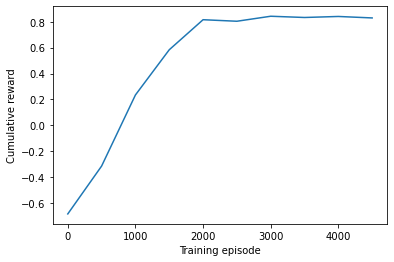

Last 5000 trials mean cumulative reward = 0.4786


In [13]:
# Solution Part D:

size = 11
default_reward = -0.01
discount = 0.999
actions = ['N','S','E','W','U','D']
mdp = MDPLanding(size, default_reward, actions, discount)
n_trials = 5000
# n_trials = 100
# n_trials = 10
# n_steps = 500
# n_steps = 100
n_steps = 50
Q,Nsa,rewards = run_many_trials(mdp, n_trials, n_steps)
#Q,Nsa,rewards = run_many_trials(mdp, n_trials=1, n_steps=50)


di = 500
# di = 100
# di = 10
rewards_block = list(np.mean(np.asarray(rewards).reshape(-1, di),1))
plt.plot(list(range(0,len(rewards),di)), rewards_block)
plt.xlabel('Training episode')
plt.ylabel('Cumulative reward')
plt.show()

print('Last 5000 trials mean cumulative reward = {:0.4f}'.format(np.mean(rewards[-5000:])))

#### Part E - Homework 3, part 2 questions.
These questions refer to the Q-learning implementation in Parts C and D of this notebook. 

**1:** (1 pts) This code in Part D is set up to run 3 trials, 10 steps each, starting from (1,2,5). The values for state, reward, policy, and Q[s,a] print on each step. 
- What is the first action taken and what state does the agent move to? 
- The values for policy and action are printed. What's the difference in the code?
- What are the lines of code that implement the action and determine the new state?

**2:** (1 pts) How is the s1 variable used in the code, including in the Q[s,a] calculation?

**3:** (1 pt) What are the initial values for the Q-matrix, the discount factor, learning rate, and the policy matrix?

**4:** (2 pts) What is the purpose of the *max(Q[s1, a1] for a1 in mdp.actions(s1))* code in the Q[s,a] calculation? How does it influence the Q[s,a] value?

**5:** (2 pts) Where does the code store the policy for each state? How is it updated and where is it used in the code?

**6:** (3 pts) Provide a 1-2 paragraph description of the differences in your Q-learning algorithm with the solution provided. Be specific. If there were parts of your code that didn't work, describe how your code was different than the solution. Even if your code did work, it can still be beneficial to see how someone else implemented a solution to the same problem and analyze the similarities and differences.  



1. \
    a. Up, (1,2,6) \
    b. policy is the best policy, action is the action taken \
    c. the return_epsilon_greedy_action function
2. \
    s1 is the start state. In Q[s,a] it is used as the state you begin from; you check the utility of all states that are possible from s1.
3. \
    Initial Q values: 0
    discount factor: 0.999
    learning rate: 1, decreases as the state is visited more
    policy matrix: random policy possible from the state
4. \
    It gets you the highest q value possible from a state (among any action)
    It influences Q directly. IE if it is higher, than Q will be higher, because
    it means the state you want to move to has a good next move.
5. \
    The policy matrix. It starts with all random actions. Then it is updated with better actions as they're found. More specifically, after an action was taken, the Q values are updated. Then, using that information, the policy is updated.
6. \
    There were several implementation differences between my Q-Learning and this one. First off, my drone was not allowed to run into walls, so my results are skewed higher (average 85%). Another difference is that I used a flat learning rate of 0.1, instead of varying it based on the number of times a state was visited. I also used a random non-terminal starting location for each trial, instead of initializing to the same place. Another difference is I did not choose to keep a policy matrix, I instead just evaluate my Q matrix directly when needed. 
    
    Other differences are minor. Such as mine being able to take in more parameters, a starting Q matrix, etc. I also decided to change the types of some things specified, particulary I ditched lists to make use of dictionaries, since they provide constant access times regardless of size.  
    
    A big similarity is the use of the epsilon value to determine wether to take a random action or exploit the action with the highest Q value. Most of the parameters are the same, such as epsilon=0.1, initial Q=0, default reward, and discount. Also, anything not mentioned is pretty similar, as should be expected.
        